# Initial Exploration of Van der Waals Constants Dataset

In [1]:
!pip install rdkit --quiet
!pip install pubchempy --quiet
!pip install --upgrade mol2vec --quiet
!pip install optuna --quiet
!pip install wandb --quiet
!pip install joblib --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.8/32.8 MB 57.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 43.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 364.4/364.4 kB 16.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.5/233.5 kB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 7.3 MB/s eta 0:00:00


In [2]:
!wget https://github.com/samoturk/mol2vec/raw/master/examples/models/model_300dim.pkl

--2024-12-01 16:43:16--  https://github.com/samoturk/mol2vec/raw/master/examples/models/model_300dim.pkl
Resolving github.com (github.com)... 140.82.121.3
Connecting to github.com (github.com)|140.82.121.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/samoturk/mol2vec/master/examples/models/model_300dim.pkl [following]
--2024-12-01 16:43:17--  https://raw.githubusercontent.com/samoturk/mol2vec/master/examples/models/model_300dim.pkl
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 76786055 (73M) [application/octet-stream]
Saving to: ‘model_300dim.pkl’

model_300dim.pkl    100%[===================>]  73.23M   322MB/s    in 0.2s    

2024-12-01 16:43:21 (322 MB/s) - ‘model_300dim.pkl’ saved [767

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import requests
from rdkit import Chem
from rdkit.Chem import Descriptors, rdMolDescriptors, AllChem
import pubchempy as pcp
from urllib.request import urlopen
from urllib.parse import quote
import time
import os
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
url = 'https://huggingface.co/datasets/BlakeMilstea/Van_Der_Waals_Constants/raw/main/Van_Der_Waals_Constants%20-%20Sheet1%20(1).csv'
drive_path = '/content/drive/MyDrive/EOS_Predictor/Data'

Our dataset is a collection of atomic signatures and their corresponding a and b values.

In [6]:
class DataPreprocessor_Speed:
    def __init__(self, url):
        """
        Initializes the DataPreprocessor with a URL to the dataset.

        Args:
            url (str): The URL to the dataset CSV.
        """
        self.url = url
        self.data = None

    def load_data(self):
        """
        Loads the dataset from the specified URL and sets initial column names.
        """
        self.data = pd.read_csv(self.url)
        self.data.columns = ['sci_name', 'name', 'a', 'b']
        return self.data.head()

    @staticmethod
    def name_to_SMILES_individual(name):
        """
        Retrieves the SMILES string for a molecule name using individual PubChem requests.

        Args:
            name (str): The name of the molecule.

        Returns:
            str: The SMILES string for the molecule, or np.nan if not found.
        """
        try:
            compounds = pcp.get_compounds(name, 'name')
            if compounds:
                return compounds[0].canonical_smiles
            else:
                return np.nan
        except Exception:
            return np.nan

    @staticmethod
    def names_to_cids(names):
        """
        Retrieves PubChem CIDs for a list of molecule names.

        Args:
            names (list of str): List of molecule names.

        Returns:
            dict: A dictionary where keys are molecule names and values are PubChem CIDs.
        """
        name_to_cid = {}
        for name in names:
            try:
                compounds = pcp.get_compounds(name, 'name')
                if compounds:
                    name_to_cid[name] = compounds[0].cid
                else:
                    name_to_cid[name] = np.nan
            except Exception:
                name_to_cid[name] = np.nan
        return name_to_cid

    @staticmethod
    def cids_to_smiles(cids):
        """
        Retrieves the SMILES strings for a list of PubChem CIDs in bulk.

        Args:
            cids (list of int): List of PubChem CIDs.

        Returns:
            dict: A dictionary where keys are CIDs and values are SMILES strings.
        """
        cid_to_smiles = {}
        try:
            # Use PubChem's REST API to get SMILES for multiple CIDs
            cid_list = ",".join(map(str, cids))
            url = f"https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/cid/{cid_list}/property/CanonicalSMILES/JSON"
            response = requests.get(url)
            response.raise_for_status()
            data = response.json()

            # Extract SMILES information from the response
            for item in data['PropertyTable']['Properties']:
                cid_to_smiles[item['CID']] = item['CanonicalSMILES']
        except Exception:
            # If there's an error, mark all as NaN
            for cid in cids:
                cid_to_smiles[cid] = np.nan
        return cid_to_smiles

    def add_SMILES_column_individual(self):
        """
        Adds a column to the dataset with SMILES strings using individual requests.
        """
        smiles_names = []
        for name in self.data['name']:
            smiles_names.append(self.name_to_SMILES_individual(name))
        self.data['smile'] = smiles_names
        # Remove rows with missing SMILES strings
        self.data = self.data.dropna().reset_index(drop=True)
        return self.data.head()

    def add_SMILES_column_bulk(self):
        """
        Adds a column to the dataset with SMILES strings using PubChem bulk requests.
        """
        # Step 1: Retrieve CIDs for all molecule names
        name_to_cid = self.names_to_cids(self.data['name'])
        self.data['cid'] = self.data['name'].map(name_to_cid)

        # Remove rows where no CID was found
        self.data = self.data.dropna(subset=['cid']).reset_index(drop=True)
        cids = self.data['cid'].astype(int).tolist()

        # Step 2: Retrieve SMILES for all found CIDs
        cid_to_smiles = self.cids_to_smiles(cids)
        self.data['smile'] = self.data['cid'].map(cid_to_smiles)

        # Remove rows with missing SMILES strings
        self.data = self.data.dropna(subset=['smile']).reset_index(drop=True)
        return self.data.head()

    def compare_speed(self):
        """
        Compares the speed of individual vs. bulk PubChem requests.
        """
        # Load the dataset
        self.load_data()

        # Measure time for individual requests
        start_time = time.time()
        self.add_SMILES_column_individual()
        individual_time = time.time() - start_time
        print(f"Time taken for individual requests: {individual_time:.2f} seconds")

        # Reload data for a fair comparison
        self.load_data()

        # Measure time for bulk requests
        start_time = time.time()
        self.add_SMILES_column_bulk()
        bulk_time = time.time() - start_time
        print(f"Time taken for bulk requests: {bulk_time:.2f} seconds")


In [ ]:
# Initialize the preprocessor with the dataset URL
preprocessor = DataPreprocessor_Speed('https://huggingface.co/datasets/BlakeMilstea/Van_Der_Waals_Constants/raw/main/Van_Der_Waals_Constants%20-%20Sheet1%20(1).csv')

# Compare the speed of individual and bulk requests
preprocessor.compare_speed()

Time taken for individual requests: 173.10 seconds
Time taken for bulk requests: 178.76 seconds


We will use bulk requests for scalability but it does not seem to effect runtime much in out case.


In [7]:
import os
import pandas as pd
import numpy as np
from rdkit import Chem
from rdkit.Chem import AllChem, Descriptors
import requests
import pubchempy as pcp

class DataPreprocessor:
    def __init__(self, url, drive_path=''):
        """
        Initializes the DataPreprocessor with a URL to the dataset and a Google Drive path.

        Args:
            url (str): The URL to the dataset CSV.
            drive_path (str): The path to the mounted Google Drive folder.
        """
        self.url = url
        self.drive_path = drive_path
        self.data = None
        self.preprocessed_file_path = os.path.join(self.drive_path, 'preprocessed_data.csv')
        self.embeddings_file_path = os.path.join(self.drive_path, 'embeddings.npy')
        self.targets_file_path = os.path.join(self.drive_path, 'targets.npy')

        # Initialize RDKitEmbeddings instance
        self.embedding_generator = RDKitEmbeddings()

        self.preprocess()

    def load_data(self):
        """
        Loads the dataset from the specified URL and sets initial column names.
        """
        self.data = pd.read_csv(self.url)
        self.data.columns = ['sci_name', 'name', 'a', 'b']
        return self.data.head()

    def add_molecular_properties(self):
        """
        Adds various molecular properties and atom count to the dataset.
        """
        self.data['properties'] = self.data['smile'].apply(self.calculate_molecular_properties)
        properties_df = self.data['properties'].apply(pd.Series)
        self.data = pd.concat([self.data, properties_df], axis=1)
        self.data.drop(columns=['properties'], inplace=True)
        return self.data.head()

    def calculate_molecular_properties(self, smiles):
        """
        Calculates various molecular properties using RDKit's descriptors.
        """
        mol = Chem.MolFromSmiles(smiles)
        if mol is None:
            return {
                'Molecular Weight': np.nan,
                'LogP': np.nan,
                'TPSA': np.nan,
                'Rotatable Bonds': np.nan,
                'H Bond Donors': np.nan,
                'H Bond Acceptors': np.nan,
                'Aromatic Rings': np.nan,
                'Num Rings': np.nan,
                'Atom Count': np.nan
            }
        return {
            'Molecular Weight': Descriptors.MolWt(mol),
            'LogP': Descriptors.MolLogP(mol),
            'TPSA': Descriptors.TPSA(mol),
            'Rotatable Bonds': Descriptors.NumRotatableBonds(mol),
            'H Bond Donors': Descriptors.NumHDonors(mol),
            'H Bond Acceptors': Descriptors.NumHAcceptors(mol),
            'Aromatic Rings': Descriptors.NumAromaticRings(mol),
            'Num Rings': len(mol.GetRingInfo().AtomRings()),
            'Atom Count': len(mol.GetAtoms())
        }

    def clean_data(self):
        """
        Cleans the dataset by removing duplicates, handling missing values, and ensuring valid molecular properties.
        """
        self.data = self.data.drop_duplicates()
        self.data = self.data.dropna(subset=['name', 'a', 'b'])
        self.data['a'] = pd.to_numeric(self.data['a'], errors='coerce')
        self.data['b'] = pd.to_numeric(self.data['b'], errors='coerce')
        self.data = self.data.dropna(subset=['a', 'b'])
        self.data = self.data[(self.data['a'] > 0) & (self.data['b'] > 0)]
        self.data['name'] = self.data['name'].astype(str)
        self.data = self.data.dropna(subset=[
            'smile', 'Molecular Weight', 'LogP', 'TPSA',
            'Rotatable Bonds', 'H Bond Donors', 'H Bond Acceptors',
            'Aromatic Rings', 'Num Rings', 'Atom Count'
        ])
        return self.data.head()

    def add_SMILES_column_bulk(self):
        """
        Adds a column to the dataset with SMILES strings using PubChem bulk requests.
        """
        name_to_cid = self.names_to_cids(self.data['name'])
        self.data['cid'] = self.data['name'].map(name_to_cid)
        self.data = self.data.dropna(subset=['cid']).reset_index(drop=True)
        cids = self.data['cid'].astype(int).tolist()
        cid_to_smiles = self.cids_to_smiles(cids)
        self.data['smile'] = self.data['cid'].map(cid_to_smiles)
        self.data = self.data.dropna(subset=['smile']).reset_index(drop=True)
        return self.data.head()

    @staticmethod
    def names_to_cids(names):
        """
        Retrieves PubChem CIDs for a list of molecule names.
        """
        name_to_cid = {}
        for name in names:
            try:
                compounds = pcp.get_compounds(name, 'name')
                if compounds:
                    name_to_cid[name] = compounds[0].cid
                else:
                    name_to_cid[name] = np.nan
            except Exception:
                name_to_cid[name] = np.nan
        return name_to_cid

    @staticmethod
    def cids_to_smiles(cids):
        """
        Retrieves the SMILES strings for a list of PubChem CIDs in bulk.
        """
        cid_to_smiles = {}
        try:
            cid_list = ",".join(map(str, cids))
            url = f"https://pubchem.ncbi.nlm.nih.gov/rest/pug/compound/cid/{cid_list}/property/CanonicalSMILES/JSON"
            response = requests.get(url)
            response.raise_for_status()
            data = response.json()
            for item in data['PropertyTable']['Properties']:
                cid_to_smiles[item['CID']] = item['CanonicalSMILES']
        except Exception:
            for cid in cids:
                cid_to_smiles[cid] = np.nan
        return cid_to_smiles

    def create_embeddings_and_targets(self):
      """
      Generates RDKit embeddings (fingerprints) and raw targets for the dataset.
      """
      if 'smile' not in self.data.columns:
          raise ValueError("The dataset must contain a 'smile' column to create embeddings.")
      if 'a' not in self.data.columns or 'b' not in self.data.columns:
          raise ValueError("The dataset must contain 'a' and 'b' columns to create targets.")

      smiles_list = self.data['smile'].tolist()
      embeddings = self.embedding_generator.smiles_to_fingerprint(smiles_list)
      valid_embeddings = []
      valid_targets = []

      for idx, emb in enumerate(embeddings):
          if emb is not None:
              # Ensure raw targets are used directly from the dataset
              raw_a = self.data.iloc[idx]['a']
              raw_b = self.data.iloc[idx]['b']

              valid_embeddings.append(emb)
              valid_targets.append([raw_a, raw_b])

      embeddings = np.array(valid_embeddings, dtype=np.float32)
      targets = np.array(valid_targets, dtype=np.float32)

      # Save the raw embeddings and targets
      np.save(self.embeddings_file_path, embeddings)
      np.save(self.targets_file_path, targets)

      # Debugging: Check saved targets
      print("Saved targets (first 5 rows):", targets[:5])

      return embeddings, targets


    def load_embeddings_and_targets(self):
        """
        Loads pre-saved embeddings and targets if available.
        """
        if os.path.exists(self.embeddings_file_path) and os.path.exists(self.targets_file_path):
            embeddings = np.load(self.embeddings_file_path)
            targets = np.load(self.targets_file_path)
            print(f'Loaded Embeddings')
            return embeddings, targets
        return self.create_embeddings_and_targets()

    def save_preprocessed_data(self):
        """
        Saves the preprocessed data to a CSV file in the Google Drive directory.
        """
        if not os.path.exists(self.drive_path):
            os.makedirs(self.drive_path)
        self.data.to_csv(self.preprocessed_file_path, index=False)

    def load_preprocessed_data(self):
        """
        Loads the preprocessed data from the Google Drive directory if it exists.
        """
        if os.path.exists(self.preprocessed_file_path):
            self.data = pd.read_csv(self.preprocessed_file_path)
            return self.data
        return None

    def preprocess(self):
        """
        Full preprocessing pipeline: Load data, add SMILES, and save if not already preprocessed.
        """
        preprocessed_data = self.load_preprocessed_data()
        if preprocessed_data is not None:
            self.data = preprocessed_data
            return preprocessed_data
        self.load_data()
        self.add_SMILES_column_bulk()
        self.add_molecular_properties()
        self.clean_data()
        self.save_preprocessed_data()
        return self.data


In [8]:
class DataVisualizer:
    def __init__(self, data):
        """
        Initializes the DataVisualizer with the dataset.

        Args:
            data (pd.DataFrame): The dataset to visualize.
        """
        self.data = data
        self.scale_data()

    def correlation_heatmap(self):
        """
        Plots a heatmap showing the correlation matrix of the numerical variables in the dataset.
        """
        # Select only numeric columns for correlation analysis
        numeric_data = self.data.select_dtypes(include=['number'])
        correlation_matrix = numeric_data.corr()

        plt.figure(figsize=(12, 8))
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
        plt.title('Correlation Heatmap')
        plt.show()

    def pairplot(self, correlation_threshold=0.7):
      """
      Plots a pairplot (scatterplot matrix) to show relationships between all numerical variables,
      but filters out plots that do not have a meaningful relationship (based on correlation threshold).

      Args:
          correlation_threshold (float): The minimum correlation absolute value to display the plot.
      """
      # Select only numeric columns for pairplot
      numeric_data = self.data.select_dtypes(include=['number'])

      # Calculate correlation matrix
      correlation_matrix = numeric_data.corr()

      # Identify columns to keep (those with at least one correlation above the threshold)
      relevant_columns = set()

      # Loop through the correlation matrix and add columns with meaningful correlations
      for col in correlation_matrix.columns:
          for row in correlation_matrix.index:
              if abs(correlation_matrix.loc[row, col]) >= correlation_threshold:
                  relevant_columns.add(col)
                  relevant_columns.add(row)

      # Convert set to list before filtering the DataFrame
      relevant_columns = list(relevant_columns)

      # Filter the numeric_data to only include the relevant columns
      filtered_data = numeric_data[relevant_columns]

      # Plot pairplot only for selected columns
      sns.pairplot(filtered_data)
      plt.suptitle('Pairplot of Relevant Numerical Variables', y=1.02)
      plt.show()

    def scale_data(self):
        """
        Scales the numeric columns to have a mean of 0 and a standard deviation of 1.
        """
        # Select only numeric columns for scaling
        numeric_data = self.data.select_dtypes(include=['number'])
        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(numeric_data)
        scaled_df = pd.DataFrame(scaled_data, columns=numeric_data.columns)
        self.data = pd.concat([self.data.select_dtypes(exclude=['number']), scaled_df], axis=1)
        return scaled_df

    def boxplot(self):
      """
      Plots a boxplot for the numerical variables to visualize the distribution and potential outliers.
      Excludes the 'cid' column from the plot.
      """
      # Exclude the 'cid' column from the numerical columns
      numerical_columns = [col for col in self.data.select_dtypes(include='number').columns if col != 'cid']

      plt.figure(figsize=(10, 6))
      sns.boxplot(data=self.data[numerical_columns])
      plt.title('Boxplot of Variables (Excluding CID)')
      plt.show()

    def violin_plot(self, x, y):
        """
        Plots a violin plot to show the distribution of data across different categories.

        Args:
            x (str): The column name of the categorical variable to be plotted on the x-axis.
            y (str): The column name of the numerical variable to be plotted on the y-axis.
        """
        if x not in self.data.columns or y not in self.data.columns:
            print(f"Error: Columns '{x}' or '{y}' do not exist in the dataset.")
            return
        plt.figure(figsize=(10, 6))
        sns.violinplot(x=x, y=y, data=self.data)
        plt.title(f'Violin Plot: {x} vs {y}')
        plt.show()

    def violin_plot_full(self):
      """
      Plots a violin plot for the numerical variables to visualize the distribution and density of the data.
      Excludes the 'cid' column from the plot.
      """
      # Scale the data first
      self.scale_data()

      # Exclude the 'cid' column from the numerical columns
      numerical_columns = [col for col in self.data.select_dtypes(include='number').columns if col != 'cid']

      plt.figure(figsize=(12, 8))
      sns.violinplot(data=self.data[numerical_columns], inner="quart")
      plt.title('Violin Plot of Variables (Excluding CID)')
      plt.show()


    def regression_plot(self, x, y):
        """
        Plots a regression plot to visualize the linear relationship between two numerical variables.

        Args:
            x (str): The column name of the variable to be plotted on the x-axis.
            y (str): The column name of the variable to be plotted on the y-axis.
        """
        if x not in self.data.columns or y not in self.data.columns:
            print(f"Error: Columns '{x}' or '{y}' do not exist in the dataset.")
            return
        sns.regplot(x=x, y=y, data=self.data, scatter_kws={'s': 10, 'alpha': 0.7}, line_kws={'color': 'red'})
        plt.title(f'Regression Plot: {x} vs {y}')
        plt.show()

    def scatter_plot(self, x, y):
        """
        Plots a simple scatter plot between two numerical variables.

        Args:
            x (str): The column name of the variable to be plotted on the x-axis.
            y (str): The column name of the variable to be plotted on the y-axis.
        """
        if x not in self.data.columns or y not in self.data.columns:
            print(f"Error: Columns '{x}' or '{y}' do not exist in the dataset.")
            return
        plt.figure(figsize=(10, 6))
        plt.scatter(self.data[x], self.data[y], c='blue', alpha=0.6)
        plt.title(f'Scatter Plot: {x} vs {y}')
        plt.xlabel(x)
        plt.ylabel(y)
        plt.grid(True)
        plt.show()

    def facet_grid(self, col, row=None):
      """
      Creates a facet grid plot to visualize relationships across multiple facets of the dataset.

      Args:
          col (str): The column name to be used for the column facets.
          row (str, optional): The column name to be used for the row facets.
      """
      # Check if the provided columns exist in the data
      if col not in self.data.columns:
          print(f"Error: Column '{col}' does not exist in the dataset.")
          return
      if row and row not in self.data.columns:
          print(f"Error: Column '{row}' does not exist in the dataset.")
          return

      # Create the FacetGrid
      g = sns.FacetGrid(self.data, col=col, row=row, margin_titles=True)

      # Map a scatterplot (you could also add other types of plots here)
      g.map(sns.scatterplot, 'a', 'b')

      # Set labels and titles
      g.set_axis_labels('a', 'b')
      g.set_titles("{col_name} | {row_name}")

      # Add a title for the whole grid
      g.fig.suptitle('Facet Grid: Relationships between a and b', size=16)

      # Adjust layout
      plt.subplots_adjust(top=0.9)  # Adjust the title to avoid overlap with plots

      plt.show()


In [ ]:

# Initialize the preprocessor with the dataset URL and Google Drive path
preprocessor = DataPreprocessor(url, drive_path)
data = preprocessor.data

# Display the final preprocessed data
print(preprocessor.data.head())

# Assuming 'preprocessed_data' is the cleaned dataset:
visualizer = DataVisualizer(data)

# Generate a correlation heatmap for scaled numeric variables
visualizer.correlation_heatmap()  # You can call this method without any changes, as it handles the correlation matrix.

# Generate pairplot for scaled data
visualizer.pairplot()

# Generate a boxplot for scaled data
visualizer.boxplot()

# Generate a violin plot (after scaling)
visualizer.violin_plot('a', 'Atom Count')
visualizer.violin_plot_full()

# Generate a scatter plot and regression plot between two variables (after scaling)
visualizer.scatter_plot('a', 'Atom Count')
visualizer.regression_plot('a', 'Atom Count')

# Generate a FacetGrid (after scaling)
visualizer.facet_grid(col='Atom Count')


# Delete the data
# preprocessor.delete_preprocessed_data()

NameError: name 'RDKitEmbeddings' is not defined

In [9]:
class EOS_Predictor_Pipeline:
    def __init__(self, data):
        self.data = data
        self.model_lr = LinearRegression()
        self.model_rf = RandomForestRegressor(random_state=42)
        self.model_xgb_mse = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)  # MSE loss
        self.model_xgb_pseudo = xgb.XGBRegressor(objective='reg:pseudohubererror', random_state=42)  # Pseudo-Huber loss
        self.scaler = StandardScaler()

    def split_data(self, test_size=0.2, random_state=42):
        """
        Splits the data into training and test sets.
        """
        numeric_data = self.data.select_dtypes(include=['number'])

        # Features (X) are all columns except for 'a' and 'b'
        X = numeric_data.drop(columns=['a', 'b'])

        # Target (y) is 'a' and 'b'
        y = self.data[['a', 'b']]

        # Split data into training and test sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

        # Fit the scaler on the training data and transform both training and test data
        self.X_train_scaled = self.scaler.fit_transform(X_train)
        self.X_test_scaled = self.scaler.transform(X_test)

        self.X_train, self.X_test = X_train, X_test
        self.y_train, self.y_test = y_train, y_test

        print(f"Training set size: {X_train.shape[0]}")
        print(f"Test set size: {X_test.shape[0]}")

    def train_model(self, model_type='lr', target_weights=None):
        """
        Trains the specified model on the scaled training set.
        """
        if model_type == 'lr':
            self.model = self.model_lr
        elif model_type == 'rf':
            self.model = self.model_rf
        elif model_type == 'xgb_mse':
            self.model = self.model_xgb_mse  # Use the correct XGBoost model
        elif model_type == 'xgb_pseudo':
            self.model = self.model_xgb_pseudo  # Use the correct XGBoost model
        else:
            print("Invalid model type. Choose 'lr', 'rf', 'xgb_mse', or 'xgb_pseudo'.")
            return

        if model_type in ['xgb_mse', 'xgb_pseudo'] and target_weights is not None:
            self.model.fit(self.X_train_scaled, self.y_train, sample_weight=target_weights)
        else:
            self.model.fit(self.X_train_scaled, self.y_train)

        print(f"{model_type} model trained successfully.")

    def cross_validate(self, model_type='lr', cv=5, target_weights=None):
        """
        Performs cross-validation on the scaled training data and prints the mean score.
        """
        if model_type == 'lr':
            model = self.model_lr
        elif model_type == 'rf':
            model = self.model_rf
        elif model_type == 'xgb_mse':
            model = self.model_xgb_mse
        elif model_type == 'xgb_pseudo':
            model = self.model_xgb_pseudo
        else:
            print("Invalid model type. Choose 'lr', 'rf', 'xgb_mse', or 'xgb_pseudo'.")
            return

        if target_weights is not None and model_type in ['xgb_mse', 'xgb_pseudo']:
            scores = cross_val_score(model, self.X_train_scaled, self.y_train, cv=cv, scoring='neg_mean_squared_error', fit_params={'sample_weight': target_weights})
        else:
            scores = cross_val_score(model, self.X_train_scaled, self.y_train, cv=cv, scoring='neg_mean_squared_error')

        print(f"{model_type} cross-validation scores (MSE): {scores}")
        print(f"Mean {model_type} cross-validation score (MSE): {np.mean(scores)}")

    def tune_hyperparameters(self, model_type='lr', param_grid=None, random_search=False, n_iter=10, cv=5):
      """
      Tunes hyperparameters using GridSearchCV or RandomizedSearchCV.

      Args:
          model_type (str): Type of model to tune ('lr', 'rf', 'xgb_mse', 'xgb_pseudo').
          param_grid (dict): Dictionary of parameters for tuning.
          random_search (bool): Whether to use RandomizedSearchCV (True) or GridSearchCV (False).
          n_iter (int): Number of iterations for RandomizedSearchCV if `random_search=True`.
          cv (int): Number of cross-validation folds.
      """
      if param_grid is None:
          param_grid_rf = {
              'n_estimators': [100, 200, 300],
              'max_depth': [10, 20, 30],
              'min_samples_split': [2, 5, 10],
              'min_samples_leaf': [1, 2, 4]
          }
      if model_type == 'lr':
          model = self.model_lr
      elif model_type == 'rf':
          model = self.model_rf
      elif model_type == 'xgb_mse':
          model = self.model_xgb_mse
      elif model_type == 'xgb_pseudo':
          model = self.model_xgb_pseudo
      else:
          print("Invalid model type. Choose 'lr', 'rf', 'xgb_mse', or 'xgb_pseudo'.")
          return

      # Choose between GridSearchCV or RandomizedSearchCV
      if random_search:
          search = RandomizedSearchCV(estimator=model, param_distributions=param_grid, n_iter=n_iter, cv=cv, verbose=1, random_state=42, n_jobs=-1)
      else:
          search = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, verbose=1, n_jobs=-1)

      # Fit the search on the training data
      search.fit(self.X_train_scaled, self.y_train)

      # Output best parameters and best score
      print(f"Best hyperparameters for {model_type}: {search.best_params_}")
      print(f"Best cross-validation score for {model_type}: {search.best_score_}")

      # Set the best model as the model to use for predictions
      self.model = search.best_estimator_

      # Return the best hyperparameters and score
      return search.best_params_, search.best_score_

    def evaluate_model(self, model_type='lr', hyper=False):
      """
      Evaluates the specified model on the scaled test set and prints the metrics for 'a', 'b', and combined MSE.
      """
      if model_type == 'lr':
          model = self.model_lr
      elif model_type == 'rf':
          model = self.model_rf
      elif model_type == 'xgb_mse':
          model = self.model_xgb_mse
      elif model_type == 'xgb_pseudo':
          model = self.model_xgb_pseudo
      elif hyper:
          model = self.model
      else:
        print("Invalid model type. Choose 'lr', 'rf', 'xgb_mse', or 'xgb_pseudo'.")
        return

      # Make predictions on the scaled test data
      y_pred = model.predict(self.X_test_scaled)

      # Calculate MSE for 'a', 'b', and combined
      mse_a = mean_squared_error(self.y_test['a'], y_pred[:, 0])  # MSE for 'a'
      mse_b = mean_squared_error(self.y_test['b'], y_pred[:, 1])  # MSE for 'b'
      mse_combined = mean_squared_error(self.y_test, y_pred)  # Combined MSE for both 'a' and 'b'

      r2 = r2_score(self.y_test, y_pred)  # Calculate R-squared for both 'a' and 'b' combined

      print(f"{model_type} - Mean Squared Error (MSE) for 'a': {mse_a}")
      print(f"{model_type} - Mean Squared Error (MSE) for 'b': {mse_b}")
      print(f"{model_type} - Combined Mean Squared Error (MSE): {mse_combined}")
      print(f"{model_type} - R-squared (R2): {r2}")

      return mse_a, mse_b, mse_combined, r2


    def visualize_comparison(self):
      """
      Visualizes a comparison of the models: Linear Regression, Random Forest, and XGBoost with different loss functions.
      Includes the MSE for 'a', 'b', and combined MSE.
      Also compares non-tuned models with hyperparameter-tuned versions.
      """
      # Evaluate non-tuned models
      mse_lr_a, mse_lr_b, mse_lr_combined, r2_lr = self.evaluate_model('lr')
      mse_rf_a, mse_rf_b, mse_rf_combined, r2_rf = self.evaluate_model('rf')
      mse_xgb_mse_a, mse_xgb_mse_b, mse_xgb_mse_combined, r2_xgb_mse = self.evaluate_model('xgb_mse')
      mse_xgb_pseudo_a, mse_xgb_pseudo_b, mse_xgb_pseudo_combined, r2_xgb_pseudo = self.evaluate_model('xgb_pseudo')

      # Perform hyperparameter tuning and evaluate the tuned models
      param_grid_rf = {
          'n_estimators': [100, 200, 300],
          'max_depth': [10, 20, 30],
          'min_samples_split': [2, 5, 10],
          'min_samples_leaf': [1, 2, 4]
      }
      best_params_rf, best_score_rf = self.tune_hyperparameters('rf', param_grid_rf)
      mse_rf_tuned_a, mse_rf_tuned_b, mse_rf_tuned_combined, r2_rf_tuned = self.evaluate_model('rf_tuned', True)

      param_grid_xgb = {
          'n_estimators': [100, 200],
          'max_depth': [3, 5, 7],
          'learning_rate': [0.01, 0.1, 0.2]
      }
      best_params_xgb, best_score_xgb = self.tune_hyperparameters('xgb_mse', param_grid_xgb)
      mse_xgb_tuned_a, mse_xgb_tuned_b, mse_xgb_tuned_combined, r2_xgb_tuned = self.evaluate_model('xgb_mse_tuned', True)

      # Prepare data for plotting
      models = ['Linear Regression', 'Random Forest', 'XGBoost (MSE)', 'XGBoost (Pseudo)',
                'Random Forest (Tuned)', 'XGBoost (MSE) (Tuned)']

      # MSE for 'a', 'b', and combined
      mse_a_scores = [mse_lr_a, mse_rf_a, mse_xgb_mse_a, mse_xgb_pseudo_a, mse_rf_tuned_a, mse_xgb_tuned_a]
      mse_b_scores = [mse_lr_b, mse_rf_b, mse_xgb_mse_b, mse_xgb_pseudo_b, mse_rf_tuned_b, mse_xgb_tuned_b]
      mse_combined_scores = [mse_lr_combined, mse_rf_combined, mse_xgb_mse_combined, mse_xgb_pseudo_combined, mse_rf_tuned_combined, mse_xgb_tuned_combined]

      # R2 scores for the models
      r2_scores = [r2_lr, r2_rf, r2_xgb_mse, r2_xgb_pseudo, r2_rf_tuned, r2_xgb_tuned]

      # Plot MSE comparison for 'a', 'b', and combined MSE
      fig, ax = plt.subplots(1, 3, figsize=(18, 6))

      # MSE for 'a' Plot
      ax[0].bar(models, mse_a_scores, color=['blue', 'green', 'orange', 'red', 'purple', 'cyan'])
      ax[0].set_title('MSE for Target a')
      ax[0].set_ylabel('Mean Squared Error')

      # MSE for 'b' Plot
      ax[1].bar(models, mse_b_scores, color=['blue', 'green', 'orange', 'red', 'purple', 'cyan'])
      ax[1].set_title('MSE for Target b')
      ax[1].set_ylabel('Mean Squared Error')

      # Combined MSE Plot
      ax[2].bar(models, mse_combined_scores, color=['blue', 'green', 'orange', 'red', 'purple', 'cyan'])
      ax[2].set_title('Combined MSE')
      ax[2].set_ylabel('Mean Squared Error')

      plt.tight_layout()
      plt.show()

      # Plot R2 comparison
      fig, ax = plt.subplots(figsize=(8, 6))
      ax.bar(models, r2_scores, color=['blue', 'green', 'orange', 'red', 'purple', 'cyan'])
      ax.set_title('R2 Comparison')
      ax.set_ylabel('R-squared')
      plt.tight_layout()
      plt.show()

    def predict(self, new_data):
        """
        Scales new data and makes predictions using the trained model.
        """
        new_data_scaled = self.scaler.transform(new_data)
        predictions = self.model.predict(new_data_scaled)
        return predictions

In [ ]:
# Example usage

# Create the EOS_Predictor_Pipeline object
pipeline = EOS_Predictor_Pipeline(data)

# Step 1: Split data into training and test sets
pipeline.split_data(test_size=0.2, random_state=42)

# Step 2: Train different models

# Weight 'a' more heavily during training
target_weights_train = np.where(pipeline.y_train['a'] > pipeline.y_train['b'], 2, 1)

# Train Linear Regression model
pipeline.train_model('lr')

# Train Random Forest model
pipeline.train_model('rf')

# Train XGBoost with MSE loss function (with sample weights)
pipeline.train_model('xgb_mse', target_weights=target_weights_train)

# Train XGBoost with Pseudo-Huber loss function (with sample weights)
pipeline.train_model('xgb_pseudo', target_weights=target_weights_train)

# Step 3: Perform Cross-Validation (optional, to check model performance)

# Cross-validation for Linear Regression
# pipeline.cross_validate('lr')

# Cross-validation for Random Forest
# pipeline.cross_validate('rf')

# Cross-validation for XGBoost with MSE loss function (with sample weights)
# pipeline.cross_validate('xgb_mse', target_weights=target_weights_train)

# Cross-validation for XGBoost with Pseudo-Huber loss function (with sample weights)
# pipeline.cross_validate('xgb_pseudo', target_weights=target_weights_train)

# Step 4: Visualize the comparison of all models
pipeline.visualize_comparison()


In [10]:
class RDKitEmbeddings:
    def __init__(self):
        pass

    def smiles_to_fingerprint(self, smiles_list):
        """
        Converts a list of SMILES strings to their corresponding RDKit fingerprints.
        :param smiles_list: List of SMILES strings.
        :return: List of RDKit fingerprints.
        """
        fingerprints = []
        for smiles in smiles_list:
            try:
                mol = Chem.MolFromSmiles(smiles)
                if mol is not None:
                    # Use the newer MorganGenerator instead of the deprecated method
                    morgan_generator = AllChem.GetMorganGenerator(2)  # Radius 2
                    fp = morgan_generator.GetFingerprint(mol)
                    fingerprints.append(np.array(fp))
                else:
                    fingerprints.append(None)
            except Exception as e:
                print(f"Error processing SMILES {smiles}: {e}")
                fingerprints.append(None)  # In case of an error, append None
        return fingerprints

    def get_average_fingerprint(self, smiles_list):
        """
        Converts a list of SMILES strings to fingerprints and returns their average.
        :param smiles_list: List of SMILES strings.
        :return: Average fingerprint vector.
        """
        fingerprints = self.smiles_to_fingerprint(smiles_list)

        # Filter out None values (in case of errors) before averaging
        valid_fingerprints = [fp for fp in fingerprints if fp is not None]

        if len(valid_fingerprints) == 0:
            raise ValueError("No valid fingerprints found.")

        # Compute the average fingerprint
        average_fingerprint = np.mean(valid_fingerprints, axis=0)
        return average_fingerprint

In [13]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error, explained_variance_score
from sklearn.preprocessing import StandardScaler
import optuna
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
import logging
import wandb
from tqdm import tqdm

# Enable CUDA debugging for Colab
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

class MolecularPredictorPipeline:
    # Define the optimizer dictionary as a class attribute
    optimizer_fn_dict = {
        "AdamW": {
            "optimizer_class": optim.AdamW,
            "params": {
                "lr": 0.001,
                "weight_decay": 0.01
            }
        },
        "SGD": {
            "optimizer_class": optim.SGD,
            "params": {
                "lr": 0.01,
                "momentum": 0.9,
                "weight_decay": 0.01
            }
        },
        "Adam": {
            "optimizer_class": optim.Adam,
            "params": {
                "lr": 0.001,
                "betas": (0.9, 0.999),
                "weight_decay": 0.01
            }
        },
        "RMSprop": {
            "optimizer_class": optim.RMSprop,
            "params": {
                "lr": 0.01,
                "alpha": 0.99,
                "weight_decay": 0.01
            }
        },
        "Adagrad": {
            "optimizer_class": optim.Adagrad,
            "params": {
                "lr": 0.01,
                "weight_decay": 0.01
            }
        }
    }

    def __init__(self, embeddings, targets, layer_config, optimizer_name="AdamW", hidden_size=128,
                 batch_size=32, learning_rate=0.001, num_epochs=50,
                 patience=10, dropout_rate=0.5, k_folds=5,
                 unnormalized_targets=None, clip_grad_value=None,
                 clip_grad_norm=None, checkpoint_dir='checkpoints',
                 log_dir='logs',scheduler_type="ReduceLROnPlateau",
                 scheduler_params=None):
        """
        Initialize the molecular predictor pipeline.
        """

        wandb.init(
            project="molecular-predictor",
            name="Pipeline_Experiment",
            config={
                "num_epochs": num_epochs,
                "batch_size": batch_size,
                "learning_rate": learning_rate,
                "dropout_rate": dropout_rate,
                "k_folds": k_folds,
                "scheduler_type": scheduler_type
            },
            mode='disabled'
        )

        wandb.config.update({
            "model": "MoleculePredictor",
            "optimizer": optimizer_name
        })

        # If unnormalized targets are not provided, use the given targets
        if unnormalized_targets is None:
            self.unnormalized_targets = np.copy(targets)
        else:
            self.unnormalized_targets = unnormalized_targets

        # Ensure unnormalized_targets is at least 2D
        self.unnormalized_targets = np.atleast_2d(self.unnormalized_targets)

        # Device setup for GPU/CPU
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        print(f"Using device: {self.device}")

        # Data and model hyperparameters
        self.embeddings = embeddings
        self.hidden_size = hidden_size
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.num_epochs = num_epochs
        self.patience = patience
        self.dropout_rate = dropout_rate
        self.k_folds = k_folds
        self.input_size = embeddings.shape[1]
        self.output_size = targets.shape[1]
        self.layer_config = layer_config

        # Gradient clipping parameters
        self.clip_grad_value = clip_grad_value
        self.clip_grad_norm = clip_grad_norm

        # Separate scalers for 'a' and 'b'
        self.scaler_a = StandardScaler()
        self.scaler_b = StandardScaler()

        # Initialize the model
        self.model = self.MoleculePredictor(self.input_size, self.layer_config, self.output_size).to(self.device)
        if torch.cuda.device_count() > 1:
            print(f"Using {torch.cuda.device_count()} GPUs for parallel processing!")
            self.model = nn.DataParallel(self.model)

        # Loss function and optimizer
        self.criterion = nn.SmoothL1Loss()
        # Select optimizer dynamically from the class-level dictionary
        if optimizer_name not in self.optimizer_fn_dict:
            raise ValueError(f"Optimizer '{optimizer_name}' is not defined in optimizer_fn_dict.")

        optimizer_config = self.optimizer_fn_dict[optimizer_name]
        optimizer_class = optimizer_config["optimizer_class"]
        optimizer_params = optimizer_config["params"]
        # Instantiate the optimizer
        self.optimizer = optimizer_class(self.model.parameters(), **optimizer_params)
        self.scheduler = optim.lr_scheduler.ReduceLROnPlateau(self.optimizer, 'min', patience=5, factor=0.5)

        # Setup TensorBoard writer
        self.log_dir = log_dir
        self.writer = SummaryWriter(log_dir=self.log_dir)

        # Setup structured logging
        log_file = os.path.join(self.log_dir, 'training.log')
        logging.basicConfig(filename=log_file, level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
        self.logger = logging.getLogger()

        self.logger.info("Pipeline initialized")

        # Scheduler type and parameters
        self.scheduler_type = scheduler_type
        self.scheduler_params = scheduler_params or {}

        # Initialize scheduler
        self.initialize_scheduler()
        self.logger.info(f"Using {self.scheduler_type} scheduler with params: {self.scheduler_params}")

        # Checkpointing directory
        self.checkpoint_dir = checkpoint_dir
        os.makedirs(self.checkpoint_dir, exist_ok=True)

        # Enable CUDNN optimizations
        torch.backends.cudnn.benchmark = True

    def initialize_scheduler(self):
        """
        Initialize the learning rate scheduler based on the specified type.
        """
        if self.scheduler_type == "ReduceLROnPlateau":
            self.scheduler = optim.lr_scheduler.ReduceLROnPlateau(
                self.optimizer, **self.scheduler_params
            )
        elif self.scheduler_type == "CyclicLR":
            self.scheduler = optim.lr_scheduler.CyclicLR(
                self.optimizer, **self.scheduler_params
            )
        elif self.scheduler_type == "CosineAnnealingLR":
            self.scheduler = optim.lr_scheduler.CosineAnnealingLR(
                self.optimizer, **self.scheduler_params
            )
        else:
            raise ValueError(f"Unsupported scheduler type: {self.scheduler_type}")

    def print_embeddings(self, num_samples=10):
      """
      Print the molecular embeddings in a structured format.

      Parameters:
      - num_samples (int): Number of samples to display. Default is 10.
      """
      # Ensure embeddings is a numpy array
      embeddings_array = np.array(self.embeddings)

      # Check if num_samples exceeds the number of available embeddings
      num_samples = min(num_samples, embeddings_array.shape[0])

      print(f"Printing {num_samples} samples of embeddings (out of {embeddings_array.shape[0]}):")
      print("=" * 50)

      # Iterate through the embeddings and print each sample
      for i, embedding in enumerate(embeddings_array[:num_samples]):
          print(f"Sample {i + 1}: {embedding}")

      print("=" * 50)
      print("Note: Embeddings are normalized using StandardScaler.")

    class FoldScaler:
        """
        A container for scalers used in each fold of cross-validation.
        """
        def __init__(self):
            self.scaler_a = StandardScaler()
            self.scaler_b = StandardScaler()

        def fit(self, train_targets):
            self.scaler_a.fit(train_targets[:, 0].reshape(-1, 1))
            self.scaler_b.fit(train_targets[:, 1].reshape(-1, 1))

        def transform(self, targets):
            targets[:, 0] = self.scaler_a.transform(targets[:, 0].reshape(-1, 1)).flatten()
            targets[:, 1] = self.scaler_b.transform(targets[:, 1].reshape(-1, 1)).flatten()
            return targets

        def inverse_transform(self, normalized_targets):
          """
          Inverse transform normalized targets back to their original scale.
          """
          # Ensure input is a NumPy array
          normalized_targets = np.array(normalized_targets)

          unnormalized_targets = np.zeros_like(normalized_targets)
          unnormalized_targets[:, 0] = self.scaler_a.inverse_transform(normalized_targets[:, 0].reshape(-1, 1)).flatten()
          unnormalized_targets[:, 1] = self.scaler_b.inverse_transform(normalized_targets[:, 1].reshape(-1, 1)).flatten()
          return unnormalized_targets

    class MoleculeDataset(Dataset):
        def __init__(self, embeddings, targets):
            """
            Custom Dataset for molecular embeddings and targets.
            """
            self.embeddings = torch.tensor(embeddings, dtype=torch.float32)
            self.unnormalized_targets = torch.tensor(targets, dtype=torch.float32)

        def __len__(self):
            return len(self.embeddings)

        def __getitem__(self, idx):
            return self.embeddings[idx], self.unnormalized_targets[idx]

    class MoleculePredictor(nn.Module):
      def __init__(self, input_size, layer_config, output_size):
          """
          Flexible neural network with configurable layers and dynamic dropout.

          Args:
          - input_size (int): Number of input features.
          - layer_config (list of dict): Configuration for hidden layers.
          - output_size (int): Number of output features.
          """
          super().__init__()
          self.layers = nn.ModuleList()
          self.dropout_layers = []  # Keep track of dropout layers for dynamic adjustment

          for layer in layer_config:
              self.layers.append(nn.Linear(input_size, layer["hidden_size"]))
              self.layers.append(nn.BatchNorm1d(layer["hidden_size"]))

              # Add activation function
              activation_fn = getattr(nn, layer["activation"], nn.ReLU)
              self.layers.append(activation_fn())

              # Add dropout and track it
              if "dropout" in layer:
                  dropout_layer = nn.Dropout(layer["dropout"])
                  self.layers.append(dropout_layer)
                  self.dropout_layers.append(dropout_layer)

              # Update input size for the next layer
              input_size = layer["hidden_size"]

          # Add final output layer
          self.layers.append(nn.Linear(input_size, output_size))

      def set_dropout_rate(self, rate):
          """
          Dynamically set the dropout rate for all dropout layers.
          """
          for dropout_layer in self.dropout_layers:
              dropout_layer.p = rate

      def forward(self, x):
          for layer in self.layers:
              x = layer(x)
          return x

    def dynamic_weighted_loss(self, predictions, targets):
        """
        Dynamic weighted loss between `a` and `b` based on inverse variance or gradients.
        """
        # Compute individual losses
        loss_a = nn.functional.mse_loss(predictions[:, 0], targets[:, 0], reduction='none')
        loss_b = nn.functional.mse_loss(predictions[:, 1], targets[:, 1], reduction='none')

        # Compute the mean losses
        mean_loss_a = loss_a.mean()
        mean_loss_b = loss_b.mean()

        # Dynamically calculate weights (e.g., inverse variance scaling)
        variance_a = loss_a.var(unbiased=False) + 1e-6
        variance_b = loss_b.var(unbiased=False) + 1e-6

        # Update weights (optional smoothing with momentum)
        self.weight_a = 1 / variance_a
        self.weight_b = 1 / variance_b

        # Normalize weights
        total_weight = self.weight_a + self.weight_b
        normalized_weight_a = self.weight_a / total_weight
        normalized_weight_b = self.weight_b / total_weight

        # Weighted loss
        weighted_loss = normalized_weight_a * mean_loss_a + normalized_weight_b * mean_loss_b

        return weighted_loss

    def add_binary_noise(self, embeddings, flip_prob=0.01):
      """
      Randomly flip bits in binary embeddings with a given probability.

      Parameters:
      - embeddings (torch.Tensor): Binary embeddings (values 0 or 1).
      - flip_prob (float): Probability of flipping each bit.

      Returns:
      - torch.Tensor: Augmented binary embeddings.
      """
      # Generate a mask for flipping bits
      flip_mask = torch.rand_like(embeddings, dtype=torch.float32) < flip_prob
      # Flip bits where the mask is True
      augmented_embeddings = embeddings.clone()
      augmented_embeddings[flip_mask] = 1 - augmented_embeddings[flip_mask]
      return augmented_embeddings

    def train_model(self, train_loader, val_loader, fold_scaler, accumulation_steps=1,
                initial_dropout_rate=0.5, final_dropout_rate=0.1, resume_from=None, lambda_l1=1e-4):
      """
      Train the model using mixed-precision training with L1 and L2 regularization.
      """
      self.scaler_a = fold_scaler.scaler_a
      self.scaler_b = fold_scaler.scaler_b
      scaler = torch.amp.GradScaler('cuda')
      best_loss = float('inf')
      patience_counter = 0

      dropout_decay = (initial_dropout_rate - final_dropout_rate) / self.num_epochs

      start_epoch = 0
      if resume_from:
          start_epoch, best_loss = self.load_checkpoint(resume_from)

      current_lr = self.optimizer.param_groups[0]['lr']

      # Initialize `final_y_true` and `final_y_pred`
      final_y_true, final_y_pred = [], []

      for epoch in range(self.num_epochs):
          with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{self.num_epochs}") as pbar:
              current_dropout_rate = max(final_dropout_rate, initial_dropout_rate - epoch * dropout_decay)
              if hasattr(self.model, "set_dropout_rate"):
                  self.model.set_dropout_rate(current_dropout_rate)

              self.model.train()
              epoch_loss = 0

              for i, (embeddings, targets) in enumerate(train_loader):
                  embeddings, targets = embeddings.to(self.device), targets.to(self.device)

                  with torch.amp.autocast(device_type='cuda', enabled=True):
                    outputs = self.model(embeddings)
                    main_loss = self.criterion(outputs, targets)
                    l1_reg = self.l1_regularization(self.model, lambda_l1)
                    total_loss = main_loss + l1_reg

                  scaler.scale(total_loss).backward()

                  if self.clip_grad_norm is not None:
                      torch.nn.utils.clip_grad_norm_(self.model.parameters(), max_norm=self.clip_grad_norm)
                  if self.clip_grad_value is not None:
                      torch.nn.utils.clip_grad_value_(self.model.parameters(), clip_value=self.clip_grad_value)

                  if (i + 1) % accumulation_steps == 0:
                      scaler.step(self.optimizer)
                      scaler.update()
                      self.optimizer.zero_grad()

                  epoch_loss += total_loss.item()

                  wandb.log({"train_loss_step": total_loss.item(), "lr": current_lr})
                  pbar.update(1)
                  pbar.set_postfix(loss=total_loss.item())

          avg_loss = epoch_loss / len(train_loader)
          if self.scheduler_type == "ReduceLROnPlateau":
              self.scheduler.step(avg_loss)
          else:
              self.scheduler.step()

          current_lr = self.optimizer.param_groups[0]['lr']
          self.writer.add_scalar('Learning_Rate', current_lr, epoch)
          self.writer.add_scalar('Loss/Train', avg_loss, epoch)

          # Evaluate on validation set
          val_loss, (y_true, y_pred) = self.evaluate_model(val_loader, fold_scaler, return_predictions=True)
          final_y_true, final_y_pred = y_true, y_pred  # Update at every epoch

          # Log metrics
          wandb.log({"epoch": epoch, "train_loss": avg_loss, "val_loss": val_loss, "lr": current_lr})
          self.writer.add_scalar('Loss/Validation', val_loss, epoch)
          self.logger.info(f"Epoch {epoch + 1}/{self.num_epochs} | Train Loss: {avg_loss:.4f} | Val Loss: {val_loss:.4f}")

          print(f"Epoch [{epoch + 1}/{self.num_epochs}], Train Loss: {avg_loss:.4f}, Val Loss: {val_loss:.4f}")
          print(f"Current Dropout Rate: {current_dropout_rate:.4f}")

          self.save_checkpoint(epoch + 1, val_loss, is_best=(val_loss < best_loss))

          if val_loss < best_loss:
              best_loss = val_loss
              patience_counter = 0
          else:
              patience_counter += 1

          if patience_counter >= self.patience:
              print("Early stopping triggered!")
              break

      print("Loading the best model for evaluation...")
      best_model_path = os.path.join(self.checkpoint_dir, "best_model.pth")
      self.model.load_state_dict(torch.load(best_model_path)["model_state"])
      self.model.eval()

      # Plot scatter for the final epoch (using the best model)
      if final_y_true.size > 0 and final_y_pred.size > 0:  # Ensure data is available for plotting
          self.plot_scatter(final_y_true, final_y_pred, print_scores=True, title="Final Epoch Predictions")
      else:
          print("Skipping scatter plot as no data is available.")

    def evaluate_model(self, val_loader, fold_scaler, return_metrics=False, return_predictions=False):
      """
      Evaluate the model on the validation set with mixed precision.

      Returns:
      - mse, r2 (or other metrics) if return_metrics=True.
      - mse, (y_true, y_pred) if return_predictions=True.
      """
      self.scaler_a = fold_scaler.scaler_a
      self.scaler_b = fold_scaler.scaler_b

      self.model.eval()
      y_true, y_pred = [], []
      with torch.no_grad():
          for embeddings, targets in val_loader:
              embeddings, targets = embeddings.to(self.device), targets.to(self.device)
              with torch.amp.autocast(device_type='cuda', enabled=True):
                  outputs = self.model(embeddings)
              y_true.extend(targets.cpu().numpy())
              y_pred.extend(outputs.cpu().numpy())

      # Unnormalize predictions and targets
      y_true = fold_scaler.inverse_transform(y_true)
      y_pred = fold_scaler.inverse_transform(y_pred)

      # Compute metrics
      mse = mean_squared_error(y_true, y_pred)
      r2 = r2_score(y_true, y_pred)
      mae = mean_absolute_error(y_true, y_pred)
      evs = explained_variance_score(y_true, y_pred)

      print(f"Validation Metrics:\n"
            f"  - MSE: {mse:.4f}\n"
            f"  - R²: {r2:.4f}\n"
            f"  - MAE: {mae:.4f}\n"
            f"  - Explained Variance Score (EVS): {evs:.4f}")

      if return_predictions:
          return mse, (y_true, y_pred)
      if return_metrics:
          return mse, r2, mae, evs
      return mse

    def predict(self, embeddings, with_uncertainty=False, num_samples=10):
      """
      Predict target values for given embeddings with optional uncertainty estimation.

      Parameters:
      - embeddings (numpy.ndarray): Input embeddings for prediction.
      - with_uncertainty (bool): Whether to compute uncertainty using Monte Carlo Dropout.
      - num_samples (int): Number of stochastic forward passes for uncertainty estimation.

      Returns:
      - numpy.ndarray: Predictions (and uncertainties if with_uncertainty=True).
      """
      self.model.eval()  # Set model to evaluation mode for standard predictions

      embeddings_tensor = torch.tensor(embeddings, dtype=torch.float32).to(self.device)

      if with_uncertainty:
          self.model.train()  # Enable dropout during inference for uncertainty estimation
          preds = []
          with torch.no_grad():
              for _ in range(num_samples):
                  preds.append(self.model(embeddings_tensor).cpu().numpy())
          preds = np.array(preds)
          mean_preds = preds.mean(axis=0)
          std_preds = preds.std(axis=0)
          return mean_preds, std_preds

      with torch.no_grad():
          predictions = self.model(embeddings_tensor).cpu().numpy()

      return predictions


    def monte_carlo_dropout(self, embeddings, num_samples=10):
      """
      Perform Monte Carlo Dropout to estimate uncertainty in predictions.

      Parameters:
      - embeddings (torch.Tensor): Input data for prediction.
      - num_samples (int): Number of stochastic forward passes.

      Returns:
      - mean_preds (numpy.ndarray): Mean predictions.
      - std_preds (numpy.ndarray): Standard deviation (uncertainty) of predictions.
      """
      self.model.train()  # Keep dropout active during prediction
      embeddings = torch.tensor(embeddings, dtype=torch.float32).to(self.device)
      preds = []

      with torch.no_grad():
          for _ in range(num_samples):
              preds.append(self.model(embeddings).cpu().numpy())

      preds = np.array(preds)
      mean_preds = preds.mean(axis=0)
      std_preds = preds.std(axis=0)

      return mean_preds, std_preds


    def aggregate_predictions(self, fold_models, test_embeddings):
      """
      Aggregate predictions from models trained in each fold for robust predictions.

      Parameters:
      - fold_models (list of nn.Module): List of models trained on different folds.
      - test_embeddings (numpy.ndarray): Input embeddings for which predictions are made.

      Returns:
      - numpy.ndarray: Aggregated predictions (averaged over folds).
      """
      # Convert test embeddings to a PyTorch tensor
      test_tensor = torch.tensor(test_embeddings, dtype=torch.float32).to(self.device)
      aggregated_preds = []

      with torch.no_grad():
          for model in fold_models:
              model.eval()  # Ensure the model is in evaluation mode
              preds = model(test_tensor).cpu().numpy()
              aggregated_preds.append(preds)

      # Average the predictions across folds
      return np.mean(aggregated_preds, axis=0)

    def create_stratified_bins(self, targets, num_bins=5):
        """
        Discretize continuous targets into bins for stratified splitting.

        Parameters:
        - targets (numpy.ndarray): Continuous target values.
        - num_bins (int): Number of bins to create.

        Returns:
        - numpy.ndarray: Binned target labels for stratification.
        """
        bins = np.linspace(targets.min(), targets.max(), num_bins + 1)
        binned_targets = np.digitize(targets, bins, right=True) - 1
        binned_targets = np.clip(binned_targets, 0, num_bins - 1)  # Ensure indices are within range
        return binned_targets

    def k_fold_cross_validation(self, stratified=False, num_bins=5):
      """
      Perform k-fold or stratified k-fold cross-validation with aggregated predictions.

      Parameters:
      - stratified (bool): Whether to use stratified k-fold splitting.
      - num_bins (int): Number of bins to create for stratification, if stratified=True.

      Returns:
      - tuple: (average validation metrics, fold models)
      """
      if stratified:
          stratified_labels = self.create_stratified_bins(self.unnormalized_targets[:, 0], num_bins=num_bins)
          kfold = StratifiedKFold(n_splits=self.k_folds, shuffle=True, random_state=42)
          split_generator = kfold.split(self.embeddings, stratified_labels)
      else:
          kfold = KFold(n_splits=self.k_folds, shuffle=True, random_state=42)
          split_generator = kfold.split(self.embeddings)

      fold_results = []
      fold_models = []

      for fold, (train_idx, val_idx) in enumerate(split_generator):
          print(f"Fold {fold + 1}/{self.k_folds}")

          # Split data into training and validation sets
          train_data, val_data = self.embeddings[train_idx], self.embeddings[val_idx]
          train_targets, val_targets = self.unnormalized_targets[train_idx], self.unnormalized_targets[val_idx]

          # Create a FoldScaler for this fold
          fold_scaler = self.FoldScaler()
          fold_scaler.fit(train_targets)

          # Normalize targets
          train_targets = fold_scaler.transform(train_targets)
          val_targets = fold_scaler.transform(val_targets)

          # Create datasets and data loaders
          train_dataset = self.MoleculeDataset(train_data, train_targets)
          val_dataset = self.MoleculeDataset(val_data, val_targets)

          train_loader = DataLoader(train_dataset, batch_size=self.batch_size, shuffle=True, num_workers=2, pin_memory=True)
          val_loader = DataLoader(val_dataset, batch_size=self.batch_size, shuffle=False, num_workers=2, pin_memory=True)

          # Train the model for this fold
          self.train_model(train_loader, val_loader, fold_scaler)
          fold_model = self.model  # Capture the trained model for this fold
          fold_models.append(fold_model)

          # Evaluate metrics for this fold
          val_loss, val_r2, val_mae, val_evs = self.evaluate_model(val_loader, fold_scaler, return_metrics=True)
          print(f"Fold {fold + 1} Metrics:\n"
                f"  - Validation Loss (MSE): {val_loss:.4f}\n"
                f"  - R²: {val_r2:.4f}\n"
                f"  - MAE: {val_mae:.4f}\n"
                f"  - EVS: {val_evs:.4f}")

          fold_results.append((val_loss, val_r2, val_mae, val_evs))

      # Calculate average metrics across folds
      avg_metrics = {
          "mse": np.mean([result[0] for result in fold_results]),
          "r2": np.mean([result[1] for result in fold_results]),
          "mae": np.mean([result[2] for result in fold_results]),
          "evs": np.mean([result[3] for result in fold_results]),
      }
      print(f"Avg Validation Metrics:\n"
            f"  - MSE: {avg_metrics['mse']:.4f}\n"
            f"  - R²: {avg_metrics['r2']:.4f}\n"
            f"  - MAE: {avg_metrics['mae']:.4f}\n"
            f"  - EVS: {avg_metrics['evs']:.4f}")

      return avg_metrics, fold_models

    def objective(self, trial):
      """
      Optuna objective function for hyperparameter tuning with mixed-precision training.
      """
      # Define architecture dynamically
      layer_config = []
      num_layers = trial.suggest_int("num_layers", 1, 5)
      for i in range(num_layers):
          layer_config.append({
              "hidden_size": trial.suggest_int(f"hidden_size_{i}", 64, 512),
              "activation": trial.suggest_categorical(f"activation_{i}", ["ReLU", "LeakyReLU", "ELU"]),
              "dropout": trial.suggest_float(f"dropout_{i}", 0.1, 0.5),
          })

      # Other hyperparameters
      batch_size = trial.suggest_categorical("batch_size", [16, 32, 64])
      learning_rate = trial.suggest_float("learning_rate", 1e-5, 1e-2, log=True)
      optimizer_name = trial.suggest_categorical("optimizer", list(self.optimizer_fn_dict.keys()))

      # Initialize the pipeline with the current trial configuration
      pipeline = MolecularPredictorPipeline(
          embeddings=self.embeddings,
          targets=self.unnormalized_targets,
          layer_config=layer_config,
          batch_size=batch_size,
          learning_rate=learning_rate,
          num_epochs=self.num_epochs,
          patience=self.patience,
          clip_grad_value=0.5,
          clip_grad_norm=1.0,
          scheduler_type=self.scheduler_type,
          scheduler_params=self.scheduler_params,
          optimizer_name=optimizer_name,
      )

      # Add GradScaler to the training process
      scaler = torch.amp.GradScaler('cuda')

      # Perform k-fold cross-validation
      avg_metrics, fold_models = pipeline.k_fold_cross_validation()

      # Use aggregated predictions for final evaluation
      aggregated_preds = pipeline.aggregate_predictions(fold_models, self.embeddings)
      mse = mean_squared_error(self.unnormalized_targets, aggregated_preds)

      # Log aggregated metrics
      wandb.log({
          "trial_number": trial.number,
          "params": trial.params,
          "val_mse": avg_metrics["mse"],
          "val_r2": avg_metrics["r2"],
          "val_mae": avg_metrics["mae"],
          "val_evs": avg_metrics["evs"],
          "final_aggregated_mse": mse,
      })

      # Report progress to Optuna
      trial.report(avg_metrics["mse"], step=0)
      if trial.should_prune():
          raise optuna.exceptions.TrialPruned()

      return avg_metrics["mse"]

    def tune_hyperparameters(self, n_trials=50):
      """
      Hyperparameter tuning using Optuna.
      """
      study = optuna.create_study(direction="minimize")
      study.optimize(self.objective, n_trials=n_trials)

      print(f"Best hyperparameters: {study.best_params}")
      best_params = study.best_params

      # Construct layer_config dynamically based on the best parameters
      num_layers = best_params["num_layers"]
      layer_config = []
      for i in range(num_layers):
          layer_config.append({
              "hidden_size": best_params[f"hidden_size_{i}"],
              "activation": best_params[f"activation_{i}"],
              "dropout": best_params[f"dropout_{i}"],
          })

      # Update pipeline attributes with the best parameters
      self.layer_config = layer_config
      self.batch_size = best_params["batch_size"]
      self.learning_rate = best_params["learning_rate"]
      self.dropout_rate = best_params[f"dropout_{num_layers - 1}"]  # Use the dropout of the last layer

      print("Retraining with best hyperparameters...")
      self.k_fold_cross_validation(stratified=True)
      self.final_results_plot()

    def l1_regularization(self, model, lambda_l1=1e-4):
      """
      Compute the L1 regularization term for a model.
      """
      l1_loss = 0
      for param in model.parameters():
          if param.requires_grad:
              l1_loss += torch.sum(torch.abs(param))
      return lambda_l1 * l1_loss

    def save_model(self, file_path):
        """
        Save the model to a specified file.
        """
        torch.save(self.model.state_dict(), file_path)
        print(f"Model saved to {file_path}")

    def load_model(self, file_path):
        """
        Load the model from a specified file.
        """
        self.model.load_state_dict(torch.load(file_path))
        self.model.eval()
        print(f"Model loaded from {file_path}")

    def save_checkpoint(self, epoch, val_loss, fold=None, is_best=False):
      """
      Save the current state of the model, optimizer, and scheduler with logs.
      """
      if fold is not None:
          checkpoint_path = os.path.join(self.checkpoint_dir, f"checkpoint_fold_{fold}_epoch_{epoch}.pth")
          best_model_path = os.path.join(self.checkpoint_dir, f"best_model_fold_{fold}.pth")
      else:
          checkpoint_path = os.path.join(self.checkpoint_dir, f"checkpoint_epoch_{epoch}.pth")
          best_model_path = os.path.join(self.checkpoint_dir, "best_model.pth")

      state = {
          "epoch": epoch,
          "model_state": self.model.state_dict(),
          "optimizer_state": self.optimizer.state_dict(),
          "scheduler_state": self.scheduler.state_dict(),
          "val_loss": val_loss,
      }
      torch.save(state, checkpoint_path)
      self.logger.info(f"Checkpoint saved at epoch {epoch} with validation loss {val_loss:.4f}")

      if is_best:
          torch.save(state, best_model_path)
          self.logger.info(f"Best model checkpoint updated for fold {fold} with validation loss {val_loss:.4f}")

    def load_checkpoint(self, checkpoint_path):
        """
        Load model, optimizer, and scheduler states from a checkpoint.
        """
        state = torch.load(checkpoint_path, map_location=self.device)
        self.model.load_state_dict(state["model_state"], weights_only=True)
        self.optimizer.load_state_dict(state["optimizer_state"])
        self.scheduler.load_state_dict(state["scheduler_state"])
        print(f"Checkpoint loaded from: {checkpoint_path}")
        return state["epoch"], state["val_loss"]

    def resume_training(self, file_path):
      """
      Resume training from a saved checkpoint.
      """
      checkpoint = torch.load(file_path)
      self.model.load_state_dict(checkpoint['model_state_dict'], weight=True)
      self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
      self.scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
      start_epoch = checkpoint['epoch'] + 1
      best_loss = checkpoint['best_loss']

      print(f"Resumed training from epoch {start_epoch} with best loss: {best_loss:.4f}")
      return start_epoch, best_loss

    def final_results_plot(self):
        """
        Plot final results of the best k-fold and hyperparameter-tuned model.
        """
        val_loader = DataLoader(self.MoleculeDataset(self.embeddings, self.unormalized_targets), batch_size=self.batch_size, shuffle=False)
        val_loss, (y_true, y_pred) = self.evaluate_model(val_loader, return_predictions=True)

        mse = mean_squared_error(y_true, y_pred)
        print(f"Final Validation MSE: {mse:.4f}")

        for i in range(self.output_size):
            mse_per_feature = mean_squared_error(y_true[:, i], y_pred[:, i])
            print(f"Feature {i + 1} MSE: {mse_per_feature:.4f}")

        self.plot_scatter(y_true, y_pred, title="Final Results: Best Model", print_scores=True)

    def plot_scatter(self, y_true, y_pred, y_unc=None, title="Predicted vs Actual (a and b)", print_scores=False):
      """
      Create scatter plots for predicted vs actual values of a and b in separate subplots,
      with both connecting lines and uncertainty visualization using shaded regions.

      Parameters:
      - y_true (numpy.ndarray): True target values.
      - y_pred (numpy.ndarray): Predicted target values.
      - y_unc (numpy.ndarray): Uncertainty estimates (standard deviations) for predictions.
      - title (str): Title of the plot.
      - print_scores (bool): Whether to display metrics on the plot.
      """
      true_a, true_b = y_true[:, 0], y_true[:, 1]
      pred_a, pred_b = y_pred[:, 0], y_pred[:, 1]
      unc_a, unc_b = (y_unc[:, 0], y_unc[:, 1]) if y_unc is not None else (None, None)

      fig, axes = plt.subplots(1, 3, figsize=(24, 8))
      fig.suptitle(title, fontsize=16)

      # Subplot for 'a'
      ax_a = axes[0]
      for t_a, p_a in zip(true_a, pred_a):
          ax_a.plot([t_a, t_a], [t_a, p_a], color='gray', linestyle='-', linewidth=0.5, alpha=0.6)  # Line connection
      ax_a.scatter(true_a, pred_a, alpha=0.8, label="Predicted (a)", color="blue", marker='x')
      ax_a.plot([true_a.min(), true_a.max()], [true_a.min(), true_a.max()], color='red', linestyle='--', label="Ideal Fit (a)")
      if unc_a is not None:
          ax_a.fill_between(
              true_a, pred_a - unc_a, pred_a + unc_a,
              color="blue", alpha=0.2, label="Uncertainty (a)"
          )
      ax_a.set_xlabel("Actual a")
      ax_a.set_ylabel("Predicted a")
      ax_a.set_title("Actual vs Predicted (a)")
      ax_a.legend(loc='upper left')
      ax_a.grid()

      # Subplot for 'b'
      ax_b = axes[1]
      for t_b, p_b in zip(true_b, pred_b):
          ax_b.plot([t_b, t_b], [t_b, p_b], color='gray', linestyle='-', linewidth=0.5, alpha=0.6)  # Line connection
      ax_b.scatter(true_b, pred_b, alpha=0.8, label="Predicted (b)", color="purple", marker='x')
      ax_b.plot([true_b.min(), true_b.max()], [true_b.min(), true_b.max()], color='red', linestyle='--', label="Ideal Fit (b)")
      if unc_b is not None:
          ax_b.fill_between(
              true_b, pred_b - unc_b, pred_b + unc_b,
              color="purple", alpha=0.2, label="Uncertainty (b)"
          )
      ax_b.set_xlabel("Actual b")
      ax_b.set_ylabel("Predicted b")
      ax_b.set_title("Actual vs Predicted (b)")
      ax_b.legend(loc='upper left')
      ax_b.grid()

      # Subplot for combined normalized output
      true_combined = y_true.flatten()
      pred_combined = y_pred.flatten()
      unc_combined = y_unc.flatten() if y_unc is not None else None

      ax_combined = axes[2]
      for t_c, p_c in zip(true_combined, pred_combined):
          ax_combined.plot([t_c, t_c], [t_c, p_c], color='gray', linestyle='-', linewidth=0.5, alpha=0.6)  # Line connection
      ax_combined.scatter(true_combined, pred_combined, alpha=0.8, label="Predicted (Combined)", color="green", marker='x')
      ax_combined.plot(
          [true_combined.min(), true_combined.max()],
          [true_combined.min(), true_combined.max()],
          color='red', linestyle='--', label="Ideal Fit (Combined)"
      )
      if unc_combined is not None:
          ax_combined.fill_between(
              true_combined,
              pred_combined - unc_combined,
              pred_combined + unc_combined,
              color="green", alpha=0.2, label="Uncertainty (Combined)"
          )
      ax_combined.set_xlabel("Actual Combined")
      ax_combined.set_ylabel("Predicted Combined")
      ax_combined.set_title("Actual vs Predicted (Combined)")
      ax_combined.legend(loc='upper left')
      ax_combined.grid()

      if print_scores:
          mse_a = mean_squared_error(true_a, pred_a)
          mse_b = mean_squared_error(true_b, pred_b)
          mse_combined = mean_squared_error(true_combined, pred_combined)
          r2_a = r2_score(true_a, pred_a)
          r2_b = r2_score(true_b, pred_b)
          r2_combined = r2_score(true_combined, pred_combined)

          text_a = f"MSE: {mse_a:.4f}\nR²: {r2_a:.4f}"
          text_b = f"MSE: {mse_b:.4f}\nR²: {r2_b:.4f}"
          text_combined = f"MSE: {mse_combined:.4f}\nR²: {r2_combined:.4f}"

          ax_a.text(0.95, 0.05, text_a, transform=ax_a.transAxes, fontsize=12,
                    verticalalignment='bottom', horizontalalignment='right',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))
          ax_b.text(0.95, 0.05, text_b, transform=ax_b.transAxes, fontsize=12,
                    verticalalignment='bottom', horizontalalignment='right',
                    bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))
          ax_combined.text(0.95, 0.05, text_combined, transform=ax_combined.transAxes, fontsize=12,
                          verticalalignment='bottom', horizontalalignment='right',
                          bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))

      plt.tight_layout(rect=[0, 0.03, 1, 0.95])
      plt.show()

def finish_logging(self):
    wandb.finish()

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
[I 2024-12-01 16:51:25,472] A new study created in memory with name: no-name-d4459671-371a-4795-a255-14342f2dc22d


Loaded Embeddings
Using device: cuda
Starting hyperparameter tuning...
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 25.68it/s, loss=1.62]


Validation Metrics:
  - MSE: 201.9515
  - R²: -0.0511
  - MAE: 6.3640
  - Explained Variance Score (EVS): 0.0078
Epoch [1/50], Train Loss: 1.6481, Val Loss: 201.9515
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 27.48it/s, loss=1.63]


Validation Metrics:
  - MSE: 201.7107
  - R²: -0.0721
  - MAE: 6.3262
  - Explained Variance Score (EVS): 0.0149
Epoch [2/50], Train Loss: 1.6158, Val Loss: 201.7107
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 28.04it/s, loss=1.53]


Validation Metrics:
  - MSE: 201.4151
  - R²: -0.0697
  - MAE: 6.2574
  - Explained Variance Score (EVS): 0.0240
Epoch [3/50], Train Loss: 1.5926, Val Loss: 201.4151
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 29.54it/s, loss=1.92]


Validation Metrics:
  - MSE: 199.3815
  - R²: -0.0465
  - MAE: 6.1446
  - Explained Variance Score (EVS): 0.0364
Epoch [4/50], Train Loss: 1.5778, Val Loss: 199.3815
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 26.76it/s, loss=1.63]


Validation Metrics:
  - MSE: 196.1608
  - R²: -0.0221
  - MAE: 5.9985
  - Explained Variance Score (EVS): 0.0470
Epoch [5/50], Train Loss: 1.5589, Val Loss: 196.1608
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 42.68it/s, loss=1.44]


Validation Metrics:
  - MSE: 195.6125
  - R²: -0.0105
  - MAE: 5.9286
  - Explained Variance Score (EVS): 0.0430
Epoch [6/50], Train Loss: 1.5243, Val Loss: 195.6125
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 37.49it/s, loss=1.58]


Validation Metrics:
  - MSE: 193.9234
  - R²: 0.0008
  - MAE: 5.9539
  - Explained Variance Score (EVS): 0.0347
Epoch [7/50], Train Loss: 1.5363, Val Loss: 193.9234
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 40.19it/s, loss=1.72]


Validation Metrics:
  - MSE: 195.7222
  - R²: 0.0039
  - MAE: 6.0075
  - Explained Variance Score (EVS): 0.0296
Epoch [8/50], Train Loss: 1.5044, Val Loss: 195.7222
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 33.29it/s, loss=1.41]


Validation Metrics:
  - MSE: 194.1887
  - R²: -0.0032
  - MAE: 6.0735
  - Explained Variance Score (EVS): 0.0229
Epoch [9/50], Train Loss: 1.4838, Val Loss: 194.1887
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 40.29it/s, loss=1.45]


Validation Metrics:
  - MSE: 192.4646
  - R²: 0.0013
  - MAE: 6.0323
  - Explained Variance Score (EVS): 0.0273
Epoch [10/50], Train Loss: 1.4650, Val Loss: 192.4646
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 35.80it/s, loss=1.54]


Validation Metrics:
  - MSE: 193.3094
  - R²: -0.0044
  - MAE: 6.0615
  - Explained Variance Score (EVS): 0.0237
Epoch [11/50], Train Loss: 1.4542, Val Loss: 193.3094
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 41.64it/s, loss=1.34]


Validation Metrics:
  - MSE: 194.0500
  - R²: 0.0000
  - MAE: 6.0225
  - Explained Variance Score (EVS): 0.0268
Epoch [12/50], Train Loss: 1.4349, Val Loss: 194.0500
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 36.34it/s, loss=1.34]


Validation Metrics:
  - MSE: 194.2540
  - R²: 0.0029
  - MAE: 6.0171
  - Explained Variance Score (EVS): 0.0271
Epoch [13/50], Train Loss: 1.4199, Val Loss: 194.2540
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 41.95it/s, loss=1.35]


Validation Metrics:
  - MSE: 191.5581
  - R²: 0.0134
  - MAE: 6.0319
  - Explained Variance Score (EVS): 0.0323
Epoch [14/50], Train Loss: 1.4121, Val Loss: 191.5581
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 38.73it/s, loss=1.18]


Validation Metrics:
  - MSE: 191.9861
  - R²: 0.0095
  - MAE: 5.9963
  - Explained Variance Score (EVS): 0.0319
Epoch [15/50], Train Loss: 1.4122, Val Loss: 191.9861
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 40.42it/s, loss=1.3]


Validation Metrics:
  - MSE: 192.7441
  - R²: 0.0041
  - MAE: 5.9766
  - Explained Variance Score (EVS): 0.0315
Epoch [16/50], Train Loss: 1.3783, Val Loss: 192.7441
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 41.54it/s, loss=1.36]


Validation Metrics:
  - MSE: 191.1664
  - R²: 0.0065
  - MAE: 5.9949
  - Explained Variance Score (EVS): 0.0335
Epoch [17/50], Train Loss: 1.3630, Val Loss: 191.1664
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 37.06it/s, loss=1.34]


Validation Metrics:
  - MSE: 192.4971
  - R²: 0.0044
  - MAE: 6.0132
  - Explained Variance Score (EVS): 0.0308
Epoch [18/50], Train Loss: 1.3421, Val Loss: 192.4971
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 37.37it/s, loss=1.41]


Validation Metrics:
  - MSE: 192.6160
  - R²: 0.0056
  - MAE: 6.0002
  - Explained Variance Score (EVS): 0.0286
Epoch [19/50], Train Loss: 1.3387, Val Loss: 192.6160
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 33.93it/s, loss=1.4]


Validation Metrics:
  - MSE: 191.4367
  - R²: 0.0022
  - MAE: 6.0189
  - Explained Variance Score (EVS): 0.0257
Epoch [20/50], Train Loss: 1.3292, Val Loss: 191.4367
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 40.24it/s, loss=1.33]


Validation Metrics:
  - MSE: 193.1371
  - R²: 0.0019
  - MAE: 6.0154
  - Explained Variance Score (EVS): 0.0267
Epoch [21/50], Train Loss: 1.3142, Val Loss: 193.1371
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 41.05it/s, loss=1.49]


Validation Metrics:
  - MSE: 191.9593
  - R²: 0.0099
  - MAE: 6.0108
  - Explained Variance Score (EVS): 0.0319
Epoch [22/50], Train Loss: 1.3070, Val Loss: 191.9593
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 41.29it/s, loss=1.2]


Validation Metrics:
  - MSE: 193.4911
  - R²: 0.0041
  - MAE: 5.9941
  - Explained Variance Score (EVS): 0.0347
Epoch [23/50], Train Loss: 1.2813, Val Loss: 193.4911
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 35.80it/s, loss=1.22]


Validation Metrics:
  - MSE: 193.4507
  - R²: 0.0042
  - MAE: 6.0064
  - Explained Variance Score (EVS): 0.0319
Epoch [24/50], Train Loss: 1.2887, Val Loss: 193.4507
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 40.48it/s, loss=1.37]


Validation Metrics:
  - MSE: 193.5774
  - R²: 0.0029
  - MAE: 5.9886
  - Explained Variance Score (EVS): 0.0307
Epoch [25/50], Train Loss: 1.2727, Val Loss: 193.5774
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 36.28it/s, loss=1.02]


Validation Metrics:
  - MSE: 192.7832
  - R²: 0.0045
  - MAE: 5.9775
  - Explained Variance Score (EVS): 0.0300
Epoch [26/50], Train Loss: 1.2595, Val Loss: 192.7832
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 25.38it/s, loss=1.54]


Validation Metrics:
  - MSE: 191.5226
  - R²: 0.0080
  - MAE: 5.9979
  - Explained Variance Score (EVS): 0.0324
Epoch [27/50], Train Loss: 1.2602, Val Loss: 191.5226
Current Dropout Rate: 0.2920
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


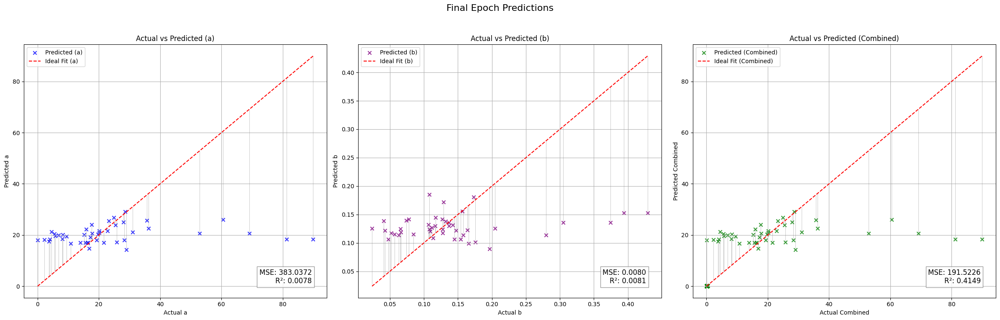

Validation Metrics:
  - MSE: 191.1664
  - R²: 0.0065
  - MAE: 5.9949
  - Explained Variance Score (EVS): 0.0335
Fold 1 Metrics:
  - Validation Loss (MSE): 191.1664
  - R²: 0.0065
  - MAE: 5.9949
  - EVS: 0.0335
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 25.90it/s, loss=1.28]


Validation Metrics:
  - MSE: 92.7476
  - R²: -0.0328
  - MAE: 5.6140
  - Explained Variance Score (EVS): 0.1084
Epoch [1/50], Train Loss: 1.3878, Val Loss: 92.7476
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 24.87it/s, loss=1.53]


Validation Metrics:
  - MSE: 95.5762
  - R²: -0.0471
  - MAE: 5.7508
  - Explained Variance Score (EVS): 0.1102
Epoch [2/50], Train Loss: 1.3724, Val Loss: 95.5762
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.04it/s, loss=1.44]


Validation Metrics:
  - MSE: 93.0156
  - R²: -0.0454
  - MAE: 5.6443
  - Explained Variance Score (EVS): 0.1081
Epoch [3/50], Train Loss: 1.3469, Val Loss: 93.0156
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 27.61it/s, loss=1.38]


Validation Metrics:
  - MSE: 95.0054
  - R²: -0.0528
  - MAE: 5.7412
  - Explained Variance Score (EVS): 0.1112
Epoch [4/50], Train Loss: 1.3199, Val Loss: 95.0054
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 34.84it/s, loss=1.36]


Validation Metrics:
  - MSE: 92.4940
  - R²: -0.0379
  - MAE: 5.6417
  - Explained Variance Score (EVS): 0.1114
Epoch [5/50], Train Loss: 1.2989, Val Loss: 92.4940
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 35.77it/s, loss=1.29]


Validation Metrics:
  - MSE: 94.1772
  - R²: -0.0567
  - MAE: 5.7068
  - Explained Variance Score (EVS): 0.1073
Epoch [6/50], Train Loss: 1.3065, Val Loss: 94.1772
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 35.69it/s, loss=1.24]


Validation Metrics:
  - MSE: 95.0838
  - R²: -0.0588
  - MAE: 5.7417
  - Explained Variance Score (EVS): 0.1027
Epoch [7/50], Train Loss: 1.3009, Val Loss: 95.0838
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 36.79it/s, loss=1.58]


Validation Metrics:
  - MSE: 94.5107
  - R²: -0.0657
  - MAE: 5.7316
  - Explained Variance Score (EVS): 0.1016
Epoch [8/50], Train Loss: 1.2953, Val Loss: 94.5107
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 35.75it/s, loss=1.15]


Validation Metrics:
  - MSE: 93.8499
  - R²: -0.0653
  - MAE: 5.6962
  - Explained Variance Score (EVS): 0.1072
Epoch [9/50], Train Loss: 1.2635, Val Loss: 93.8499
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 37.56it/s, loss=1.17]


Validation Metrics:
  - MSE: 93.7309
  - R²: -0.0507
  - MAE: 5.6837
  - Explained Variance Score (EVS): 0.1093
Epoch [10/50], Train Loss: 1.2516, Val Loss: 93.7309
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 37.02it/s, loss=1.54]


Validation Metrics:
  - MSE: 94.4462
  - R²: -0.0573
  - MAE: 5.7138
  - Explained Variance Score (EVS): 0.1066
Epoch [11/50], Train Loss: 1.2678, Val Loss: 94.4462
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 37.44it/s, loss=1.37]


Validation Metrics:
  - MSE: 94.1840
  - R²: -0.0555
  - MAE: 5.7164
  - Explained Variance Score (EVS): 0.1101
Epoch [12/50], Train Loss: 1.2382, Val Loss: 94.1840
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 34.86it/s, loss=1.1]


Validation Metrics:
  - MSE: 94.0410
  - R²: -0.0609
  - MAE: 5.7199
  - Explained Variance Score (EVS): 0.1074
Epoch [13/50], Train Loss: 1.2040, Val Loss: 94.0410
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 38.32it/s, loss=1.31]


Validation Metrics:
  - MSE: 93.5664
  - R²: -0.0442
  - MAE: 5.6869
  - Explained Variance Score (EVS): 0.1035
Epoch [14/50], Train Loss: 1.2002, Val Loss: 93.5664
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 34.41it/s, loss=1.19]
<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_st

Validation Metrics:
  - MSE: 93.9936
  - R²: -0.0705
  - MAE: 5.7022
  - Explained Variance Score (EVS): 0.0980
Epoch [15/50], Train Loss: 1.2245, Val Loss: 93.9936
Current Dropout Rate: 0.3880
Early stopping triggered!
Loading the best model for evaluation...


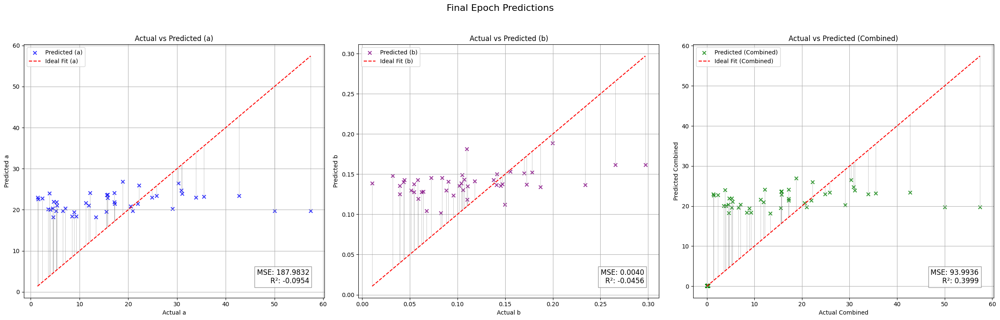

Validation Metrics:
  - MSE: 92.4940
  - R²: -0.0379
  - MAE: 5.6417
  - Explained Variance Score (EVS): 0.1114
Fold 2 Metrics:
  - Validation Loss (MSE): 92.4940
  - R²: -0.0379
  - MAE: 5.6417
  - EVS: 0.1114
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 31.16it/s, loss=1.14]


Validation Metrics:
  - MSE: 112.1171
  - R²: -0.0250
  - MAE: 5.5106
  - Explained Variance Score (EVS): -0.0186
Epoch [1/50], Train Loss: 1.3037, Val Loss: 112.1171
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 36.95it/s, loss=1.31]


Validation Metrics:
  - MSE: 111.8041
  - R²: -0.0209
  - MAE: 5.5115
  - Explained Variance Score (EVS): -0.0171
Epoch [2/50], Train Loss: 1.2963, Val Loss: 111.8041
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 32.07it/s, loss=1.34]


Validation Metrics:
  - MSE: 112.0827
  - R²: -0.0260
  - MAE: 5.5101
  - Explained Variance Score (EVS): -0.0230
Epoch [3/50], Train Loss: 1.2784, Val Loss: 112.0827
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 38.78it/s, loss=1.39]


Validation Metrics:
  - MSE: 112.2752
  - R²: -0.0202
  - MAE: 5.5185
  - Explained Variance Score (EVS): -0.0161
Epoch [4/50], Train Loss: 1.2800, Val Loss: 112.2752
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 31.27it/s, loss=1.47]


Validation Metrics:
  - MSE: 112.8408
  - R²: -0.0241
  - MAE: 5.5498
  - Explained Variance Score (EVS): -0.0191
Epoch [5/50], Train Loss: 1.2458, Val Loss: 112.8408
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 36.04it/s, loss=1.31]


Validation Metrics:
  - MSE: 112.2045
  - R²: -0.0250
  - MAE: 5.5307
  - Explained Variance Score (EVS): -0.0196
Epoch [6/50], Train Loss: 1.2505, Val Loss: 112.2045
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 27.06it/s, loss=1.06]


Validation Metrics:
  - MSE: 112.1476
  - R²: -0.0245
  - MAE: 5.5184
  - Explained Variance Score (EVS): -0.0175
Epoch [7/50], Train Loss: 1.2123, Val Loss: 112.1476
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 25.84it/s, loss=1.13]


Validation Metrics:
  - MSE: 112.6534
  - R²: -0.0216
  - MAE: 5.5278
  - Explained Variance Score (EVS): -0.0150
Epoch [8/50], Train Loss: 1.1880, Val Loss: 112.6534
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 28.52it/s, loss=1.55]


Validation Metrics:
  - MSE: 112.0520
  - R²: -0.0224
  - MAE: 5.5051
  - Explained Variance Score (EVS): -0.0143
Epoch [9/50], Train Loss: 1.2145, Val Loss: 112.0520
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 24.83it/s, loss=1.19]


Validation Metrics:
  - MSE: 112.3196
  - R²: -0.0168
  - MAE: 5.5225
  - Explained Variance Score (EVS): -0.0121
Epoch [10/50], Train Loss: 1.1909, Val Loss: 112.3196
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 25.73it/s, loss=1.11]


Validation Metrics:
  - MSE: 112.2196
  - R²: -0.0211
  - MAE: 5.5057
  - Explained Variance Score (EVS): -0.0122
Epoch [11/50], Train Loss: 1.1797, Val Loss: 112.2196
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 26.15it/s, loss=1.23]


Validation Metrics:
  - MSE: 111.6805
  - R²: -0.0180
  - MAE: 5.4881
  - Explained Variance Score (EVS): -0.0126
Epoch [12/50], Train Loss: 1.1795, Val Loss: 111.6805
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 25.27it/s, loss=1.09]


Validation Metrics:
  - MSE: 111.4096
  - R²: -0.0161
  - MAE: 5.4865
  - Explained Variance Score (EVS): -0.0100
Epoch [13/50], Train Loss: 1.1722, Val Loss: 111.4096
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 27.71it/s, loss=1.18]


Validation Metrics:
  - MSE: 111.9136
  - R²: -0.0187
  - MAE: 5.4925
  - Explained Variance Score (EVS): -0.0132
Epoch [14/50], Train Loss: 1.1488, Val Loss: 111.9136
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 31.85it/s, loss=1.58]


Validation Metrics:
  - MSE: 112.3519
  - R²: -0.0178
  - MAE: 5.5006
  - Explained Variance Score (EVS): -0.0146
Epoch [15/50], Train Loss: 1.1391, Val Loss: 112.3519
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 36.23it/s, loss=1.13]


Validation Metrics:
  - MSE: 111.8500
  - R²: -0.0155
  - MAE: 5.4787
  - Explained Variance Score (EVS): -0.0119
Epoch [16/50], Train Loss: 1.1388, Val Loss: 111.8500
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 31.97it/s, loss=1.25]


Validation Metrics:
  - MSE: 112.5425
  - R²: -0.0155
  - MAE: 5.5100
  - Explained Variance Score (EVS): -0.0106
Epoch [17/50], Train Loss: 1.1245, Val Loss: 112.5425
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 34.17it/s, loss=0.912]


Validation Metrics:
  - MSE: 111.5502
  - R²: -0.0102
  - MAE: 5.4785
  - Explained Variance Score (EVS): -0.0046
Epoch [18/50], Train Loss: 1.1128, Val Loss: 111.5502
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 35.09it/s, loss=1.01]


Validation Metrics:
  - MSE: 111.7185
  - R²: -0.0174
  - MAE: 5.4817
  - Explained Variance Score (EVS): -0.0119
Epoch [19/50], Train Loss: 1.1030, Val Loss: 111.7185
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 35.50it/s, loss=1.2]


Validation Metrics:
  - MSE: 111.5548
  - R²: -0.0130
  - MAE: 5.4723
  - Explained Variance Score (EVS): -0.0073
Epoch [20/50], Train Loss: 1.0984, Val Loss: 111.5548
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 33.05it/s, loss=1.26]


Validation Metrics:
  - MSE: 111.5876
  - R²: -0.0134
  - MAE: 5.4812
  - Explained Variance Score (EVS): -0.0065
Epoch [21/50], Train Loss: 1.0761, Val Loss: 111.5876
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 38.07it/s, loss=1.18]


Validation Metrics:
  - MSE: 111.1702
  - R²: -0.0125
  - MAE: 5.4567
  - Explained Variance Score (EVS): -0.0064
Epoch [22/50], Train Loss: 1.0818, Val Loss: 111.1702
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 33.72it/s, loss=0.988]


Validation Metrics:
  - MSE: 110.6979
  - R²: -0.0057
  - MAE: 5.4457
  - Explained Variance Score (EVS): -0.0012
Epoch [23/50], Train Loss: 1.0680, Val Loss: 110.6979
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 35.69it/s, loss=0.932]


Validation Metrics:
  - MSE: 111.6288
  - R²: -0.0104
  - MAE: 5.4750
  - Explained Variance Score (EVS): -0.0065
Epoch [24/50], Train Loss: 1.0565, Val Loss: 111.6288
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 35.31it/s, loss=1.21]


Validation Metrics:
  - MSE: 110.8892
  - R²: -0.0078
  - MAE: 5.4589
  - Explained Variance Score (EVS): -0.0027
Epoch [25/50], Train Loss: 1.0567, Val Loss: 110.8892
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 37.73it/s, loss=1.2]


Validation Metrics:
  - MSE: 110.9949
  - R²: -0.0097
  - MAE: 5.4548
  - Explained Variance Score (EVS): -0.0036
Epoch [26/50], Train Loss: 1.0385, Val Loss: 110.9949
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 33.64it/s, loss=0.796]


Validation Metrics:
  - MSE: 110.6930
  - R²: -0.0063
  - MAE: 5.4444
  - Explained Variance Score (EVS): -0.0019
Epoch [27/50], Train Loss: 1.0349, Val Loss: 110.6930
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 11/11 [00:00<00:00, 36.72it/s, loss=1.07]


Validation Metrics:
  - MSE: 110.5857
  - R²: -0.0049
  - MAE: 5.4420
  - Explained Variance Score (EVS): -0.0002
Epoch [28/50], Train Loss: 1.0328, Val Loss: 110.5857
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 11/11 [00:00<00:00, 38.34it/s, loss=0.986]


Validation Metrics:
  - MSE: 110.9764
  - R²: -0.0045
  - MAE: 5.4565
  - Explained Variance Score (EVS): -0.0009
Epoch [29/50], Train Loss: 1.0333, Val Loss: 110.9764
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 11/11 [00:00<00:00, 37.42it/s, loss=0.856]


Validation Metrics:
  - MSE: 111.1905
  - R²: -0.0044
  - MAE: 5.4577
  - Explained Variance Score (EVS): -0.0007
Epoch [30/50], Train Loss: 1.0098, Val Loss: 111.1905
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 11/11 [00:00<00:00, 33.51it/s, loss=0.954]


Validation Metrics:
  - MSE: 111.3173
  - R²: -0.0074
  - MAE: 5.4589
  - Explained Variance Score (EVS): -0.0038
Epoch [31/50], Train Loss: 0.9927, Val Loss: 111.3173
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 11/11 [00:00<00:00, 37.36it/s, loss=0.81]


Validation Metrics:
  - MSE: 111.2057
  - R²: -0.0043
  - MAE: 5.4623
  - Explained Variance Score (EVS): -0.0009
Epoch [32/50], Train Loss: 0.9903, Val Loss: 111.2057
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 11/11 [00:00<00:00, 36.52it/s, loss=0.868]


Validation Metrics:
  - MSE: 110.7068
  - R²: -0.0007
  - MAE: 5.4486
  - Explained Variance Score (EVS): 0.0025
Epoch [33/50], Train Loss: 0.9844, Val Loss: 110.7068
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 11/11 [00:00<00:00, 37.50it/s, loss=0.906]


Validation Metrics:
  - MSE: 111.1476
  - R²: -0.0033
  - MAE: 5.4607
  - Explained Variance Score (EVS): -0.0000
Epoch [34/50], Train Loss: 0.9743, Val Loss: 111.1476
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 11/11 [00:00<00:00, 26.34it/s, loss=1.52]


Validation Metrics:
  - MSE: 111.5713
  - R²: -0.0057
  - MAE: 5.4714
  - Explained Variance Score (EVS): -0.0018
Epoch [35/50], Train Loss: 0.9666, Val Loss: 111.5713
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 11/11 [00:00<00:00, 24.85it/s, loss=1.26]


Validation Metrics:
  - MSE: 111.4868
  - R²: -0.0045
  - MAE: 5.4622
  - Explained Variance Score (EVS): -0.0012
Epoch [36/50], Train Loss: 0.9608, Val Loss: 111.4868
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 11/11 [00:00<00:00, 22.82it/s, loss=0.982]


Validation Metrics:
  - MSE: 111.3278
  - R²: -0.0057
  - MAE: 5.4553
  - Explained Variance Score (EVS): -0.0014
Epoch [37/50], Train Loss: 0.9632, Val Loss: 111.3278
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 11/11 [00:00<00:00, 23.91it/s, loss=0.87]


Validation Metrics:
  - MSE: 111.4395
  - R²: -0.0048
  - MAE: 5.4620
  - Explained Variance Score (EVS): -0.0007
Epoch [38/50], Train Loss: 0.9490, Val Loss: 111.4395
Current Dropout Rate: 0.2040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


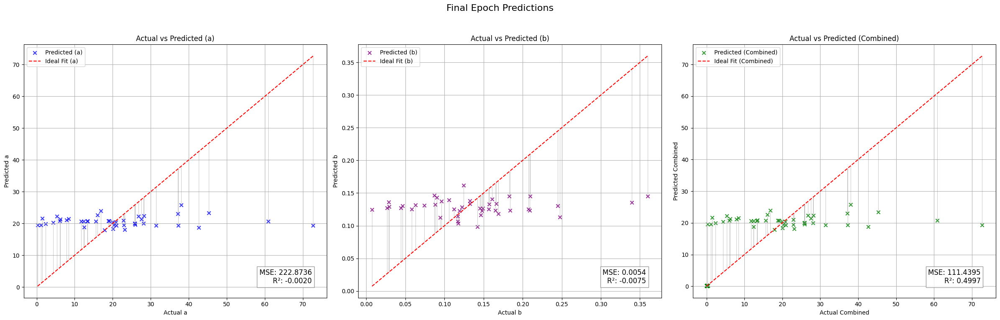

Validation Metrics:
  - MSE: 110.5857
  - R²: -0.0049
  - MAE: 5.4420
  - Explained Variance Score (EVS): -0.0002
Fold 3 Metrics:
  - Validation Loss (MSE): 110.5857
  - R²: -0.0049
  - MAE: 5.4420
  - EVS: -0.0002
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 26.03it/s, loss=1.1]


Validation Metrics:
  - MSE: 89.0932
  - R²: 0.0144
  - MAE: 5.7005
  - Explained Variance Score (EVS): 0.0183
Epoch [1/50], Train Loss: 1.0373, Val Loss: 89.0932
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 29.14it/s, loss=1.31]


Validation Metrics:
  - MSE: 89.4335
  - R²: 0.0140
  - MAE: 5.7052
  - Explained Variance Score (EVS): 0.0164
Epoch [2/50], Train Loss: 1.0228, Val Loss: 89.4335
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 32.95it/s, loss=0.997]


Validation Metrics:
  - MSE: 89.5580
  - R²: 0.0134
  - MAE: 5.7125
  - Explained Variance Score (EVS): 0.0160
Epoch [3/50], Train Loss: 1.0130, Val Loss: 89.5580
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 32.69it/s, loss=0.846]


Validation Metrics:
  - MSE: 89.5423
  - R²: 0.0140
  - MAE: 5.7259
  - Explained Variance Score (EVS): 0.0171
Epoch [4/50], Train Loss: 1.0209, Val Loss: 89.5423
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 36.10it/s, loss=0.939]


Validation Metrics:
  - MSE: 89.4978
  - R²: 0.0155
  - MAE: 5.7150
  - Explained Variance Score (EVS): 0.0173
Epoch [5/50], Train Loss: 1.0004, Val Loss: 89.4978
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 33.53it/s, loss=0.863]


Validation Metrics:
  - MSE: 89.3921
  - R²: 0.0155
  - MAE: 5.7150
  - Explained Variance Score (EVS): 0.0175
Epoch [6/50], Train Loss: 0.9934, Val Loss: 89.3921
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 33.33it/s, loss=0.807]


Validation Metrics:
  - MSE: 89.3294
  - R²: 0.0144
  - MAE: 5.7151
  - Explained Variance Score (EVS): 0.0169
Epoch [7/50], Train Loss: 0.9899, Val Loss: 89.3294
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 34.63it/s, loss=0.832]


Validation Metrics:
  - MSE: 89.7912
  - R²: 0.0128
  - MAE: 5.7185
  - Explained Variance Score (EVS): 0.0150
Epoch [8/50], Train Loss: 0.9834, Val Loss: 89.7912
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 34.24it/s, loss=0.868]


Validation Metrics:
  - MSE: 89.6217
  - R²: 0.0126
  - MAE: 5.7109
  - Explained Variance Score (EVS): 0.0157
Epoch [9/50], Train Loss: 0.9800, Val Loss: 89.6217
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 33.65it/s, loss=0.997]


Validation Metrics:
  - MSE: 89.8011
  - R²: 0.0125
  - MAE: 5.7315
  - Explained Variance Score (EVS): 0.0151
Epoch [10/50], Train Loss: 0.9746, Val Loss: 89.8011
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 33.68it/s, loss=0.738]
<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_s

Validation Metrics:
  - MSE: 89.4368
  - R²: 0.0147
  - MAE: 5.7100
  - Explained Variance Score (EVS): 0.0174
Epoch [11/50], Train Loss: 0.9563, Val Loss: 89.4368
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


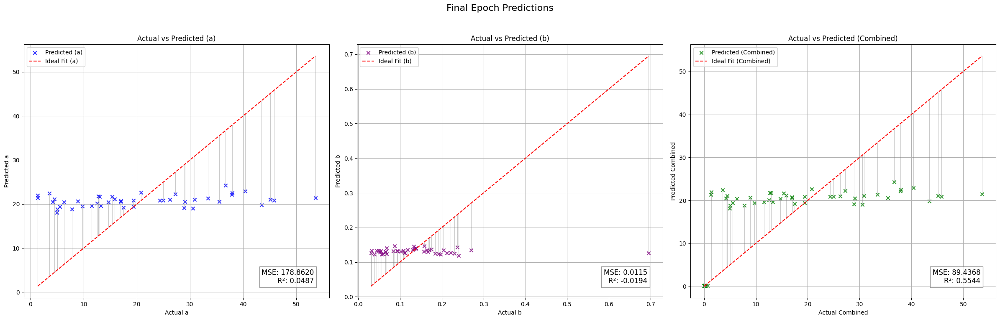

Validation Metrics:
  - MSE: 89.0932
  - R²: 0.0144
  - MAE: 5.7005
  - Explained Variance Score (EVS): 0.0183
Fold 4 Metrics:
  - Validation Loss (MSE): 89.0932
  - R²: 0.0144
  - MAE: 5.7005
  - EVS: 0.0183
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 35.18it/s, loss=1.19]


Validation Metrics:
  - MSE: 175.3175
  - R²: 0.0276
  - MAE: 6.5178
  - Explained Variance Score (EVS): 0.0378
Epoch [1/50], Train Loss: 1.0293, Val Loss: 175.3175
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 33.51it/s, loss=1.03]


Validation Metrics:
  - MSE: 175.8118
  - R²: 0.0264
  - MAE: 6.5230
  - Explained Variance Score (EVS): 0.0352
Epoch [2/50], Train Loss: 1.0318, Val Loss: 175.8118
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 34.65it/s, loss=1.05]


Validation Metrics:
  - MSE: 176.6485
  - R²: 0.0234
  - MAE: 6.5147
  - Explained Variance Score (EVS): 0.0346
Epoch [3/50], Train Loss: 1.0186, Val Loss: 176.6485
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 33.42it/s, loss=1.25]


Validation Metrics:
  - MSE: 175.9205
  - R²: 0.0260
  - MAE: 6.5199
  - Explained Variance Score (EVS): 0.0353
Epoch [4/50], Train Loss: 1.0181, Val Loss: 175.9205
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 31.83it/s, loss=1.4]


Validation Metrics:
  - MSE: 176.0185
  - R²: 0.0243
  - MAE: 6.5149
  - Explained Variance Score (EVS): 0.0344
Epoch [5/50], Train Loss: 1.0194, Val Loss: 176.0185
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 35.29it/s, loss=1.01]


Validation Metrics:
  - MSE: 175.4586
  - R²: 0.0277
  - MAE: 6.5189
  - Explained Variance Score (EVS): 0.0365
Epoch [6/50], Train Loss: 1.0114, Val Loss: 175.4586
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 34.98it/s, loss=1.06]


Validation Metrics:
  - MSE: 175.9706
  - R²: 0.0259
  - MAE: 6.5368
  - Explained Variance Score (EVS): 0.0335
Epoch [7/50], Train Loss: 0.9953, Val Loss: 175.9706
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 24.27it/s, loss=0.957]


Validation Metrics:
  - MSE: 175.7713
  - R²: 0.0268
  - MAE: 6.5050
  - Explained Variance Score (EVS): 0.0356
Epoch [8/50], Train Loss: 1.0057, Val Loss: 175.7713
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 24.63it/s, loss=1.01]


Validation Metrics:
  - MSE: 175.9892
  - R²: 0.0257
  - MAE: 6.5181
  - Explained Variance Score (EVS): 0.0355
Epoch [9/50], Train Loss: 0.9959, Val Loss: 175.9892
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 25.83it/s, loss=1.17]


Validation Metrics:
  - MSE: 175.7131
  - R²: 0.0254
  - MAE: 6.5138
  - Explained Variance Score (EVS): 0.0349
Epoch [10/50], Train Loss: 0.9998, Val Loss: 175.7131
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 26.61it/s, loss=1.06]


Validation Metrics:
  - MSE: 176.0423
  - R²: 0.0232
  - MAE: 6.5163
  - Explained Variance Score (EVS): 0.0330
Epoch [11/50], Train Loss: 0.9959, Val Loss: 176.0423
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


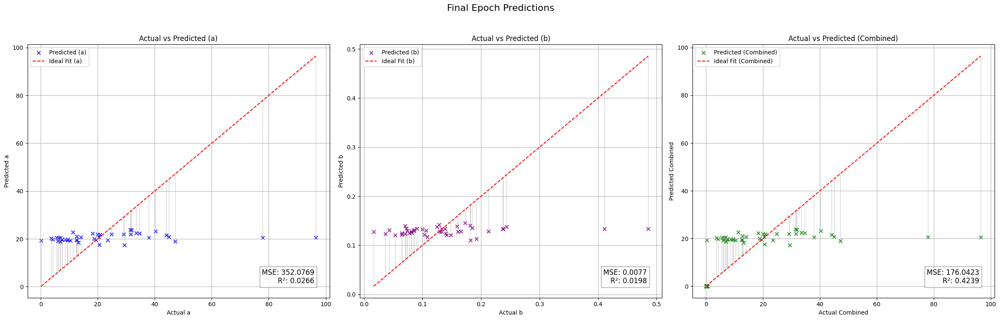

[I 2024-12-01 16:52:31,652] Trial 0 finished with value: 131.73135375976562 and parameters: {'num_layers': 2, 'hidden_size_0': 416, 'activation_0': 'ReLU', 'dropout_0': 0.4827133556593559, 'hidden_size_1': 149, 'activation_1': 'ELU', 'dropout_1': 0.25279343948627575, 'batch_size': 16, 'learning_rate': 0.000134292437548814, 'optimizer': 'SGD'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 175.3175
  - R²: 0.0276
  - MAE: 6.5178
  - Explained Variance Score (EVS): 0.0378
Fold 5 Metrics:
  - Validation Loss (MSE): 175.3175
  - R²: 0.0276
  - MAE: 6.5178
  - EVS: 0.0378
Avg Validation Metrics:
  - MSE: 131.7314
  - R²: 0.0011
  - MAE: 5.8594
  - EVS: 0.0402
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 20.06it/s, loss=0.55]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0206
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.8926, Val Loss: 197.3764
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 21.95it/s, loss=0.586]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0200
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.5602, Val Loss: 197.3764
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 29.94it/s, loss=0.944]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4979, Val Loss: 197.4225
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 29.87it/s, loss=0.55]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4716, Val Loss: 197.4225
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 29.41it/s, loss=0.321]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4589, Val Loss: 197.4690
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 28.54it/s, loss=0.698]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4566, Val Loss: 197.4690
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 28.55it/s, loss=0.316]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0204
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4520, Val Loss: 197.4690
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 28.86it/s, loss=0.382]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0205
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4509, Val Loss: 197.5156
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 29.38it/s, loss=0.584]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0205
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4505, Val Loss: 197.5156
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 25.65it/s, loss=0.336]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0207
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4479, Val Loss: 197.5625
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 28.84it/s, loss=0.302]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0207
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4465, Val Loss: 197.5625
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 28.62it/s, loss=0.468]
<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_s

Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.4467, Val Loss: 197.5156
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


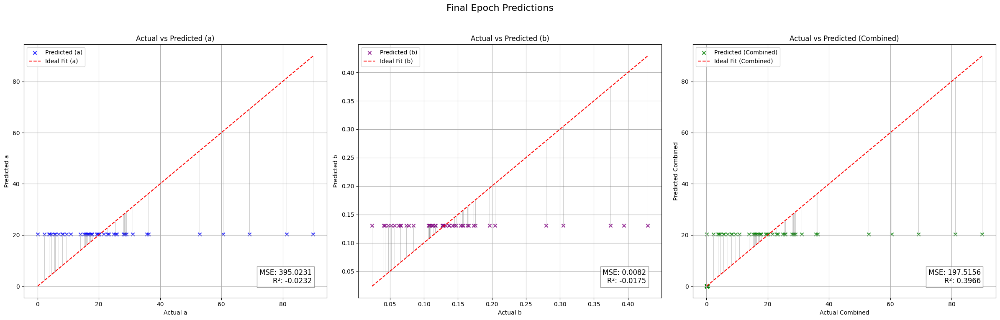

Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0200
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.3764
  - R²: -0.0200
  - MAE: 6.4537
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 30.32it/s, loss=0.476]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1714
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4944, Val Loss: 98.4316
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 27.88it/s, loss=0.478]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4684, Val Loss: 98.3532
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 30.08it/s, loss=0.459]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4566, Val Loss: 98.3532
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 25.71it/s, loss=0.379]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4504, Val Loss: 98.3532
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 18.81it/s, loss=0.501]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4484, Val Loss: 98.2750
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 21.75it/s, loss=0.433]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4464, Val Loss: 98.2750
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 23.51it/s, loss=0.339]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4448, Val Loss: 98.1971
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 23.32it/s, loss=0.514]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4448, Val Loss: 98.1971
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 21.21it/s, loss=0.653]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4448, Val Loss: 98.1971
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 21.22it/s, loss=0.383]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4425, Val Loss: 98.1195
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 20.42it/s, loss=0.509]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4425, Val Loss: 98.1195
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 21.06it/s, loss=0.59]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4423, Val Loss: 98.1195
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 28.25it/s, loss=0.494]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4411, Val Loss: 98.0420
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 25.03it/s, loss=0.438]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4401, Val Loss: 98.0420
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 27.85it/s, loss=0.314]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4388, Val Loss: 98.1195
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 27.54it/s, loss=0.559]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4395, Val Loss: 98.1195
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 27.53it/s, loss=0.369]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4378, Val Loss: 98.1971
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 29.34it/s, loss=0.746]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.4395, Val Loss: 98.1971
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 27.96it/s, loss=0.263]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.4362, Val Loss: 98.1195
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 28.07it/s, loss=0.387]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.4362, Val Loss: 98.1195
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 28.05it/s, loss=0.594]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.4369, Val Loss: 98.1195
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 28.95it/s, loss=0.469]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.4357, Val Loss: 98.0420
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 28.39it/s, loss=0.582]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [23/50], Train Loss: 0.4357, Val Loss: 98.1971
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


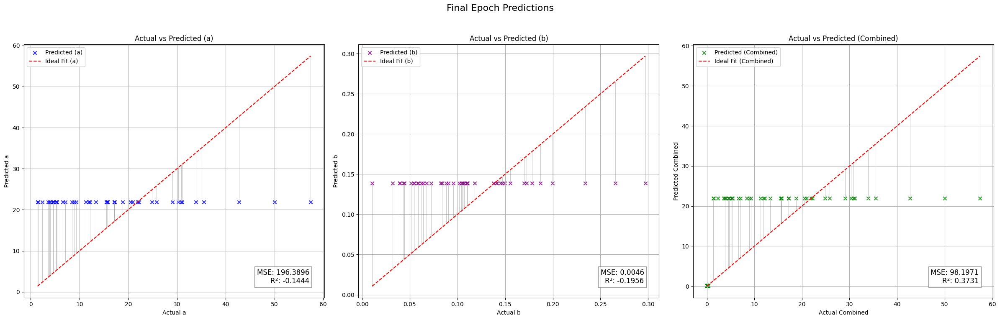

Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 26.52it/s, loss=0.56]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0007
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4382, Val Loss: 111.2985
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 27.71it/s, loss=0.324]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4364, Val Loss: 111.2922
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 25.65it/s, loss=0.453]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4367, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 19.15it/s, loss=0.361]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4356, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 20.33it/s, loss=0.395]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4353, Val Loss: 111.2861
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 19.67it/s, loss=0.702]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4366, Val Loss: 111.2861
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 18.67it/s, loss=0.558]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4352, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 18.77it/s, loss=0.617]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4351, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 20.32it/s, loss=0.284]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4327, Val Loss: 111.2861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.88it/s, loss=0.635]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4343, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 21.84it/s, loss=0.301]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4319, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 27.71it/s, loss=0.457]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4323, Val Loss: 111.2861
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 25.93it/s, loss=0.47]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4320, Val Loss: 111.2861
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


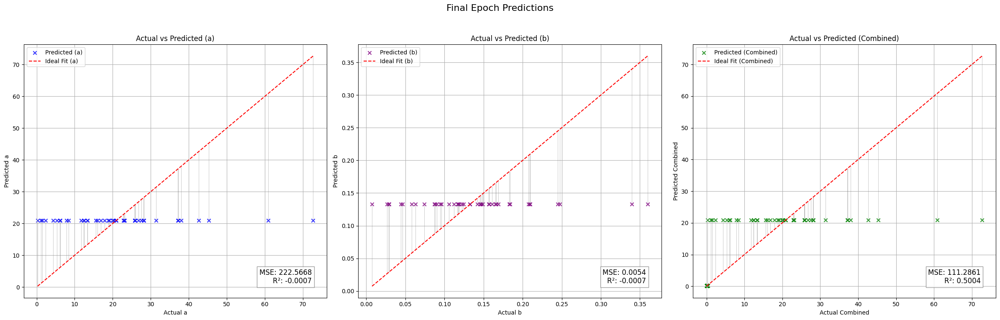

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 27.70it/s, loss=0.55]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4480, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 26.24it/s, loss=0.475]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4471, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.13it/s, loss=0.318]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4458, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 27.64it/s, loss=0.53]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4465, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 24.97it/s, loss=0.353]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4451, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 25.25it/s, loss=0.491]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4454, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 27.74it/s, loss=0.308]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4440, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 26.57it/s, loss=0.403]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4441, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 25.07it/s, loss=0.356]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4434, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 26.09it/s, loss=0.362]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4431, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 26.72it/s, loss=0.559]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4440, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


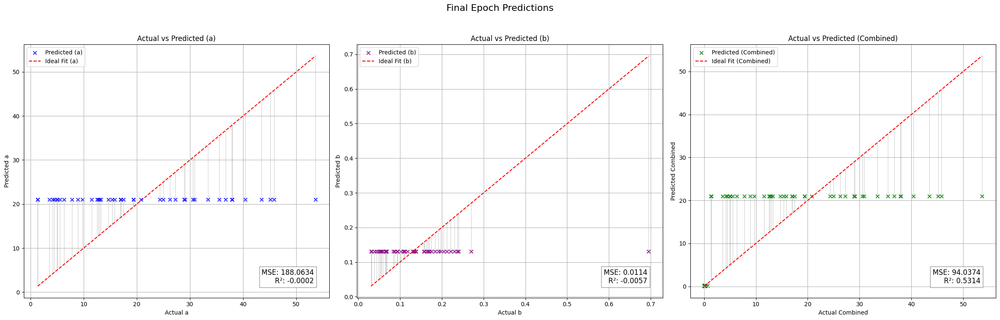

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 21.23it/s, loss=0.391]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4455, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 19.80it/s, loss=0.322]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4453, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 22.79it/s, loss=0.357]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4451, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 22.19it/s, loss=0.298]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4449, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 22.00it/s, loss=0.455]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4446, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 19.25it/s, loss=0.67]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4444, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 24.87it/s, loss=0.468]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4442, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 25.50it/s, loss=0.498]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4440, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 25.34it/s, loss=0.497]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4438, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 26.55it/s, loss=0.622]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4437, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 27.16it/s, loss=0.435]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4436, Val Loss: 182.6491
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


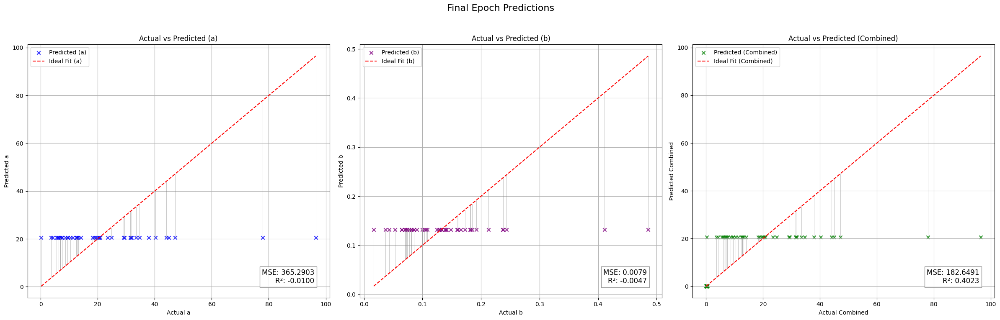

[I 2024-12-01 16:53:28,253] Trial 1 finished with value: 136.67819213867188 and parameters: {'num_layers': 4, 'hidden_size_0': 188, 'activation_0': 'ReLU', 'dropout_0': 0.23479185693116922, 'hidden_size_1': 194, 'activation_1': 'ReLU', 'dropout_1': 0.4983244165273125, 'hidden_size_2': 207, 'activation_2': 'ReLU', 'dropout_2': 0.13750438657289635, 'hidden_size_3': 421, 'activation_3': 'ReLU', 'dropout_3': 0.1947677029010008, 'batch_size': 16, 'learning_rate': 0.003178919853239911, 'optimizer': 'Adagrad'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6782
  - R²: -0.0397
  - MAE: 6.0968
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 28.00it/s, loss=0.584]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.9528, Val Loss: 197.5156
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 29.42it/s, loss=0.341]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3879, Val Loss: 197.4690
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.18it/s, loss=0.214]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3794, Val Loss: 197.5156
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 32.06it/s, loss=0.403]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3753, Val Loss: 197.5156
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 31.18it/s, loss=0.224]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3709, Val Loss: 197.4690
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 28.23it/s, loss=0.56]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3706, Val Loss: 197.4690
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 28.49it/s, loss=0.295]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3676, Val Loss: 197.4225
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 29.68it/s, loss=0.318]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3670, Val Loss: 197.1942
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 21.95it/s, loss=0.525]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0198
  - MAE: 6.4495
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3677, Val Loss: 197.5156
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.74it/s, loss=0.311]


Validation Metrics:
  - MSE: 197.7047
  - R²: -0.0214
  - MAE: 6.4438
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3697, Val Loss: 197.7047
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 18.35it/s, loss=0.467]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0207
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3967, Val Loss: 197.5625
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 20.98it/s, loss=0.326]


Validation Metrics:
  - MSE: 197.0159
  - R²: -0.0179
  - MAE: 6.4651
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4003, Val Loss: 197.0159
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 19.83it/s, loss=0.419]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0201
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.4630, Val Loss: 197.4225
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 21.10it/s, loss=0.748]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0201
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.5740, Val Loss: 197.4225
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 25.47it/s, loss=0.814]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0200
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.5714, Val Loss: 197.5156
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 23.44it/s, loss=0.546]


Validation Metrics:
  - MSE: 197.1046
  - R²: -0.0189
  - MAE: 6.4623
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.5364, Val Loss: 197.1046
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 23.78it/s, loss=0.278]


Validation Metrics:
  - MSE: 197.8490
  - R²: -0.0200
  - MAE: 6.4396
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4370, Val Loss: 197.8490
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 25.88it/s, loss=0.457]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0199
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [18/50], Train Loss: 0.4360, Val Loss: 197.1942
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 28.12it/s, loss=0.411]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0191
  - MAE: 6.4538
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.5473, Val Loss: 197.3764
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 29.25it/s, loss=0.307]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [20/50], Train Loss: 0.3866, Val Loss: 197.4690
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 27.92it/s, loss=0.276]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [21/50], Train Loss: 0.3649, Val Loss: 197.4690
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 28.28it/s, loss=0.522]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [22/50], Train Loss: 0.3662, Val Loss: 197.4225
Current Dropout Rate: 0.3320
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


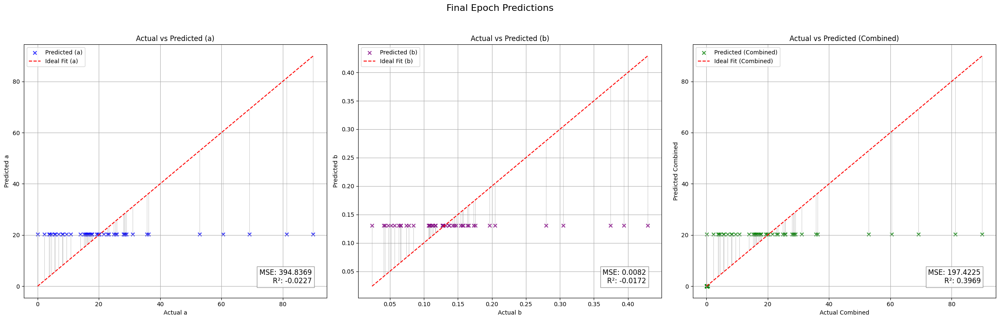

Validation Metrics:
  - MSE: 197.0159
  - R²: -0.0179
  - MAE: 6.4651
  - Explained Variance Score (EVS): -0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.0159
  - R²: -0.0179
  - MAE: 6.4651
  - EVS: -0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 28.60it/s, loss=0.261]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1727
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3607, Val Loss: 98.5102
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 28.13it/s, loss=0.279]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3564, Val Loss: 98.3532
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.45it/s, loss=0.424]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3573, Val Loss: 98.3532
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 30.81it/s, loss=0.173]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3559, Val Loss: 98.2750
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 27.67it/s, loss=0.148]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3558, Val Loss: 98.2750
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 26.90it/s, loss=0.422]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3574, Val Loss: 98.3532
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 28.52it/s, loss=0.141]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3559, Val Loss: 98.3532
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 27.21it/s, loss=0.615]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3589, Val Loss: 98.3532
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 27.05it/s, loss=0.406]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3584, Val Loss: 98.2750
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 21.99it/s, loss=0.521]


Validation Metrics:
  - MSE: 98.3531
  - R²: -0.1701
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3633, Val Loss: 98.3531
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 21.20it/s, loss=0.448]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4069, Val Loss: 98.4316
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 21.26it/s, loss=0.462]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4817, Val Loss: 98.1971
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 21.57it/s, loss=0.206]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1682
  - MAE: 5.9368
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4313, Val Loss: 98.0420
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 21.67it/s, loss=0.404]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1736
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4243, Val Loss: 98.5102
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 21.55it/s, loss=0.506]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1709
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4235, Val Loss: 98.1971
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 22.29it/s, loss=0.329]


Validation Metrics:
  - MSE: 98.3531
  - R²: -0.1701
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4078, Val Loss: 98.3531
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 19.30it/s, loss=0.15]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3647, Val Loss: 98.3532
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 22.45it/s, loss=0.225]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3561, Val Loss: 98.3532
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 29.78it/s, loss=0.514]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3577, Val Loss: 98.3532
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 27.93it/s, loss=0.285]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.3564, Val Loss: 98.3532
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 29.19it/s, loss=0.621]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.3584, Val Loss: 98.3532
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 28.75it/s, loss=0.435]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.3573, Val Loss: 98.4316
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 27.85it/s, loss=0.231]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [23/50], Train Loss: 0.3562, Val Loss: 98.3532
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


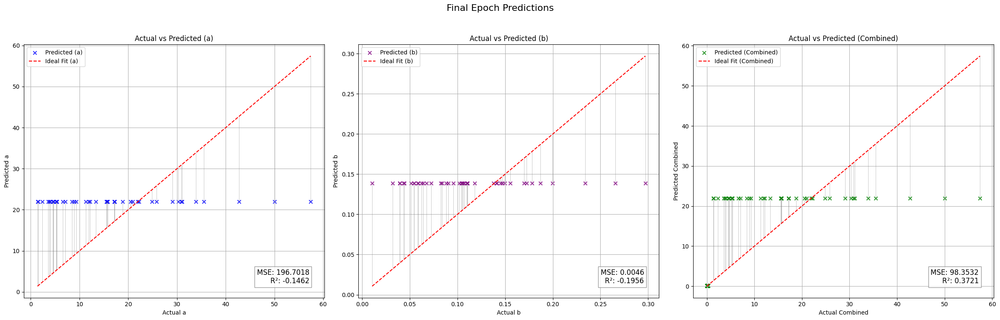

Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1682
  - MAE: 5.9368
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.0420
  - R²: -0.1682
  - MAE: 5.9368
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 27.47it/s, loss=0.357]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3645, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 27.06it/s, loss=0.348]


Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3546, Val Loss: 111.2747
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 30.06it/s, loss=0.324]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3546, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 27.68it/s, loss=0.11]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0006
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3535, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 28.53it/s, loss=0.206]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3548, Val Loss: 111.2985
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 29.56it/s, loss=0.243]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3578, Val Loss: 111.2922
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 28.70it/s, loss=0.301]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3843, Val Loss: 111.2985
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 23.81it/s, loss=0.407]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4150, Val Loss: 111.2922
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 20.57it/s, loss=0.46]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4063, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 21.13it/s, loss=0.32]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0006
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3976, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 21.93it/s, loss=0.538]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3726, Val Loss: 111.2985
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 22.64it/s, loss=0.748]


Validation Metrics:
  - MSE: 111.2693
  - R²: -0.0005
  - MAE: 5.4429
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3935, Val Loss: 111.2693
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 21.83it/s, loss=0.473]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4153, Val Loss: 111.2861
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 20.86it/s, loss=0.396]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4101, Val Loss: 111.2922
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 22.20it/s, loss=0.297]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3994, Val Loss: 111.2985
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 19.86it/s, loss=0.509]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3582, Val Loss: 111.2922
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 20.22it/s, loss=0.377]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3546, Val Loss: 111.2922
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 27.11it/s, loss=0.348]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3544, Val Loss: 111.2922
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 25.05it/s, loss=0.443]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3550, Val Loss: 111.2922
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 26.06it/s, loss=0.298]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.3542, Val Loss: 111.2861
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 26.30it/s, loss=0.239]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.3538, Val Loss: 111.2861
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 29.09it/s, loss=0.301]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.3542, Val Loss: 111.2922
Current Dropout Rate: 0.3320
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


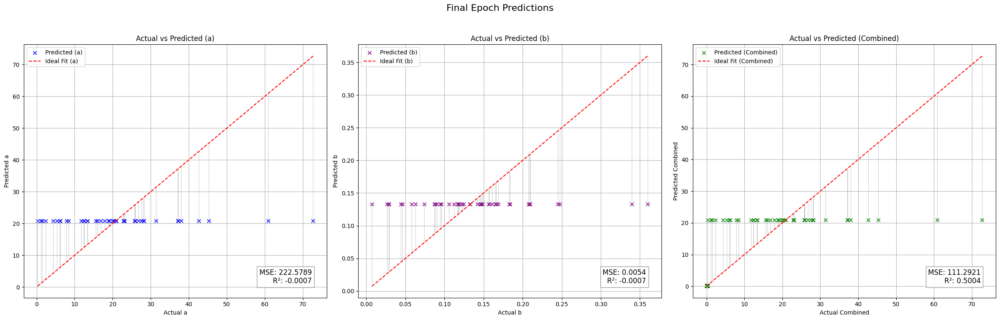

Validation Metrics:
  - MSE: 111.2693
  - R²: -0.0005
  - MAE: 5.4429
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2693
  - R²: -0.0005
  - MAE: 5.4429
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 28.66it/s, loss=0.28]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3756, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 28.11it/s, loss=0.222]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3651, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 28.13it/s, loss=0.673]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3678, Val Loss: 94.0346
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 29.34it/s, loss=0.334]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3659, Val Loss: 94.0346
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 27.46it/s, loss=0.164]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3646, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 26.59it/s, loss=0.227]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3650, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 29.93it/s, loss=0.391]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3659, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 23.39it/s, loss=0.346]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3657, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 24.38it/s, loss=0.397]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3660, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 22.99it/s, loss=0.264]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3652, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 18.93it/s, loss=0.715]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3678, Val Loss: 94.0374
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 21.55it/s, loss=0.289]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3654, Val Loss: 94.0374
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 20.99it/s, loss=0.271]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3653, Val Loss: 94.0404
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


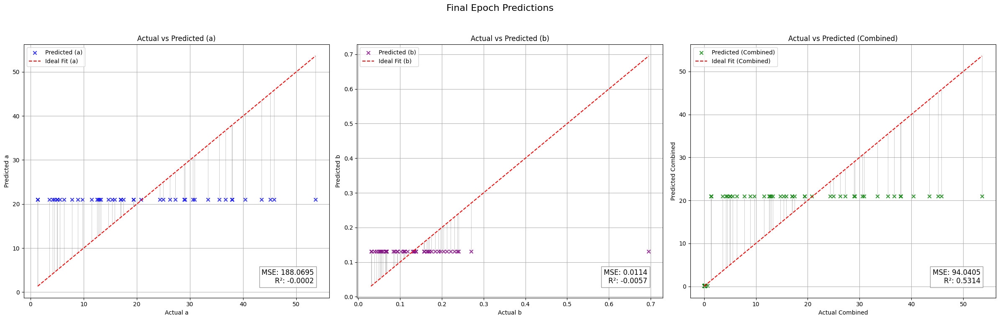

Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 29.26it/s, loss=0.289]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.3643, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 26.04it/s, loss=0.61]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3645, Val Loss: 182.6789
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 28.22it/s, loss=0.429]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 28.04it/s, loss=0.39]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 26.65it/s, loss=0.271]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3642, Val Loss: 182.6789
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 26.65it/s, loss=0.547]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 27.77it/s, loss=0.564]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 26.94it/s, loss=0.642]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 30.67it/s, loss=0.785]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3642, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 27.47it/s, loss=0.175]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3642, Val Loss: 182.6789
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 27.45it/s, loss=0.527]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3643, Val Loss: 182.6789
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


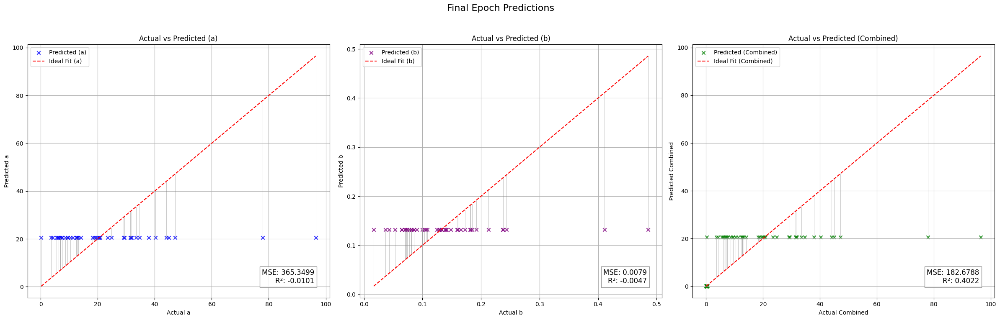

[I 2024-12-01 16:54:44,659] Trial 2 finished with value: 136.6021728515625 and parameters: {'num_layers': 2, 'hidden_size_0': 195, 'activation_0': 'LeakyReLU', 'dropout_0': 0.12266713614226404, 'hidden_size_1': 330, 'activation_1': 'ELU', 'dropout_1': 0.4266597466687284, 'batch_size': 16, 'learning_rate': 0.0026471639991726015, 'optimizer': 'RMSprop'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6022
  - R²: -0.0394
  - MAE: 6.0995
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 26.29it/s, loss=1.7]


Validation Metrics:
  - MSE: 197.9491
  - R²: -0.0163
  - MAE: 6.3923
  - Explained Variance Score (EVS): 0.0048
Epoch [1/50], Train Loss: 1.7598, Val Loss: 197.9491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 20.35it/s, loss=1.87]


Validation Metrics:
  - MSE: 195.3160
  - R²: -0.0106
  - MAE: 6.3586
  - Explained Variance Score (EVS): 0.0137
Epoch [2/50], Train Loss: 1.7521, Val Loss: 195.3160
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 21.42it/s, loss=1.75]


Validation Metrics:
  - MSE: 195.8021
  - R²: -0.0125
  - MAE: 6.3708
  - Explained Variance Score (EVS): 0.0139
Epoch [3/50], Train Loss: 1.7315, Val Loss: 195.8021
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 20.76it/s, loss=1.84]


Validation Metrics:
  - MSE: 197.3128
  - R²: -0.0239
  - MAE: 6.3476
  - Explained Variance Score (EVS): 0.0048
Epoch [4/50], Train Loss: 1.7123, Val Loss: 197.3128
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 19.66it/s, loss=1.58]


Validation Metrics:
  - MSE: 197.9398
  - R²: -0.0382
  - MAE: 6.2885
  - Explained Variance Score (EVS): -0.0013
Epoch [5/50], Train Loss: 1.6645, Val Loss: 197.9398
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 21.65it/s, loss=1.76]


Validation Metrics:
  - MSE: 200.4842
  - R²: -0.0547
  - MAE: 6.2478
  - Explained Variance Score (EVS): -0.0053
Epoch [6/50], Train Loss: 1.6405, Val Loss: 200.4842
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 19.46it/s, loss=1.54]


Validation Metrics:
  - MSE: 198.9315
  - R²: -0.0597
  - MAE: 6.2210
  - Explained Variance Score (EVS): -0.0074
Epoch [7/50], Train Loss: 1.6256, Val Loss: 198.9315
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 22.53it/s, loss=1.76]


Validation Metrics:
  - MSE: 199.3244
  - R²: -0.0759
  - MAE: 6.2249
  - Explained Variance Score (EVS): -0.0166
Epoch [8/50], Train Loss: 1.6150, Val Loss: 199.3244
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 20.06it/s, loss=1.61]


Validation Metrics:
  - MSE: 198.1132
  - R²: -0.0727
  - MAE: 6.2125
  - Explained Variance Score (EVS): -0.0152
Epoch [9/50], Train Loss: 1.6221, Val Loss: 198.1132
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 22.62it/s, loss=1.5]


Validation Metrics:
  - MSE: 198.5491
  - R²: -0.0691
  - MAE: 6.1978
  - Explained Variance Score (EVS): -0.0143
Epoch [10/50], Train Loss: 1.5966, Val Loss: 198.5491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 24.85it/s, loss=1.47]


Validation Metrics:
  - MSE: 198.4045
  - R²: -0.0642
  - MAE: 6.2129
  - Explained Variance Score (EVS): -0.0055
Epoch [11/50], Train Loss: 1.5727, Val Loss: 198.4045
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 25.11it/s, loss=1.35]


Validation Metrics:
  - MSE: 198.7054
  - R²: -0.0654
  - MAE: 6.2178
  - Explained Variance Score (EVS): -0.0014
Epoch [12/50], Train Loss: 1.5523, Val Loss: 198.7054
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


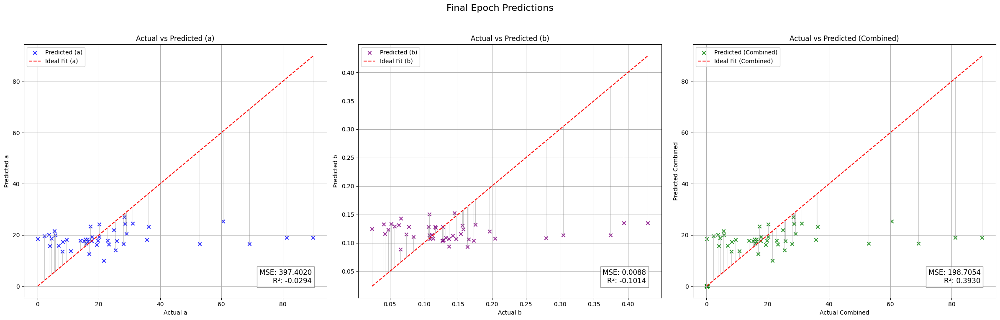

Validation Metrics:
  - MSE: 195.3160
  - R²: -0.0106
  - MAE: 6.3586
  - Explained Variance Score (EVS): 0.0137
Fold 1 Metrics:
  - Validation Loss (MSE): 195.3160
  - R²: -0.0106
  - MAE: 6.3586
  - EVS: 0.0137
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 27.54it/s, loss=1.93]


Validation Metrics:
  - MSE: 94.7541
  - R²: -0.1115
  - MAE: 5.7825
  - Explained Variance Score (EVS): 0.0346
Epoch [1/50], Train Loss: 1.7225, Val Loss: 94.7541
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 25.63it/s, loss=1.62]


Validation Metrics:
  - MSE: 93.7194
  - R²: -0.0784
  - MAE: 5.7109
  - Explained Variance Score (EVS): 0.0411
Epoch [2/50], Train Loss: 1.7024, Val Loss: 93.7194
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.99it/s, loss=1.49]


Validation Metrics:
  - MSE: 92.9331
  - R²: -0.0500
  - MAE: 5.6321
  - Explained Variance Score (EVS): 0.0435
Epoch [3/50], Train Loss: 1.6389, Val Loss: 92.9331
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 28.67it/s, loss=1.71]


Validation Metrics:
  - MSE: 92.1296
  - R²: -0.0330
  - MAE: 5.5510
  - Explained Variance Score (EVS): 0.0390
Epoch [4/50], Train Loss: 1.6627, Val Loss: 92.1296
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 26.33it/s, loss=1.58]


Validation Metrics:
  - MSE: 91.8528
  - R²: -0.0251
  - MAE: 5.4958
  - Explained Variance Score (EVS): 0.0294
Epoch [5/50], Train Loss: 1.6468, Val Loss: 91.8528
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 27.66it/s, loss=1.79]


Validation Metrics:
  - MSE: 92.9460
  - R²: -0.0160
  - MAE: 5.4961
  - Explained Variance Score (EVS): 0.0274
Epoch [6/50], Train Loss: 1.5989, Val Loss: 92.9460
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 24.65it/s, loss=1.6]


Validation Metrics:
  - MSE: 91.4443
  - R²: -0.0103
  - MAE: 5.4190
  - Explained Variance Score (EVS): 0.0266
Epoch [7/50], Train Loss: 1.6258, Val Loss: 91.4443
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 26.75it/s, loss=1.7]


Validation Metrics:
  - MSE: 92.4187
  - R²: -0.0178
  - MAE: 5.4611
  - Explained Variance Score (EVS): 0.0226
Epoch [8/50], Train Loss: 1.5853, Val Loss: 92.4187
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 24.61it/s, loss=1.5]


Validation Metrics:
  - MSE: 91.6328
  - R²: -0.0166
  - MAE: 5.4590
  - Explained Variance Score (EVS): 0.0302
Epoch [9/50], Train Loss: 1.5730, Val Loss: 91.6328
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.93it/s, loss=1.49]


Validation Metrics:
  - MSE: 91.7405
  - R²: -0.0206
  - MAE: 5.4599
  - Explained Variance Score (EVS): 0.0258
Epoch [10/50], Train Loss: 1.5606, Val Loss: 91.7405
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 22.56it/s, loss=1.41]


Validation Metrics:
  - MSE: 91.2386
  - R²: -0.0216
  - MAE: 5.4459
  - Explained Variance Score (EVS): 0.0257
Epoch [11/50], Train Loss: 1.5411, Val Loss: 91.2386
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 20.45it/s, loss=1.48]


Validation Metrics:
  - MSE: 91.6908
  - R²: -0.0212
  - MAE: 5.4867
  - Explained Variance Score (EVS): 0.0320
Epoch [12/50], Train Loss: 1.5197, Val Loss: 91.6908
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 20.49it/s, loss=1.56]


Validation Metrics:
  - MSE: 91.8136
  - R²: -0.0184
  - MAE: 5.4902
  - Explained Variance Score (EVS): 0.0318
Epoch [13/50], Train Loss: 1.5111, Val Loss: 91.8136
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 20.75it/s, loss=1.39]


Validation Metrics:
  - MSE: 91.3072
  - R²: -0.0126
  - MAE: 5.4750
  - Explained Variance Score (EVS): 0.0398
Epoch [14/50], Train Loss: 1.5017, Val Loss: 91.3072
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 18.13it/s, loss=1.28]


Validation Metrics:
  - MSE: 91.1668
  - R²: -0.0223
  - MAE: 5.4616
  - Explained Variance Score (EVS): 0.0336
Epoch [15/50], Train Loss: 1.4792, Val Loss: 91.1668
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 20.18it/s, loss=1.36]


Validation Metrics:
  - MSE: 91.6758
  - R²: -0.0203
  - MAE: 5.4849
  - Explained Variance Score (EVS): 0.0354
Epoch [16/50], Train Loss: 1.4688, Val Loss: 91.6758
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 21.76it/s, loss=1.64]


Validation Metrics:
  - MSE: 90.5053
  - R²: -0.0197
  - MAE: 5.4427
  - Explained Variance Score (EVS): 0.0404
Epoch [17/50], Train Loss: 1.4478, Val Loss: 90.5053
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 27.09it/s, loss=1.63]


Validation Metrics:
  - MSE: 90.2333
  - R²: -0.0128
  - MAE: 5.4394
  - Explained Variance Score (EVS): 0.0464
Epoch [18/50], Train Loss: 1.4322, Val Loss: 90.2333
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 24.22it/s, loss=1.34]


Validation Metrics:
  - MSE: 90.7645
  - R²: -0.0245
  - MAE: 5.4422
  - Explained Variance Score (EVS): 0.0327
Epoch [19/50], Train Loss: 1.4271, Val Loss: 90.7645
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 26.04it/s, loss=1.58]


Validation Metrics:
  - MSE: 90.7922
  - R²: -0.0168
  - MAE: 5.4574
  - Explained Variance Score (EVS): 0.0402
Epoch [20/50], Train Loss: 1.4050, Val Loss: 90.7922
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 27.61it/s, loss=1.38]


Validation Metrics:
  - MSE: 90.1321
  - R²: -0.0150
  - MAE: 5.4308
  - Explained Variance Score (EVS): 0.0413
Epoch [21/50], Train Loss: 1.3971, Val Loss: 90.1321
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 24.77it/s, loss=1.13]


Validation Metrics:
  - MSE: 91.3651
  - R²: -0.0319
  - MAE: 5.4694
  - Explained Variance Score (EVS): 0.0278
Epoch [22/50], Train Loss: 1.3940, Val Loss: 91.3651
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 24.04it/s, loss=1.27]


Validation Metrics:
  - MSE: 92.1482
  - R²: -0.0335
  - MAE: 5.5412
  - Explained Variance Score (EVS): 0.0324
Epoch [23/50], Train Loss: 1.3654, Val Loss: 92.1482
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 22.32it/s, loss=1.53]


Validation Metrics:
  - MSE: 90.1429
  - R²: -0.0241
  - MAE: 5.4536
  - Explained Variance Score (EVS): 0.0387
Epoch [24/50], Train Loss: 1.3517, Val Loss: 90.1429
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 27.07it/s, loss=1.27]


Validation Metrics:
  - MSE: 91.1595
  - R²: -0.0343
  - MAE: 5.4807
  - Explained Variance Score (EVS): 0.0342
Epoch [25/50], Train Loss: 1.3490, Val Loss: 91.1595
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 26.35it/s, loss=1.2]


Validation Metrics:
  - MSE: 89.9540
  - R²: -0.0257
  - MAE: 5.4314
  - Explained Variance Score (EVS): 0.0417
Epoch [26/50], Train Loss: 1.3223, Val Loss: 89.9540
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 24.82it/s, loss=1.23]


Validation Metrics:
  - MSE: 90.7301
  - R²: -0.0344
  - MAE: 5.4798
  - Explained Variance Score (EVS): 0.0376
Epoch [27/50], Train Loss: 1.3115, Val Loss: 90.7301
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 11/11 [00:00<00:00, 22.35it/s, loss=1.71]


Validation Metrics:
  - MSE: 92.0079
  - R²: -0.0416
  - MAE: 5.5329
  - Explained Variance Score (EVS): 0.0317
Epoch [28/50], Train Loss: 1.3061, Val Loss: 92.0079
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 11/11 [00:00<00:00, 24.29it/s, loss=1.29]


Validation Metrics:
  - MSE: 92.0023
  - R²: -0.0350
  - MAE: 5.5356
  - Explained Variance Score (EVS): 0.0377
Epoch [29/50], Train Loss: 1.2937, Val Loss: 92.0023
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 11/11 [00:00<00:00, 27.82it/s, loss=1.16]


Validation Metrics:
  - MSE: 91.4851
  - R²: -0.0349
  - MAE: 5.5155
  - Explained Variance Score (EVS): 0.0364
Epoch [30/50], Train Loss: 1.2739, Val Loss: 91.4851
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 11/11 [00:00<00:00, 21.66it/s, loss=1.09]


Validation Metrics:
  - MSE: 91.5225
  - R²: -0.0383
  - MAE: 5.5218
  - Explained Variance Score (EVS): 0.0373
Epoch [31/50], Train Loss: 1.2696, Val Loss: 91.5225
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 11/11 [00:00<00:00, 20.87it/s, loss=1.24]


Validation Metrics:
  - MSE: 91.3850
  - R²: -0.0364
  - MAE: 5.5229
  - Explained Variance Score (EVS): 0.0363
Epoch [32/50], Train Loss: 1.2608, Val Loss: 91.3850
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 11/11 [00:00<00:00, 19.97it/s, loss=1.44]


Validation Metrics:
  - MSE: 91.7529
  - R²: -0.0473
  - MAE: 5.5561
  - Explained Variance Score (EVS): 0.0345
Epoch [33/50], Train Loss: 1.2488, Val Loss: 91.7529
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 11/11 [00:00<00:00, 19.85it/s, loss=1.28]


Validation Metrics:
  - MSE: 91.2628
  - R²: -0.0363
  - MAE: 5.5340
  - Explained Variance Score (EVS): 0.0397
Epoch [34/50], Train Loss: 1.2319, Val Loss: 91.2628
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 11/11 [00:00<00:00, 22.87it/s, loss=1.08]


Validation Metrics:
  - MSE: 91.2588
  - R²: -0.0428
  - MAE: 5.5257
  - Explained Variance Score (EVS): 0.0373
Epoch [35/50], Train Loss: 1.2270, Val Loss: 91.2588
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 11/11 [00:00<00:00, 20.13it/s, loss=1.14]


Validation Metrics:
  - MSE: 91.4191
  - R²: -0.0435
  - MAE: 5.5440
  - Explained Variance Score (EVS): 0.0362
Epoch [36/50], Train Loss: 1.2158, Val Loss: 91.4191
Current Dropout Rate: 0.2200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


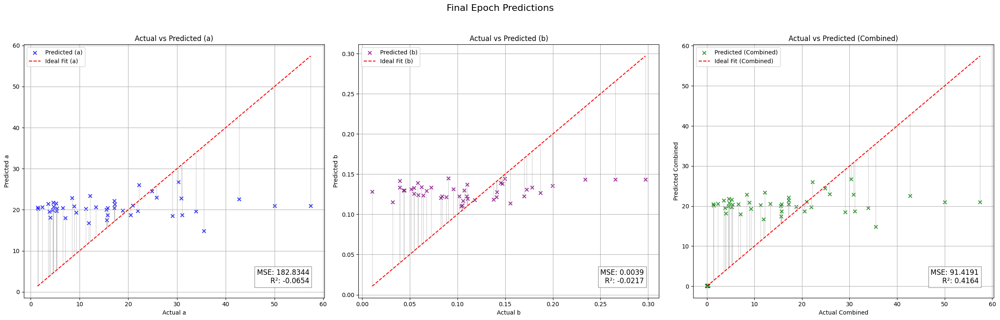

Validation Metrics:
  - MSE: 89.9540
  - R²: -0.0257
  - MAE: 5.4314
  - Explained Variance Score (EVS): 0.0417
Fold 2 Metrics:
  - Validation Loss (MSE): 89.9540
  - R²: -0.0257
  - MAE: 5.4314
  - EVS: 0.0417
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 20.79it/s, loss=1.47]


Validation Metrics:
  - MSE: 112.2325
  - R²: -0.0006
  - MAE: 5.5066
  - Explained Variance Score (EVS): 0.0209
Epoch [1/50], Train Loss: 1.3296, Val Loss: 112.2325
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 22.52it/s, loss=1.21]


Validation Metrics:
  - MSE: 112.3960
  - R²: 0.0025
  - MAE: 5.5202
  - Explained Variance Score (EVS): 0.0188
Epoch [2/50], Train Loss: 1.3056, Val Loss: 112.3960
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 24.32it/s, loss=1.5]


Validation Metrics:
  - MSE: 112.2863
  - R²: -0.0012
  - MAE: 5.5186
  - Explained Variance Score (EVS): 0.0157
Epoch [3/50], Train Loss: 1.3101, Val Loss: 112.2863
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 26.50it/s, loss=1.29]


Validation Metrics:
  - MSE: 111.5408
  - R²: 0.0005
  - MAE: 5.4997
  - Explained Variance Score (EVS): 0.0176
Epoch [4/50], Train Loss: 1.2881, Val Loss: 111.5408
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 24.42it/s, loss=1.21]


Validation Metrics:
  - MSE: 111.6494
  - R²: 0.0024
  - MAE: 5.4947
  - Explained Variance Score (EVS): 0.0182
Epoch [5/50], Train Loss: 1.2806, Val Loss: 111.6494
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 25.70it/s, loss=1.25]


Validation Metrics:
  - MSE: 112.0276
  - R²: 0.0002
  - MAE: 5.4971
  - Explained Variance Score (EVS): 0.0179
Epoch [6/50], Train Loss: 1.2552, Val Loss: 112.0276
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 26.90it/s, loss=1.12]


Validation Metrics:
  - MSE: 112.2097
  - R²: 0.0023
  - MAE: 5.5084
  - Explained Variance Score (EVS): 0.0173
Epoch [7/50], Train Loss: 1.2690, Val Loss: 112.2097
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 25.08it/s, loss=1.35]


Validation Metrics:
  - MSE: 110.9473
  - R²: 0.0064
  - MAE: 5.4596
  - Explained Variance Score (EVS): 0.0222
Epoch [8/50], Train Loss: 1.2401, Val Loss: 110.9473
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 27.08it/s, loss=1.21]


Validation Metrics:
  - MSE: 110.8072
  - R²: 0.0059
  - MAE: 5.4679
  - Explained Variance Score (EVS): 0.0212
Epoch [9/50], Train Loss: 1.2397, Val Loss: 110.8072
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 24.47it/s, loss=1.29]


Validation Metrics:
  - MSE: 110.4988
  - R²: 0.0090
  - MAE: 5.4706
  - Explained Variance Score (EVS): 0.0223
Epoch [10/50], Train Loss: 1.2359, Val Loss: 110.4988
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 25.63it/s, loss=1.32]


Validation Metrics:
  - MSE: 111.6715
  - R²: 0.0031
  - MAE: 5.4933
  - Explained Variance Score (EVS): 0.0174
Epoch [11/50], Train Loss: 1.2187, Val Loss: 111.6715
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 24.83it/s, loss=1.33]


Validation Metrics:
  - MSE: 111.7028
  - R²: 0.0043
  - MAE: 5.4835
  - Explained Variance Score (EVS): 0.0188
Epoch [12/50], Train Loss: 1.1986, Val Loss: 111.7028
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 25.60it/s, loss=1.06]


Validation Metrics:
  - MSE: 111.7096
  - R²: 0.0012
  - MAE: 5.4892
  - Explained Variance Score (EVS): 0.0158
Epoch [13/50], Train Loss: 1.1962, Val Loss: 111.7096
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 24.25it/s, loss=1.09]


Validation Metrics:
  - MSE: 111.3789
  - R²: 0.0035
  - MAE: 5.4782
  - Explained Variance Score (EVS): 0.0181
Epoch [14/50], Train Loss: 1.1942, Val Loss: 111.3789
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 21.46it/s, loss=1.04]


Validation Metrics:
  - MSE: 111.0141
  - R²: 0.0056
  - MAE: 5.4684
  - Explained Variance Score (EVS): 0.0201
Epoch [15/50], Train Loss: 1.1913, Val Loss: 111.0141
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 19.78it/s, loss=1.23]


Validation Metrics:
  - MSE: 111.6693
  - R²: -0.0012
  - MAE: 5.4814
  - Explained Variance Score (EVS): 0.0146
Epoch [16/50], Train Loss: 1.1906, Val Loss: 111.6693
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 20.42it/s, loss=1.1]


Validation Metrics:
  - MSE: 111.5371
  - R²: -0.0012
  - MAE: 5.4837
  - Explained Variance Score (EVS): 0.0140
Epoch [17/50], Train Loss: 1.1792, Val Loss: 111.5371
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 20.86it/s, loss=1.06]


Validation Metrics:
  - MSE: 110.3790
  - R²: 0.0073
  - MAE: 5.4497
  - Explained Variance Score (EVS): 0.0227
Epoch [18/50], Train Loss: 1.1842, Val Loss: 110.3790
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 20.90it/s, loss=1.02]


Validation Metrics:
  - MSE: 110.2232
  - R²: 0.0097
  - MAE: 5.4481
  - Explained Variance Score (EVS): 0.0231
Epoch [19/50], Train Loss: 1.1642, Val Loss: 110.2232
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 18.78it/s, loss=1.12]


Validation Metrics:
  - MSE: 110.3678
  - R²: 0.0092
  - MAE: 5.4531
  - Explained Variance Score (EVS): 0.0222
Epoch [20/50], Train Loss: 1.1652, Val Loss: 110.3678
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 19.61it/s, loss=1.28]


Validation Metrics:
  - MSE: 111.2857
  - R²: 0.0062
  - MAE: 5.4813
  - Explained Variance Score (EVS): 0.0198
Epoch [21/50], Train Loss: 1.1599, Val Loss: 111.2857
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 20.92it/s, loss=1.05]


Validation Metrics:
  - MSE: 111.1025
  - R²: 0.0073
  - MAE: 5.4647
  - Explained Variance Score (EVS): 0.0209
Epoch [22/50], Train Loss: 1.1675, Val Loss: 111.1025
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 27.41it/s, loss=1.06]


Validation Metrics:
  - MSE: 111.7911
  - R²: 0.0030
  - MAE: 5.4840
  - Explained Variance Score (EVS): 0.0178
Epoch [23/50], Train Loss: 1.1488, Val Loss: 111.7911
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 23.46it/s, loss=0.989]


Validation Metrics:
  - MSE: 110.8796
  - R²: 0.0026
  - MAE: 5.4545
  - Explained Variance Score (EVS): 0.0175
Epoch [24/50], Train Loss: 1.1456, Val Loss: 110.8796
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 25.36it/s, loss=1.53]


Validation Metrics:
  - MSE: 110.4205
  - R²: 0.0083
  - MAE: 5.4502
  - Explained Variance Score (EVS): 0.0219
Epoch [25/50], Train Loss: 1.1441, Val Loss: 110.4205
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 26.25it/s, loss=1.15]


Validation Metrics:
  - MSE: 110.7037
  - R²: 0.0085
  - MAE: 5.4635
  - Explained Variance Score (EVS): 0.0211
Epoch [26/50], Train Loss: 1.1390, Val Loss: 110.7037
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 25.47it/s, loss=1.31]


Validation Metrics:
  - MSE: 111.2075
  - R²: 0.0055
  - MAE: 5.4735
  - Explained Variance Score (EVS): 0.0176
Epoch [27/50], Train Loss: 1.1335, Val Loss: 111.2075
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 11/11 [00:00<00:00, 23.91it/s, loss=1.19]


Validation Metrics:
  - MSE: 111.6885
  - R²: 0.0020
  - MAE: 5.4741
  - Explained Variance Score (EVS): 0.0167
Epoch [28/50], Train Loss: 1.1300, Val Loss: 111.6885
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 11/11 [00:00<00:00, 26.32it/s, loss=1.02]


Validation Metrics:
  - MSE: 112.1366
  - R²: -0.0009
  - MAE: 5.4962
  - Explained Variance Score (EVS): 0.0132
Epoch [29/50], Train Loss: 1.1238, Val Loss: 112.1366
Current Dropout Rate: 0.2760
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


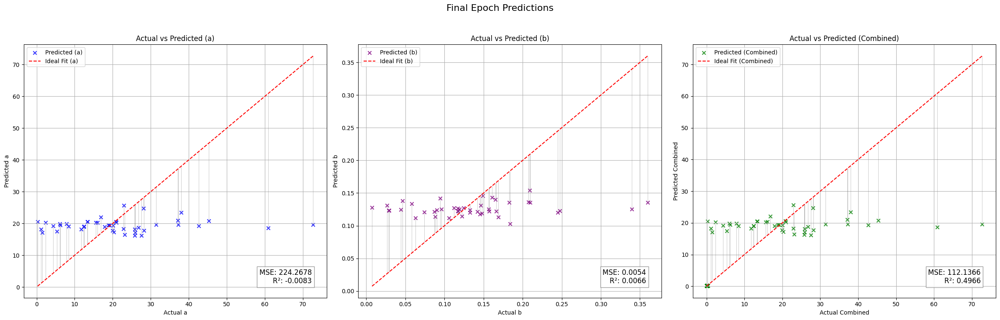

Validation Metrics:
  - MSE: 110.2232
  - R²: 0.0097
  - MAE: 5.4481
  - Explained Variance Score (EVS): 0.0231
Fold 3 Metrics:
  - Validation Loss (MSE): 110.2232
  - R²: 0.0097
  - MAE: 5.4481
  - EVS: 0.0231
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 22.68it/s, loss=1.04]


Validation Metrics:
  - MSE: 91.7687
  - R²: 0.0160
  - MAE: 5.6929
  - Explained Variance Score (EVS): 0.0286
Epoch [1/50], Train Loss: 1.1865, Val Loss: 91.7687
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 21.89it/s, loss=0.945]


Validation Metrics:
  - MSE: 92.5180
  - R²: 0.0116
  - MAE: 5.7026
  - Explained Variance Score (EVS): 0.0252
Epoch [2/50], Train Loss: 1.1718, Val Loss: 92.5180
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 25.03it/s, loss=1.15]


Validation Metrics:
  - MSE: 92.7688
  - R²: 0.0096
  - MAE: 5.7084
  - Explained Variance Score (EVS): 0.0240
Epoch [3/50], Train Loss: 1.1620, Val Loss: 92.7688
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 21.36it/s, loss=1.13]


Validation Metrics:
  - MSE: 92.0698
  - R²: 0.0142
  - MAE: 5.7184
  - Explained Variance Score (EVS): 0.0260
Epoch [4/50], Train Loss: 1.1649, Val Loss: 92.0698
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 20.58it/s, loss=1.41]


Validation Metrics:
  - MSE: 91.7425
  - R²: 0.0156
  - MAE: 5.7045
  - Explained Variance Score (EVS): 0.0269
Epoch [5/50], Train Loss: 1.1687, Val Loss: 91.7425
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 23.89it/s, loss=1.23]


Validation Metrics:
  - MSE: 91.7775
  - R²: 0.0164
  - MAE: 5.7005
  - Explained Variance Score (EVS): 0.0278
Epoch [6/50], Train Loss: 1.1620, Val Loss: 91.7775
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 19.30it/s, loss=1.06]


Validation Metrics:
  - MSE: 92.2217
  - R²: 0.0142
  - MAE: 5.7065
  - Explained Variance Score (EVS): 0.0265
Epoch [7/50], Train Loss: 1.1497, Val Loss: 92.2217
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 21.29it/s, loss=1.23]


Validation Metrics:
  - MSE: 92.4257
  - R²: 0.0116
  - MAE: 5.7260
  - Explained Variance Score (EVS): 0.0244
Epoch [8/50], Train Loss: 1.1373, Val Loss: 92.4257
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 20.20it/s, loss=1.32]


Validation Metrics:
  - MSE: 92.4412
  - R²: 0.0138
  - MAE: 5.7304
  - Explained Variance Score (EVS): 0.0254
Epoch [9/50], Train Loss: 1.1387, Val Loss: 92.4412
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 18.47it/s, loss=1.04]


Validation Metrics:
  - MSE: 92.6284
  - R²: 0.0116
  - MAE: 5.7232
  - Explained Variance Score (EVS): 0.0242
Epoch [10/50], Train Loss: 1.1345, Val Loss: 92.6284
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 18.69it/s, loss=1.15]


Validation Metrics:
  - MSE: 92.3310
  - R²: 0.0125
  - MAE: 5.7257
  - Explained Variance Score (EVS): 0.0237
Epoch [11/50], Train Loss: 1.1357, Val Loss: 92.3310
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 24.25it/s, loss=1.02]


Validation Metrics:
  - MSE: 92.0228
  - R²: 0.0144
  - MAE: 5.7056
  - Explained Variance Score (EVS): 0.0255
Epoch [12/50], Train Loss: 1.1326, Val Loss: 92.0228
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 24.51it/s, loss=0.98]


Validation Metrics:
  - MSE: 92.2759
  - R²: 0.0125
  - MAE: 5.7197
  - Explained Variance Score (EVS): 0.0242
Epoch [13/50], Train Loss: 1.1295, Val Loss: 92.2759
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 23.21it/s, loss=1.07]


Validation Metrics:
  - MSE: 92.2882
  - R²: 0.0123
  - MAE: 5.7192
  - Explained Variance Score (EVS): 0.0236
Epoch [14/50], Train Loss: 1.1255, Val Loss: 92.2882
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 27.13it/s, loss=0.982]


Validation Metrics:
  - MSE: 92.3499
  - R²: 0.0130
  - MAE: 5.7157
  - Explained Variance Score (EVS): 0.0252
Epoch [15/50], Train Loss: 1.1185, Val Loss: 92.3499
Current Dropout Rate: 0.3880
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


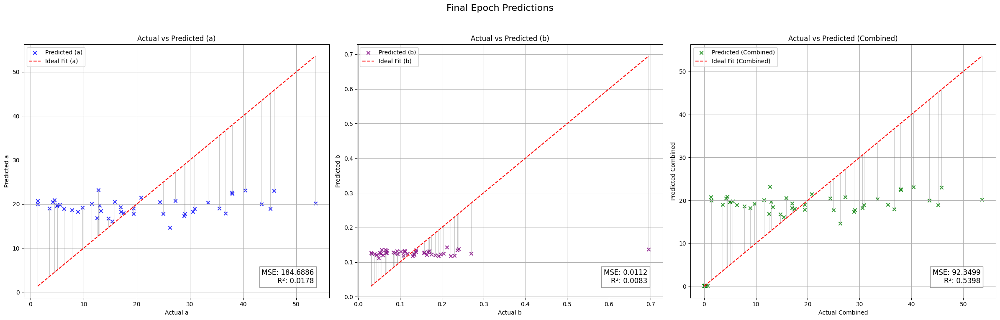

Validation Metrics:
  - MSE: 91.7425
  - R²: 0.0156
  - MAE: 5.7045
  - Explained Variance Score (EVS): 0.0269
Fold 4 Metrics:
  - Validation Loss (MSE): 91.7425
  - R²: 0.0156
  - MAE: 5.7045
  - EVS: 0.0269
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 26.30it/s, loss=1.07]


Validation Metrics:
  - MSE: 183.5038
  - R²: -0.0162
  - MAE: 6.5709
  - Explained Variance Score (EVS): 0.0023
Epoch [1/50], Train Loss: 1.1622, Val Loss: 183.5038
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 25.89it/s, loss=1.23]


Validation Metrics:
  - MSE: 183.2584
  - R²: -0.0151
  - MAE: 6.5885
  - Explained Variance Score (EVS): 0.0034
Epoch [2/50], Train Loss: 1.1551, Val Loss: 183.2584
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 27.00it/s, loss=1.21]


Validation Metrics:
  - MSE: 183.4166
  - R²: -0.0158
  - MAE: 6.5706
  - Explained Variance Score (EVS): 0.0042
Epoch [3/50], Train Loss: 1.1605, Val Loss: 183.4166
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 24.97it/s, loss=1.07]


Validation Metrics:
  - MSE: 182.7124
  - R²: -0.0161
  - MAE: 6.5584
  - Explained Variance Score (EVS): 0.0034
Epoch [4/50], Train Loss: 1.1479, Val Loss: 182.7124
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 23.92it/s, loss=1.26]


Validation Metrics:
  - MSE: 183.2814
  - R²: -0.0165
  - MAE: 6.5634
  - Explained Variance Score (EVS): 0.0030
Epoch [5/50], Train Loss: 1.1425, Val Loss: 183.2814
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 22.30it/s, loss=1.11]


Validation Metrics:
  - MSE: 182.6723
  - R²: -0.0153
  - MAE: 6.5551
  - Explained Variance Score (EVS): 0.0046
Epoch [6/50], Train Loss: 1.1507, Val Loss: 182.6723
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 23.29it/s, loss=1.18]


Validation Metrics:
  - MSE: 182.7774
  - R²: -0.0151
  - MAE: 6.5616
  - Explained Variance Score (EVS): 0.0055
Epoch [7/50], Train Loss: 1.1443, Val Loss: 182.7774
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 22.09it/s, loss=1.03]


Validation Metrics:
  - MSE: 182.6092
  - R²: -0.0141
  - MAE: 6.5595
  - Explained Variance Score (EVS): 0.0059
Epoch [8/50], Train Loss: 1.1472, Val Loss: 182.6092
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 21.46it/s, loss=1.37]


Validation Metrics:
  - MSE: 182.0321
  - R²: -0.0120
  - MAE: 6.5350
  - Explained Variance Score (EVS): 0.0068
Epoch [9/50], Train Loss: 1.1421, Val Loss: 182.0321
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.92it/s, loss=0.979]


Validation Metrics:
  - MSE: 182.7064
  - R²: -0.0129
  - MAE: 6.5589
  - Explained Variance Score (EVS): 0.0065
Epoch [10/50], Train Loss: 1.1228, Val Loss: 182.7064
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 21.30it/s, loss=1.31]


Validation Metrics:
  - MSE: 183.0799
  - R²: -0.0147
  - MAE: 6.5636
  - Explained Variance Score (EVS): 0.0045
Epoch [11/50], Train Loss: 1.1351, Val Loss: 183.0799
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 22.04it/s, loss=1.01]


Validation Metrics:
  - MSE: 183.3752
  - R²: -0.0164
  - MAE: 6.5684
  - Explained Variance Score (EVS): 0.0036
Epoch [12/50], Train Loss: 1.1223, Val Loss: 183.3752
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 21.95it/s, loss=1.59]


Validation Metrics:
  - MSE: 183.5090
  - R²: -0.0168
  - MAE: 6.5645
  - Explained Variance Score (EVS): 0.0046
Epoch [13/50], Train Loss: 1.1349, Val Loss: 183.5090
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 19.83it/s, loss=1.1]


Validation Metrics:
  - MSE: 183.3106
  - R²: -0.0186
  - MAE: 6.5565
  - Explained Variance Score (EVS): 0.0016
Epoch [14/50], Train Loss: 1.1309, Val Loss: 183.3106
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 19.48it/s, loss=1.27]


Validation Metrics:
  - MSE: 182.4244
  - R²: -0.0154
  - MAE: 6.5634
  - Explained Variance Score (EVS): 0.0041
Epoch [15/50], Train Loss: 1.1317, Val Loss: 182.4244
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 23.80it/s, loss=1.12]


Validation Metrics:
  - MSE: 182.4888
  - R²: -0.0146
  - MAE: 6.5643
  - Explained Variance Score (EVS): 0.0051
Epoch [16/50], Train Loss: 1.1309, Val Loss: 182.4888
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 24.23it/s, loss=1.03]


Validation Metrics:
  - MSE: 182.6983
  - R²: -0.0146
  - MAE: 6.5613
  - Explained Variance Score (EVS): 0.0049
Epoch [17/50], Train Loss: 1.1264, Val Loss: 182.6983
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 25.19it/s, loss=1.01]


Validation Metrics:
  - MSE: 183.5016
  - R²: -0.0182
  - MAE: 6.5683
  - Explained Variance Score (EVS): 0.0021
Epoch [18/50], Train Loss: 1.1293, Val Loss: 183.5016
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 27.04it/s, loss=1.02]


Validation Metrics:
  - MSE: 182.5712
  - R²: -0.0148
  - MAE: 6.5644
  - Explained Variance Score (EVS): 0.0050
Epoch [19/50], Train Loss: 1.1298, Val Loss: 182.5712
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


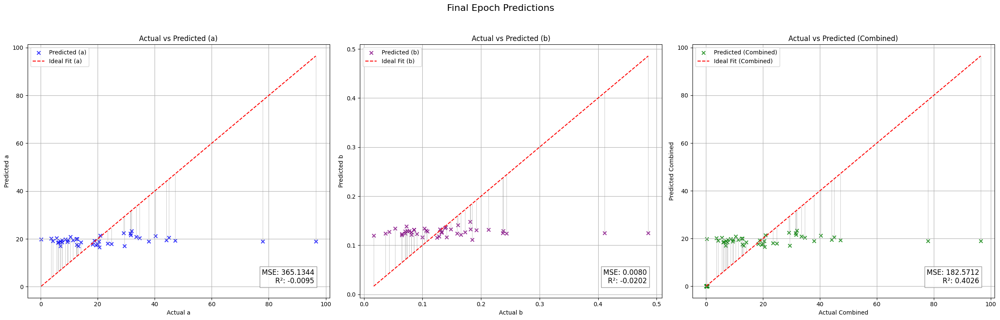

[I 2024-12-01 16:56:28,501] Trial 3 finished with value: 133.85354614257812 and parameters: {'num_layers': 2, 'hidden_size_0': 412, 'activation_0': 'ELU', 'dropout_0': 0.14669803630904277, 'hidden_size_1': 292, 'activation_1': 'LeakyReLU', 'dropout_1': 0.20924322351087118, 'batch_size': 16, 'learning_rate': 0.0007657546474889036, 'optimizer': 'SGD'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.0321
  - R²: -0.0120
  - MAE: 6.5350
  - Explained Variance Score (EVS): 0.0068
Fold 5 Metrics:
  - Validation Loss (MSE): 182.0321
  - R²: -0.0120
  - MAE: 6.5350
  - EVS: 0.0068
Avg Validation Metrics:
  - MSE: 133.8535
  - R²: -0.0046
  - MAE: 5.8955
  - EVS: 0.0224
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 14.14it/s, loss=1.03]


Validation Metrics:
  - MSE: 197.1492
  - R²: -0.0180
  - MAE: 6.4609
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 1.5674, Val Loss: 197.1492
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 13.44it/s, loss=0.593]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.7802, Val Loss: 197.1942
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 14.05it/s, loss=0.676]


Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0197
  - MAE: 6.4552
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.6353, Val Loss: 197.3305
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 14.80it/s, loss=0.335]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.5453, Val Loss: 197.3764
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 14.55it/s, loss=0.445]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.5300, Val Loss: 197.4225
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 13.60it/s, loss=0.527]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.5251, Val Loss: 197.4225
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 13.91it/s, loss=0.481]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.5156, Val Loss: 197.4225
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 12.16it/s, loss=0.626]


Validation Metrics:
  - MSE: 197.2848
  - R²: -0.0196
  - MAE: 6.4566
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.5259, Val Loss: 197.2848
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 12.95it/s, loss=0.534]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.5154, Val Loss: 197.5156
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.84it/s, loss=0.508]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0205
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.5120, Val Loss: 197.5625
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 13.13it/s, loss=0.66]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.5241, Val Loss: 197.4690
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


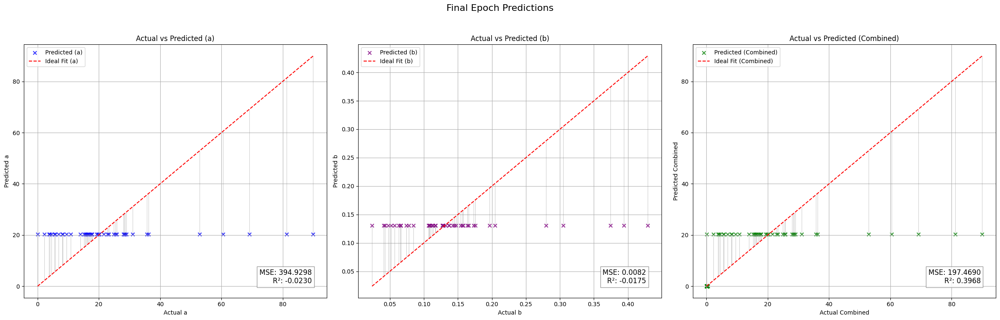

Validation Metrics:
  - MSE: 197.1492
  - R²: -0.0180
  - MAE: 6.4609
  - Explained Variance Score (EVS): -0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.1492
  - R²: -0.0180
  - MAE: 6.4609
  - EVS: -0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 12.30it/s, loss=0.766]


Validation Metrics:
  - MSE: 99.0675
  - R²: -0.1786
  - MAE: 5.9817
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.8347, Val Loss: 99.0675
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 11.05it/s, loss=0.611]


Validation Metrics:
  - MSE: 98.8272
  - R²: -0.1746
  - MAE: 5.9710
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.6828, Val Loss: 98.8272
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 12.41it/s, loss=0.643]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1718
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.5943, Val Loss: 98.5102
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.38it/s, loss=0.49]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1714
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.5457, Val Loss: 98.4316
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 14.21it/s, loss=0.336]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.5145, Val Loss: 98.3532
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 15.34it/s, loss=0.278]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.5009, Val Loss: 98.3532
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 15.32it/s, loss=0.446]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.5105, Val Loss: 98.3532
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 13.93it/s, loss=0.539]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.5157, Val Loss: 98.2750
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 15.32it/s, loss=0.421]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.5041, Val Loss: 98.1971
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.79it/s, loss=0.423]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1687
  - MAE: 5.9400
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.5032, Val Loss: 98.1195
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 15.95it/s, loss=0.633]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1682
  - MAE: 5.9368
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.5209, Val Loss: 98.0420
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 13.97it/s, loss=0.295]


Validation Metrics:
  - MSE: 97.9649
  - R²: -0.1669
  - MAE: 5.9335
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4900, Val Loss: 97.9649
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 15.10it/s, loss=0.366]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4953, Val Loss: 98.1195
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 13.32it/s, loss=0.436]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.5007, Val Loss: 98.1195
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 13.63it/s, loss=0.373]


Validation Metrics:
  - MSE: 97.9649
  - R²: -0.1669
  - MAE: 5.9335
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4946, Val Loss: 97.9649
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 14.50it/s, loss=0.32]


Validation Metrics:
  - MSE: 97.9649
  - R²: -0.1669
  - MAE: 5.9335
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4890, Val Loss: 97.9649
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00, 12.62it/s, loss=0.33]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4891, Val Loss: 98.1195
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00, 11.57it/s, loss=0.556]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.5085, Val Loss: 98.1195
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00, 11.17it/s, loss=0.573]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.5094, Val Loss: 98.0420
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00, 11.64it/s, loss=0.436]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.4966, Val Loss: 98.1195
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00, 12.07it/s, loss=0.599]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.5104, Val Loss: 98.1195
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00, 11.86it/s, loss=0.336]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.4865, Val Loss: 98.1195
Current Dropout Rate: 0.3320
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


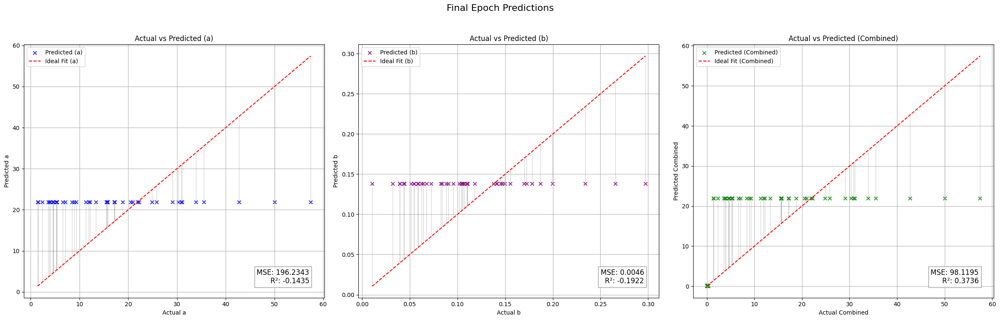

Validation Metrics:
  - MSE: 97.9649
  - R²: -0.1669
  - MAE: 5.9335
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 97.9649
  - R²: -0.1669
  - MAE: 5.9335
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 17.32it/s, loss=0.364]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4925, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 16.30it/s, loss=0.61]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.5137, Val Loss: 111.2861
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 17.04it/s, loss=0.423]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4965, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 13.68it/s, loss=0.596]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.5113, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 16.66it/s, loss=0.494]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.5016, Val Loss: 111.2922
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 16.36it/s, loss=0.648]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.5146, Val Loss: 111.2861
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 15.42it/s, loss=0.44]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4956, Val Loss: 111.2922
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 16.64it/s, loss=0.379]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4896, Val Loss: 111.2922
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 14.91it/s, loss=0.568]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.5058, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 16.33it/s, loss=0.38]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4886, Val Loss: 111.2922
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 14.44it/s, loss=0.421]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4917, Val Loss: 111.2922
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 15.67it/s, loss=0.356]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4853, Val Loss: 111.2922
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


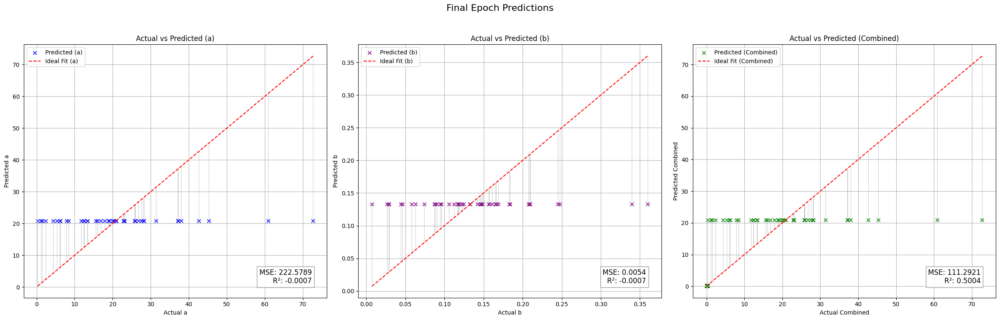

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 13.41it/s, loss=0.556]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.5187, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 12.05it/s, loss=0.919]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.5505, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 12.10it/s, loss=0.298]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4953, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 11.85it/s, loss=0.482]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.5113, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 10.95it/s, loss=0.373]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.5014, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 11.40it/s, loss=0.45]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.5079, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.69it/s, loss=0.443]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.5071, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 14.84it/s, loss=0.32]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4959, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 14.36it/s, loss=0.478]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.5097, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.94it/s, loss=0.582]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.5186, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 15.31it/s, loss=0.425]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.5044, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


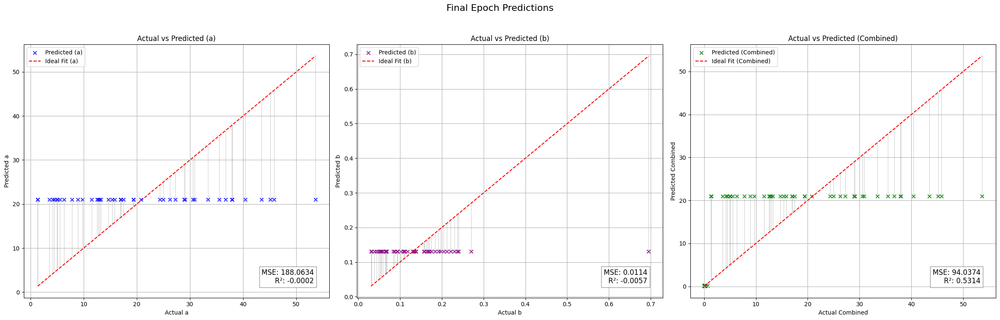

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 17.00it/s, loss=0.328]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4978, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 15.37it/s, loss=0.61]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.5212, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 14.71it/s, loss=0.598]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.5200, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.88it/s, loss=0.281]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4935, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 14.81it/s, loss=0.581]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.5184, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 15.16it/s, loss=0.355]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4995, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.48it/s, loss=0.406]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.5035, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 11.99it/s, loss=0.327]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4968, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 12.24it/s, loss=0.589]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.5186, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.07it/s, loss=0.362]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4995, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 11.31it/s, loss=0.425]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.5047, Val Loss: 182.6491
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


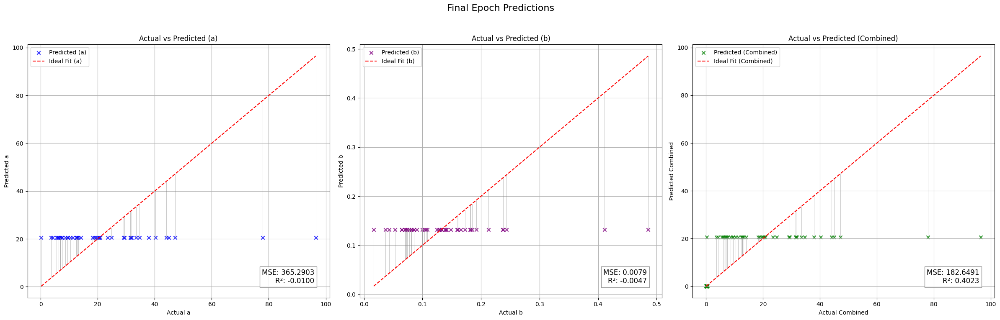

[I 2024-12-01 16:57:34,215] Trial 4 finished with value: 136.61734008789062 and parameters: {'num_layers': 4, 'hidden_size_0': 473, 'activation_0': 'ReLU', 'dropout_0': 0.3599678425243025, 'hidden_size_1': 365, 'activation_1': 'ELU', 'dropout_1': 0.4535118016844245, 'hidden_size_2': 339, 'activation_2': 'LeakyReLU', 'dropout_2': 0.34678165376326336, 'hidden_size_3': 498, 'activation_3': 'ReLU', 'dropout_3': 0.380783816437963, 'batch_size': 32, 'learning_rate': 0.0013313095205475774, 'optimizer': 'Adagrad'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6173
  - R²: -0.0392
  - MAE: 6.0976
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 11.72it/s, loss=0.558]


Validation Metrics:
  - MSE: 197.8006
  - R²: -0.0211
  - MAE: 6.4409
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.9043, Val Loss: 197.8006
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 11.45it/s, loss=0.533]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0207
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.6425, Val Loss: 197.5156
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 13.78it/s, loss=0.562]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0204
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.5594, Val Loss: 197.3764
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.28it/s, loss=0.414]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0204
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.5054, Val Loss: 197.3764
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 14.55it/s, loss=0.67]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0202
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.5090, Val Loss: 197.3764
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 14.30it/s, loss=0.528]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0201
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4758, Val Loss: 197.4225
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 13.96it/s, loss=0.27]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0201
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4425, Val Loss: 197.4225
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 14.15it/s, loss=0.691]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4734, Val Loss: 197.4690
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 13.35it/s, loss=0.515]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4523, Val Loss: 197.4690
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.94it/s, loss=0.234]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4257, Val Loss: 197.5156
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 13.45it/s, loss=0.639]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4601, Val Loss: 197.4690
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 14.80it/s, loss=0.41]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.4387, Val Loss: 197.4690
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 13.58it/s, loss=0.544]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.4496, Val Loss: 197.5156
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


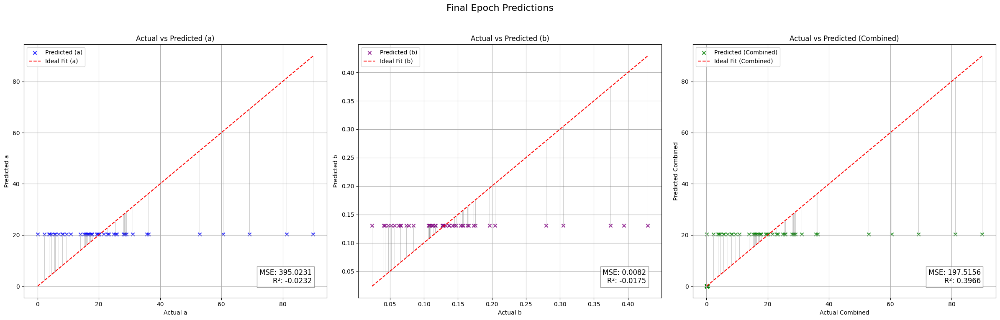

Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0204
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.3764
  - R²: -0.0204
  - MAE: 6.4537
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 12.68it/s, loss=0.791]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1692
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.5397, Val Loss: 98.5102
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 11.19it/s, loss=0.396]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1701
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4914, Val Loss: 98.5102
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 11.29it/s, loss=0.458]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1701
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4785, Val Loss: 98.5102
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 13.07it/s, loss=0.617]


Validation Metrics:
  - MSE: 98.4315
  - R²: -0.1705
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4793, Val Loss: 98.4315
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.20it/s, loss=0.21]


Validation Metrics:
  - MSE: 98.3531
  - R²: -0.1701
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4314, Val Loss: 98.3531
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 11.61it/s, loss=0.346]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4371, Val Loss: 98.2750
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.46it/s, loss=0.309]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4287, Val Loss: 98.1971
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 11.09it/s, loss=0.551]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4470, Val Loss: 98.1971
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 13.62it/s, loss=0.371]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4308, Val Loss: 98.1971
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.67it/s, loss=0.272]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4196, Val Loss: 98.1195
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.94it/s, loss=0.305]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4229, Val Loss: 98.0420
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 14.37it/s, loss=0.73]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1665
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4606, Val Loss: 98.0420
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 14.26it/s, loss=0.522]


Validation Metrics:
  - MSE: 97.9649
  - R²: -0.1661
  - MAE: 5.9335
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4411, Val Loss: 97.9649
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 12.75it/s, loss=0.404]


Validation Metrics:
  - MSE: 97.9423
  - R²: -0.1659
  - MAE: 5.9332
  - Explained Variance Score (EVS): 0.0002
Epoch [14/50], Train Loss: 0.4307, Val Loss: 97.9423
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 14.50it/s, loss=0.255]


Validation Metrics:
  - MSE: 97.8600
  - R²: -0.1636
  - MAE: 5.9315
  - Explained Variance Score (EVS): 0.0019
Epoch [15/50], Train Loss: 0.4164, Val Loss: 97.8600
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 13.82it/s, loss=0.291]


Validation Metrics:
  - MSE: 97.9172
  - R²: -0.1642
  - MAE: 5.9310
  - Explained Variance Score (EVS): 0.0015
Epoch [16/50], Train Loss: 0.4203, Val Loss: 97.9172
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00, 14.57it/s, loss=0.44]


Validation Metrics:
  - MSE: 97.5006
  - R²: -0.1608
  - MAE: 5.9244
  - Explained Variance Score (EVS): 0.0064
Epoch [17/50], Train Loss: 0.4321, Val Loss: 97.5006
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00, 13.38it/s, loss=0.193]


Validation Metrics:
  - MSE: 97.9559
  - R²: -0.1654
  - MAE: 5.9358
  - Explained Variance Score (EVS): 0.0016
Epoch [18/50], Train Loss: 0.4100, Val Loss: 97.9559
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00, 14.66it/s, loss=0.196]


Validation Metrics:
  - MSE: 97.5720
  - R²: -0.1617
  - MAE: 5.9064
  - Explained Variance Score (EVS): 0.0087
Epoch [19/50], Train Loss: 0.4107, Val Loss: 97.5720
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00, 14.75it/s, loss=0.239]


Validation Metrics:
  - MSE: 97.8037
  - R²: -0.1639
  - MAE: 5.9314
  - Explained Variance Score (EVS): 0.0053
Epoch [20/50], Train Loss: 0.4144, Val Loss: 97.8037
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00, 14.18it/s, loss=0.296]


Validation Metrics:
  - MSE: 97.7362
  - R²: -0.1641
  - MAE: 5.9144
  - Explained Variance Score (EVS): 0.0070
Epoch [21/50], Train Loss: 0.4180, Val Loss: 97.7362
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00, 12.06it/s, loss=0.509]


Validation Metrics:
  - MSE: 96.4063
  - R²: -0.1478
  - MAE: 5.9075
  - Explained Variance Score (EVS): 0.0243
Epoch [22/50], Train Loss: 0.4352, Val Loss: 96.4063
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00, 11.99it/s, loss=0.655]


Validation Metrics:
  - MSE: 97.8668
  - R²: -0.1649
  - MAE: 5.9280
  - Explained Variance Score (EVS): 0.0045
Epoch [23/50], Train Loss: 0.4483, Val Loss: 97.8668
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00, 11.19it/s, loss=0.303]


Validation Metrics:
  - MSE: 98.0920
  - R²: -0.1685
  - MAE: 5.9394
  - Explained Variance Score (EVS): 0.0002
Epoch [24/50], Train Loss: 0.4178, Val Loss: 98.0920
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00, 11.11it/s, loss=0.43]


Validation Metrics:
  - MSE: 94.6989
  - R²: -0.1289
  - MAE: 5.8775
  - Explained Variance Score (EVS): 0.0487
Epoch [25/50], Train Loss: 0.4295, Val Loss: 94.6989
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00, 12.06it/s, loss=0.236]


Validation Metrics:
  - MSE: 96.8114
  - R²: -0.1537
  - MAE: 5.8861
  - Explained Variance Score (EVS): 0.0245
Epoch [26/50], Train Loss: 0.4122, Val Loss: 96.8114
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00, 10.48it/s, loss=0.307]


Validation Metrics:
  - MSE: 98.1845
  - R²: -0.1685
  - MAE: 5.9430
  - Explained Variance Score (EVS): 0.0015
Epoch [27/50], Train Loss: 0.4170, Val Loss: 98.1845
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00, 11.16it/s, loss=0.33]


Validation Metrics:
  - MSE: 97.5626
  - R²: -0.1611
  - MAE: 5.9160
  - Explained Variance Score (EVS): 0.0125
Epoch [28/50], Train Loss: 0.4185, Val Loss: 97.5626
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00, 10.41it/s, loss=0.396]


Validation Metrics:
  - MSE: 96.5709
  - R²: -0.1512
  - MAE: 5.8593
  - Explained Variance Score (EVS): 0.0296
Epoch [29/50], Train Loss: 0.4245, Val Loss: 96.5709
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 6/6 [00:00<00:00, 13.10it/s, loss=0.311]


Validation Metrics:
  - MSE: 95.3680
  - R²: -0.1367
  - MAE: 5.8948
  - Explained Variance Score (EVS): 0.0404
Epoch [30/50], Train Loss: 0.4158, Val Loss: 95.3680
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 6/6 [00:00<00:00, 14.39it/s, loss=0.391]


Validation Metrics:
  - MSE: 94.7901
  - R²: -0.1283
  - MAE: 5.8819
  - Explained Variance Score (EVS): 0.0498
Epoch [31/50], Train Loss: 0.4218, Val Loss: 94.7901
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 6/6 [00:00<00:00, 14.72it/s, loss=0.52]


Validation Metrics:
  - MSE: 96.2286
  - R²: -0.1465
  - MAE: 5.8837
  - Explained Variance Score (EVS): 0.0323
Epoch [32/50], Train Loss: 0.4320, Val Loss: 96.2286
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 6/6 [00:00<00:00, 14.43it/s, loss=0.431]


Validation Metrics:
  - MSE: 95.5216
  - R²: -0.1381
  - MAE: 5.8878
  - Explained Variance Score (EVS): 0.0401
Epoch [33/50], Train Loss: 0.4242, Val Loss: 95.5216
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 6/6 [00:00<00:00, 13.98it/s, loss=0.222]


Validation Metrics:
  - MSE: 93.6350
  - R²: -0.1149
  - MAE: 5.8534
  - Explained Variance Score (EVS): 0.0682
Epoch [34/50], Train Loss: 0.4050, Val Loss: 93.6350
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 6/6 [00:00<00:00, 12.72it/s, loss=0.568]


Validation Metrics:
  - MSE: 92.9999
  - R²: -0.1077
  - MAE: 5.8436
  - Explained Variance Score (EVS): 0.0766
Epoch [35/50], Train Loss: 0.4359, Val Loss: 92.9999
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 6/6 [00:00<00:00, 14.71it/s, loss=0.504]


Validation Metrics:
  - MSE: 95.5955
  - R²: -0.1388
  - MAE: 5.8878
  - Explained Variance Score (EVS): 0.0395
Epoch [36/50], Train Loss: 0.4313, Val Loss: 95.5955
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 6/6 [00:00<00:00, 13.89it/s, loss=0.298]


Validation Metrics:
  - MSE: 92.6881
  - R²: -0.1044
  - MAE: 5.8239
  - Explained Variance Score (EVS): 0.0826
Epoch [37/50], Train Loss: 0.4103, Val Loss: 92.6881
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 6/6 [00:00<00:00, 14.12it/s, loss=0.392]


Validation Metrics:
  - MSE: 95.3088
  - R²: -0.1355
  - MAE: 5.8912
  - Explained Variance Score (EVS): 0.0423
Epoch [38/50], Train Loss: 0.4179, Val Loss: 95.3088
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 6/6 [00:00<00:00, 14.47it/s, loss=0.234]


Validation Metrics:
  - MSE: 96.6182
  - R²: -0.1527
  - MAE: 5.8525
  - Explained Variance Score (EVS): 0.0303
Epoch [39/50], Train Loss: 0.4038, Val Loss: 96.6182
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 6/6 [00:00<00:00, 14.24it/s, loss=0.597]


Validation Metrics:
  - MSE: 97.4837
  - R²: -0.1615
  - MAE: 5.9107
  - Explained Variance Score (EVS): 0.0134
Epoch [40/50], Train Loss: 0.4397, Val Loss: 97.4837
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 6/6 [00:00<00:00, 13.09it/s, loss=0.362]


Validation Metrics:
  - MSE: 92.6311
  - R²: -0.1068
  - MAE: 5.8129
  - Explained Variance Score (EVS): 0.0807
Epoch [41/50], Train Loss: 0.4174, Val Loss: 92.6311
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 6/6 [00:00<00:00, 13.01it/s, loss=0.461]


Validation Metrics:
  - MSE: 93.3880
  - R²: -0.1143
  - MAE: 5.8516
  - Explained Variance Score (EVS): 0.0684
Epoch [42/50], Train Loss: 0.4267, Val Loss: 93.3880
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 6/6 [00:00<00:00, 11.83it/s, loss=0.277]


Validation Metrics:
  - MSE: 97.2568
  - R²: -0.1587
  - MAE: 5.9194
  - Explained Variance Score (EVS): 0.0152
Epoch [43/50], Train Loss: 0.4097, Val Loss: 97.2568
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 6/6 [00:00<00:00, 11.21it/s, loss=0.327]


Validation Metrics:
  - MSE: 93.2349
  - R²: -0.1116
  - MAE: 5.8507
  - Explained Variance Score (EVS): 0.0715
Epoch [44/50], Train Loss: 0.4142, Val Loss: 93.2349
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 6/6 [00:00<00:00, 12.21it/s, loss=0.222]


Validation Metrics:
  - MSE: 95.3910
  - R²: -0.1395
  - MAE: 5.8093
  - Explained Variance Score (EVS): 0.0495
Epoch [45/50], Train Loss: 0.4027, Val Loss: 95.3910
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 6/6 [00:00<00:00, 11.04it/s, loss=0.514]


Validation Metrics:
  - MSE: 93.7303
  - R²: -0.1172
  - MAE: 5.8575
  - Explained Variance Score (EVS): 0.0650
Epoch [46/50], Train Loss: 0.4283, Val Loss: 93.7303
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 6/6 [00:00<00:00, 11.52it/s, loss=0.379]


Validation Metrics:
  - MSE: 93.4470
  - R²: -0.1137
  - MAE: 5.8455
  - Explained Variance Score (EVS): 0.0702
Epoch [47/50], Train Loss: 0.4177, Val Loss: 93.4470
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 6/6 [00:00<00:00, 11.17it/s, loss=0.377]


Validation Metrics:
  - MSE: 96.0453
  - R²: -0.1469
  - MAE: 5.8164
  - Explained Variance Score (EVS): 0.0413
Epoch [48/50], Train Loss: 0.4170, Val Loss: 96.0453
Current Dropout Rate: 0.1240


Epoch 49/50: 100%|██████████| 6/6 [00:00<00:00, 12.49it/s, loss=0.327]


Validation Metrics:
  - MSE: 96.8148
  - R²: -0.1554
  - MAE: 5.8570
  - Explained Variance Score (EVS): 0.0266
Epoch [49/50], Train Loss: 0.4132, Val Loss: 96.8148
Current Dropout Rate: 0.1160


Epoch 50/50: 100%|██████████| 6/6 [00:00<00:00, 10.81it/s, loss=0.701]


Validation Metrics:
  - MSE: 95.8035
  - R²: -0.1458
  - MAE: 5.8040
  - Explained Variance Score (EVS): 0.0444
Epoch [50/50], Train Loss: 0.4456, Val Loss: 95.8035
Current Dropout Rate: 0.1080
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


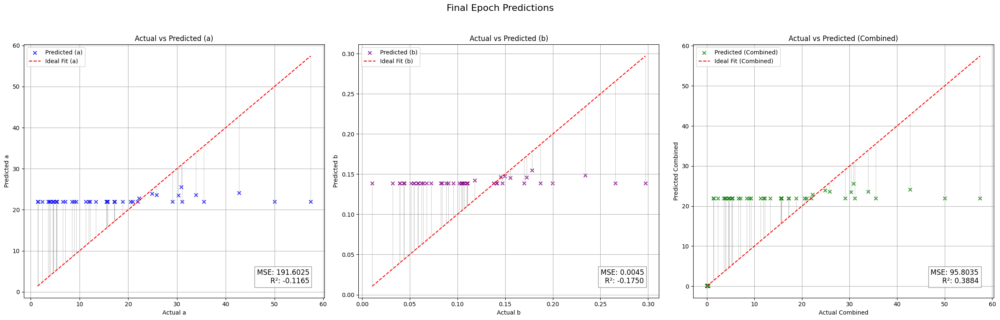

Validation Metrics:
  - MSE: 92.6311
  - R²: -0.1068
  - MAE: 5.8129
  - Explained Variance Score (EVS): 0.0807
Fold 2 Metrics:
  - Validation Loss (MSE): 92.6311
  - R²: -0.1068
  - MAE: 5.8129
  - EVS: 0.0807
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 14.30it/s, loss=0.415]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4225, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 15.13it/s, loss=0.412]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4263, Val Loss: 111.2861
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 13.38it/s, loss=0.69]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4515, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 14.18it/s, loss=0.863]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4669, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 13.44it/s, loss=0.879]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4682, Val Loss: 111.2861
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 13.44it/s, loss=0.302]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4170, Val Loss: 111.2922
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 13.78it/s, loss=0.5]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4345, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 13.73it/s, loss=0.479]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4326, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 13.08it/s, loss=0.467]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4315, Val Loss: 111.2861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.11it/s, loss=0.385]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4242, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.01it/s, loss=0.573]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4408, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 12.07it/s, loss=0.413]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4266, Val Loss: 111.2861
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


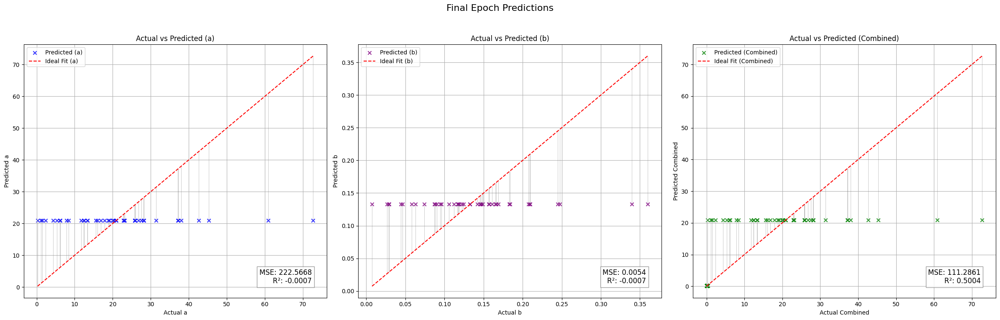

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 11.98it/s, loss=0.532]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4478, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 11.16it/s, loss=0.495]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4446, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 10.15it/s, loss=0.386]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4350, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 11.06it/s, loss=0.427]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4386, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.75it/s, loss=0.287]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4261, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 12.84it/s, loss=0.762]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4682, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.09it/s, loss=0.762]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4681, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 13.27it/s, loss=0.525]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4472, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 14.32it/s, loss=0.363]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4328, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.46it/s, loss=0.285]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4259, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 14.09it/s, loss=0.584]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4523, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


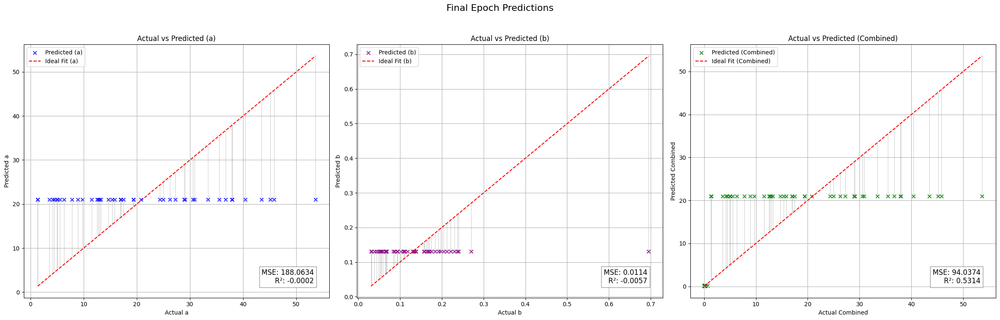

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 14.77it/s, loss=0.46]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4400, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 14.36it/s, loss=0.421]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4367, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 13.49it/s, loss=0.39]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4342, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 14.78it/s, loss=0.582]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4501, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.73it/s, loss=0.413]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4360, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 11.02it/s, loss=0.411]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4358, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.07it/s, loss=0.291]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [7/50], Train Loss: 0.4259, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.65it/s, loss=0.458]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [8/50], Train Loss: 0.4398, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 11.72it/s, loss=0.38]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [9/50], Train Loss: 0.4333, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 11.97it/s, loss=0.226]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [10/50], Train Loss: 0.4204, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 11.57it/s, loss=0.356]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [11/50], Train Loss: 0.4312, Val Loss: 182.6491
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


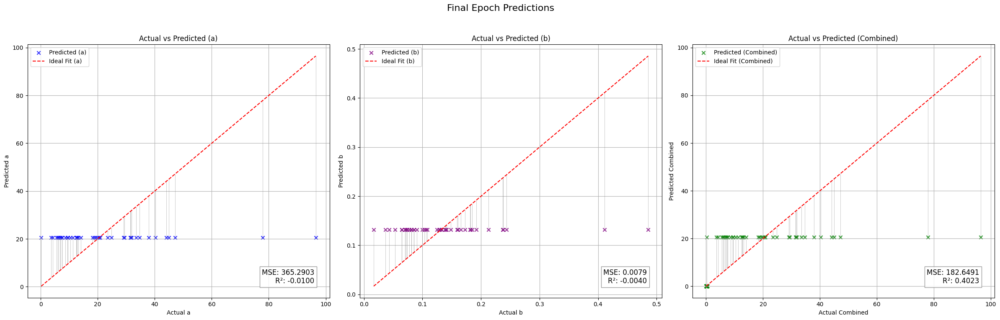

[I 2024-12-01 16:59:06,602] Trial 5 finished with value: 135.5960235595703 and parameters: {'num_layers': 5, 'hidden_size_0': 140, 'activation_0': 'ELU', 'dropout_0': 0.46114582548612426, 'hidden_size_1': 69, 'activation_1': 'LeakyReLU', 'dropout_1': 0.28408632980929216, 'hidden_size_2': 208, 'activation_2': 'LeakyReLU', 'dropout_2': 0.183633345096738, 'hidden_size_3': 317, 'activation_3': 'LeakyReLU', 'dropout_3': 0.4563131982921472, 'hidden_size_4': 141, 'activation_4': 'LeakyReLU', 'dropout_4': 0.3794946193941927, 'batch_size': 32, 'learning_rate': 5.747626654350223e-05, 'optimizer': 'Adagrad'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 135.5960
  - R²: -0.0276
  - MAE: 6.0720
  - EVS: 0.0161
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 13.32it/s, loss=0.286]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 2.0811, Val Loss: 197.4225
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 14.63it/s, loss=0.315]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3974, Val Loss: 197.4225
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 16.13it/s, loss=0.364]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3931, Val Loss: 197.4690
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.52it/s, loss=0.242]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3764, Val Loss: 197.4690
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 14.09it/s, loss=0.516]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3962, Val Loss: 197.4225
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 13.39it/s, loss=0.398]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3821, Val Loss: 197.4225
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 15.51it/s, loss=0.294]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3701, Val Loss: 197.4690
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 15.60it/s, loss=0.164]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0205
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3564, Val Loss: 197.5625
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 13.95it/s, loss=0.351]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0198
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3711, Val Loss: 197.4225
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 14.29it/s, loss=0.72]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4023, Val Loss: 197.3764
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 14.75it/s, loss=0.449]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3773, Val Loss: 197.3764
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 12.39it/s, loss=0.349]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3675, Val Loss: 197.3764
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 11.61it/s, loss=0.384]


Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0197
  - MAE: 6.4552
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.3699, Val Loss: 197.3305
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 14.11it/s, loss=0.451]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.3753, Val Loss: 197.1942
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 13.61it/s, loss=0.369]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.3678, Val Loss: 197.1942
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 13.27it/s, loss=0.641]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.3918, Val Loss: 197.1942
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00, 12.35it/s, loss=0.273]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0194
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.3598, Val Loss: 197.1942
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00, 12.22it/s, loss=0.134]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0187
  - MAE: 6.4594
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3494, Val Loss: 197.1942
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00, 11.24it/s, loss=0.473]


Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0185
  - MAE: 6.4594
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3893, Val Loss: 197.1942
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00, 12.01it/s, loss=0.417]


Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0188
  - MAE: 6.4552
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.4100, Val Loss: 197.3305
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00, 15.55it/s, loss=0.623]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0198
  - MAE: 6.4495
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.4368, Val Loss: 197.5156
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00, 14.25it/s, loss=0.792]


Validation Metrics:
  - MSE: 197.6570
  - R²: -0.0206
  - MAE: 6.4452
  - Explained Variance Score (EVS): 0.0000
Epoch [22/50], Train Loss: 0.4568, Val Loss: 197.6570
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00, 14.11it/s, loss=0.607]


Validation Metrics:
  - MSE: 197.7047
  - R²: -0.0209
  - MAE: 6.4438
  - Explained Variance Score (EVS): 0.0000
Epoch [23/50], Train Loss: 0.4842, Val Loss: 197.7047
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00, 13.59it/s, loss=0.752]


Validation Metrics:
  - MSE: 197.6096
  - R²: -0.0203
  - MAE: 6.4466
  - Explained Variance Score (EVS): 0.0000
Epoch [24/50], Train Loss: 0.6383, Val Loss: 197.6096
Current Dropout Rate: 0.3160
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


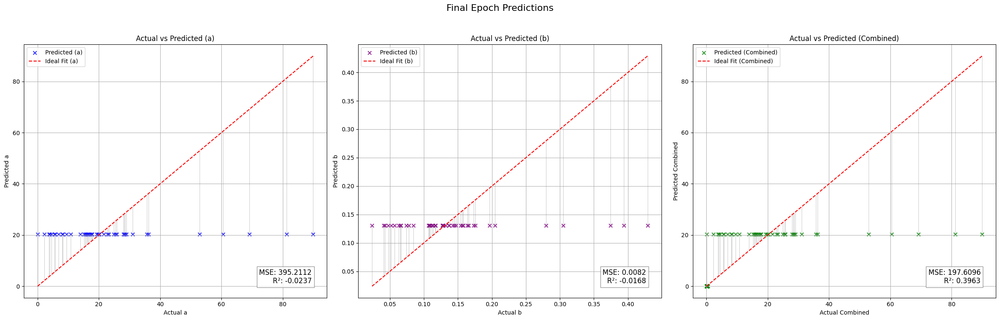

Validation Metrics:
  - MSE: 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.1942
  - R²: -0.0192
  - MAE: 6.4594
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 15.52it/s, loss=0.593]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1710
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3801, Val Loss: 98.5102
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 14.05it/s, loss=0.836]


Validation Metrics:
  - MSE: 98.8272
  - R²: -0.1728
  - MAE: 5.9709
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4074, Val Loss: 98.8272
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 16.34it/s, loss=0.578]


Validation Metrics:
  - MSE: 98.8272
  - R²: -0.1660
  - MAE: 5.9708
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4283, Val Loss: 98.8272
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.59it/s, loss=0.975]


Validation Metrics:
  - MSE: 98.7840
  - R²: -0.1683
  - MAE: 5.9694
  - Explained Variance Score (EVS): 0.0003
Epoch [4/50], Train Loss: 0.7930, Val Loss: 98.7840
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 15.87it/s, loss=1.01]


Validation Metrics:
  - MSE: 99.3100
  - R²: -0.1774
  - MAE: 5.9923
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 1.0723, Val Loss: 99.3100
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 14.90it/s, loss=0.166]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4484, Val Loss: 98.3532
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.97it/s, loss=0.478]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3676, Val Loss: 98.4316
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 12.54it/s, loss=0.354]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3567, Val Loss: 98.4316
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 12.56it/s, loss=0.321]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3538, Val Loss: 98.4316
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.50it/s, loss=0.41]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3616, Val Loss: 98.4316
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 14.49it/s, loss=0.224]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3452, Val Loss: 98.3532
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 12.71it/s, loss=0.217]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3445, Val Loss: 98.3532
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 13.15it/s, loss=0.547]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3737, Val Loss: 98.2750
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 12.93it/s, loss=0.439]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3642, Val Loss: 98.3532
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 12.06it/s, loss=0.34]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3554, Val Loss: 98.3532
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 14.14it/s, loss=0.303]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1727
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3522, Val Loss: 98.5102
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00, 15.64it/s, loss=0.474]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3673, Val Loss: 98.2750
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00, 16.08it/s, loss=0.151]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3387, Val Loss: 98.2750
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00, 14.74it/s, loss=0.417]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3623, Val Loss: 98.3532
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00, 16.10it/s, loss=0.798]


Validation Metrics:
  - MSE: 98.5891
  - R²: -0.1740
  - MAE: 5.9603
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.3961, Val Loss: 98.5891
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00, 16.12it/s, loss=0.364]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.3577, Val Loss: 98.4316
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00, 15.50it/s, loss=0.324]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.3543, Val Loss: 98.2750
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00, 15.96it/s, loss=0.274]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [23/50], Train Loss: 0.3497, Val Loss: 98.3532
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


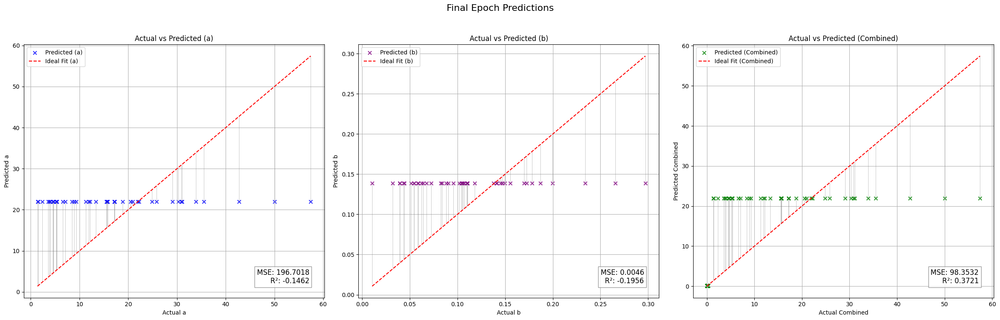

Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 15.20it/s, loss=0.51]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3684, Val Loss: 111.2802
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 16.86it/s, loss=0.615]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3780, Val Loss: 111.2985
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 15.20it/s, loss=0.33]


Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3534, Val Loss: 111.2747
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 14.40it/s, loss=0.302]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3520, Val Loss: 111.2985
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.67it/s, loss=0.279]


Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3535, Val Loss: 111.2747
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 12.42it/s, loss=0.401]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3793, Val Loss: 111.2861
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.53it/s, loss=0.167]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3467, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 14.99it/s, loss=0.419]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3602, Val Loss: 111.2802
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 13.04it/s, loss=0.114]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3332, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 10.86it/s, loss=0.423]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3605, Val Loss: 111.2922
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 13.31it/s, loss=0.337]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3530, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 12.56it/s, loss=0.336]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3528, Val Loss: 111.2922
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 12.95it/s, loss=0.261]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3462, Val Loss: 111.2922
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


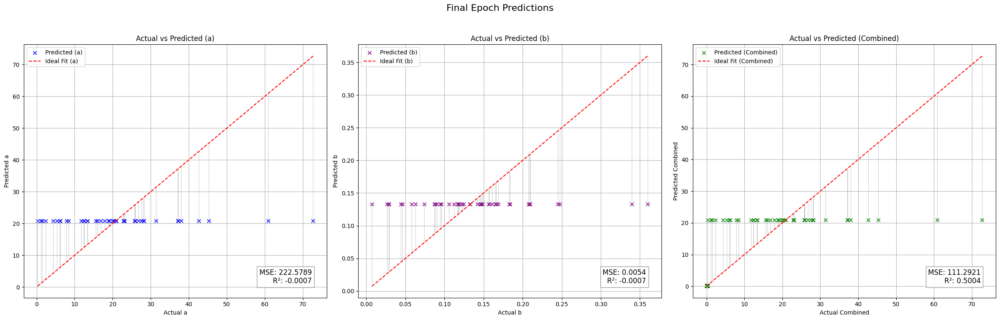

Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 14.50it/s, loss=0.298]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3603, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 14.86it/s, loss=0.24]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3547, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 15.86it/s, loss=0.494]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3772, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.35it/s, loss=0.279]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3581, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 13.80it/s, loss=0.192]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3506, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 15.92it/s, loss=0.312]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3612, Val Loss: 94.0346
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.18it/s, loss=0.197]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0029
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3510, Val Loss: 94.0404
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 15.57it/s, loss=0.377]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3669, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 14.94it/s, loss=0.242]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3548, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 16.61it/s, loss=0.125]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3445, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.31it/s, loss=0.23]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3537, Val Loss: 94.0374
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 12.50it/s, loss=0.607]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3872, Val Loss: 94.0374
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 11.16it/s, loss=0.163]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3478, Val Loss: 94.0374
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 11.94it/s, loss=0.477]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3756, Val Loss: 94.0374
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 12.84it/s, loss=0.607]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3872, Val Loss: 94.0404
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 12.86it/s, loss=0.295]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3596, Val Loss: 94.0374
Current Dropout Rate: 0.3800
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


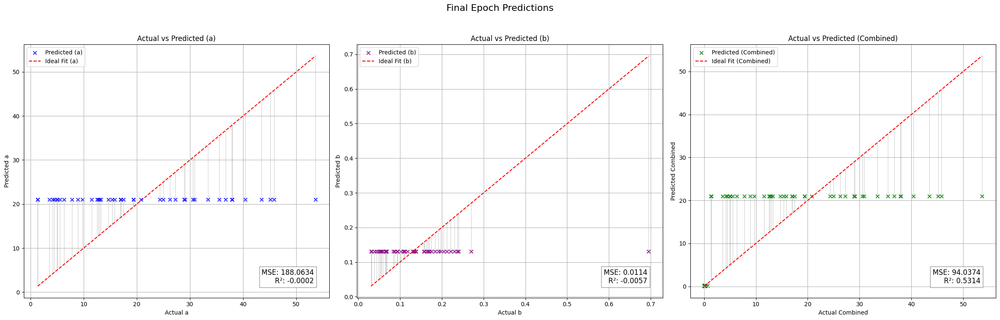

Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 14.16it/s, loss=0.426]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.3694, Val Loss: 182.6789
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 13.56it/s, loss=0.44]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3705, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 14.42it/s, loss=0.51]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3764, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 15.90it/s, loss=0.56]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3805, Val Loss: 182.6789
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 15.49it/s, loss=0.349]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3630, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 14.51it/s, loss=0.307]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3594, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 14.21it/s, loss=0.227]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3528, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 15.28it/s, loss=0.437]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3703, Val Loss: 182.6789
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 14.43it/s, loss=0.266]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3560, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 13.51it/s, loss=0.232]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3532, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 14.49it/s, loss=0.323]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3608, Val Loss: 182.6491
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 14.07it/s, loss=0.189]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3496, Val Loss: 182.6491
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


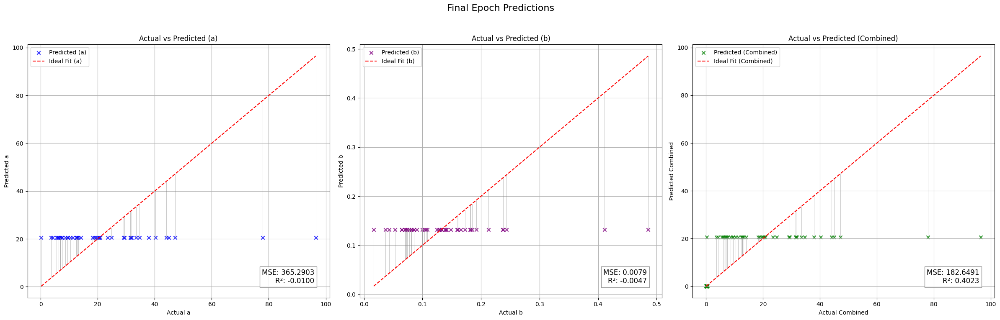

[I 2024-12-01 17:00:27,646] Trial 6 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6855
  - R²: -0.0401
  - MAE: 6.1000
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 19.50it/s, loss=2.38]


Validation Metrics:
  - MSE: 197.5756
  - R²: -0.0156
  - MAE: 6.4524
  - Explained Variance Score (EVS): -0.0026
Epoch [1/50], Train Loss: 2.4273, Val Loss: 197.5756
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 20.98it/s, loss=2.43]


Validation Metrics:
  - MSE: 196.9538
  - R²: -0.0187
  - MAE: 6.4309
  - Explained Variance Score (EVS): -0.0048
Epoch [2/50], Train Loss: 2.4307, Val Loss: 196.9538
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 19.20it/s, loss=2.39]


Validation Metrics:
  - MSE: 195.3868
  - R²: -0.0255
  - MAE: 6.3979
  - Explained Variance Score (EVS): -0.0072
Epoch [3/50], Train Loss: 2.4121, Val Loss: 195.3868
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 20.53it/s, loss=2.15]


Validation Metrics:
  - MSE: 194.7524
  - R²: -0.0264
  - MAE: 6.4402
  - Explained Variance Score (EVS): -0.0093
Epoch [4/50], Train Loss: 2.4022, Val Loss: 194.7524
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 17.17it/s, loss=2.32]


Validation Metrics:
  - MSE: 194.5403
  - R²: -0.0354
  - MAE: 6.4152
  - Explained Variance Score (EVS): -0.0135
Epoch [5/50], Train Loss: 2.3512, Val Loss: 194.5403
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 18.84it/s, loss=2.24]


Validation Metrics:
  - MSE: 191.8439
  - R²: -0.0264
  - MAE: 6.3174
  - Explained Variance Score (EVS): -0.0057
Epoch [6/50], Train Loss: 2.3146, Val Loss: 191.8439
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 18.42it/s, loss=2.33]


Validation Metrics:
  - MSE: 190.0988
  - R²: -0.0147
  - MAE: 6.2946
  - Explained Variance Score (EVS): 0.0048
Epoch [7/50], Train Loss: 2.2710, Val Loss: 190.0988
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 19.88it/s, loss=2.2]


Validation Metrics:
  - MSE: 191.8213
  - R²: -0.0170
  - MAE: 6.3393
  - Explained Variance Score (EVS): 0.0019
Epoch [8/50], Train Loss: 2.2465, Val Loss: 191.8213
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 22.33it/s, loss=2.17]


Validation Metrics:
  - MSE: 193.3972
  - R²: -0.0242
  - MAE: 6.3616
  - Explained Variance Score (EVS): -0.0048
Epoch [9/50], Train Loss: 2.2220, Val Loss: 193.3972
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.95it/s, loss=2.29]


Validation Metrics:
  - MSE: 194.0133
  - R²: -0.0218
  - MAE: 6.3629
  - Explained Variance Score (EVS): -0.0017
Epoch [10/50], Train Loss: 2.2127, Val Loss: 194.0133
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 22.20it/s, loss=2.2]


Validation Metrics:
  - MSE: 190.9136
  - R²: -0.0110
  - MAE: 6.3651
  - Explained Variance Score (EVS): 0.0062
Epoch [11/50], Train Loss: 2.2205, Val Loss: 190.9136
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 22.71it/s, loss=2.14]


Validation Metrics:
  - MSE: 192.3465
  - R²: -0.0112
  - MAE: 6.3909
  - Explained Variance Score (EVS): 0.0066
Epoch [12/50], Train Loss: 2.1897, Val Loss: 192.3465
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 22.49it/s, loss=2.06]


Validation Metrics:
  - MSE: 193.2330
  - R²: -0.0109
  - MAE: 6.4067
  - Explained Variance Score (EVS): 0.0057
Epoch [13/50], Train Loss: 2.1417, Val Loss: 193.2330
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 22.83it/s, loss=2.23]


Validation Metrics:
  - MSE: 192.1028
  - R²: -0.0158
  - MAE: 6.4017
  - Explained Variance Score (EVS): 0.0005
Epoch [14/50], Train Loss: 2.1515, Val Loss: 192.1028
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 21.19it/s, loss=2.12]


Validation Metrics:
  - MSE: 189.7621
  - R²: -0.0090
  - MAE: 6.3438
  - Explained Variance Score (EVS): 0.0066
Epoch [15/50], Train Loss: 2.1048, Val Loss: 189.7621
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 23.00it/s, loss=2.29]


Validation Metrics:
  - MSE: 191.3497
  - R²: -0.0167
  - MAE: 6.3774
  - Explained Variance Score (EVS): -0.0003
Epoch [16/50], Train Loss: 2.0900, Val Loss: 191.3497
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 21.94it/s, loss=1.99]


Validation Metrics:
  - MSE: 191.4221
  - R²: -0.0127
  - MAE: 6.3852
  - Explained Variance Score (EVS): 0.0033
Epoch [17/50], Train Loss: 2.0718, Val Loss: 191.4221
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 21.69it/s, loss=1.91]


Validation Metrics:
  - MSE: 191.2626
  - R²: -0.0137
  - MAE: 6.3628
  - Explained Variance Score (EVS): 0.0044
Epoch [18/50], Train Loss: 2.0665, Val Loss: 191.2626
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 22.45it/s, loss=1.88]


Validation Metrics:
  - MSE: 190.0154
  - R²: -0.0063
  - MAE: 6.3490
  - Explained Variance Score (EVS): 0.0086
Epoch [19/50], Train Loss: 2.0252, Val Loss: 190.0154
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 17.28it/s, loss=1.86]


Validation Metrics:
  - MSE: 189.3011
  - R²: -0.0011
  - MAE: 6.3450
  - Explained Variance Score (EVS): 0.0136
Epoch [20/50], Train Loss: 2.0127, Val Loss: 189.3011
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 17.09it/s, loss=1.97]


Validation Metrics:
  - MSE: 190.6264
  - R²: -0.0077
  - MAE: 6.3933
  - Explained Variance Score (EVS): 0.0057
Epoch [21/50], Train Loss: 2.0039, Val Loss: 190.6264
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 18.14it/s, loss=1.87]


Validation Metrics:
  - MSE: 191.5480
  - R²: -0.0127
  - MAE: 6.3972
  - Explained Variance Score (EVS): 0.0022
Epoch [22/50], Train Loss: 1.9522, Val Loss: 191.5480
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 21.19it/s, loss=1.83]


Validation Metrics:
  - MSE: 191.1980
  - R²: -0.0135
  - MAE: 6.3657
  - Explained Variance Score (EVS): 0.0022
Epoch [23/50], Train Loss: 1.9303, Val Loss: 191.1980
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 17.82it/s, loss=1.95]


Validation Metrics:
  - MSE: 189.7455
  - R²: -0.0017
  - MAE: 6.3407
  - Explained Variance Score (EVS): 0.0138
Epoch [24/50], Train Loss: 1.9221, Val Loss: 189.7455
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 17.97it/s, loss=1.94]


Validation Metrics:
  - MSE: 192.3715
  - R²: -0.0125
  - MAE: 6.3552
  - Explained Variance Score (EVS): 0.0045
Epoch [25/50], Train Loss: 1.8969, Val Loss: 192.3715
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 17.93it/s, loss=1.83]


Validation Metrics:
  - MSE: 191.0721
  - R²: -0.0097
  - MAE: 6.3617
  - Explained Variance Score (EVS): 0.0064
Epoch [26/50], Train Loss: 1.8711, Val Loss: 191.0721
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 19.75it/s, loss=2.11]


Validation Metrics:
  - MSE: 189.9371
  - R²: -0.0062
  - MAE: 6.3783
  - Explained Variance Score (EVS): 0.0083
Epoch [27/50], Train Loss: 1.8638, Val Loss: 189.9371
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 11/11 [00:00<00:00, 19.92it/s, loss=1.85]


Validation Metrics:
  - MSE: 192.3971
  - R²: -0.0090
  - MAE: 6.3903
  - Explained Variance Score (EVS): 0.0074
Epoch [28/50], Train Loss: 1.8555, Val Loss: 192.3971
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 11/11 [00:00<00:00, 20.95it/s, loss=1.81]


Validation Metrics:
  - MSE: 191.7035
  - R²: -0.0094
  - MAE: 6.4012
  - Explained Variance Score (EVS): 0.0047
Epoch [29/50], Train Loss: 1.8339, Val Loss: 191.7035
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 11/11 [00:00<00:00, 21.34it/s, loss=1.72]


Validation Metrics:
  - MSE: 190.5695
  - R²: -0.0086
  - MAE: 6.3793
  - Explained Variance Score (EVS): 0.0057
Epoch [30/50], Train Loss: 1.8271, Val Loss: 190.5695
Current Dropout Rate: 0.2680
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


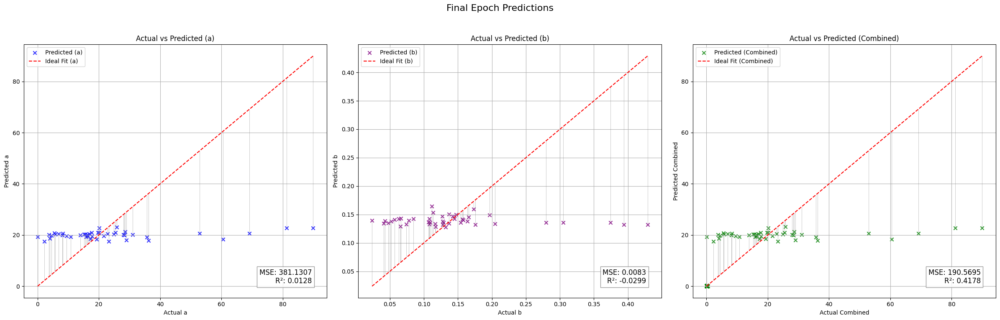

Validation Metrics:
  - MSE: 189.3011
  - R²: -0.0011
  - MAE: 6.3450
  - Explained Variance Score (EVS): 0.0136
Fold 1 Metrics:
  - Validation Loss (MSE): 189.3011
  - R²: -0.0011
  - MAE: 6.3450
  - EVS: 0.0136
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 21.15it/s, loss=1.96]


Validation Metrics:
  - MSE: 86.3676
  - R²: -0.1776
  - MAE: 5.5753
  - Explained Variance Score (EVS): 0.0460
Epoch [1/50], Train Loss: 1.9868, Val Loss: 86.3676
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 21.12it/s, loss=1.89]


Validation Metrics:
  - MSE: 88.1077
  - R²: -0.1793
  - MAE: 5.6189
  - Explained Variance Score (EVS): 0.0367
Epoch [2/50], Train Loss: 1.9738, Val Loss: 88.1077
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 22.78it/s, loss=1.73]


Validation Metrics:
  - MSE: 87.0836
  - R²: -0.1746
  - MAE: 5.5852
  - Explained Variance Score (EVS): 0.0421
Epoch [3/50], Train Loss: 1.9408, Val Loss: 87.0836
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 23.94it/s, loss=1.77]


Validation Metrics:
  - MSE: 86.7896
  - R²: -0.1540
  - MAE: 5.5801
  - Explained Variance Score (EVS): 0.0465
Epoch [4/50], Train Loss: 1.9324, Val Loss: 86.7896
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 21.42it/s, loss=2.12]


Validation Metrics:
  - MSE: 88.7564
  - R²: -0.1675
  - MAE: 5.6549
  - Explained Variance Score (EVS): 0.0412
Epoch [5/50], Train Loss: 1.8962, Val Loss: 88.7564
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 21.37it/s, loss=2.02]


Validation Metrics:
  - MSE: 89.8563
  - R²: -0.1701
  - MAE: 5.6933
  - Explained Variance Score (EVS): 0.0383
Epoch [6/50], Train Loss: 1.9000, Val Loss: 89.8563
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 17.98it/s, loss=1.79]


Validation Metrics:
  - MSE: 90.2329
  - R²: -0.1931
  - MAE: 5.7173
  - Explained Variance Score (EVS): 0.0356
Epoch [7/50], Train Loss: 1.8885, Val Loss: 90.2329
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 19.54it/s, loss=1.73]


Validation Metrics:
  - MSE: 89.4611
  - R²: -0.1795
  - MAE: 5.6768
  - Explained Variance Score (EVS): 0.0377
Epoch [8/50], Train Loss: 1.8643, Val Loss: 89.4611
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 18.99it/s, loss=1.75]


Validation Metrics:
  - MSE: 88.9067
  - R²: -0.1675
  - MAE: 5.6562
  - Explained Variance Score (EVS): 0.0415
Epoch [9/50], Train Loss: 1.8417, Val Loss: 88.9067
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 18.72it/s, loss=1.96]


Validation Metrics:
  - MSE: 91.4940
  - R²: -0.1768
  - MAE: 5.7668
  - Explained Variance Score (EVS): 0.0414
Epoch [10/50], Train Loss: 1.8343, Val Loss: 91.4940
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 17.25it/s, loss=1.9]


Validation Metrics:
  - MSE: 89.4512
  - R²: -0.1606
  - MAE: 5.6758
  - Explained Variance Score (EVS): 0.0374
Epoch [11/50], Train Loss: 1.8004, Val Loss: 89.4512
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


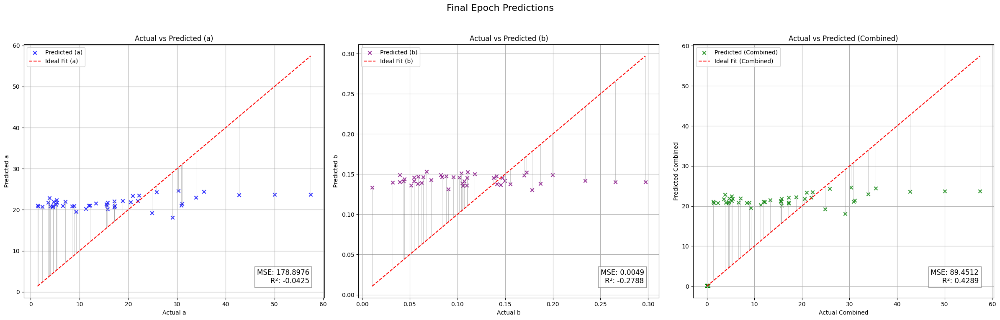

Validation Metrics:
  - MSE: 86.3676
  - R²: -0.1776
  - MAE: 5.5753
  - Explained Variance Score (EVS): 0.0460
Fold 2 Metrics:
  - Validation Loss (MSE): 86.3676
  - R²: -0.1776
  - MAE: 5.5753
  - EVS: 0.0460
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 17.89it/s, loss=1.79]


Validation Metrics:
  - MSE: 108.0938
  - R²: 0.0149
  - MAE: 5.3339
  - Explained Variance Score (EVS): 0.0169
Epoch [1/50], Train Loss: 1.9725, Val Loss: 108.0938
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 22.53it/s, loss=1.87]


Validation Metrics:
  - MSE: 108.4872
  - R²: 0.0117
  - MAE: 5.3320
  - Explained Variance Score (EVS): 0.0133
Epoch [2/50], Train Loss: 1.9484, Val Loss: 108.4872
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 21.72it/s, loss=1.86]


Validation Metrics:
  - MSE: 108.7930
  - R²: 0.0142
  - MAE: 5.3483
  - Explained Variance Score (EVS): 0.0161
Epoch [3/50], Train Loss: 1.9174, Val Loss: 108.7930
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 20.42it/s, loss=2.39]


Validation Metrics:
  - MSE: 109.3199
  - R²: 0.0121
  - MAE: 5.3575
  - Explained Variance Score (EVS): 0.0142
Epoch [4/50], Train Loss: 1.9044, Val Loss: 109.3199
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 21.00it/s, loss=1.75]


Validation Metrics:
  - MSE: 109.2106
  - R²: 0.0120
  - MAE: 5.3424
  - Explained Variance Score (EVS): 0.0136
Epoch [5/50], Train Loss: 1.9006, Val Loss: 109.2106
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 20.61it/s, loss=1.68]


Validation Metrics:
  - MSE: 109.4729
  - R²: 0.0100
  - MAE: 5.3715
  - Explained Variance Score (EVS): 0.0110
Epoch [6/50], Train Loss: 1.8879, Val Loss: 109.4729
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 23.51it/s, loss=1.83]


Validation Metrics:
  - MSE: 109.3838
  - R²: 0.0119
  - MAE: 5.4007
  - Explained Variance Score (EVS): 0.0124
Epoch [7/50], Train Loss: 1.8481, Val Loss: 109.3838
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 20.75it/s, loss=1.71]


Validation Metrics:
  - MSE: 110.0508
  - R²: 0.0071
  - MAE: 5.4239
  - Explained Variance Score (EVS): 0.0075
Epoch [8/50], Train Loss: 1.8317, Val Loss: 110.0508
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 20.33it/s, loss=1.84]


Validation Metrics:
  - MSE: 109.9771
  - R²: 0.0101
  - MAE: 5.4064
  - Explained Variance Score (EVS): 0.0108
Epoch [9/50], Train Loss: 1.8228, Val Loss: 109.9771
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 23.04it/s, loss=1.82]


Validation Metrics:
  - MSE: 108.5746
  - R²: 0.0191
  - MAE: 5.3613
  - Explained Variance Score (EVS): 0.0196
Epoch [10/50], Train Loss: 1.8023, Val Loss: 108.5746
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 23.12it/s, loss=1.85]


Validation Metrics:
  - MSE: 108.9384
  - R²: 0.0193
  - MAE: 5.3941
  - Explained Variance Score (EVS): 0.0195
Epoch [11/50], Train Loss: 1.7720, Val Loss: 108.9384
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


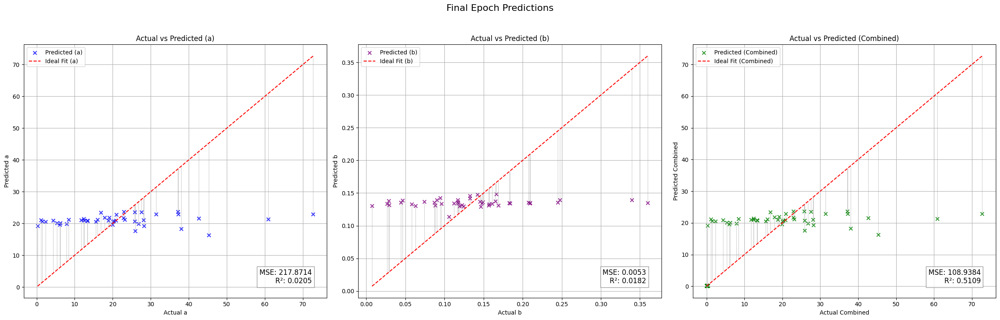

Validation Metrics:
  - MSE: 108.0938
  - R²: 0.0149
  - MAE: 5.3339
  - Explained Variance Score (EVS): 0.0169
Fold 3 Metrics:
  - Validation Loss (MSE): 108.0938
  - R²: 0.0149
  - MAE: 5.3339
  - EVS: 0.0169
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 16.67it/s, loss=2.07]


Validation Metrics:
  - MSE: 97.1610
  - R²: -0.0229
  - MAE: 5.9995
  - Explained Variance Score (EVS): -0.0222
Epoch [1/50], Train Loss: 1.9561, Val Loss: 97.1610
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 19.24it/s, loss=1.94]


Validation Metrics:
  - MSE: 96.2120
  - R²: -0.0189
  - MAE: 5.9752
  - Explained Variance Score (EVS): -0.0187
Epoch [2/50], Train Loss: 1.9434, Val Loss: 96.2120
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 17.79it/s, loss=2]


Validation Metrics:
  - MSE: 96.5170
  - R²: -0.0190
  - MAE: 5.9710
  - Explained Variance Score (EVS): -0.0184
Epoch [3/50], Train Loss: 1.9128, Val Loss: 96.5170
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 16.89it/s, loss=1.93]


Validation Metrics:
  - MSE: 96.1874
  - R²: -0.0182
  - MAE: 5.9458
  - Explained Variance Score (EVS): -0.0174
Epoch [4/50], Train Loss: 1.9003, Val Loss: 96.1874
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 18.04it/s, loss=2.19]


Validation Metrics:
  - MSE: 97.3488
  - R²: -0.0262
  - MAE: 5.9932
  - Explained Variance Score (EVS): -0.0259
Epoch [5/50], Train Loss: 1.8905, Val Loss: 97.3488
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 21.22it/s, loss=1.78]


Validation Metrics:
  - MSE: 96.5147
  - R²: -0.0200
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0189
Epoch [6/50], Train Loss: 1.8584, Val Loss: 96.5147
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 21.99it/s, loss=1.74]


Validation Metrics:
  - MSE: 97.2164
  - R²: -0.0251
  - MAE: 5.9734
  - Explained Variance Score (EVS): -0.0241
Epoch [7/50], Train Loss: 1.8456, Val Loss: 97.2164
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 20.48it/s, loss=1.98]


Validation Metrics:
  - MSE: 96.9945
  - R²: -0.0225
  - MAE: 5.9884
  - Explained Variance Score (EVS): -0.0218
Epoch [8/50], Train Loss: 1.8209, Val Loss: 96.9945
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 22.68it/s, loss=2.04]


Validation Metrics:
  - MSE: 97.1259
  - R²: -0.0231
  - MAE: 6.0123
  - Explained Variance Score (EVS): -0.0225
Epoch [9/50], Train Loss: 1.8082, Val Loss: 97.1259
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 22.95it/s, loss=1.81]


Validation Metrics:
  - MSE: 96.2815
  - R²: -0.0190
  - MAE: 5.9604
  - Explained Variance Score (EVS): -0.0182
Epoch [10/50], Train Loss: 1.7977, Val Loss: 96.2815
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 20.42it/s, loss=1.6]


Validation Metrics:
  - MSE: 96.2975
  - R²: -0.0172
  - MAE: 5.9574
  - Explained Variance Score (EVS): -0.0164
Epoch [11/50], Train Loss: 1.7931, Val Loss: 96.2975
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 19.19it/s, loss=1.68]


Validation Metrics:
  - MSE: 96.6029
  - R²: -0.0185
  - MAE: 5.9772
  - Explained Variance Score (EVS): -0.0178
Epoch [12/50], Train Loss: 1.7486, Val Loss: 96.6029
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 21.39it/s, loss=1.86]


Validation Metrics:
  - MSE: 96.3348
  - R²: -0.0194
  - MAE: 5.9790
  - Explained Variance Score (EVS): -0.0188
Epoch [13/50], Train Loss: 1.7600, Val Loss: 96.3348
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 22.33it/s, loss=1.86]


Validation Metrics:
  - MSE: 95.6060
  - R²: -0.0142
  - MAE: 5.9530
  - Explained Variance Score (EVS): -0.0138
Epoch [14/50], Train Loss: 1.7566, Val Loss: 95.6060
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 21.86it/s, loss=2.22]


Validation Metrics:
  - MSE: 96.6351
  - R²: -0.0191
  - MAE: 5.9807
  - Explained Variance Score (EVS): -0.0186
Epoch [15/50], Train Loss: 1.7338, Val Loss: 96.6351
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 21.50it/s, loss=1.7]


Validation Metrics:
  - MSE: 96.5714
  - R²: -0.0196
  - MAE: 5.9738
  - Explained Variance Score (EVS): -0.0189
Epoch [16/50], Train Loss: 1.7383, Val Loss: 96.5714
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 17.73it/s, loss=1.71]


Validation Metrics:
  - MSE: 96.5510
  - R²: -0.0188
  - MAE: 5.9678
  - Explained Variance Score (EVS): -0.0180
Epoch [17/50], Train Loss: 1.7183, Val Loss: 96.5510
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 16.70it/s, loss=1.7]


Validation Metrics:
  - MSE: 96.6132
  - R²: -0.0198
  - MAE: 5.9843
  - Explained Variance Score (EVS): -0.0192
Epoch [18/50], Train Loss: 1.7102, Val Loss: 96.6132
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 18.82it/s, loss=1.71]


Validation Metrics:
  - MSE: 96.5456
  - R²: -0.0172
  - MAE: 5.9734
  - Explained Variance Score (EVS): -0.0166
Epoch [19/50], Train Loss: 1.7150, Val Loss: 96.5456
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 16.63it/s, loss=1.84]


Validation Metrics:
  - MSE: 96.4835
  - R²: -0.0190
  - MAE: 5.9876
  - Explained Variance Score (EVS): -0.0187
Epoch [20/50], Train Loss: 1.7024, Val Loss: 96.4835
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 16.74it/s, loss=1.69]


Validation Metrics:
  - MSE: 96.7429
  - R²: -0.0205
  - MAE: 5.9944
  - Explained Variance Score (EVS): -0.0202
Epoch [21/50], Train Loss: 1.6929, Val Loss: 96.7429
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 17.67it/s, loss=1.83]


Validation Metrics:
  - MSE: 96.0320
  - R²: -0.0174
  - MAE: 5.9600
  - Explained Variance Score (EVS): -0.0168
Epoch [22/50], Train Loss: 1.6864, Val Loss: 96.0320
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 16.42it/s, loss=1.51]


Validation Metrics:
  - MSE: 96.5607
  - R²: -0.0194
  - MAE: 5.9875
  - Explained Variance Score (EVS): -0.0188
Epoch [23/50], Train Loss: 1.6718, Val Loss: 96.5607
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 21.38it/s, loss=1.71]


Validation Metrics:
  - MSE: 96.9613
  - R²: -0.0211
  - MAE: 6.0081
  - Explained Variance Score (EVS): -0.0207
Epoch [24/50], Train Loss: 1.6707, Val Loss: 96.9613
Current Dropout Rate: 0.3160
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


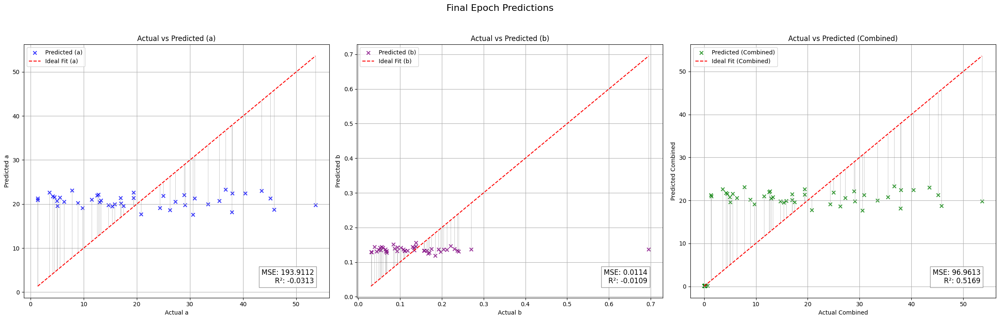

Validation Metrics:
  - MSE: 95.6060
  - R²: -0.0142
  - MAE: 5.9530
  - Explained Variance Score (EVS): -0.0138
Fold 4 Metrics:
  - Validation Loss (MSE): 95.6060
  - R²: -0.0142
  - MAE: 5.9530
  - EVS: -0.0138
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 21.87it/s, loss=1.54]


Validation Metrics:
  - MSE: 183.1846
  - R²: 0.0012
  - MAE: 6.7570
  - Explained Variance Score (EVS): 0.0082
Epoch [1/50], Train Loss: 1.7474, Val Loss: 183.1846
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 20.63it/s, loss=1.81]


Validation Metrics:
  - MSE: 183.4910
  - R²: -0.0041
  - MAE: 6.7544
  - Explained Variance Score (EVS): 0.0030
Epoch [2/50], Train Loss: 1.7378, Val Loss: 183.4910
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 22.18it/s, loss=1.89]


Validation Metrics:
  - MSE: 184.5018
  - R²: -0.0072
  - MAE: 6.7809
  - Explained Variance Score (EVS): -0.0002
Epoch [3/50], Train Loss: 1.7148, Val Loss: 184.5018
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 21.28it/s, loss=1.81]


Validation Metrics:
  - MSE: 184.3474
  - R²: -0.0047
  - MAE: 6.7584
  - Explained Variance Score (EVS): 0.0027
Epoch [4/50], Train Loss: 1.7211, Val Loss: 184.3474
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 20.83it/s, loss=1.59]


Validation Metrics:
  - MSE: 185.0818
  - R²: -0.0073
  - MAE: 6.7554
  - Explained Variance Score (EVS): 0.0005
Epoch [5/50], Train Loss: 1.7115, Val Loss: 185.0818
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 20.84it/s, loss=1.55]


Validation Metrics:
  - MSE: 184.2426
  - R²: -0.0036
  - MAE: 6.7377
  - Explained Variance Score (EVS): 0.0043
Epoch [6/50], Train Loss: 1.7098, Val Loss: 184.2426
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 20.26it/s, loss=1.8]


Validation Metrics:
  - MSE: 184.4787
  - R²: -0.0044
  - MAE: 6.7447
  - Explained Variance Score (EVS): 0.0047
Epoch [7/50], Train Loss: 1.6966, Val Loss: 184.4787
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 19.09it/s, loss=1.64]


Validation Metrics:
  - MSE: 184.9067
  - R²: -0.0062
  - MAE: 6.7752
  - Explained Variance Score (EVS): 0.0016
Epoch [8/50], Train Loss: 1.6843, Val Loss: 184.9067
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 16.85it/s, loss=1.52]


Validation Metrics:
  - MSE: 184.3348
  - R²: -0.0040
  - MAE: 6.7475
  - Explained Variance Score (EVS): 0.0042
Epoch [9/50], Train Loss: 1.6843, Val Loss: 184.3348
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 20.53it/s, loss=1.49]


Validation Metrics:
  - MSE: 184.7777
  - R²: -0.0058
  - MAE: 6.7886
  - Explained Variance Score (EVS): 0.0010
Epoch [10/50], Train Loss: 1.6730, Val Loss: 184.7777
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 17.15it/s, loss=1.74]


Validation Metrics:
  - MSE: 183.8786
  - R²: -0.0050
  - MAE: 6.7612
  - Explained Variance Score (EVS): 0.0020
Epoch [11/50], Train Loss: 1.6610, Val Loss: 183.8786
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


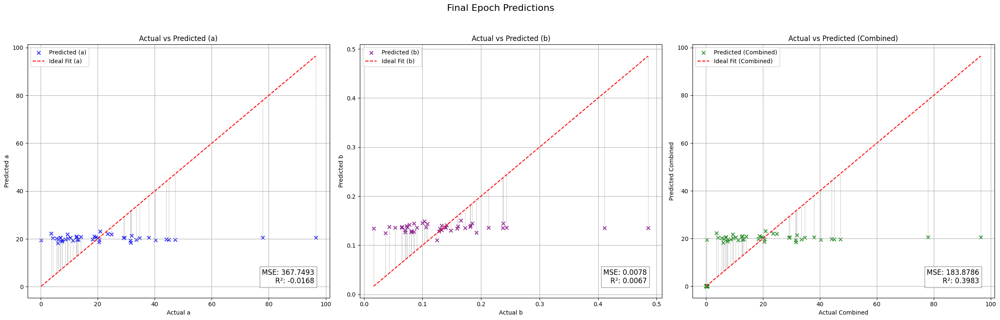

[I 2024-12-01 17:02:03,859] Trial 7 finished with value: 132.51058959960938 and parameters: {'num_layers': 3, 'hidden_size_0': 468, 'activation_0': 'LeakyReLU', 'dropout_0': 0.4287846715677929, 'hidden_size_1': 478, 'activation_1': 'ReLU', 'dropout_1': 0.3965809172300333, 'hidden_size_2': 248, 'activation_2': 'LeakyReLU', 'dropout_2': 0.40951947662431765, 'batch_size': 16, 'learning_rate': 0.0023550900445244156, 'optimizer': 'SGD'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 183.1846
  - R²: 0.0012
  - MAE: 6.7570
  - Explained Variance Score (EVS): 0.0082
Fold 5 Metrics:
  - Validation Loss (MSE): 183.1846
  - R²: 0.0012
  - MAE: 6.7570
  - EVS: 0.0082
Avg Validation Metrics:
  - MSE: 132.5106
  - R²: -0.0354
  - MAE: 5.9928
  - EVS: 0.0142
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 10.42it/s, loss=1.71]


Validation Metrics:
  - MSE: 203.3778
  - R²: -0.0432
  - MAE: 6.4034
  - Explained Variance Score (EVS): 0.0001
Epoch [1/50], Train Loss: 2.1834, Val Loss: 203.3778
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.94it/s, loss=1.65]


Validation Metrics:
  - MSE: 202.7052
  - R²: -0.0395
  - MAE: 6.4028
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 1.7348, Val Loss: 202.7052
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 12.09it/s, loss=1.42]


Validation Metrics:
  - MSE: 202.0417
  - R²: -0.0381
  - MAE: 6.4042
  - Explained Variance Score (EVS): 0.0002
Epoch [3/50], Train Loss: 1.3994, Val Loss: 202.0417
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 13.42it/s, loss=1.06]


Validation Metrics:
  - MSE: 201.3284
  - R²: -0.0376
  - MAE: 6.4048
  - Explained Variance Score (EVS): 0.0002
Epoch [4/50], Train Loss: 1.1864, Val Loss: 201.3284
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 13.14it/s, loss=1.02]


Validation Metrics:
  - MSE: 200.1408
  - R²: -0.0357
  - MAE: 6.4089
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 1.0398, Val Loss: 200.1408
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 12.48it/s, loss=0.802]


Validation Metrics:
  - MSE: 199.7437
  - R²: -0.0334
  - MAE: 6.4119
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.8997, Val Loss: 199.7437
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 13.67it/s, loss=0.713]


Validation Metrics:
  - MSE: 199.3577
  - R²: -0.0314
  - MAE: 6.4147
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.8008, Val Loss: 199.3577
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 13.78it/s, loss=0.871]


Validation Metrics:
  - MSE: 199.0829
  - R²: -0.0300
  - MAE: 6.4181
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.7432, Val Loss: 199.0829
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 11.79it/s, loss=0.582]


Validation Metrics:
  - MSE: 198.6560
  - R²: -0.0282
  - MAE: 6.4238
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.6718, Val Loss: 198.6560
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.72it/s, loss=0.742]


Validation Metrics:
  - MSE: 198.0449
  - R²: -0.0259
  - MAE: 6.4337
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.6349, Val Loss: 198.0449
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.27it/s, loss=0.593]


Validation Metrics:
  - MSE: 197.7526
  - R²: -0.0245
  - MAE: 6.4423
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.5913, Val Loss: 197.7526
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 13.57it/s, loss=0.513]


Validation Metrics:
  - MSE: 197.7047
  - R²: -0.0236
  - MAE: 6.4437
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.5636, Val Loss: 197.7047
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 12.87it/s, loss=0.455]


Validation Metrics:
  - MSE: 197.7047
  - R²: -0.0230
  - MAE: 6.4437
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.5447, Val Loss: 197.7047
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 10.61it/s, loss=0.465]


Validation Metrics:
  - MSE: 197.7047
  - R²: -0.0224
  - MAE: 6.4437
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.5311, Val Loss: 197.7047
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  9.91it/s, loss=0.373]


Validation Metrics:
  - MSE: 197.6571
  - R²: -0.0220
  - MAE: 6.4452
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.5079, Val Loss: 197.6571
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 10.56it/s, loss=0.4]


Validation Metrics:
  - MSE: 197.6097
  - R²: -0.0215
  - MAE: 6.4466
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.5085, Val Loss: 197.6097
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  9.39it/s, loss=0.457]


Validation Metrics:
  - MSE: 197.6097
  - R²: -0.0213
  - MAE: 6.4466
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.5086, Val Loss: 197.6097
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00, 10.57it/s, loss=0.395]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0210
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [18/50], Train Loss: 0.5019, Val Loss: 197.5625
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00, 10.73it/s, loss=1]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0207
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [19/50], Train Loss: 0.5551, Val Loss: 197.5156
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  9.73it/s, loss=0.756]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0205
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [20/50], Train Loss: 0.5316, Val Loss: 197.5156
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00, 11.41it/s, loss=0.686]


Validation Metrics:
  - MSE: 197.4075
  - R²: -0.0198
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0006
Epoch [21/50], Train Loss: 0.5237, Val Loss: 197.4075
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00, 13.10it/s, loss=0.417]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [22/50], Train Loss: 0.4985, Val Loss: 197.4690
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00, 12.96it/s, loss=0.634]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [23/50], Train Loss: 0.5165, Val Loss: 197.4690
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00, 13.05it/s, loss=0.397]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [24/50], Train Loss: 0.4943, Val Loss: 197.4690
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00, 12.05it/s, loss=0.368]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [25/50], Train Loss: 0.4907, Val Loss: 197.4690
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00, 14.20it/s, loss=0.835]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [26/50], Train Loss: 0.5310, Val Loss: 197.4690
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00, 13.59it/s, loss=0.429]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [27/50], Train Loss: 0.4942, Val Loss: 197.4690
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00, 12.76it/s, loss=0.463]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [28/50], Train Loss: 0.4963, Val Loss: 197.4690
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00, 12.64it/s, loss=0.663]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [29/50], Train Loss: 0.5130, Val Loss: 197.4690
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 6/6 [00:00<00:00, 12.81it/s, loss=0.424]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [30/50], Train Loss: 0.4910, Val Loss: 197.4690
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 6/6 [00:00<00:00, 12.82it/s, loss=0.497]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [31/50], Train Loss: 0.4966, Val Loss: 197.5156
Current Dropout Rate: 0.2600
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


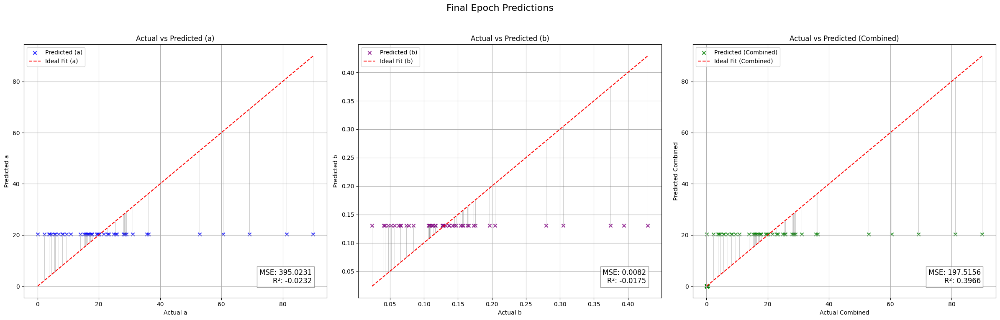

Validation Metrics:
  - MSE: 197.4075
  - R²: -0.0198
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0006
Fold 1 Metrics:
  - Validation Loss (MSE): 197.4075
  - R²: -0.0198
  - MAE: 6.4480
  - EVS: 0.0006
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 10.49it/s, loss=0.362]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4861, Val Loss: 98.2750
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 10.37it/s, loss=0.731]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.5174, Val Loss: 98.2750
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 10.87it/s, loss=0.557]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.5007, Val Loss: 98.2750
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 10.41it/s, loss=0.463]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4912, Val Loss: 98.3532
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.86it/s, loss=0.669]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.5083, Val Loss: 98.3532
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 10.81it/s, loss=0.342]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4785, Val Loss: 98.3532
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.66it/s, loss=0.252]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4696, Val Loss: 98.3532
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 11.53it/s, loss=0.445]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4858, Val Loss: 98.3532
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 11.93it/s, loss=0.455]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4859, Val Loss: 98.3532
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.48it/s, loss=0.592]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4972, Val Loss: 98.3532
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.18it/s, loss=0.306]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4710, Val Loss: 98.3532
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


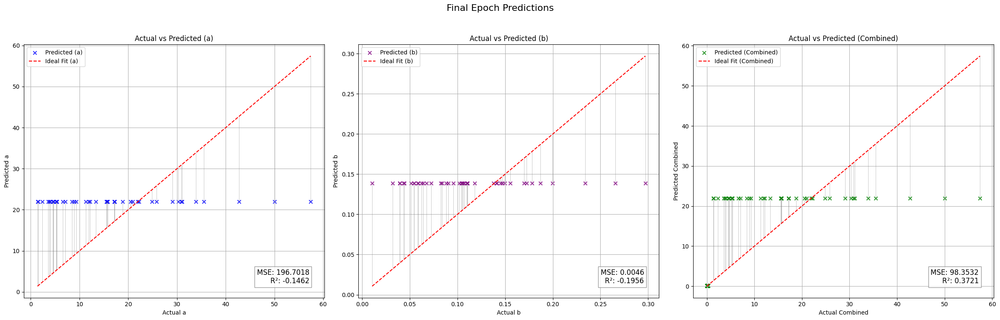

Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 12.06it/s, loss=0.818]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.5230, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 12.08it/s, loss=0.532]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4964, Val Loss: 111.2922
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 13.13it/s, loss=0.749]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.5144, Val Loss: 111.2922
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 13.45it/s, loss=0.465]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4881, Val Loss: 111.2922
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.49it/s, loss=0.312]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4736, Val Loss: 111.2922
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 11.44it/s, loss=0.554]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4942, Val Loss: 111.2922
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.91it/s, loss=0.395]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4792, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 10.44it/s, loss=0.424]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4811, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 10.32it/s, loss=0.355]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4745, Val Loss: 111.2861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 11.11it/s, loss=0.479]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4851, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 11.27it/s, loss=0.907]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.5225, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00, 10.65it/s, loss=0.596]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4946, Val Loss: 111.2861
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00, 11.62it/s, loss=0.788]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.5112, Val Loss: 111.2861
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00, 13.19it/s, loss=0.654]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4989, Val Loss: 111.2861
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00, 13.16it/s, loss=0.495]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4844, Val Loss: 111.2861
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00, 13.26it/s, loss=0.442]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4793, Val Loss: 111.2861
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00, 13.05it/s, loss=0.38]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4734, Val Loss: 111.2922
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


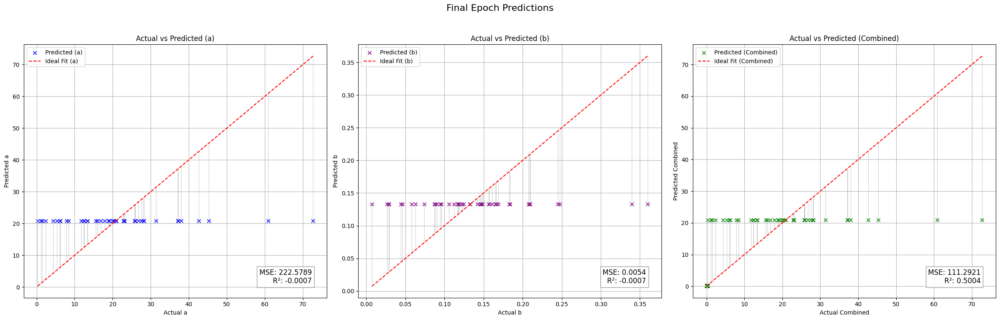

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 12.32it/s, loss=0.44]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4929, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 13.48it/s, loss=0.333]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4830, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 13.52it/s, loss=0.764]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.5210, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 12.13it/s, loss=0.588]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.5051, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 13.50it/s, loss=0.532]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4999, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  9.97it/s, loss=0.378]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4862, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 11.22it/s, loss=0.758]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.5196, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 12.25it/s, loss=0.583]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.5038, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 11.38it/s, loss=0.958]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.5368, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 10.43it/s, loss=0.665]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.5107, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 10.90it/s, loss=0.497]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4956, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


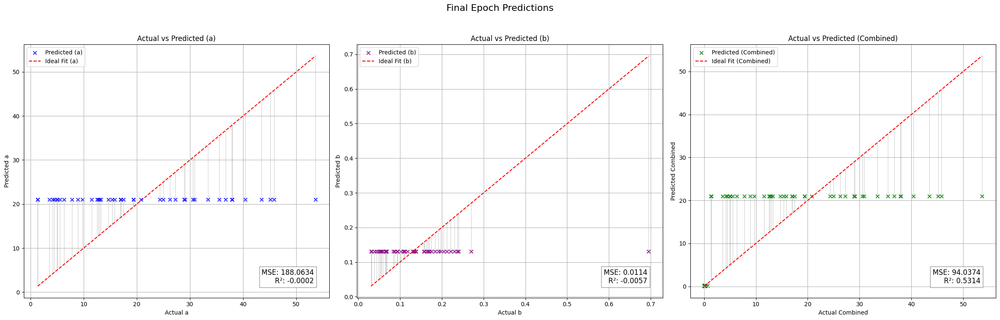

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00, 10.72it/s, loss=0.603]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.5050, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00, 14.13it/s, loss=0.376]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4858, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00, 12.72it/s, loss=0.565]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.5015, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 12.35it/s, loss=0.564]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.5013, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 11.66it/s, loss=0.655]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.5087, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00, 11.57it/s, loss=0.515]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4970, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00, 13.07it/s, loss=0.442]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4908, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00, 11.87it/s, loss=0.404]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4875, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00, 12.05it/s, loss=0.532]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4981, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 12.84it/s, loss=0.412]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4879, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00, 12.80it/s, loss=0.434]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4896, Val Loss: 182.6491
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


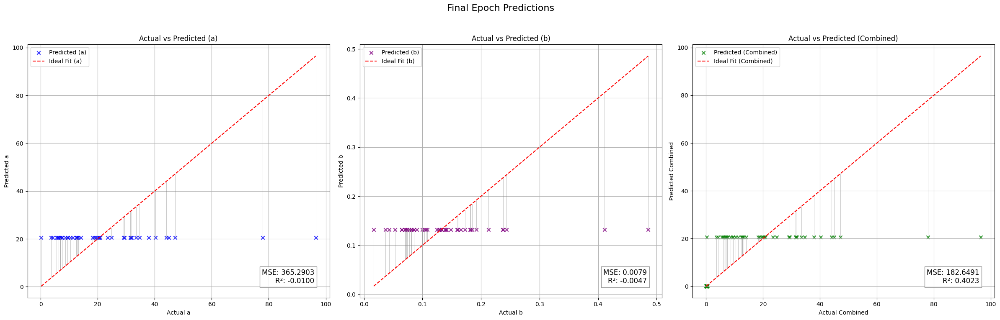

[I 2024-12-01 17:03:31,073] Trial 8 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.7310
  - R²: -0.0401
  - MAE: 6.0976
  - EVS: 0.0001
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.45it/s, loss=1.43]


Validation Metrics:
  - MSE: 198.4658
  - R²: -0.0177
  - MAE: 6.4128
  - Explained Variance Score (EVS): 0.0009
Epoch [1/50], Train Loss: 1.3115, Val Loss: 198.4658
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=1.23]


Validation Metrics:
  - MSE: 197.6304
  - R²: -0.0144
  - MAE: 6.4152
  - Explained Variance Score (EVS): 0.0020
Epoch [2/50], Train Loss: 1.2885, Val Loss: 197.6304
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=1.27]


Validation Metrics:
  - MSE: 196.8699
  - R²: -0.0135
  - MAE: 6.4219
  - Explained Variance Score (EVS): 0.0021
Epoch [3/50], Train Loss: 1.2649, Val Loss: 196.8699
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.89it/s, loss=1.32]


Validation Metrics:
  - MSE: 196.3879
  - R²: -0.0129
  - MAE: 6.4325
  - Explained Variance Score (EVS): 0.0026
Epoch [4/50], Train Loss: 1.3236, Val Loss: 196.3879
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=1.17]


Validation Metrics:
  - MSE: 196.2905
  - R²: -0.0132
  - MAE: 6.4222
  - Explained Variance Score (EVS): 0.0029
Epoch [5/50], Train Loss: 1.2542, Val Loss: 196.2905
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.42it/s, loss=1.16]


Validation Metrics:
  - MSE: 195.8968
  - R²: -0.0127
  - MAE: 6.4156
  - Explained Variance Score (EVS): 0.0041
Epoch [6/50], Train Loss: 1.2466, Val Loss: 195.8968
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.05it/s, loss=1.23]


Validation Metrics:
  - MSE: 195.4151
  - R²: -0.0149
  - MAE: 6.4088
  - Explained Variance Score (EVS): 0.0046
Epoch [7/50], Train Loss: 1.2555, Val Loss: 195.4151
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.71it/s, loss=1.21]


Validation Metrics:
  - MSE: 194.8965
  - R²: -0.0142
  - MAE: 6.4053
  - Explained Variance Score (EVS): 0.0046
Epoch [8/50], Train Loss: 1.2626, Val Loss: 194.8965
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.17it/s, loss=1.16]


Validation Metrics:
  - MSE: 193.3366
  - R²: -0.0109
  - MAE: 6.4203
  - Explained Variance Score (EVS): 0.0054
Epoch [9/50], Train Loss: 1.2484, Val Loss: 193.3366
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.50it/s, loss=1.31]


Validation Metrics:
  - MSE: 192.5867
  - R²: -0.0122
  - MAE: 6.4167
  - Explained Variance Score (EVS): 0.0063
Epoch [10/50], Train Loss: 1.2492, Val Loss: 192.5867
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.48it/s, loss=1.28]


Validation Metrics:
  - MSE: 191.3012
  - R²: -0.0100
  - MAE: 6.4274
  - Explained Variance Score (EVS): 0.0071
Epoch [11/50], Train Loss: 1.2351, Val Loss: 191.3012
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.92it/s, loss=1.19]


Validation Metrics:
  - MSE: 191.0325
  - R²: -0.0088
  - MAE: 6.4101
  - Explained Variance Score (EVS): 0.0068
Epoch [12/50], Train Loss: 1.2355, Val Loss: 191.0325
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.93it/s, loss=1.12]


Validation Metrics:
  - MSE: 190.7144
  - R²: -0.0088
  - MAE: 6.3898
  - Explained Variance Score (EVS): 0.0067
Epoch [13/50], Train Loss: 1.2168, Val Loss: 190.7144
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s, loss=1.22]


Validation Metrics:
  - MSE: 189.8783
  - R²: -0.0065
  - MAE: 6.3832
  - Explained Variance Score (EVS): 0.0069
Epoch [14/50], Train Loss: 1.2050, Val Loss: 189.8783
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.21it/s, loss=1.27]


Validation Metrics:
  - MSE: 188.5029
  - R²: -0.0030
  - MAE: 6.3927
  - Explained Variance Score (EVS): 0.0072
Epoch [15/50], Train Loss: 1.2442, Val Loss: 188.5029
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.60it/s, loss=1.13]


Validation Metrics:
  - MSE: 188.3230
  - R²: -0.0052
  - MAE: 6.4111
  - Explained Variance Score (EVS): 0.0045
Epoch [16/50], Train Loss: 1.1989, Val Loss: 188.3230
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.52it/s, loss=1.19]


Validation Metrics:
  - MSE: 188.3829
  - R²: -0.0053
  - MAE: 6.4292
  - Explained Variance Score (EVS): 0.0028
Epoch [17/50], Train Loss: 1.2089, Val Loss: 188.3829
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  7.87it/s, loss=1.3]


Validation Metrics:
  - MSE: 189.4018
  - R²: -0.0119
  - MAE: 6.4566
  - Explained Variance Score (EVS): -0.0027
Epoch [18/50], Train Loss: 1.2064, Val Loss: 189.4018
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.28it/s, loss=1.21]


Validation Metrics:
  - MSE: 189.9817
  - R²: -0.0177
  - MAE: 6.4830
  - Explained Variance Score (EVS): -0.0086
Epoch [19/50], Train Loss: 1.1991, Val Loss: 189.9817
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  7.63it/s, loss=1.19]


Validation Metrics:
  - MSE: 191.8297
  - R²: -0.0249
  - MAE: 6.5355
  - Explained Variance Score (EVS): -0.0160
Epoch [20/50], Train Loss: 1.1887, Val Loss: 191.8297
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=1.3]


Validation Metrics:
  - MSE: 193.2038
  - R²: -0.0299
  - MAE: 6.5998
  - Explained Variance Score (EVS): -0.0210
Epoch [21/50], Train Loss: 1.2193, Val Loss: 193.2038
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=1.2]


Validation Metrics:
  - MSE: 194.4318
  - R²: -0.0359
  - MAE: 6.6598
  - Explained Variance Score (EVS): -0.0260
Epoch [22/50], Train Loss: 1.1741, Val Loss: 194.4318
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=1.17]


Validation Metrics:
  - MSE: 195.9311
  - R²: -0.0435
  - MAE: 6.6956
  - Explained Variance Score (EVS): -0.0338
Epoch [23/50], Train Loss: 1.1690, Val Loss: 195.9311
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=1.24]


Validation Metrics:
  - MSE: 197.8837
  - R²: -0.0500
  - MAE: 6.7485
  - Explained Variance Score (EVS): -0.0411
Epoch [24/50], Train Loss: 1.1844, Val Loss: 197.8837
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=1.14]


Validation Metrics:
  - MSE: 199.2910
  - R²: -0.0580
  - MAE: 6.7518
  - Explained Variance Score (EVS): -0.0475
Epoch [25/50], Train Loss: 1.1657, Val Loss: 199.2910
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=1.06]


Validation Metrics:
  - MSE: 201.0937
  - R²: -0.0665
  - MAE: 6.7713
  - Explained Variance Score (EVS): -0.0554
Epoch [26/50], Train Loss: 1.1805, Val Loss: 201.0937
Current Dropout Rate: 0.3000
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


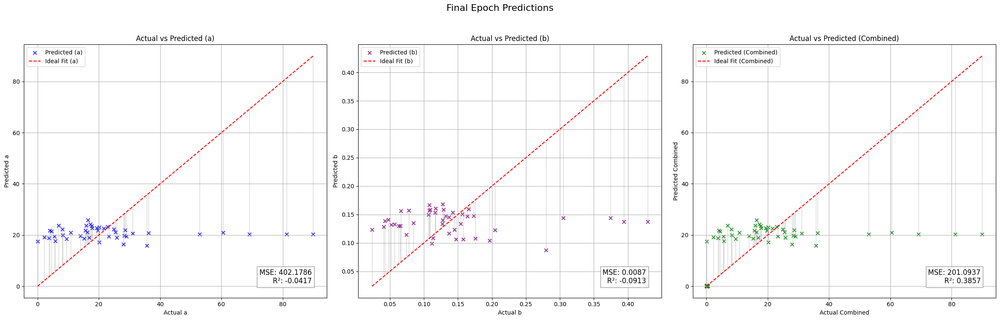

Validation Metrics:
  - MSE: 188.3230
  - R²: -0.0052
  - MAE: 6.4111
  - Explained Variance Score (EVS): 0.0045
Fold 1 Metrics:
  - Validation Loss (MSE): 188.3230
  - R²: -0.0052
  - MAE: 6.4111
  - EVS: 0.0045
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=1.23]


Validation Metrics:
  - MSE: 95.3067
  - R²: -0.2164
  - MAE: 5.9035
  - Explained Variance Score (EVS): -0.0078
Epoch [1/50], Train Loss: 1.2439, Val Loss: 95.3067
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.22it/s, loss=1.22]


Validation Metrics:
  - MSE: 95.5521
  - R²: -0.2380
  - MAE: 5.9106
  - Explained Variance Score (EVS): -0.0144
Epoch [2/50], Train Loss: 1.2117, Val Loss: 95.5521
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=1.16]


Validation Metrics:
  - MSE: 97.4745
  - R²: -0.2588
  - MAE: 5.9790
  - Explained Variance Score (EVS): -0.0263
Epoch [3/50], Train Loss: 1.2025, Val Loss: 97.4745
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.99it/s, loss=1.19]


Validation Metrics:
  - MSE: 98.4211
  - R²: -0.2747
  - MAE: 5.9940
  - Explained Variance Score (EVS): -0.0395
Epoch [4/50], Train Loss: 1.1990, Val Loss: 98.4211
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.01it/s, loss=1.23]


Validation Metrics:
  - MSE: 100.4345
  - R²: -0.2984
  - MAE: 6.0575
  - Explained Variance Score (EVS): -0.0567
Epoch [5/50], Train Loss: 1.2028, Val Loss: 100.4345
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.81it/s, loss=1.26]


Validation Metrics:
  - MSE: 101.7876
  - R²: -0.3148
  - MAE: 6.1011
  - Explained Variance Score (EVS): -0.0684
Epoch [6/50], Train Loss: 1.2031, Val Loss: 101.7876
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.93it/s, loss=1.27]


Validation Metrics:
  - MSE: 103.1239
  - R²: -0.3349
  - MAE: 6.1395
  - Explained Variance Score (EVS): -0.0859
Epoch [7/50], Train Loss: 1.2013, Val Loss: 103.1239
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.78it/s, loss=1.21]


Validation Metrics:
  - MSE: 102.5050
  - R²: -0.3379
  - MAE: 6.0957
  - Explained Variance Score (EVS): -0.0963
Epoch [8/50], Train Loss: 1.1957, Val Loss: 102.5050
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=1.18]


Validation Metrics:
  - MSE: 103.5526
  - R²: -0.3439
  - MAE: 6.1237
  - Explained Variance Score (EVS): -0.1059
Epoch [9/50], Train Loss: 1.1658, Val Loss: 103.5526
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s, loss=1.1]


Validation Metrics:
  - MSE: 104.7259
  - R²: -0.3466
  - MAE: 6.1561
  - Explained Variance Score (EVS): -0.1194
Epoch [10/50], Train Loss: 1.1640, Val Loss: 104.7259
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=1.19]


Validation Metrics:
  - MSE: 104.2512
  - R²: -0.3566
  - MAE: 6.1331
  - Explained Variance Score (EVS): -0.1273
Epoch [11/50], Train Loss: 1.1637, Val Loss: 104.2512
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


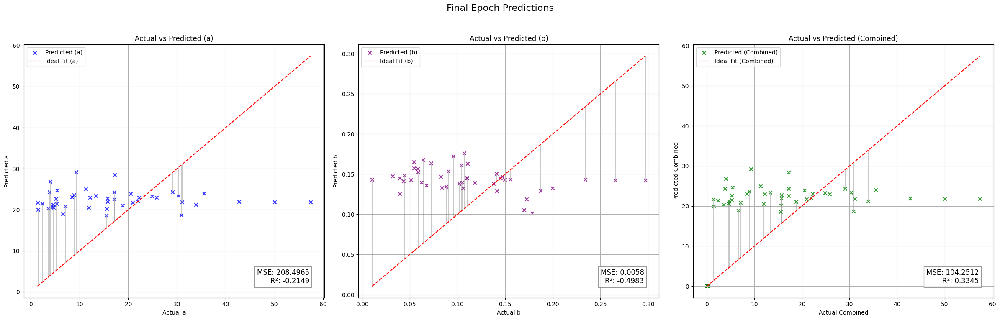

Validation Metrics:
  - MSE: 95.3067
  - R²: -0.2164
  - MAE: 5.9035
  - Explained Variance Score (EVS): -0.0078
Fold 2 Metrics:
  - Validation Loss (MSE): 95.3067
  - R²: -0.2164
  - MAE: 5.9035
  - EVS: -0.0078
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.45it/s, loss=1.13]


Validation Metrics:
  - MSE: 105.9392
  - R²: 0.0138
  - MAE: 5.4389
  - Explained Variance Score (EVS): 0.0145
Epoch [1/50], Train Loss: 1.1782, Val Loss: 105.9392
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.80it/s, loss=1.18]


Validation Metrics:
  - MSE: 106.8730
  - R²: 0.0060
  - MAE: 5.4638
  - Explained Variance Score (EVS): 0.0074
Epoch [2/50], Train Loss: 1.2258, Val Loss: 106.8730
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=1.16]


Validation Metrics:
  - MSE: 107.2329
  - R²: 0.0019
  - MAE: 5.4719
  - Explained Variance Score (EVS): 0.0031
Epoch [3/50], Train Loss: 1.2253, Val Loss: 107.2329
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.84it/s, loss=1.22]


Validation Metrics:
  - MSE: 108.4303
  - R²: -0.0076
  - MAE: 5.4964
  - Explained Variance Score (EVS): -0.0061
Epoch [4/50], Train Loss: 1.2080, Val Loss: 108.4303
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=1.17]


Validation Metrics:
  - MSE: 109.5123
  - R²: -0.0188
  - MAE: 5.5646
  - Explained Variance Score (EVS): -0.0178
Epoch [5/50], Train Loss: 1.2222, Val Loss: 109.5123
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=1.26]


Validation Metrics:
  - MSE: 110.9620
  - R²: -0.0281
  - MAE: 5.6073
  - Explained Variance Score (EVS): -0.0278
Epoch [6/50], Train Loss: 1.1587, Val Loss: 110.9620
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=1.2]


Validation Metrics:
  - MSE: 111.4842
  - R²: -0.0354
  - MAE: 5.6024
  - Explained Variance Score (EVS): -0.0352
Epoch [7/50], Train Loss: 1.2066, Val Loss: 111.4842
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=1.18]


Validation Metrics:
  - MSE: 112.2916
  - R²: -0.0435
  - MAE: 5.6570
  - Explained Variance Score (EVS): -0.0434
Epoch [8/50], Train Loss: 1.1658, Val Loss: 112.2916
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.34it/s, loss=1.09]


Validation Metrics:
  - MSE: 112.6766
  - R²: -0.0511
  - MAE: 5.6667
  - Explained Variance Score (EVS): -0.0508
Epoch [9/50], Train Loss: 1.1708, Val Loss: 112.6766
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.15it/s, loss=1.28]


Validation Metrics:
  - MSE: 113.2170
  - R²: -0.0545
  - MAE: 5.6655
  - Explained Variance Score (EVS): -0.0537
Epoch [10/50], Train Loss: 1.1991, Val Loss: 113.2170
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.87it/s, loss=1.2]


Validation Metrics:
  - MSE: 113.6893
  - R²: -0.0590
  - MAE: 5.6785
  - Explained Variance Score (EVS): -0.0581
Epoch [11/50], Train Loss: 1.1738, Val Loss: 113.6893
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


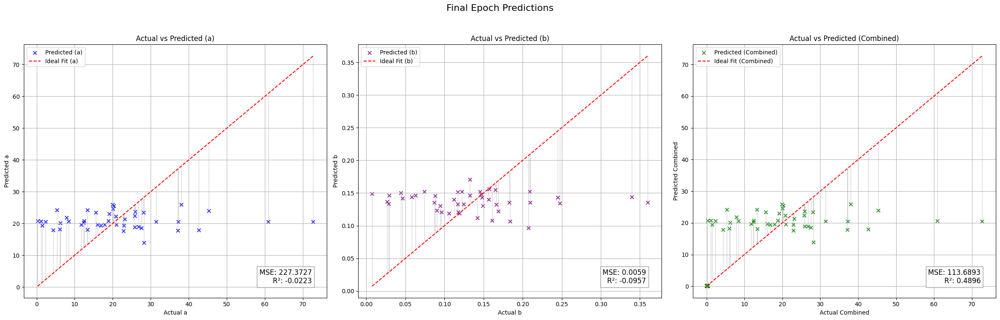

Validation Metrics:
  - MSE: 105.9392
  - R²: 0.0138
  - MAE: 5.4389
  - Explained Variance Score (EVS): 0.0145
Fold 3 Metrics:
  - Validation Loss (MSE): 105.9392
  - R²: 0.0138
  - MAE: 5.4389
  - EVS: 0.0145
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.07it/s, loss=1.21]


Validation Metrics:
  - MSE: 88.7972
  - R²: 0.0143
  - MAE: 5.8113
  - Explained Variance Score (EVS): 0.0159
Epoch [1/50], Train Loss: 1.2245, Val Loss: 88.7972
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.40it/s, loss=1.19]


Validation Metrics:
  - MSE: 88.2731
  - R²: 0.0155
  - MAE: 5.7622
  - Explained Variance Score (EVS): 0.0161
Epoch [2/50], Train Loss: 1.2348, Val Loss: 88.2731
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.23it/s, loss=1.25]


Validation Metrics:
  - MSE: 88.4329
  - R²: 0.0133
  - MAE: 5.7813
  - Explained Variance Score (EVS): 0.0149
Epoch [3/50], Train Loss: 1.2203, Val Loss: 88.4329
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.03it/s, loss=1.28]


Validation Metrics:
  - MSE: 88.5915
  - R²: 0.0101
  - MAE: 5.7914
  - Explained Variance Score (EVS): 0.0121
Epoch [4/50], Train Loss: 1.2353, Val Loss: 88.5915
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.94it/s, loss=1.16]


Validation Metrics:
  - MSE: 89.1649
  - R²: 0.0046
  - MAE: 5.8108
  - Explained Variance Score (EVS): 0.0071
Epoch [5/50], Train Loss: 1.1786, Val Loss: 89.1649
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  8.83it/s, loss=1.16]


Validation Metrics:
  - MSE: 89.6395
  - R²: -0.0004
  - MAE: 5.8203
  - Explained Variance Score (EVS): 0.0018
Epoch [6/50], Train Loss: 1.2271, Val Loss: 89.6395
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.79it/s, loss=1.22]


Validation Metrics:
  - MSE: 89.5024
  - R²: -0.0026
  - MAE: 5.7869
  - Explained Variance Score (EVS): -0.0018
Epoch [7/50], Train Loss: 1.1965, Val Loss: 89.5024
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  8.20it/s, loss=1.2]


Validation Metrics:
  - MSE: 90.0667
  - R²: -0.0073
  - MAE: 5.8224
  - Explained Variance Score (EVS): -0.0054
Epoch [8/50], Train Loss: 1.2128, Val Loss: 90.0667
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=1.26]


Validation Metrics:
  - MSE: 89.6572
  - R²: -0.0074
  - MAE: 5.7932
  - Explained Variance Score (EVS): -0.0063
Epoch [9/50], Train Loss: 1.1771, Val Loss: 89.6572
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.67it/s, loss=1.29]


Validation Metrics:
  - MSE: 89.8533
  - R²: -0.0105
  - MAE: 5.7856
  - Explained Variance Score (EVS): -0.0100
Epoch [10/50], Train Loss: 1.1990, Val Loss: 89.8533
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=1.17]


Validation Metrics:
  - MSE: 89.5288
  - R²: -0.0104
  - MAE: 5.7867
  - Explained Variance Score (EVS): -0.0096
Epoch [11/50], Train Loss: 1.1641, Val Loss: 89.5288
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=1.18]


Validation Metrics:
  - MSE: 89.9414
  - R²: -0.0135
  - MAE: 5.8039
  - Explained Variance Score (EVS): -0.0123
Epoch [12/50], Train Loss: 1.2059, Val Loss: 89.9414
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


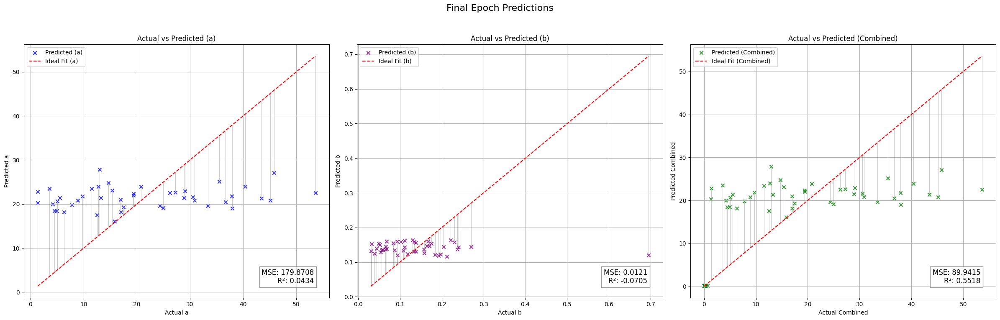

Validation Metrics:
  - MSE: 88.2731
  - R²: 0.0155
  - MAE: 5.7622
  - Explained Variance Score (EVS): 0.0161
Fold 4 Metrics:
  - Validation Loss (MSE): 88.2731
  - R²: 0.0155
  - MAE: 5.7622
  - EVS: 0.0161
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=1.19]


Validation Metrics:
  - MSE: 182.1255
  - R²: -0.0273
  - MAE: 6.8401
  - Explained Variance Score (EVS): -0.0230
Epoch [1/50], Train Loss: 1.2057, Val Loss: 182.1255
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=1.19]


Validation Metrics:
  - MSE: 183.8512
  - R²: -0.0331
  - MAE: 6.8714
  - Explained Variance Score (EVS): -0.0283
Epoch [2/50], Train Loss: 1.1955, Val Loss: 183.8512
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.43it/s, loss=1.24]


Validation Metrics:
  - MSE: 185.2349
  - R²: -0.0375
  - MAE: 6.9063
  - Explained Variance Score (EVS): -0.0328
Epoch [3/50], Train Loss: 1.2341, Val Loss: 185.2349
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  8.05it/s, loss=1.24]


Validation Metrics:
  - MSE: 185.3988
  - R²: -0.0395
  - MAE: 6.9096
  - Explained Variance Score (EVS): -0.0348
Epoch [4/50], Train Loss: 1.2218, Val Loss: 185.3988
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.28it/s, loss=1.21]


Validation Metrics:
  - MSE: 186.4559
  - R²: -0.0450
  - MAE: 6.9378
  - Explained Variance Score (EVS): -0.0403
Epoch [5/50], Train Loss: 1.2301, Val Loss: 186.4559
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=1.13]


Validation Metrics:
  - MSE: 187.0364
  - R²: -0.0485
  - MAE: 6.9302
  - Explained Variance Score (EVS): -0.0425
Epoch [6/50], Train Loss: 1.1919, Val Loss: 187.0364
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=1.15]


Validation Metrics:
  - MSE: 188.3883
  - R²: -0.0543
  - MAE: 6.9378
  - Explained Variance Score (EVS): -0.0473
Epoch [7/50], Train Loss: 1.1782, Val Loss: 188.3883
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s, loss=1.1]


Validation Metrics:
  - MSE: 188.5091
  - R²: -0.0574
  - MAE: 6.9481
  - Explained Variance Score (EVS): -0.0507
Epoch [8/50], Train Loss: 1.1572, Val Loss: 188.5091
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.88it/s, loss=1.23]


Validation Metrics:
  - MSE: 189.7733
  - R²: -0.0639
  - MAE: 6.9768
  - Explained Variance Score (EVS): -0.0569
Epoch [9/50], Train Loss: 1.1757, Val Loss: 189.7733
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.43it/s, loss=1.26]


Validation Metrics:
  - MSE: 189.5617
  - R²: -0.0667
  - MAE: 6.9936
  - Explained Variance Score (EVS): -0.0607
Epoch [10/50], Train Loss: 1.2034, Val Loss: 189.5617
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=1.24]


Validation Metrics:
  - MSE: 189.6520
  - R²: -0.0706
  - MAE: 6.9984
  - Explained Variance Score (EVS): -0.0641
Epoch [11/50], Train Loss: 1.2309, Val Loss: 189.6520
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


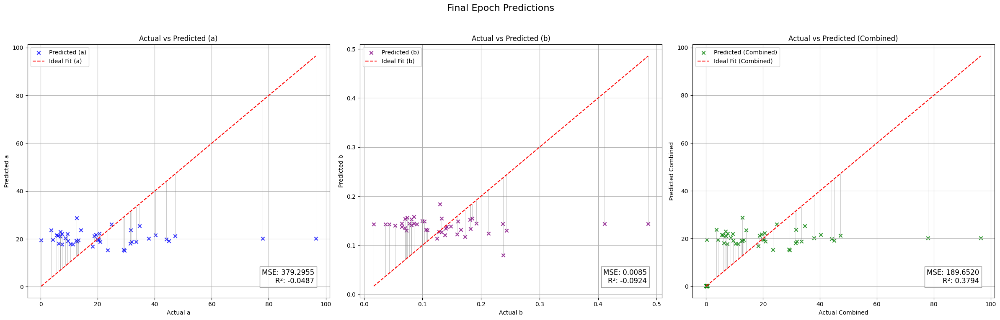

[I 2024-12-01 17:04:40,754] Trial 9 finished with value: 131.99351501464844 and parameters: {'num_layers': 3, 'hidden_size_0': 157, 'activation_0': 'ReLU', 'dropout_0': 0.191239856903244, 'hidden_size_1': 191, 'activation_1': 'LeakyReLU', 'dropout_1': 0.3920527083197338, 'hidden_size_2': 317, 'activation_2': 'ELU', 'dropout_2': 0.10889333763110792, 'batch_size': 64, 'learning_rate': 0.0008756407752440623, 'optimizer': 'SGD'}. Best is trial 0 with value: 131.73135375976562.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.1255
  - R²: -0.0273
  - MAE: 6.8401
  - Explained Variance Score (EVS): -0.0230
Fold 5 Metrics:
  - Validation Loss (MSE): 182.1255
  - R²: -0.0273
  - MAE: 6.8401
  - EVS: -0.0230
Avg Validation Metrics:
  - MSE: 131.9935
  - R²: -0.0439
  - MAE: 6.0712
  - EVS: 0.0009
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=0.995]


Validation Metrics:
  - MSE: 189.1932
  - R²: 0.0200
  - MAE: 6.3864
  - Explained Variance Score (EVS): 0.0326
Epoch [1/50], Train Loss: 1.1778, Val Loss: 189.1932
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.64it/s, loss=0.997]


Validation Metrics:
  - MSE: 184.0317
  - R²: 0.0469
  - MAE: 6.2854
  - Explained Variance Score (EVS): 0.0565
Epoch [2/50], Train Loss: 1.0067, Val Loss: 184.0317
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.966]


Validation Metrics:
  - MSE: 182.5415
  - R²: 0.0581
  - MAE: 6.2635
  - Explained Variance Score (EVS): 0.0679
Epoch [3/50], Train Loss: 0.9689, Val Loss: 182.5415
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.34it/s, loss=1.04]


Validation Metrics:
  - MSE: 181.0733
  - R²: 0.0589
  - MAE: 6.2484
  - Explained Variance Score (EVS): 0.0710
Epoch [4/50], Train Loss: 0.9458, Val Loss: 181.0733
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.75it/s, loss=0.924]


Validation Metrics:
  - MSE: 178.4830
  - R²: 0.0682
  - MAE: 6.1989
  - Explained Variance Score (EVS): 0.0812
Epoch [5/50], Train Loss: 0.9072, Val Loss: 178.4830
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.836]


Validation Metrics:
  - MSE: 176.7205
  - R²: 0.0806
  - MAE: 6.1250
  - Explained Variance Score (EVS): 0.0934
Epoch [6/50], Train Loss: 0.8702, Val Loss: 176.7205
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.03it/s, loss=0.854]


Validation Metrics:
  - MSE: 173.3425
  - R²: 0.1106
  - MAE: 6.0034
  - Explained Variance Score (EVS): 0.1221
Epoch [7/50], Train Loss: 0.8624, Val Loss: 173.3425
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.848]


Validation Metrics:
  - MSE: 169.5312
  - R²: 0.1297
  - MAE: 5.8700
  - Explained Variance Score (EVS): 0.1431
Epoch [8/50], Train Loss: 0.8372, Val Loss: 169.5312
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.87]


Validation Metrics:
  - MSE: 161.9248
  - R²: 0.1555
  - MAE: 5.7295
  - Explained Variance Score (EVS): 0.1696
Epoch [9/50], Train Loss: 0.8230, Val Loss: 161.9248
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.801]


Validation Metrics:
  - MSE: 154.6884
  - R²: 0.1940
  - MAE: 5.6162
  - Explained Variance Score (EVS): 0.2070
Epoch [10/50], Train Loss: 0.7818, Val Loss: 154.6884
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.81it/s, loss=0.797]


Validation Metrics:
  - MSE: 150.1483
  - R²: 0.2226
  - MAE: 5.5234
  - Explained Variance Score (EVS): 0.2342
Epoch [11/50], Train Loss: 0.7651, Val Loss: 150.1483
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  8.43it/s, loss=0.687]


Validation Metrics:
  - MSE: 145.6960
  - R²: 0.2540
  - MAE: 5.4052
  - Explained Variance Score (EVS): 0.2643
Epoch [12/50], Train Loss: 0.7522, Val Loss: 145.6960
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.85it/s, loss=0.776]


Validation Metrics:
  - MSE: 136.7626
  - R²: 0.2939
  - MAE: 5.2084
  - Explained Variance Score (EVS): 0.3030
Epoch [13/50], Train Loss: 0.7419, Val Loss: 136.7626
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.703]


Validation Metrics:
  - MSE: 127.3370
  - R²: 0.3334
  - MAE: 5.0083
  - Explained Variance Score (EVS): 0.3450
Epoch [14/50], Train Loss: 0.7071, Val Loss: 127.3370
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.62it/s, loss=0.723]


Validation Metrics:
  - MSE: 120.9627
  - R²: 0.3871
  - MAE: 4.8072
  - Explained Variance Score (EVS): 0.4020
Epoch [15/50], Train Loss: 0.6887, Val Loss: 120.9627
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s, loss=0.674]


Validation Metrics:
  - MSE: 116.6062
  - R²: 0.4408
  - MAE: 4.6553
  - Explained Variance Score (EVS): 0.4550
Epoch [16/50], Train Loss: 0.6674, Val Loss: 116.6062
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.58it/s, loss=0.705]


Validation Metrics:
  - MSE: 106.1188
  - R²: 0.4896
  - MAE: 4.4617
  - Explained Variance Score (EVS): 0.4978
Epoch [17/50], Train Loss: 0.6558, Val Loss: 106.1188
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  8.71it/s, loss=0.644]


Validation Metrics:
  - MSE: 96.9215
  - R²: 0.5163
  - MAE: 4.1874
  - Explained Variance Score (EVS): 0.5229
Epoch [18/50], Train Loss: 0.6188, Val Loss: 96.9215
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=0.589]


Validation Metrics:
  - MSE: 86.4023
  - R²: 0.5489
  - MAE: 4.0834
  - Explained Variance Score (EVS): 0.5546
Epoch [19/50], Train Loss: 0.5942, Val Loss: 86.4023
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.63]


Validation Metrics:
  - MSE: 85.3278
  - R²: 0.5608
  - MAE: 3.9878
  - Explained Variance Score (EVS): 0.5669
Epoch [20/50], Train Loss: 0.5854, Val Loss: 85.3278
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.96it/s, loss=0.565]


Validation Metrics:
  - MSE: 83.8791
  - R²: 0.5964
  - MAE: 3.8704
  - Explained Variance Score (EVS): 0.6003
Epoch [21/50], Train Loss: 0.5493, Val Loss: 83.8791
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  8.01it/s, loss=0.566]


Validation Metrics:
  - MSE: 83.3520
  - R²: 0.6171
  - MAE: 3.7871
  - Explained Variance Score (EVS): 0.6236
Epoch [22/50], Train Loss: 0.5393, Val Loss: 83.3520
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  7.69it/s, loss=0.536]


Validation Metrics:
  - MSE: 75.6771
  - R²: 0.6544
  - MAE: 3.7218
  - Explained Variance Score (EVS): 0.6597
Epoch [23/50], Train Loss: 0.5188, Val Loss: 75.6771
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=0.452]


Validation Metrics:
  - MSE: 68.4466
  - R²: 0.6747
  - MAE: 3.7369
  - Explained Variance Score (EVS): 0.6780
Epoch [24/50], Train Loss: 0.4799, Val Loss: 68.4466
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.444]


Validation Metrics:
  - MSE: 57.9950
  - R²: 0.7114
  - MAE: 3.5912
  - Explained Variance Score (EVS): 0.7140
Epoch [25/50], Train Loss: 0.4580, Val Loss: 57.9950
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s, loss=0.476]


Validation Metrics:
  - MSE: 59.5002
  - R²: 0.6887
  - MAE: 3.5331
  - Explained Variance Score (EVS): 0.6928
Epoch [26/50], Train Loss: 0.4441, Val Loss: 59.5002
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.462]


Validation Metrics:
  - MSE: 63.7647
  - R²: 0.6746
  - MAE: 3.4342
  - Explained Variance Score (EVS): 0.6810
Epoch [27/50], Train Loss: 0.4265, Val Loss: 63.7647
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  7.00it/s, loss=0.387]


Validation Metrics:
  - MSE: 71.1932
  - R²: 0.6529
  - MAE: 3.4819
  - Explained Variance Score (EVS): 0.6675
Epoch [28/50], Train Loss: 0.4089, Val Loss: 71.1932
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=0.397]


Validation Metrics:
  - MSE: 69.5342
  - R²: 0.6607
  - MAE: 3.4478
  - Explained Variance Score (EVS): 0.6718
Epoch [29/50], Train Loss: 0.3838, Val Loss: 69.5342
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.35]


Validation Metrics:
  - MSE: 59.5296
  - R²: 0.6954
  - MAE: 3.4659
  - Explained Variance Score (EVS): 0.6963
Epoch [30/50], Train Loss: 0.3745, Val Loss: 59.5296
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.339]


Validation Metrics:
  - MSE: 57.9493
  - R²: 0.6968
  - MAE: 3.6358
  - Explained Variance Score (EVS): 0.6975
Epoch [31/50], Train Loss: 0.3453, Val Loss: 57.9493
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=0.35]


Validation Metrics:
  - MSE: 57.2934
  - R²: 0.6895
  - MAE: 3.5184
  - Explained Variance Score (EVS): 0.6930
Epoch [32/50], Train Loss: 0.3334, Val Loss: 57.2934
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  7.38it/s, loss=0.302]


Validation Metrics:
  - MSE: 63.3008
  - R²: 0.6640
  - MAE: 3.3632
  - Explained Variance Score (EVS): 0.6737
Epoch [33/50], Train Loss: 0.3113, Val Loss: 63.3008
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  7.79it/s, loss=0.267]


Validation Metrics:
  - MSE: 65.6000
  - R²: 0.6670
  - MAE: 3.3728
  - Explained Variance Score (EVS): 0.6790
Epoch [34/50], Train Loss: 0.2977, Val Loss: 65.6000
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  8.12it/s, loss=0.29]


Validation Metrics:
  - MSE: 70.1512
  - R²: 0.6541
  - MAE: 3.4774
  - Explained Variance Score (EVS): 0.6643
Epoch [35/50], Train Loss: 0.2852, Val Loss: 70.1512
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  7.88it/s, loss=0.244]


Validation Metrics:
  - MSE: 72.3354
  - R²: 0.6486
  - MAE: 3.6219
  - Explained Variance Score (EVS): 0.6515
Epoch [36/50], Train Loss: 0.2613, Val Loss: 72.3354
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  7.66it/s, loss=0.238]


Validation Metrics:
  - MSE: 64.0686
  - R²: 0.6826
  - MAE: 3.7143
  - Explained Variance Score (EVS): 0.6833
Epoch [37/50], Train Loss: 0.2499, Val Loss: 64.0686
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  7.87it/s, loss=0.234]


Validation Metrics:
  - MSE: 57.4413
  - R²: 0.6917
  - MAE: 3.6097
  - Explained Variance Score (EVS): 0.6918
Epoch [38/50], Train Loss: 0.2411, Val Loss: 57.4413
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  7.91it/s, loss=0.199]


Validation Metrics:
  - MSE: 57.5684
  - R²: 0.6801
  - MAE: 3.4485
  - Explained Variance Score (EVS): 0.6862
Epoch [39/50], Train Loss: 0.2268, Val Loss: 57.5684
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  7.32it/s, loss=0.245]


Validation Metrics:
  - MSE: 67.8702
  - R²: 0.6243
  - MAE: 3.4343
  - Explained Variance Score (EVS): 0.6522
Epoch [40/50], Train Loss: 0.2259, Val Loss: 67.8702
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  7.78it/s, loss=0.176]


Validation Metrics:
  - MSE: 73.3519
  - R²: 0.6171
  - MAE: 3.5005
  - Explained Variance Score (EVS): 0.6404
Epoch [41/50], Train Loss: 0.2002, Val Loss: 73.3519
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  7.31it/s, loss=0.196]


Validation Metrics:
  - MSE: 76.4159
  - R²: 0.6216
  - MAE: 3.5797
  - Explained Variance Score (EVS): 0.6338
Epoch [42/50], Train Loss: 0.1954, Val Loss: 76.4159
Current Dropout Rate: 0.1720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


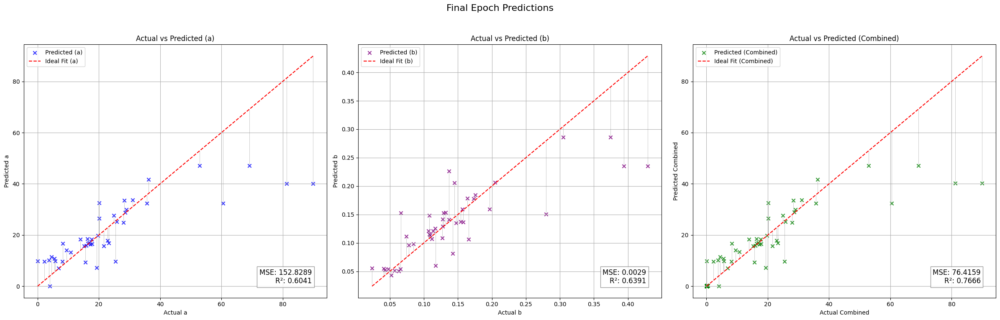

Validation Metrics:
  - MSE: 57.2934
  - R²: 0.6895
  - MAE: 3.5184
  - Explained Variance Score (EVS): 0.6930
Fold 1 Metrics:
  - Validation Loss (MSE): 57.2934
  - R²: 0.6895
  - MAE: 3.5184
  - EVS: 0.6930
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.91it/s, loss=0.34]


Validation Metrics:
  - MSE: 4.4206
  - R²: 0.9526
  - MAE: 1.1850
  - Explained Variance Score (EVS): 0.9684
Epoch [1/50], Train Loss: 0.3573, Val Loss: 4.4206
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.75it/s, loss=0.338]


Validation Metrics:
  - MSE: 2.7260
  - R²: 0.9562
  - MAE: 0.8685
  - Explained Variance Score (EVS): 0.9622
Epoch [2/50], Train Loss: 0.3462, Val Loss: 2.7260
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s, loss=0.33]


Validation Metrics:
  - MSE: 2.4236
  - R²: 0.9556
  - MAE: 0.8494
  - Explained Variance Score (EVS): 0.9588
Epoch [3/50], Train Loss: 0.3409, Val Loss: 2.4236
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=0.298]


Validation Metrics:
  - MSE: 3.7551
  - R²: 0.9472
  - MAE: 1.0006
  - Explained Variance Score (EVS): 0.9503
Epoch [4/50], Train Loss: 0.3288, Val Loss: 3.7551
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.55it/s, loss=0.299]


Validation Metrics:
  - MSE: 4.5249
  - R²: 0.9365
  - MAE: 1.1408
  - Explained Variance Score (EVS): 0.9379
Epoch [5/50], Train Loss: 0.3045, Val Loss: 4.5249
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.306]


Validation Metrics:
  - MSE: 5.5235
  - R²: 0.9227
  - MAE: 1.3076
  - Explained Variance Score (EVS): 0.9258
Epoch [6/50], Train Loss: 0.2977, Val Loss: 5.5235
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.40it/s, loss=0.315]


Validation Metrics:
  - MSE: 5.7009
  - R²: 0.9224
  - MAE: 1.2633
  - Explained Variance Score (EVS): 0.9249
Epoch [7/50], Train Loss: 0.2880, Val Loss: 5.7009
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=0.276]


Validation Metrics:
  - MSE: 4.4209
  - R²: 0.9336
  - MAE: 1.1297
  - Explained Variance Score (EVS): 0.9400
Epoch [8/50], Train Loss: 0.2774, Val Loss: 4.4209
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.36it/s, loss=0.253]


Validation Metrics:
  - MSE: 4.2335
  - R²: 0.9254
  - MAE: 1.1670
  - Explained Variance Score (EVS): 0.9430
Epoch [9/50], Train Loss: 0.2622, Val Loss: 4.2335
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.249]


Validation Metrics:
  - MSE: 4.9723
  - R²: 0.9135
  - MAE: 1.3146
  - Explained Variance Score (EVS): 0.9312
Epoch [10/50], Train Loss: 0.2593, Val Loss: 4.9723
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.20it/s, loss=0.225]


Validation Metrics:
  - MSE: 4.7438
  - R²: 0.9081
  - MAE: 1.2111
  - Explained Variance Score (EVS): 0.9135
Epoch [11/50], Train Loss: 0.2323, Val Loss: 4.7438
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.70it/s, loss=0.214]


Validation Metrics:
  - MSE: 5.0871
  - R²: 0.9047
  - MAE: 1.2227
  - Explained Variance Score (EVS): 0.9081
Epoch [12/50], Train Loss: 0.2411, Val Loss: 5.0871
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.41it/s, loss=0.212]


Validation Metrics:
  - MSE: 5.2725
  - R²: 0.9119
  - MAE: 1.1933
  - Explained Variance Score (EVS): 0.9121
Epoch [13/50], Train Loss: 0.2203, Val Loss: 5.2725
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


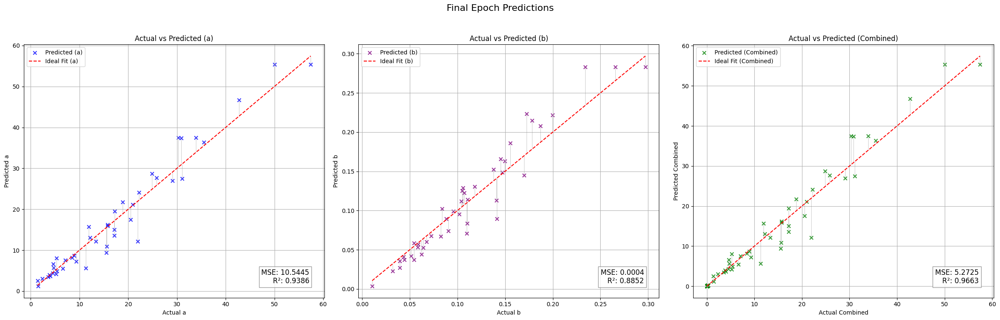

Validation Metrics:
  - MSE: 2.4236
  - R²: 0.9556
  - MAE: 0.8494
  - Explained Variance Score (EVS): 0.9588
Fold 2 Metrics:
  - Validation Loss (MSE): 2.4236
  - R²: 0.9556
  - MAE: 0.8494
  - EVS: 0.9588
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.40it/s, loss=0.279]


Validation Metrics:
  - MSE: 14.9556
  - R²: 0.8731
  - MAE: 1.5465
  - Explained Variance Score (EVS): 0.8745
Epoch [1/50], Train Loss: 0.3082, Val Loss: 14.9556
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=0.328]


Validation Metrics:
  - MSE: 15.2657
  - R²: 0.8681
  - MAE: 1.5537
  - Explained Variance Score (EVS): 0.8696
Epoch [2/50], Train Loss: 0.3157, Val Loss: 15.2657
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.46it/s, loss=0.336]


Validation Metrics:
  - MSE: 15.4241
  - R²: 0.8636
  - MAE: 1.5742
  - Explained Variance Score (EVS): 0.8652
Epoch [3/50], Train Loss: 0.3059, Val Loss: 15.4241
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.43it/s, loss=0.308]


Validation Metrics:
  - MSE: 15.6370
  - R²: 0.8570
  - MAE: 1.5321
  - Explained Variance Score (EVS): 0.8585
Epoch [4/50], Train Loss: 0.3016, Val Loss: 15.6370
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.69it/s, loss=0.316]


Validation Metrics:
  - MSE: 15.5372
  - R²: 0.8532
  - MAE: 1.4616
  - Explained Variance Score (EVS): 0.8561
Epoch [5/50], Train Loss: 0.2894, Val Loss: 15.5372
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.30it/s, loss=0.278]


Validation Metrics:
  - MSE: 15.9458
  - R²: 0.8476
  - MAE: 1.4755
  - Explained Variance Score (EVS): 0.8526
Epoch [6/50], Train Loss: 0.2901, Val Loss: 15.9458
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.34it/s, loss=0.248]


Validation Metrics:
  - MSE: 16.2538
  - R²: 0.8503
  - MAE: 1.5353
  - Explained Variance Score (EVS): 0.8547
Epoch [7/50], Train Loss: 0.2647, Val Loss: 16.2538
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=0.25]


Validation Metrics:
  - MSE: 16.5394
  - R²: 0.8500
  - MAE: 1.5553
  - Explained Variance Score (EVS): 0.8551
Epoch [8/50], Train Loss: 0.2707, Val Loss: 16.5394
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.63it/s, loss=0.302]


Validation Metrics:
  - MSE: 16.0679
  - R²: 0.8559
  - MAE: 1.4745
  - Explained Variance Score (EVS): 0.8579
Epoch [9/50], Train Loss: 0.2794, Val Loss: 16.0679
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.98it/s, loss=0.244]


Validation Metrics:
  - MSE: 15.9413
  - R²: 0.8579
  - MAE: 1.4547
  - Explained Variance Score (EVS): 0.8603
Epoch [10/50], Train Loss: 0.2562, Val Loss: 15.9413
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.16it/s, loss=0.274]


Validation Metrics:
  - MSE: 15.6865
  - R²: 0.8599
  - MAE: 1.4195
  - Explained Variance Score (EVS): 0.8622
Epoch [11/50], Train Loss: 0.2466, Val Loss: 15.6865
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


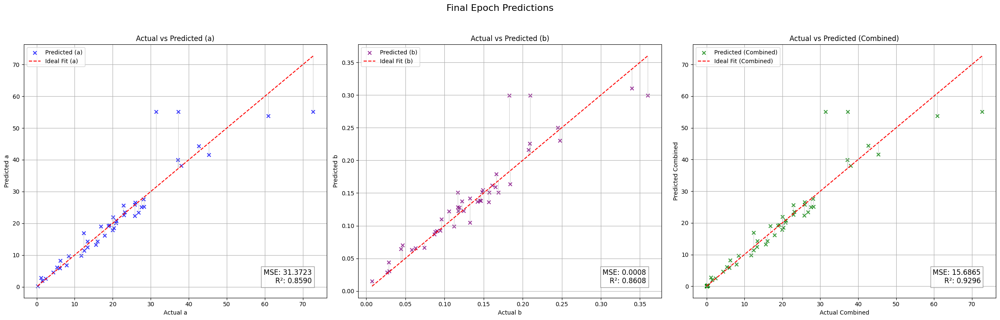

Validation Metrics:
  - MSE: 14.9556
  - R²: 0.8731
  - MAE: 1.5465
  - Explained Variance Score (EVS): 0.8745
Fold 3 Metrics:
  - Validation Loss (MSE): 14.9556
  - R²: 0.8731
  - MAE: 1.5465
  - EVS: 0.8745
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.29it/s, loss=0.294]


Validation Metrics:
  - MSE: 10.8772
  - R²: 0.8953
  - MAE: 1.1812
  - Explained Variance Score (EVS): 0.8961
Epoch [1/50], Train Loss: 0.3202, Val Loss: 10.8772
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.33]


Validation Metrics:
  - MSE: 11.6874
  - R²: 0.8897
  - MAE: 1.2098
  - Explained Variance Score (EVS): 0.8911
Epoch [2/50], Train Loss: 0.3160, Val Loss: 11.6874
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.96it/s, loss=0.31]


Validation Metrics:
  - MSE: 13.0656
  - R²: 0.8791
  - MAE: 1.2607
  - Explained Variance Score (EVS): 0.8825
Epoch [3/50], Train Loss: 0.3118, Val Loss: 13.0656
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=0.271]


Validation Metrics:
  - MSE: 14.5502
  - R²: 0.8676
  - MAE: 1.3399
  - Explained Variance Score (EVS): 0.8737
Epoch [4/50], Train Loss: 0.2953, Val Loss: 14.5502
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.23it/s, loss=0.33]


Validation Metrics:
  - MSE: 15.4769
  - R²: 0.8594
  - MAE: 1.3870
  - Explained Variance Score (EVS): 0.8663
Epoch [5/50], Train Loss: 0.3025, Val Loss: 15.4769
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.56it/s, loss=0.313]


Validation Metrics:
  - MSE: 16.9487
  - R²: 0.8489
  - MAE: 1.4445
  - Explained Variance Score (EVS): 0.8573
Epoch [6/50], Train Loss: 0.3013, Val Loss: 16.9487
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  8.34it/s, loss=0.28]


Validation Metrics:
  - MSE: 17.7426
  - R²: 0.8429
  - MAE: 1.4653
  - Explained Variance Score (EVS): 0.8516
Epoch [7/50], Train Loss: 0.2798, Val Loss: 17.7426
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.36it/s, loss=0.236]


Validation Metrics:
  - MSE: 18.8546
  - R²: 0.8361
  - MAE: 1.5118
  - Explained Variance Score (EVS): 0.8465
Epoch [8/50], Train Loss: 0.2683, Val Loss: 18.8546
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.28it/s, loss=0.26]


Validation Metrics:
  - MSE: 20.2529
  - R²: 0.8267
  - MAE: 1.5632
  - Explained Variance Score (EVS): 0.8386
Epoch [9/50], Train Loss: 0.2696, Val Loss: 20.2529
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  8.02it/s, loss=0.234]


Validation Metrics:
  - MSE: 20.4869
  - R²: 0.8244
  - MAE: 1.5619
  - Explained Variance Score (EVS): 0.8354
Epoch [10/50], Train Loss: 0.2625, Val Loss: 20.4869
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=0.276]


Validation Metrics:
  - MSE: 21.1305
  - R²: 0.8196
  - MAE: 1.5762
  - Explained Variance Score (EVS): 0.8299
Epoch [11/50], Train Loss: 0.2719, Val Loss: 21.1305
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


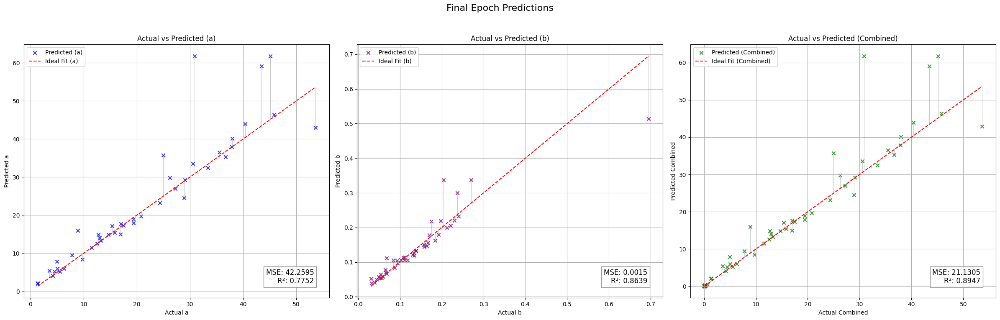

Validation Metrics:
  - MSE: 10.8772
  - R²: 0.8953
  - MAE: 1.1812
  - Explained Variance Score (EVS): 0.8961
Fold 4 Metrics:
  - Validation Loss (MSE): 10.8772
  - R²: 0.8953
  - MAE: 1.1812
  - EVS: 0.8961
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.28it/s, loss=0.343]


Validation Metrics:
  - MSE: 36.1578
  - R²: 0.8164
  - MAE: 1.8889
  - Explained Variance Score (EVS): 0.8270
Epoch [1/50], Train Loss: 0.3188, Val Loss: 36.1578
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=0.295]


Validation Metrics:
  - MSE: 35.2772
  - R²: 0.8203
  - MAE: 1.8437
  - Explained Variance Score (EVS): 0.8289
Epoch [2/50], Train Loss: 0.2973, Val Loss: 35.2772
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.286]


Validation Metrics:
  - MSE: 34.4574
  - R²: 0.8243
  - MAE: 1.7858
  - Explained Variance Score (EVS): 0.8311
Epoch [3/50], Train Loss: 0.3017, Val Loss: 34.4574
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=0.359]


Validation Metrics:
  - MSE: 34.2314
  - R²: 0.8250
  - MAE: 1.7388
  - Explained Variance Score (EVS): 0.8314
Epoch [4/50], Train Loss: 0.3109, Val Loss: 34.2314
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.71it/s, loss=0.303]


Validation Metrics:
  - MSE: 33.8536
  - R²: 0.8264
  - MAE: 1.6935
  - Explained Variance Score (EVS): 0.8322
Epoch [5/50], Train Loss: 0.2950, Val Loss: 33.8536
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.313]


Validation Metrics:
  - MSE: 33.2699
  - R²: 0.8296
  - MAE: 1.6599
  - Explained Variance Score (EVS): 0.8340
Epoch [6/50], Train Loss: 0.3114, Val Loss: 33.2699
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.263]


Validation Metrics:
  - MSE: 33.3523
  - R²: 0.8288
  - MAE: 1.6420
  - Explained Variance Score (EVS): 0.8337
Epoch [7/50], Train Loss: 0.2882, Val Loss: 33.3523
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.286]


Validation Metrics:
  - MSE: 32.9310
  - R²: 0.8295
  - MAE: 1.6137
  - Explained Variance Score (EVS): 0.8342
Epoch [8/50], Train Loss: 0.2854, Val Loss: 32.9310
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s, loss=0.278]


Validation Metrics:
  - MSE: 33.1720
  - R²: 0.8269
  - MAE: 1.6032
  - Explained Variance Score (EVS): 0.8324
Epoch [9/50], Train Loss: 0.2815, Val Loss: 33.1720
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s, loss=0.276]


Validation Metrics:
  - MSE: 33.2290
  - R²: 0.8267
  - MAE: 1.5979
  - Explained Variance Score (EVS): 0.8320
Epoch [10/50], Train Loss: 0.2671, Val Loss: 33.2290
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.71it/s, loss=0.356]


Validation Metrics:
  - MSE: 33.6269
  - R²: 0.8247
  - MAE: 1.6093
  - Explained Variance Score (EVS): 0.8314
Epoch [11/50], Train Loss: 0.2875, Val Loss: 33.6269
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  8.26it/s, loss=0.266]


Validation Metrics:
  - MSE: 33.3901
  - R²: 0.8261
  - MAE: 1.6022
  - Explained Variance Score (EVS): 0.8324
Epoch [12/50], Train Loss: 0.2814, Val Loss: 33.3901
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.37it/s, loss=0.276]


Validation Metrics:
  - MSE: 33.5111
  - R²: 0.8256
  - MAE: 1.6055
  - Explained Variance Score (EVS): 0.8317
Epoch [13/50], Train Loss: 0.2773, Val Loss: 33.5111
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.27it/s, loss=0.255]


Validation Metrics:
  - MSE: 33.6685
  - R²: 0.8248
  - MAE: 1.6138
  - Explained Variance Score (EVS): 0.8313
Epoch [14/50], Train Loss: 0.2655, Val Loss: 33.6685
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  8.08it/s, loss=0.267]


Validation Metrics:
  - MSE: 33.6641
  - R²: 0.8253
  - MAE: 1.6157
  - Explained Variance Score (EVS): 0.8318
Epoch [15/50], Train Loss: 0.2719, Val Loss: 33.6641
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.63it/s, loss=0.291]


Validation Metrics:
  - MSE: 33.5552
  - R²: 0.8260
  - MAE: 1.6125
  - Explained Variance Score (EVS): 0.8326
Epoch [16/50], Train Loss: 0.2668, Val Loss: 33.5552
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.78it/s, loss=0.251]


Validation Metrics:
  - MSE: 33.6247
  - R²: 0.8262
  - MAE: 1.6111
  - Explained Variance Score (EVS): 0.8325
Epoch [17/50], Train Loss: 0.2667, Val Loss: 33.6247
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  7.73it/s, loss=0.291]


Validation Metrics:
  - MSE: 33.9963
  - R²: 0.8250
  - MAE: 1.6193
  - Explained Variance Score (EVS): 0.8313
Epoch [18/50], Train Loss: 0.2648, Val Loss: 33.9963
Current Dropout Rate: 0.3640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


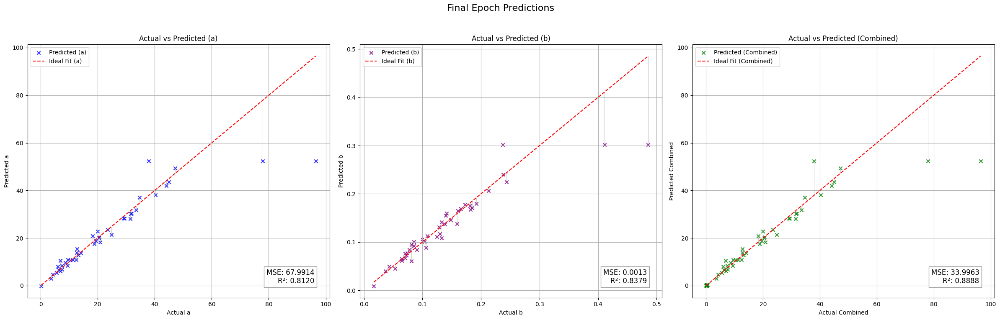

[I 2024-12-01 17:06:12,099] Trial 10 finished with value: 23.696170806884766 and parameters: {'num_layers': 1, 'hidden_size_0': 320, 'activation_0': 'ReLU', 'dropout_0': 0.4992298856983679, 'batch_size': 64, 'learning_rate': 2.111161310128802e-05, 'optimizer': 'AdamW'}. Best is trial 10 with value: 23.696170806884766.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.9310
  - R²: 0.8295
  - MAE: 1.6137
  - Explained Variance Score (EVS): 0.8342
Fold 5 Metrics:
  - Validation Loss (MSE): 32.9310
  - R²: 0.8295
  - MAE: 1.6137
  - EVS: 0.8342
Avg Validation Metrics:
  - MSE: 23.6962
  - R²: 0.8486
  - MAE: 1.7418
  - EVS: 0.8513
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.59it/s, loss=1.16]


Validation Metrics:
  - MSE: 188.9004
  - R²: 0.0274
  - MAE: 6.3745
  - Explained Variance Score (EVS): 0.0388
Epoch [1/50], Train Loss: 1.1389, Val Loss: 188.9004
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=1.05]


Validation Metrics:
  - MSE: 182.0605
  - R²: 0.0510
  - MAE: 6.2791
  - Explained Variance Score (EVS): 0.0608
Epoch [2/50], Train Loss: 1.0058, Val Loss: 182.0605
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.61it/s, loss=0.972]


Validation Metrics:
  - MSE: 180.6982
  - R²: 0.0563
  - MAE: 6.2343
  - Explained Variance Score (EVS): 0.0665
Epoch [3/50], Train Loss: 0.9453, Val Loss: 180.6982
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.00it/s, loss=0.871]


Validation Metrics:
  - MSE: 180.1133
  - R²: 0.0622
  - MAE: 6.2247
  - Explained Variance Score (EVS): 0.0732
Epoch [4/50], Train Loss: 0.9201, Val Loss: 180.1133
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.03it/s, loss=0.912]


Validation Metrics:
  - MSE: 181.9681
  - R²: 0.0643
  - MAE: 6.2194
  - Explained Variance Score (EVS): 0.0770
Epoch [5/50], Train Loss: 0.8731, Val Loss: 181.9681
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.907]


Validation Metrics:
  - MSE: 182.1425
  - R²: 0.0724
  - MAE: 6.1564
  - Explained Variance Score (EVS): 0.0868
Epoch [6/50], Train Loss: 0.8547, Val Loss: 182.1425
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.841]


Validation Metrics:
  - MSE: 176.5128
  - R²: 0.0962
  - MAE: 6.0341
  - Explained Variance Score (EVS): 0.1112
Epoch [7/50], Train Loss: 0.8306, Val Loss: 176.5128
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=0.832]


Validation Metrics:
  - MSE: 166.5329
  - R²: 0.1409
  - MAE: 5.8778
  - Explained Variance Score (EVS): 0.1537
Epoch [8/50], Train Loss: 0.7966, Val Loss: 166.5329
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.89it/s, loss=0.8]


Validation Metrics:
  - MSE: 160.5063
  - R²: 0.1769
  - MAE: 5.7789
  - Explained Variance Score (EVS): 0.1883
Epoch [9/50], Train Loss: 0.7895, Val Loss: 160.5063
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.80it/s, loss=0.806]


Validation Metrics:
  - MSE: 157.5089
  - R²: 0.2054
  - MAE: 5.7117
  - Explained Variance Score (EVS): 0.2162
Epoch [10/50], Train Loss: 0.7705, Val Loss: 157.5089
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.15it/s, loss=0.757]


Validation Metrics:
  - MSE: 152.7669
  - R²: 0.2255
  - MAE: 5.6033
  - Explained Variance Score (EVS): 0.2376
Epoch [11/50], Train Loss: 0.7462, Val Loss: 152.7669
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=0.7]


Validation Metrics:
  - MSE: 145.1908
  - R²: 0.2585
  - MAE: 5.4091
  - Explained Variance Score (EVS): 0.2713
Epoch [12/50], Train Loss: 0.7278, Val Loss: 145.1908
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.85it/s, loss=0.672]


Validation Metrics:
  - MSE: 137.3548
  - R²: 0.2972
  - MAE: 5.2007
  - Explained Variance Score (EVS): 0.3107
Epoch [13/50], Train Loss: 0.7094, Val Loss: 137.3548
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.17it/s, loss=0.641]


Validation Metrics:
  - MSE: 127.4301
  - R²: 0.3545
  - MAE: 5.0185
  - Explained Variance Score (EVS): 0.3674
Epoch [14/50], Train Loss: 0.6856, Val Loss: 127.4301
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.40it/s, loss=0.667]


Validation Metrics:
  - MSE: 119.2182
  - R²: 0.4093
  - MAE: 4.8756
  - Explained Variance Score (EVS): 0.4175
Epoch [15/50], Train Loss: 0.6713, Val Loss: 119.2182
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  8.18it/s, loss=0.623]


Validation Metrics:
  - MSE: 111.4839
  - R²: 0.4440
  - MAE: 4.7584
  - Explained Variance Score (EVS): 0.4514
Epoch [16/50], Train Loss: 0.6449, Val Loss: 111.4839
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.05it/s, loss=0.581]


Validation Metrics:
  - MSE: 107.5060
  - R²: 0.4816
  - MAE: 4.6218
  - Explained Variance Score (EVS): 0.4870
Epoch [17/50], Train Loss: 0.6246, Val Loss: 107.5060
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  7.95it/s, loss=0.574]


Validation Metrics:
  - MSE: 98.2642
  - R²: 0.5253
  - MAE: 4.3658
  - Explained Variance Score (EVS): 0.5310
Epoch [18/50], Train Loss: 0.6052, Val Loss: 98.2642
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.88it/s, loss=0.564]


Validation Metrics:
  - MSE: 90.8322
  - R²: 0.5525
  - MAE: 4.1253
  - Explained Variance Score (EVS): 0.5608
Epoch [19/50], Train Loss: 0.5857, Val Loss: 90.8322
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  7.87it/s, loss=0.645]


Validation Metrics:
  - MSE: 76.9481
  - R²: 0.6027
  - MAE: 3.8516
  - Explained Variance Score (EVS): 0.6097
Epoch [20/50], Train Loss: 0.5777, Val Loss: 76.9481
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=0.515]


Validation Metrics:
  - MSE: 70.0592
  - R²: 0.6355
  - MAE: 3.6421
  - Explained Variance Score (EVS): 0.6438
Epoch [21/50], Train Loss: 0.5546, Val Loss: 70.0592
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.60it/s, loss=0.47]


Validation Metrics:
  - MSE: 66.7292
  - R²: 0.6669
  - MAE: 3.5757
  - Explained Variance Score (EVS): 0.6729
Epoch [22/50], Train Loss: 0.5126, Val Loss: 66.7292
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=0.577]


Validation Metrics:
  - MSE: 66.5429
  - R²: 0.6709
  - MAE: 3.5679
  - Explained Variance Score (EVS): 0.6768
Epoch [23/50], Train Loss: 0.5197, Val Loss: 66.5429
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  7.20it/s, loss=0.501]


Validation Metrics:
  - MSE: 68.3287
  - R²: 0.6792
  - MAE: 3.5813
  - Explained Variance Score (EVS): 0.6856
Epoch [24/50], Train Loss: 0.4926, Val Loss: 68.3287
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.445]


Validation Metrics:
  - MSE: 71.2384
  - R²: 0.6726
  - MAE: 3.6075
  - Explained Variance Score (EVS): 0.6796
Epoch [25/50], Train Loss: 0.4691, Val Loss: 71.2384
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.15it/s, loss=0.447]


Validation Metrics:
  - MSE: 63.4708
  - R²: 0.6991
  - MAE: 3.5631
  - Explained Variance Score (EVS): 0.7035
Epoch [26/50], Train Loss: 0.4413, Val Loss: 63.4708
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.41]


Validation Metrics:
  - MSE: 61.0455
  - R²: 0.7097
  - MAE: 3.5309
  - Explained Variance Score (EVS): 0.7136
Epoch [27/50], Train Loss: 0.4220, Val Loss: 61.0455
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.466]


Validation Metrics:
  - MSE: 60.5655
  - R²: 0.7003
  - MAE: 3.4763
  - Explained Variance Score (EVS): 0.7106
Epoch [28/50], Train Loss: 0.4183, Val Loss: 60.5655
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.37it/s, loss=0.351]


Validation Metrics:
  - MSE: 59.8276
  - R²: 0.7037
  - MAE: 3.4822
  - Explained Variance Score (EVS): 0.7102
Epoch [29/50], Train Loss: 0.3857, Val Loss: 59.8276
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.63it/s, loss=0.322]


Validation Metrics:
  - MSE: 59.2609
  - R²: 0.7195
  - MAE: 3.4256
  - Explained Variance Score (EVS): 0.7223
Epoch [30/50], Train Loss: 0.3604, Val Loss: 59.2609
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.337]


Validation Metrics:
  - MSE: 67.7956
  - R²: 0.6878
  - MAE: 3.4049
  - Explained Variance Score (EVS): 0.6946
Epoch [31/50], Train Loss: 0.3499, Val Loss: 67.7956
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  7.85it/s, loss=0.331]


Validation Metrics:
  - MSE: 69.4100
  - R²: 0.6786
  - MAE: 3.4168
  - Explained Variance Score (EVS): 0.6884
Epoch [32/50], Train Loss: 0.3360, Val Loss: 69.4100
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  7.50it/s, loss=0.316]


Validation Metrics:
  - MSE: 67.6384
  - R²: 0.6844
  - MAE: 3.4589
  - Explained Variance Score (EVS): 0.6970
Epoch [33/50], Train Loss: 0.3213, Val Loss: 67.6384
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  6.80it/s, loss=0.28]


Validation Metrics:
  - MSE: 64.3670
  - R²: 0.6879
  - MAE: 3.4535
  - Explained Variance Score (EVS): 0.7041
Epoch [34/50], Train Loss: 0.2968, Val Loss: 64.3670
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  8.07it/s, loss=0.25]


Validation Metrics:
  - MSE: 59.3755
  - R²: 0.6955
  - MAE: 3.3789
  - Explained Variance Score (EVS): 0.7055
Epoch [35/50], Train Loss: 0.2794, Val Loss: 59.3755
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  7.14it/s, loss=0.25]


Validation Metrics:
  - MSE: 62.4365
  - R²: 0.6657
  - MAE: 3.4156
  - Explained Variance Score (EVS): 0.6774
Epoch [36/50], Train Loss: 0.2723, Val Loss: 62.4365
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  7.75it/s, loss=0.224]


Validation Metrics:
  - MSE: 63.4462
  - R²: 0.6649
  - MAE: 3.4475
  - Explained Variance Score (EVS): 0.6719
Epoch [37/50], Train Loss: 0.2455, Val Loss: 63.4462
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s, loss=0.278]


Validation Metrics:
  - MSE: 63.3782
  - R²: 0.6853
  - MAE: 3.4524
  - Explained Variance Score (EVS): 0.6905
Epoch [38/50], Train Loss: 0.2441, Val Loss: 63.3782
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.204]


Validation Metrics:
  - MSE: 67.6053
  - R²: 0.6763
  - MAE: 3.5010
  - Explained Variance Score (EVS): 0.6835
Epoch [39/50], Train Loss: 0.2226, Val Loss: 67.6053
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  7.30it/s, loss=0.2]


Validation Metrics:
  - MSE: 65.0182
  - R²: 0.6824
  - MAE: 3.4890
  - Explained Variance Score (EVS): 0.6942
Epoch [40/50], Train Loss: 0.2157, Val Loss: 65.0182
Current Dropout Rate: 0.1880
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


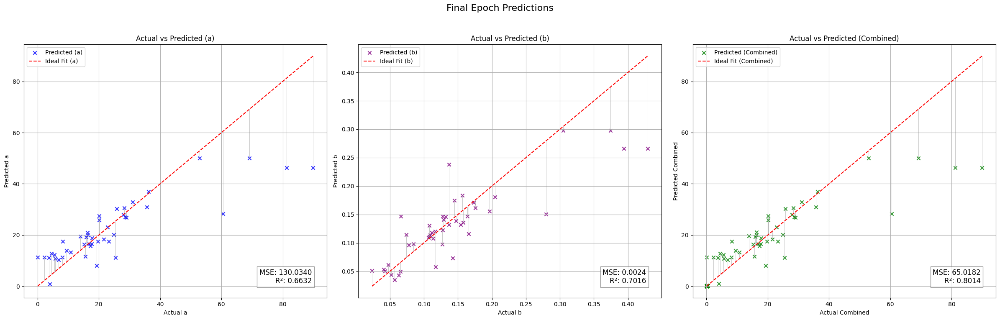

Validation Metrics:
  - MSE: 59.2609
  - R²: 0.7195
  - MAE: 3.4256
  - Explained Variance Score (EVS): 0.7223
Fold 1 Metrics:
  - Validation Loss (MSE): 59.2609
  - R²: 0.7195
  - MAE: 3.4256
  - EVS: 0.7223
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=0.4]


Validation Metrics:
  - MSE: 1.8657
  - R²: 0.9692
  - MAE: 0.7203
  - Explained Variance Score (EVS): 0.9726
Epoch [1/50], Train Loss: 0.4148, Val Loss: 1.8657
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.407]


Validation Metrics:
  - MSE: 2.4083
  - R²: 0.9630
  - MAE: 0.8298
  - Explained Variance Score (EVS): 0.9633
Epoch [2/50], Train Loss: 0.3828, Val Loss: 2.4083
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.23it/s, loss=0.351]


Validation Metrics:
  - MSE: 3.0716
  - R²: 0.9522
  - MAE: 0.9688
  - Explained Variance Score (EVS): 0.9524
Epoch [3/50], Train Loss: 0.3557, Val Loss: 3.0716
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.353]


Validation Metrics:
  - MSE: 3.3339
  - R²: 0.9402
  - MAE: 1.0064
  - Explained Variance Score (EVS): 0.9408
Epoch [4/50], Train Loss: 0.3488, Val Loss: 3.3339
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.349]


Validation Metrics:
  - MSE: 4.3529
  - R²: 0.9207
  - MAE: 1.1164
  - Explained Variance Score (EVS): 0.9237
Epoch [5/50], Train Loss: 0.3329, Val Loss: 4.3529
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.298]


Validation Metrics:
  - MSE: 4.8586
  - R²: 0.9069
  - MAE: 1.1727
  - Explained Variance Score (EVS): 0.9097
Epoch [6/50], Train Loss: 0.3269, Val Loss: 4.8586
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=0.283]


Validation Metrics:
  - MSE: 5.0212
  - R²: 0.9108
  - MAE: 1.2395
  - Explained Variance Score (EVS): 0.9135
Epoch [7/50], Train Loss: 0.3031, Val Loss: 5.0212
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.316]


Validation Metrics:
  - MSE: 5.9787
  - R²: 0.9000
  - MAE: 1.3593
  - Explained Variance Score (EVS): 0.9046
Epoch [8/50], Train Loss: 0.3074, Val Loss: 5.9787
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.40it/s, loss=0.321]


Validation Metrics:
  - MSE: 6.5703
  - R²: 0.8916
  - MAE: 1.3467
  - Explained Variance Score (EVS): 0.8995
Epoch [9/50], Train Loss: 0.2872, Val Loss: 6.5703
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s, loss=0.26]


Validation Metrics:
  - MSE: 6.2254
  - R²: 0.8780
  - MAE: 1.2879
  - Explained Variance Score (EVS): 0.8947
Epoch [10/50], Train Loss: 0.2827, Val Loss: 6.2254
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.71it/s, loss=0.247]


Validation Metrics:
  - MSE: 5.5639
  - R²: 0.8778
  - MAE: 1.1753
  - Explained Variance Score (EVS): 0.8877
Epoch [11/50], Train Loss: 0.2725, Val Loss: 5.5639
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


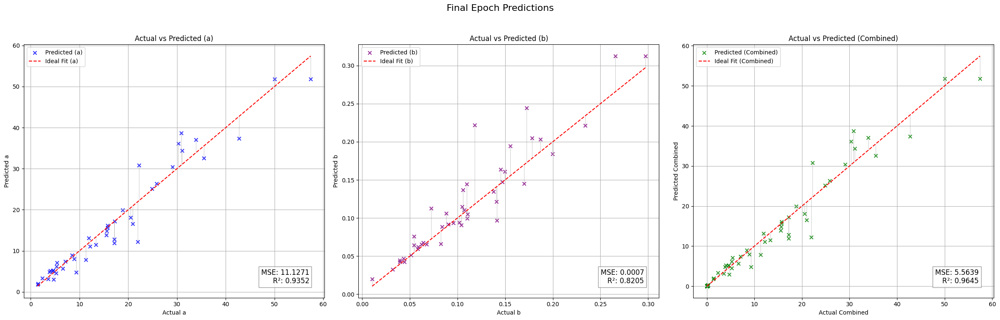

Validation Metrics:
  - MSE: 1.8657
  - R²: 0.9692
  - MAE: 0.7203
  - Explained Variance Score (EVS): 0.9726
Fold 2 Metrics:
  - Validation Loss (MSE): 1.8657
  - R²: 0.9692
  - MAE: 0.7203
  - EVS: 0.9726
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.10it/s, loss=0.403]


Validation Metrics:
  - MSE: 13.9170
  - R²: 0.8846
  - MAE: 1.2476
  - Explained Variance Score (EVS): 0.8858
Epoch [1/50], Train Loss: 0.3757, Val Loss: 13.9170
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.07it/s, loss=0.426]


Validation Metrics:
  - MSE: 13.7598
  - R²: 0.8857
  - MAE: 1.2354
  - Explained Variance Score (EVS): 0.8866
Epoch [2/50], Train Loss: 0.3704, Val Loss: 13.7598
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=0.319]


Validation Metrics:
  - MSE: 13.8645
  - R²: 0.8835
  - MAE: 1.2468
  - Explained Variance Score (EVS): 0.8848
Epoch [3/50], Train Loss: 0.3581, Val Loss: 13.8645
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s, loss=0.334]


Validation Metrics:
  - MSE: 13.9429
  - R²: 0.8776
  - MAE: 1.2593
  - Explained Variance Score (EVS): 0.8807
Epoch [4/50], Train Loss: 0.3437, Val Loss: 13.9429
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.76it/s, loss=0.365]


Validation Metrics:
  - MSE: 13.8909
  - R²: 0.8732
  - MAE: 1.2767
  - Explained Variance Score (EVS): 0.8779
Epoch [5/50], Train Loss: 0.3390, Val Loss: 13.8909
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.50it/s, loss=0.362]


Validation Metrics:
  - MSE: 14.2706
  - R²: 0.8654
  - MAE: 1.3235
  - Explained Variance Score (EVS): 0.8738
Epoch [6/50], Train Loss: 0.3360, Val Loss: 14.2706
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=0.361]


Validation Metrics:
  - MSE: 14.7067
  - R²: 0.8702
  - MAE: 1.3815
  - Explained Variance Score (EVS): 0.8753
Epoch [7/50], Train Loss: 0.3338, Val Loss: 14.7067
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.02it/s, loss=0.297]


Validation Metrics:
  - MSE: 15.7647
  - R²: 0.8689
  - MAE: 1.4396
  - Explained Variance Score (EVS): 0.8758
Epoch [8/50], Train Loss: 0.3088, Val Loss: 15.7647
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.42it/s, loss=0.314]


Validation Metrics:
  - MSE: 16.8580
  - R²: 0.8640
  - MAE: 1.4103
  - Explained Variance Score (EVS): 0.8697
Epoch [9/50], Train Loss: 0.3099, Val Loss: 16.8580
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.314]


Validation Metrics:
  - MSE: 17.8563
  - R²: 0.8599
  - MAE: 1.4324
  - Explained Variance Score (EVS): 0.8662
Epoch [10/50], Train Loss: 0.2885, Val Loss: 17.8563
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.279]


Validation Metrics:
  - MSE: 18.4025
  - R²: 0.8567
  - MAE: 1.4522
  - Explained Variance Score (EVS): 0.8655
Epoch [11/50], Train Loss: 0.2904, Val Loss: 18.4025
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s, loss=0.288]


Validation Metrics:
  - MSE: 18.4972
  - R²: 0.8545
  - MAE: 1.4566
  - Explained Variance Score (EVS): 0.8651
Epoch [12/50], Train Loss: 0.2815, Val Loss: 18.4972
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


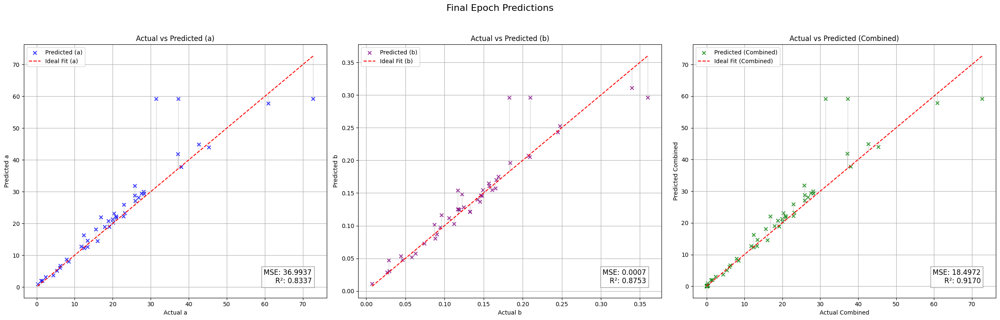

Validation Metrics:
  - MSE: 13.7598
  - R²: 0.8857
  - MAE: 1.2354
  - Explained Variance Score (EVS): 0.8866
Fold 3 Metrics:
  - Validation Loss (MSE): 13.7598
  - R²: 0.8857
  - MAE: 1.2354
  - EVS: 0.8866
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s, loss=0.35]


Validation Metrics:
  - MSE: 12.4716
  - R²: 0.8823
  - MAE: 1.3024
  - Explained Variance Score (EVS): 0.8830
Epoch [1/50], Train Loss: 0.3614, Val Loss: 12.4716
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.15it/s, loss=0.349]


Validation Metrics:
  - MSE: 13.9559
  - R²: 0.8737
  - MAE: 1.3771
  - Explained Variance Score (EVS): 0.8766
Epoch [2/50], Train Loss: 0.3727, Val Loss: 13.9559
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.13it/s, loss=0.349]


Validation Metrics:
  - MSE: 14.2120
  - R²: 0.8705
  - MAE: 1.3986
  - Explained Variance Score (EVS): 0.8731
Epoch [3/50], Train Loss: 0.3507, Val Loss: 14.2120
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.15it/s, loss=0.295]


Validation Metrics:
  - MSE: 14.2682
  - R²: 0.8677
  - MAE: 1.3975
  - Explained Variance Score (EVS): 0.8697
Epoch [4/50], Train Loss: 0.3452, Val Loss: 14.2682
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.98it/s, loss=0.295]


Validation Metrics:
  - MSE: 15.4193
  - R²: 0.8567
  - MAE: 1.4423
  - Explained Variance Score (EVS): 0.8602
Epoch [5/50], Train Loss: 0.3308, Val Loss: 15.4193
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.50it/s, loss=0.291]


Validation Metrics:
  - MSE: 16.7463
  - R²: 0.8452
  - MAE: 1.4958
  - Explained Variance Score (EVS): 0.8499
Epoch [6/50], Train Loss: 0.3361, Val Loss: 16.7463
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.99it/s, loss=0.37]


Validation Metrics:
  - MSE: 18.0994
  - R²: 0.8349
  - MAE: 1.5321
  - Explained Variance Score (EVS): 0.8389
Epoch [7/50], Train Loss: 0.3315, Val Loss: 18.0994
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.343]


Validation Metrics:
  - MSE: 19.0911
  - R²: 0.8275
  - MAE: 1.5811
  - Explained Variance Score (EVS): 0.8306
Epoch [8/50], Train Loss: 0.3217, Val Loss: 19.0911
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.326]


Validation Metrics:
  - MSE: 20.4846
  - R²: 0.8181
  - MAE: 1.6336
  - Explained Variance Score (EVS): 0.8222
Epoch [9/50], Train Loss: 0.3108, Val Loss: 20.4846
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=0.285]


Validation Metrics:
  - MSE: 21.9371
  - R²: 0.8063
  - MAE: 1.7016
  - Explained Variance Score (EVS): 0.8112
Epoch [10/50], Train Loss: 0.2965, Val Loss: 21.9371
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.48it/s, loss=0.298]


Validation Metrics:
  - MSE: 23.2037
  - R²: 0.7972
  - MAE: 1.7512
  - Explained Variance Score (EVS): 0.8041
Epoch [11/50], Train Loss: 0.3058, Val Loss: 23.2037
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


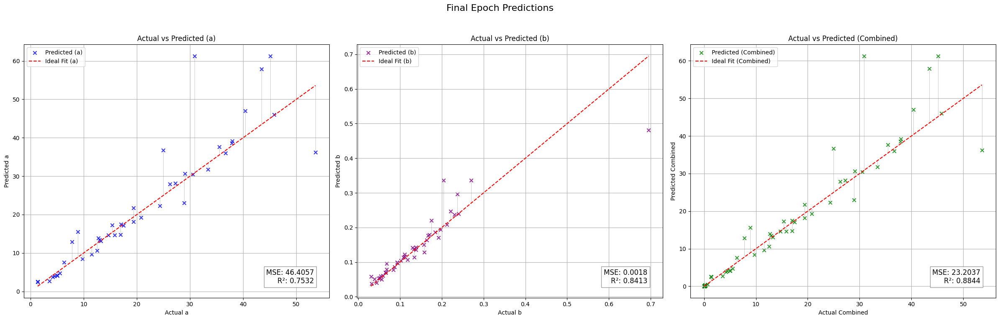

Validation Metrics:
  - MSE: 12.4716
  - R²: 0.8823
  - MAE: 1.3024
  - Explained Variance Score (EVS): 0.8830
Fold 4 Metrics:
  - Validation Loss (MSE): 12.4716
  - R²: 0.8823
  - MAE: 1.3024
  - EVS: 0.8830
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.58it/s, loss=0.357]


Validation Metrics:
  - MSE: 35.6884
  - R²: 0.8161
  - MAE: 1.5782
  - Explained Variance Score (EVS): 0.8244
Epoch [1/50], Train Loss: 0.3395, Val Loss: 35.6884
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.20it/s, loss=0.383]


Validation Metrics:
  - MSE: 35.0098
  - R²: 0.8191
  - MAE: 1.5539
  - Explained Variance Score (EVS): 0.8266
Epoch [2/50], Train Loss: 0.3569, Val Loss: 35.0098
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.91it/s, loss=0.337]


Validation Metrics:
  - MSE: 34.0511
  - R²: 0.8233
  - MAE: 1.5197
  - Explained Variance Score (EVS): 0.8302
Epoch [3/50], Train Loss: 0.3431, Val Loss: 34.0511
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.78it/s, loss=0.302]


Validation Metrics:
  - MSE: 33.0841
  - R²: 0.8278
  - MAE: 1.4905
  - Explained Variance Score (EVS): 0.8335
Epoch [4/50], Train Loss: 0.3384, Val Loss: 33.0841
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=0.33]


Validation Metrics:
  - MSE: 32.5318
  - R²: 0.8303
  - MAE: 1.4642
  - Explained Variance Score (EVS): 0.8353
Epoch [5/50], Train Loss: 0.3391, Val Loss: 32.5318
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s, loss=0.337]


Validation Metrics:
  - MSE: 31.8287
  - R²: 0.8334
  - MAE: 1.4407
  - Explained Variance Score (EVS): 0.8380
Epoch [6/50], Train Loss: 0.3431, Val Loss: 31.8287
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.399]


Validation Metrics:
  - MSE: 31.6865
  - R²: 0.8330
  - MAE: 1.4324
  - Explained Variance Score (EVS): 0.8381
Epoch [7/50], Train Loss: 0.3510, Val Loss: 31.6865
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.339]


Validation Metrics:
  - MSE: 32.3663
  - R²: 0.8280
  - MAE: 1.4435
  - Explained Variance Score (EVS): 0.8340
Epoch [8/50], Train Loss: 0.3144, Val Loss: 32.3663
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.341]


Validation Metrics:
  - MSE: 32.6918
  - R²: 0.8269
  - MAE: 1.4470
  - Explained Variance Score (EVS): 0.8327
Epoch [9/50], Train Loss: 0.3298, Val Loss: 32.6918
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.38it/s, loss=0.342]


Validation Metrics:
  - MSE: 33.4929
  - R²: 0.8242
  - MAE: 1.4684
  - Explained Variance Score (EVS): 0.8313
Epoch [10/50], Train Loss: 0.3196, Val Loss: 33.4929
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.29it/s, loss=0.303]


Validation Metrics:
  - MSE: 33.4319
  - R²: 0.8256
  - MAE: 1.4714
  - Explained Variance Score (EVS): 0.8324
Epoch [11/50], Train Loss: 0.3191, Val Loss: 33.4319
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.72it/s, loss=0.291]


Validation Metrics:
  - MSE: 33.7428
  - R²: 0.8248
  - MAE: 1.4787
  - Explained Variance Score (EVS): 0.8320
Epoch [12/50], Train Loss: 0.3206, Val Loss: 33.7428
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.289]


Validation Metrics:
  - MSE: 33.8268
  - R²: 0.8256
  - MAE: 1.4749
  - Explained Variance Score (EVS): 0.8321
Epoch [13/50], Train Loss: 0.3162, Val Loss: 33.8268
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.76it/s, loss=0.327]


Validation Metrics:
  - MSE: 33.9683
  - R²: 0.8264
  - MAE: 1.4768
  - Explained Variance Score (EVS): 0.8325
Epoch [14/50], Train Loss: 0.3193, Val Loss: 33.9683
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.01it/s, loss=0.3]


Validation Metrics:
  - MSE: 34.0652
  - R²: 0.8265
  - MAE: 1.4817
  - Explained Variance Score (EVS): 0.8325
Epoch [15/50], Train Loss: 0.3025, Val Loss: 34.0652
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  8.14it/s, loss=0.319]


Validation Metrics:
  - MSE: 34.1251
  - R²: 0.8266
  - MAE: 1.4850
  - Explained Variance Score (EVS): 0.8328
Epoch [16/50], Train Loss: 0.3120, Val Loss: 34.1251
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.24it/s, loss=0.298]


Validation Metrics:
  - MSE: 34.1408
  - R²: 0.8268
  - MAE: 1.4896
  - Explained Variance Score (EVS): 0.8330
Epoch [17/50], Train Loss: 0.3120, Val Loss: 34.1408
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


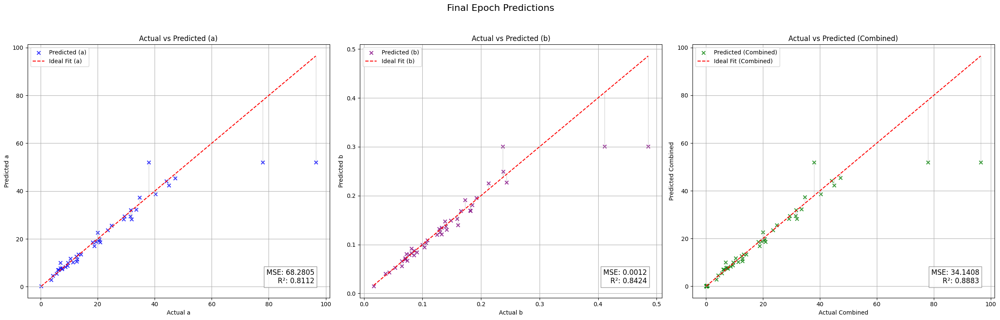

[I 2024-12-01 17:07:41,614] Trial 11 finished with value: 23.80887222290039 and parameters: {'num_layers': 1, 'hidden_size_0': 308, 'activation_0': 'ReLU', 'dropout_0': 0.4811063888070445, 'batch_size': 64, 'learning_rate': 1.1498638575661886e-05, 'optimizer': 'AdamW'}. Best is trial 10 with value: 23.696170806884766.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 31.6865
  - R²: 0.8330
  - MAE: 1.4324
  - Explained Variance Score (EVS): 0.8381
Fold 5 Metrics:
  - Validation Loss (MSE): 31.6865
  - R²: 0.8330
  - MAE: 1.4324
  - EVS: 0.8381
Avg Validation Metrics:
  - MSE: 23.8089
  - R²: 0.8580
  - MAE: 1.6232
  - EVS: 0.8605
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.54it/s, loss=0.953]


Validation Metrics:
  - MSE: 192.2071
  - R²: 0.0054
  - MAE: 6.2939
  - Explained Variance Score (EVS): 0.0303
Epoch [1/50], Train Loss: 1.0959, Val Loss: 192.2071
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.23it/s, loss=0.875]


Validation Metrics:
  - MSE: 187.7147
  - R²: 0.0297
  - MAE: 6.1959
  - Explained Variance Score (EVS): 0.0512
Epoch [2/50], Train Loss: 0.9386, Val Loss: 187.7147
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.881]


Validation Metrics:
  - MSE: 185.3773
  - R²: 0.0385
  - MAE: 6.1513
  - Explained Variance Score (EVS): 0.0596
Epoch [3/50], Train Loss: 0.8953, Val Loss: 185.3773
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.26it/s, loss=0.854]


Validation Metrics:
  - MSE: 185.0927
  - R²: 0.0427
  - MAE: 6.1380
  - Explained Variance Score (EVS): 0.0646
Epoch [4/50], Train Loss: 0.8596, Val Loss: 185.0927
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.23it/s, loss=0.866]


Validation Metrics:
  - MSE: 184.2076
  - R²: 0.0561
  - MAE: 6.1067
  - Explained Variance Score (EVS): 0.0791
Epoch [5/50], Train Loss: 0.8213, Val Loss: 184.2076
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.762]


Validation Metrics:
  - MSE: 180.8729
  - R²: 0.0797
  - MAE: 6.0311
  - Explained Variance Score (EVS): 0.1032
Epoch [6/50], Train Loss: 0.7984, Val Loss: 180.8729
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.821]


Validation Metrics:
  - MSE: 175.3860
  - R²: 0.0982
  - MAE: 5.9182
  - Explained Variance Score (EVS): 0.1220
Epoch [7/50], Train Loss: 0.7940, Val Loss: 175.3860
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.45it/s, loss=0.744]


Validation Metrics:
  - MSE: 170.0458
  - R²: 0.1168
  - MAE: 5.8000
  - Explained Variance Score (EVS): 0.1410
Epoch [8/50], Train Loss: 0.7624, Val Loss: 170.0458
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.73]


Validation Metrics:
  - MSE: 164.8439
  - R²: 0.1465
  - MAE: 5.6846
  - Explained Variance Score (EVS): 0.1693
Epoch [9/50], Train Loss: 0.7422, Val Loss: 164.8439
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s, loss=0.735]


Validation Metrics:
  - MSE: 157.8697
  - R²: 0.1783
  - MAE: 5.5394
  - Explained Variance Score (EVS): 0.2008
Epoch [10/50], Train Loss: 0.7303, Val Loss: 157.8697
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.673]


Validation Metrics:
  - MSE: 151.1126
  - R²: 0.2185
  - MAE: 5.4154
  - Explained Variance Score (EVS): 0.2397
Epoch [11/50], Train Loss: 0.7102, Val Loss: 151.1126
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.25it/s, loss=0.731]


Validation Metrics:
  - MSE: 145.1193
  - R²: 0.2631
  - MAE: 5.3008
  - Explained Variance Score (EVS): 0.2817
Epoch [12/50], Train Loss: 0.7026, Val Loss: 145.1193
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.32it/s, loss=0.671]


Validation Metrics:
  - MSE: 139.9564
  - R²: 0.3003
  - MAE: 5.1748
  - Explained Variance Score (EVS): 0.3162
Epoch [13/50], Train Loss: 0.6684, Val Loss: 139.9564
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.76it/s, loss=0.609]


Validation Metrics:
  - MSE: 135.0352
  - R²: 0.3179
  - MAE: 5.0364
  - Explained Variance Score (EVS): 0.3315
Epoch [14/50], Train Loss: 0.6460, Val Loss: 135.0352
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.01it/s, loss=0.67]


Validation Metrics:
  - MSE: 126.8778
  - R²: 0.3523
  - MAE: 4.8703
  - Explained Variance Score (EVS): 0.3676
Epoch [15/50], Train Loss: 0.6436, Val Loss: 126.8778
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s, loss=0.561]


Validation Metrics:
  - MSE: 112.2366
  - R²: 0.4329
  - MAE: 4.6769
  - Explained Variance Score (EVS): 0.4452
Epoch [16/50], Train Loss: 0.6020, Val Loss: 112.2366
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.77it/s, loss=0.534]


Validation Metrics:
  - MSE: 101.6527
  - R²: 0.4839
  - MAE: 4.3923
  - Explained Variance Score (EVS): 0.4970
Epoch [17/50], Train Loss: 0.5835, Val Loss: 101.6527
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  7.01it/s, loss=0.585]


Validation Metrics:
  - MSE: 94.9205
  - R²: 0.5047
  - MAE: 4.1684
  - Explained Variance Score (EVS): 0.5180
Epoch [18/50], Train Loss: 0.5676, Val Loss: 94.9205
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.25it/s, loss=0.532]


Validation Metrics:
  - MSE: 89.4130
  - R²: 0.5406
  - MAE: 4.0451
  - Explained Variance Score (EVS): 0.5508
Epoch [19/50], Train Loss: 0.5523, Val Loss: 89.4130
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  7.49it/s, loss=0.535]


Validation Metrics:
  - MSE: 80.4554
  - R²: 0.6165
  - MAE: 3.9107
  - Explained Variance Score (EVS): 0.6224
Epoch [20/50], Train Loss: 0.5357, Val Loss: 80.4554
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.77it/s, loss=0.529]


Validation Metrics:
  - MSE: 78.2944
  - R²: 0.6368
  - MAE: 3.7947
  - Explained Variance Score (EVS): 0.6444
Epoch [21/50], Train Loss: 0.5177, Val Loss: 78.2944
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  7.99it/s, loss=0.539]


Validation Metrics:
  - MSE: 72.5816
  - R²: 0.6534
  - MAE: 3.6766
  - Explained Variance Score (EVS): 0.6606
Epoch [22/50], Train Loss: 0.5104, Val Loss: 72.5816
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.438]


Validation Metrics:
  - MSE: 70.3749
  - R²: 0.6521
  - MAE: 3.6539
  - Explained Variance Score (EVS): 0.6600
Epoch [23/50], Train Loss: 0.4740, Val Loss: 70.3749
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.485]


Validation Metrics:
  - MSE: 62.8074
  - R²: 0.6852
  - MAE: 3.5672
  - Explained Variance Score (EVS): 0.6915
Epoch [24/50], Train Loss: 0.4559, Val Loss: 62.8074
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.63it/s, loss=0.424]


Validation Metrics:
  - MSE: 59.2251
  - R²: 0.7156
  - MAE: 3.4403
  - Explained Variance Score (EVS): 0.7199
Epoch [25/50], Train Loss: 0.4378, Val Loss: 59.2251
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.90it/s, loss=0.393]


Validation Metrics:
  - MSE: 60.7899
  - R²: 0.7110
  - MAE: 3.4637
  - Explained Variance Score (EVS): 0.7159
Epoch [26/50], Train Loss: 0.4148, Val Loss: 60.7899
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=0.377]


Validation Metrics:
  - MSE: 62.8734
  - R²: 0.6932
  - MAE: 3.5053
  - Explained Variance Score (EVS): 0.7006
Epoch [27/50], Train Loss: 0.4100, Val Loss: 62.8734
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=0.383]


Validation Metrics:
  - MSE: 67.5765
  - R²: 0.6636
  - MAE: 3.4746
  - Explained Variance Score (EVS): 0.6779
Epoch [28/50], Train Loss: 0.3896, Val Loss: 67.5765
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.325]


Validation Metrics:
  - MSE: 65.2101
  - R²: 0.6859
  - MAE: 3.4525
  - Explained Variance Score (EVS): 0.6955
Epoch [29/50], Train Loss: 0.3599, Val Loss: 65.2101
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.99it/s, loss=0.359]


Validation Metrics:
  - MSE: 61.8349
  - R²: 0.7009
  - MAE: 3.3810
  - Explained Variance Score (EVS): 0.7066
Epoch [30/50], Train Loss: 0.3445, Val Loss: 61.8349
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  7.04it/s, loss=0.33]


Validation Metrics:
  - MSE: 63.2643
  - R²: 0.6966
  - MAE: 3.3780
  - Explained Variance Score (EVS): 0.7013
Epoch [31/50], Train Loss: 0.3441, Val Loss: 63.2643
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  6.78it/s, loss=0.308]


Validation Metrics:
  - MSE: 62.4292
  - R²: 0.7022
  - MAE: 3.3175
  - Explained Variance Score (EVS): 0.7127
Epoch [32/50], Train Loss: 0.3088, Val Loss: 62.4292
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  6.92it/s, loss=0.319]


Validation Metrics:
  - MSE: 65.5723
  - R²: 0.6820
  - MAE: 3.3975
  - Explained Variance Score (EVS): 0.7041
Epoch [33/50], Train Loss: 0.3033, Val Loss: 65.5723
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  7.20it/s, loss=0.343]


Validation Metrics:
  - MSE: 65.9747
  - R²: 0.6870
  - MAE: 3.3677
  - Explained Variance Score (EVS): 0.7024
Epoch [34/50], Train Loss: 0.2875, Val Loss: 65.9747
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  7.80it/s, loss=0.254]


Validation Metrics:
  - MSE: 64.0188
  - R²: 0.6950
  - MAE: 3.3815
  - Explained Variance Score (EVS): 0.7020
Epoch [35/50], Train Loss: 0.2850, Val Loss: 64.0188
Current Dropout Rate: 0.2280
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


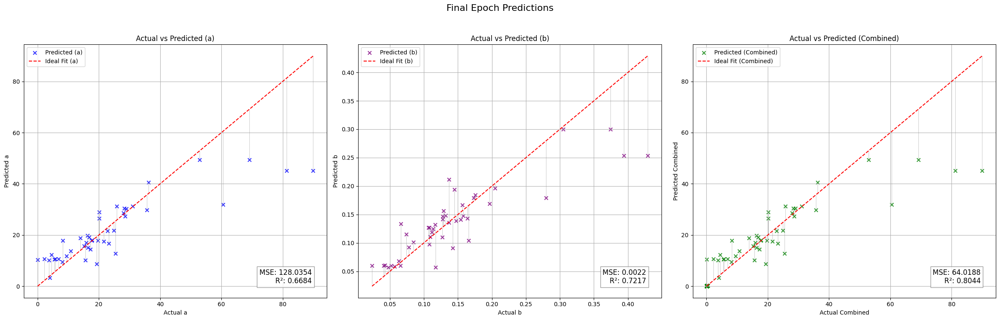

Validation Metrics:
  - MSE: 59.2251
  - R²: 0.7156
  - MAE: 3.4403
  - Explained Variance Score (EVS): 0.7199
Fold 1 Metrics:
  - Validation Loss (MSE): 59.2251
  - R²: 0.7156
  - MAE: 3.4403
  - EVS: 0.7199
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.21it/s, loss=0.448]


Validation Metrics:
  - MSE: 2.1966
  - R²: 0.9627
  - MAE: 0.7943
  - Explained Variance Score (EVS): 0.9673
Epoch [1/50], Train Loss: 0.4597, Val Loss: 2.1966
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.52it/s, loss=0.496]


Validation Metrics:
  - MSE: 3.2659
  - R²: 0.9533
  - MAE: 0.8722
  - Explained Variance Score (EVS): 0.9543
Epoch [2/50], Train Loss: 0.4472, Val Loss: 3.2659
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.42it/s, loss=0.374]


Validation Metrics:
  - MSE: 4.2384
  - R²: 0.9446
  - MAE: 1.0105
  - Explained Variance Score (EVS): 0.9463
Epoch [3/50], Train Loss: 0.4185, Val Loss: 4.2384
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.82it/s, loss=0.391]


Validation Metrics:
  - MSE: 4.1982
  - R²: 0.9399
  - MAE: 1.0549
  - Explained Variance Score (EVS): 0.9404
Epoch [4/50], Train Loss: 0.3957, Val Loss: 4.1982
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.53it/s, loss=0.457]


Validation Metrics:
  - MSE: 4.5728
  - R²: 0.9356
  - MAE: 1.1169
  - Explained Variance Score (EVS): 0.9364
Epoch [5/50], Train Loss: 0.4011, Val Loss: 4.5728
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.64it/s, loss=0.383]


Validation Metrics:
  - MSE: 4.7527
  - R²: 0.9372
  - MAE: 1.1121
  - Explained Variance Score (EVS): 0.9386
Epoch [6/50], Train Loss: 0.3715, Val Loss: 4.7527
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.367]


Validation Metrics:
  - MSE: 4.4730
  - R²: 0.9298
  - MAE: 1.1856
  - Explained Variance Score (EVS): 0.9384
Epoch [7/50], Train Loss: 0.3623, Val Loss: 4.4730
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.49it/s, loss=0.327]


Validation Metrics:
  - MSE: 4.4195
  - R²: 0.9215
  - MAE: 1.2223
  - Explained Variance Score (EVS): 0.9368
Epoch [8/50], Train Loss: 0.3418, Val Loss: 4.4195
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.334]


Validation Metrics:
  - MSE: 4.4854
  - R²: 0.9251
  - MAE: 1.1548
  - Explained Variance Score (EVS): 0.9377
Epoch [9/50], Train Loss: 0.3410, Val Loss: 4.4854
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.305]


Validation Metrics:
  - MSE: 3.9000
  - R²: 0.9270
  - MAE: 1.0605
  - Explained Variance Score (EVS): 0.9309
Epoch [10/50], Train Loss: 0.3204, Val Loss: 3.9000
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.266]


Validation Metrics:
  - MSE: 4.0391
  - R²: 0.9244
  - MAE: 1.1217
  - Explained Variance Score (EVS): 0.9269
Epoch [11/50], Train Loss: 0.3055, Val Loss: 4.0391
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


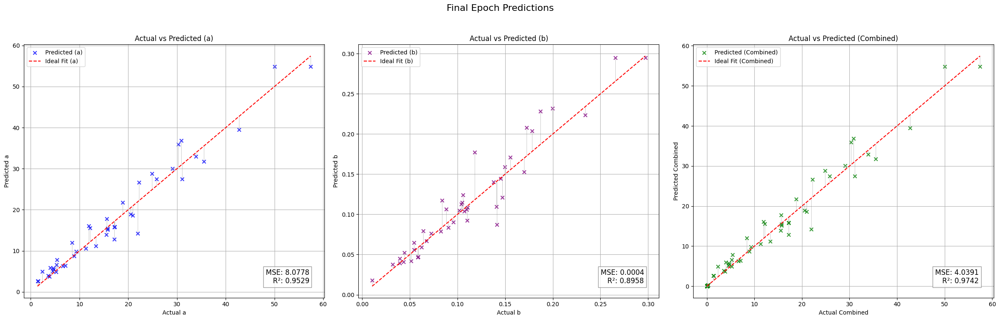

Validation Metrics:
  - MSE: 2.1966
  - R²: 0.9627
  - MAE: 0.7943
  - Explained Variance Score (EVS): 0.9673
Fold 2 Metrics:
  - Validation Loss (MSE): 2.1966
  - R²: 0.9627
  - MAE: 0.7943
  - EVS: 0.9673
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.39]


Validation Metrics:
  - MSE: 14.2170
  - R²: 0.8854
  - MAE: 1.3460
  - Explained Variance Score (EVS): 0.8857
Epoch [1/50], Train Loss: 0.4299, Val Loss: 14.2170
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.50it/s, loss=0.42]


Validation Metrics:
  - MSE: 14.2657
  - R²: 0.8839
  - MAE: 1.3637
  - Explained Variance Score (EVS): 0.8840
Epoch [2/50], Train Loss: 0.4264, Val Loss: 14.2657
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.434]


Validation Metrics:
  - MSE: 14.9020
  - R²: 0.8776
  - MAE: 1.3849
  - Explained Variance Score (EVS): 0.8784
Epoch [3/50], Train Loss: 0.4242, Val Loss: 14.9020
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.55it/s, loss=0.464]


Validation Metrics:
  - MSE: 15.0273
  - R²: 0.8741
  - MAE: 1.3539
  - Explained Variance Score (EVS): 0.8742
Epoch [4/50], Train Loss: 0.4186, Val Loss: 15.0273
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.22it/s, loss=0.391]


Validation Metrics:
  - MSE: 15.4436
  - R²: 0.8659
  - MAE: 1.3893
  - Explained Variance Score (EVS): 0.8663
Epoch [5/50], Train Loss: 0.4004, Val Loss: 15.4436
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  8.00it/s, loss=0.417]


Validation Metrics:
  - MSE: 15.9762
  - R²: 0.8554
  - MAE: 1.4403
  - Explained Variance Score (EVS): 0.8572
Epoch [6/50], Train Loss: 0.3972, Val Loss: 15.9762
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.417]


Validation Metrics:
  - MSE: 16.3007
  - R²: 0.8521
  - MAE: 1.4568
  - Explained Variance Score (EVS): 0.8537
Epoch [7/50], Train Loss: 0.3825, Val Loss: 16.3007
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.95it/s, loss=0.367]


Validation Metrics:
  - MSE: 16.1681
  - R²: 0.8592
  - MAE: 1.4401
  - Explained Variance Score (EVS): 0.8597
Epoch [8/50], Train Loss: 0.3710, Val Loss: 16.1681
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.64it/s, loss=0.389]


Validation Metrics:
  - MSE: 15.6264
  - R²: 0.8674
  - MAE: 1.4577
  - Explained Variance Score (EVS): 0.8675
Epoch [9/50], Train Loss: 0.3649, Val Loss: 15.6264
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.18it/s, loss=0.368]


Validation Metrics:
  - MSE: 16.0014
  - R²: 0.8655
  - MAE: 1.4623
  - Explained Variance Score (EVS): 0.8656
Epoch [10/50], Train Loss: 0.3505, Val Loss: 16.0014
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.60it/s, loss=0.337]


Validation Metrics:
  - MSE: 16.3765
  - R²: 0.8639
  - MAE: 1.5183
  - Explained Variance Score (EVS): 0.8647
Epoch [11/50], Train Loss: 0.3412, Val Loss: 16.3765
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


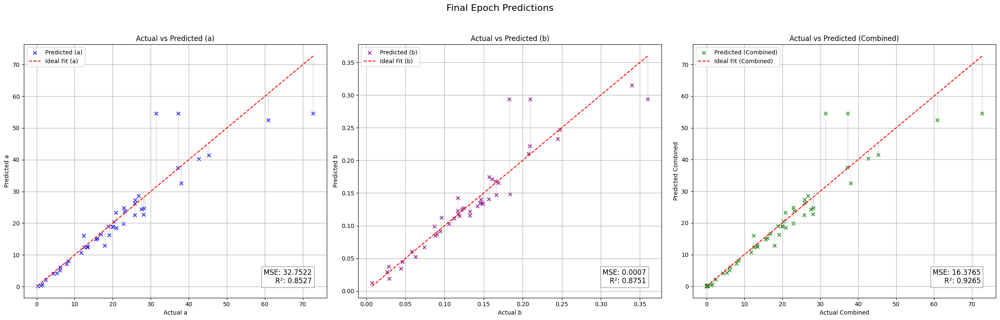

Validation Metrics:
  - MSE: 14.2170
  - R²: 0.8854
  - MAE: 1.3460
  - Explained Variance Score (EVS): 0.8857
Fold 3 Metrics:
  - Validation Loss (MSE): 14.2170
  - R²: 0.8854
  - MAE: 1.3460
  - EVS: 0.8857
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.424]


Validation Metrics:
  - MSE: 12.8234
  - R²: 0.8397
  - MAE: 1.3504
  - Explained Variance Score (EVS): 0.8404
Epoch [1/50], Train Loss: 0.4189, Val Loss: 12.8234
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.403]


Validation Metrics:
  - MSE: 13.7536
  - R²: 0.8354
  - MAE: 1.4020
  - Explained Variance Score (EVS): 0.8363
Epoch [2/50], Train Loss: 0.4398, Val Loss: 13.7536
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.414]


Validation Metrics:
  - MSE: 14.2712
  - R²: 0.8320
  - MAE: 1.4463
  - Explained Variance Score (EVS): 0.8329
Epoch [3/50], Train Loss: 0.4097, Val Loss: 14.2712
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.49it/s, loss=0.383]


Validation Metrics:
  - MSE: 15.3329
  - R²: 0.8234
  - MAE: 1.5018
  - Explained Variance Score (EVS): 0.8245
Epoch [4/50], Train Loss: 0.4029, Val Loss: 15.3329
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.397]


Validation Metrics:
  - MSE: 16.8409
  - R²: 0.8110
  - MAE: 1.5754
  - Explained Variance Score (EVS): 0.8122
Epoch [5/50], Train Loss: 0.4025, Val Loss: 16.8409
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.4]


Validation Metrics:
  - MSE: 18.3264
  - R²: 0.7989
  - MAE: 1.6319
  - Explained Variance Score (EVS): 0.8010
Epoch [6/50], Train Loss: 0.4038, Val Loss: 18.3264
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=0.396]


Validation Metrics:
  - MSE: 21.3520
  - R²: 0.7788
  - MAE: 1.7151
  - Explained Variance Score (EVS): 0.7841
Epoch [7/50], Train Loss: 0.3999, Val Loss: 21.3520
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.361]


Validation Metrics:
  - MSE: 23.0376
  - R²: 0.7666
  - MAE: 1.7614
  - Explained Variance Score (EVS): 0.7737
Epoch [8/50], Train Loss: 0.3741, Val Loss: 23.0376
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.32it/s, loss=0.35]


Validation Metrics:
  - MSE: 23.3783
  - R²: 0.7622
  - MAE: 1.7719
  - Explained Variance Score (EVS): 0.7692
Epoch [9/50], Train Loss: 0.3782, Val Loss: 23.3783
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.27it/s, loss=0.331]


Validation Metrics:
  - MSE: 23.4789
  - R²: 0.7571
  - MAE: 1.7751
  - Explained Variance Score (EVS): 0.7648
Epoch [10/50], Train Loss: 0.3575, Val Loss: 23.4789
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.56it/s, loss=0.381]


Validation Metrics:
  - MSE: 22.9277
  - R²: 0.7571
  - MAE: 1.7622
  - Explained Variance Score (EVS): 0.7645
Epoch [11/50], Train Loss: 0.3772, Val Loss: 22.9277
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


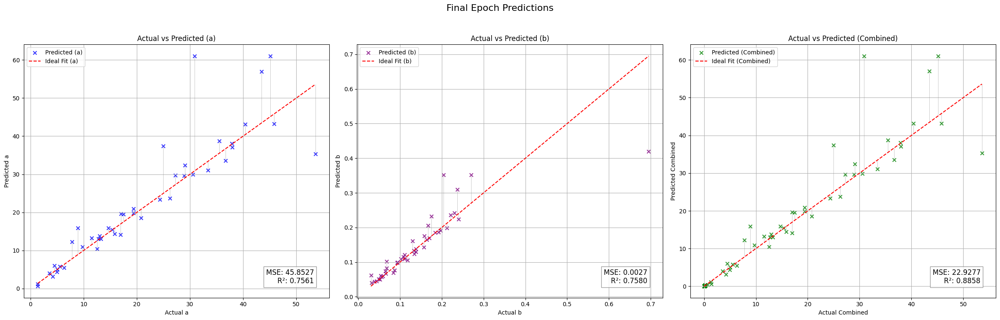

Validation Metrics:
  - MSE: 12.8234
  - R²: 0.8397
  - MAE: 1.3504
  - Explained Variance Score (EVS): 0.8404
Fold 4 Metrics:
  - Validation Loss (MSE): 12.8234
  - R²: 0.8397
  - MAE: 1.3504
  - EVS: 0.8404
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.48it/s, loss=0.452]


Validation Metrics:
  - MSE: 37.6269
  - R²: 0.8160
  - MAE: 1.5812
  - Explained Variance Score (EVS): 0.8222
Epoch [1/50], Train Loss: 0.4276, Val Loss: 37.6269
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.94it/s, loss=0.443]


Validation Metrics:
  - MSE: 36.8073
  - R²: 0.8192
  - MAE: 1.5732
  - Explained Variance Score (EVS): 0.8248
Epoch [2/50], Train Loss: 0.4138, Val Loss: 36.8073
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.442]


Validation Metrics:
  - MSE: 36.2205
  - R²: 0.8204
  - MAE: 1.5780
  - Explained Variance Score (EVS): 0.8253
Epoch [3/50], Train Loss: 0.4220, Val Loss: 36.2205
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=0.37]


Validation Metrics:
  - MSE: 35.5197
  - R²: 0.8214
  - MAE: 1.5605
  - Explained Variance Score (EVS): 0.8262
Epoch [4/50], Train Loss: 0.3997, Val Loss: 35.5197
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.28it/s, loss=0.41]


Validation Metrics:
  - MSE: 34.7993
  - R²: 0.8231
  - MAE: 1.5538
  - Explained Variance Score (EVS): 0.8271
Epoch [5/50], Train Loss: 0.4004, Val Loss: 34.7993
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.389]


Validation Metrics:
  - MSE: 34.3097
  - R²: 0.8251
  - MAE: 1.5497
  - Explained Variance Score (EVS): 0.8291
Epoch [6/50], Train Loss: 0.4019, Val Loss: 34.3097
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.397]


Validation Metrics:
  - MSE: 33.9544
  - R²: 0.8269
  - MAE: 1.5476
  - Explained Variance Score (EVS): 0.8307
Epoch [7/50], Train Loss: 0.4029, Val Loss: 33.9544
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.364]


Validation Metrics:
  - MSE: 34.0717
  - R²: 0.8273
  - MAE: 1.5441
  - Explained Variance Score (EVS): 0.8310
Epoch [8/50], Train Loss: 0.3938, Val Loss: 34.0717
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.386]


Validation Metrics:
  - MSE: 33.9055
  - R²: 0.8296
  - MAE: 1.5502
  - Explained Variance Score (EVS): 0.8328
Epoch [9/50], Train Loss: 0.3814, Val Loss: 33.9055
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=0.416]


Validation Metrics:
  - MSE: 34.2024
  - R²: 0.8287
  - MAE: 1.5489
  - Explained Variance Score (EVS): 0.8327
Epoch [10/50], Train Loss: 0.3924, Val Loss: 34.2024
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.33it/s, loss=0.389]


Validation Metrics:
  - MSE: 34.3226
  - R²: 0.8294
  - MAE: 1.5451
  - Explained Variance Score (EVS): 0.8333
Epoch [11/50], Train Loss: 0.3814, Val Loss: 34.3226
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.398]


Validation Metrics:
  - MSE: 34.3637
  - R²: 0.8302
  - MAE: 1.5386
  - Explained Variance Score (EVS): 0.8342
Epoch [12/50], Train Loss: 0.3839, Val Loss: 34.3637
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=0.348]


Validation Metrics:
  - MSE: 34.4620
  - R²: 0.8303
  - MAE: 1.5354
  - Explained Variance Score (EVS): 0.8343
Epoch [13/50], Train Loss: 0.3855, Val Loss: 34.4620
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=0.386]


Validation Metrics:
  - MSE: 34.4478
  - R²: 0.8300
  - MAE: 1.5368
  - Explained Variance Score (EVS): 0.8338
Epoch [14/50], Train Loss: 0.3712, Val Loss: 34.4478
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.57it/s, loss=0.395]


Validation Metrics:
  - MSE: 34.6239
  - R²: 0.8281
  - MAE: 1.5354
  - Explained Variance Score (EVS): 0.8324
Epoch [15/50], Train Loss: 0.3716, Val Loss: 34.6239
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.21it/s, loss=0.355]


Validation Metrics:
  - MSE: 34.5614
  - R²: 0.8281
  - MAE: 1.5373
  - Explained Variance Score (EVS): 0.8322
Epoch [16/50], Train Loss: 0.3665, Val Loss: 34.5614
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=0.366]


Validation Metrics:
  - MSE: 34.5835
  - R²: 0.8273
  - MAE: 1.5399
  - Explained Variance Score (EVS): 0.8311
Epoch [17/50], Train Loss: 0.3753, Val Loss: 34.5835
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=0.389]


Validation Metrics:
  - MSE: 34.8129
  - R²: 0.8251
  - MAE: 1.5315
  - Explained Variance Score (EVS): 0.8296
Epoch [18/50], Train Loss: 0.3718, Val Loss: 34.8129
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.22it/s, loss=0.472]


Validation Metrics:
  - MSE: 35.2532
  - R²: 0.8219
  - MAE: 1.5319
  - Explained Variance Score (EVS): 0.8276
Epoch [19/50], Train Loss: 0.3859, Val Loss: 35.2532
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


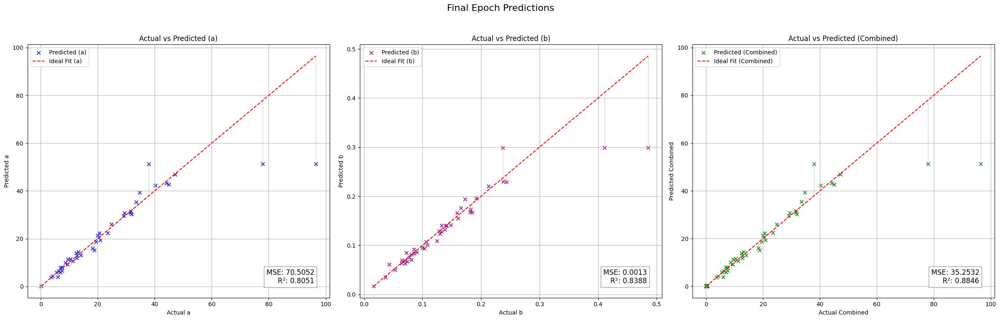

[I 2024-12-01 17:09:10,140] Trial 12 finished with value: 24.4735107421875 and parameters: {'num_layers': 1, 'hidden_size_0': 293, 'activation_0': 'ReLU', 'dropout_0': 0.3904305009932373, 'batch_size': 64, 'learning_rate': 1.1255342067120043e-05, 'optimizer': 'AdamW'}. Best is trial 10 with value: 23.696170806884766.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 33.9055
  - R²: 0.8296
  - MAE: 1.5502
  - Explained Variance Score (EVS): 0.8328
Fold 5 Metrics:
  - Validation Loss (MSE): 33.9055
  - R²: 0.8296
  - MAE: 1.5502
  - EVS: 0.8328
Avg Validation Metrics:
  - MSE: 24.4735
  - R²: 0.8466
  - MAE: 1.6962
  - EVS: 0.8493
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=1.06]


Validation Metrics:
  - MSE: 188.9889
  - R²: 0.0220
  - MAE: 6.4157
  - Explained Variance Score (EVS): 0.0332
Epoch [1/50], Train Loss: 1.1512, Val Loss: 188.9889
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.33it/s, loss=1.02]


Validation Metrics:
  - MSE: 181.9714
  - R²: 0.0492
  - MAE: 6.3164
  - Explained Variance Score (EVS): 0.0599
Epoch [2/50], Train Loss: 0.9945, Val Loss: 181.9714
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.17it/s, loss=0.852]


Validation Metrics:
  - MSE: 179.0072
  - R²: 0.0630
  - MAE: 6.2873
  - Explained Variance Score (EVS): 0.0745
Epoch [3/50], Train Loss: 0.9468, Val Loss: 179.0072
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.41it/s, loss=0.831]


Validation Metrics:
  - MSE: 178.1886
  - R²: 0.0707
  - MAE: 6.2578
  - Explained Variance Score (EVS): 0.0829
Epoch [4/50], Train Loss: 0.9016, Val Loss: 178.1886
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.788]


Validation Metrics:
  - MSE: 178.5191
  - R²: 0.0748
  - MAE: 6.2246
  - Explained Variance Score (EVS): 0.0873
Epoch [5/50], Train Loss: 0.8676, Val Loss: 178.5191
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.889]


Validation Metrics:
  - MSE: 177.6522
  - R²: 0.0844
  - MAE: 6.1570
  - Explained Variance Score (EVS): 0.0977
Epoch [6/50], Train Loss: 0.8457, Val Loss: 177.6522
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=0.91]


Validation Metrics:
  - MSE: 172.4753
  - R²: 0.1044
  - MAE: 6.0222
  - Explained Variance Score (EVS): 0.1177
Epoch [7/50], Train Loss: 0.8247, Val Loss: 172.4753
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.68it/s, loss=0.741]


Validation Metrics:
  - MSE: 165.3932
  - R²: 0.1384
  - MAE: 5.8966
  - Explained Variance Score (EVS): 0.1506
Epoch [8/50], Train Loss: 0.7897, Val Loss: 165.3932
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.73]


Validation Metrics:
  - MSE: 163.2910
  - R²: 0.1666
  - MAE: 5.8411
  - Explained Variance Score (EVS): 0.1783
Epoch [9/50], Train Loss: 0.7758, Val Loss: 163.2910
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.807]


Validation Metrics:
  - MSE: 160.3926
  - R²: 0.1934
  - MAE: 5.7757
  - Explained Variance Score (EVS): 0.2046
Epoch [10/50], Train Loss: 0.7675, Val Loss: 160.3926
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.701]


Validation Metrics:
  - MSE: 150.9090
  - R²: 0.2327
  - MAE: 5.6238
  - Explained Variance Score (EVS): 0.2433
Epoch [11/50], Train Loss: 0.7365, Val Loss: 150.9090
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.50it/s, loss=0.692]


Validation Metrics:
  - MSE: 141.2655
  - R²: 0.2740
  - MAE: 5.4490
  - Explained Variance Score (EVS): 0.2851
Epoch [12/50], Train Loss: 0.7221, Val Loss: 141.2655
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.07it/s, loss=0.66]


Validation Metrics:
  - MSE: 131.1305
  - R²: 0.3239
  - MAE: 5.2775
  - Explained Variance Score (EVS): 0.3326
Epoch [13/50], Train Loss: 0.6964, Val Loss: 131.1305
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  7.33it/s, loss=0.688]


Validation Metrics:
  - MSE: 123.8055
  - R²: 0.3727
  - MAE: 5.1060
  - Explained Variance Score (EVS): 0.3787
Epoch [14/50], Train Loss: 0.6751, Val Loss: 123.8055
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.631]


Validation Metrics:
  - MSE: 118.2549
  - R²: 0.4155
  - MAE: 4.9730
  - Explained Variance Score (EVS): 0.4222
Epoch [15/50], Train Loss: 0.6579, Val Loss: 118.2549
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.89it/s, loss=0.649]


Validation Metrics:
  - MSE: 112.9638
  - R²: 0.4430
  - MAE: 4.7755
  - Explained Variance Score (EVS): 0.4532
Epoch [16/50], Train Loss: 0.6511, Val Loss: 112.9638
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.91it/s, loss=0.613]


Validation Metrics:
  - MSE: 103.3213
  - R²: 0.4828
  - MAE: 4.5916
  - Explained Variance Score (EVS): 0.4930
Epoch [17/50], Train Loss: 0.6261, Val Loss: 103.3213
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  7.83it/s, loss=0.588]


Validation Metrics:
  - MSE: 90.1107
  - R²: 0.5376
  - MAE: 4.3730
  - Explained Variance Score (EVS): 0.5482
Epoch [18/50], Train Loss: 0.6056, Val Loss: 90.1107
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  7.01it/s, loss=0.586]


Validation Metrics:
  - MSE: 86.8157
  - R²: 0.5666
  - MAE: 4.3079
  - Explained Variance Score (EVS): 0.5754
Epoch [19/50], Train Loss: 0.5813, Val Loss: 86.8157
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.541]


Validation Metrics:
  - MSE: 83.1415
  - R²: 0.5894
  - MAE: 4.2358
  - Explained Variance Score (EVS): 0.5962
Epoch [20/50], Train Loss: 0.5760, Val Loss: 83.1415
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s, loss=0.493]


Validation Metrics:
  - MSE: 81.4189
  - R²: 0.5981
  - MAE: 4.1557
  - Explained Variance Score (EVS): 0.6086
Epoch [21/50], Train Loss: 0.5471, Val Loss: 81.4189
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.517]


Validation Metrics:
  - MSE: 70.3990
  - R²: 0.6263
  - MAE: 3.9704
  - Explained Variance Score (EVS): 0.6386
Epoch [22/50], Train Loss: 0.5220, Val Loss: 70.3990
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.503]


Validation Metrics:
  - MSE: 62.5930
  - R²: 0.6650
  - MAE: 3.8073
  - Explained Variance Score (EVS): 0.6742
Epoch [23/50], Train Loss: 0.5152, Val Loss: 62.5930
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.95it/s, loss=0.511]


Validation Metrics:
  - MSE: 63.5202
  - R²: 0.6733
  - MAE: 3.6914
  - Explained Variance Score (EVS): 0.6834
Epoch [24/50], Train Loss: 0.4840, Val Loss: 63.5202
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.45]


Validation Metrics:
  - MSE: 59.8338
  - R²: 0.7025
  - MAE: 3.5815
  - Explained Variance Score (EVS): 0.7067
Epoch [25/50], Train Loss: 0.4703, Val Loss: 59.8338
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.498]


Validation Metrics:
  - MSE: 61.7858
  - R²: 0.6967
  - MAE: 3.6370
  - Explained Variance Score (EVS): 0.6999
Epoch [26/50], Train Loss: 0.4673, Val Loss: 61.7858
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.436]


Validation Metrics:
  - MSE: 57.5269
  - R²: 0.7084
  - MAE: 3.5542
  - Explained Variance Score (EVS): 0.7118
Epoch [27/50], Train Loss: 0.4328, Val Loss: 57.5269
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.389]


Validation Metrics:
  - MSE: 57.0684
  - R²: 0.6989
  - MAE: 3.5612
  - Explained Variance Score (EVS): 0.7068
Epoch [28/50], Train Loss: 0.4152, Val Loss: 57.0684
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.82it/s, loss=0.367]


Validation Metrics:
  - MSE: 57.0239
  - R²: 0.6966
  - MAE: 3.6356
  - Explained Variance Score (EVS): 0.7056
Epoch [29/50], Train Loss: 0.3871, Val Loss: 57.0239
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=0.395]


Validation Metrics:
  - MSE: 59.9667
  - R²: 0.6856
  - MAE: 3.6852
  - Explained Variance Score (EVS): 0.6938
Epoch [30/50], Train Loss: 0.3733, Val Loss: 59.9667
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.344]


Validation Metrics:
  - MSE: 68.2047
  - R²: 0.6637
  - MAE: 3.7159
  - Explained Variance Score (EVS): 0.6730
Epoch [31/50], Train Loss: 0.3494, Val Loss: 68.2047
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.329]


Validation Metrics:
  - MSE: 69.6031
  - R²: 0.6715
  - MAE: 3.7178
  - Explained Variance Score (EVS): 0.6803
Epoch [32/50], Train Loss: 0.3342, Val Loss: 69.6031
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=0.321]


Validation Metrics:
  - MSE: 64.5441
  - R²: 0.6828
  - MAE: 3.6183
  - Explained Variance Score (EVS): 0.6889
Epoch [33/50], Train Loss: 0.3185, Val Loss: 64.5441
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  6.85it/s, loss=0.317]


Validation Metrics:
  - MSE: 63.7757
  - R²: 0.6560
  - MAE: 3.5908
  - Explained Variance Score (EVS): 0.6706
Epoch [34/50], Train Loss: 0.3035, Val Loss: 63.7757
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  7.31it/s, loss=0.286]


Validation Metrics:
  - MSE: 65.8696
  - R²: 0.6333
  - MAE: 3.5566
  - Explained Variance Score (EVS): 0.6495
Epoch [35/50], Train Loss: 0.2860, Val Loss: 65.8696
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  7.03it/s, loss=0.269]


Validation Metrics:
  - MSE: 68.0609
  - R²: 0.6527
  - MAE: 3.5638
  - Explained Variance Score (EVS): 0.6632
Epoch [36/50], Train Loss: 0.2727, Val Loss: 68.0609
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  7.60it/s, loss=0.23]


Validation Metrics:
  - MSE: 61.5449
  - R²: 0.7090
  - MAE: 3.5042
  - Explained Variance Score (EVS): 0.7136
Epoch [37/50], Train Loss: 0.2590, Val Loss: 61.5449
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.84it/s, loss=0.261]


Validation Metrics:
  - MSE: 57.2133
  - R²: 0.7290
  - MAE: 3.4579
  - Explained Variance Score (EVS): 0.7320
Epoch [38/50], Train Loss: 0.2402, Val Loss: 57.2133
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.243]


Validation Metrics:
  - MSE: 54.3191
  - R²: 0.7225
  - MAE: 3.4833
  - Explained Variance Score (EVS): 0.7271
Epoch [39/50], Train Loss: 0.2415, Val Loss: 54.3191
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s, loss=0.248]


Validation Metrics:
  - MSE: 58.4039
  - R²: 0.6816
  - MAE: 3.5317
  - Explained Variance Score (EVS): 0.6954
Epoch [40/50], Train Loss: 0.2270, Val Loss: 58.4039
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=0.274]


Validation Metrics:
  - MSE: 70.1717
  - R²: 0.6455
  - MAE: 3.6800
  - Explained Variance Score (EVS): 0.6592
Epoch [41/50], Train Loss: 0.2097, Val Loss: 70.1717
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.171]


Validation Metrics:
  - MSE: 70.4358
  - R²: 0.6621
  - MAE: 3.6239
  - Explained Variance Score (EVS): 0.6698
Epoch [42/50], Train Loss: 0.1906, Val Loss: 70.4358
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  7.07it/s, loss=0.2]


Validation Metrics:
  - MSE: 62.3420
  - R²: 0.6917
  - MAE: 3.5023
  - Explained Variance Score (EVS): 0.6963
Epoch [43/50], Train Loss: 0.1855, Val Loss: 62.3420
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  7.88it/s, loss=0.192]


Validation Metrics:
  - MSE: 56.4714
  - R²: 0.7116
  - MAE: 3.5020
  - Explained Variance Score (EVS): 0.7162
Epoch [44/50], Train Loss: 0.1847, Val Loss: 56.4714
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  6.99it/s, loss=0.205]


Validation Metrics:
  - MSE: 58.0835
  - R²: 0.6907
  - MAE: 3.4708
  - Explained Variance Score (EVS): 0.7010
Epoch [45/50], Train Loss: 0.1759, Val Loss: 58.0835
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.222]


Validation Metrics:
  - MSE: 64.5792
  - R²: 0.6601
  - MAE: 3.4640
  - Explained Variance Score (EVS): 0.6752
Epoch [46/50], Train Loss: 0.1765, Val Loss: 64.5792
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.178]


Validation Metrics:
  - MSE: 70.5287
  - R²: 0.6559
  - MAE: 3.5376
  - Explained Variance Score (EVS): 0.6674
Epoch [47/50], Train Loss: 0.1651, Val Loss: 70.5287
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=0.16]


Validation Metrics:
  - MSE: 69.6424
  - R²: 0.6674
  - MAE: 3.4884
  - Explained Variance Score (EVS): 0.6742
Epoch [48/50], Train Loss: 0.1561, Val Loss: 69.6424
Current Dropout Rate: 0.1240


Epoch 49/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.126]


Validation Metrics:
  - MSE: 66.0159
  - R²: 0.6680
  - MAE: 3.4945
  - Explained Variance Score (EVS): 0.6741
Epoch [49/50], Train Loss: 0.1490, Val Loss: 66.0159
Current Dropout Rate: 0.1160
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


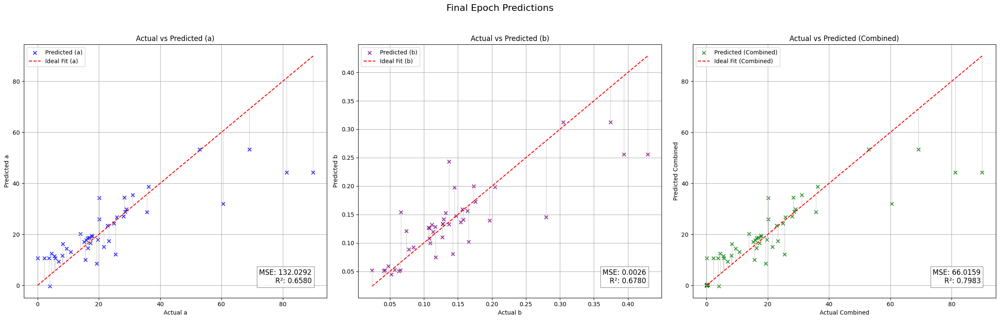

Validation Metrics:
  - MSE: 54.3191
  - R²: 0.7225
  - MAE: 3.4833
  - Explained Variance Score (EVS): 0.7271
Fold 1 Metrics:
  - Validation Loss (MSE): 54.3191
  - R²: 0.7225
  - MAE: 3.4833
  - EVS: 0.7271
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.244]


Validation Metrics:
  - MSE: 2.4491
  - R²: 0.9703
  - MAE: 0.8492
  - Explained Variance Score (EVS): 0.9768
Epoch [1/50], Train Loss: 0.2723, Val Loss: 2.4491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.59it/s, loss=0.249]


Validation Metrics:
  - MSE: 2.0522
  - R²: 0.9675
  - MAE: 0.7837
  - Explained Variance Score (EVS): 0.9690
Epoch [2/50], Train Loss: 0.2561, Val Loss: 2.0522
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.31it/s, loss=0.269]


Validation Metrics:
  - MSE: 2.1000
  - R²: 0.9624
  - MAE: 0.7944
  - Explained Variance Score (EVS): 0.9630
Epoch [3/50], Train Loss: 0.2399, Val Loss: 2.1000
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.22it/s, loss=0.284]


Validation Metrics:
  - MSE: 2.7634
  - R²: 0.9550
  - MAE: 0.8664
  - Explained Variance Score (EVS): 0.9556
Epoch [4/50], Train Loss: 0.2596, Val Loss: 2.7634
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.284]


Validation Metrics:
  - MSE: 3.6056
  - R²: 0.9492
  - MAE: 0.9299
  - Explained Variance Score (EVS): 0.9521
Epoch [5/50], Train Loss: 0.2450, Val Loss: 3.6056
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.95it/s, loss=0.183]


Validation Metrics:
  - MSE: 4.3925
  - R²: 0.9397
  - MAE: 0.9687
  - Explained Variance Score (EVS): 0.9450
Epoch [6/50], Train Loss: 0.2191, Val Loss: 4.3925
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.49it/s, loss=0.192]


Validation Metrics:
  - MSE: 4.2826
  - R²: 0.9377
  - MAE: 0.9711
  - Explained Variance Score (EVS): 0.9455
Epoch [7/50], Train Loss: 0.2192, Val Loss: 4.2826
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.96it/s, loss=0.21]


Validation Metrics:
  - MSE: 3.9504
  - R²: 0.9362
  - MAE: 0.9683
  - Explained Variance Score (EVS): 0.9429
Epoch [8/50], Train Loss: 0.2038, Val Loss: 3.9504
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.80it/s, loss=0.17]


Validation Metrics:
  - MSE: 3.9465
  - R²: 0.9377
  - MAE: 0.9994
  - Explained Variance Score (EVS): 0.9413
Epoch [9/50], Train Loss: 0.1895, Val Loss: 3.9465
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.234]


Validation Metrics:
  - MSE: 4.0157
  - R²: 0.9392
  - MAE: 1.0209
  - Explained Variance Score (EVS): 0.9394
Epoch [10/50], Train Loss: 0.2000, Val Loss: 4.0157
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.289]


Validation Metrics:
  - MSE: 4.1154
  - R²: 0.9339
  - MAE: 1.0440
  - Explained Variance Score (EVS): 0.9386
Epoch [11/50], Train Loss: 0.2114, Val Loss: 4.1154
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=0.161]


Validation Metrics:
  - MSE: 3.6829
  - R²: 0.9405
  - MAE: 0.9915
  - Explained Variance Score (EVS): 0.9416
Epoch [12/50], Train Loss: 0.1946, Val Loss: 3.6829
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


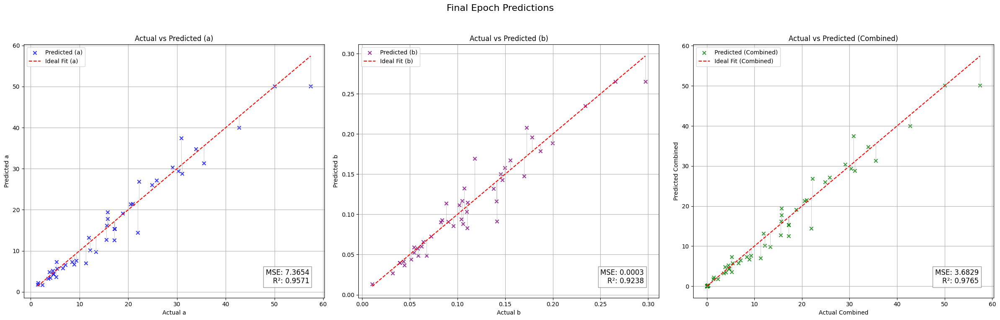

Validation Metrics:
  - MSE: 2.0522
  - R²: 0.9675
  - MAE: 0.7837
  - Explained Variance Score (EVS): 0.9690
Fold 2 Metrics:
  - Validation Loss (MSE): 2.0522
  - R²: 0.9675
  - MAE: 0.7837
  - EVS: 0.9690
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.315]


Validation Metrics:
  - MSE: 15.2361
  - R²: 0.8770
  - MAE: 1.4312
  - Explained Variance Score (EVS): 0.8793
Epoch [1/50], Train Loss: 0.2600, Val Loss: 15.2361
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.218]


Validation Metrics:
  - MSE: 14.9586
  - R²: 0.8795
  - MAE: 1.3853
  - Explained Variance Score (EVS): 0.8796
Epoch [2/50], Train Loss: 0.2434, Val Loss: 14.9586
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.243]


Validation Metrics:
  - MSE: 14.7352
  - R²: 0.8785
  - MAE: 1.3859
  - Explained Variance Score (EVS): 0.8795
Epoch [3/50], Train Loss: 0.2252, Val Loss: 14.7352
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=0.249]


Validation Metrics:
  - MSE: 14.5904
  - R²: 0.8751
  - MAE: 1.3839
  - Explained Variance Score (EVS): 0.8777
Epoch [4/50], Train Loss: 0.2143, Val Loss: 14.5904
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.219]


Validation Metrics:
  - MSE: 15.0132
  - R²: 0.8666
  - MAE: 1.3760
  - Explained Variance Score (EVS): 0.8704
Epoch [5/50], Train Loss: 0.2216, Val Loss: 15.0132
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.293]


Validation Metrics:
  - MSE: 15.8471
  - R²: 0.8651
  - MAE: 1.3889
  - Explained Variance Score (EVS): 0.8669
Epoch [6/50], Train Loss: 0.2307, Val Loss: 15.8471
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.198]


Validation Metrics:
  - MSE: 17.2806
  - R²: 0.8580
  - MAE: 1.4296
  - Explained Variance Score (EVS): 0.8598
Epoch [7/50], Train Loss: 0.2203, Val Loss: 17.2806
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.98it/s, loss=0.208]


Validation Metrics:
  - MSE: 19.7353
  - R²: 0.8424
  - MAE: 1.4625
  - Explained Variance Score (EVS): 0.8455
Epoch [8/50], Train Loss: 0.2046, Val Loss: 19.7353
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.95it/s, loss=0.182]


Validation Metrics:
  - MSE: 21.0078
  - R²: 0.8318
  - MAE: 1.5252
  - Explained Variance Score (EVS): 0.8339
Epoch [9/50], Train Loss: 0.2072, Val Loss: 21.0078
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.44it/s, loss=0.197]


Validation Metrics:
  - MSE: 21.0465
  - R²: 0.8341
  - MAE: 1.5598
  - Explained Variance Score (EVS): 0.8347
Epoch [10/50], Train Loss: 0.1872, Val Loss: 21.0465
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.10it/s, loss=0.179]


Validation Metrics:
  - MSE: 20.4287
  - R²: 0.8364
  - MAE: 1.5458
  - Explained Variance Score (EVS): 0.8370
Epoch [11/50], Train Loss: 0.1872, Val Loss: 20.4287
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s, loss=0.19]


Validation Metrics:
  - MSE: 19.6498
  - R²: 0.8391
  - MAE: 1.5191
  - Explained Variance Score (EVS): 0.8403
Epoch [12/50], Train Loss: 0.1858, Val Loss: 19.6498
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s, loss=0.165]


Validation Metrics:
  - MSE: 18.8725
  - R²: 0.8424
  - MAE: 1.4753
  - Explained Variance Score (EVS): 0.8443
Epoch [13/50], Train Loss: 0.1800, Val Loss: 18.8725
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.65it/s, loss=0.201]


Validation Metrics:
  - MSE: 18.3989
  - R²: 0.8463
  - MAE: 1.4532
  - Explained Variance Score (EVS): 0.8472
Epoch [14/50], Train Loss: 0.1862, Val Loss: 18.3989
Current Dropout Rate: 0.3960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


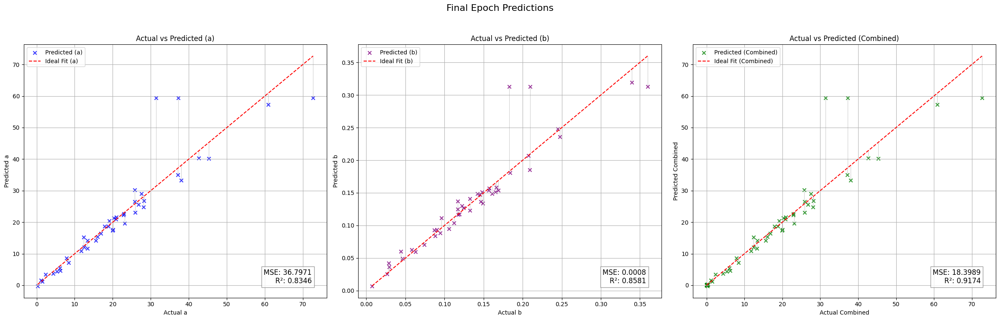

Validation Metrics:
  - MSE: 14.5904
  - R²: 0.8751
  - MAE: 1.3839
  - Explained Variance Score (EVS): 0.8777
Fold 3 Metrics:
  - Validation Loss (MSE): 14.5904
  - R²: 0.8751
  - MAE: 1.3839
  - EVS: 0.8777
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.02it/s, loss=0.214]


Validation Metrics:
  - MSE: 9.2915
  - R²: 0.9261
  - MAE: 1.0969
  - Explained Variance Score (EVS): 0.9289
Epoch [1/50], Train Loss: 0.2298, Val Loss: 9.2915
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.87it/s, loss=0.227]


Validation Metrics:
  - MSE: 9.5108
  - R²: 0.9228
  - MAE: 1.1044
  - Explained Variance Score (EVS): 0.9258
Epoch [2/50], Train Loss: 0.2320, Val Loss: 9.5108
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.20it/s, loss=0.234]


Validation Metrics:
  - MSE: 10.9407
  - R²: 0.9104
  - MAE: 1.1619
  - Explained Variance Score (EVS): 0.9156
Epoch [3/50], Train Loss: 0.2294, Val Loss: 10.9407
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.24]


Validation Metrics:
  - MSE: 12.2254
  - R²: 0.9006
  - MAE: 1.2078
  - Explained Variance Score (EVS): 0.9055
Epoch [4/50], Train Loss: 0.2207, Val Loss: 12.2254
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.194]


Validation Metrics:
  - MSE: 14.5761
  - R²: 0.8844
  - MAE: 1.2871
  - Explained Variance Score (EVS): 0.8905
Epoch [5/50], Train Loss: 0.2178, Val Loss: 14.5761
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.179]


Validation Metrics:
  - MSE: 16.6141
  - R²: 0.8718
  - MAE: 1.3412
  - Explained Variance Score (EVS): 0.8786
Epoch [6/50], Train Loss: 0.2075, Val Loss: 16.6141
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.171]


Validation Metrics:
  - MSE: 18.0798
  - R²: 0.8634
  - MAE: 1.3868
  - Explained Variance Score (EVS): 0.8695
Epoch [7/50], Train Loss: 0.2031, Val Loss: 18.0798
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.15it/s, loss=0.18]


Validation Metrics:
  - MSE: 18.3148
  - R²: 0.8629
  - MAE: 1.3919
  - Explained Variance Score (EVS): 0.8682
Epoch [8/50], Train Loss: 0.1981, Val Loss: 18.3148
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.182]


Validation Metrics:
  - MSE: 19.1965
  - R²: 0.8578
  - MAE: 1.4232
  - Explained Variance Score (EVS): 0.8637
Epoch [9/50], Train Loss: 0.1916, Val Loss: 19.1965
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.175]


Validation Metrics:
  - MSE: 19.6555
  - R²: 0.8552
  - MAE: 1.4407
  - Explained Variance Score (EVS): 0.8617
Epoch [10/50], Train Loss: 0.1916, Val Loss: 19.6555
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.223]


Validation Metrics:
  - MSE: 20.0093
  - R²: 0.8527
  - MAE: 1.4551
  - Explained Variance Score (EVS): 0.8597
Epoch [11/50], Train Loss: 0.2043, Val Loss: 20.0093
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


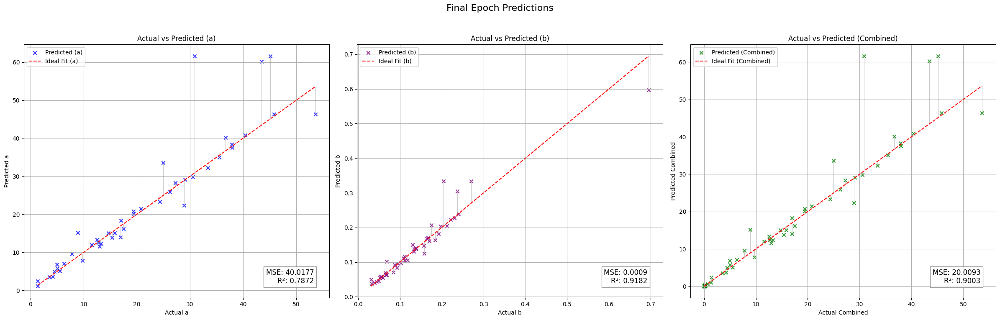

Validation Metrics:
  - MSE: 9.2915
  - R²: 0.9261
  - MAE: 1.0969
  - Explained Variance Score (EVS): 0.9289
Fold 4 Metrics:
  - Validation Loss (MSE): 9.2915
  - R²: 0.9261
  - MAE: 1.0969
  - EVS: 0.9289
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.05it/s, loss=0.212]


Validation Metrics:
  - MSE: 35.6209
  - R²: 0.8288
  - MAE: 1.6214
  - Explained Variance Score (EVS): 0.8314
Epoch [1/50], Train Loss: 0.2152, Val Loss: 35.6209
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.10it/s, loss=0.231]


Validation Metrics:
  - MSE: 35.5550
  - R²: 0.8282
  - MAE: 1.5820
  - Explained Variance Score (EVS): 0.8311
Epoch [2/50], Train Loss: 0.2250, Val Loss: 35.5550
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.63it/s, loss=0.207]


Validation Metrics:
  - MSE: 34.8430
  - R²: 0.8302
  - MAE: 1.5451
  - Explained Variance Score (EVS): 0.8329
Epoch [3/50], Train Loss: 0.2014, Val Loss: 34.8430
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.92it/s, loss=0.189]


Validation Metrics:
  - MSE: 34.4963
  - R²: 0.8315
  - MAE: 1.5131
  - Explained Variance Score (EVS): 0.8342
Epoch [4/50], Train Loss: 0.2006, Val Loss: 34.4963
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=0.229]


Validation Metrics:
  - MSE: 34.9855
  - R²: 0.8292
  - MAE: 1.5014
  - Explained Variance Score (EVS): 0.8319
Epoch [5/50], Train Loss: 0.2034, Val Loss: 34.9855
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.89it/s, loss=0.224]


Validation Metrics:
  - MSE: 34.3597
  - R²: 0.8319
  - MAE: 1.4739
  - Explained Variance Score (EVS): 0.8339
Epoch [6/50], Train Loss: 0.2038, Val Loss: 34.3597
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.91it/s, loss=0.212]


Validation Metrics:
  - MSE: 34.3440
  - R²: 0.8314
  - MAE: 1.4674
  - Explained Variance Score (EVS): 0.8337
Epoch [7/50], Train Loss: 0.2085, Val Loss: 34.3440
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.71it/s, loss=0.195]


Validation Metrics:
  - MSE: 34.0835
  - R²: 0.8319
  - MAE: 1.4579
  - Explained Variance Score (EVS): 0.8344
Epoch [8/50], Train Loss: 0.2005, Val Loss: 34.0835
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.30it/s, loss=0.216]


Validation Metrics:
  - MSE: 34.0392
  - R²: 0.8314
  - MAE: 1.4539
  - Explained Variance Score (EVS): 0.8342
Epoch [9/50], Train Loss: 0.1989, Val Loss: 34.0392
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.227]


Validation Metrics:
  - MSE: 34.0307
  - R²: 0.8315
  - MAE: 1.4474
  - Explained Variance Score (EVS): 0.8344
Epoch [10/50], Train Loss: 0.2046, Val Loss: 34.0307
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s, loss=0.224]


Validation Metrics:
  - MSE: 33.9872
  - R²: 0.8316
  - MAE: 1.4449
  - Explained Variance Score (EVS): 0.8347
Epoch [11/50], Train Loss: 0.1976, Val Loss: 33.9872
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=0.241]


Validation Metrics:
  - MSE: 34.0824
  - R²: 0.8300
  - MAE: 1.4543
  - Explained Variance Score (EVS): 0.8341
Epoch [12/50], Train Loss: 0.2055, Val Loss: 34.0824
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.24]


Validation Metrics:
  - MSE: 34.0507
  - R²: 0.8299
  - MAE: 1.4553
  - Explained Variance Score (EVS): 0.8343
Epoch [13/50], Train Loss: 0.2029, Val Loss: 34.0507
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=0.204]


Validation Metrics:
  - MSE: 33.9777
  - R²: 0.8303
  - MAE: 1.4545
  - Explained Variance Score (EVS): 0.8342
Epoch [14/50], Train Loss: 0.2031, Val Loss: 33.9777
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.21]


Validation Metrics:
  - MSE: 33.5225
  - R²: 0.8324
  - MAE: 1.4555
  - Explained Variance Score (EVS): 0.8354
Epoch [15/50], Train Loss: 0.2043, Val Loss: 33.5225
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.191]


Validation Metrics:
  - MSE: 33.8517
  - R²: 0.8310
  - MAE: 1.4623
  - Explained Variance Score (EVS): 0.8341
Epoch [16/50], Train Loss: 0.1873, Val Loss: 33.8517
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.49it/s, loss=0.178]


Validation Metrics:
  - MSE: 34.0263
  - R²: 0.8301
  - MAE: 1.4680
  - Explained Variance Score (EVS): 0.8336
Epoch [17/50], Train Loss: 0.1845, Val Loss: 34.0263
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.96it/s, loss=0.181]


Validation Metrics:
  - MSE: 34.1954
  - R²: 0.8295
  - MAE: 1.4689
  - Explained Variance Score (EVS): 0.8328
Epoch [18/50], Train Loss: 0.1880, Val Loss: 34.1954
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.64it/s, loss=0.164]


Validation Metrics:
  - MSE: 34.0413
  - R²: 0.8302
  - MAE: 1.4690
  - Explained Variance Score (EVS): 0.8331
Epoch [19/50], Train Loss: 0.1900, Val Loss: 34.0413
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.189]


Validation Metrics:
  - MSE: 34.1678
  - R²: 0.8292
  - MAE: 1.4700
  - Explained Variance Score (EVS): 0.8324
Epoch [20/50], Train Loss: 0.1813, Val Loss: 34.1678
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.08it/s, loss=0.189]


Validation Metrics:
  - MSE: 34.2954
  - R²: 0.8282
  - MAE: 1.4699
  - Explained Variance Score (EVS): 0.8316
Epoch [21/50], Train Loss: 0.1843, Val Loss: 34.2954
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  8.12it/s, loss=0.159]


Validation Metrics:
  - MSE: 34.1414
  - R²: 0.8285
  - MAE: 1.4706
  - Explained Variance Score (EVS): 0.8318
Epoch [22/50], Train Loss: 0.1769, Val Loss: 34.1414
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=0.169]


Validation Metrics:
  - MSE: 34.0572
  - R²: 0.8291
  - MAE: 1.4670
  - Explained Variance Score (EVS): 0.8322
Epoch [23/50], Train Loss: 0.1884, Val Loss: 34.0572
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=0.18]


Validation Metrics:
  - MSE: 34.1503
  - R²: 0.8286
  - MAE: 1.4680
  - Explained Variance Score (EVS): 0.8316
Epoch [24/50], Train Loss: 0.1885, Val Loss: 34.1503
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  7.10it/s, loss=0.177]


Validation Metrics:
  - MSE: 34.1694
  - R²: 0.8287
  - MAE: 1.4626
  - Explained Variance Score (EVS): 0.8321
Epoch [25/50], Train Loss: 0.1864, Val Loss: 34.1694
Current Dropout Rate: 0.3080
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


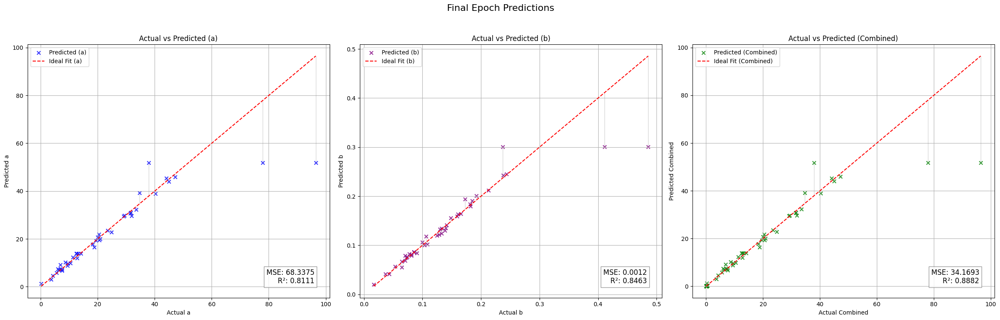

[I 2024-12-01 17:11:00,615] Trial 13 finished with value: 22.75515365600586 and parameters: {'num_layers': 1, 'hidden_size_0': 303, 'activation_0': 'ReLU', 'dropout_0': 0.4780696546356966, 'batch_size': 64, 'learning_rate': 1.0108844078254612e-05, 'optimizer': 'AdamW'}. Best is trial 13 with value: 22.75515365600586.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 33.5225
  - R²: 0.8324
  - MAE: 1.4555
  - Explained Variance Score (EVS): 0.8354
Fold 5 Metrics:
  - Validation Loss (MSE): 33.5225
  - R²: 0.8324
  - MAE: 1.4555
  - EVS: 0.8354
Avg Validation Metrics:
  - MSE: 22.7552
  - R²: 0.8647
  - MAE: 1.6406
  - EVS: 0.8676
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  7.13it/s, loss=1.19]


Validation Metrics:
  - MSE: 190.5327
  - R²: 0.0241
  - MAE: 6.4031
  - Explained Variance Score (EVS): 0.0340
Epoch [1/50], Train Loss: 1.2404, Val Loss: 190.5327
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.99it/s, loss=1.09]


Validation Metrics:
  - MSE: 184.0979
  - R²: 0.0520
  - MAE: 6.3345
  - Explained Variance Score (EVS): 0.0590
Epoch [2/50], Train Loss: 1.1050, Val Loss: 184.0979
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=1.01]


Validation Metrics:
  - MSE: 181.8389
  - R²: 0.0594
  - MAE: 6.3174
  - Explained Variance Score (EVS): 0.0670
Epoch [3/50], Train Loss: 1.0615, Val Loss: 181.8389
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.984]


Validation Metrics:
  - MSE: 181.8894
  - R²: 0.0599
  - MAE: 6.3161
  - Explained Variance Score (EVS): 0.0691
Epoch [4/50], Train Loss: 1.0154, Val Loss: 181.8894
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.988]


Validation Metrics:
  - MSE: 182.6765
  - R²: 0.0675
  - MAE: 6.2854
  - Explained Variance Score (EVS): 0.0783
Epoch [5/50], Train Loss: 0.9958, Val Loss: 182.6765
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.986]


Validation Metrics:
  - MSE: 180.7933
  - R²: 0.0868
  - MAE: 6.2032
  - Explained Variance Score (EVS): 0.0980
Epoch [6/50], Train Loss: 0.9698, Val Loss: 180.7933
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s, loss=0.878]


Validation Metrics:
  - MSE: 171.9535
  - R²: 0.1237
  - MAE: 6.0447
  - Explained Variance Score (EVS): 0.1332
Epoch [7/50], Train Loss: 0.9319, Val Loss: 171.9535
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.899]


Validation Metrics:
  - MSE: 163.1097
  - R²: 0.1575
  - MAE: 5.8959
  - Explained Variance Score (EVS): 0.1656
Epoch [8/50], Train Loss: 0.8909, Val Loss: 163.1097
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.74it/s, loss=0.87]


Validation Metrics:
  - MSE: 158.7735
  - R²: 0.1782
  - MAE: 5.8007
  - Explained Variance Score (EVS): 0.1865
Epoch [9/50], Train Loss: 0.8814, Val Loss: 158.7735
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.40it/s, loss=0.867]


Validation Metrics:
  - MSE: 158.5502
  - R²: 0.1995
  - MAE: 5.7536
  - Explained Variance Score (EVS): 0.2083
Epoch [10/50], Train Loss: 0.8683, Val Loss: 158.5502
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.08it/s, loss=0.824]


Validation Metrics:
  - MSE: 154.2622
  - R²: 0.2357
  - MAE: 5.6312
  - Explained Variance Score (EVS): 0.2445
Epoch [11/50], Train Loss: 0.8447, Val Loss: 154.2622
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.30it/s, loss=0.815]


Validation Metrics:
  - MSE: 146.7909
  - R²: 0.2656
  - MAE: 5.4483
  - Explained Variance Score (EVS): 0.2763
Epoch [12/50], Train Loss: 0.8199, Val Loss: 146.7909
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=0.832]


Validation Metrics:
  - MSE: 136.9855
  - R²: 0.3034
  - MAE: 5.2715
  - Explained Variance Score (EVS): 0.3163
Epoch [13/50], Train Loss: 0.8044, Val Loss: 136.9855
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.66it/s, loss=0.821]


Validation Metrics:
  - MSE: 127.6607
  - R²: 0.3476
  - MAE: 5.1136
  - Explained Variance Score (EVS): 0.3582
Epoch [14/50], Train Loss: 0.7805, Val Loss: 127.6607
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  7.18it/s, loss=0.734]


Validation Metrics:
  - MSE: 124.5737
  - R²: 0.3813
  - MAE: 5.0266
  - Explained Variance Score (EVS): 0.3904
Epoch [15/50], Train Loss: 0.7536, Val Loss: 124.5737
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s, loss=0.707]


Validation Metrics:
  - MSE: 126.7708
  - R²: 0.4080
  - MAE: 4.9954
  - Explained Variance Score (EVS): 0.4189
Epoch [16/50], Train Loss: 0.7198, Val Loss: 126.7708
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.55it/s, loss=0.779]


Validation Metrics:
  - MSE: 110.1557
  - R²: 0.4768
  - MAE: 4.7052
  - Explained Variance Score (EVS): 0.4848
Epoch [17/50], Train Loss: 0.7126, Val Loss: 110.1557
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.91it/s, loss=0.733]


Validation Metrics:
  - MSE: 90.9927
  - R²: 0.5440
  - MAE: 4.4096
  - Explained Variance Score (EVS): 0.5514
Epoch [18/50], Train Loss: 0.6800, Val Loss: 90.9927
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.69it/s, loss=0.642]


Validation Metrics:
  - MSE: 78.4506
  - R²: 0.5840
  - MAE: 4.1104
  - Explained Variance Score (EVS): 0.5897
Epoch [19/50], Train Loss: 0.6580, Val Loss: 78.4506
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  7.62it/s, loss=0.613]


Validation Metrics:
  - MSE: 76.7383
  - R²: 0.5893
  - MAE: 3.9504
  - Explained Variance Score (EVS): 0.5968
Epoch [20/50], Train Loss: 0.6315, Val Loss: 76.7383
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  7.08it/s, loss=0.598]


Validation Metrics:
  - MSE: 76.3113
  - R²: 0.6104
  - MAE: 3.9219
  - Explained Variance Score (EVS): 0.6213
Epoch [21/50], Train Loss: 0.6055, Val Loss: 76.3113
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  7.06it/s, loss=0.608]


Validation Metrics:
  - MSE: 73.7195
  - R²: 0.6369
  - MAE: 3.8579
  - Explained Variance Score (EVS): 0.6501
Epoch [22/50], Train Loss: 0.5902, Val Loss: 73.7195
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=0.597]


Validation Metrics:
  - MSE: 70.4807
  - R²: 0.6569
  - MAE: 3.7784
  - Explained Variance Score (EVS): 0.6700
Epoch [23/50], Train Loss: 0.5705, Val Loss: 70.4807
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=0.6]


Validation Metrics:
  - MSE: 65.3228
  - R²: 0.6794
  - MAE: 3.6972
  - Explained Variance Score (EVS): 0.6873
Epoch [24/50], Train Loss: 0.5399, Val Loss: 65.3228
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.465]


Validation Metrics:
  - MSE: 64.8340
  - R²: 0.6905
  - MAE: 3.6395
  - Explained Variance Score (EVS): 0.6958
Epoch [25/50], Train Loss: 0.5072, Val Loss: 64.8340
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.451]


Validation Metrics:
  - MSE: 63.9001
  - R²: 0.7001
  - MAE: 3.6177
  - Explained Variance Score (EVS): 0.7058
Epoch [26/50], Train Loss: 0.4862, Val Loss: 63.9001
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=0.469]


Validation Metrics:
  - MSE: 63.2380
  - R²: 0.6965
  - MAE: 3.5840
  - Explained Variance Score (EVS): 0.7020
Epoch [27/50], Train Loss: 0.4754, Val Loss: 63.2380
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.436]


Validation Metrics:
  - MSE: 65.3616
  - R²: 0.6792
  - MAE: 3.5489
  - Explained Variance Score (EVS): 0.6940
Epoch [28/50], Train Loss: 0.4421, Val Loss: 65.3616
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.429]


Validation Metrics:
  - MSE: 66.8953
  - R²: 0.6755
  - MAE: 3.5425
  - Explained Variance Score (EVS): 0.6913
Epoch [29/50], Train Loss: 0.4296, Val Loss: 66.8953
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.38it/s, loss=0.403]


Validation Metrics:
  - MSE: 68.4059
  - R²: 0.6755
  - MAE: 3.5141
  - Explained Variance Score (EVS): 0.6908
Epoch [30/50], Train Loss: 0.3987, Val Loss: 68.4059
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.342]


Validation Metrics:
  - MSE: 61.1794
  - R²: 0.7068
  - MAE: 3.4460
  - Explained Variance Score (EVS): 0.7140
Epoch [31/50], Train Loss: 0.3788, Val Loss: 61.1794
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=0.36]


Validation Metrics:
  - MSE: 54.5447
  - R²: 0.7310
  - MAE: 3.4268
  - Explained Variance Score (EVS): 0.7322
Epoch [32/50], Train Loss: 0.3595, Val Loss: 54.5447
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=0.369]


Validation Metrics:
  - MSE: 50.9687
  - R²: 0.7520
  - MAE: 3.4981
  - Explained Variance Score (EVS): 0.7528
Epoch [33/50], Train Loss: 0.3487, Val Loss: 50.9687
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  7.61it/s, loss=0.313]


Validation Metrics:
  - MSE: 52.7699
  - R²: 0.7416
  - MAE: 3.4227
  - Explained Variance Score (EVS): 0.7426
Epoch [34/50], Train Loss: 0.3269, Val Loss: 52.7699
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=0.309]


Validation Metrics:
  - MSE: 61.5322
  - R²: 0.6988
  - MAE: 3.4138
  - Explained Variance Score (EVS): 0.7061
Epoch [35/50], Train Loss: 0.3104, Val Loss: 61.5322
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  6.85it/s, loss=0.298]


Validation Metrics:
  - MSE: 73.4989
  - R²: 0.6391
  - MAE: 3.5895
  - Explained Variance Score (EVS): 0.6549
Epoch [36/50], Train Loss: 0.2908, Val Loss: 73.4989
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  7.18it/s, loss=0.242]


Validation Metrics:
  - MSE: 71.9250
  - R²: 0.6530
  - MAE: 3.5645
  - Explained Variance Score (EVS): 0.6659
Epoch [37/50], Train Loss: 0.2725, Val Loss: 71.9250
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  7.24it/s, loss=0.305]


Validation Metrics:
  - MSE: 63.6966
  - R²: 0.6878
  - MAE: 3.4743
  - Explained Variance Score (EVS): 0.6999
Epoch [38/50], Train Loss: 0.2731, Val Loss: 63.6966
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  7.17it/s, loss=0.21]


Validation Metrics:
  - MSE: 56.0227
  - R²: 0.7098
  - MAE: 3.4588
  - Explained Variance Score (EVS): 0.7161
Epoch [39/50], Train Loss: 0.2523, Val Loss: 56.0227
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  7.32it/s, loss=0.239]


Validation Metrics:
  - MSE: 53.1544
  - R²: 0.7260
  - MAE: 3.3975
  - Explained Variance Score (EVS): 0.7302
Epoch [40/50], Train Loss: 0.2371, Val Loss: 53.1544
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  6.49it/s, loss=0.239]


Validation Metrics:
  - MSE: 55.4508
  - R²: 0.7094
  - MAE: 3.4663
  - Explained Variance Score (EVS): 0.7130
Epoch [41/50], Train Loss: 0.2346, Val Loss: 55.4508
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.2]


Validation Metrics:
  - MSE: 62.1188
  - R²: 0.6802
  - MAE: 3.5513
  - Explained Variance Score (EVS): 0.6891
Epoch [42/50], Train Loss: 0.2120, Val Loss: 62.1188
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.25]


Validation Metrics:
  - MSE: 72.4611
  - R²: 0.6390
  - MAE: 3.6133
  - Explained Variance Score (EVS): 0.6636
Epoch [43/50], Train Loss: 0.2136, Val Loss: 72.4611
Current Dropout Rate: 0.1640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


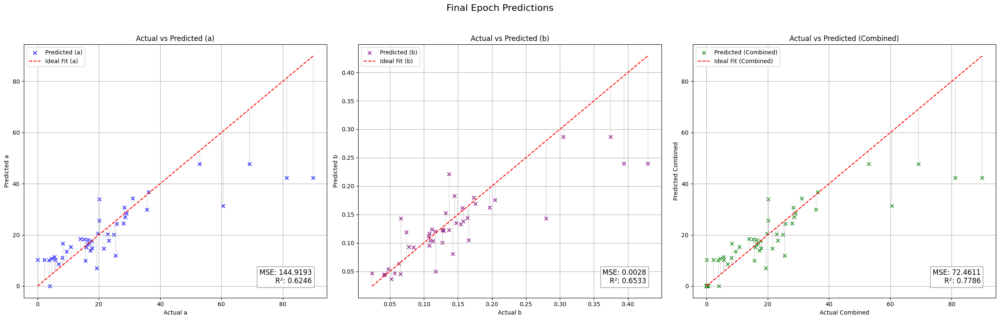

Validation Metrics:
  - MSE: 50.9687
  - R²: 0.7520
  - MAE: 3.4981
  - Explained Variance Score (EVS): 0.7528
Fold 1 Metrics:
  - Validation Loss (MSE): 50.9687
  - R²: 0.7520
  - MAE: 3.4981
  - EVS: 0.7528
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.15it/s, loss=0.414]


Validation Metrics:
  - MSE: 4.2781
  - R²: 0.9592
  - MAE: 1.1711
  - Explained Variance Score (EVS): 0.9682
Epoch [1/50], Train Loss: 0.3829, Val Loss: 4.2781
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.338]


Validation Metrics:
  - MSE: 2.7919
  - R²: 0.9630
  - MAE: 0.9350
  - Explained Variance Score (EVS): 0.9631
Epoch [2/50], Train Loss: 0.3563, Val Loss: 2.7919
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.419]


Validation Metrics:
  - MSE: 3.7716
  - R²: 0.9530
  - MAE: 0.9583
  - Explained Variance Score (EVS): 0.9580
Epoch [3/50], Train Loss: 0.3815, Val Loss: 3.7716
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.312]


Validation Metrics:
  - MSE: 3.3553
  - R²: 0.9497
  - MAE: 0.8406
  - Explained Variance Score (EVS): 0.9526
Epoch [4/50], Train Loss: 0.3381, Val Loss: 3.3553
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.48it/s, loss=0.366]


Validation Metrics:
  - MSE: 3.1701
  - R²: 0.9446
  - MAE: 0.9223
  - Explained Variance Score (EVS): 0.9515
Epoch [5/50], Train Loss: 0.3220, Val Loss: 3.1701
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.58it/s, loss=0.317]


Validation Metrics:
  - MSE: 4.3700
  - R²: 0.9296
  - MAE: 1.1411
  - Explained Variance Score (EVS): 0.9400
Epoch [6/50], Train Loss: 0.2981, Val Loss: 4.3700
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.324]


Validation Metrics:
  - MSE: 4.2430
  - R²: 0.9241
  - MAE: 1.1325
  - Explained Variance Score (EVS): 0.9300
Epoch [7/50], Train Loss: 0.2898, Val Loss: 4.2430
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=0.257]


Validation Metrics:
  - MSE: 3.8359
  - R²: 0.9124
  - MAE: 1.0553
  - Explained Variance Score (EVS): 0.9182
Epoch [8/50], Train Loss: 0.2795, Val Loss: 3.8359
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.84it/s, loss=0.273]


Validation Metrics:
  - MSE: 4.0205
  - R²: 0.9047
  - MAE: 1.0563
  - Explained Variance Score (EVS): 0.9061
Epoch [9/50], Train Loss: 0.2764, Val Loss: 4.0205
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.43it/s, loss=0.313]


Validation Metrics:
  - MSE: 5.0695
  - R²: 0.8931
  - MAE: 1.1561
  - Explained Variance Score (EVS): 0.8962
Epoch [10/50], Train Loss: 0.2596, Val Loss: 5.0695
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  7.31it/s, loss=0.252]


Validation Metrics:
  - MSE: 4.6512
  - R²: 0.8953
  - MAE: 1.0878
  - Explained Variance Score (EVS): 0.9004
Epoch [11/50], Train Loss: 0.2475, Val Loss: 4.6512
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=0.239]


Validation Metrics:
  - MSE: 4.0391
  - R²: 0.9043
  - MAE: 1.0092
  - Explained Variance Score (EVS): 0.9126
Epoch [12/50], Train Loss: 0.2459, Val Loss: 4.0391
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


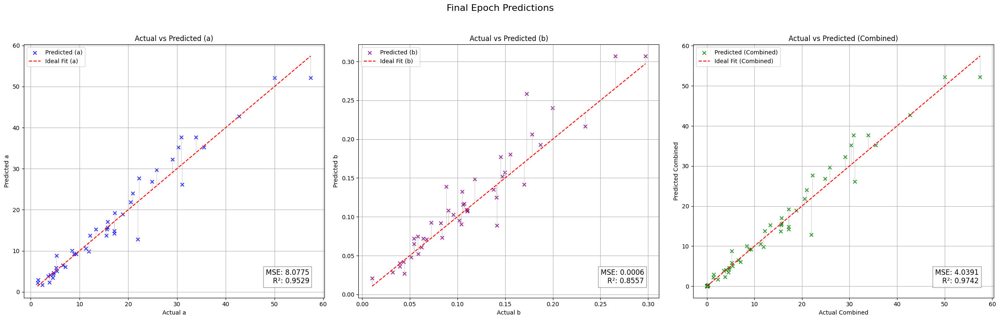

Validation Metrics:
  - MSE: 2.7919
  - R²: 0.9630
  - MAE: 0.9350
  - Explained Variance Score (EVS): 0.9631
Fold 2 Metrics:
  - Validation Loss (MSE): 2.7919
  - R²: 0.9630
  - MAE: 0.9350
  - EVS: 0.9631
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.378]


Validation Metrics:
  - MSE: 14.4828
  - R²: 0.8840
  - MAE: 1.3613
  - Explained Variance Score (EVS): 0.8841
Epoch [1/50], Train Loss: 0.3476, Val Loss: 14.4828
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.353]


Validation Metrics:
  - MSE: 14.6119
  - R²: 0.8802
  - MAE: 1.3304
  - Explained Variance Score (EVS): 0.8812
Epoch [2/50], Train Loss: 0.3289, Val Loss: 14.6119
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.311]


Validation Metrics:
  - MSE: 14.9753
  - R²: 0.8731
  - MAE: 1.3586
  - Explained Variance Score (EVS): 0.8767
Epoch [3/50], Train Loss: 0.3129, Val Loss: 14.9753
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.40it/s, loss=0.283]


Validation Metrics:
  - MSE: 16.1213
  - R²: 0.8597
  - MAE: 1.3638
  - Explained Variance Score (EVS): 0.8657
Epoch [4/50], Train Loss: 0.2978, Val Loss: 16.1213
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.338]


Validation Metrics:
  - MSE: 16.7289
  - R²: 0.8537
  - MAE: 1.3459
  - Explained Variance Score (EVS): 0.8557
Epoch [5/50], Train Loss: 0.3153, Val Loss: 16.7289
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.269]


Validation Metrics:
  - MSE: 17.4818
  - R²: 0.8476
  - MAE: 1.3769
  - Explained Variance Score (EVS): 0.8484
Epoch [6/50], Train Loss: 0.2786, Val Loss: 17.4818
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.348]


Validation Metrics:
  - MSE: 18.2898
  - R²: 0.8457
  - MAE: 1.3760
  - Explained Variance Score (EVS): 0.8462
Epoch [7/50], Train Loss: 0.2944, Val Loss: 18.2898
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.305]


Validation Metrics:
  - MSE: 18.5689
  - R²: 0.8469
  - MAE: 1.4135
  - Explained Variance Score (EVS): 0.8475
Epoch [8/50], Train Loss: 0.2883, Val Loss: 18.5689
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=0.293]


Validation Metrics:
  - MSE: 17.6891
  - R²: 0.8551
  - MAE: 1.3856
  - Explained Variance Score (EVS): 0.8553
Epoch [9/50], Train Loss: 0.2694, Val Loss: 17.6891
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  7.25it/s, loss=0.259]


Validation Metrics:
  - MSE: 17.4292
  - R²: 0.8566
  - MAE: 1.3853
  - Explained Variance Score (EVS): 0.8569
Epoch [10/50], Train Loss: 0.2680, Val Loss: 17.4292
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.92it/s, loss=0.25]


Validation Metrics:
  - MSE: 17.3042
  - R²: 0.8576
  - MAE: 1.3677
  - Explained Variance Score (EVS): 0.8581
Epoch [11/50], Train Loss: 0.2624, Val Loss: 17.3042
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


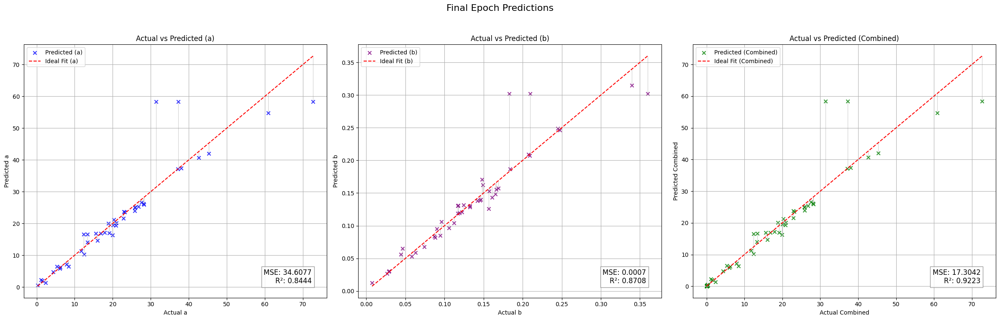

Validation Metrics:
  - MSE: 14.4828
  - R²: 0.8840
  - MAE: 1.3613
  - Explained Variance Score (EVS): 0.8841
Fold 3 Metrics:
  - Validation Loss (MSE): 14.4828
  - R²: 0.8840
  - MAE: 1.3613
  - EVS: 0.8841
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s, loss=0.32]


Validation Metrics:
  - MSE: 11.5873
  - R²: 0.8896
  - MAE: 1.3397
  - Explained Variance Score (EVS): 0.8956
Epoch [1/50], Train Loss: 0.3330, Val Loss: 11.5873
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.87it/s, loss=0.302]


Validation Metrics:
  - MSE: 13.2591
  - R²: 0.8799
  - MAE: 1.4263
  - Explained Variance Score (EVS): 0.8895
Epoch [2/50], Train Loss: 0.3319, Val Loss: 13.2591
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.75it/s, loss=0.293]


Validation Metrics:
  - MSE: 14.5271
  - R²: 0.8714
  - MAE: 1.4538
  - Explained Variance Score (EVS): 0.8823
Epoch [3/50], Train Loss: 0.3167, Val Loss: 14.5271
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s, loss=0.277]


Validation Metrics:
  - MSE: 16.0765
  - R²: 0.8594
  - MAE: 1.5047
  - Explained Variance Score (EVS): 0.8727
Epoch [4/50], Train Loss: 0.3171, Val Loss: 16.0765
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.20it/s, loss=0.328]


Validation Metrics:
  - MSE: 16.6178
  - R²: 0.8535
  - MAE: 1.4659
  - Explained Variance Score (EVS): 0.8639
Epoch [5/50], Train Loss: 0.3155, Val Loss: 16.6178
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.80it/s, loss=0.278]


Validation Metrics:
  - MSE: 17.2268
  - R²: 0.8489
  - MAE: 1.4829
  - Explained Variance Score (EVS): 0.8580
Epoch [6/50], Train Loss: 0.2933, Val Loss: 17.2268
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.22it/s, loss=0.302]


Validation Metrics:
  - MSE: 18.3224
  - R²: 0.8407
  - MAE: 1.5156
  - Explained Variance Score (EVS): 0.8489
Epoch [7/50], Train Loss: 0.3008, Val Loss: 18.3224
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=0.368]


Validation Metrics:
  - MSE: 18.1488
  - R²: 0.8412
  - MAE: 1.4841
  - Explained Variance Score (EVS): 0.8473
Epoch [8/50], Train Loss: 0.3098, Val Loss: 18.1488
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.41it/s, loss=0.319]


Validation Metrics:
  - MSE: 17.6694
  - R²: 0.8424
  - MAE: 1.4630
  - Explained Variance Score (EVS): 0.8477
Epoch [9/50], Train Loss: 0.2961, Val Loss: 17.6694
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.3]


Validation Metrics:
  - MSE: 17.6459
  - R²: 0.8413
  - MAE: 1.4596
  - Explained Variance Score (EVS): 0.8467
Epoch [10/50], Train Loss: 0.3010, Val Loss: 17.6459
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.237]


Validation Metrics:
  - MSE: 18.0958
  - R²: 0.8384
  - MAE: 1.4721
  - Explained Variance Score (EVS): 0.8451
Epoch [11/50], Train Loss: 0.2786, Val Loss: 18.0958
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


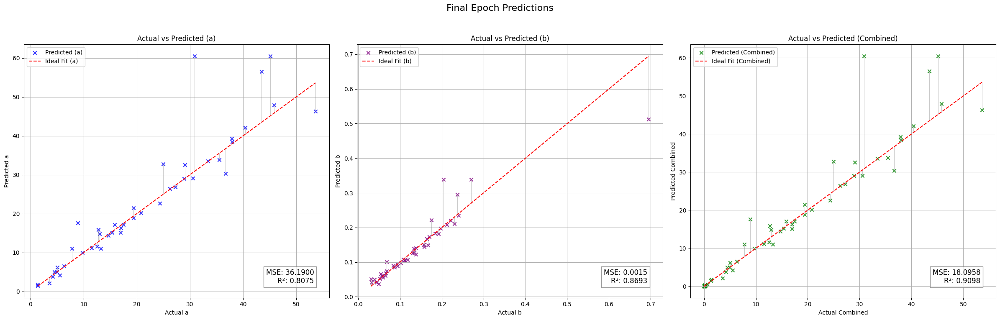

Validation Metrics:
  - MSE: 11.5873
  - R²: 0.8896
  - MAE: 1.3397
  - Explained Variance Score (EVS): 0.8956
Fold 4 Metrics:
  - Validation Loss (MSE): 11.5873
  - R²: 0.8896
  - MAE: 1.3397
  - EVS: 0.8956
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.365]


Validation Metrics:
  - MSE: 35.0650
  - R²: 0.8276
  - MAE: 1.7487
  - Explained Variance Score (EVS): 0.8313
Epoch [1/50], Train Loss: 0.3356, Val Loss: 35.0650
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.366]


Validation Metrics:
  - MSE: 34.5540
  - R²: 0.8298
  - MAE: 1.7166
  - Explained Variance Score (EVS): 0.8330
Epoch [2/50], Train Loss: 0.3333, Val Loss: 34.5540
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.95it/s, loss=0.309]


Validation Metrics:
  - MSE: 33.6087
  - R²: 0.8331
  - MAE: 1.6673
  - Explained Variance Score (EVS): 0.8355
Epoch [3/50], Train Loss: 0.3220, Val Loss: 33.6087
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.63it/s, loss=0.343]


Validation Metrics:
  - MSE: 32.6150
  - R²: 0.8366
  - MAE: 1.6095
  - Explained Variance Score (EVS): 0.8382
Epoch [4/50], Train Loss: 0.3223, Val Loss: 32.6150
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=0.315]


Validation Metrics:
  - MSE: 32.1949
  - R²: 0.8380
  - MAE: 1.5552
  - Explained Variance Score (EVS): 0.8393
Epoch [5/50], Train Loss: 0.3126, Val Loss: 32.1949
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.96it/s, loss=0.299]


Validation Metrics:
  - MSE: 32.0198
  - R²: 0.8385
  - MAE: 1.5051
  - Explained Variance Score (EVS): 0.8396
Epoch [6/50], Train Loss: 0.3078, Val Loss: 32.0198
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.36it/s, loss=0.374]


Validation Metrics:
  - MSE: 32.3623
  - R²: 0.8362
  - MAE: 1.4674
  - Explained Variance Score (EVS): 0.8383
Epoch [7/50], Train Loss: 0.3289, Val Loss: 32.3623
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.90it/s, loss=0.307]


Validation Metrics:
  - MSE: 32.2804
  - R²: 0.8353
  - MAE: 1.4379
  - Explained Variance Score (EVS): 0.8384
Epoch [8/50], Train Loss: 0.3032, Val Loss: 32.2804
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  7.36it/s, loss=0.354]


Validation Metrics:
  - MSE: 32.1906
  - R²: 0.8349
  - MAE: 1.4278
  - Explained Variance Score (EVS): 0.8382
Epoch [9/50], Train Loss: 0.3131, Val Loss: 32.1906
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.87it/s, loss=0.329]


Validation Metrics:
  - MSE: 32.1833
  - R²: 0.8345
  - MAE: 1.4240
  - Explained Variance Score (EVS): 0.8383
Epoch [10/50], Train Loss: 0.2907, Val Loss: 32.1833
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.74it/s, loss=0.267]


Validation Metrics:
  - MSE: 32.5164
  - R²: 0.8336
  - MAE: 1.4229
  - Explained Variance Score (EVS): 0.8376
Epoch [11/50], Train Loss: 0.2939, Val Loss: 32.5164
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.67it/s, loss=0.337]


Validation Metrics:
  - MSE: 32.8677
  - R²: 0.8318
  - MAE: 1.4294
  - Explained Variance Score (EVS): 0.8370
Epoch [12/50], Train Loss: 0.3022, Val Loss: 32.8677
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.77it/s, loss=0.272]


Validation Metrics:
  - MSE: 32.4617
  - R²: 0.8342
  - MAE: 1.4164
  - Explained Variance Score (EVS): 0.8387
Epoch [13/50], Train Loss: 0.2875, Val Loss: 32.4617
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=0.296]


Validation Metrics:
  - MSE: 32.1400
  - R²: 0.8362
  - MAE: 1.4056
  - Explained Variance Score (EVS): 0.8406
Epoch [14/50], Train Loss: 0.2969, Val Loss: 32.1400
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.273]


Validation Metrics:
  - MSE: 31.8600
  - R²: 0.8382
  - MAE: 1.3946
  - Explained Variance Score (EVS): 0.8418
Epoch [15/50], Train Loss: 0.2872, Val Loss: 31.8600
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  6.52it/s, loss=0.302]


Validation Metrics:
  - MSE: 32.0556
  - R²: 0.8368
  - MAE: 1.4010
  - Explained Variance Score (EVS): 0.8410
Epoch [16/50], Train Loss: 0.2946, Val Loss: 32.0556
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.301]


Validation Metrics:
  - MSE: 32.3972
  - R²: 0.8352
  - MAE: 1.4042
  - Explained Variance Score (EVS): 0.8397
Epoch [17/50], Train Loss: 0.2900, Val Loss: 32.3972
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.319]


Validation Metrics:
  - MSE: 32.9077
  - R²: 0.8323
  - MAE: 1.4102
  - Explained Variance Score (EVS): 0.8374
Epoch [18/50], Train Loss: 0.2918, Val Loss: 32.9077
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.283]


Validation Metrics:
  - MSE: 32.6466
  - R²: 0.8333
  - MAE: 1.3985
  - Explained Variance Score (EVS): 0.8376
Epoch [19/50], Train Loss: 0.2869, Val Loss: 32.6466
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=0.354]


Validation Metrics:
  - MSE: 33.2303
  - R²: 0.8301
  - MAE: 1.4067
  - Explained Variance Score (EVS): 0.8354
Epoch [20/50], Train Loss: 0.2903, Val Loss: 33.2303
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s, loss=0.272]


Validation Metrics:
  - MSE: 33.3612
  - R²: 0.8295
  - MAE: 1.4100
  - Explained Variance Score (EVS): 0.8350
Epoch [21/50], Train Loss: 0.2774, Val Loss: 33.3612
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  7.05it/s, loss=0.291]


Validation Metrics:
  - MSE: 33.2763
  - R²: 0.8299
  - MAE: 1.4059
  - Explained Variance Score (EVS): 0.8352
Epoch [22/50], Train Loss: 0.2899, Val Loss: 33.2763
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.90it/s, loss=0.27]


Validation Metrics:
  - MSE: 33.2256
  - R²: 0.8297
  - MAE: 1.4021
  - Explained Variance Score (EVS): 0.8351
Epoch [23/50], Train Loss: 0.2706, Val Loss: 33.2256
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.78it/s, loss=0.264]


Validation Metrics:
  - MSE: 33.3038
  - R²: 0.8296
  - MAE: 1.4026
  - Explained Variance Score (EVS): 0.8346
Epoch [24/50], Train Loss: 0.2742, Val Loss: 33.3038
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.244]


Validation Metrics:
  - MSE: 33.4380
  - R²: 0.8292
  - MAE: 1.4055
  - Explained Variance Score (EVS): 0.8344
Epoch [25/50], Train Loss: 0.2749, Val Loss: 33.4380
Current Dropout Rate: 0.3080
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


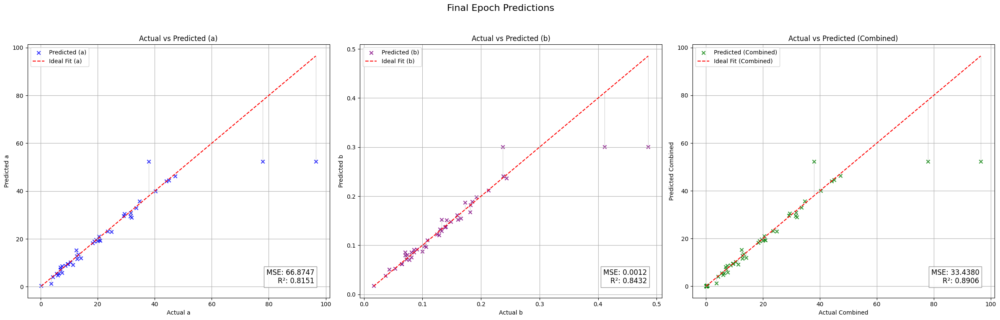

[I 2024-12-01 17:12:47,828] Trial 14 finished with value: 22.338119506835938 and parameters: {'num_layers': 1, 'hidden_size_0': 359, 'activation_0': 'ReLU', 'dropout_0': 0.4076481957628678, 'batch_size': 64, 'learning_rate': 3.006574848611112e-05, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 31.8600
  - R²: 0.8382
  - MAE: 1.3946
  - Explained Variance Score (EVS): 0.8418
Fold 5 Metrics:
  - Validation Loss (MSE): 31.8600
  - R²: 0.8382
  - MAE: 1.3946
  - EVS: 0.8418
Avg Validation Metrics:
  - MSE: 22.3381
  - R²: 0.8654
  - MAE: 1.7057
  - EVS: 0.8675
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.42it/s, loss=0.539]


Validation Metrics:
  - MSE: 191.2172
  - R²: -0.0069
  - MAE: 6.5016
  - Explained Variance Score (EVS): 0.0121
Epoch [1/50], Train Loss: 0.6914, Val Loss: 191.2172
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s, loss=0.543]


Validation Metrics:
  - MSE: 187.2443
  - R²: 0.0184
  - MAE: 6.4353
  - Explained Variance Score (EVS): 0.0333
Epoch [2/50], Train Loss: 0.5072, Val Loss: 187.2443
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  7.37it/s, loss=0.571]


Validation Metrics:
  - MSE: 183.6635
  - R²: 0.0411
  - MAE: 6.3740
  - Explained Variance Score (EVS): 0.0534
Epoch [3/50], Train Loss: 0.4628, Val Loss: 183.6635
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.32it/s, loss=0.491]


Validation Metrics:
  - MSE: 180.1879
  - R²: 0.0624
  - MAE: 6.3117
  - Explained Variance Score (EVS): 0.0733
Epoch [4/50], Train Loss: 0.4431, Val Loss: 180.1879
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.21it/s, loss=0.342]


Validation Metrics:
  - MSE: 177.3208
  - R²: 0.0829
  - MAE: 6.2496
  - Explained Variance Score (EVS): 0.0932
Epoch [5/50], Train Loss: 0.4022, Val Loss: 177.3208
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.70it/s, loss=0.342]


Validation Metrics:
  - MSE: 174.6609
  - R²: 0.1017
  - MAE: 6.1797
  - Explained Variance Score (EVS): 0.1118
Epoch [6/50], Train Loss: 0.3702, Val Loss: 174.6609
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.422]


Validation Metrics:
  - MSE: 171.3313
  - R²: 0.1177
  - MAE: 6.1095
  - Explained Variance Score (EVS): 0.1285
Epoch [7/50], Train Loss: 0.3586, Val Loss: 171.3313
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.36]


Validation Metrics:
  - MSE: 167.4206
  - R²: 0.1333
  - MAE: 6.0295
  - Explained Variance Score (EVS): 0.1443
Epoch [8/50], Train Loss: 0.3482, Val Loss: 167.4206
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s, loss=0.265]


Validation Metrics:
  - MSE: 161.3353
  - R²: 0.1582
  - MAE: 5.8971
  - Explained Variance Score (EVS): 0.1697
Epoch [9/50], Train Loss: 0.3252, Val Loss: 161.3353
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.326]


Validation Metrics:
  - MSE: 153.7024
  - R²: 0.1933
  - MAE: 5.7390
  - Explained Variance Score (EVS): 0.2043
Epoch [10/50], Train Loss: 0.3208, Val Loss: 153.7024
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.308]


Validation Metrics:
  - MSE: 146.2383
  - R²: 0.2355
  - MAE: 5.5544
  - Explained Variance Score (EVS): 0.2466
Epoch [11/50], Train Loss: 0.3001, Val Loss: 146.2383
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s, loss=0.259]


Validation Metrics:
  - MSE: 141.6579
  - R²: 0.2748
  - MAE: 5.3829
  - Explained Variance Score (EVS): 0.2860
Epoch [12/50], Train Loss: 0.2903, Val Loss: 141.6579
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.302]


Validation Metrics:
  - MSE: 137.1288
  - R²: 0.3043
  - MAE: 5.2063
  - Explained Variance Score (EVS): 0.3178
Epoch [13/50], Train Loss: 0.2834, Val Loss: 137.1288
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=0.207]


Validation Metrics:
  - MSE: 131.8717
  - R²: 0.3327
  - MAE: 5.0415
  - Explained Variance Score (EVS): 0.3478
Epoch [14/50], Train Loss: 0.2692, Val Loss: 131.8717
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.20it/s, loss=0.24]


Validation Metrics:
  - MSE: 125.5671
  - R²: 0.3718
  - MAE: 4.8420
  - Explained Variance Score (EVS): 0.3886
Epoch [15/50], Train Loss: 0.2553, Val Loss: 125.5671
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  7.05it/s, loss=0.242]


Validation Metrics:
  - MSE: 119.6080
  - R²: 0.4185
  - MAE: 4.6975
  - Explained Variance Score (EVS): 0.4338
Epoch [16/50], Train Loss: 0.2549, Val Loss: 119.6080
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.65it/s, loss=0.191]


Validation Metrics:
  - MSE: 111.5936
  - R²: 0.4655
  - MAE: 4.5477
  - Explained Variance Score (EVS): 0.4798
Epoch [17/50], Train Loss: 0.2469, Val Loss: 111.5936
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.96it/s, loss=0.204]


Validation Metrics:
  - MSE: 103.9051
  - R²: 0.4931
  - MAE: 4.3951
  - Explained Variance Score (EVS): 0.5077
Epoch [18/50], Train Loss: 0.2393, Val Loss: 103.9051
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.183]


Validation Metrics:
  - MSE: 92.4415
  - R²: 0.5495
  - MAE: 4.1911
  - Explained Variance Score (EVS): 0.5601
Epoch [19/50], Train Loss: 0.2214, Val Loss: 92.4415
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=0.247]


Validation Metrics:
  - MSE: 85.2106
  - R²: 0.5885
  - MAE: 4.0462
  - Explained Variance Score (EVS): 0.5977
Epoch [20/50], Train Loss: 0.2354, Val Loss: 85.2106
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.43it/s, loss=0.172]


Validation Metrics:
  - MSE: 79.6864
  - R²: 0.6253
  - MAE: 3.9580
  - Explained Variance Score (EVS): 0.6330
Epoch [21/50], Train Loss: 0.2126, Val Loss: 79.6864
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.90it/s, loss=0.158]


Validation Metrics:
  - MSE: 73.6464
  - R²: 0.6550
  - MAE: 3.8325
  - Explained Variance Score (EVS): 0.6627
Epoch [22/50], Train Loss: 0.1999, Val Loss: 73.6464
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=0.18]


Validation Metrics:
  - MSE: 68.4731
  - R²: 0.6765
  - MAE: 3.7407
  - Explained Variance Score (EVS): 0.6828
Epoch [23/50], Train Loss: 0.2024, Val Loss: 68.4731
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.74it/s, loss=0.154]


Validation Metrics:
  - MSE: 63.8603
  - R²: 0.6878
  - MAE: 3.6505
  - Explained Variance Score (EVS): 0.6951
Epoch [24/50], Train Loss: 0.1899, Val Loss: 63.8603
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=0.184]


Validation Metrics:
  - MSE: 60.6365
  - R²: 0.6938
  - MAE: 3.5720
  - Explained Variance Score (EVS): 0.7010
Epoch [25/50], Train Loss: 0.1888, Val Loss: 60.6365
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.131]


Validation Metrics:
  - MSE: 63.4331
  - R²: 0.6753
  - MAE: 3.5700
  - Explained Variance Score (EVS): 0.6839
Epoch [26/50], Train Loss: 0.1770, Val Loss: 63.4331
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.153]


Validation Metrics:
  - MSE: 69.6634
  - R²: 0.6589
  - MAE: 3.6050
  - Explained Variance Score (EVS): 0.6701
Epoch [27/50], Train Loss: 0.1633, Val Loss: 69.6634
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.151]


Validation Metrics:
  - MSE: 75.7307
  - R²: 0.6475
  - MAE: 3.6590
  - Explained Variance Score (EVS): 0.6618
Epoch [28/50], Train Loss: 0.1553, Val Loss: 75.7307
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.123]


Validation Metrics:
  - MSE: 73.8799
  - R²: 0.6646
  - MAE: 3.6111
  - Explained Variance Score (EVS): 0.6780
Epoch [29/50], Train Loss: 0.1493, Val Loss: 73.8799
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.241]


Validation Metrics:
  - MSE: 70.7663
  - R²: 0.6787
  - MAE: 3.5715
  - Explained Variance Score (EVS): 0.6903
Epoch [30/50], Train Loss: 0.1611, Val Loss: 70.7663
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.16]


Validation Metrics:
  - MSE: 64.4189
  - R²: 0.7024
  - MAE: 3.4910
  - Explained Variance Score (EVS): 0.7090
Epoch [31/50], Train Loss: 0.1463, Val Loss: 64.4189
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=0.184]


Validation Metrics:
  - MSE: 59.9856
  - R²: 0.7155
  - MAE: 3.4482
  - Explained Variance Score (EVS): 0.7201
Epoch [32/50], Train Loss: 0.1398, Val Loss: 59.9856
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.199]


Validation Metrics:
  - MSE: 58.0230
  - R²: 0.7190
  - MAE: 3.4306
  - Explained Variance Score (EVS): 0.7222
Epoch [33/50], Train Loss: 0.1459, Val Loss: 58.0230
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=0.111]


Validation Metrics:
  - MSE: 59.4653
  - R²: 0.7041
  - MAE: 3.4456
  - Explained Variance Score (EVS): 0.7082
Epoch [34/50], Train Loss: 0.1250, Val Loss: 59.4653
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  6.77it/s, loss=0.114]


Validation Metrics:
  - MSE: 59.7514
  - R²: 0.7053
  - MAE: 3.4617
  - Explained Variance Score (EVS): 0.7101
Epoch [35/50], Train Loss: 0.1268, Val Loss: 59.7514
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  6.80it/s, loss=0.0994]


Validation Metrics:
  - MSE: 62.3880
  - R²: 0.7040
  - MAE: 3.4808
  - Explained Variance Score (EVS): 0.7103
Epoch [36/50], Train Loss: 0.1165, Val Loss: 62.3880
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.107]


Validation Metrics:
  - MSE: 64.9975
  - R²: 0.6927
  - MAE: 3.4979
  - Explained Variance Score (EVS): 0.7027
Epoch [37/50], Train Loss: 0.1155, Val Loss: 64.9975
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.132]


Validation Metrics:
  - MSE: 64.5379
  - R²: 0.6928
  - MAE: 3.4839
  - Explained Variance Score (EVS): 0.7031
Epoch [38/50], Train Loss: 0.1130, Val Loss: 64.5379
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.0831]


Validation Metrics:
  - MSE: 65.0043
  - R²: 0.6893
  - MAE: 3.5125
  - Explained Variance Score (EVS): 0.6998
Epoch [39/50], Train Loss: 0.1065, Val Loss: 65.0043
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  6.37it/s, loss=0.0743]


Validation Metrics:
  - MSE: 66.7100
  - R²: 0.6711
  - MAE: 3.5448
  - Explained Variance Score (EVS): 0.6813
Epoch [40/50], Train Loss: 0.1055, Val Loss: 66.7100
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  6.41it/s, loss=0.0887]


Validation Metrics:
  - MSE: 66.3311
  - R²: 0.6618
  - MAE: 3.5834
  - Explained Variance Score (EVS): 0.6694
Epoch [41/50], Train Loss: 0.0990, Val Loss: 66.3311
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s, loss=0.0794]


Validation Metrics:
  - MSE: 66.9627
  - R²: 0.6634
  - MAE: 3.5749
  - Explained Variance Score (EVS): 0.6697
Epoch [42/50], Train Loss: 0.1006, Val Loss: 66.9627
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  6.65it/s, loss=0.0932]


Validation Metrics:
  - MSE: 68.6216
  - R²: 0.6615
  - MAE: 3.6071
  - Explained Variance Score (EVS): 0.6700
Epoch [43/50], Train Loss: 0.0958, Val Loss: 68.6216
Current Dropout Rate: 0.1640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


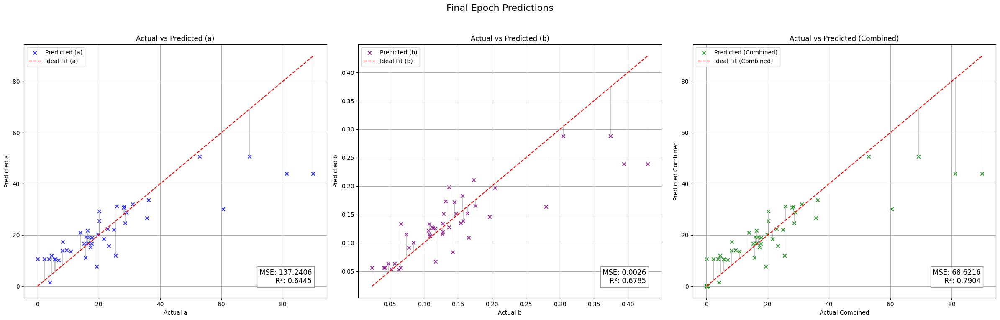

Validation Metrics:
  - MSE: 58.0230
  - R²: 0.7190
  - MAE: 3.4306
  - Explained Variance Score (EVS): 0.7222
Fold 1 Metrics:
  - Validation Loss (MSE): 58.0230
  - R²: 0.7190
  - MAE: 3.4306
  - EVS: 0.7222
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.14]


Validation Metrics:
  - MSE: 2.0180
  - R²: 0.9756
  - MAE: 0.7682
  - Explained Variance Score (EVS): 0.9785
Epoch [1/50], Train Loss: 0.1704, Val Loss: 2.0180
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.135]


Validation Metrics:
  - MSE: 1.7437
  - R²: 0.9773
  - MAE: 0.7468
  - Explained Variance Score (EVS): 0.9774
Epoch [2/50], Train Loss: 0.1571, Val Loss: 1.7437
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.135]


Validation Metrics:
  - MSE: 2.0843
  - R²: 0.9727
  - MAE: 0.7831
  - Explained Variance Score (EVS): 0.9727
Epoch [3/50], Train Loss: 0.1621, Val Loss: 2.0843
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.126]


Validation Metrics:
  - MSE: 3.0415
  - R²: 0.9623
  - MAE: 0.9083
  - Explained Variance Score (EVS): 0.9624
Epoch [4/50], Train Loss: 0.1498, Val Loss: 3.0415
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.31it/s, loss=0.133]


Validation Metrics:
  - MSE: 4.0034
  - R²: 0.9518
  - MAE: 1.0545
  - Explained Variance Score (EVS): 0.9524
Epoch [5/50], Train Loss: 0.1698, Val Loss: 4.0034
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.151]


Validation Metrics:
  - MSE: 4.4287
  - R²: 0.9449
  - MAE: 1.1401
  - Explained Variance Score (EVS): 0.9456
Epoch [6/50], Train Loss: 0.1413, Val Loss: 4.4287
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=0.122]


Validation Metrics:
  - MSE: 4.7345
  - R²: 0.9401
  - MAE: 1.2039
  - Explained Variance Score (EVS): 0.9411
Epoch [7/50], Train Loss: 0.1389, Val Loss: 4.7345
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s, loss=0.119]


Validation Metrics:
  - MSE: 5.0587
  - R²: 0.9329
  - MAE: 1.2337
  - Explained Variance Score (EVS): 0.9339
Epoch [8/50], Train Loss: 0.1341, Val Loss: 5.0587
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=0.167]


Validation Metrics:
  - MSE: 5.6142
  - R²: 0.9272
  - MAE: 1.2915
  - Explained Variance Score (EVS): 0.9275
Epoch [9/50], Train Loss: 0.1448, Val Loss: 5.6142
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=0.125]


Validation Metrics:
  - MSE: 5.2092
  - R²: 0.9318
  - MAE: 1.2204
  - Explained Variance Score (EVS): 0.9325
Epoch [10/50], Train Loss: 0.1457, Val Loss: 5.2092
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.103]


Validation Metrics:
  - MSE: 4.7556
  - R²: 0.9373
  - MAE: 1.1509
  - Explained Variance Score (EVS): 0.9377
Epoch [11/50], Train Loss: 0.1130, Val Loss: 4.7556
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.128]


Validation Metrics:
  - MSE: 4.4591
  - R²: 0.9395
  - MAE: 1.1162
  - Explained Variance Score (EVS): 0.9400
Epoch [12/50], Train Loss: 0.1274, Val Loss: 4.4591
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


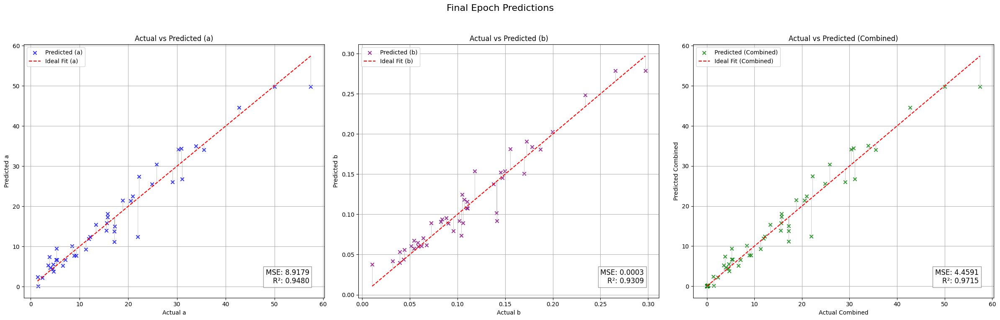

Validation Metrics:
  - MSE: 1.7437
  - R²: 0.9773
  - MAE: 0.7468
  - Explained Variance Score (EVS): 0.9774
Fold 2 Metrics:
  - Validation Loss (MSE): 1.7437
  - R²: 0.9773
  - MAE: 0.7468
  - EVS: 0.9774
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.206]


Validation Metrics:
  - MSE: 14.0843
  - R²: 0.8817
  - MAE: 1.3543
  - Explained Variance Score (EVS): 0.8823
Epoch [1/50], Train Loss: 0.1609, Val Loss: 14.0843
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.60it/s, loss=0.148]


Validation Metrics:
  - MSE: 14.2664
  - R²: 0.8807
  - MAE: 1.3934
  - Explained Variance Score (EVS): 0.8811
Epoch [2/50], Train Loss: 0.1542, Val Loss: 14.2664
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.142]


Validation Metrics:
  - MSE: 14.6269
  - R²: 0.8788
  - MAE: 1.4578
  - Explained Variance Score (EVS): 0.8793
Epoch [3/50], Train Loss: 0.1482, Val Loss: 14.6269
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.159]


Validation Metrics:
  - MSE: 15.0004
  - R²: 0.8762
  - MAE: 1.4829
  - Explained Variance Score (EVS): 0.8767
Epoch [4/50], Train Loss: 0.1473, Val Loss: 15.0004
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.144]


Validation Metrics:
  - MSE: 15.3030
  - R²: 0.8740
  - MAE: 1.4859
  - Explained Variance Score (EVS): 0.8751
Epoch [5/50], Train Loss: 0.1429, Val Loss: 15.3030
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s, loss=0.159]


Validation Metrics:
  - MSE: 15.3175
  - R²: 0.8739
  - MAE: 1.4637
  - Explained Variance Score (EVS): 0.8747
Epoch [6/50], Train Loss: 0.1386, Val Loss: 15.3175
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.155]


Validation Metrics:
  - MSE: 15.4341
  - R²: 0.8738
  - MAE: 1.4652
  - Explained Variance Score (EVS): 0.8748
Epoch [7/50], Train Loss: 0.1366, Val Loss: 15.4341
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.129]


Validation Metrics:
  - MSE: 15.6939
  - R²: 0.8730
  - MAE: 1.4683
  - Explained Variance Score (EVS): 0.8742
Epoch [8/50], Train Loss: 0.1262, Val Loss: 15.6939
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.138]


Validation Metrics:
  - MSE: 15.8460
  - R²: 0.8720
  - MAE: 1.4622
  - Explained Variance Score (EVS): 0.8725
Epoch [9/50], Train Loss: 0.1260, Val Loss: 15.8460
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.135]


Validation Metrics:
  - MSE: 16.0947
  - R²: 0.8698
  - MAE: 1.4220
  - Explained Variance Score (EVS): 0.8701
Epoch [10/50], Train Loss: 0.1331, Val Loss: 16.0947
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=0.075]


Validation Metrics:
  - MSE: 16.0630
  - R²: 0.8697
  - MAE: 1.3990
  - Explained Variance Score (EVS): 0.8700
Epoch [11/50], Train Loss: 0.1180, Val Loss: 16.0630
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


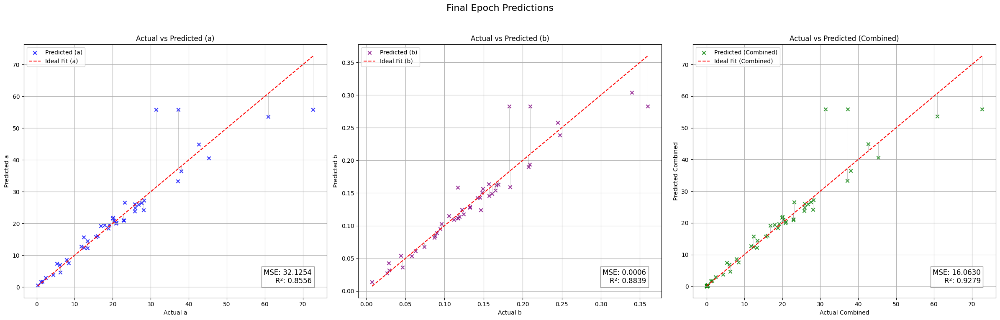

Validation Metrics:
  - MSE: 14.0843
  - R²: 0.8817
  - MAE: 1.3543
  - Explained Variance Score (EVS): 0.8823
Fold 3 Metrics:
  - Validation Loss (MSE): 14.0843
  - R²: 0.8817
  - MAE: 1.3543
  - EVS: 0.8823
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.191]


Validation Metrics:
  - MSE: 14.4662
  - R²: 0.7521
  - MAE: 1.4512
  - Explained Variance Score (EVS): 0.7549
Epoch [1/50], Train Loss: 0.1346, Val Loss: 14.4662
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.124]


Validation Metrics:
  - MSE: 14.6725
  - R²: 0.7527
  - MAE: 1.4345
  - Explained Variance Score (EVS): 0.7550
Epoch [2/50], Train Loss: 0.1444, Val Loss: 14.6725
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.43it/s, loss=0.157]


Validation Metrics:
  - MSE: 14.9808
  - R²: 0.7508
  - MAE: 1.4325
  - Explained Variance Score (EVS): 0.7529
Epoch [3/50], Train Loss: 0.1449, Val Loss: 14.9808
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.63it/s, loss=0.149]


Validation Metrics:
  - MSE: 15.7890
  - R²: 0.7456
  - MAE: 1.4448
  - Explained Variance Score (EVS): 0.7483
Epoch [4/50], Train Loss: 0.1356, Val Loss: 15.7890
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.0904]


Validation Metrics:
  - MSE: 16.6258
  - R²: 0.7396
  - MAE: 1.4594
  - Explained Variance Score (EVS): 0.7429
Epoch [5/50], Train Loss: 0.1309, Val Loss: 16.6258
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.35it/s, loss=0.133]


Validation Metrics:
  - MSE: 17.5135
  - R²: 0.7333
  - MAE: 1.4972
  - Explained Variance Score (EVS): 0.7372
Epoch [6/50], Train Loss: 0.1448, Val Loss: 17.5135
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  7.03it/s, loss=0.118]


Validation Metrics:
  - MSE: 18.2607
  - R²: 0.7277
  - MAE: 1.5279
  - Explained Variance Score (EVS): 0.7316
Epoch [7/50], Train Loss: 0.1193, Val Loss: 18.2607
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.144]


Validation Metrics:
  - MSE: 18.3573
  - R²: 0.7262
  - MAE: 1.5282
  - Explained Variance Score (EVS): 0.7299
Epoch [8/50], Train Loss: 0.1374, Val Loss: 18.3573
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s, loss=0.151]


Validation Metrics:
  - MSE: 17.9664
  - R²: 0.7287
  - MAE: 1.5059
  - Explained Variance Score (EVS): 0.7320
Epoch [9/50], Train Loss: 0.1312, Val Loss: 17.9664
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.159]


Validation Metrics:
  - MSE: 18.1559
  - R²: 0.7276
  - MAE: 1.5135
  - Explained Variance Score (EVS): 0.7313
Epoch [10/50], Train Loss: 0.1316, Val Loss: 18.1559
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=0.139]


Validation Metrics:
  - MSE: 17.7754
  - R²: 0.7294
  - MAE: 1.4986
  - Explained Variance Score (EVS): 0.7327
Epoch [11/50], Train Loss: 0.1296, Val Loss: 17.7754
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


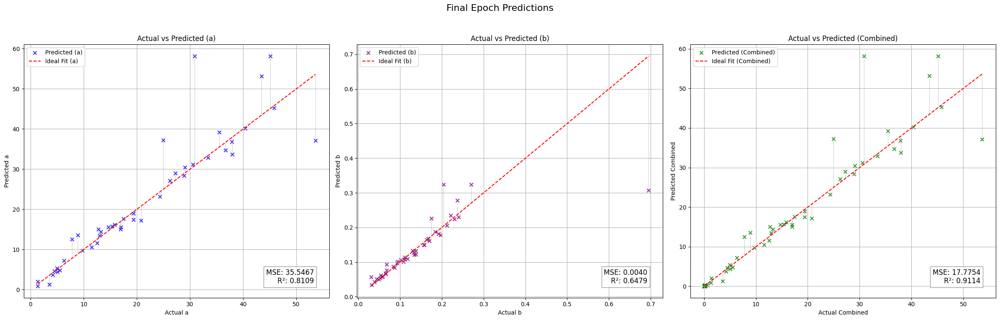

Validation Metrics:
  - MSE: 14.4662
  - R²: 0.7521
  - MAE: 1.4512
  - Explained Variance Score (EVS): 0.7549
Fold 4 Metrics:
  - Validation Loss (MSE): 14.4662
  - R²: 0.7521
  - MAE: 1.4512
  - EVS: 0.7549
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.207]


Validation Metrics:
  - MSE: 34.1347
  - R²: 0.8292
  - MAE: 1.5382
  - Explained Variance Score (EVS): 0.8381
Epoch [1/50], Train Loss: 0.1659, Val Loss: 34.1347
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=0.0966]


Validation Metrics:
  - MSE: 33.4859
  - R²: 0.8329
  - MAE: 1.4984
  - Explained Variance Score (EVS): 0.8397
Epoch [2/50], Train Loss: 0.1520, Val Loss: 33.4859
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.161]


Validation Metrics:
  - MSE: 32.9638
  - R²: 0.8353
  - MAE: 1.4639
  - Explained Variance Score (EVS): 0.8404
Epoch [3/50], Train Loss: 0.1425, Val Loss: 32.9638
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.199]


Validation Metrics:
  - MSE: 32.7354
  - R²: 0.8360
  - MAE: 1.4329
  - Explained Variance Score (EVS): 0.8404
Epoch [4/50], Train Loss: 0.1536, Val Loss: 32.7354
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.122]


Validation Metrics:
  - MSE: 32.3850
  - R²: 0.8371
  - MAE: 1.4009
  - Explained Variance Score (EVS): 0.8409
Epoch [5/50], Train Loss: 0.1433, Val Loss: 32.3850
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.84it/s, loss=0.142]


Validation Metrics:
  - MSE: 32.4867
  - R²: 0.8360
  - MAE: 1.3878
  - Explained Variance Score (EVS): 0.8397
Epoch [6/50], Train Loss: 0.1533, Val Loss: 32.4867
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.88it/s, loss=0.129]


Validation Metrics:
  - MSE: 32.5689
  - R²: 0.8350
  - MAE: 1.3839
  - Explained Variance Score (EVS): 0.8384
Epoch [7/50], Train Loss: 0.1257, Val Loss: 32.5689
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.58it/s, loss=0.155]


Validation Metrics:
  - MSE: 32.6525
  - R²: 0.8338
  - MAE: 1.3730
  - Explained Variance Score (EVS): 0.8376
Epoch [8/50], Train Loss: 0.1451, Val Loss: 32.6525
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.107]


Validation Metrics:
  - MSE: 32.3962
  - R²: 0.8348
  - MAE: 1.3631
  - Explained Variance Score (EVS): 0.8381
Epoch [9/50], Train Loss: 0.1342, Val Loss: 32.3962
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.86it/s, loss=0.123]


Validation Metrics:
  - MSE: 32.3648
  - R²: 0.8344
  - MAE: 1.3637
  - Explained Variance Score (EVS): 0.8381
Epoch [10/50], Train Loss: 0.1271, Val Loss: 32.3648
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.36it/s, loss=0.19]


Validation Metrics:
  - MSE: 32.4074
  - R²: 0.8345
  - MAE: 1.3626
  - Explained Variance Score (EVS): 0.8385
Epoch [11/50], Train Loss: 0.1416, Val Loss: 32.4074
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.61it/s, loss=0.142]


Validation Metrics:
  - MSE: 32.6938
  - R²: 0.8328
  - MAE: 1.3642
  - Explained Variance Score (EVS): 0.8375
Epoch [12/50], Train Loss: 0.1400, Val Loss: 32.6938
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=0.137]


Validation Metrics:
  - MSE: 32.6036
  - R²: 0.8333
  - MAE: 1.3570
  - Explained Variance Score (EVS): 0.8377
Epoch [13/50], Train Loss: 0.1225, Val Loss: 32.6036
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.59it/s, loss=0.173]


Validation Metrics:
  - MSE: 32.9301
  - R²: 0.8319
  - MAE: 1.3626
  - Explained Variance Score (EVS): 0.8366
Epoch [14/50], Train Loss: 0.1298, Val Loss: 32.9301
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.145]


Validation Metrics:
  - MSE: 32.9329
  - R²: 0.8324
  - MAE: 1.3615
  - Explained Variance Score (EVS): 0.8369
Epoch [15/50], Train Loss: 0.1304, Val Loss: 32.9329
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.171]


Validation Metrics:
  - MSE: 33.0959
  - R²: 0.8314
  - MAE: 1.3647
  - Explained Variance Score (EVS): 0.8359
Epoch [16/50], Train Loss: 0.1338, Val Loss: 33.0959
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=0.135]


Validation Metrics:
  - MSE: 33.1696
  - R²: 0.8312
  - MAE: 1.3624
  - Explained Variance Score (EVS): 0.8354
Epoch [17/50], Train Loss: 0.1196, Val Loss: 33.1696
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=0.113]


Validation Metrics:
  - MSE: 33.0854
  - R²: 0.8320
  - MAE: 1.3571
  - Explained Variance Score (EVS): 0.8357
Epoch [18/50], Train Loss: 0.1268, Val Loss: 33.0854
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.192]


Validation Metrics:
  - MSE: 32.8071
  - R²: 0.8335
  - MAE: 1.3478
  - Explained Variance Score (EVS): 0.8368
Epoch [19/50], Train Loss: 0.1622, Val Loss: 32.8071
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.181]


Validation Metrics:
  - MSE: 33.2922
  - R²: 0.8312
  - MAE: 1.3582
  - Explained Variance Score (EVS): 0.8350
Epoch [20/50], Train Loss: 0.1403, Val Loss: 33.2922
Current Dropout Rate: 0.3480
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


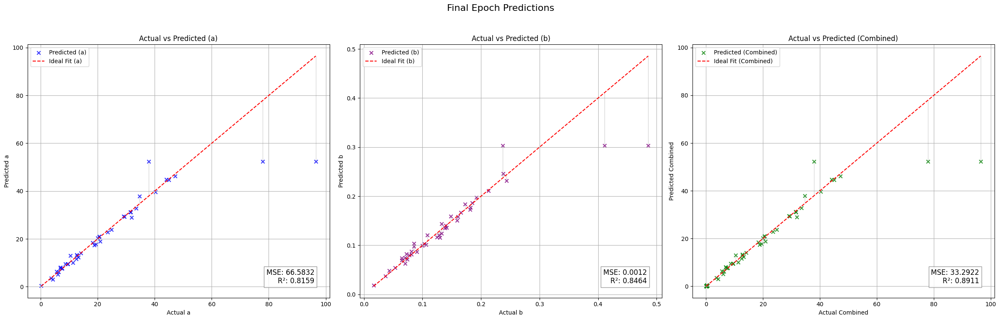

[I 2024-12-01 17:14:29,488] Trial 15 finished with value: 24.136394500732422 and parameters: {'num_layers': 1, 'hidden_size_0': 89, 'activation_0': 'LeakyReLU', 'dropout_0': 0.4002399477815566, 'batch_size': 64, 'learning_rate': 3.01074839566633e-05, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.3648
  - R²: 0.8344
  - MAE: 1.3637
  - Explained Variance Score (EVS): 0.8381
Fold 5 Metrics:
  - Validation Loss (MSE): 32.3648
  - R²: 0.8344
  - MAE: 1.3637
  - EVS: 0.8381
Avg Validation Metrics:
  - MSE: 24.1364
  - R²: 0.8329
  - MAE: 1.6693
  - EVS: 0.8350
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=1.3]


Validation Metrics:
  - MSE: 188.9771
  - R²: 0.0297
  - MAE: 6.3368
  - Explained Variance Score (EVS): 0.0439
Epoch [1/50], Train Loss: 1.2624, Val Loss: 188.9771
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.20it/s, loss=1.07]


Validation Metrics:
  - MSE: 183.1382
  - R²: 0.0480
  - MAE: 6.2564
  - Explained Variance Score (EVS): 0.0609
Epoch [2/50], Train Loss: 1.1270, Val Loss: 183.1382
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=1.02]


Validation Metrics:
  - MSE: 183.8234
  - R²: 0.0470
  - MAE: 6.2497
  - Explained Variance Score (EVS): 0.0622
Epoch [3/50], Train Loss: 1.0795, Val Loss: 183.8234
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.65it/s, loss=1.07]


Validation Metrics:
  - MSE: 185.8357
  - R²: 0.0463
  - MAE: 6.2514
  - Explained Variance Score (EVS): 0.0635
Epoch [4/50], Train Loss: 1.0405, Val Loss: 185.8357
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=1.04]


Validation Metrics:
  - MSE: 183.7251
  - R²: 0.0631
  - MAE: 6.2078
  - Explained Variance Score (EVS): 0.0804
Epoch [5/50], Train Loss: 1.0307, Val Loss: 183.7251
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=0.935]


Validation Metrics:
  - MSE: 178.1025
  - R²: 0.0871
  - MAE: 6.1139
  - Explained Variance Score (EVS): 0.1029
Epoch [6/50], Train Loss: 0.9875, Val Loss: 178.1025
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.903]


Validation Metrics:
  - MSE: 172.4152
  - R²: 0.1107
  - MAE: 6.0072
  - Explained Variance Score (EVS): 0.1259
Epoch [7/50], Train Loss: 0.9628, Val Loss: 172.4152
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.52it/s, loss=0.978]


Validation Metrics:
  - MSE: 168.1919
  - R²: 0.1297
  - MAE: 5.8932
  - Explained Variance Score (EVS): 0.1453
Epoch [8/50], Train Loss: 0.9511, Val Loss: 168.1919
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.89]


Validation Metrics:
  - MSE: 165.1787
  - R²: 0.1487
  - MAE: 5.8176
  - Explained Variance Score (EVS): 0.1659
Epoch [9/50], Train Loss: 0.9125, Val Loss: 165.1787
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.94it/s, loss=0.929]


Validation Metrics:
  - MSE: 163.5533
  - R²: 0.1648
  - MAE: 5.7731
  - Explained Variance Score (EVS): 0.1846
Epoch [10/50], Train Loss: 0.9053, Val Loss: 163.5533
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.61it/s, loss=0.879]


Validation Metrics:
  - MSE: 158.5388
  - R²: 0.1967
  - MAE: 5.6721
  - Explained Variance Score (EVS): 0.2149
Epoch [11/50], Train Loss: 0.8757, Val Loss: 158.5388
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.71it/s, loss=0.882]


Validation Metrics:
  - MSE: 148.8751
  - R²: 0.2496
  - MAE: 5.4973
  - Explained Variance Score (EVS): 0.2627
Epoch [12/50], Train Loss: 0.8671, Val Loss: 148.8751
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=0.85]


Validation Metrics:
  - MSE: 139.4468
  - R²: 0.3107
  - MAE: 5.3080
  - Explained Variance Score (EVS): 0.3218
Epoch [13/50], Train Loss: 0.8287, Val Loss: 139.4468
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.71it/s, loss=0.81]


Validation Metrics:
  - MSE: 129.3477
  - R²: 0.3454
  - MAE: 5.1122
  - Explained Variance Score (EVS): 0.3584
Epoch [14/50], Train Loss: 0.8119, Val Loss: 129.3477
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=0.824]


Validation Metrics:
  - MSE: 126.1529
  - R²: 0.3482
  - MAE: 4.9495
  - Explained Variance Score (EVS): 0.3673
Epoch [15/50], Train Loss: 0.7833, Val Loss: 126.1529
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.728]


Validation Metrics:
  - MSE: 116.0891
  - R²: 0.3976
  - MAE: 4.7776
  - Explained Variance Score (EVS): 0.4152
Epoch [16/50], Train Loss: 0.7664, Val Loss: 116.0891
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.745]


Validation Metrics:
  - MSE: 111.8502
  - R²: 0.4445
  - MAE: 4.6316
  - Explained Variance Score (EVS): 0.4608
Epoch [17/50], Train Loss: 0.7392, Val Loss: 111.8502
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.7]


Validation Metrics:
  - MSE: 97.7107
  - R²: 0.5333
  - MAE: 4.4602
  - Explained Variance Score (EVS): 0.5443
Epoch [18/50], Train Loss: 0.7242, Val Loss: 97.7107
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.672]


Validation Metrics:
  - MSE: 83.5634
  - R²: 0.5960
  - MAE: 4.3524
  - Explained Variance Score (EVS): 0.6025
Epoch [19/50], Train Loss: 0.7014, Val Loss: 83.5634
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s, loss=0.715]


Validation Metrics:
  - MSE: 77.3044
  - R²: 0.6025
  - MAE: 4.1160
  - Explained Variance Score (EVS): 0.6155
Epoch [20/50], Train Loss: 0.6925, Val Loss: 77.3044
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.59it/s, loss=0.669]


Validation Metrics:
  - MSE: 79.6209
  - R²: 0.5879
  - MAE: 3.9444
  - Explained Variance Score (EVS): 0.6062
Epoch [21/50], Train Loss: 0.6533, Val Loss: 79.6209
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.641]


Validation Metrics:
  - MSE: 80.3114
  - R²: 0.6087
  - MAE: 3.8912
  - Explained Variance Score (EVS): 0.6198
Epoch [22/50], Train Loss: 0.6364, Val Loss: 80.3114
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.38it/s, loss=0.59]


Validation Metrics:
  - MSE: 72.4046
  - R²: 0.6583
  - MAE: 3.7306
  - Explained Variance Score (EVS): 0.6620
Epoch [23/50], Train Loss: 0.6028, Val Loss: 72.4046
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=0.555]


Validation Metrics:
  - MSE: 62.5785
  - R²: 0.7035
  - MAE: 3.7130
  - Explained Variance Score (EVS): 0.7061
Epoch [24/50], Train Loss: 0.5838, Val Loss: 62.5785
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.29it/s, loss=0.517]


Validation Metrics:
  - MSE: 62.1336
  - R²: 0.7018
  - MAE: 3.6943
  - Explained Variance Score (EVS): 0.7131
Epoch [25/50], Train Loss: 0.5691, Val Loss: 62.1336
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s, loss=0.504]


Validation Metrics:
  - MSE: 61.8124
  - R²: 0.6979
  - MAE: 3.5175
  - Explained Variance Score (EVS): 0.7159
Epoch [26/50], Train Loss: 0.5398, Val Loss: 61.8124
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.521]


Validation Metrics:
  - MSE: 72.7300
  - R²: 0.6673
  - MAE: 3.4884
  - Explained Variance Score (EVS): 0.6876
Epoch [27/50], Train Loss: 0.5209, Val Loss: 72.7300
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.77it/s, loss=0.525]


Validation Metrics:
  - MSE: 81.0511
  - R²: 0.6224
  - MAE: 3.6419
  - Explained Variance Score (EVS): 0.6374
Epoch [28/50], Train Loss: 0.5011, Val Loss: 81.0511
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.42it/s, loss=0.464]


Validation Metrics:
  - MSE: 71.7460
  - R²: 0.6552
  - MAE: 3.5298
  - Explained Variance Score (EVS): 0.6609
Epoch [29/50], Train Loss: 0.4845, Val Loss: 71.7460
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.52it/s, loss=0.469]


Validation Metrics:
  - MSE: 62.8153
  - R²: 0.6854
  - MAE: 3.4989
  - Explained Variance Score (EVS): 0.6947
Epoch [30/50], Train Loss: 0.4522, Val Loss: 62.8153
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.425]


Validation Metrics:
  - MSE: 57.2054
  - R²: 0.7219
  - MAE: 3.5411
  - Explained Variance Score (EVS): 0.7328
Epoch [31/50], Train Loss: 0.4226, Val Loss: 57.2054
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.457]


Validation Metrics:
  - MSE: 57.3239
  - R²: 0.7305
  - MAE: 3.3826
  - Explained Variance Score (EVS): 0.7413
Epoch [32/50], Train Loss: 0.4077, Val Loss: 57.3239
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.419]


Validation Metrics:
  - MSE: 55.2697
  - R²: 0.7330
  - MAE: 3.2972
  - Explained Variance Score (EVS): 0.7412
Epoch [33/50], Train Loss: 0.3840, Val Loss: 55.2697
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.341]


Validation Metrics:
  - MSE: 55.0728
  - R²: 0.7143
  - MAE: 3.2582
  - Explained Variance Score (EVS): 0.7229
Epoch [34/50], Train Loss: 0.3612, Val Loss: 55.0728
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.338]


Validation Metrics:
  - MSE: 59.0741
  - R²: 0.6915
  - MAE: 3.2861
  - Explained Variance Score (EVS): 0.7039
Epoch [35/50], Train Loss: 0.3465, Val Loss: 59.0741
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.307]


Validation Metrics:
  - MSE: 59.7903
  - R²: 0.6851
  - MAE: 3.3317
  - Explained Variance Score (EVS): 0.6998
Epoch [36/50], Train Loss: 0.3199, Val Loss: 59.7903
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.29]


Validation Metrics:
  - MSE: 59.1118
  - R²: 0.7050
  - MAE: 3.3021
  - Explained Variance Score (EVS): 0.7146
Epoch [37/50], Train Loss: 0.3069, Val Loss: 59.1118
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.293]


Validation Metrics:
  - MSE: 60.6571
  - R²: 0.7097
  - MAE: 3.2779
  - Explained Variance Score (EVS): 0.7181
Epoch [38/50], Train Loss: 0.2929, Val Loss: 60.6571
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.232]


Validation Metrics:
  - MSE: 64.7246
  - R²: 0.6819
  - MAE: 3.3591
  - Explained Variance Score (EVS): 0.6939
Epoch [39/50], Train Loss: 0.2678, Val Loss: 64.7246
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.218]


Validation Metrics:
  - MSE: 63.4067
  - R²: 0.6705
  - MAE: 3.4624
  - Explained Variance Score (EVS): 0.6818
Epoch [40/50], Train Loss: 0.2490, Val Loss: 63.4067
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.237]


Validation Metrics:
  - MSE: 60.8333
  - R²: 0.6666
  - MAE: 3.4212
  - Explained Variance Score (EVS): 0.6821
Epoch [41/50], Train Loss: 0.2504, Val Loss: 60.8333
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.15it/s, loss=0.246]


Validation Metrics:
  - MSE: 61.8445
  - R²: 0.6885
  - MAE: 3.4846
  - Explained Variance Score (EVS): 0.7050
Epoch [42/50], Train Loss: 0.2351, Val Loss: 61.8445
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  8.19it/s, loss=0.247]


Validation Metrics:
  - MSE: 64.9346
  - R²: 0.6881
  - MAE: 3.4644
  - Explained Variance Score (EVS): 0.7047
Epoch [43/50], Train Loss: 0.2203, Val Loss: 64.9346
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  6.81it/s, loss=0.204]


Validation Metrics:
  - MSE: 64.1071
  - R²: 0.6965
  - MAE: 3.3451
  - Explained Variance Score (EVS): 0.7075
Epoch [44/50], Train Loss: 0.2052, Val Loss: 64.1071
Current Dropout Rate: 0.1560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


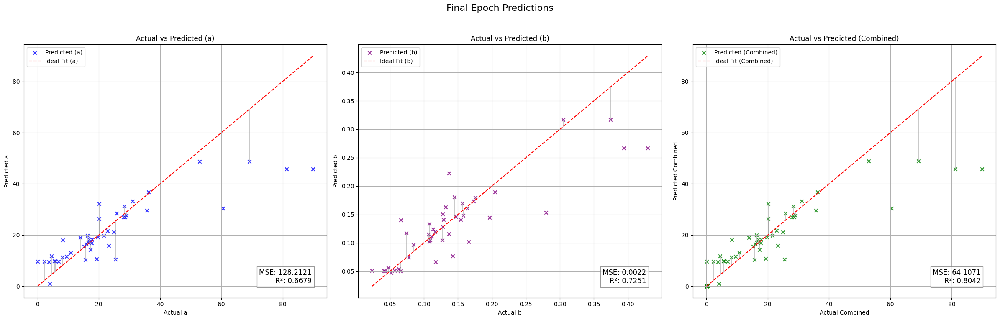

Validation Metrics:
  - MSE: 55.0728
  - R²: 0.7143
  - MAE: 3.2582
  - Explained Variance Score (EVS): 0.7229
Fold 1 Metrics:
  - Validation Loss (MSE): 55.0728
  - R²: 0.7143
  - MAE: 3.2582
  - EVS: 0.7229
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=0.367]


Validation Metrics:
  - MSE: 4.0367
  - R²: 0.9436
  - MAE: 1.2270
  - Explained Variance Score (EVS): 0.9574
Epoch [1/50], Train Loss: 0.3841, Val Loss: 4.0367
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.84it/s, loss=0.351]


Validation Metrics:
  - MSE: 2.8651
  - R²: 0.9400
  - MAE: 1.0114
  - Explained Variance Score (EVS): 0.9501
Epoch [2/50], Train Loss: 0.3545, Val Loss: 2.8651
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s, loss=0.339]


Validation Metrics:
  - MSE: 2.8777
  - R²: 0.9230
  - MAE: 1.0007
  - Explained Variance Score (EVS): 0.9359
Epoch [3/50], Train Loss: 0.3508, Val Loss: 2.8777
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.322]


Validation Metrics:
  - MSE: 4.6385
  - R²: 0.9058
  - MAE: 1.1817
  - Explained Variance Score (EVS): 0.9147
Epoch [4/50], Train Loss: 0.3426, Val Loss: 4.6385
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.313]


Validation Metrics:
  - MSE: 5.3358
  - R²: 0.8955
  - MAE: 1.1836
  - Explained Variance Score (EVS): 0.9041
Epoch [5/50], Train Loss: 0.3418, Val Loss: 5.3358
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=0.295]


Validation Metrics:
  - MSE: 5.5012
  - R²: 0.8943
  - MAE: 1.1871
  - Explained Variance Score (EVS): 0.9002
Epoch [6/50], Train Loss: 0.3140, Val Loss: 5.5012
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.26]


Validation Metrics:
  - MSE: 6.0622
  - R²: 0.8906
  - MAE: 1.2144
  - Explained Variance Score (EVS): 0.8959
Epoch [7/50], Train Loss: 0.2987, Val Loss: 6.0622
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.344]


Validation Metrics:
  - MSE: 6.0400
  - R²: 0.8757
  - MAE: 1.2143
  - Explained Variance Score (EVS): 0.8828
Epoch [8/50], Train Loss: 0.3183, Val Loss: 6.0400
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.277]


Validation Metrics:
  - MSE: 6.3376
  - R²: 0.8557
  - MAE: 1.2690
  - Explained Variance Score (EVS): 0.8648
Epoch [9/50], Train Loss: 0.2861, Val Loss: 6.3376
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.268]


Validation Metrics:
  - MSE: 6.5499
  - R²: 0.8419
  - MAE: 1.3040
  - Explained Variance Score (EVS): 0.8575
Epoch [10/50], Train Loss: 0.2646, Val Loss: 6.5499
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.255]


Validation Metrics:
  - MSE: 6.5841
  - R²: 0.8531
  - MAE: 1.2409
  - Explained Variance Score (EVS): 0.8634
Epoch [11/50], Train Loss: 0.2623, Val Loss: 6.5841
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=0.21]


Validation Metrics:
  - MSE: 6.7817
  - R²: 0.8522
  - MAE: 1.2328
  - Explained Variance Score (EVS): 0.8597
Epoch [12/50], Train Loss: 0.2349, Val Loss: 6.7817
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


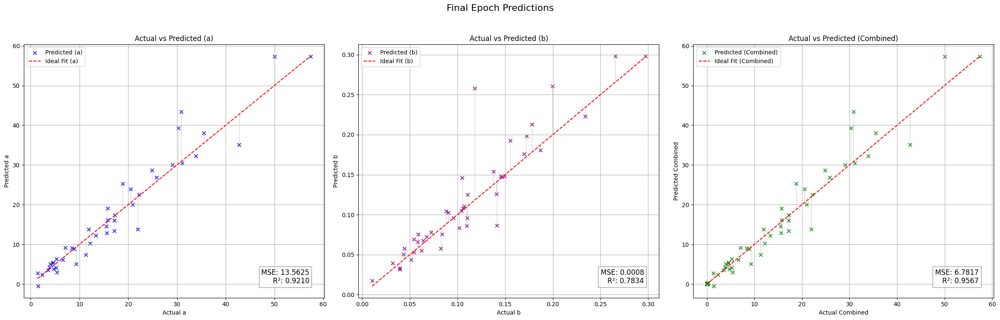

Validation Metrics:
  - MSE: 2.8651
  - R²: 0.9400
  - MAE: 1.0114
  - Explained Variance Score (EVS): 0.9501
Fold 2 Metrics:
  - Validation Loss (MSE): 2.8651
  - R²: 0.9400
  - MAE: 1.0114
  - EVS: 0.9501
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.64it/s, loss=0.35]


Validation Metrics:
  - MSE: 14.5837
  - R²: 0.8844
  - MAE: 1.4190
  - Explained Variance Score (EVS): 0.8852
Epoch [1/50], Train Loss: 0.3588, Val Loss: 14.5837
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  7.12it/s, loss=0.332]


Validation Metrics:
  - MSE: 14.9666
  - R²: 0.8811
  - MAE: 1.3837
  - Explained Variance Score (EVS): 0.8819
Epoch [2/50], Train Loss: 0.3461, Val Loss: 14.9666
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.408]


Validation Metrics:
  - MSE: 15.0249
  - R²: 0.8788
  - MAE: 1.3392
  - Explained Variance Score (EVS): 0.8793
Epoch [3/50], Train Loss: 0.3532, Val Loss: 15.0249
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.311]


Validation Metrics:
  - MSE: 15.2854
  - R²: 0.8734
  - MAE: 1.3656
  - Explained Variance Score (EVS): 0.8737
Epoch [4/50], Train Loss: 0.3250, Val Loss: 15.2854
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s, loss=0.354]


Validation Metrics:
  - MSE: 16.1090
  - R²: 0.8635
  - MAE: 1.3485
  - Explained Variance Score (EVS): 0.8641
Epoch [5/50], Train Loss: 0.3227, Val Loss: 16.1090
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.307]


Validation Metrics:
  - MSE: 17.3402
  - R²: 0.8536
  - MAE: 1.3559
  - Explained Variance Score (EVS): 0.8544
Epoch [6/50], Train Loss: 0.3021, Val Loss: 17.3402
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.292]


Validation Metrics:
  - MSE: 17.9112
  - R²: 0.8506
  - MAE: 1.3472
  - Explained Variance Score (EVS): 0.8527
Epoch [7/50], Train Loss: 0.3076, Val Loss: 17.9112
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.42it/s, loss=0.296]


Validation Metrics:
  - MSE: 18.7154
  - R²: 0.8486
  - MAE: 1.3862
  - Explained Variance Score (EVS): 0.8513
Epoch [8/50], Train Loss: 0.3119, Val Loss: 18.7154
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.275]


Validation Metrics:
  - MSE: 18.9966
  - R²: 0.8468
  - MAE: 1.4549
  - Explained Variance Score (EVS): 0.8519
Epoch [9/50], Train Loss: 0.2867, Val Loss: 18.9966
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.352]


Validation Metrics:
  - MSE: 19.0987
  - R²: 0.8442
  - MAE: 1.4342
  - Explained Variance Score (EVS): 0.8481
Epoch [10/50], Train Loss: 0.2924, Val Loss: 19.0987
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.309]


Validation Metrics:
  - MSE: 19.0879
  - R²: 0.8453
  - MAE: 1.4306
  - Explained Variance Score (EVS): 0.8484
Epoch [11/50], Train Loss: 0.2811, Val Loss: 19.0879
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


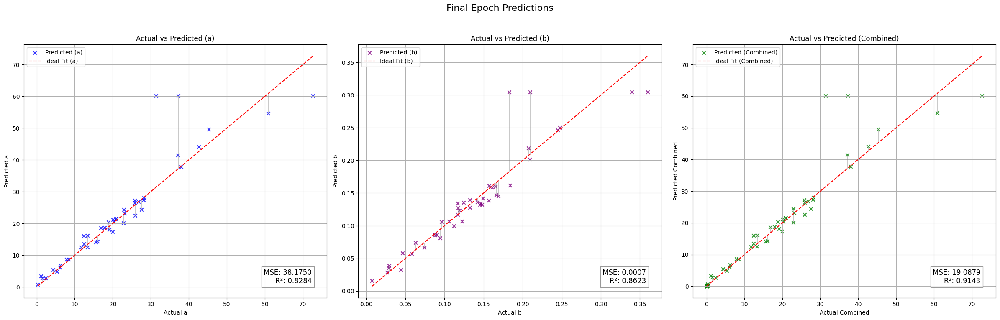

Validation Metrics:
  - MSE: 14.5837
  - R²: 0.8844
  - MAE: 1.4190
  - Explained Variance Score (EVS): 0.8852
Fold 3 Metrics:
  - Validation Loss (MSE): 14.5837
  - R²: 0.8844
  - MAE: 1.4190
  - EVS: 0.8852
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s, loss=0.338]


Validation Metrics:
  - MSE: 10.9206
  - R²: 0.9016
  - MAE: 1.3323
  - Explained Variance Score (EVS): 0.9099
Epoch [1/50], Train Loss: 0.3538, Val Loss: 10.9206
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.385]


Validation Metrics:
  - MSE: 11.4288
  - R²: 0.8980
  - MAE: 1.3438
  - Explained Variance Score (EVS): 0.9059
Epoch [2/50], Train Loss: 0.3564, Val Loss: 11.4288
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=0.326]


Validation Metrics:
  - MSE: 12.7566
  - R²: 0.8867
  - MAE: 1.3705
  - Explained Variance Score (EVS): 0.8944
Epoch [3/50], Train Loss: 0.3328, Val Loss: 12.7566
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  7.14it/s, loss=0.315]


Validation Metrics:
  - MSE: 14.7094
  - R²: 0.8705
  - MAE: 1.4267
  - Explained Variance Score (EVS): 0.8793
Epoch [4/50], Train Loss: 0.3216, Val Loss: 14.7094
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  7.19it/s, loss=0.306]


Validation Metrics:
  - MSE: 16.7600
  - R²: 0.8529
  - MAE: 1.4910
  - Explained Variance Score (EVS): 0.8632
Epoch [5/50], Train Loss: 0.3185, Val Loss: 16.7600
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.302]


Validation Metrics:
  - MSE: 17.5574
  - R²: 0.8434
  - MAE: 1.5111
  - Explained Variance Score (EVS): 0.8521
Epoch [6/50], Train Loss: 0.3282, Val Loss: 17.5574
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.40it/s, loss=0.284]


Validation Metrics:
  - MSE: 18.9986
  - R²: 0.8319
  - MAE: 1.5622
  - Explained Variance Score (EVS): 0.8419
Epoch [7/50], Train Loss: 0.3129, Val Loss: 18.9986
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.76it/s, loss=0.328]


Validation Metrics:
  - MSE: 19.1263
  - R²: 0.8307
  - MAE: 1.5769
  - Explained Variance Score (EVS): 0.8392
Epoch [8/50], Train Loss: 0.3184, Val Loss: 19.1263
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.75it/s, loss=0.337]


Validation Metrics:
  - MSE: 20.7949
  - R²: 0.8226
  - MAE: 1.6433
  - Explained Variance Score (EVS): 0.8337
Epoch [9/50], Train Loss: 0.3090, Val Loss: 20.7949
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.308]


Validation Metrics:
  - MSE: 21.2497
  - R²: 0.8229
  - MAE: 1.6666
  - Explained Variance Score (EVS): 0.8360
Epoch [10/50], Train Loss: 0.3030, Val Loss: 21.2497
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=0.311]


Validation Metrics:
  - MSE: 20.7866
  - R²: 0.8260
  - MAE: 1.6607
  - Explained Variance Score (EVS): 0.8378
Epoch [11/50], Train Loss: 0.2971, Val Loss: 20.7866
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


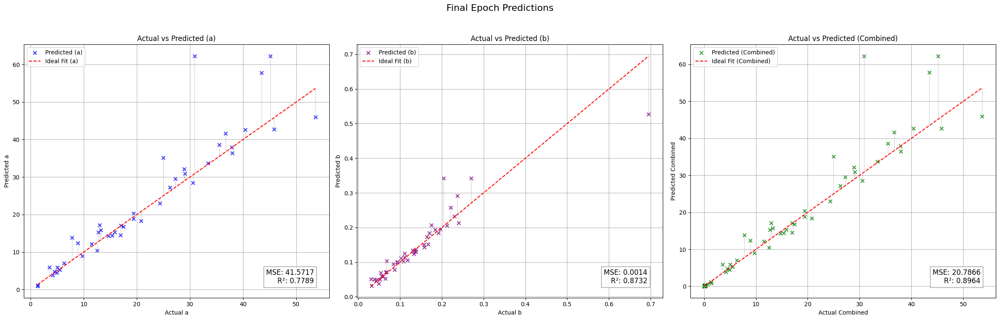

Validation Metrics:
  - MSE: 10.9206
  - R²: 0.9016
  - MAE: 1.3323
  - Explained Variance Score (EVS): 0.9099
Fold 4 Metrics:
  - Validation Loss (MSE): 10.9206
  - R²: 0.9016
  - MAE: 1.3323
  - EVS: 0.9099
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.382]


Validation Metrics:
  - MSE: 35.7860
  - R²: 0.8249
  - MAE: 1.5977
  - Explained Variance Score (EVS): 0.8302
Epoch [1/50], Train Loss: 0.3469, Val Loss: 35.7860
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.363]


Validation Metrics:
  - MSE: 35.4465
  - R²: 0.8268
  - MAE: 1.5612
  - Explained Variance Score (EVS): 0.8320
Epoch [2/50], Train Loss: 0.3443, Val Loss: 35.4465
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.13it/s, loss=0.35]


Validation Metrics:
  - MSE: 34.2835
  - R²: 0.8335
  - MAE: 1.5281
  - Explained Variance Score (EVS): 0.8366
Epoch [3/50], Train Loss: 0.3468, Val Loss: 34.2835
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.356]


Validation Metrics:
  - MSE: 33.8142
  - R²: 0.8360
  - MAE: 1.5104
  - Explained Variance Score (EVS): 0.8391
Epoch [4/50], Train Loss: 0.3306, Val Loss: 33.8142
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.316]


Validation Metrics:
  - MSE: 33.0528
  - R²: 0.8394
  - MAE: 1.4931
  - Explained Variance Score (EVS): 0.8428
Epoch [5/50], Train Loss: 0.3288, Val Loss: 33.0528
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.324]


Validation Metrics:
  - MSE: 32.8758
  - R²: 0.8406
  - MAE: 1.4901
  - Explained Variance Score (EVS): 0.8441
Epoch [6/50], Train Loss: 0.3275, Val Loss: 32.8758
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.311]


Validation Metrics:
  - MSE: 33.0212
  - R²: 0.8395
  - MAE: 1.4972
  - Explained Variance Score (EVS): 0.8436
Epoch [7/50], Train Loss: 0.3128, Val Loss: 33.0212
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.47it/s, loss=0.29]


Validation Metrics:
  - MSE: 33.0187
  - R²: 0.8388
  - MAE: 1.4916
  - Explained Variance Score (EVS): 0.8435
Epoch [8/50], Train Loss: 0.3165, Val Loss: 33.0187
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.37it/s, loss=0.347]


Validation Metrics:
  - MSE: 33.6187
  - R²: 0.8355
  - MAE: 1.4948
  - Explained Variance Score (EVS): 0.8408
Epoch [9/50], Train Loss: 0.3163, Val Loss: 33.6187
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.62it/s, loss=0.329]


Validation Metrics:
  - MSE: 34.3080
  - R²: 0.8314
  - MAE: 1.5096
  - Explained Variance Score (EVS): 0.8377
Epoch [10/50], Train Loss: 0.3180, Val Loss: 34.3080
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.27]


Validation Metrics:
  - MSE: 34.4877
  - R²: 0.8299
  - MAE: 1.5114
  - Explained Variance Score (EVS): 0.8362
Epoch [11/50], Train Loss: 0.3131, Val Loss: 34.4877
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.299]


Validation Metrics:
  - MSE: 34.9907
  - R²: 0.8267
  - MAE: 1.5326
  - Explained Variance Score (EVS): 0.8347
Epoch [12/50], Train Loss: 0.3035, Val Loss: 34.9907
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.77it/s, loss=0.272]


Validation Metrics:
  - MSE: 34.6825
  - R²: 0.8274
  - MAE: 1.5243
  - Explained Variance Score (EVS): 0.8347
Epoch [13/50], Train Loss: 0.2932, Val Loss: 34.6825
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.40it/s, loss=0.299]


Validation Metrics:
  - MSE: 34.4724
  - R²: 0.8279
  - MAE: 1.5214
  - Explained Variance Score (EVS): 0.8349
Epoch [14/50], Train Loss: 0.3042, Val Loss: 34.4724
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.53it/s, loss=0.315]


Validation Metrics:
  - MSE: 34.7822
  - R²: 0.8252
  - MAE: 1.5284
  - Explained Variance Score (EVS): 0.8327
Epoch [15/50], Train Loss: 0.2961, Val Loss: 34.7822
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.312]


Validation Metrics:
  - MSE: 34.0736
  - R²: 0.8276
  - MAE: 1.5037
  - Explained Variance Score (EVS): 0.8338
Epoch [16/50], Train Loss: 0.3179, Val Loss: 34.0736
Current Dropout Rate: 0.3800
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


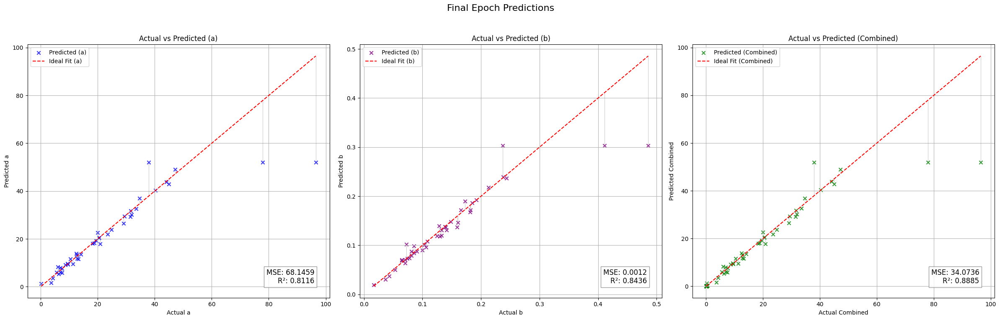

[I 2024-12-01 17:16:13,441] Trial 16 finished with value: 23.263608932495117 and parameters: {'num_layers': 1, 'hidden_size_0': 371, 'activation_0': 'ReLU', 'dropout_0': 0.3290574413555061, 'batch_size': 64, 'learning_rate': 0.00021046058944804028, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.8758
  - R²: 0.8406
  - MAE: 1.4901
  - Explained Variance Score (EVS): 0.8441
Fold 5 Metrics:
  - Validation Loss (MSE): 32.8758
  - R²: 0.8406
  - MAE: 1.4901
  - EVS: 0.8441
Avg Validation Metrics:
  - MSE: 23.2636
  - R²: 0.8562
  - MAE: 1.7022
  - EVS: 0.8624
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=1.4]


Validation Metrics:
  - MSE: 194.8613
  - R²: -0.0167
  - MAE: 6.5525
  - Explained Variance Score (EVS): 0.0003
Epoch [1/50], Train Loss: 1.5836, Val Loss: 194.8613
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=1.33]


Validation Metrics:
  - MSE: 195.0860
  - R²: -0.0186
  - MAE: 6.5424
  - Explained Variance Score (EVS): 0.0001
Epoch [2/50], Train Loss: 1.4010, Val Loss: 195.0860
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.66it/s, loss=1.12]


Validation Metrics:
  - MSE: 195.1714
  - R²: -0.0195
  - MAE: 6.5374
  - Explained Variance Score (EVS): 0.0003
Epoch [3/50], Train Loss: 1.2101, Val Loss: 195.1714
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.933]


Validation Metrics:
  - MSE: 195.2417
  - R²: -0.0199
  - MAE: 6.5339
  - Explained Variance Score (EVS): 0.0003
Epoch [4/50], Train Loss: 1.0795, Val Loss: 195.2417
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=1.1]


Validation Metrics:
  - MSE: 195.3966
  - R²: -0.0208
  - MAE: 6.5227
  - Explained Variance Score (EVS): 0.0003
Epoch [5/50], Train Loss: 0.9807, Val Loss: 195.3966
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.947]


Validation Metrics:
  - MSE: 195.6218
  - R²: -0.0210
  - MAE: 6.5135
  - Explained Variance Score (EVS): 0.0001
Epoch [6/50], Train Loss: 0.9086, Val Loss: 195.6218
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.834]


Validation Metrics:
  - MSE: 195.9510
  - R²: -0.0220
  - MAE: 6.5003
  - Explained Variance Score (EVS): 0.0001
Epoch [7/50], Train Loss: 0.8589, Val Loss: 195.9510
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.732]


Validation Metrics:
  - MSE: 196.3141
  - R²: -0.0238
  - MAE: 6.4878
  - Explained Variance Score (EVS): -0.0001
Epoch [8/50], Train Loss: 0.7974, Val Loss: 196.3141
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.64it/s, loss=0.88]


Validation Metrics:
  - MSE: 196.6622
  - R²: -0.0266
  - MAE: 6.4779
  - Explained Variance Score (EVS): -0.0003
Epoch [9/50], Train Loss: 0.8277, Val Loss: 196.6622
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.33it/s, loss=0.62]


Validation Metrics:
  - MSE: 197.1052
  - R²: -0.0300
  - MAE: 6.4662
  - Explained Variance Score (EVS): -0.0007
Epoch [10/50], Train Loss: 0.7267, Val Loss: 197.1052
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.23it/s, loss=0.72]


Validation Metrics:
  - MSE: 197.4619
  - R²: -0.0332
  - MAE: 6.4549
  - Explained Variance Score (EVS): -0.0007
Epoch [11/50], Train Loss: 0.7042, Val Loss: 197.4619
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


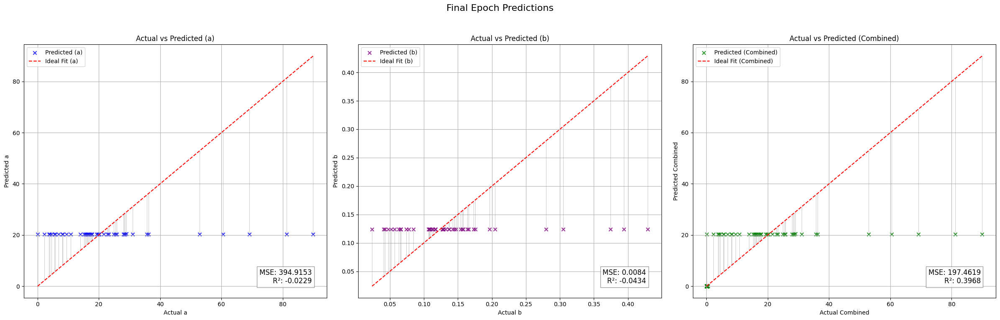

Validation Metrics:
  - MSE: 194.8613
  - R²: -0.0167
  - MAE: 6.5525
  - Explained Variance Score (EVS): 0.0003
Fold 1 Metrics:
  - Validation Loss (MSE): 194.8613
  - R²: -0.0167
  - MAE: 6.5525
  - EVS: 0.0003
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=1.55]


Validation Metrics:
  - MSE: 104.4926
  - R²: -0.1860
  - MAE: 6.2179
  - Explained Variance Score (EVS): -0.0001
Epoch [1/50], Train Loss: 1.4266, Val Loss: 104.4926
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=1.18]


Validation Metrics:
  - MSE: 103.7483
  - R²: -0.1763
  - MAE: 6.1865
  - Explained Variance Score (EVS): 0.0003
Epoch [2/50], Train Loss: 1.2938, Val Loss: 103.7483
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=1.24]


Validation Metrics:
  - MSE: 102.9223
  - R²: -0.1683
  - MAE: 6.1521
  - Explained Variance Score (EVS): 0.0003
Epoch [3/50], Train Loss: 1.1875, Val Loss: 102.9223
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.985]


Validation Metrics:
  - MSE: 102.9719
  - R²: -0.1685
  - MAE: 6.1546
  - Explained Variance Score (EVS): 0.0002
Epoch [4/50], Train Loss: 1.1067, Val Loss: 102.9719
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.996]


Validation Metrics:
  - MSE: 102.9719
  - R²: -0.1715
  - MAE: 6.1559
  - Explained Variance Score (EVS): 0.0006
Epoch [5/50], Train Loss: 0.9750, Val Loss: 102.9719
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.801]


Validation Metrics:
  - MSE: 102.4283
  - R²: -0.1719
  - MAE: 6.1335
  - Explained Variance Score (EVS): 0.0004
Epoch [6/50], Train Loss: 0.8688, Val Loss: 102.4283
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.853]


Validation Metrics:
  - MSE: 102.0549
  - R²: -0.1706
  - MAE: 6.1172
  - Explained Variance Score (EVS): 0.0002
Epoch [7/50], Train Loss: 0.8214, Val Loss: 102.0549
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.67]


Validation Metrics:
  - MSE: 101.0345
  - R²: -0.1648
  - MAE: 6.0710
  - Explained Variance Score (EVS): -0.0004
Epoch [8/50], Train Loss: 0.7318, Val Loss: 101.0345
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=0.787]


Validation Metrics:
  - MSE: 100.2120
  - R²: -0.1577
  - MAE: 6.0328
  - Explained Variance Score (EVS): -0.0004
Epoch [9/50], Train Loss: 0.7382, Val Loss: 100.2120
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.17it/s, loss=0.652]


Validation Metrics:
  - MSE: 99.7815
  - R²: -0.1504
  - MAE: 6.0116
  - Explained Variance Score (EVS): -0.0009
Epoch [10/50], Train Loss: 0.6957, Val Loss: 99.7815
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.775]


Validation Metrics:
  - MSE: 98.7884
  - R²: -0.1402
  - MAE: 5.9676
  - Explained Variance Score (EVS): -0.0004
Epoch [11/50], Train Loss: 0.6971, Val Loss: 98.7884
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s, loss=0.617]


Validation Metrics:
  - MSE: 98.1207
  - R²: -0.1307
  - MAE: 5.9386
  - Explained Variance Score (EVS): 0.0002
Epoch [12/50], Train Loss: 0.6497, Val Loss: 98.1207
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.72]


Validation Metrics:
  - MSE: 98.0984
  - R²: -0.1279
  - MAE: 5.9375
  - Explained Variance Score (EVS): -0.0002
Epoch [13/50], Train Loss: 0.6401, Val Loss: 98.0984
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.731]


Validation Metrics:
  - MSE: 98.4246
  - R²: -0.1282
  - MAE: 5.9521
  - Explained Variance Score (EVS): -0.0002
Epoch [14/50], Train Loss: 0.6175, Val Loss: 98.4246
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.496]


Validation Metrics:
  - MSE: 98.5552
  - R²: -0.1299
  - MAE: 5.9578
  - Explained Variance Score (EVS): -0.0001
Epoch [15/50], Train Loss: 0.5588, Val Loss: 98.5552
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.63]


Validation Metrics:
  - MSE: 98.8245
  - R²: -0.1351
  - MAE: 5.9708
  - Explained Variance Score (EVS): 0.0001
Epoch [16/50], Train Loss: 0.5565, Val Loss: 98.8245
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.581]


Validation Metrics:
  - MSE: 99.0458
  - R²: -0.1374
  - MAE: 5.9808
  - Explained Variance Score (EVS): 0.0005
Epoch [17/50], Train Loss: 0.5304, Val Loss: 99.0458
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.70it/s, loss=0.441]


Validation Metrics:
  - MSE: 99.1448
  - R²: -0.1394
  - MAE: 5.9853
  - Explained Variance Score (EVS): 0.0012
Epoch [18/50], Train Loss: 0.5110, Val Loss: 99.1448
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=0.527]


Validation Metrics:
  - MSE: 99.3689
  - R²: -0.1447
  - MAE: 5.9946
  - Explained Variance Score (EVS): 0.0011
Epoch [19/50], Train Loss: 0.4923, Val Loss: 99.3689
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.572]


Validation Metrics:
  - MSE: 99.8411
  - R²: -0.1527
  - MAE: 6.0164
  - Explained Variance Score (EVS): 0.0008
Epoch [20/50], Train Loss: 0.4804, Val Loss: 99.8411
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.475]


Validation Metrics:
  - MSE: 100.3292
  - R²: -0.1596
  - MAE: 6.0388
  - Explained Variance Score (EVS): 0.0004
Epoch [21/50], Train Loss: 0.4688, Val Loss: 100.3292
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.54]


Validation Metrics:
  - MSE: 100.6899
  - R²: -0.1632
  - MAE: 6.0552
  - Explained Variance Score (EVS): 0.0002
Epoch [22/50], Train Loss: 0.4639, Val Loss: 100.6899
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.471]


Validation Metrics:
  - MSE: 101.0204
  - R²: -0.1659
  - MAE: 6.0709
  - Explained Variance Score (EVS): 0.0006
Epoch [23/50], Train Loss: 0.4647, Val Loss: 101.0204
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


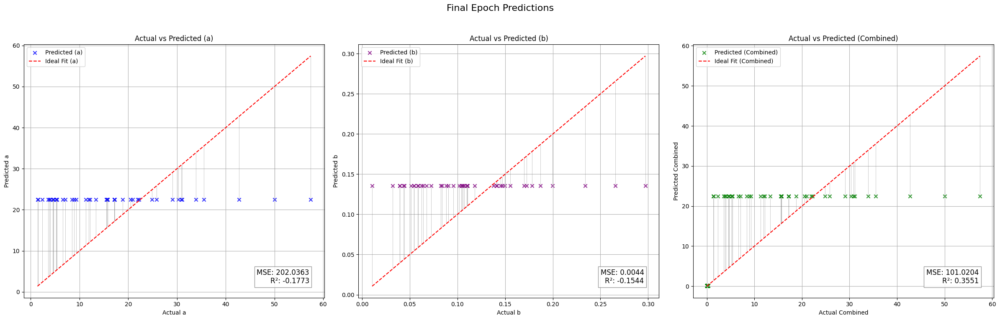

Validation Metrics:
  - MSE: 98.0984
  - R²: -0.1279
  - MAE: 5.9375
  - Explained Variance Score (EVS): -0.0002
Fold 2 Metrics:
  - Validation Loss (MSE): 98.0984
  - R²: -0.1279
  - MAE: 5.9375
  - EVS: -0.0002
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=0.617]


Validation Metrics:
  - MSE: 111.2641
  - R²: -0.0073
  - MAE: 5.4414
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.6095, Val Loss: 111.2641
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.663]


Validation Metrics:
  - MSE: 111.2484
  - R²: -0.0072
  - MAE: 5.4497
  - Explained Variance Score (EVS): -0.0004
Epoch [2/50], Train Loss: 0.6187, Val Loss: 111.2484
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.586]


Validation Metrics:
  - MSE: 111.2231
  - R²: -0.0067
  - MAE: 5.4534
  - Explained Variance Score (EVS): -0.0003
Epoch [3/50], Train Loss: 0.5865, Val Loss: 111.2231
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.468]


Validation Metrics:
  - MSE: 111.2072
  - R²: -0.0059
  - MAE: 5.4591
  - Explained Variance Score (EVS): -0.0001
Epoch [4/50], Train Loss: 0.5590, Val Loss: 111.2072
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s, loss=0.456]


Validation Metrics:
  - MSE: 111.1650
  - R²: -0.0050
  - MAE: 5.4621
  - Explained Variance Score (EVS): 0.0002
Epoch [5/50], Train Loss: 0.5352, Val Loss: 111.1650
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  7.04it/s, loss=0.515]


Validation Metrics:
  - MSE: 111.1491
  - R²: -0.0042
  - MAE: 5.4626
  - Explained Variance Score (EVS): 0.0005
Epoch [6/50], Train Loss: 0.5198, Val Loss: 111.1491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=0.558]


Validation Metrics:
  - MSE: 111.1469
  - R²: -0.0034
  - MAE: 5.4578
  - Explained Variance Score (EVS): 0.0009
Epoch [7/50], Train Loss: 0.4875, Val Loss: 111.1469
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=0.48]


Validation Metrics:
  - MSE: 111.1751
  - R²: -0.0034
  - MAE: 5.4521
  - Explained Variance Score (EVS): 0.0009
Epoch [8/50], Train Loss: 0.4576, Val Loss: 111.1751
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.471]


Validation Metrics:
  - MSE: 111.1961
  - R²: -0.0031
  - MAE: 5.4511
  - Explained Variance Score (EVS): 0.0010
Epoch [9/50], Train Loss: 0.4582, Val Loss: 111.1961
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.73it/s, loss=0.398]


Validation Metrics:
  - MSE: 111.1760
  - R²: -0.0023
  - MAE: 5.4496
  - Explained Variance Score (EVS): 0.0012
Epoch [10/50], Train Loss: 0.4429, Val Loss: 111.1760
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=0.376]


Validation Metrics:
  - MSE: 111.2088
  - R²: -0.0023
  - MAE: 5.4502
  - Explained Variance Score (EVS): 0.0009
Epoch [11/50], Train Loss: 0.4305, Val Loss: 111.2088
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.05it/s, loss=0.37]


Validation Metrics:
  - MSE: 111.1737
  - R²: -0.0018
  - MAE: 5.4548
  - Explained Variance Score (EVS): 0.0012
Epoch [12/50], Train Loss: 0.4210, Val Loss: 111.1737
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.467]


Validation Metrics:
  - MSE: 111.1170
  - R²: -0.0016
  - MAE: 5.4560
  - Explained Variance Score (EVS): 0.0014
Epoch [13/50], Train Loss: 0.4102, Val Loss: 111.1170
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.347]


Validation Metrics:
  - MSE: 111.0579
  - R²: -0.0011
  - MAE: 5.4560
  - Explained Variance Score (EVS): 0.0019
Epoch [14/50], Train Loss: 0.3828, Val Loss: 111.0579
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s, loss=0.411]


Validation Metrics:
  - MSE: 111.0491
  - R²: -0.0010
  - MAE: 5.4560
  - Explained Variance Score (EVS): 0.0019
Epoch [15/50], Train Loss: 0.3755, Val Loss: 111.0491
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.468]


Validation Metrics:
  - MSE: 111.0396
  - R²: -0.0006
  - MAE: 5.4542
  - Explained Variance Score (EVS): 0.0023
Epoch [16/50], Train Loss: 0.3845, Val Loss: 111.0396
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.17it/s, loss=0.333]


Validation Metrics:
  - MSE: 110.9225
  - R²: 0.0006
  - MAE: 5.4482
  - Explained Variance Score (EVS): 0.0035
Epoch [17/50], Train Loss: 0.3707, Val Loss: 110.9225
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.242]


Validation Metrics:
  - MSE: 110.7936
  - R²: 0.0023
  - MAE: 5.4369
  - Explained Variance Score (EVS): 0.0055
Epoch [18/50], Train Loss: 0.3560, Val Loss: 110.7936
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=0.434]


Validation Metrics:
  - MSE: 110.6695
  - R²: 0.0040
  - MAE: 5.4286
  - Explained Variance Score (EVS): 0.0074
Epoch [19/50], Train Loss: 0.3761, Val Loss: 110.6695
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.406]


Validation Metrics:
  - MSE: 110.3728
  - R²: 0.0078
  - MAE: 5.4178
  - Explained Variance Score (EVS): 0.0115
Epoch [20/50], Train Loss: 0.3751, Val Loss: 110.3728
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.31it/s, loss=0.464]


Validation Metrics:
  - MSE: 110.2135
  - R²: 0.0088
  - MAE: 5.4064
  - Explained Variance Score (EVS): 0.0127
Epoch [21/50], Train Loss: 0.3839, Val Loss: 110.2135
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.72it/s, loss=0.329]


Validation Metrics:
  - MSE: 109.6013
  - R²: 0.0171
  - MAE: 5.3908
  - Explained Variance Score (EVS): 0.0206
Epoch [22/50], Train Loss: 0.3742, Val Loss: 109.6013
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.448]


Validation Metrics:
  - MSE: 109.1246
  - R²: 0.0226
  - MAE: 5.3768
  - Explained Variance Score (EVS): 0.0261
Epoch [23/50], Train Loss: 0.3875, Val Loss: 109.1246
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.364]


Validation Metrics:
  - MSE: 108.6514
  - R²: 0.0268
  - MAE: 5.3628
  - Explained Variance Score (EVS): 0.0303
Epoch [24/50], Train Loss: 0.3867, Val Loss: 108.6514
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.407]


Validation Metrics:
  - MSE: 107.8542
  - R²: 0.0336
  - MAE: 5.3508
  - Explained Variance Score (EVS): 0.0366
Epoch [25/50], Train Loss: 0.3905, Val Loss: 107.8542
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.478]


Validation Metrics:
  - MSE: 107.7217
  - R²: 0.0336
  - MAE: 5.3418
  - Explained Variance Score (EVS): 0.0365
Epoch [26/50], Train Loss: 0.4029, Val Loss: 107.7217
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.513]


Validation Metrics:
  - MSE: 107.4778
  - R²: 0.0349
  - MAE: 5.3370
  - Explained Variance Score (EVS): 0.0374
Epoch [27/50], Train Loss: 0.4106, Val Loss: 107.4778
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.334]


Validation Metrics:
  - MSE: 107.1503
  - R²: 0.0371
  - MAE: 5.3318
  - Explained Variance Score (EVS): 0.0392
Epoch [28/50], Train Loss: 0.3972, Val Loss: 107.1503
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.297]


Validation Metrics:
  - MSE: 107.5107
  - R²: 0.0333
  - MAE: 5.3324
  - Explained Variance Score (EVS): 0.0352
Epoch [29/50], Train Loss: 0.3968, Val Loss: 107.5107
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.23it/s, loss=0.42]


Validation Metrics:
  - MSE: 106.8525
  - R²: 0.0378
  - MAE: 5.3219
  - Explained Variance Score (EVS): 0.0395
Epoch [30/50], Train Loss: 0.4085, Val Loss: 106.8525
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.313]


Validation Metrics:
  - MSE: 105.8913
  - R²: 0.0447
  - MAE: 5.3094
  - Explained Variance Score (EVS): 0.0461
Epoch [31/50], Train Loss: 0.3995, Val Loss: 105.8913
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.433]


Validation Metrics:
  - MSE: 105.1706
  - R²: 0.0500
  - MAE: 5.2986
  - Explained Variance Score (EVS): 0.0512
Epoch [32/50], Train Loss: 0.4104, Val Loss: 105.1706
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.37]


Validation Metrics:
  - MSE: 104.9984
  - R²: 0.0505
  - MAE: 5.2894
  - Explained Variance Score (EVS): 0.0516
Epoch [33/50], Train Loss: 0.4047, Val Loss: 104.9984
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=0.381]


Validation Metrics:
  - MSE: 104.5030
  - R²: 0.0535
  - MAE: 5.2835
  - Explained Variance Score (EVS): 0.0544
Epoch [34/50], Train Loss: 0.4069, Val Loss: 104.5030
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.376]


Validation Metrics:
  - MSE: 104.3991
  - R²: 0.0543
  - MAE: 5.2878
  - Explained Variance Score (EVS): 0.0552
Epoch [35/50], Train Loss: 0.4059, Val Loss: 104.3991
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.392]


Validation Metrics:
  - MSE: 104.7420
  - R²: 0.0511
  - MAE: 5.2871
  - Explained Variance Score (EVS): 0.0520
Epoch [36/50], Train Loss: 0.4081, Val Loss: 104.7420
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  4.46it/s, loss=0.34]


Validation Metrics:
  - MSE: 104.0556
  - R²: 0.0562
  - MAE: 5.2832
  - Explained Variance Score (EVS): 0.0569
Epoch [37/50], Train Loss: 0.4031, Val Loss: 104.0556
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=0.405]


Validation Metrics:
  - MSE: 103.9883
  - R²: 0.0567
  - MAE: 5.2762
  - Explained Variance Score (EVS): 0.0575
Epoch [38/50], Train Loss: 0.4088, Val Loss: 103.9883
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s, loss=0.458]


Validation Metrics:
  - MSE: 104.1855
  - R²: 0.0550
  - MAE: 5.2775
  - Explained Variance Score (EVS): 0.0558
Epoch [39/50], Train Loss: 0.4134, Val Loss: 104.1855
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.383]


Validation Metrics:
  - MSE: 104.3828
  - R²: 0.0532
  - MAE: 5.2857
  - Explained Variance Score (EVS): 0.0539
Epoch [40/50], Train Loss: 0.4071, Val Loss: 104.3828
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.387]


Validation Metrics:
  - MSE: 104.2404
  - R²: 0.0545
  - MAE: 5.2835
  - Explained Variance Score (EVS): 0.0552
Epoch [41/50], Train Loss: 0.4068, Val Loss: 104.2404
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.61it/s, loss=0.378]


Validation Metrics:
  - MSE: 104.0578
  - R²: 0.0560
  - MAE: 5.2821
  - Explained Variance Score (EVS): 0.0567
Epoch [42/50], Train Loss: 0.4067, Val Loss: 104.0578
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.289]


Validation Metrics:
  - MSE: 104.2681
  - R²: 0.0542
  - MAE: 5.2823
  - Explained Variance Score (EVS): 0.0550
Epoch [43/50], Train Loss: 0.3988, Val Loss: 104.2681
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.405]


Validation Metrics:
  - MSE: 104.4886
  - R²: 0.0524
  - MAE: 5.2835
  - Explained Variance Score (EVS): 0.0532
Epoch [44/50], Train Loss: 0.4088, Val Loss: 104.4886
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s, loss=0.445]


Validation Metrics:
  - MSE: 104.7463
  - R²: 0.0506
  - MAE: 5.2889
  - Explained Variance Score (EVS): 0.0514
Epoch [45/50], Train Loss: 0.4128, Val Loss: 104.7463
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.438]


Validation Metrics:
  - MSE: 104.8697
  - R²: 0.0499
  - MAE: 5.2935
  - Explained Variance Score (EVS): 0.0507
Epoch [46/50], Train Loss: 0.4126, Val Loss: 104.8697
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  6.30it/s, loss=0.354]


Validation Metrics:
  - MSE: 104.8599
  - R²: 0.0501
  - MAE: 5.2955
  - Explained Variance Score (EVS): 0.0509
Epoch [47/50], Train Loss: 0.4053, Val Loss: 104.8599
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.368]


Validation Metrics:
  - MSE: 104.7122
  - R²: 0.0510
  - MAE: 5.2946
  - Explained Variance Score (EVS): 0.0518
Epoch [48/50], Train Loss: 0.4066, Val Loss: 104.7122
Current Dropout Rate: 0.1240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


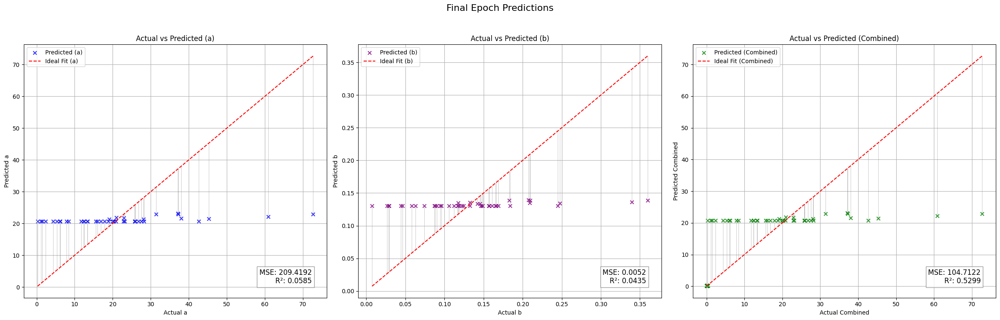

Validation Metrics:
  - MSE: 103.9883
  - R²: 0.0567
  - MAE: 5.2762
  - Explained Variance Score (EVS): 0.0575
Fold 3 Metrics:
  - Validation Loss (MSE): 103.9883
  - R²: 0.0567
  - MAE: 5.2762
  - EVS: 0.0575
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.508]


Validation Metrics:
  - MSE: 91.1865
  - R²: 0.0158
  - MAE: 5.8097
  - Explained Variance Score (EVS): 0.0199
Epoch [1/50], Train Loss: 0.4300, Val Loss: 91.1865
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.48]


Validation Metrics:
  - MSE: 93.1409
  - R²: 0.0027
  - MAE: 5.8692
  - Explained Variance Score (EVS): 0.0069
Epoch [2/50], Train Loss: 0.4319, Val Loss: 93.1409
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.306]


Validation Metrics:
  - MSE: 93.7739
  - R²: -0.0020
  - MAE: 5.8901
  - Explained Variance Score (EVS): 0.0021
Epoch [3/50], Train Loss: 0.4195, Val Loss: 93.7739
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.94it/s, loss=0.496]


Validation Metrics:
  - MSE: 93.8562
  - R²: -0.0023
  - MAE: 5.8961
  - Explained Variance Score (EVS): 0.0016
Epoch [4/50], Train Loss: 0.4388, Val Loss: 93.8562
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.42]


Validation Metrics:
  - MSE: 93.7989
  - R²: -0.0017
  - MAE: 5.8959
  - Explained Variance Score (EVS): 0.0020
Epoch [5/50], Train Loss: 0.4329, Val Loss: 93.7989
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.67]


Validation Metrics:
  - MSE: 93.8301
  - R²: -0.0018
  - MAE: 5.8993
  - Explained Variance Score (EVS): 0.0018
Epoch [6/50], Train Loss: 0.4556, Val Loss: 93.8301
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.315]


Validation Metrics:
  - MSE: 93.8475
  - R²: -0.0018
  - MAE: 5.9011
  - Explained Variance Score (EVS): 0.0017
Epoch [7/50], Train Loss: 0.4245, Val Loss: 93.8475
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.501]


Validation Metrics:
  - MSE: 93.8719
  - R²: -0.0019
  - MAE: 5.9031
  - Explained Variance Score (EVS): 0.0015
Epoch [8/50], Train Loss: 0.4411, Val Loss: 93.8719
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.473]


Validation Metrics:
  - MSE: 93.9119
  - R²: -0.0022
  - MAE: 5.9056
  - Explained Variance Score (EVS): 0.0011
Epoch [9/50], Train Loss: 0.4391, Val Loss: 93.9119
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.441]


Validation Metrics:
  - MSE: 93.9211
  - R²: -0.0023
  - MAE: 5.9058
  - Explained Variance Score (EVS): 0.0010
Epoch [10/50], Train Loss: 0.4367, Val Loss: 93.9211
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.45]


Validation Metrics:
  - MSE: 93.9635
  - R²: -0.0024
  - MAE: 5.9082
  - Explained Variance Score (EVS): 0.0008
Epoch [11/50], Train Loss: 0.4375, Val Loss: 93.9635
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


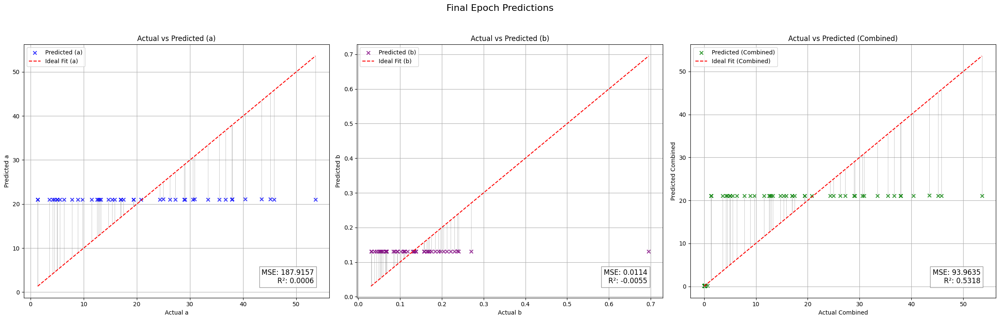

Validation Metrics:
  - MSE: 91.1865
  - R²: 0.0158
  - MAE: 5.8097
  - Explained Variance Score (EVS): 0.0199
Fold 4 Metrics:
  - Validation Loss (MSE): 91.1865
  - R²: 0.0158
  - MAE: 5.8097
  - EVS: 0.0199
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=0.593]


Validation Metrics:
  - MSE: 177.9125
  - R²: 0.0187
  - MAE: 6.6477
  - Explained Variance Score (EVS): 0.0265
Epoch [1/50], Train Loss: 0.4378, Val Loss: 177.9125
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.22it/s, loss=0.424]


Validation Metrics:
  - MSE: 179.6830
  - R²: 0.0098
  - MAE: 6.6862
  - Explained Variance Score (EVS): 0.0180
Epoch [2/50], Train Loss: 0.4261, Val Loss: 179.6830
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.378]


Validation Metrics:
  - MSE: 181.1239
  - R²: 0.0022
  - MAE: 6.7167
  - Explained Variance Score (EVS): 0.0106
Epoch [3/50], Train Loss: 0.4235, Val Loss: 181.1239
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.564]


Validation Metrics:
  - MSE: 181.2703
  - R²: 0.0009
  - MAE: 6.7206
  - Explained Variance Score (EVS): 0.0090
Epoch [4/50], Train Loss: 0.4416, Val Loss: 181.2703
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.358]


Validation Metrics:
  - MSE: 181.4260
  - R²: -0.0001
  - MAE: 6.7272
  - Explained Variance Score (EVS): 0.0077
Epoch [5/50], Train Loss: 0.4249, Val Loss: 181.4260
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.525]


Validation Metrics:
  - MSE: 181.4908
  - R²: -0.0005
  - MAE: 6.7299
  - Explained Variance Score (EVS): 0.0072
Epoch [6/50], Train Loss: 0.4400, Val Loss: 181.4908
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=0.437]


Validation Metrics:
  - MSE: 181.5514
  - R²: -0.0009
  - MAE: 6.7328
  - Explained Variance Score (EVS): 0.0066
Epoch [7/50], Train Loss: 0.4329, Val Loss: 181.5514
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.442]


Validation Metrics:
  - MSE: 181.6337
  - R²: -0.0015
  - MAE: 6.7367
  - Explained Variance Score (EVS): 0.0059
Epoch [8/50], Train Loss: 0.4335, Val Loss: 181.6337
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.404]


Validation Metrics:
  - MSE: 181.6349
  - R²: -0.0017
  - MAE: 6.7361
  - Explained Variance Score (EVS): 0.0056
Epoch [9/50], Train Loss: 0.4310, Val Loss: 181.6349
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=0.431]


Validation Metrics:
  - MSE: 181.7265
  - R²: -0.0024
  - MAE: 6.7403
  - Explained Variance Score (EVS): 0.0048
Epoch [10/50], Train Loss: 0.4335, Val Loss: 181.7265
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=0.511]


Validation Metrics:
  - MSE: 181.8202
  - R²: -0.0030
  - MAE: 6.7445
  - Explained Variance Score (EVS): 0.0041
Epoch [11/50], Train Loss: 0.4403, Val Loss: 181.8202
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


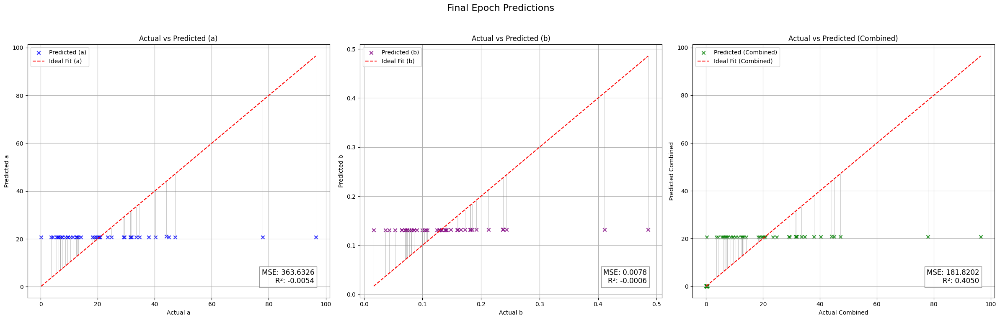

[I 2024-12-01 17:18:13,133] Trial 17 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 177.9125
  - R²: 0.0187
  - MAE: 6.6477
  - Explained Variance Score (EVS): 0.0265
Fold 5 Metrics:
  - Validation Loss (MSE): 177.9125
  - R²: 0.0187
  - MAE: 6.6477
  - EVS: 0.0265
Avg Validation Metrics:
  - MSE: 133.2094
  - R²: -0.0107
  - MAE: 6.0447
  - EVS: 0.0208
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=1.67]


Validation Metrics:
  - MSE: 188.4163
  - R²: 0.0280
  - MAE: 6.3109
  - Explained Variance Score (EVS): 0.0412
Epoch [1/50], Train Loss: 1.7584, Val Loss: 188.4163
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=1.68]


Validation Metrics:
  - MSE: 182.8013
  - R²: 0.0516
  - MAE: 6.1779
  - Explained Variance Score (EVS): 0.0650
Epoch [2/50], Train Loss: 1.6554, Val Loss: 182.8013
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=1.57]


Validation Metrics:
  - MSE: 180.6844
  - R²: 0.0582
  - MAE: 6.0914
  - Explained Variance Score (EVS): 0.0747
Epoch [3/50], Train Loss: 1.6201, Val Loss: 180.6844
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=1.57]


Validation Metrics:
  - MSE: 181.0707
  - R²: 0.0592
  - MAE: 6.0529
  - Explained Variance Score (EVS): 0.0801
Epoch [4/50], Train Loss: 1.5859, Val Loss: 181.0707
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.33it/s, loss=1.51]


Validation Metrics:
  - MSE: 178.5345
  - R²: 0.0848
  - MAE: 5.9834
  - Explained Variance Score (EVS): 0.1064
Epoch [5/50], Train Loss: 1.5516, Val Loss: 178.5345
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=1.55]


Validation Metrics:
  - MSE: 174.4119
  - R²: 0.1155
  - MAE: 5.8837
  - Explained Variance Score (EVS): 0.1370
Epoch [6/50], Train Loss: 1.5301, Val Loss: 174.4119
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=1.45]


Validation Metrics:
  - MSE: 168.2281
  - R²: 0.1417
  - MAE: 5.7466
  - Explained Variance Score (EVS): 0.1628
Epoch [7/50], Train Loss: 1.4906, Val Loss: 168.2281
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s, loss=1.46]


Validation Metrics:
  - MSE: 165.5063
  - R²: 0.1485
  - MAE: 5.6392
  - Explained Variance Score (EVS): 0.1716
Epoch [8/50], Train Loss: 1.4772, Val Loss: 165.5063
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=1.46]


Validation Metrics:
  - MSE: 160.5775
  - R²: 0.1795
  - MAE: 5.5358
  - Explained Variance Score (EVS): 0.2015
Epoch [9/50], Train Loss: 1.4593, Val Loss: 160.5775
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=1.43]


Validation Metrics:
  - MSE: 152.3823
  - R²: 0.2341
  - MAE: 5.3984
  - Explained Variance Score (EVS): 0.2556
Epoch [10/50], Train Loss: 1.4238, Val Loss: 152.3823
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=1.38]


Validation Metrics:
  - MSE: 144.1404
  - R²: 0.2947
  - MAE: 5.2134
  - Explained Variance Score (EVS): 0.3155
Epoch [11/50], Train Loss: 1.4058, Val Loss: 144.1404
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=1.34]


Validation Metrics:
  - MSE: 134.7117
  - R²: 0.3421
  - MAE: 4.9594
  - Explained Variance Score (EVS): 0.3623
Epoch [12/50], Train Loss: 1.3807, Val Loss: 134.7117
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s, loss=1.37]


Validation Metrics:
  - MSE: 129.3958
  - R²: 0.3569
  - MAE: 4.7944
  - Explained Variance Score (EVS): 0.3806
Epoch [13/50], Train Loss: 1.3636, Val Loss: 129.3958
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=1.35]


Validation Metrics:
  - MSE: 119.2988
  - R²: 0.3846
  - MAE: 4.5804
  - Explained Variance Score (EVS): 0.4057
Epoch [14/50], Train Loss: 1.3217, Val Loss: 119.2988
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=1.29]


Validation Metrics:
  - MSE: 110.4050
  - R²: 0.4189
  - MAE: 4.3912
  - Explained Variance Score (EVS): 0.4379
Epoch [15/50], Train Loss: 1.3010, Val Loss: 110.4050
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=1.26]


Validation Metrics:
  - MSE: 99.6921
  - R²: 0.4941
  - MAE: 4.1978
  - Explained Variance Score (EVS): 0.5105
Epoch [16/50], Train Loss: 1.2715, Val Loss: 99.6921
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=1.25]


Validation Metrics:
  - MSE: 90.1520
  - R²: 0.5491
  - MAE: 4.0478
  - Explained Variance Score (EVS): 0.5634
Epoch [17/50], Train Loss: 1.2531, Val Loss: 90.1520
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=1.2]


Validation Metrics:
  - MSE: 83.5545
  - R²: 0.5851
  - MAE: 3.8747
  - Explained Variance Score (EVS): 0.6016
Epoch [18/50], Train Loss: 1.2233, Val Loss: 83.5545
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=1.18]


Validation Metrics:
  - MSE: 84.8903
  - R²: 0.5894
  - MAE: 3.7878
  - Explained Variance Score (EVS): 0.6094
Epoch [19/50], Train Loss: 1.2002, Val Loss: 84.8903
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.38it/s, loss=1.14]


Validation Metrics:
  - MSE: 79.2407
  - R²: 0.6127
  - MAE: 3.7094
  - Explained Variance Score (EVS): 0.6337
Epoch [20/50], Train Loss: 1.1665, Val Loss: 79.2407
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.01it/s, loss=1.11]


Validation Metrics:
  - MSE: 81.1570
  - R²: 0.5978
  - MAE: 3.7671
  - Explained Variance Score (EVS): 0.6224
Epoch [21/50], Train Loss: 1.1401, Val Loss: 81.1570
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=1.12]


Validation Metrics:
  - MSE: 74.0134
  - R²: 0.6464
  - MAE: 3.6727
  - Explained Variance Score (EVS): 0.6604
Epoch [22/50], Train Loss: 1.1248, Val Loss: 74.0134
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.40it/s, loss=1.04]


Validation Metrics:
  - MSE: 74.7819
  - R²: 0.6637
  - MAE: 3.5722
  - Explained Variance Score (EVS): 0.6749
Epoch [23/50], Train Loss: 1.0955, Val Loss: 74.7819
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=1.05]


Validation Metrics:
  - MSE: 78.6356
  - R²: 0.6526
  - MAE: 3.5827
  - Explained Variance Score (EVS): 0.6623
Epoch [24/50], Train Loss: 1.0757, Val Loss: 78.6356
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  4.63it/s, loss=1.06]


Validation Metrics:
  - MSE: 71.2033
  - R²: 0.6695
  - MAE: 3.5059
  - Explained Variance Score (EVS): 0.6794
Epoch [25/50], Train Loss: 1.0473, Val Loss: 71.2033
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=1.02]


Validation Metrics:
  - MSE: 61.9448
  - R²: 0.7072
  - MAE: 3.3847
  - Explained Variance Score (EVS): 0.7155
Epoch [26/50], Train Loss: 1.0166, Val Loss: 61.9448
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.965]


Validation Metrics:
  - MSE: 62.9092
  - R²: 0.6959
  - MAE: 3.3190
  - Explained Variance Score (EVS): 0.7092
Epoch [27/50], Train Loss: 0.9895, Val Loss: 62.9092
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.992]


Validation Metrics:
  - MSE: 70.8560
  - R²: 0.6623
  - MAE: 3.3834
  - Explained Variance Score (EVS): 0.6768
Epoch [28/50], Train Loss: 0.9633, Val Loss: 70.8560
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.13it/s, loss=0.924]


Validation Metrics:
  - MSE: 76.3538
  - R²: 0.6429
  - MAE: 3.4461
  - Explained Variance Score (EVS): 0.6640
Epoch [29/50], Train Loss: 0.9322, Val Loss: 76.3538
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.896]


Validation Metrics:
  - MSE: 76.8611
  - R²: 0.6315
  - MAE: 3.4401
  - Explained Variance Score (EVS): 0.6606
Epoch [30/50], Train Loss: 0.9120, Val Loss: 76.8611
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=0.935]


Validation Metrics:
  - MSE: 67.3674
  - R²: 0.6668
  - MAE: 3.3501
  - Explained Variance Score (EVS): 0.6836
Epoch [31/50], Train Loss: 0.9034, Val Loss: 67.3674
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.828]


Validation Metrics:
  - MSE: 55.4940
  - R²: 0.7266
  - MAE: 3.2106
  - Explained Variance Score (EVS): 0.7363
Epoch [32/50], Train Loss: 0.8518, Val Loss: 55.4940
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s, loss=0.807]


Validation Metrics:
  - MSE: 55.4464
  - R²: 0.7226
  - MAE: 3.2606
  - Explained Variance Score (EVS): 0.7347
Epoch [33/50], Train Loss: 0.8431, Val Loss: 55.4464
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.777]


Validation Metrics:
  - MSE: 55.9577
  - R²: 0.7217
  - MAE: 3.2750
  - Explained Variance Score (EVS): 0.7343
Epoch [34/50], Train Loss: 0.8171, Val Loss: 55.9577
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  6.52it/s, loss=0.799]


Validation Metrics:
  - MSE: 65.0959
  - R²: 0.6844
  - MAE: 3.3755
  - Explained Variance Score (EVS): 0.7026
Epoch [35/50], Train Loss: 0.7893, Val Loss: 65.0959
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.777]


Validation Metrics:
  - MSE: 81.4252
  - R²: 0.6076
  - MAE: 3.6432
  - Explained Variance Score (EVS): 0.6378
Epoch [36/50], Train Loss: 0.7793, Val Loss: 81.4252
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=0.735]


Validation Metrics:
  - MSE: 67.2614
  - R²: 0.6567
  - MAE: 3.3862
  - Explained Variance Score (EVS): 0.6753
Epoch [37/50], Train Loss: 0.7442, Val Loss: 67.2614
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.686]


Validation Metrics:
  - MSE: 51.9313
  - R²: 0.7318
  - MAE: 3.2358
  - Explained Variance Score (EVS): 0.7372
Epoch [38/50], Train Loss: 0.7256, Val Loss: 51.9313
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  6.37it/s, loss=0.698]


Validation Metrics:
  - MSE: 56.4470
  - R²: 0.7153
  - MAE: 3.2251
  - Explained Variance Score (EVS): 0.7242
Epoch [39/50], Train Loss: 0.7012, Val Loss: 56.4470
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.66]


Validation Metrics:
  - MSE: 63.8869
  - R²: 0.6684
  - MAE: 3.3166
  - Explained Variance Score (EVS): 0.6931
Epoch [40/50], Train Loss: 0.6818, Val Loss: 63.8869
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s, loss=0.624]


Validation Metrics:
  - MSE: 76.6446
  - R²: 0.5903
  - MAE: 3.6058
  - Explained Variance Score (EVS): 0.6281
Epoch [41/50], Train Loss: 0.6616, Val Loss: 76.6446
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.637]


Validation Metrics:
  - MSE: 65.0828
  - R²: 0.6647
  - MAE: 3.3877
  - Explained Variance Score (EVS): 0.6880
Epoch [42/50], Train Loss: 0.6412, Val Loss: 65.0828
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.615]


Validation Metrics:
  - MSE: 62.4142
  - R²: 0.6721
  - MAE: 3.3791
  - Explained Variance Score (EVS): 0.6831
Epoch [43/50], Train Loss: 0.6145, Val Loss: 62.4142
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.598]


Validation Metrics:
  - MSE: 62.4170
  - R²: 0.6797
  - MAE: 3.3677
  - Explained Variance Score (EVS): 0.6832
Epoch [44/50], Train Loss: 0.5986, Val Loss: 62.4170
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.619]


Validation Metrics:
  - MSE: 65.4217
  - R²: 0.6781
  - MAE: 3.2996
  - Explained Variance Score (EVS): 0.6819
Epoch [45/50], Train Loss: 0.6010, Val Loss: 65.4217
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.546]


Validation Metrics:
  - MSE: 60.8699
  - R²: 0.7049
  - MAE: 3.2314
  - Explained Variance Score (EVS): 0.7109
Epoch [46/50], Train Loss: 0.5637, Val Loss: 60.8699
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.545]


Validation Metrics:
  - MSE: 58.2300
  - R²: 0.6939
  - MAE: 3.1231
  - Explained Variance Score (EVS): 0.7080
Epoch [47/50], Train Loss: 0.5617, Val Loss: 58.2300
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.615]


Validation Metrics:
  - MSE: 66.0013
  - R²: 0.6556
  - MAE: 3.2904
  - Explained Variance Score (EVS): 0.6934
Epoch [48/50], Train Loss: 0.5529, Val Loss: 66.0013
Current Dropout Rate: 0.1240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


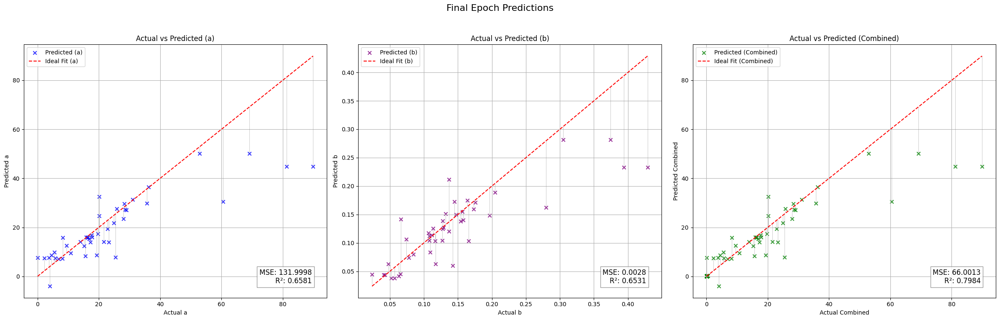

Validation Metrics:
  - MSE: 51.9313
  - R²: 0.7318
  - MAE: 3.2358
  - Explained Variance Score (EVS): 0.7372
Fold 1 Metrics:
  - Validation Loss (MSE): 51.9313
  - R²: 0.7318
  - MAE: 3.2358
  - EVS: 0.7372
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.71]


Validation Metrics:
  - MSE: 2.2692
  - R²: 0.9755
  - MAE: 0.7466
  - Explained Variance Score (EVS): 0.9768
Epoch [1/50], Train Loss: 0.7557, Val Loss: 2.2692
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.20it/s, loss=0.721]


Validation Metrics:
  - MSE: 3.1625
  - R²: 0.9652
  - MAE: 0.8757
  - Explained Variance Score (EVS): 0.9668
Epoch [2/50], Train Loss: 0.7378, Val Loss: 3.1625
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.697]


Validation Metrics:
  - MSE: 3.7945
  - R²: 0.9478
  - MAE: 1.0123
  - Explained Variance Score (EVS): 0.9581
Epoch [3/50], Train Loss: 0.7156, Val Loss: 3.7945
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=0.723]


Validation Metrics:
  - MSE: 3.6519
  - R²: 0.9377
  - MAE: 0.9351
  - Explained Variance Score (EVS): 0.9420
Epoch [4/50], Train Loss: 0.7043, Val Loss: 3.6519
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=0.7]


Validation Metrics:
  - MSE: 3.8426
  - R²: 0.9388
  - MAE: 1.0089
  - Explained Variance Score (EVS): 0.9406
Epoch [5/50], Train Loss: 0.6974, Val Loss: 3.8426
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.686]


Validation Metrics:
  - MSE: 3.6520
  - R²: 0.9391
  - MAE: 1.0088
  - Explained Variance Score (EVS): 0.9454
Epoch [6/50], Train Loss: 0.6782, Val Loss: 3.6520
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.01it/s, loss=0.705]


Validation Metrics:
  - MSE: 3.6771
  - R²: 0.9388
  - MAE: 1.0126
  - Explained Variance Score (EVS): 0.9401
Epoch [7/50], Train Loss: 0.6793, Val Loss: 3.6771
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.718]


Validation Metrics:
  - MSE: 4.1892
  - R²: 0.9312
  - MAE: 1.0567
  - Explained Variance Score (EVS): 0.9355
Epoch [8/50], Train Loss: 0.6693, Val Loss: 4.1892
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s, loss=0.622]


Validation Metrics:
  - MSE: 4.6803
  - R²: 0.9219
  - MAE: 1.1423
  - Explained Variance Score (EVS): 0.9277
Epoch [9/50], Train Loss: 0.6390, Val Loss: 4.6803
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.64]


Validation Metrics:
  - MSE: 4.9091
  - R²: 0.9194
  - MAE: 1.2006
  - Explained Variance Score (EVS): 0.9214
Epoch [10/50], Train Loss: 0.6271, Val Loss: 4.9091
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=0.689]


Validation Metrics:
  - MSE: 6.5299
  - R²: 0.8926
  - MAE: 1.3805
  - Explained Variance Score (EVS): 0.8932
Epoch [11/50], Train Loss: 0.6318, Val Loss: 6.5299
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


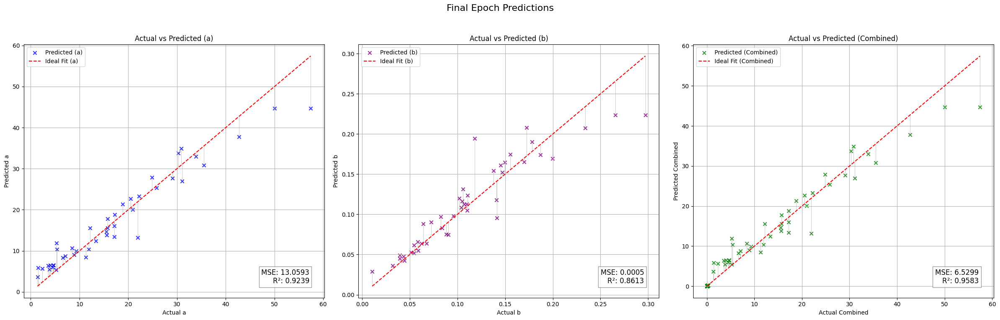

Validation Metrics:
  - MSE: 2.2692
  - R²: 0.9755
  - MAE: 0.7466
  - Explained Variance Score (EVS): 0.9768
Fold 2 Metrics:
  - Validation Loss (MSE): 2.2692
  - R²: 0.9755
  - MAE: 0.7466
  - EVS: 0.9768
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s, loss=0.71]


Validation Metrics:
  - MSE: 15.5272
  - R²: 0.8772
  - MAE: 1.2558
  - Explained Variance Score (EVS): 0.8788
Epoch [1/50], Train Loss: 0.7331, Val Loss: 15.5272
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.771]


Validation Metrics:
  - MSE: 15.9322
  - R²: 0.8741
  - MAE: 1.2934
  - Explained Variance Score (EVS): 0.8764
Epoch [2/50], Train Loss: 0.7359, Val Loss: 15.9322
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=0.719]


Validation Metrics:
  - MSE: 15.7897
  - R²: 0.8669
  - MAE: 1.2829
  - Explained Variance Score (EVS): 0.8689
Epoch [3/50], Train Loss: 0.7144, Val Loss: 15.7897
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s, loss=0.759]


Validation Metrics:
  - MSE: 15.6427
  - R²: 0.8641
  - MAE: 1.2956
  - Explained Variance Score (EVS): 0.8650
Epoch [4/50], Train Loss: 0.7280, Val Loss: 15.6427
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.688]


Validation Metrics:
  - MSE: 15.5727
  - R²: 0.8639
  - MAE: 1.2786
  - Explained Variance Score (EVS): 0.8645
Epoch [5/50], Train Loss: 0.6971, Val Loss: 15.5727
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.672]


Validation Metrics:
  - MSE: 16.2260
  - R²: 0.8572
  - MAE: 1.3251
  - Explained Variance Score (EVS): 0.8581
Epoch [6/50], Train Loss: 0.6890, Val Loss: 16.2260
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.83it/s, loss=0.672]


Validation Metrics:
  - MSE: 17.0533
  - R²: 0.8534
  - MAE: 1.3802
  - Explained Variance Score (EVS): 0.8547
Epoch [7/50], Train Loss: 0.6907, Val Loss: 17.0533
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.691]


Validation Metrics:
  - MSE: 17.4903
  - R²: 0.8561
  - MAE: 1.4232
  - Explained Variance Score (EVS): 0.8579
Epoch [8/50], Train Loss: 0.6745, Val Loss: 17.4903
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.60it/s, loss=0.67]


Validation Metrics:
  - MSE: 16.3439
  - R²: 0.8674
  - MAE: 1.3567
  - Explained Variance Score (EVS): 0.8678
Epoch [9/50], Train Loss: 0.6626, Val Loss: 16.3439
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.71it/s, loss=0.648]


Validation Metrics:
  - MSE: 15.4366
  - R²: 0.8731
  - MAE: 1.3283
  - Explained Variance Score (EVS): 0.8739
Epoch [10/50], Train Loss: 0.6434, Val Loss: 15.4366
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.632]


Validation Metrics:
  - MSE: 15.3958
  - R²: 0.8709
  - MAE: 1.3149
  - Explained Variance Score (EVS): 0.8716
Epoch [11/50], Train Loss: 0.6464, Val Loss: 15.3958
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.601]


Validation Metrics:
  - MSE: 15.9711
  - R²: 0.8659
  - MAE: 1.3100
  - Explained Variance Score (EVS): 0.8660
Epoch [12/50], Train Loss: 0.6234, Val Loss: 15.9711
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.614]


Validation Metrics:
  - MSE: 17.0505
  - R²: 0.8583
  - MAE: 1.3069
  - Explained Variance Score (EVS): 0.8586
Epoch [13/50], Train Loss: 0.6188, Val Loss: 17.0505
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.599]


Validation Metrics:
  - MSE: 18.8489
  - R²: 0.8477
  - MAE: 1.3050
  - Explained Variance Score (EVS): 0.8493
Epoch [14/50], Train Loss: 0.6163, Val Loss: 18.8489
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s, loss=0.615]


Validation Metrics:
  - MSE: 20.7263
  - R²: 0.8364
  - MAE: 1.3065
  - Explained Variance Score (EVS): 0.8388
Epoch [15/50], Train Loss: 0.6345, Val Loss: 20.7263
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.612]


Validation Metrics:
  - MSE: 21.7109
  - R²: 0.8305
  - MAE: 1.2947
  - Explained Variance Score (EVS): 0.8335
Epoch [16/50], Train Loss: 0.6159, Val Loss: 21.7109
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.599]


Validation Metrics:
  - MSE: 21.6040
  - R²: 0.8309
  - MAE: 1.2916
  - Explained Variance Score (EVS): 0.8336
Epoch [17/50], Train Loss: 0.5971, Val Loss: 21.6040
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.612]


Validation Metrics:
  - MSE: 20.3168
  - R²: 0.8362
  - MAE: 1.3054
  - Explained Variance Score (EVS): 0.8381
Epoch [18/50], Train Loss: 0.6114, Val Loss: 20.3168
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.665]


Validation Metrics:
  - MSE: 18.9913
  - R²: 0.8423
  - MAE: 1.3292
  - Explained Variance Score (EVS): 0.8432
Epoch [19/50], Train Loss: 0.6052, Val Loss: 18.9913
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.572]


Validation Metrics:
  - MSE: 18.9947
  - R²: 0.8406
  - MAE: 1.3510
  - Explained Variance Score (EVS): 0.8418
Epoch [20/50], Train Loss: 0.5987, Val Loss: 18.9947
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.556]


Validation Metrics:
  - MSE: 18.7329
  - R²: 0.8427
  - MAE: 1.3571
  - Explained Variance Score (EVS): 0.8436
Epoch [21/50], Train Loss: 0.5830, Val Loss: 18.7329
Current Dropout Rate: 0.3400
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


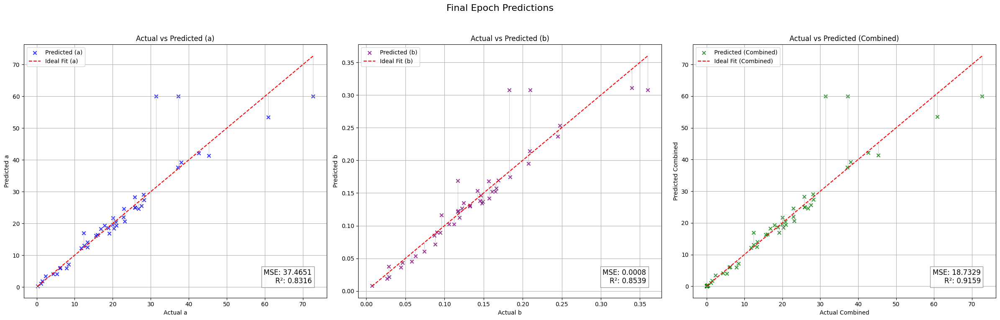

Validation Metrics:
  - MSE: 15.3958
  - R²: 0.8709
  - MAE: 1.3149
  - Explained Variance Score (EVS): 0.8716
Fold 3 Metrics:
  - Validation Loss (MSE): 15.3958
  - R²: 0.8709
  - MAE: 1.3149
  - EVS: 0.8716
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.621]


Validation Metrics:
  - MSE: 10.3852
  - R²: 0.8903
  - MAE: 1.2778
  - Explained Variance Score (EVS): 0.8912
Epoch [1/50], Train Loss: 0.6382, Val Loss: 10.3852
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.594]


Validation Metrics:
  - MSE: 11.4888
  - R²: 0.8839
  - MAE: 1.3283
  - Explained Variance Score (EVS): 0.8844
Epoch [2/50], Train Loss: 0.6336, Val Loss: 11.4888
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.24it/s, loss=0.643]


Validation Metrics:
  - MSE: 12.4868
  - R²: 0.8772
  - MAE: 1.3583
  - Explained Variance Score (EVS): 0.8776
Epoch [3/50], Train Loss: 0.6451, Val Loss: 12.4868
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=0.61]


Validation Metrics:
  - MSE: 13.2892
  - R²: 0.8711
  - MAE: 1.3778
  - Explained Variance Score (EVS): 0.8715
Epoch [4/50], Train Loss: 0.6275, Val Loss: 13.2892
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.586]


Validation Metrics:
  - MSE: 13.8277
  - R²: 0.8669
  - MAE: 1.3692
  - Explained Variance Score (EVS): 0.8674
Epoch [5/50], Train Loss: 0.6278, Val Loss: 13.8277
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.589]


Validation Metrics:
  - MSE: 13.9338
  - R²: 0.8648
  - MAE: 1.3667
  - Explained Variance Score (EVS): 0.8653
Epoch [6/50], Train Loss: 0.6144, Val Loss: 13.9338
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.32it/s, loss=0.618]


Validation Metrics:
  - MSE: 15.1703
  - R²: 0.8561
  - MAE: 1.3816
  - Explained Variance Score (EVS): 0.8568
Epoch [7/50], Train Loss: 0.6221, Val Loss: 15.1703
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.612]


Validation Metrics:
  - MSE: 16.1012
  - R²: 0.8492
  - MAE: 1.3917
  - Explained Variance Score (EVS): 0.8501
Epoch [8/50], Train Loss: 0.6108, Val Loss: 16.1012
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.623]


Validation Metrics:
  - MSE: 16.2353
  - R²: 0.8472
  - MAE: 1.4182
  - Explained Variance Score (EVS): 0.8480
Epoch [9/50], Train Loss: 0.6185, Val Loss: 16.2353
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.6]


Validation Metrics:
  - MSE: 17.4876
  - R²: 0.8390
  - MAE: 1.4530
  - Explained Variance Score (EVS): 0.8402
Epoch [10/50], Train Loss: 0.6102, Val Loss: 17.4876
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.597]


Validation Metrics:
  - MSE: 18.6468
  - R²: 0.8305
  - MAE: 1.4758
  - Explained Variance Score (EVS): 0.8320
Epoch [11/50], Train Loss: 0.6035, Val Loss: 18.6468
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


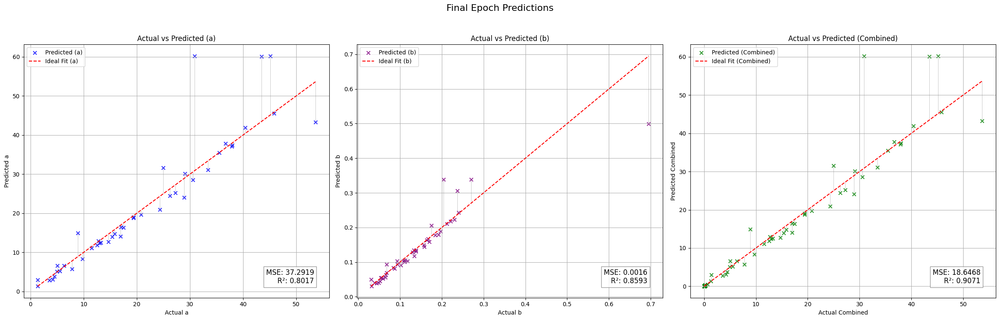

Validation Metrics:
  - MSE: 10.3852
  - R²: 0.8903
  - MAE: 1.2778
  - Explained Variance Score (EVS): 0.8912
Fold 4 Metrics:
  - Validation Loss (MSE): 10.3852
  - R²: 0.8903
  - MAE: 1.2778
  - EVS: 0.8912
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.657]


Validation Metrics:
  - MSE: 38.2362
  - R²: 0.8175
  - MAE: 1.7288
  - Explained Variance Score (EVS): 0.8299
Epoch [1/50], Train Loss: 0.6496, Val Loss: 38.2362
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s, loss=0.62]


Validation Metrics:
  - MSE: 37.4525
  - R²: 0.8199
  - MAE: 1.7073
  - Explained Variance Score (EVS): 0.8313
Epoch [2/50], Train Loss: 0.6325, Val Loss: 37.4525
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=0.67]


Validation Metrics:
  - MSE: 37.3188
  - R²: 0.8194
  - MAE: 1.6815
  - Explained Variance Score (EVS): 0.8306
Epoch [3/50], Train Loss: 0.6372, Val Loss: 37.3188
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.677]


Validation Metrics:
  - MSE: 36.8180
  - R²: 0.8212
  - MAE: 1.6506
  - Explained Variance Score (EVS): 0.8318
Epoch [4/50], Train Loss: 0.6393, Val Loss: 36.8180
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=0.641]


Validation Metrics:
  - MSE: 36.3457
  - R²: 0.8213
  - MAE: 1.6185
  - Explained Variance Score (EVS): 0.8309
Epoch [5/50], Train Loss: 0.6397, Val Loss: 36.3457
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.602]


Validation Metrics:
  - MSE: 35.3937
  - R²: 0.8248
  - MAE: 1.5807
  - Explained Variance Score (EVS): 0.8330
Epoch [6/50], Train Loss: 0.6271, Val Loss: 35.3937
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.43it/s, loss=0.6]


Validation Metrics:
  - MSE: 35.0656
  - R²: 0.8260
  - MAE: 1.5452
  - Explained Variance Score (EVS): 0.8335
Epoch [7/50], Train Loss: 0.6215, Val Loss: 35.0656
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.62]


Validation Metrics:
  - MSE: 35.2980
  - R²: 0.8253
  - MAE: 1.5245
  - Explained Variance Score (EVS): 0.8324
Epoch [8/50], Train Loss: 0.6226, Val Loss: 35.2980
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.664]


Validation Metrics:
  - MSE: 35.4757
  - R²: 0.8242
  - MAE: 1.5013
  - Explained Variance Score (EVS): 0.8318
Epoch [9/50], Train Loss: 0.6298, Val Loss: 35.4757
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s, loss=0.591]


Validation Metrics:
  - MSE: 34.6077
  - R²: 0.8286
  - MAE: 1.4780
  - Explained Variance Score (EVS): 0.8347
Epoch [10/50], Train Loss: 0.6142, Val Loss: 34.6077
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.606]


Validation Metrics:
  - MSE: 34.2923
  - R²: 0.8304
  - MAE: 1.4658
  - Explained Variance Score (EVS): 0.8362
Epoch [11/50], Train Loss: 0.6275, Val Loss: 34.2923
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.597]


Validation Metrics:
  - MSE: 34.2932
  - R²: 0.8300
  - MAE: 1.4726
  - Explained Variance Score (EVS): 0.8358
Epoch [12/50], Train Loss: 0.6063, Val Loss: 34.2932
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.621]


Validation Metrics:
  - MSE: 34.3496
  - R²: 0.8291
  - MAE: 1.4628
  - Explained Variance Score (EVS): 0.8360
Epoch [13/50], Train Loss: 0.6156, Val Loss: 34.3496
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.72it/s, loss=0.602]


Validation Metrics:
  - MSE: 33.8660
  - R²: 0.8305
  - MAE: 1.4568
  - Explained Variance Score (EVS): 0.8366
Epoch [14/50], Train Loss: 0.6142, Val Loss: 33.8660
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.32it/s, loss=0.623]


Validation Metrics:
  - MSE: 33.8491
  - R²: 0.8304
  - MAE: 1.4497
  - Explained Variance Score (EVS): 0.8363
Epoch [15/50], Train Loss: 0.6179, Val Loss: 33.8491
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.592]


Validation Metrics:
  - MSE: 34.1188
  - R²: 0.8291
  - MAE: 1.4508
  - Explained Variance Score (EVS): 0.8357
Epoch [16/50], Train Loss: 0.6051, Val Loss: 34.1188
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.644]


Validation Metrics:
  - MSE: 34.4015
  - R²: 0.8278
  - MAE: 1.4541
  - Explained Variance Score (EVS): 0.8351
Epoch [17/50], Train Loss: 0.6214, Val Loss: 34.4015
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.608]


Validation Metrics:
  - MSE: 34.1127
  - R²: 0.8288
  - MAE: 1.4518
  - Explained Variance Score (EVS): 0.8366
Epoch [18/50], Train Loss: 0.6067, Val Loss: 34.1127
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.62]


Validation Metrics:
  - MSE: 34.2126
  - R²: 0.8287
  - MAE: 1.4608
  - Explained Variance Score (EVS): 0.8364
Epoch [19/50], Train Loss: 0.6069, Val Loss: 34.2126
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.58]


Validation Metrics:
  - MSE: 33.9656
  - R²: 0.8301
  - MAE: 1.4611
  - Explained Variance Score (EVS): 0.8376
Epoch [20/50], Train Loss: 0.5995, Val Loss: 33.9656
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.611]


Validation Metrics:
  - MSE: 33.4440
  - R²: 0.8325
  - MAE: 1.4533
  - Explained Variance Score (EVS): 0.8394
Epoch [21/50], Train Loss: 0.6013, Val Loss: 33.4440
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.603]


Validation Metrics:
  - MSE: 33.2881
  - R²: 0.8333
  - MAE: 1.4591
  - Explained Variance Score (EVS): 0.8407
Epoch [22/50], Train Loss: 0.6095, Val Loss: 33.2881
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.577]


Validation Metrics:
  - MSE: 32.6986
  - R²: 0.8367
  - MAE: 1.4474
  - Explained Variance Score (EVS): 0.8428
Epoch [23/50], Train Loss: 0.5959, Val Loss: 32.6986
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=0.581]


Validation Metrics:
  - MSE: 32.8818
  - R²: 0.8357
  - MAE: 1.4543
  - Explained Variance Score (EVS): 0.8425
Epoch [24/50], Train Loss: 0.5868, Val Loss: 32.8818
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s, loss=0.657]


Validation Metrics:
  - MSE: 33.5841
  - R²: 0.8327
  - MAE: 1.4675
  - Explained Variance Score (EVS): 0.8402
Epoch [25/50], Train Loss: 0.6146, Val Loss: 33.5841
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.57]


Validation Metrics:
  - MSE: 33.5033
  - R²: 0.8329
  - MAE: 1.4635
  - Explained Variance Score (EVS): 0.8406
Epoch [26/50], Train Loss: 0.5944, Val Loss: 33.5033
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  6.11it/s, loss=0.605]


Validation Metrics:
  - MSE: 33.2184
  - R²: 0.8343
  - MAE: 1.4596
  - Explained Variance Score (EVS): 0.8417
Epoch [27/50], Train Loss: 0.6015, Val Loss: 33.2184
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.612]


Validation Metrics:
  - MSE: 32.9278
  - R²: 0.8353
  - MAE: 1.4551
  - Explained Variance Score (EVS): 0.8419
Epoch [28/50], Train Loss: 0.6000, Val Loss: 32.9278
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.583]


Validation Metrics:
  - MSE: 32.8846
  - R²: 0.8354
  - MAE: 1.4517
  - Explained Variance Score (EVS): 0.8419
Epoch [29/50], Train Loss: 0.5947, Val Loss: 32.8846
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.632]


Validation Metrics:
  - MSE: 33.1475
  - R²: 0.8340
  - MAE: 1.4641
  - Explained Variance Score (EVS): 0.8408
Epoch [30/50], Train Loss: 0.5999, Val Loss: 33.1475
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.608]


Validation Metrics:
  - MSE: 33.1342
  - R²: 0.8345
  - MAE: 1.4682
  - Explained Variance Score (EVS): 0.8415
Epoch [31/50], Train Loss: 0.5912, Val Loss: 33.1342
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.591]


Validation Metrics:
  - MSE: 32.8431
  - R²: 0.8355
  - MAE: 1.4628
  - Explained Variance Score (EVS): 0.8425
Epoch [32/50], Train Loss: 0.5892, Val Loss: 32.8431
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.585]


Validation Metrics:
  - MSE: 32.8594
  - R²: 0.8354
  - MAE: 1.4635
  - Explained Variance Score (EVS): 0.8430
Epoch [33/50], Train Loss: 0.6071, Val Loss: 32.8594
Current Dropout Rate: 0.2440
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


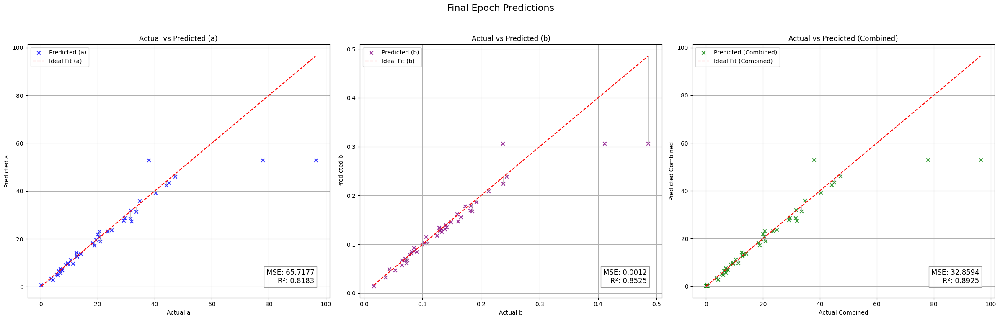

[I 2024-12-01 17:20:35,668] Trial 18 finished with value: 22.536014556884766 and parameters: {'num_layers': 2, 'hidden_size_0': 395, 'activation_0': 'ELU', 'dropout_0': 0.2748316099138116, 'hidden_size_1': 418, 'activation_1': 'ReLU', 'dropout_1': 0.17523062524831293, 'batch_size': 64, 'learning_rate': 0.008103958938142508, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.6986
  - R²: 0.8367
  - MAE: 1.4474
  - Explained Variance Score (EVS): 0.8428
Fold 5 Metrics:
  - Validation Loss (MSE): 32.6986
  - R²: 0.8367
  - MAE: 1.4474
  - EVS: 0.8428
Avg Validation Metrics:
  - MSE: 22.5360
  - R²: 0.8611
  - MAE: 1.6045
  - EVS: 0.8639
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=1.68]


Validation Metrics:
  - MSE: 193.0361
  - R²: 0.0116
  - MAE: 6.2853
  - Explained Variance Score (EVS): 0.0345
Epoch [1/50], Train Loss: 1.7690, Val Loss: 193.0361
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=1.77]


Validation Metrics:
  - MSE: 188.2817
  - R²: 0.0349
  - MAE: 6.1763
  - Explained Variance Score (EVS): 0.0593
Epoch [2/50], Train Loss: 1.6765, Val Loss: 188.2817
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=1.66]


Validation Metrics:
  - MSE: 189.6562
  - R²: 0.0313
  - MAE: 6.1496
  - Explained Variance Score (EVS): 0.0600
Epoch [3/50], Train Loss: 1.6267, Val Loss: 189.6562
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.39it/s, loss=1.64]


Validation Metrics:
  - MSE: 190.7101
  - R²: 0.0271
  - MAE: 6.1698
  - Explained Variance Score (EVS): 0.0586
Epoch [4/50], Train Loss: 1.5839, Val Loss: 190.7101
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.19it/s, loss=1.56]


Validation Metrics:
  - MSE: 188.9202
  - R²: 0.0402
  - MAE: 6.1380
  - Explained Variance Score (EVS): 0.0715
Epoch [5/50], Train Loss: 1.5483, Val Loss: 188.9202
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=1.47]


Validation Metrics:
  - MSE: 184.2636
  - R²: 0.0708
  - MAE: 6.0123
  - Explained Variance Score (EVS): 0.1045
Epoch [6/50], Train Loss: 1.5150, Val Loss: 184.2636
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=1.55]


Validation Metrics:
  - MSE: 179.2138
  - R²: 0.0979
  - MAE: 5.8210
  - Explained Variance Score (EVS): 0.1313
Epoch [7/50], Train Loss: 1.5169, Val Loss: 179.2138
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=1.44]


Validation Metrics:
  - MSE: 174.2852
  - R²: 0.1251
  - MAE: 5.6886
  - Explained Variance Score (EVS): 0.1598
Epoch [8/50], Train Loss: 1.4809, Val Loss: 174.2852
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=1.42]


Validation Metrics:
  - MSE: 167.5714
  - R²: 0.1642
  - MAE: 5.6467
  - Explained Variance Score (EVS): 0.1960
Epoch [9/50], Train Loss: 1.4650, Val Loss: 167.5714
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.79it/s, loss=1.45]


Validation Metrics:
  - MSE: 162.9598
  - R²: 0.1791
  - MAE: 5.5846
  - Explained Variance Score (EVS): 0.2102
Epoch [10/50], Train Loss: 1.4442, Val Loss: 162.9598
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=1.36]


Validation Metrics:
  - MSE: 155.4114
  - R²: 0.2030
  - MAE: 5.4225
  - Explained Variance Score (EVS): 0.2306
Epoch [11/50], Train Loss: 1.4027, Val Loss: 155.4114
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=1.35]


Validation Metrics:
  - MSE: 145.9783
  - R²: 0.2466
  - MAE: 5.1414
  - Explained Variance Score (EVS): 0.2689
Epoch [12/50], Train Loss: 1.3802, Val Loss: 145.9783
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=1.4]


Validation Metrics:
  - MSE: 134.9457
  - R²: 0.3212
  - MAE: 4.8954
  - Explained Variance Score (EVS): 0.3399
Epoch [13/50], Train Loss: 1.3741, Val Loss: 134.9457
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=1.27]


Validation Metrics:
  - MSE: 125.2480
  - R²: 0.3891
  - MAE: 4.7971
  - Explained Variance Score (EVS): 0.4087
Epoch [14/50], Train Loss: 1.3151, Val Loss: 125.2480
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=1.29]


Validation Metrics:
  - MSE: 122.9543
  - R²: 0.4031
  - MAE: 4.7435
  - Explained Variance Score (EVS): 0.4303
Epoch [15/50], Train Loss: 1.3020, Val Loss: 122.9543
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=1.26]


Validation Metrics:
  - MSE: 117.2508
  - R²: 0.4284
  - MAE: 4.6077
  - Explained Variance Score (EVS): 0.4571
Epoch [16/50], Train Loss: 1.2884, Val Loss: 117.2508
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=1.27]


Validation Metrics:
  - MSE: 102.7617
  - R²: 0.5048
  - MAE: 4.2980
  - Explained Variance Score (EVS): 0.5210
Epoch [17/50], Train Loss: 1.2677, Val Loss: 102.7617
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  6.14it/s, loss=1.25]


Validation Metrics:
  - MSE: 86.3753
  - R²: 0.5922
  - MAE: 4.0519
  - Explained Variance Score (EVS): 0.6005
Epoch [18/50], Train Loss: 1.2273, Val Loss: 86.3753
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.31it/s, loss=1.2]


Validation Metrics:
  - MSE: 73.7469
  - R²: 0.6452
  - MAE: 3.8422
  - Explained Variance Score (EVS): 0.6529
Epoch [19/50], Train Loss: 1.2076, Val Loss: 73.7469
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=1.22]


Validation Metrics:
  - MSE: 80.8716
  - R²: 0.6216
  - MAE: 3.7809
  - Explained Variance Score (EVS): 0.6372
Epoch [20/50], Train Loss: 1.1915, Val Loss: 80.8716
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  6.28it/s, loss=1.14]


Validation Metrics:
  - MSE: 79.1188
  - R²: 0.6071
  - MAE: 3.5147
  - Explained Variance Score (EVS): 0.6252
Epoch [21/50], Train Loss: 1.1495, Val Loss: 79.1188
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=1.11]


Validation Metrics:
  - MSE: 84.1089
  - R²: 0.5751
  - MAE: 3.5652
  - Explained Variance Score (EVS): 0.5917
Epoch [22/50], Train Loss: 1.1235, Val Loss: 84.1089
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=1.19]


Validation Metrics:
  - MSE: 81.9581
  - R²: 0.5806
  - MAE: 3.5445
  - Explained Variance Score (EVS): 0.5949
Epoch [23/50], Train Loss: 1.1280, Val Loss: 81.9581
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s, loss=1.21]


Validation Metrics:
  - MSE: 82.3971
  - R²: 0.5862
  - MAE: 3.5699
  - Explained Variance Score (EVS): 0.6025
Epoch [24/50], Train Loss: 1.1118, Val Loss: 82.3971
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=1.02]


Validation Metrics:
  - MSE: 73.3899
  - R²: 0.6480
  - MAE: 3.5595
  - Explained Variance Score (EVS): 0.6608
Epoch [25/50], Train Loss: 1.0511, Val Loss: 73.3899
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.992]


Validation Metrics:
  - MSE: 68.1408
  - R²: 0.6665
  - MAE: 3.5352
  - Explained Variance Score (EVS): 0.6799
Epoch [26/50], Train Loss: 1.0348, Val Loss: 68.1408
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=1.01]


Validation Metrics:
  - MSE: 60.1577
  - R²: 0.7015
  - MAE: 3.4638
  - Explained Variance Score (EVS): 0.7121
Epoch [27/50], Train Loss: 1.0095, Val Loss: 60.1577
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.958]


Validation Metrics:
  - MSE: 54.6568
  - R²: 0.7309
  - MAE: 3.3748
  - Explained Variance Score (EVS): 0.7370
Epoch [28/50], Train Loss: 0.9734, Val Loss: 54.6568
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.943]


Validation Metrics:
  - MSE: 53.5661
  - R²: 0.7430
  - MAE: 3.4212
  - Explained Variance Score (EVS): 0.7493
Epoch [29/50], Train Loss: 0.9542, Val Loss: 53.5661
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.953]


Validation Metrics:
  - MSE: 61.1493
  - R²: 0.7228
  - MAE: 3.4926
  - Explained Variance Score (EVS): 0.7362
Epoch [30/50], Train Loss: 0.9321, Val Loss: 61.1493
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=0.862]


Validation Metrics:
  - MSE: 74.4436
  - R²: 0.6662
  - MAE: 3.5569
  - Explained Variance Score (EVS): 0.6852
Epoch [31/50], Train Loss: 0.9025, Val Loss: 74.4436
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.856]


Validation Metrics:
  - MSE: 68.6768
  - R²: 0.6695
  - MAE: 3.3750
  - Explained Variance Score (EVS): 0.6839
Epoch [32/50], Train Loss: 0.8743, Val Loss: 68.6768
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.946]


Validation Metrics:
  - MSE: 77.7315
  - R²: 0.6013
  - MAE: 3.4561
  - Explained Variance Score (EVS): 0.6289
Epoch [33/50], Train Loss: 0.8763, Val Loss: 77.7315
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.812]


Validation Metrics:
  - MSE: 85.4631
  - R²: 0.5734
  - MAE: 3.6018
  - Explained Variance Score (EVS): 0.5992
Epoch [34/50], Train Loss: 0.8318, Val Loss: 85.4631
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  6.98it/s, loss=0.772]


Validation Metrics:
  - MSE: 66.5455
  - R²: 0.6803
  - MAE: 3.3944
  - Explained Variance Score (EVS): 0.6930
Epoch [35/50], Train Loss: 0.8046, Val Loss: 66.5455
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  6.33it/s, loss=0.778]


Validation Metrics:
  - MSE: 57.4317
  - R²: 0.7275
  - MAE: 3.2445
  - Explained Variance Score (EVS): 0.7339
Epoch [36/50], Train Loss: 0.7891, Val Loss: 57.4317
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.753]


Validation Metrics:
  - MSE: 55.0916
  - R²: 0.7237
  - MAE: 3.1743
  - Explained Variance Score (EVS): 0.7300
Epoch [37/50], Train Loss: 0.7594, Val Loss: 55.0916
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.709]


Validation Metrics:
  - MSE: 66.1283
  - R²: 0.6365
  - MAE: 3.2624
  - Explained Variance Score (EVS): 0.6582
Epoch [38/50], Train Loss: 0.7316, Val Loss: 66.1283
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.705]


Validation Metrics:
  - MSE: 78.6637
  - R²: 0.5833
  - MAE: 3.4845
  - Explained Variance Score (EVS): 0.6131
Epoch [39/50], Train Loss: 0.7144, Val Loss: 78.6637
Current Dropout Rate: 0.1960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


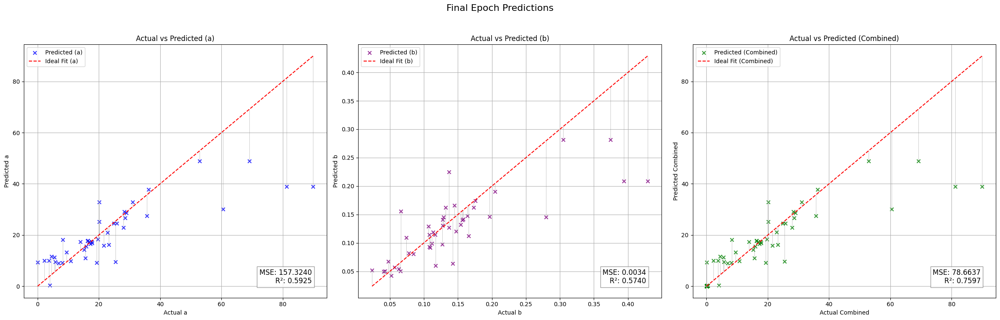

Validation Metrics:
  - MSE: 53.5661
  - R²: 0.7430
  - MAE: 3.4212
  - Explained Variance Score (EVS): 0.7493
Fold 1 Metrics:
  - Validation Loss (MSE): 53.5661
  - R²: 0.7430
  - MAE: 3.4212
  - EVS: 0.7493
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.96]


Validation Metrics:
  - MSE: 3.1155
  - R²: 0.9553
  - MAE: 1.0029
  - Explained Variance Score (EVS): 0.9565
Epoch [1/50], Train Loss: 0.9622, Val Loss: 3.1155
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.94]


Validation Metrics:
  - MSE: 3.6339
  - R²: 0.9491
  - MAE: 1.0206
  - Explained Variance Score (EVS): 0.9513
Epoch [2/50], Train Loss: 0.9513, Val Loss: 3.6339
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.903]


Validation Metrics:
  - MSE: 4.1069
  - R²: 0.9423
  - MAE: 1.0516
  - Explained Variance Score (EVS): 0.9436
Epoch [3/50], Train Loss: 0.9210, Val Loss: 4.1069
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s, loss=0.933]


Validation Metrics:
  - MSE: 4.4346
  - R²: 0.9434
  - MAE: 1.0729
  - Explained Variance Score (EVS): 0.9441
Epoch [4/50], Train Loss: 0.9127, Val Loss: 4.4346
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.896]


Validation Metrics:
  - MSE: 4.1380
  - R²: 0.9421
  - MAE: 1.0729
  - Explained Variance Score (EVS): 0.9427
Epoch [5/50], Train Loss: 0.8847, Val Loss: 4.1380
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.899]


Validation Metrics:
  - MSE: 4.1571
  - R²: 0.9370
  - MAE: 1.1272
  - Explained Variance Score (EVS): 0.9370
Epoch [6/50], Train Loss: 0.8676, Val Loss: 4.1571
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.873]


Validation Metrics:
  - MSE: 4.4709
  - R²: 0.9312
  - MAE: 1.1833
  - Explained Variance Score (EVS): 0.9315
Epoch [7/50], Train Loss: 0.8474, Val Loss: 4.4709
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.81]


Validation Metrics:
  - MSE: 4.5845
  - R²: 0.9301
  - MAE: 1.2159
  - Explained Variance Score (EVS): 0.9306
Epoch [8/50], Train Loss: 0.8226, Val Loss: 4.5845
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=0.781]


Validation Metrics:
  - MSE: 4.8910
  - R²: 0.9287
  - MAE: 1.2144
  - Explained Variance Score (EVS): 0.9288
Epoch [9/50], Train Loss: 0.7875, Val Loss: 4.8910
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s, loss=0.773]


Validation Metrics:
  - MSE: 6.3453
  - R²: 0.9170
  - MAE: 1.3035
  - Explained Variance Score (EVS): 0.9187
Epoch [10/50], Train Loss: 0.7824, Val Loss: 6.3453
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s, loss=0.754]


Validation Metrics:
  - MSE: 6.1846
  - R²: 0.9173
  - MAE: 1.2637
  - Explained Variance Score (EVS): 0.9185
Epoch [11/50], Train Loss: 0.7655, Val Loss: 6.1846
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


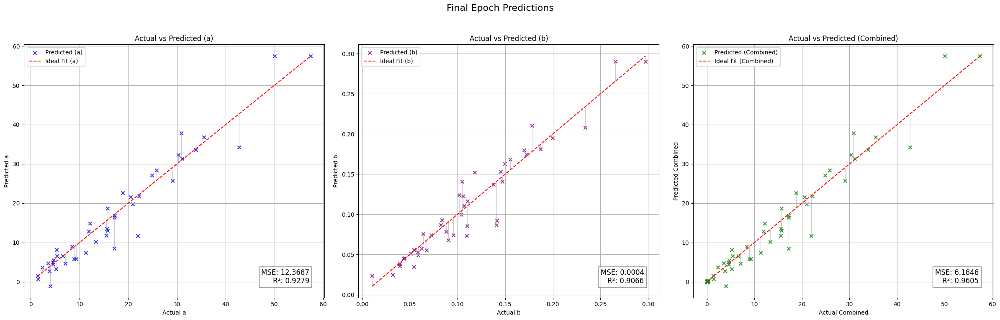

Validation Metrics:
  - MSE: 3.1155
  - R²: 0.9553
  - MAE: 1.0029
  - Explained Variance Score (EVS): 0.9565
Fold 2 Metrics:
  - Validation Loss (MSE): 3.1155
  - R²: 0.9553
  - MAE: 1.0029
  - EVS: 0.9565
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.967]


Validation Metrics:
  - MSE: 14.8427
  - R²: 0.8703
  - MAE: 1.5677
  - Explained Variance Score (EVS): 0.8709
Epoch [1/50], Train Loss: 0.9502, Val Loss: 14.8427
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.929]


Validation Metrics:
  - MSE: 14.4917
  - R²: 0.8765
  - MAE: 1.5106
  - Explained Variance Score (EVS): 0.8770
Epoch [2/50], Train Loss: 0.9204, Val Loss: 14.4917
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.897]


Validation Metrics:
  - MSE: 14.7937
  - R²: 0.8748
  - MAE: 1.5052
  - Explained Variance Score (EVS): 0.8751
Epoch [3/50], Train Loss: 0.9212, Val Loss: 14.7937
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.946]


Validation Metrics:
  - MSE: 14.8163
  - R²: 0.8750
  - MAE: 1.4933
  - Explained Variance Score (EVS): 0.8756
Epoch [4/50], Train Loss: 0.9234, Val Loss: 14.8163
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.57it/s, loss=0.881]


Validation Metrics:
  - MSE: 14.7342
  - R²: 0.8762
  - MAE: 1.4850
  - Explained Variance Score (EVS): 0.8775
Epoch [5/50], Train Loss: 0.8877, Val Loss: 14.7342
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.44it/s, loss=0.917]


Validation Metrics:
  - MSE: 15.3352
  - R²: 0.8711
  - MAE: 1.4784
  - Explained Variance Score (EVS): 0.8728
Epoch [6/50], Train Loss: 0.8906, Val Loss: 15.3352
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=0.888]


Validation Metrics:
  - MSE: 15.4526
  - R²: 0.8681
  - MAE: 1.4717
  - Explained Variance Score (EVS): 0.8700
Epoch [7/50], Train Loss: 0.8693, Val Loss: 15.4526
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.841]


Validation Metrics:
  - MSE: 16.6095
  - R²: 0.8564
  - MAE: 1.4873
  - Explained Variance Score (EVS): 0.8572
Epoch [8/50], Train Loss: 0.8574, Val Loss: 16.6095
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.812]


Validation Metrics:
  - MSE: 18.4510
  - R²: 0.8465
  - MAE: 1.4833
  - Explained Variance Score (EVS): 0.8472
Epoch [9/50], Train Loss: 0.8345, Val Loss: 18.4510
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.83]


Validation Metrics:
  - MSE: 19.1767
  - R²: 0.8450
  - MAE: 1.4539
  - Explained Variance Score (EVS): 0.8461
Epoch [10/50], Train Loss: 0.8306, Val Loss: 19.1767
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.815]


Validation Metrics:
  - MSE: 18.8806
  - R²: 0.8518
  - MAE: 1.4424
  - Explained Variance Score (EVS): 0.8527
Epoch [11/50], Train Loss: 0.8218, Val Loss: 18.8806
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.841]


Validation Metrics:
  - MSE: 18.4322
  - R²: 0.8544
  - MAE: 1.4315
  - Explained Variance Score (EVS): 0.8554
Epoch [12/50], Train Loss: 0.8246, Val Loss: 18.4322
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


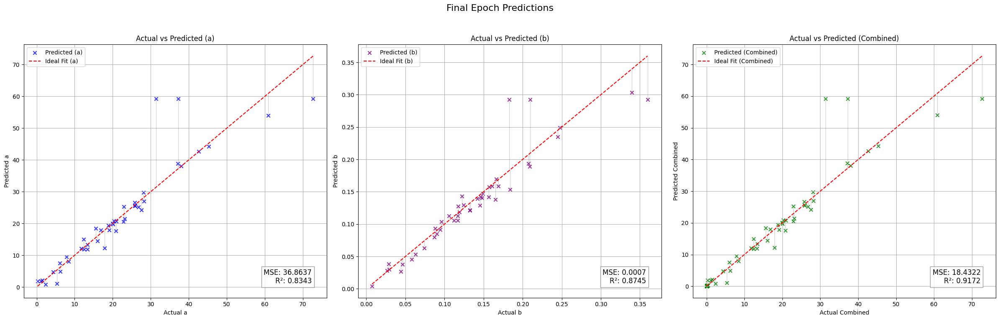

Validation Metrics:
  - MSE: 14.4917
  - R²: 0.8765
  - MAE: 1.5106
  - Explained Variance Score (EVS): 0.8770
Fold 3 Metrics:
  - Validation Loss (MSE): 14.4917
  - R²: 0.8765
  - MAE: 1.5106
  - EVS: 0.8770
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=0.908]


Validation Metrics:
  - MSE: 15.3473
  - R²: 0.8038
  - MAE: 1.4356
  - Explained Variance Score (EVS): 0.8058
Epoch [1/50], Train Loss: 0.9243, Val Loss: 15.3473
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.883]


Validation Metrics:
  - MSE: 16.4488
  - R²: 0.7977
  - MAE: 1.4469
  - Explained Variance Score (EVS): 0.8000
Epoch [2/50], Train Loss: 0.9073, Val Loss: 16.4488
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.917]


Validation Metrics:
  - MSE: 17.4075
  - R²: 0.7910
  - MAE: 1.4657
  - Explained Variance Score (EVS): 0.7933
Epoch [3/50], Train Loss: 0.9158, Val Loss: 17.4075
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.33it/s, loss=0.91]


Validation Metrics:
  - MSE: 17.9541
  - R²: 0.7844
  - MAE: 1.5108
  - Explained Variance Score (EVS): 0.7877
Epoch [4/50], Train Loss: 0.8890, Val Loss: 17.9541
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.884]


Validation Metrics:
  - MSE: 19.5559
  - R²: 0.7713
  - MAE: 1.5580
  - Explained Variance Score (EVS): 0.7757
Epoch [5/50], Train Loss: 0.9252, Val Loss: 19.5559
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s, loss=0.857]


Validation Metrics:
  - MSE: 20.5788
  - R²: 0.7623
  - MAE: 1.5964
  - Explained Variance Score (EVS): 0.7671
Epoch [6/50], Train Loss: 0.8996, Val Loss: 20.5788
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.858]


Validation Metrics:
  - MSE: 20.8984
  - R²: 0.7608
  - MAE: 1.6189
  - Explained Variance Score (EVS): 0.7651
Epoch [7/50], Train Loss: 0.8699, Val Loss: 20.8984
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.892]


Validation Metrics:
  - MSE: 22.6623
  - R²: 0.7510
  - MAE: 1.6924
  - Explained Variance Score (EVS): 0.7559
Epoch [8/50], Train Loss: 0.8733, Val Loss: 22.6623
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s, loss=0.828]


Validation Metrics:
  - MSE: 24.1278
  - R²: 0.7421
  - MAE: 1.7653
  - Explained Variance Score (EVS): 0.7460
Epoch [9/50], Train Loss: 0.8583, Val Loss: 24.1278
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.56it/s, loss=0.851]


Validation Metrics:
  - MSE: 24.9978
  - R²: 0.7361
  - MAE: 1.7995
  - Explained Variance Score (EVS): 0.7404
Epoch [10/50], Train Loss: 0.8631, Val Loss: 24.9978
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.83]


Validation Metrics:
  - MSE: 25.5533
  - R²: 0.7323
  - MAE: 1.8129
  - Explained Variance Score (EVS): 0.7369
Epoch [11/50], Train Loss: 0.8559, Val Loss: 25.5533
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


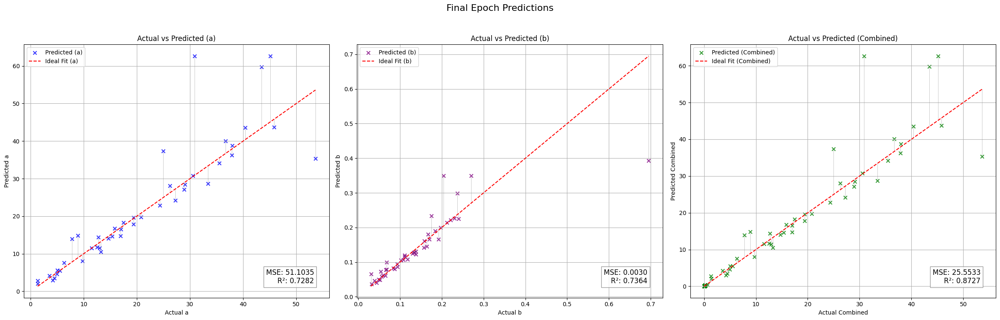

Validation Metrics:
  - MSE: 15.3473
  - R²: 0.8038
  - MAE: 1.4356
  - Explained Variance Score (EVS): 0.8058
Fold 4 Metrics:
  - Validation Loss (MSE): 15.3473
  - R²: 0.8038
  - MAE: 1.4356
  - EVS: 0.8058
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.897]


Validation Metrics:
  - MSE: 33.5169
  - R²: 0.8357
  - MAE: 1.5879
  - Explained Variance Score (EVS): 0.8429
Epoch [1/50], Train Loss: 0.9292, Val Loss: 33.5169
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.938]


Validation Metrics:
  - MSE: 33.2338
  - R²: 0.8363
  - MAE: 1.5862
  - Explained Variance Score (EVS): 0.8426
Epoch [2/50], Train Loss: 0.9132, Val Loss: 33.2338
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.898]


Validation Metrics:
  - MSE: 33.0562
  - R²: 0.8359
  - MAE: 1.5818
  - Explained Variance Score (EVS): 0.8425
Epoch [3/50], Train Loss: 0.9163, Val Loss: 33.0562
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=0.888]


Validation Metrics:
  - MSE: 32.0400
  - R²: 0.8381
  - MAE: 1.5590
  - Explained Variance Score (EVS): 0.8447
Epoch [4/50], Train Loss: 0.8993, Val Loss: 32.0400
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.80it/s, loss=0.93]


Validation Metrics:
  - MSE: 31.8899
  - R²: 0.8370
  - MAE: 1.5264
  - Explained Variance Score (EVS): 0.8438
Epoch [5/50], Train Loss: 0.9102, Val Loss: 31.8899
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.885]


Validation Metrics:
  - MSE: 32.3117
  - R²: 0.8343
  - MAE: 1.5199
  - Explained Variance Score (EVS): 0.8404
Epoch [6/50], Train Loss: 0.8884, Val Loss: 32.3117
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.55it/s, loss=0.972]


Validation Metrics:
  - MSE: 32.4912
  - R²: 0.8339
  - MAE: 1.5093
  - Explained Variance Score (EVS): 0.8402
Epoch [7/50], Train Loss: 0.9056, Val Loss: 32.4912
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.45it/s, loss=0.878]


Validation Metrics:
  - MSE: 31.8829
  - R²: 0.8367
  - MAE: 1.4748
  - Explained Variance Score (EVS): 0.8414
Epoch [8/50], Train Loss: 0.8979, Val Loss: 31.8829
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.66it/s, loss=0.874]


Validation Metrics:
  - MSE: 31.9854
  - R²: 0.8347
  - MAE: 1.4782
  - Explained Variance Score (EVS): 0.8392
Epoch [9/50], Train Loss: 0.8786, Val Loss: 31.9854
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.52it/s, loss=0.88]


Validation Metrics:
  - MSE: 31.9044
  - R²: 0.8359
  - MAE: 1.4942
  - Explained Variance Score (EVS): 0.8397
Epoch [10/50], Train Loss: 0.8892, Val Loss: 31.9044
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.38it/s, loss=0.852]


Validation Metrics:
  - MSE: 31.6877
  - R²: 0.8379
  - MAE: 1.4945
  - Explained Variance Score (EVS): 0.8418
Epoch [11/50], Train Loss: 0.8819, Val Loss: 31.6877
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s, loss=0.849]


Validation Metrics:
  - MSE: 31.6198
  - R²: 0.8389
  - MAE: 1.4947
  - Explained Variance Score (EVS): 0.8431
Epoch [12/50], Train Loss: 0.8687, Val Loss: 31.6198
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=1.02]


Validation Metrics:
  - MSE: 31.8943
  - R²: 0.8372
  - MAE: 1.5097
  - Explained Variance Score (EVS): 0.8428
Epoch [13/50], Train Loss: 0.9089, Val Loss: 31.8943
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.94it/s, loss=0.849]


Validation Metrics:
  - MSE: 32.2417
  - R²: 0.8355
  - MAE: 1.5252
  - Explained Variance Score (EVS): 0.8419
Epoch [14/50], Train Loss: 0.8723, Val Loss: 32.2417
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.70it/s, loss=0.919]


Validation Metrics:
  - MSE: 32.4066
  - R²: 0.8344
  - MAE: 1.5347
  - Explained Variance Score (EVS): 0.8415
Epoch [15/50], Train Loss: 0.8751, Val Loss: 32.4066
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.931]


Validation Metrics:
  - MSE: 32.6793
  - R²: 0.8324
  - MAE: 1.5484
  - Explained Variance Score (EVS): 0.8402
Epoch [16/50], Train Loss: 0.8705, Val Loss: 32.6793
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.891]


Validation Metrics:
  - MSE: 32.7631
  - R²: 0.8320
  - MAE: 1.5489
  - Explained Variance Score (EVS): 0.8400
Epoch [17/50], Train Loss: 0.8685, Val Loss: 32.7631
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.857]


Validation Metrics:
  - MSE: 33.3796
  - R²: 0.8301
  - MAE: 1.5604
  - Explained Variance Score (EVS): 0.8386
Epoch [18/50], Train Loss: 0.8553, Val Loss: 33.3796
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.853]


Validation Metrics:
  - MSE: 33.9444
  - R²: 0.8281
  - MAE: 1.5577
  - Explained Variance Score (EVS): 0.8360
Epoch [19/50], Train Loss: 0.8529, Val Loss: 33.9444
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.87]


Validation Metrics:
  - MSE: 34.4219
  - R²: 0.8265
  - MAE: 1.5699
  - Explained Variance Score (EVS): 0.8347
Epoch [20/50], Train Loss: 0.8506, Val Loss: 34.4219
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=0.828]


Validation Metrics:
  - MSE: 34.5369
  - R²: 0.8264
  - MAE: 1.5511
  - Explained Variance Score (EVS): 0.8335
Epoch [21/50], Train Loss: 0.8381, Val Loss: 34.5369
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.88]


Validation Metrics:
  - MSE: 34.4814
  - R²: 0.8261
  - MAE: 1.5486
  - Explained Variance Score (EVS): 0.8328
Epoch [22/50], Train Loss: 0.8535, Val Loss: 34.4814
Current Dropout Rate: 0.3320
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


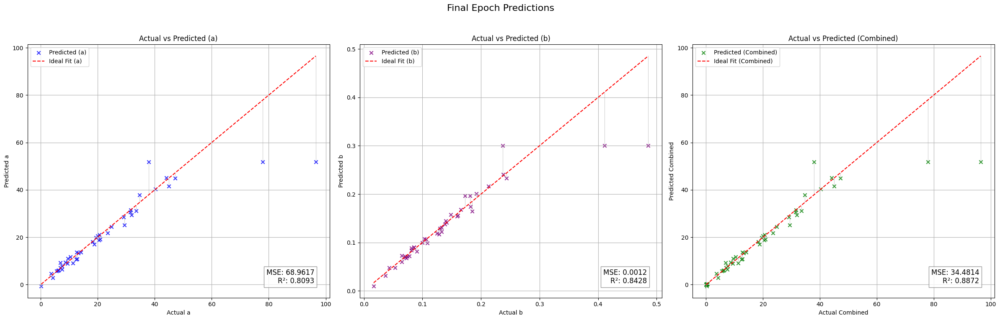

[I 2024-12-01 17:22:29,850] Trial 19 finished with value: 23.628067016601562 and parameters: {'num_layers': 2, 'hidden_size_0': 399, 'activation_0': 'ELU', 'dropout_0': 0.26740039349968264, 'hidden_size_1': 418, 'activation_1': 'ReLU', 'dropout_1': 0.1764071165908952, 'batch_size': 64, 'learning_rate': 0.008450844078729352, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 31.6198
  - R²: 0.8389
  - MAE: 1.4947
  - Explained Variance Score (EVS): 0.8431
Fold 5 Metrics:
  - Validation Loss (MSE): 31.6198
  - R²: 0.8389
  - MAE: 1.4947
  - EVS: 0.8431
Avg Validation Metrics:
  - MSE: 23.6281
  - R²: 0.8435
  - MAE: 1.7730
  - EVS: 0.8463
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=2.58]


Validation Metrics:
  - MSE: 195.3062
  - R²: 0.0024
  - MAE: 6.3219
  - Explained Variance Score (EVS): 0.0261
Epoch [1/50], Train Loss: 2.6801, Val Loss: 195.3062
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=2.51]


Validation Metrics:
  - MSE: 203.4593
  - R²: -0.0238
  - MAE: 6.2833
  - Explained Variance Score (EVS): 0.0503
Epoch [2/50], Train Loss: 2.5653, Val Loss: 203.4593
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=2.61]


Validation Metrics:
  - MSE: 222.4639
  - R²: -0.1011
  - MAE: 6.7260
  - Explained Variance Score (EVS): 0.0585
Epoch [3/50], Train Loss: 2.5432, Val Loss: 222.4639
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.12it/s, loss=2.54]


Validation Metrics:
  - MSE: 240.8877
  - R²: -0.1768
  - MAE: 7.1502
  - Explained Variance Score (EVS): 0.0699
Epoch [4/50], Train Loss: 2.4820, Val Loss: 240.8877
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.22it/s, loss=2.45]


Validation Metrics:
  - MSE: 251.3940
  - R²: -0.2311
  - MAE: 7.3701
  - Explained Variance Score (EVS): 0.0897
Epoch [5/50], Train Loss: 2.4573, Val Loss: 251.3940
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=2.44]


Validation Metrics:
  - MSE: 250.9616
  - R²: -0.2434
  - MAE: 7.3899
  - Explained Variance Score (EVS): 0.1257
Epoch [6/50], Train Loss: 2.4031, Val Loss: 250.9616
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=2.41]


Validation Metrics:
  - MSE: 252.0285
  - R²: -0.2700
  - MAE: 7.4670
  - Explained Variance Score (EVS): 0.1522
Epoch [7/50], Train Loss: 2.4047, Val Loss: 252.0285
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=2.38]


Validation Metrics:
  - MSE: 247.3932
  - R²: -0.2297
  - MAE: 7.4794
  - Explained Variance Score (EVS): 0.1984
Epoch [8/50], Train Loss: 2.3626, Val Loss: 247.3932
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=2.42]


Validation Metrics:
  - MSE: 241.4861
  - R²: -0.1932
  - MAE: 7.4237
  - Explained Variance Score (EVS): 0.2361
Epoch [9/50], Train Loss: 2.3639, Val Loss: 241.4861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.44it/s, loss=2.25]


Validation Metrics:
  - MSE: 222.7671
  - R²: -0.1134
  - MAE: 7.0758
  - Explained Variance Score (EVS): 0.2888
Epoch [10/50], Train Loss: 2.3040, Val Loss: 222.7671
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=2.33]


Validation Metrics:
  - MSE: 199.9700
  - R²: -0.0129
  - MAE: 6.6661
  - Explained Variance Score (EVS): 0.3619
Epoch [11/50], Train Loss: 2.2902, Val Loss: 199.9700
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


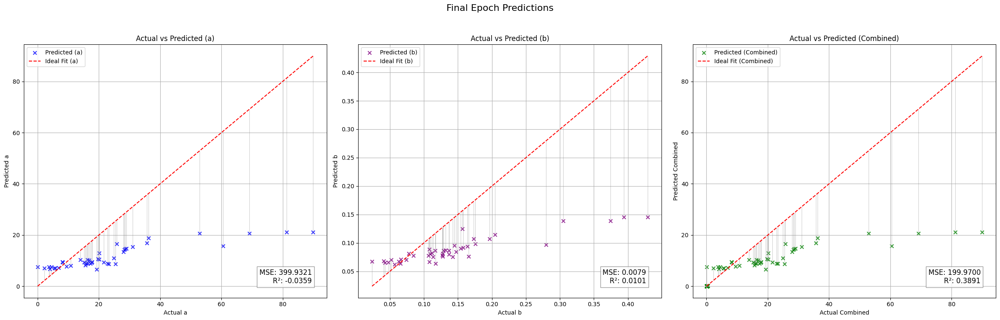

Validation Metrics:
  - MSE: 195.3062
  - R²: 0.0024
  - MAE: 6.3219
  - Explained Variance Score (EVS): 0.0261
Fold 1 Metrics:
  - Validation Loss (MSE): 195.3062
  - R²: 0.0024
  - MAE: 6.3219
  - EVS: 0.0261
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=2.49]


Validation Metrics:
  - MSE: 81.7242
  - R²: -0.0034
  - MAE: 5.1903
  - Explained Variance Score (EVS): 0.0593
Epoch [1/50], Train Loss: 2.5528, Val Loss: 81.7242
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=2.49]


Validation Metrics:
  - MSE: 78.6522
  - R²: 0.0476
  - MAE: 4.9208
  - Explained Variance Score (EVS): 0.0769
Epoch [2/50], Train Loss: 2.5103, Val Loss: 78.6522
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=2.51]


Validation Metrics:
  - MSE: 77.9900
  - R²: 0.0782
  - MAE: 4.8345
  - Explained Variance Score (EVS): 0.1040
Epoch [3/50], Train Loss: 2.4661, Val Loss: 77.9900
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  6.23it/s, loss=2.45]


Validation Metrics:
  - MSE: 76.3323
  - R²: 0.1195
  - MAE: 4.7527
  - Explained Variance Score (EVS): 0.1471
Epoch [4/50], Train Loss: 2.4345, Val Loss: 76.3323
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=2.39]


Validation Metrics:
  - MSE: 74.7501
  - R²: 0.1562
  - MAE: 4.6400
  - Explained Variance Score (EVS): 0.1985
Epoch [5/50], Train Loss: 2.4092, Val Loss: 74.7501
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=2.32]


Validation Metrics:
  - MSE: 73.2968
  - R²: 0.1961
  - MAE: 4.5583
  - Explained Variance Score (EVS): 0.2527
Epoch [6/50], Train Loss: 2.3752, Val Loss: 73.2968
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=2.32]


Validation Metrics:
  - MSE: 70.6969
  - R²: 0.2409
  - MAE: 4.4823
  - Explained Variance Score (EVS): 0.3105
Epoch [7/50], Train Loss: 2.3454, Val Loss: 70.6969
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=2.31]


Validation Metrics:
  - MSE: 65.9404
  - R²: 0.2678
  - MAE: 4.3592
  - Explained Variance Score (EVS): 0.3572
Epoch [8/50], Train Loss: 2.3273, Val Loss: 65.9404
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=2.29]


Validation Metrics:
  - MSE: 55.6544
  - R²: 0.3389
  - MAE: 4.0682
  - Explained Variance Score (EVS): 0.4445
Epoch [9/50], Train Loss: 2.2943, Val Loss: 55.6544
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=2.33]


Validation Metrics:
  - MSE: 52.2580
  - R²: 0.3542
  - MAE: 3.8805
  - Explained Variance Score (EVS): 0.4804
Epoch [10/50], Train Loss: 2.2833, Val Loss: 52.2580
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=2.2]


Validation Metrics:
  - MSE: 53.7542
  - R²: 0.3517
  - MAE: 3.8073
  - Explained Variance Score (EVS): 0.4818
Epoch [11/50], Train Loss: 2.2461, Val Loss: 53.7542
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=2.22]


Validation Metrics:
  - MSE: 43.3140
  - R²: 0.4392
  - MAE: 3.5063
  - Explained Variance Score (EVS): 0.5764
Epoch [12/50], Train Loss: 2.2347, Val Loss: 43.3140
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=2.21]


Validation Metrics:
  - MSE: 29.6645
  - R²: 0.5451
  - MAE: 3.0519
  - Explained Variance Score (EVS): 0.6803
Epoch [13/50], Train Loss: 2.1914, Val Loss: 29.6645
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=2.15]


Validation Metrics:
  - MSE: 25.5682
  - R²: 0.6014
  - MAE: 2.7936
  - Explained Variance Score (EVS): 0.7106
Epoch [14/50], Train Loss: 2.1755, Val Loss: 25.5682
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=2.19]


Validation Metrics:
  - MSE: 28.2281
  - R²: 0.6221
  - MAE: 2.8037
  - Explained Variance Score (EVS): 0.7071
Epoch [15/50], Train Loss: 2.1797, Val Loss: 28.2281
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=2.06]


Validation Metrics:
  - MSE: 28.4256
  - R²: 0.6535
  - MAE: 2.7610
  - Explained Variance Score (EVS): 0.7153
Epoch [16/50], Train Loss: 2.1067, Val Loss: 28.4256
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=2.04]


Validation Metrics:
  - MSE: 18.8083
  - R²: 0.7371
  - MAE: 2.4118
  - Explained Variance Score (EVS): 0.7865
Epoch [17/50], Train Loss: 2.0851, Val Loss: 18.8083
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=2]


Validation Metrics:
  - MSE: 14.5427
  - R²: 0.7539
  - MAE: 2.1537
  - Explained Variance Score (EVS): 0.7981
Epoch [18/50], Train Loss: 2.0792, Val Loss: 14.5427
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  6.06it/s, loss=2.05]


Validation Metrics:
  - MSE: 16.7046
  - R²: 0.7617
  - MAE: 2.2789
  - Explained Variance Score (EVS): 0.7881
Epoch [19/50], Train Loss: 2.0678, Val Loss: 16.7046
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=2.05]


Validation Metrics:
  - MSE: 15.4801
  - R²: 0.7706
  - MAE: 2.2844
  - Explained Variance Score (EVS): 0.7805
Epoch [20/50], Train Loss: 2.0286, Val Loss: 15.4801
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=1.97]


Validation Metrics:
  - MSE: 17.8607
  - R²: 0.7584
  - MAE: 2.3276
  - Explained Variance Score (EVS): 0.7759
Epoch [21/50], Train Loss: 1.9955, Val Loss: 17.8607
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=1.95]


Validation Metrics:
  - MSE: 16.6023
  - R²: 0.7947
  - MAE: 2.1861
  - Explained Variance Score (EVS): 0.8042
Epoch [22/50], Train Loss: 1.9592, Val Loss: 16.6023
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=1.94]


Validation Metrics:
  - MSE: 15.5088
  - R²: 0.8014
  - MAE: 2.0814
  - Explained Variance Score (EVS): 0.8073
Epoch [23/50], Train Loss: 1.9540, Val Loss: 15.5088
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.46it/s, loss=1.88]


Validation Metrics:
  - MSE: 16.2769
  - R²: 0.7881
  - MAE: 2.1584
  - Explained Variance Score (EVS): 0.7943
Epoch [24/50], Train Loss: 1.9112, Val Loss: 16.2769
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.66it/s, loss=1.89]


Validation Metrics:
  - MSE: 16.9543
  - R²: 0.8099
  - MAE: 2.1398
  - Explained Variance Score (EVS): 0.8225
Epoch [25/50], Train Loss: 1.8698, Val Loss: 16.9543
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=1.8]


Validation Metrics:
  - MSE: 15.8801
  - R²: 0.8182
  - MAE: 2.0471
  - Explained Variance Score (EVS): 0.8258
Epoch [26/50], Train Loss: 1.8270, Val Loss: 15.8801
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=1.76]


Validation Metrics:
  - MSE: 16.7724
  - R²: 0.7785
  - MAE: 2.0916
  - Explained Variance Score (EVS): 0.7833
Epoch [27/50], Train Loss: 1.8001, Val Loss: 16.7724
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=1.76]


Validation Metrics:
  - MSE: 19.1027
  - R²: 0.7718
  - MAE: 2.2691
  - Explained Variance Score (EVS): 0.7741
Epoch [28/50], Train Loss: 1.7926, Val Loss: 19.1027
Current Dropout Rate: 0.2840
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


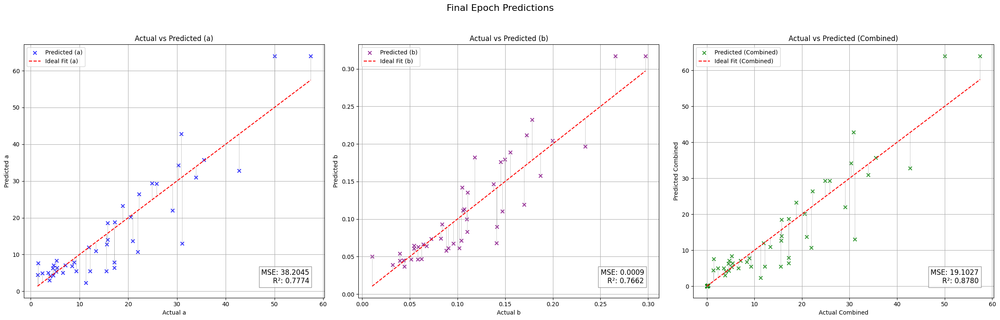

Validation Metrics:
  - MSE: 14.5427
  - R²: 0.7539
  - MAE: 2.1537
  - Explained Variance Score (EVS): 0.7981
Fold 2 Metrics:
  - Validation Loss (MSE): 14.5427
  - R²: 0.7539
  - MAE: 2.1537
  - EVS: 0.7981
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=2.04]


Validation Metrics:
  - MSE: 25.0433
  - R²: 0.7486
  - MAE: 2.5607
  - Explained Variance Score (EVS): 0.8240
Epoch [1/50], Train Loss: 2.0505, Val Loss: 25.0433
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=2.02]


Validation Metrics:
  - MSE: 21.5597
  - R²: 0.7962
  - MAE: 2.3283
  - Explained Variance Score (EVS): 0.8352
Epoch [2/50], Train Loss: 2.0414, Val Loss: 21.5597
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=1.98]


Validation Metrics:
  - MSE: 20.4479
  - R²: 0.8113
  - MAE: 2.2269
  - Explained Variance Score (EVS): 0.8453
Epoch [3/50], Train Loss: 2.0066, Val Loss: 20.4479
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=1.98]


Validation Metrics:
  - MSE: 22.5908
  - R²: 0.7903
  - MAE: 2.3855
  - Explained Variance Score (EVS): 0.8290
Epoch [4/50], Train Loss: 1.9690, Val Loss: 22.5908
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=1.93]


Validation Metrics:
  - MSE: 25.4937
  - R²: 0.7771
  - MAE: 2.6781
  - Explained Variance Score (EVS): 0.8132
Epoch [5/50], Train Loss: 1.9408, Val Loss: 25.4937
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=1.87]


Validation Metrics:
  - MSE: 27.9703
  - R²: 0.7632
  - MAE: 2.7366
  - Explained Variance Score (EVS): 0.7789
Epoch [6/50], Train Loss: 1.9158, Val Loss: 27.9703
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=1.85]


Validation Metrics:
  - MSE: 27.5879
  - R²: 0.7259
  - MAE: 2.5857
  - Explained Variance Score (EVS): 0.7348
Epoch [7/50], Train Loss: 1.8857, Val Loss: 27.5879
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s, loss=1.83]


Validation Metrics:
  - MSE: 23.1865
  - R²: 0.7367
  - MAE: 2.3491
  - Explained Variance Score (EVS): 0.7452
Epoch [8/50], Train Loss: 1.8799, Val Loss: 23.1865
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=1.84]


Validation Metrics:
  - MSE: 25.1957
  - R²: 0.7536
  - MAE: 2.2687
  - Explained Variance Score (EVS): 0.7634
Epoch [9/50], Train Loss: 1.8253, Val Loss: 25.1957
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=1.81]


Validation Metrics:
  - MSE: 26.6322
  - R²: 0.7607
  - MAE: 2.4061
  - Explained Variance Score (EVS): 0.7770
Epoch [10/50], Train Loss: 1.8109, Val Loss: 26.6322
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=1.75]


Validation Metrics:
  - MSE: 40.8779
  - R²: 0.6772
  - MAE: 2.6659
  - Explained Variance Score (EVS): 0.6815
Epoch [11/50], Train Loss: 1.7727, Val Loss: 40.8779
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=1.72]


Validation Metrics:
  - MSE: 62.6208
  - R²: 0.5024
  - MAE: 3.1557
  - Explained Variance Score (EVS): 0.5035
Epoch [12/50], Train Loss: 1.7567, Val Loss: 62.6208
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=1.78]


Validation Metrics:
  - MSE: 40.8835
  - R²: 0.6435
  - MAE: 2.7705
  - Explained Variance Score (EVS): 0.6499
Epoch [13/50], Train Loss: 1.7312, Val Loss: 40.8835
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


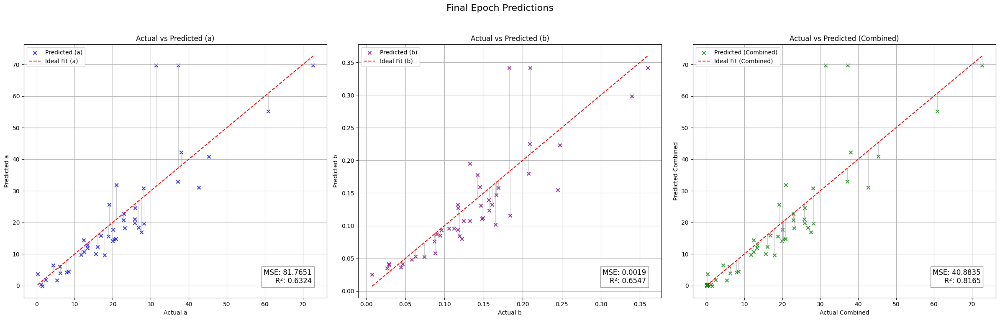

Validation Metrics:
  - MSE: 20.4479
  - R²: 0.8113
  - MAE: 2.2269
  - Explained Variance Score (EVS): 0.8453
Fold 3 Metrics:
  - Validation Loss (MSE): 20.4479
  - R²: 0.8113
  - MAE: 2.2269
  - EVS: 0.8453
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=1.99]


Validation Metrics:
  - MSE: 26.8868
  - R²: 0.5393
  - MAE: 2.3315
  - Explained Variance Score (EVS): 0.5726
Epoch [1/50], Train Loss: 1.9623, Val Loss: 26.8868
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=1.97]


Validation Metrics:
  - MSE: 27.4557
  - R²: 0.5452
  - MAE: 2.4317
  - Explained Variance Score (EVS): 0.5719
Epoch [2/50], Train Loss: 1.9394, Val Loss: 27.4557
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=1.89]


Validation Metrics:
  - MSE: 36.8225
  - R²: 0.4865
  - MAE: 2.7531
  - Explained Variance Score (EVS): 0.5047
Epoch [3/50], Train Loss: 1.9018, Val Loss: 36.8225
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=1.84]


Validation Metrics:
  - MSE: 44.4941
  - R²: 0.4513
  - MAE: 3.0561
  - Explained Variance Score (EVS): 0.4695
Epoch [4/50], Train Loss: 1.8751, Val Loss: 44.4941
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=1.87]


Validation Metrics:
  - MSE: 43.3248
  - R²: 0.4578
  - MAE: 3.0882
  - Explained Variance Score (EVS): 0.4807
Epoch [5/50], Train Loss: 1.8523, Val Loss: 43.3248
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=1.78]


Validation Metrics:
  - MSE: 47.6497
  - R²: 0.4191
  - MAE: 3.1450
  - Explained Variance Score (EVS): 0.4341
Epoch [6/50], Train Loss: 1.8142, Val Loss: 47.6497
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.22it/s, loss=1.8]


Validation Metrics:
  - MSE: 49.7613
  - R²: 0.3863
  - MAE: 3.2189
  - Explained Variance Score (EVS): 0.3972
Epoch [7/50], Train Loss: 1.7810, Val Loss: 49.7613
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.61it/s, loss=1.73]


Validation Metrics:
  - MSE: 44.6142
  - R²: 0.3951
  - MAE: 3.0209
  - Explained Variance Score (EVS): 0.4022
Epoch [8/50], Train Loss: 1.7517, Val Loss: 44.6142
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=1.72]


Validation Metrics:
  - MSE: 47.0992
  - R²: 0.3884
  - MAE: 2.9699
  - Explained Variance Score (EVS): 0.3959
Epoch [9/50], Train Loss: 1.7330, Val Loss: 47.0992
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.91it/s, loss=1.66]


Validation Metrics:
  - MSE: 58.3419
  - R²: 0.3325
  - MAE: 3.1441
  - Explained Variance Score (EVS): 0.3420
Epoch [10/50], Train Loss: 1.7001, Val Loss: 58.3419
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s, loss=1.63]


Validation Metrics:
  - MSE: 50.2067
  - R²: 0.3713
  - MAE: 3.0789
  - Explained Variance Score (EVS): 0.3814
Epoch [11/50], Train Loss: 1.6725, Val Loss: 50.2067
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


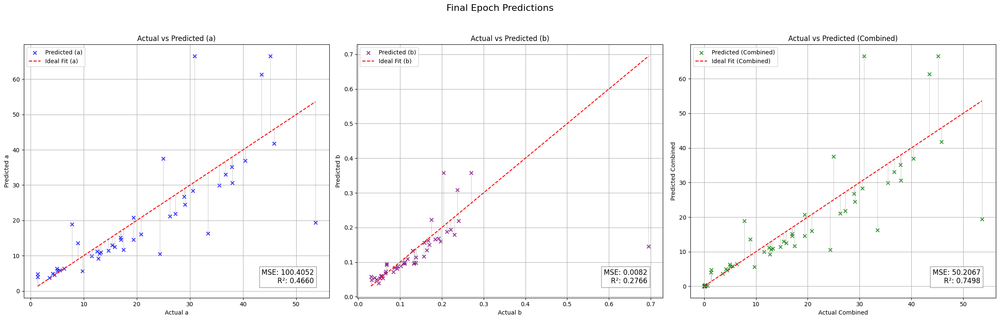

Validation Metrics:
  - MSE: 26.8868
  - R²: 0.5393
  - MAE: 2.3315
  - Explained Variance Score (EVS): 0.5726
Fold 4 Metrics:
  - Validation Loss (MSE): 26.8868
  - R²: 0.5393
  - MAE: 2.3315
  - EVS: 0.5726
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=1.95]


Validation Metrics:
  - MSE: 47.4349
  - R²: 0.7841
  - MAE: 2.6745
  - Explained Variance Score (EVS): 0.8232
Epoch [1/50], Train Loss: 1.9506, Val Loss: 47.4349
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=1.87]


Validation Metrics:
  - MSE: 49.3267
  - R²: 0.7777
  - MAE: 2.8270
  - Explained Variance Score (EVS): 0.8178
Epoch [2/50], Train Loss: 1.9226, Val Loss: 49.3267
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=1.83]


Validation Metrics:
  - MSE: 42.9049
  - R²: 0.7867
  - MAE: 2.5979
  - Explained Variance Score (EVS): 0.8279
Epoch [3/50], Train Loss: 1.8886, Val Loss: 42.9049
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=1.81]


Validation Metrics:
  - MSE: 42.5394
  - R²: 0.7592
  - MAE: 2.4137
  - Explained Variance Score (EVS): 0.8090
Epoch [4/50], Train Loss: 1.8549, Val Loss: 42.5394
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.58it/s, loss=1.85]


Validation Metrics:
  - MSE: 42.4301
  - R²: 0.7667
  - MAE: 2.4026
  - Explained Variance Score (EVS): 0.8139
Epoch [5/50], Train Loss: 1.8308, Val Loss: 42.4301
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=1.83]


Validation Metrics:
  - MSE: 39.9546
  - R²: 0.8065
  - MAE: 2.6819
  - Explained Variance Score (EVS): 0.8525
Epoch [6/50], Train Loss: 1.8051, Val Loss: 39.9546
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=1.83]


Validation Metrics:
  - MSE: 39.2922
  - R²: 0.8052
  - MAE: 2.6697
  - Explained Variance Score (EVS): 0.8513
Epoch [7/50], Train Loss: 1.7928, Val Loss: 39.2922
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=1.74]


Validation Metrics:
  - MSE: 42.1840
  - R²: 0.7586
  - MAE: 2.4928
  - Explained Variance Score (EVS): 0.8073
Epoch [8/50], Train Loss: 1.7474, Val Loss: 42.1840
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=1.81]


Validation Metrics:
  - MSE: 53.1156
  - R²: 0.6835
  - MAE: 2.3841
  - Explained Variance Score (EVS): 0.7265
Epoch [9/50], Train Loss: 1.7622, Val Loss: 53.1156
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.26it/s, loss=1.66]


Validation Metrics:
  - MSE: 49.2230
  - R²: 0.7445
  - MAE: 2.3383
  - Explained Variance Score (EVS): 0.7758
Epoch [10/50], Train Loss: 1.6939, Val Loss: 49.2230
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=1.78]


Validation Metrics:
  - MSE: 51.1656
  - R²: 0.7499
  - MAE: 2.7051
  - Explained Variance Score (EVS): 0.7955
Epoch [11/50], Train Loss: 1.7013, Val Loss: 51.1656
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.18it/s, loss=1.6]


Validation Metrics:
  - MSE: 47.2212
  - R²: 0.7554
  - MAE: 2.7568
  - Explained Variance Score (EVS): 0.8079
Epoch [12/50], Train Loss: 1.6381, Val Loss: 47.2212
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=1.61]


Validation Metrics:
  - MSE: 44.1013
  - R²: 0.7552
  - MAE: 2.7031
  - Explained Variance Score (EVS): 0.8063
Epoch [13/50], Train Loss: 1.6307, Val Loss: 44.1013
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=1.59]


Validation Metrics:
  - MSE: 49.2928
  - R²: 0.7236
  - MAE: 2.8438
  - Explained Variance Score (EVS): 0.7782
Epoch [14/50], Train Loss: 1.6064, Val Loss: 49.2928
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=1.63]


Validation Metrics:
  - MSE: 50.3972
  - R²: 0.7322
  - MAE: 2.7801
  - Explained Variance Score (EVS): 0.7819
Epoch [15/50], Train Loss: 1.6149, Val Loss: 50.3972
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=1.64]


Validation Metrics:
  - MSE: 47.4452
  - R²: 0.7593
  - MAE: 2.5173
  - Explained Variance Score (EVS): 0.7939
Epoch [16/50], Train Loss: 1.5988, Val Loss: 47.4452
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=1.6]


Validation Metrics:
  - MSE: 41.9445
  - R²: 0.7835
  - MAE: 2.4892
  - Explained Variance Score (EVS): 0.8138
Epoch [17/50], Train Loss: 1.5792, Val Loss: 41.9445
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


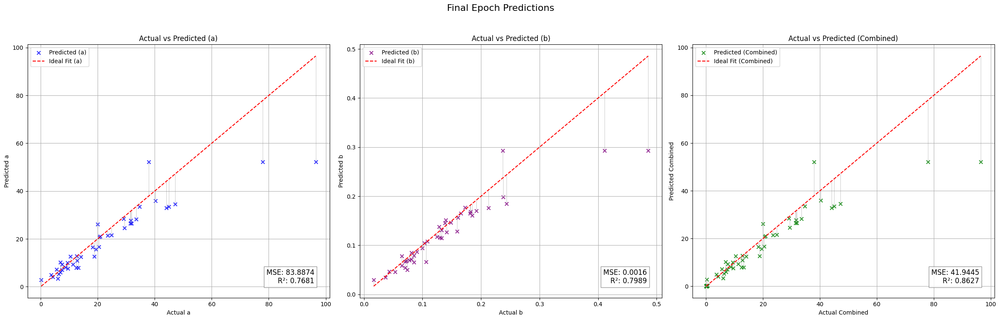

[I 2024-12-01 17:24:12,380] Trial 20 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 39.2922
  - R²: 0.8052
  - MAE: 2.6697
  - Explained Variance Score (EVS): 0.8513
Fold 5 Metrics:
  - Validation Loss (MSE): 39.2922
  - R²: 0.8052
  - MAE: 2.6697
  - EVS: 0.8513
Avg Validation Metrics:
  - MSE: 59.2952
  - R²: 0.5824
  - MAE: 3.1408
  - EVS: 0.6187
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=1.11]


Validation Metrics:
  - MSE: 180.4822
  - R²: 0.0605
  - MAE: 6.2206
  - Explained Variance Score (EVS): 0.0669
Epoch [1/50], Train Loss: 1.2533, Val Loss: 180.4822
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=1.1]


Validation Metrics:
  - MSE: 180.6291
  - R²: 0.0812
  - MAE: 6.1856
  - Explained Variance Score (EVS): 0.0889
Epoch [2/50], Train Loss: 1.1731, Val Loss: 180.6291
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.34it/s, loss=1.12]


Validation Metrics:
  - MSE: 183.4022
  - R²: 0.0730
  - MAE: 6.2316
  - Explained Variance Score (EVS): 0.0837
Epoch [3/50], Train Loss: 1.1351, Val Loss: 183.4022
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=1.05]


Validation Metrics:
  - MSE: 183.7545
  - R²: 0.0622
  - MAE: 6.2094
  - Explained Variance Score (EVS): 0.0753
Epoch [4/50], Train Loss: 1.0666, Val Loss: 183.7545
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=1.06]


Validation Metrics:
  - MSE: 178.3110
  - R²: 0.0869
  - MAE: 6.0441
  - Explained Variance Score (EVS): 0.0985
Epoch [5/50], Train Loss: 1.0381, Val Loss: 178.3110
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=1.04]


Validation Metrics:
  - MSE: 171.9489
  - R²: 0.1202
  - MAE: 5.8921
  - Explained Variance Score (EVS): 0.1317
Epoch [6/50], Train Loss: 1.0100, Val Loss: 171.9489
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.97]


Validation Metrics:
  - MSE: 169.8507
  - R²: 0.1528
  - MAE: 5.8881
  - Explained Variance Score (EVS): 0.1656
Epoch [7/50], Train Loss: 0.9808, Val Loss: 169.8507
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.888]


Validation Metrics:
  - MSE: 166.7839
  - R²: 0.1765
  - MAE: 5.8626
  - Explained Variance Score (EVS): 0.1906
Epoch [8/50], Train Loss: 0.9471, Val Loss: 166.7839
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=0.914]


Validation Metrics:
  - MSE: 154.5784
  - R²: 0.2148
  - MAE: 5.6706
  - Explained Variance Score (EVS): 0.2266
Epoch [9/50], Train Loss: 0.9189, Val Loss: 154.5784
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s, loss=0.898]


Validation Metrics:
  - MSE: 145.4782
  - R²: 0.2476
  - MAE: 5.4002
  - Explained Variance Score (EVS): 0.2583
Epoch [10/50], Train Loss: 0.9160, Val Loss: 145.4782
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.88]


Validation Metrics:
  - MSE: 146.0258
  - R²: 0.2633
  - MAE: 5.2702
  - Explained Variance Score (EVS): 0.2756
Epoch [11/50], Train Loss: 0.8914, Val Loss: 146.0258
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.842]


Validation Metrics:
  - MSE: 147.9270
  - R²: 0.2778
  - MAE: 5.2962
  - Explained Variance Score (EVS): 0.2928
Epoch [12/50], Train Loss: 0.8730, Val Loss: 147.9270
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  4.81it/s, loss=0.825]


Validation Metrics:
  - MSE: 135.4900
  - R²: 0.3237
  - MAE: 5.1443
  - Explained Variance Score (EVS): 0.3351
Epoch [13/50], Train Loss: 0.8454, Val Loss: 135.4900
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.807]


Validation Metrics:
  - MSE: 115.9920
  - R²: 0.4302
  - MAE: 4.8740
  - Explained Variance Score (EVS): 0.4355
Epoch [14/50], Train Loss: 0.8261, Val Loss: 115.9920
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.91it/s, loss=0.842]


Validation Metrics:
  - MSE: 100.9207
  - R²: 0.4899
  - MAE: 4.5475
  - Explained Variance Score (EVS): 0.4938
Epoch [15/50], Train Loss: 0.8174, Val Loss: 100.9207
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=0.801]


Validation Metrics:
  - MSE: 104.6682
  - R²: 0.4733
  - MAE: 4.4686
  - Explained Variance Score (EVS): 0.4839
Epoch [16/50], Train Loss: 0.7912, Val Loss: 104.6682
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.745]


Validation Metrics:
  - MSE: 102.5671
  - R²: 0.4768
  - MAE: 4.3498
  - Explained Variance Score (EVS): 0.4902
Epoch [17/50], Train Loss: 0.7678, Val Loss: 102.5671
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.687]


Validation Metrics:
  - MSE: 88.6220
  - R²: 0.5426
  - MAE: 4.1011
  - Explained Variance Score (EVS): 0.5506
Epoch [18/50], Train Loss: 0.7449, Val Loss: 88.6220
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=0.802]


Validation Metrics:
  - MSE: 86.2946
  - R²: 0.5683
  - MAE: 4.0122
  - Explained Variance Score (EVS): 0.5806
Epoch [19/50], Train Loss: 0.7563, Val Loss: 86.2946
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.695]


Validation Metrics:
  - MSE: 86.0402
  - R²: 0.5871
  - MAE: 4.0571
  - Explained Variance Score (EVS): 0.6047
Epoch [20/50], Train Loss: 0.7030, Val Loss: 86.0402
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.664]


Validation Metrics:
  - MSE: 77.6879
  - R²: 0.6329
  - MAE: 3.9513
  - Explained Variance Score (EVS): 0.6441
Epoch [21/50], Train Loss: 0.6745, Val Loss: 77.6879
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.662]


Validation Metrics:
  - MSE: 68.4093
  - R²: 0.6595
  - MAE: 3.8689
  - Explained Variance Score (EVS): 0.6640
Epoch [22/50], Train Loss: 0.6697, Val Loss: 68.4093
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.98it/s, loss=0.584]


Validation Metrics:
  - MSE: 71.3584
  - R²: 0.6314
  - MAE: 3.8610
  - Explained Variance Score (EVS): 0.6376
Epoch [23/50], Train Loss: 0.6393, Val Loss: 71.3584
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.599]


Validation Metrics:
  - MSE: 73.2140
  - R²: 0.6458
  - MAE: 3.7927
  - Explained Variance Score (EVS): 0.6520
Epoch [24/50], Train Loss: 0.6081, Val Loss: 73.2140
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.589]


Validation Metrics:
  - MSE: 71.3113
  - R²: 0.6580
  - MAE: 3.7920
  - Explained Variance Score (EVS): 0.6633
Epoch [25/50], Train Loss: 0.5885, Val Loss: 71.3113
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.551]


Validation Metrics:
  - MSE: 68.3856
  - R²: 0.6600
  - MAE: 3.7748
  - Explained Variance Score (EVS): 0.6656
Epoch [26/50], Train Loss: 0.5852, Val Loss: 68.3856
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.593]


Validation Metrics:
  - MSE: 67.2996
  - R²: 0.6581
  - MAE: 3.7052
  - Explained Variance Score (EVS): 0.6651
Epoch [27/50], Train Loss: 0.5557, Val Loss: 67.2996
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s, loss=0.575]


Validation Metrics:
  - MSE: 68.6772
  - R²: 0.6665
  - MAE: 3.6416
  - Explained Variance Score (EVS): 0.6733
Epoch [28/50], Train Loss: 0.5334, Val Loss: 68.6772
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.17it/s, loss=0.484]


Validation Metrics:
  - MSE: 67.3887
  - R²: 0.6747
  - MAE: 3.6089
  - Explained Variance Score (EVS): 0.6842
Epoch [29/50], Train Loss: 0.5033, Val Loss: 67.3887
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.94it/s, loss=0.436]


Validation Metrics:
  - MSE: 67.1495
  - R²: 0.6742
  - MAE: 3.6601
  - Explained Variance Score (EVS): 0.6879
Epoch [30/50], Train Loss: 0.4778, Val Loss: 67.1495
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.447]


Validation Metrics:
  - MSE: 66.6261
  - R²: 0.6569
  - MAE: 3.7846
  - Explained Variance Score (EVS): 0.6698
Epoch [31/50], Train Loss: 0.4611, Val Loss: 66.6261
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.42]


Validation Metrics:
  - MSE: 68.3871
  - R²: 0.6272
  - MAE: 3.8298
  - Explained Variance Score (EVS): 0.6363
Epoch [32/50], Train Loss: 0.4414, Val Loss: 68.3871
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.22it/s, loss=0.374]


Validation Metrics:
  - MSE: 76.8444
  - R²: 0.5939
  - MAE: 3.8465
  - Explained Variance Score (EVS): 0.6066
Epoch [33/50], Train Loss: 0.4124, Val Loss: 76.8444
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.364]


Validation Metrics:
  - MSE: 80.0574
  - R²: 0.6091
  - MAE: 3.8828
  - Explained Variance Score (EVS): 0.6210
Epoch [34/50], Train Loss: 0.4004, Val Loss: 80.0574
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.359]


Validation Metrics:
  - MSE: 76.1010
  - R²: 0.6387
  - MAE: 3.8373
  - Explained Variance Score (EVS): 0.6520
Epoch [35/50], Train Loss: 0.3723, Val Loss: 76.1010
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s, loss=0.334]


Validation Metrics:
  - MSE: 68.7830
  - R²: 0.6512
  - MAE: 3.6998
  - Explained Variance Score (EVS): 0.6672
Epoch [36/50], Train Loss: 0.3545, Val Loss: 68.7830
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=0.337]


Validation Metrics:
  - MSE: 70.2505
  - R²: 0.6503
  - MAE: 3.6753
  - Explained Variance Score (EVS): 0.6666
Epoch [37/50], Train Loss: 0.3334, Val Loss: 70.2505
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.303]


Validation Metrics:
  - MSE: 74.5333
  - R²: 0.6152
  - MAE: 3.7677
  - Explained Variance Score (EVS): 0.6328
Epoch [38/50], Train Loss: 0.3148, Val Loss: 74.5333
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.99it/s, loss=0.27]


Validation Metrics:
  - MSE: 70.2219
  - R²: 0.6158
  - MAE: 3.7734
  - Explained Variance Score (EVS): 0.6281
Epoch [39/50], Train Loss: 0.2962, Val Loss: 70.2219
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.251]


Validation Metrics:
  - MSE: 65.9510
  - R²: 0.6486
  - MAE: 3.8035
  - Explained Variance Score (EVS): 0.6523
Epoch [40/50], Train Loss: 0.2768, Val Loss: 65.9510
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.283]


Validation Metrics:
  - MSE: 71.2839
  - R²: 0.6369
  - MAE: 3.8541
  - Explained Variance Score (EVS): 0.6443
Epoch [41/50], Train Loss: 0.2661, Val Loss: 71.2839
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  6.32it/s, loss=0.233]


Validation Metrics:
  - MSE: 77.2037
  - R²: 0.6120
  - MAE: 3.9251
  - Explained Variance Score (EVS): 0.6219
Epoch [42/50], Train Loss: 0.2494, Val Loss: 77.2037
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.246]


Validation Metrics:
  - MSE: 77.7865
  - R²: 0.6011
  - MAE: 3.9187
  - Explained Variance Score (EVS): 0.6082
Epoch [43/50], Train Loss: 0.2396, Val Loss: 77.7865
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.256]


Validation Metrics:
  - MSE: 79.3184
  - R²: 0.5975
  - MAE: 3.9055
  - Explained Variance Score (EVS): 0.6056
Epoch [44/50], Train Loss: 0.2318, Val Loss: 79.3184
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.232]


Validation Metrics:
  - MSE: 75.2873
  - R²: 0.6220
  - MAE: 3.9235
  - Explained Variance Score (EVS): 0.6323
Epoch [45/50], Train Loss: 0.2187, Val Loss: 75.2873
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.238]


Validation Metrics:
  - MSE: 72.3201
  - R²: 0.6281
  - MAE: 3.9070
  - Explained Variance Score (EVS): 0.6428
Epoch [46/50], Train Loss: 0.2097, Val Loss: 72.3201
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.174]


Validation Metrics:
  - MSE: 70.0313
  - R²: 0.6577
  - MAE: 3.7599
  - Explained Variance Score (EVS): 0.6666
Epoch [47/50], Train Loss: 0.1842, Val Loss: 70.0313
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.218]


Validation Metrics:
  - MSE: 74.2604
  - R²: 0.6451
  - MAE: 3.7062
  - Explained Variance Score (EVS): 0.6535
Epoch [48/50], Train Loss: 0.1996, Val Loss: 74.2604
Current Dropout Rate: 0.1240


Epoch 49/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=0.201]


Validation Metrics:
  - MSE: 76.4415
  - R²: 0.6160
  - MAE: 3.7040
  - Explained Variance Score (EVS): 0.6287
Epoch [49/50], Train Loss: 0.1788, Val Loss: 76.4415
Current Dropout Rate: 0.1160


Epoch 50/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=0.195]


Validation Metrics:
  - MSE: 77.0851
  - R²: 0.6217
  - MAE: 3.7930
  - Explained Variance Score (EVS): 0.6313
Epoch [50/50], Train Loss: 0.1733, Val Loss: 77.0851
Current Dropout Rate: 0.1080
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


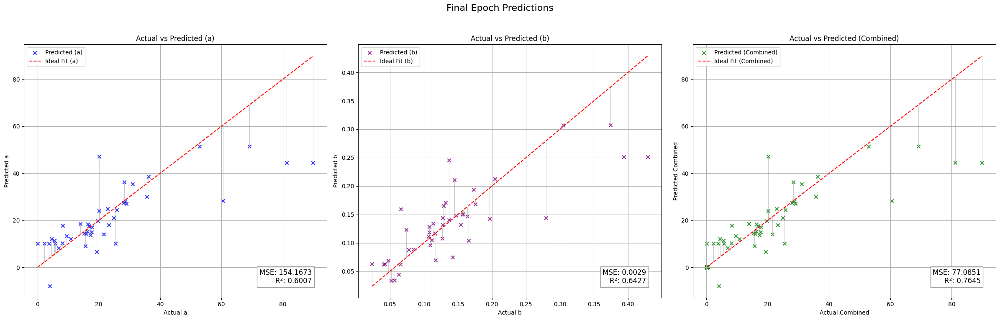

Validation Metrics:
  - MSE: 65.9510
  - R²: 0.6486
  - MAE: 3.8035
  - Explained Variance Score (EVS): 0.6523
Fold 1 Metrics:
  - Validation Loss (MSE): 65.9510
  - R²: 0.6486
  - MAE: 3.8035
  - EVS: 0.6523
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.387]


Validation Metrics:
  - MSE: 2.6570
  - R²: 0.9637
  - MAE: 0.9552
  - Explained Variance Score (EVS): 0.9648
Epoch [1/50], Train Loss: 0.3363, Val Loss: 2.6570
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.331]


Validation Metrics:
  - MSE: 4.2135
  - R²: 0.9441
  - MAE: 1.2495
  - Explained Variance Score (EVS): 0.9472
Epoch [2/50], Train Loss: 0.3319, Val Loss: 4.2135
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.34it/s, loss=0.307]


Validation Metrics:
  - MSE: 4.1164
  - R²: 0.9397
  - MAE: 1.2229
  - Explained Variance Score (EVS): 0.9440
Epoch [3/50], Train Loss: 0.2967, Val Loss: 4.1164
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.249]


Validation Metrics:
  - MSE: 5.2239
  - R²: 0.9383
  - MAE: 1.3549
  - Explained Variance Score (EVS): 0.9411
Epoch [4/50], Train Loss: 0.2776, Val Loss: 5.2239
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.285]


Validation Metrics:
  - MSE: 6.3124
  - R²: 0.9245
  - MAE: 1.3888
  - Explained Variance Score (EVS): 0.9263
Epoch [5/50], Train Loss: 0.2616, Val Loss: 6.3124
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s, loss=0.251]


Validation Metrics:
  - MSE: 5.5430
  - R²: 0.9344
  - MAE: 1.3268
  - Explained Variance Score (EVS): 0.9359
Epoch [6/50], Train Loss: 0.2633, Val Loss: 5.5430
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=0.248]


Validation Metrics:
  - MSE: 4.9058
  - R²: 0.9418
  - MAE: 1.2305
  - Explained Variance Score (EVS): 0.9423
Epoch [7/50], Train Loss: 0.2395, Val Loss: 4.9058
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.273]


Validation Metrics:
  - MSE: 6.4612
  - R²: 0.9244
  - MAE: 1.4099
  - Explained Variance Score (EVS): 0.9265
Epoch [8/50], Train Loss: 0.2496, Val Loss: 6.4612
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.68it/s, loss=0.268]


Validation Metrics:
  - MSE: 8.5516
  - R²: 0.9012
  - MAE: 1.4907
  - Explained Variance Score (EVS): 0.9024
Epoch [9/50], Train Loss: 0.2437, Val Loss: 8.5516
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.264]


Validation Metrics:
  - MSE: 8.2722
  - R²: 0.8938
  - MAE: 1.4487
  - Explained Variance Score (EVS): 0.8944
Epoch [10/50], Train Loss: 0.2239, Val Loss: 8.2722
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=0.186]


Validation Metrics:
  - MSE: 6.8348
  - R²: 0.9118
  - MAE: 1.3012
  - Explained Variance Score (EVS): 0.9122
Epoch [11/50], Train Loss: 0.2112, Val Loss: 6.8348
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


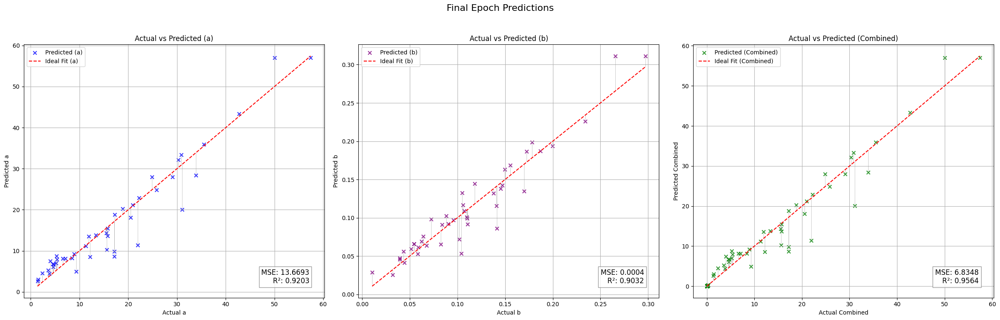

Validation Metrics:
  - MSE: 2.6570
  - R²: 0.9637
  - MAE: 0.9552
  - Explained Variance Score (EVS): 0.9648
Fold 2 Metrics:
  - Validation Loss (MSE): 2.6570
  - R²: 0.9637
  - MAE: 0.9552
  - EVS: 0.9648
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.327]


Validation Metrics:
  - MSE: 15.1421
  - R²: 0.8841
  - MAE: 1.5200
  - Explained Variance Score (EVS): 0.8851
Epoch [1/50], Train Loss: 0.3039, Val Loss: 15.1421
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s, loss=0.291]


Validation Metrics:
  - MSE: 15.5055
  - R²: 0.8809
  - MAE: 1.5496
  - Explained Variance Score (EVS): 0.8818
Epoch [2/50], Train Loss: 0.2981, Val Loss: 15.5055
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.60it/s, loss=0.291]


Validation Metrics:
  - MSE: 15.0087
  - R²: 0.8799
  - MAE: 1.4732
  - Explained Variance Score (EVS): 0.8807
Epoch [3/50], Train Loss: 0.2883, Val Loss: 15.0087
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.50it/s, loss=0.357]


Validation Metrics:
  - MSE: 14.8821
  - R²: 0.8749
  - MAE: 1.4151
  - Explained Variance Score (EVS): 0.8752
Epoch [4/50], Train Loss: 0.2893, Val Loss: 14.8821
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.281]


Validation Metrics:
  - MSE: 15.1570
  - R²: 0.8622
  - MAE: 1.4511
  - Explained Variance Score (EVS): 0.8631
Epoch [5/50], Train Loss: 0.2709, Val Loss: 15.1570
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.22it/s, loss=0.268]


Validation Metrics:
  - MSE: 15.8892
  - R²: 0.8515
  - MAE: 1.4588
  - Explained Variance Score (EVS): 0.8531
Epoch [6/50], Train Loss: 0.2531, Val Loss: 15.8892
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.262]


Validation Metrics:
  - MSE: 17.8628
  - R²: 0.8425
  - MAE: 1.5380
  - Explained Variance Score (EVS): 0.8463
Epoch [7/50], Train Loss: 0.2613, Val Loss: 17.8628
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.254]


Validation Metrics:
  - MSE: 18.0824
  - R²: 0.8426
  - MAE: 1.5615
  - Explained Variance Score (EVS): 0.8463
Epoch [8/50], Train Loss: 0.2417, Val Loss: 18.0824
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.228]


Validation Metrics:
  - MSE: 17.0406
  - R²: 0.8525
  - MAE: 1.5174
  - Explained Variance Score (EVS): 0.8545
Epoch [9/50], Train Loss: 0.2454, Val Loss: 17.0406
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.214]


Validation Metrics:
  - MSE: 16.8546
  - R²: 0.8546
  - MAE: 1.5000
  - Explained Variance Score (EVS): 0.8572
Epoch [10/50], Train Loss: 0.2353, Val Loss: 16.8546
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.213]


Validation Metrics:
  - MSE: 17.1882
  - R²: 0.8527
  - MAE: 1.5250
  - Explained Variance Score (EVS): 0.8559
Epoch [11/50], Train Loss: 0.2369, Val Loss: 17.1882
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.215]


Validation Metrics:
  - MSE: 17.2703
  - R²: 0.8548
  - MAE: 1.5230
  - Explained Variance Score (EVS): 0.8563
Epoch [12/50], Train Loss: 0.2234, Val Loss: 17.2703
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=0.222]


Validation Metrics:
  - MSE: 17.4617
  - R²: 0.8549
  - MAE: 1.5637
  - Explained Variance Score (EVS): 0.8559
Epoch [13/50], Train Loss: 0.2188, Val Loss: 17.4617
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.223]


Validation Metrics:
  - MSE: 18.1847
  - R²: 0.8490
  - MAE: 1.5809
  - Explained Variance Score (EVS): 0.8499
Epoch [14/50], Train Loss: 0.2190, Val Loss: 18.1847
Current Dropout Rate: 0.3960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


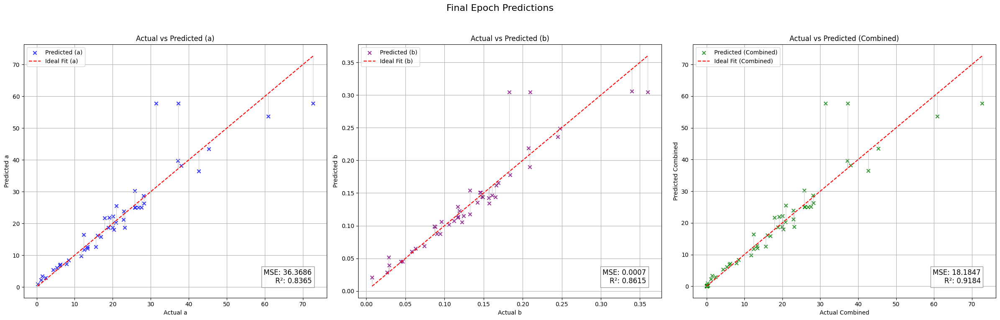

Validation Metrics:
  - MSE: 14.8821
  - R²: 0.8749
  - MAE: 1.4151
  - Explained Variance Score (EVS): 0.8752
Fold 3 Metrics:
  - Validation Loss (MSE): 14.8821
  - R²: 0.8749
  - MAE: 1.4151
  - EVS: 0.8752
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.57it/s, loss=0.273]


Validation Metrics:
  - MSE: 12.7419
  - R²: 0.8996
  - MAE: 1.3408
  - Explained Variance Score (EVS): 0.9050
Epoch [1/50], Train Loss: 0.2661, Val Loss: 12.7419
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.295]


Validation Metrics:
  - MSE: 15.2953
  - R²: 0.8796
  - MAE: 1.4526
  - Explained Variance Score (EVS): 0.8894
Epoch [2/50], Train Loss: 0.2896, Val Loss: 15.2953
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.282]


Validation Metrics:
  - MSE: 16.6124
  - R²: 0.8681
  - MAE: 1.5069
  - Explained Variance Score (EVS): 0.8780
Epoch [3/50], Train Loss: 0.2791, Val Loss: 16.6124
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.221]


Validation Metrics:
  - MSE: 17.4782
  - R²: 0.8606
  - MAE: 1.5409
  - Explained Variance Score (EVS): 0.8694
Epoch [4/50], Train Loss: 0.2595, Val Loss: 17.4782
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.274]


Validation Metrics:
  - MSE: 18.0630
  - R²: 0.8558
  - MAE: 1.5791
  - Explained Variance Score (EVS): 0.8636
Epoch [5/50], Train Loss: 0.2603, Val Loss: 18.0630
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.214]


Validation Metrics:
  - MSE: 18.8610
  - R²: 0.8500
  - MAE: 1.6258
  - Explained Variance Score (EVS): 0.8570
Epoch [6/50], Train Loss: 0.2498, Val Loss: 18.8610
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.75it/s, loss=0.239]


Validation Metrics:
  - MSE: 19.3673
  - R²: 0.8481
  - MAE: 1.6730
  - Explained Variance Score (EVS): 0.8545
Epoch [7/50], Train Loss: 0.2493, Val Loss: 19.3673
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.232]


Validation Metrics:
  - MSE: 20.2351
  - R²: 0.8447
  - MAE: 1.7277
  - Explained Variance Score (EVS): 0.8516
Epoch [8/50], Train Loss: 0.2524, Val Loss: 20.2351
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.205]


Validation Metrics:
  - MSE: 20.7577
  - R²: 0.8417
  - MAE: 1.7547
  - Explained Variance Score (EVS): 0.8491
Epoch [9/50], Train Loss: 0.2306, Val Loss: 20.7577
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.236]


Validation Metrics:
  - MSE: 20.8260
  - R²: 0.8416
  - MAE: 1.7532
  - Explained Variance Score (EVS): 0.8495
Epoch [10/50], Train Loss: 0.2352, Val Loss: 20.8260
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s, loss=0.202]


Validation Metrics:
  - MSE: 21.0194
  - R²: 0.8398
  - MAE: 1.7598
  - Explained Variance Score (EVS): 0.8475
Epoch [11/50], Train Loss: 0.2414, Val Loss: 21.0194
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


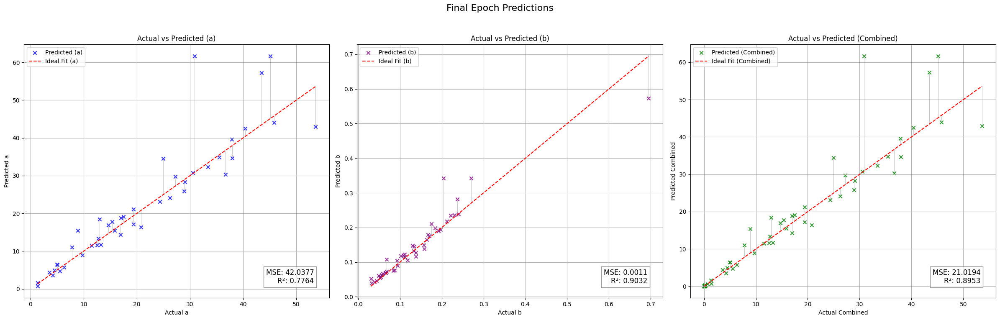

Validation Metrics:
  - MSE: 12.7419
  - R²: 0.8996
  - MAE: 1.3408
  - Explained Variance Score (EVS): 0.9050
Fold 4 Metrics:
  - Validation Loss (MSE): 12.7419
  - R²: 0.8996
  - MAE: 1.3408
  - EVS: 0.9050
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.247]


Validation Metrics:
  - MSE: 33.2136
  - R²: 0.8410
  - MAE: 1.5486
  - Explained Variance Score (EVS): 0.8452
Epoch [1/50], Train Loss: 0.2805, Val Loss: 33.2136
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.61it/s, loss=0.262]


Validation Metrics:
  - MSE: 32.6530
  - R²: 0.8422
  - MAE: 1.5445
  - Explained Variance Score (EVS): 0.8453
Epoch [2/50], Train Loss: 0.2632, Val Loss: 32.6530
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.17it/s, loss=0.257]


Validation Metrics:
  - MSE: 32.4146
  - R²: 0.8409
  - MAE: 1.5623
  - Explained Variance Score (EVS): 0.8440
Epoch [3/50], Train Loss: 0.2631, Val Loss: 32.4146
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.264]


Validation Metrics:
  - MSE: 32.6795
  - R²: 0.8379
  - MAE: 1.5712
  - Explained Variance Score (EVS): 0.8413
Epoch [4/50], Train Loss: 0.2525, Val Loss: 32.6795
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.269]


Validation Metrics:
  - MSE: 32.7388
  - R²: 0.8359
  - MAE: 1.5755
  - Explained Variance Score (EVS): 0.8392
Epoch [5/50], Train Loss: 0.2516, Val Loss: 32.7388
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.243]


Validation Metrics:
  - MSE: 33.0110
  - R²: 0.8347
  - MAE: 1.5752
  - Explained Variance Score (EVS): 0.8385
Epoch [6/50], Train Loss: 0.2523, Val Loss: 33.0110
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.265]


Validation Metrics:
  - MSE: 33.0975
  - R²: 0.8348
  - MAE: 1.5779
  - Explained Variance Score (EVS): 0.8392
Epoch [7/50], Train Loss: 0.2402, Val Loss: 33.0975
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.244]


Validation Metrics:
  - MSE: 33.0472
  - R²: 0.8358
  - MAE: 1.5958
  - Explained Variance Score (EVS): 0.8396
Epoch [8/50], Train Loss: 0.2534, Val Loss: 33.0472
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.268]


Validation Metrics:
  - MSE: 32.9246
  - R²: 0.8360
  - MAE: 1.5964
  - Explained Variance Score (EVS): 0.8399
Epoch [9/50], Train Loss: 0.2531, Val Loss: 32.9246
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.224]


Validation Metrics:
  - MSE: 33.2442
  - R²: 0.8341
  - MAE: 1.6014
  - Explained Variance Score (EVS): 0.8385
Epoch [10/50], Train Loss: 0.2437, Val Loss: 33.2442
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.239]


Validation Metrics:
  - MSE: 33.3375
  - R²: 0.8339
  - MAE: 1.5995
  - Explained Variance Score (EVS): 0.8384
Epoch [11/50], Train Loss: 0.2546, Val Loss: 33.3375
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  6.13it/s, loss=0.252]


Validation Metrics:
  - MSE: 33.3143
  - R²: 0.8339
  - MAE: 1.5972
  - Explained Variance Score (EVS): 0.8384
Epoch [12/50], Train Loss: 0.2487, Val Loss: 33.3143
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.223]


Validation Metrics:
  - MSE: 33.2065
  - R²: 0.8344
  - MAE: 1.5927
  - Explained Variance Score (EVS): 0.8384
Epoch [13/50], Train Loss: 0.2361, Val Loss: 33.2065
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


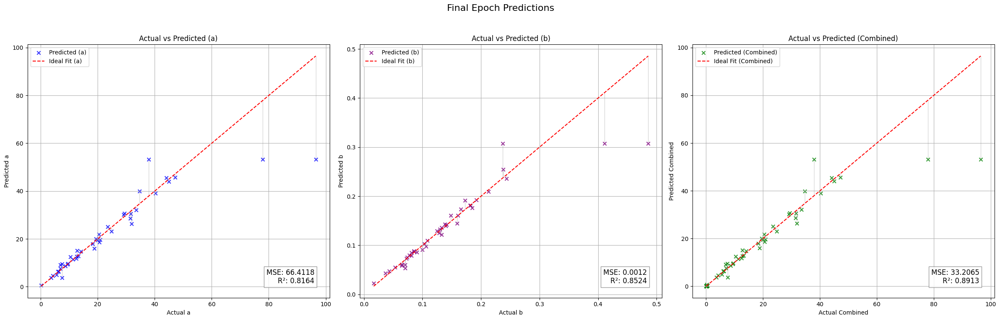

[I 2024-12-01 17:26:13,941] Trial 21 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.4146
  - R²: 0.8409
  - MAE: 1.5623
  - Explained Variance Score (EVS): 0.8440
Fold 5 Metrics:
  - Validation Loss (MSE): 32.4146
  - R²: 0.8409
  - MAE: 1.5623
  - EVS: 0.8440
Avg Validation Metrics:
  - MSE: 25.7293
  - R²: 0.8455
  - MAE: 1.8154
  - EVS: 0.8483
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=1.1]


Validation Metrics:
  - MSE: 193.9223
  - R²: 0.0031
  - MAE: 6.3424
  - Explained Variance Score (EVS): 0.0201
Epoch [1/50], Train Loss: 1.2148, Val Loss: 193.9223
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.982]


Validation Metrics:
  - MSE: 190.2401
  - R²: 0.0255
  - MAE: 6.2455
  - Explained Variance Score (EVS): 0.0440
Epoch [2/50], Train Loss: 1.0510, Val Loss: 190.2401
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=1.01]


Validation Metrics:
  - MSE: 185.8442
  - R²: 0.0474
  - MAE: 6.1620
  - Explained Variance Score (EVS): 0.0682
Epoch [3/50], Train Loss: 1.0274, Val Loss: 185.8442
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.935]


Validation Metrics:
  - MSE: 181.6516
  - R²: 0.0647
  - MAE: 6.0901
  - Explained Variance Score (EVS): 0.0860
Epoch [4/50], Train Loss: 0.9922, Val Loss: 181.6516
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=0.973]


Validation Metrics:
  - MSE: 181.0507
  - R²: 0.0678
  - MAE: 6.0577
  - Explained Variance Score (EVS): 0.0911
Epoch [5/50], Train Loss: 0.9825, Val Loss: 181.0507
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.914]


Validation Metrics:
  - MSE: 181.5789
  - R²: 0.0741
  - MAE: 6.0415
  - Explained Variance Score (EVS): 0.0986
Epoch [6/50], Train Loss: 0.9360, Val Loss: 181.5789
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.94it/s, loss=1.02]


Validation Metrics:
  - MSE: 181.3198
  - R²: 0.0871
  - MAE: 5.9932
  - Explained Variance Score (EVS): 0.1122
Epoch [7/50], Train Loss: 0.9468, Val Loss: 181.3198
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.938]


Validation Metrics:
  - MSE: 176.9350
  - R²: 0.1174
  - MAE: 5.8966
  - Explained Variance Score (EVS): 0.1424
Epoch [8/50], Train Loss: 0.9271, Val Loss: 176.9350
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.862]


Validation Metrics:
  - MSE: 169.5126
  - R²: 0.1575
  - MAE: 5.7854
  - Explained Variance Score (EVS): 0.1814
Epoch [9/50], Train Loss: 0.8960, Val Loss: 169.5126
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.889]


Validation Metrics:
  - MSE: 161.5244
  - R²: 0.2013
  - MAE: 5.6525
  - Explained Variance Score (EVS): 0.2269
Epoch [10/50], Train Loss: 0.8798, Val Loss: 161.5244
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.81]


Validation Metrics:
  - MSE: 153.0690
  - R²: 0.2576
  - MAE: 5.4905
  - Explained Variance Score (EVS): 0.2803
Epoch [11/50], Train Loss: 0.8320, Val Loss: 153.0690
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.32it/s, loss=0.813]


Validation Metrics:
  - MSE: 145.6456
  - R²: 0.2897
  - MAE: 5.2981
  - Explained Variance Score (EVS): 0.3138
Epoch [12/50], Train Loss: 0.8307, Val Loss: 145.6456
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.861]


Validation Metrics:
  - MSE: 137.3265
  - R²: 0.3160
  - MAE: 5.0647
  - Explained Variance Score (EVS): 0.3401
Epoch [13/50], Train Loss: 0.8245, Val Loss: 137.3265
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.743]


Validation Metrics:
  - MSE: 128.0064
  - R²: 0.3538
  - MAE: 4.8303
  - Explained Variance Score (EVS): 0.3761
Epoch [14/50], Train Loss: 0.7954, Val Loss: 128.0064
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.736]


Validation Metrics:
  - MSE: 119.3441
  - R²: 0.4064
  - MAE: 4.6004
  - Explained Variance Score (EVS): 0.4269
Epoch [15/50], Train Loss: 0.7605, Val Loss: 119.3441
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.74]


Validation Metrics:
  - MSE: 109.5546
  - R²: 0.4724
  - MAE: 4.3281
  - Explained Variance Score (EVS): 0.4899
Epoch [16/50], Train Loss: 0.7684, Val Loss: 109.5546
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=0.746]


Validation Metrics:
  - MSE: 103.3793
  - R²: 0.5201
  - MAE: 4.1435
  - Explained Variance Score (EVS): 0.5405
Epoch [17/50], Train Loss: 0.7447, Val Loss: 103.3793
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.706]


Validation Metrics:
  - MSE: 96.6332
  - R²: 0.5630
  - MAE: 4.0469
  - Explained Variance Score (EVS): 0.5862
Epoch [18/50], Train Loss: 0.7233, Val Loss: 96.6332
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.51it/s, loss=0.718]


Validation Metrics:
  - MSE: 95.6771
  - R²: 0.5664
  - MAE: 4.0203
  - Explained Variance Score (EVS): 0.5931
Epoch [19/50], Train Loss: 0.7177, Val Loss: 95.6771
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  4.63it/s, loss=0.672]


Validation Metrics:
  - MSE: 84.5574
  - R²: 0.6109
  - MAE: 3.7527
  - Explained Variance Score (EVS): 0.6286
Epoch [20/50], Train Loss: 0.6937, Val Loss: 84.5574
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.684]


Validation Metrics:
  - MSE: 75.8409
  - R²: 0.6452
  - MAE: 3.5977
  - Explained Variance Score (EVS): 0.6556
Epoch [21/50], Train Loss: 0.6940, Val Loss: 75.8409
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.689]


Validation Metrics:
  - MSE: 70.8577
  - R²: 0.6580
  - MAE: 3.5102
  - Explained Variance Score (EVS): 0.6670
Epoch [22/50], Train Loss: 0.6677, Val Loss: 70.8577
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.23it/s, loss=0.662]


Validation Metrics:
  - MSE: 69.4772
  - R²: 0.6750
  - MAE: 3.4776
  - Explained Variance Score (EVS): 0.6848
Epoch [23/50], Train Loss: 0.6517, Val Loss: 69.4772
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.625]


Validation Metrics:
  - MSE: 65.1317
  - R²: 0.6987
  - MAE: 3.4160
  - Explained Variance Score (EVS): 0.7084
Epoch [24/50], Train Loss: 0.6302, Val Loss: 65.1317
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.61]


Validation Metrics:
  - MSE: 62.2357
  - R²: 0.6984
  - MAE: 3.3517
  - Explained Variance Score (EVS): 0.7130
Epoch [25/50], Train Loss: 0.6073, Val Loss: 62.2357
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.581]


Validation Metrics:
  - MSE: 63.6340
  - R²: 0.6877
  - MAE: 3.3579
  - Explained Variance Score (EVS): 0.7072
Epoch [26/50], Train Loss: 0.5817, Val Loss: 63.6340
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.75it/s, loss=0.616]


Validation Metrics:
  - MSE: 67.9121
  - R²: 0.6749
  - MAE: 3.4199
  - Explained Variance Score (EVS): 0.7034
Epoch [27/50], Train Loss: 0.5843, Val Loss: 67.9121
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.503]


Validation Metrics:
  - MSE: 75.4047
  - R²: 0.6440
  - MAE: 3.3811
  - Explained Variance Score (EVS): 0.6748
Epoch [28/50], Train Loss: 0.5510, Val Loss: 75.4047
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.581]


Validation Metrics:
  - MSE: 74.4472
  - R²: 0.6510
  - MAE: 3.4336
  - Explained Variance Score (EVS): 0.6695
Epoch [29/50], Train Loss: 0.5410, Val Loss: 74.4472
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.489]


Validation Metrics:
  - MSE: 69.2942
  - R²: 0.6681
  - MAE: 3.3351
  - Explained Variance Score (EVS): 0.6808
Epoch [30/50], Train Loss: 0.5155, Val Loss: 69.2942
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.72it/s, loss=0.482]


Validation Metrics:
  - MSE: 63.2291
  - R²: 0.6940
  - MAE: 3.2424
  - Explained Variance Score (EVS): 0.7044
Epoch [31/50], Train Loss: 0.5030, Val Loss: 63.2291
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.505]


Validation Metrics:
  - MSE: 59.6838
  - R²: 0.7139
  - MAE: 3.2639
  - Explained Variance Score (EVS): 0.7252
Epoch [32/50], Train Loss: 0.4823, Val Loss: 59.6838
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.466]


Validation Metrics:
  - MSE: 64.7880
  - R²: 0.6817
  - MAE: 3.3154
  - Explained Variance Score (EVS): 0.7003
Epoch [33/50], Train Loss: 0.4770, Val Loss: 64.7880
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.497]


Validation Metrics:
  - MSE: 69.8462
  - R²: 0.6629
  - MAE: 3.4364
  - Explained Variance Score (EVS): 0.6823
Epoch [34/50], Train Loss: 0.4583, Val Loss: 69.8462
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.70it/s, loss=0.417]


Validation Metrics:
  - MSE: 62.2215
  - R²: 0.7045
  - MAE: 3.3395
  - Explained Variance Score (EVS): 0.7176
Epoch [35/50], Train Loss: 0.4367, Val Loss: 62.2215
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.402]


Validation Metrics:
  - MSE: 55.0687
  - R²: 0.7302
  - MAE: 3.2727
  - Explained Variance Score (EVS): 0.7379
Epoch [36/50], Train Loss: 0.4286, Val Loss: 55.0687
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=0.399]


Validation Metrics:
  - MSE: 59.4341
  - R²: 0.7029
  - MAE: 3.2403
  - Explained Variance Score (EVS): 0.7144
Epoch [37/50], Train Loss: 0.4180, Val Loss: 59.4341
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.378]


Validation Metrics:
  - MSE: 63.0019
  - R²: 0.6925
  - MAE: 3.3028
  - Explained Variance Score (EVS): 0.7052
Epoch [38/50], Train Loss: 0.4051, Val Loss: 63.0019
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.392]


Validation Metrics:
  - MSE: 68.9257
  - R²: 0.6690
  - MAE: 3.4300
  - Explained Variance Score (EVS): 0.6846
Epoch [39/50], Train Loss: 0.3942, Val Loss: 68.9257
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=0.437]


Validation Metrics:
  - MSE: 64.5379
  - R²: 0.6832
  - MAE: 3.3924
  - Explained Variance Score (EVS): 0.6974
Epoch [40/50], Train Loss: 0.3891, Val Loss: 64.5379
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.379]


Validation Metrics:
  - MSE: 63.0547
  - R²: 0.6936
  - MAE: 3.3850
  - Explained Variance Score (EVS): 0.7060
Epoch [41/50], Train Loss: 0.3662, Val Loss: 63.0547
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  5.89it/s, loss=0.342]


Validation Metrics:
  - MSE: 60.9144
  - R²: 0.7030
  - MAE: 3.3487
  - Explained Variance Score (EVS): 0.7124
Epoch [42/50], Train Loss: 0.3591, Val Loss: 60.9144
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.331]


Validation Metrics:
  - MSE: 65.5711
  - R²: 0.6787
  - MAE: 3.4021
  - Explained Variance Score (EVS): 0.6903
Epoch [43/50], Train Loss: 0.3444, Val Loss: 65.5711
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  5.94it/s, loss=0.316]


Validation Metrics:
  - MSE: 66.4294
  - R²: 0.6618
  - MAE: 3.3934
  - Explained Variance Score (EVS): 0.6762
Epoch [44/50], Train Loss: 0.3272, Val Loss: 66.4294
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  6.41it/s, loss=0.372]


Validation Metrics:
  - MSE: 63.9814
  - R²: 0.6599
  - MAE: 3.2696
  - Explained Variance Score (EVS): 0.6745
Epoch [45/50], Train Loss: 0.3314, Val Loss: 63.9814
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s, loss=0.326]


Validation Metrics:
  - MSE: 59.3354
  - R²: 0.6879
  - MAE: 3.1443
  - Explained Variance Score (EVS): 0.7007
Epoch [46/50], Train Loss: 0.3122, Val Loss: 59.3354
Current Dropout Rate: 0.1400
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


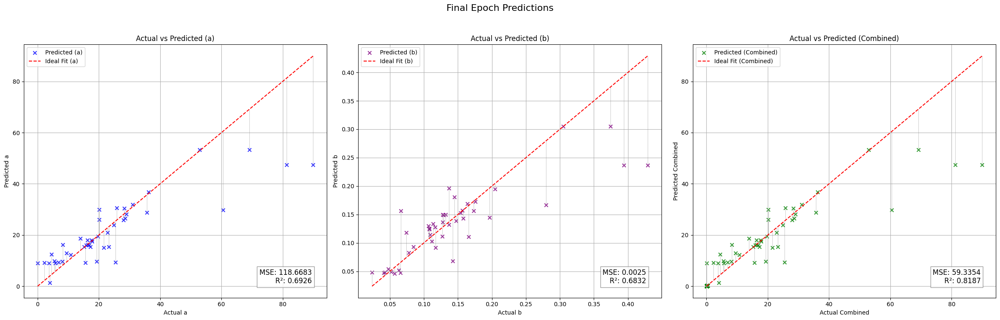

Validation Metrics:
  - MSE: 55.0687
  - R²: 0.7302
  - MAE: 3.2727
  - Explained Variance Score (EVS): 0.7379
Fold 1 Metrics:
  - Validation Loss (MSE): 55.0687
  - R²: 0.7302
  - MAE: 3.2727
  - EVS: 0.7379
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=0.411]


Validation Metrics:
  - MSE: 1.3949
  - R²: 0.9764
  - MAE: 0.6426
  - Explained Variance Score (EVS): 0.9772
Epoch [1/50], Train Loss: 0.4644, Val Loss: 1.3949
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.421]


Validation Metrics:
  - MSE: 1.9135
  - R²: 0.9681
  - MAE: 0.7488
  - Explained Variance Score (EVS): 0.9682
Epoch [2/50], Train Loss: 0.4421, Val Loss: 1.9135
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.06it/s, loss=0.513]


Validation Metrics:
  - MSE: 2.8924
  - R²: 0.9546
  - MAE: 0.9129
  - Explained Variance Score (EVS): 0.9556
Epoch [3/50], Train Loss: 0.4549, Val Loss: 2.8924
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.476]


Validation Metrics:
  - MSE: 3.1751
  - R²: 0.9419
  - MAE: 0.9627
  - Explained Variance Score (EVS): 0.9442
Epoch [4/50], Train Loss: 0.4328, Val Loss: 3.1751
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=0.366]


Validation Metrics:
  - MSE: 3.6390
  - R²: 0.9288
  - MAE: 1.0198
  - Explained Variance Score (EVS): 0.9326
Epoch [5/50], Train Loss: 0.4106, Val Loss: 3.6390
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=0.368]


Validation Metrics:
  - MSE: 4.1874
  - R²: 0.9268
  - MAE: 1.0806
  - Explained Variance Score (EVS): 0.9336
Epoch [6/50], Train Loss: 0.4028, Val Loss: 4.1874
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.61it/s, loss=0.405]


Validation Metrics:
  - MSE: 4.4966
  - R²: 0.9330
  - MAE: 1.1698
  - Explained Variance Score (EVS): 0.9380
Epoch [7/50], Train Loss: 0.4108, Val Loss: 4.4966
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.72it/s, loss=0.403]


Validation Metrics:
  - MSE: 4.7443
  - R²: 0.9395
  - MAE: 1.2801
  - Explained Variance Score (EVS): 0.9419
Epoch [8/50], Train Loss: 0.3942, Val Loss: 4.7443
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=0.344]


Validation Metrics:
  - MSE: 5.0615
  - R²: 0.9383
  - MAE: 1.2927
  - Explained Variance Score (EVS): 0.9398
Epoch [9/50], Train Loss: 0.3730, Val Loss: 5.0615
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.371]


Validation Metrics:
  - MSE: 6.0249
  - R²: 0.9273
  - MAE: 1.2983
  - Explained Variance Score (EVS): 0.9277
Epoch [10/50], Train Loss: 0.3689, Val Loss: 6.0249
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.23it/s, loss=0.405]


Validation Metrics:
  - MSE: 6.4445
  - R²: 0.9213
  - MAE: 1.2900
  - Explained Variance Score (EVS): 0.9228
Epoch [11/50], Train Loss: 0.3809, Val Loss: 6.4445
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


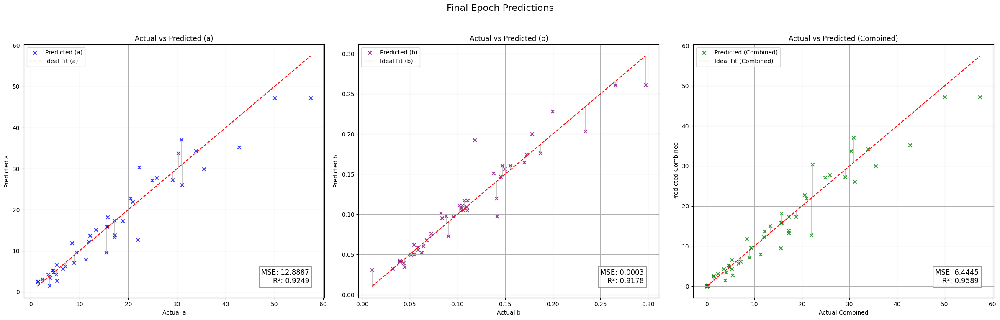

Validation Metrics:
  - MSE: 1.3949
  - R²: 0.9764
  - MAE: 0.6426
  - Explained Variance Score (EVS): 0.9772
Fold 2 Metrics:
  - Validation Loss (MSE): 1.3949
  - R²: 0.9764
  - MAE: 0.6426
  - EVS: 0.9772
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.451]


Validation Metrics:
  - MSE: 13.6273
  - R²: 0.8897
  - MAE: 1.2853
  - Explained Variance Score (EVS): 0.8900
Epoch [1/50], Train Loss: 0.4421, Val Loss: 13.6273
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.42]


Validation Metrics:
  - MSE: 13.7998
  - R²: 0.8849
  - MAE: 1.2942
  - Explained Variance Score (EVS): 0.8862
Epoch [2/50], Train Loss: 0.4363, Val Loss: 13.7998
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.408]


Validation Metrics:
  - MSE: 14.1499
  - R²: 0.8753
  - MAE: 1.2836
  - Explained Variance Score (EVS): 0.8782
Epoch [3/50], Train Loss: 0.4308, Val Loss: 14.1499
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=0.438]


Validation Metrics:
  - MSE: 14.4989
  - R²: 0.8659
  - MAE: 1.2829
  - Explained Variance Score (EVS): 0.8686
Epoch [4/50], Train Loss: 0.4268, Val Loss: 14.4989
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.4]


Validation Metrics:
  - MSE: 15.1302
  - R²: 0.8536
  - MAE: 1.3125
  - Explained Variance Score (EVS): 0.8577
Epoch [5/50], Train Loss: 0.4326, Val Loss: 15.1302
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.435]


Validation Metrics:
  - MSE: 15.3141
  - R²: 0.8465
  - MAE: 1.3277
  - Explained Variance Score (EVS): 0.8506
Epoch [6/50], Train Loss: 0.4112, Val Loss: 15.3141
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.53it/s, loss=0.402]


Validation Metrics:
  - MSE: 15.4569
  - R²: 0.8495
  - MAE: 1.3482
  - Explained Variance Score (EVS): 0.8515
Epoch [7/50], Train Loss: 0.4076, Val Loss: 15.4569
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.433]


Validation Metrics:
  - MSE: 15.7010
  - R²: 0.8566
  - MAE: 1.3613
  - Explained Variance Score (EVS): 0.8570
Epoch [8/50], Train Loss: 0.4119, Val Loss: 15.7010
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s, loss=0.378]


Validation Metrics:
  - MSE: 15.6019
  - R²: 0.8619
  - MAE: 1.3627
  - Explained Variance Score (EVS): 0.8622
Epoch [9/50], Train Loss: 0.3908, Val Loss: 15.6019
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.27it/s, loss=0.353]


Validation Metrics:
  - MSE: 15.8400
  - R²: 0.8605
  - MAE: 1.3716
  - Explained Variance Score (EVS): 0.8610
Epoch [10/50], Train Loss: 0.3847, Val Loss: 15.8400
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.376]


Validation Metrics:
  - MSE: 16.3558
  - R²: 0.8559
  - MAE: 1.3691
  - Explained Variance Score (EVS): 0.8572
Epoch [11/50], Train Loss: 0.3915, Val Loss: 16.3558
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


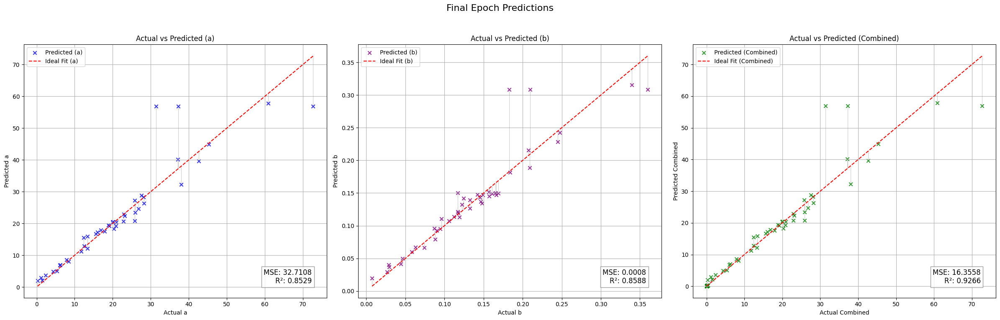

Validation Metrics:
  - MSE: 13.6273
  - R²: 0.8897
  - MAE: 1.2853
  - Explained Variance Score (EVS): 0.8900
Fold 3 Metrics:
  - Validation Loss (MSE): 13.6273
  - R²: 0.8897
  - MAE: 1.2853
  - EVS: 0.8900
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.60it/s, loss=0.448]


Validation Metrics:
  - MSE: 16.9236
  - R²: 0.8046
  - MAE: 1.3960
  - Explained Variance Score (EVS): 0.8094
Epoch [1/50], Train Loss: 0.4312, Val Loss: 16.9236
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.449]


Validation Metrics:
  - MSE: 17.1679
  - R²: 0.8014
  - MAE: 1.3806
  - Explained Variance Score (EVS): 0.8063
Epoch [2/50], Train Loss: 0.4481, Val Loss: 17.1679
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=0.422]


Validation Metrics:
  - MSE: 18.2978
  - R²: 0.7916
  - MAE: 1.3991
  - Explained Variance Score (EVS): 0.7971
Epoch [3/50], Train Loss: 0.4333, Val Loss: 18.2978
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.402]


Validation Metrics:
  - MSE: 19.6916
  - R²: 0.7802
  - MAE: 1.4143
  - Explained Variance Score (EVS): 0.7864
Epoch [4/50], Train Loss: 0.4182, Val Loss: 19.6916
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  6.25it/s, loss=0.415]


Validation Metrics:
  - MSE: 20.4350
  - R²: 0.7710
  - MAE: 1.4167
  - Explained Variance Score (EVS): 0.7769
Epoch [5/50], Train Loss: 0.4247, Val Loss: 20.4350
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.437]


Validation Metrics:
  - MSE: 21.3404
  - R²: 0.7622
  - MAE: 1.4304
  - Explained Variance Score (EVS): 0.7680
Epoch [6/50], Train Loss: 0.4110, Val Loss: 21.3404
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s, loss=0.393]


Validation Metrics:
  - MSE: 23.3380
  - R²: 0.7464
  - MAE: 1.4729
  - Explained Variance Score (EVS): 0.7534
Epoch [7/50], Train Loss: 0.4133, Val Loss: 23.3380
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s, loss=0.412]


Validation Metrics:
  - MSE: 23.1711
  - R²: 0.7428
  - MAE: 1.4348
  - Explained Variance Score (EVS): 0.7486
Epoch [8/50], Train Loss: 0.4067, Val Loss: 23.1711
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.405]


Validation Metrics:
  - MSE: 23.6950
  - R²: 0.7365
  - MAE: 1.4367
  - Explained Variance Score (EVS): 0.7427
Epoch [9/50], Train Loss: 0.4073, Val Loss: 23.6950
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.421]


Validation Metrics:
  - MSE: 23.2112
  - R²: 0.7393
  - MAE: 1.4407
  - Explained Variance Score (EVS): 0.7445
Epoch [10/50], Train Loss: 0.4041, Val Loss: 23.2112
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.402]


Validation Metrics:
  - MSE: 21.9005
  - R²: 0.7483
  - MAE: 1.4393
  - Explained Variance Score (EVS): 0.7517
Epoch [11/50], Train Loss: 0.3968, Val Loss: 21.9005
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


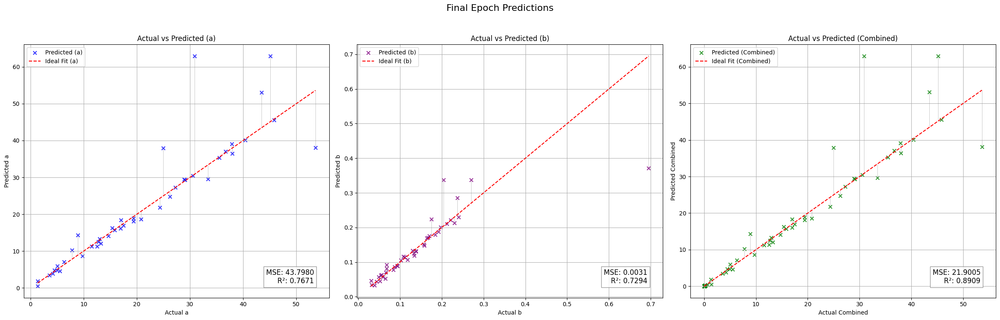

Validation Metrics:
  - MSE: 16.9236
  - R²: 0.8046
  - MAE: 1.3960
  - Explained Variance Score (EVS): 0.8094
Fold 4 Metrics:
  - Validation Loss (MSE): 16.9236
  - R²: 0.8046
  - MAE: 1.3960
  - EVS: 0.8094
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.419]


Validation Metrics:
  - MSE: 30.5334
  - R²: 0.8368
  - MAE: 1.5737
  - Explained Variance Score (EVS): 0.8448
Epoch [1/50], Train Loss: 0.4360, Val Loss: 30.5334
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.464]


Validation Metrics:
  - MSE: 30.4584
  - R²: 0.8367
  - MAE: 1.5582
  - Explained Variance Score (EVS): 0.8439
Epoch [2/50], Train Loss: 0.4431, Val Loss: 30.4584
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.46]


Validation Metrics:
  - MSE: 31.4114
  - R²: 0.8301
  - MAE: 1.6040
  - Explained Variance Score (EVS): 0.8396
Epoch [3/50], Train Loss: 0.4365, Val Loss: 31.4114
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.423]


Validation Metrics:
  - MSE: 31.8544
  - R²: 0.8280
  - MAE: 1.6153
  - Explained Variance Score (EVS): 0.8377
Epoch [4/50], Train Loss: 0.4318, Val Loss: 31.8544
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.497]


Validation Metrics:
  - MSE: 32.8744
  - R²: 0.8239
  - MAE: 1.6581
  - Explained Variance Score (EVS): 0.8355
Epoch [5/50], Train Loss: 0.4573, Val Loss: 32.8744
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.419]


Validation Metrics:
  - MSE: 33.0515
  - R²: 0.8234
  - MAE: 1.6754
  - Explained Variance Score (EVS): 0.8356
Epoch [6/50], Train Loss: 0.4228, Val Loss: 33.0515
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=0.385]


Validation Metrics:
  - MSE: 32.5846
  - R²: 0.8275
  - MAE: 1.6579
  - Explained Variance Score (EVS): 0.8389
Epoch [7/50], Train Loss: 0.4249, Val Loss: 32.5846
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.472]


Validation Metrics:
  - MSE: 32.9095
  - R²: 0.8269
  - MAE: 1.6334
  - Explained Variance Score (EVS): 0.8378
Epoch [8/50], Train Loss: 0.4172, Val Loss: 32.9095
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.422]


Validation Metrics:
  - MSE: 32.9694
  - R²: 0.8273
  - MAE: 1.6454
  - Explained Variance Score (EVS): 0.8390
Epoch [9/50], Train Loss: 0.4269, Val Loss: 32.9694
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s, loss=0.392]


Validation Metrics:
  - MSE: 33.7633
  - R²: 0.8241
  - MAE: 1.6885
  - Explained Variance Score (EVS): 0.8369
Epoch [10/50], Train Loss: 0.4189, Val Loss: 33.7633
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.405]


Validation Metrics:
  - MSE: 33.5606
  - R²: 0.8261
  - MAE: 1.6956
  - Explained Variance Score (EVS): 0.8392
Epoch [11/50], Train Loss: 0.4085, Val Loss: 33.5606
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.447]


Validation Metrics:
  - MSE: 32.9178
  - R²: 0.8293
  - MAE: 1.6347
  - Explained Variance Score (EVS): 0.8407
Epoch [12/50], Train Loss: 0.4035, Val Loss: 32.9178
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


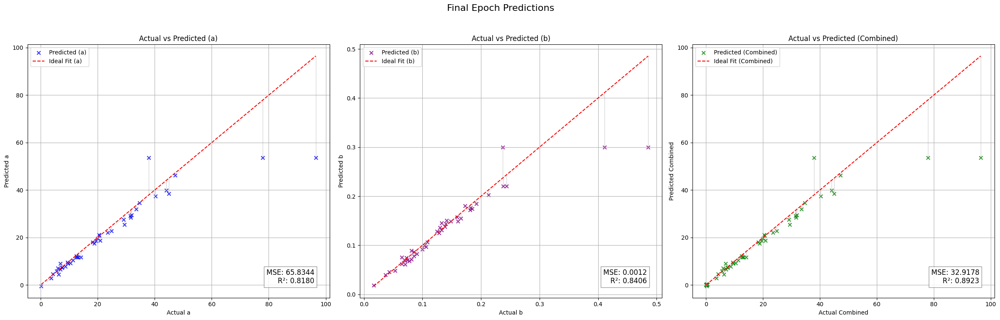

[I 2024-12-01 17:28:07,420] Trial 22 finished with value: 23.49456787109375 and parameters: {'num_layers': 2, 'hidden_size_0': 251, 'activation_0': 'ELU', 'dropout_0': 0.448709219986567, 'hidden_size_1': 235, 'activation_1': 'ReLU', 'dropout_1': 0.16679581410899538, 'batch_size': 64, 'learning_rate': 0.000327356670395204, 'optimizer': 'AdamW'}. Best is trial 14 with value: 22.338119506835938.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 30.4584
  - R²: 0.8367
  - MAE: 1.5582
  - Explained Variance Score (EVS): 0.8439
Fold 5 Metrics:
  - Validation Loss (MSE): 30.4584
  - R²: 0.8367
  - MAE: 1.5582
  - EVS: 0.8439
Avg Validation Metrics:
  - MSE: 23.4946
  - R²: 0.8475
  - MAE: 1.6310
  - EVS: 0.8517
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=1.29]


Validation Metrics:
  - MSE: 187.3605
  - R²: 0.0297
  - MAE: 6.3578
  - Explained Variance Score (EVS): 0.0453
Epoch [1/50], Train Loss: 1.4253, Val Loss: 187.3605
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=1.31]


Validation Metrics:
  - MSE: 183.0542
  - R²: 0.0475
  - MAE: 6.3022
  - Explained Variance Score (EVS): 0.0646
Epoch [2/50], Train Loss: 1.3041, Val Loss: 183.0542
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=1.23]


Validation Metrics:
  - MSE: 181.9971
  - R²: 0.0502
  - MAE: 6.2802
  - Explained Variance Score (EVS): 0.0685
Epoch [3/50], Train Loss: 1.2804, Val Loss: 181.9971
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.13it/s, loss=1.27]


Validation Metrics:
  - MSE: 184.4765
  - R²: 0.0447
  - MAE: 6.2833
  - Explained Variance Score (EVS): 0.0639
Epoch [4/50], Train Loss: 1.2258, Val Loss: 184.4765
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=1.13]


Validation Metrics:
  - MSE: 182.3144
  - R²: 0.0584
  - MAE: 6.2249
  - Explained Variance Score (EVS): 0.0759
Epoch [5/50], Train Loss: 1.1573, Val Loss: 182.3144
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=1.16]


Validation Metrics:
  - MSE: 177.7551
  - R²: 0.0888
  - MAE: 6.1235
  - Explained Variance Score (EVS): 0.1049
Epoch [6/50], Train Loss: 1.1411, Val Loss: 177.7551
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=1.09]


Validation Metrics:
  - MSE: 173.2675
  - R²: 0.1169
  - MAE: 6.0101
  - Explained Variance Score (EVS): 0.1335
Epoch [7/50], Train Loss: 1.1183, Val Loss: 173.2675
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  6.01it/s, loss=1.13]


Validation Metrics:
  - MSE: 168.7516
  - R²: 0.1293
  - MAE: 5.9087
  - Explained Variance Score (EVS): 0.1490
Epoch [8/50], Train Loss: 1.1307, Val Loss: 168.7516
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=1.03]


Validation Metrics:
  - MSE: 164.0217
  - R²: 0.1478
  - MAE: 5.8424
  - Explained Variance Score (EVS): 0.1668
Epoch [9/50], Train Loss: 1.0818, Val Loss: 164.0217
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.41it/s, loss=1.16]


Validation Metrics:
  - MSE: 162.4925
  - R²: 0.1623
  - MAE: 5.7719
  - Explained Variance Score (EVS): 0.1821
Epoch [10/50], Train Loss: 1.0653, Val Loss: 162.4925
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=1.03]


Validation Metrics:
  - MSE: 158.1891
  - R²: 0.1989
  - MAE: 5.6704
  - Explained Variance Score (EVS): 0.2168
Epoch [11/50], Train Loss: 1.0337, Val Loss: 158.1891
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.957]


Validation Metrics:
  - MSE: 148.6547
  - R²: 0.2524
  - MAE: 5.4540
  - Explained Variance Score (EVS): 0.2653
Epoch [12/50], Train Loss: 1.0088, Val Loss: 148.6547
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.949]


Validation Metrics:
  - MSE: 136.7680
  - R²: 0.3087
  - MAE: 5.2409
  - Explained Variance Score (EVS): 0.3191
Epoch [13/50], Train Loss: 0.9948, Val Loss: 136.7680
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.94]


Validation Metrics:
  - MSE: 127.8758
  - R²: 0.3473
  - MAE: 5.1365
  - Explained Variance Score (EVS): 0.3602
Epoch [14/50], Train Loss: 0.9563, Val Loss: 127.8758
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=0.905]


Validation Metrics:
  - MSE: 120.0488
  - R²: 0.3773
  - MAE: 4.9861
  - Explained Variance Score (EVS): 0.3941
Epoch [15/50], Train Loss: 0.9302, Val Loss: 120.0488
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.898]


Validation Metrics:
  - MSE: 112.1453
  - R²: 0.4182
  - MAE: 4.6636
  - Explained Variance Score (EVS): 0.4316
Epoch [16/50], Train Loss: 0.9072, Val Loss: 112.1453
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.865]


Validation Metrics:
  - MSE: 107.1994
  - R²: 0.4727
  - MAE: 4.4416
  - Explained Variance Score (EVS): 0.4791
Epoch [17/50], Train Loss: 0.8843, Val Loss: 107.1994
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.09it/s, loss=0.866]


Validation Metrics:
  - MSE: 101.0040
  - R²: 0.5242
  - MAE: 4.2921
  - Explained Variance Score (EVS): 0.5272
Epoch [18/50], Train Loss: 0.8551, Val Loss: 101.0040
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.64it/s, loss=0.818]


Validation Metrics:
  - MSE: 92.6318
  - R²: 0.5494
  - MAE: 4.1073
  - Explained Variance Score (EVS): 0.5580
Epoch [19/50], Train Loss: 0.8306, Val Loss: 92.6318
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.811]


Validation Metrics:
  - MSE: 83.7063
  - R²: 0.5753
  - MAE: 4.0442
  - Explained Variance Score (EVS): 0.5887
Epoch [20/50], Train Loss: 0.8020, Val Loss: 83.7063
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.832]


Validation Metrics:
  - MSE: 79.6469
  - R²: 0.5964
  - MAE: 3.9427
  - Explained Variance Score (EVS): 0.6100
Epoch [21/50], Train Loss: 0.7886, Val Loss: 79.6469
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s, loss=0.801]


Validation Metrics:
  - MSE: 76.1945
  - R²: 0.6209
  - MAE: 3.8174
  - Explained Variance Score (EVS): 0.6326
Epoch [22/50], Train Loss: 0.7642, Val Loss: 76.1945
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  6.10it/s, loss=0.687]


Validation Metrics:
  - MSE: 67.6849
  - R²: 0.6755
  - MAE: 3.6249
  - Explained Variance Score (EVS): 0.6791
Epoch [23/50], Train Loss: 0.7188, Val Loss: 67.6849
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.654]


Validation Metrics:
  - MSE: 66.1791
  - R²: 0.6894
  - MAE: 3.5321
  - Explained Variance Score (EVS): 0.6912
Epoch [24/50], Train Loss: 0.6911, Val Loss: 66.1791
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.703]


Validation Metrics:
  - MSE: 65.5550
  - R²: 0.6899
  - MAE: 3.3718
  - Explained Variance Score (EVS): 0.6939
Epoch [25/50], Train Loss: 0.6754, Val Loss: 65.5550
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.67]


Validation Metrics:
  - MSE: 60.2981
  - R²: 0.7020
  - MAE: 3.3130
  - Explained Variance Score (EVS): 0.7046
Epoch [26/50], Train Loss: 0.6459, Val Loss: 60.2981
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.602]


Validation Metrics:
  - MSE: 61.3228
  - R²: 0.6781
  - MAE: 3.3339
  - Explained Variance Score (EVS): 0.6903
Epoch [27/50], Train Loss: 0.6129, Val Loss: 61.3228
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.81it/s, loss=0.539]


Validation Metrics:
  - MSE: 57.1543
  - R²: 0.6831
  - MAE: 3.2789
  - Explained Variance Score (EVS): 0.6985
Epoch [28/50], Train Loss: 0.5783, Val Loss: 57.1543
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.75it/s, loss=0.608]


Validation Metrics:
  - MSE: 60.1863
  - R²: 0.6826
  - MAE: 3.2882
  - Explained Variance Score (EVS): 0.6972
Epoch [29/50], Train Loss: 0.5700, Val Loss: 60.1863
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.522]


Validation Metrics:
  - MSE: 60.0788
  - R²: 0.7065
  - MAE: 3.2727
  - Explained Variance Score (EVS): 0.7119
Epoch [30/50], Train Loss: 0.5252, Val Loss: 60.0788
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.506]


Validation Metrics:
  - MSE: 59.6480
  - R²: 0.7189
  - MAE: 3.3003
  - Explained Variance Score (EVS): 0.7216
Epoch [31/50], Train Loss: 0.5141, Val Loss: 59.6480
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  4.74it/s, loss=0.447]


Validation Metrics:
  - MSE: 59.8443
  - R²: 0.7042
  - MAE: 3.3137
  - Explained Variance Score (EVS): 0.7099
Epoch [32/50], Train Loss: 0.4784, Val Loss: 59.8443
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.441]


Validation Metrics:
  - MSE: 62.9519
  - R²: 0.6631
  - MAE: 3.3912
  - Explained Variance Score (EVS): 0.6786
Epoch [33/50], Train Loss: 0.4524, Val Loss: 62.9519
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.435]


Validation Metrics:
  - MSE: 61.6581
  - R²: 0.6742
  - MAE: 3.3962
  - Explained Variance Score (EVS): 0.6884
Epoch [34/50], Train Loss: 0.4320, Val Loss: 61.6581
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.407]


Validation Metrics:
  - MSE: 60.1889
  - R²: 0.7017
  - MAE: 3.4256
  - Explained Variance Score (EVS): 0.7086
Epoch [35/50], Train Loss: 0.4158, Val Loss: 60.1889
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.385]


Validation Metrics:
  - MSE: 60.6182
  - R²: 0.6984
  - MAE: 3.3527
  - Explained Variance Score (EVS): 0.7047
Epoch [36/50], Train Loss: 0.3948, Val Loss: 60.6182
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.347]


Validation Metrics:
  - MSE: 64.0036
  - R²: 0.6780
  - MAE: 3.4060
  - Explained Variance Score (EVS): 0.6891
Epoch [37/50], Train Loss: 0.3689, Val Loss: 64.0036
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.358]


Validation Metrics:
  - MSE: 60.6355
  - R²: 0.6959
  - MAE: 3.3069
  - Explained Variance Score (EVS): 0.7052
Epoch [38/50], Train Loss: 0.3487, Val Loss: 60.6355
Current Dropout Rate: 0.2040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


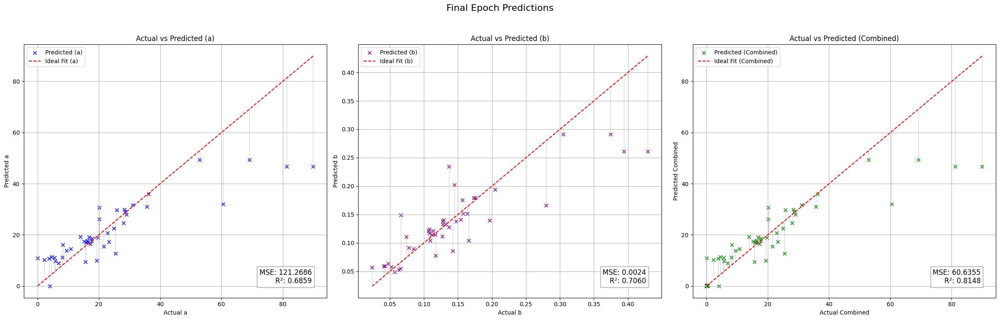

Validation Metrics:
  - MSE: 57.1543
  - R²: 0.6831
  - MAE: 3.2789
  - Explained Variance Score (EVS): 0.6985
Fold 1 Metrics:
  - Validation Loss (MSE): 57.1543
  - R²: 0.6831
  - MAE: 3.2789
  - EVS: 0.6985
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.67]


Validation Metrics:
  - MSE: 4.9055
  - R²: 0.9502
  - MAE: 1.1301
  - Explained Variance Score (EVS): 0.9554
Epoch [1/50], Train Loss: 0.6328, Val Loss: 4.9055
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.55]


Validation Metrics:
  - MSE: 6.7879
  - R²: 0.9277
  - MAE: 1.2754
  - Explained Variance Score (EVS): 0.9439
Epoch [2/50], Train Loss: 0.5765, Val Loss: 6.7879
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.567]


Validation Metrics:
  - MSE: 8.4502
  - R²: 0.9105
  - MAE: 1.4293
  - Explained Variance Score (EVS): 0.9317
Epoch [3/50], Train Loss: 0.5580, Val Loss: 8.4502
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.558]


Validation Metrics:
  - MSE: 9.5291
  - R²: 0.9098
  - MAE: 1.5015
  - Explained Variance Score (EVS): 0.9211
Epoch [4/50], Train Loss: 0.5395, Val Loss: 9.5291
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.92it/s, loss=0.499]


Validation Metrics:
  - MSE: 9.3833
  - R²: 0.9185
  - MAE: 1.5519
  - Explained Variance Score (EVS): 0.9189
Epoch [5/50], Train Loss: 0.5364, Val Loss: 9.3833
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.497]


Validation Metrics:
  - MSE: 9.2831
  - R²: 0.9164
  - MAE: 1.5634
  - Explained Variance Score (EVS): 0.9172
Epoch [6/50], Train Loss: 0.4984, Val Loss: 9.2831
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.492]


Validation Metrics:
  - MSE: 9.4255
  - R²: 0.8996
  - MAE: 1.5654
  - Explained Variance Score (EVS): 0.9080
Epoch [7/50], Train Loss: 0.4829, Val Loss: 9.4255
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.447]


Validation Metrics:
  - MSE: 9.6472
  - R²: 0.8914
  - MAE: 1.5948
  - Explained Variance Score (EVS): 0.9026
Epoch [8/50], Train Loss: 0.4606, Val Loss: 9.6472
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.433]


Validation Metrics:
  - MSE: 10.6178
  - R²: 0.8872
  - MAE: 1.6404
  - Explained Variance Score (EVS): 0.8997
Epoch [9/50], Train Loss: 0.4346, Val Loss: 10.6178
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.72it/s, loss=0.436]


Validation Metrics:
  - MSE: 11.1503
  - R²: 0.8756
  - MAE: 1.6946
  - Explained Variance Score (EVS): 0.8919
Epoch [10/50], Train Loss: 0.4331, Val Loss: 11.1503
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=0.429]


Validation Metrics:
  - MSE: 9.1623
  - R²: 0.8820
  - MAE: 1.5416
  - Explained Variance Score (EVS): 0.8897
Epoch [11/50], Train Loss: 0.4169, Val Loss: 9.1623
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


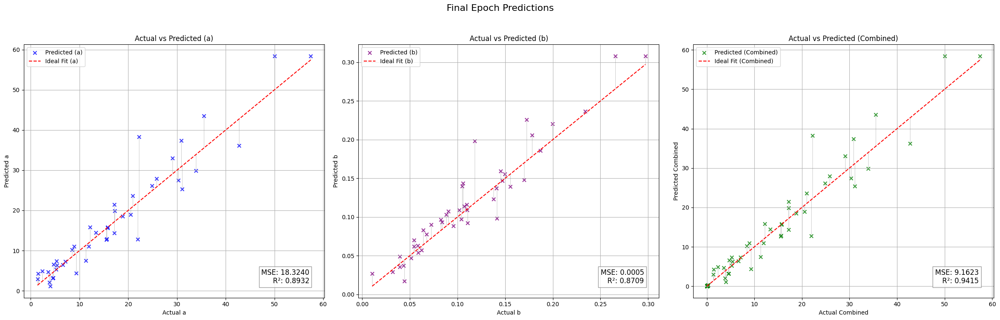

Validation Metrics:
  - MSE: 4.9055
  - R²: 0.9502
  - MAE: 1.1301
  - Explained Variance Score (EVS): 0.9554
Fold 2 Metrics:
  - Validation Loss (MSE): 4.9055
  - R²: 0.9502
  - MAE: 1.1301
  - EVS: 0.9554
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.591]


Validation Metrics:
  - MSE: 13.7720
  - R²: 0.8848
  - MAE: 1.2485
  - Explained Variance Score (EVS): 0.8851
Epoch [1/50], Train Loss: 0.5805, Val Loss: 13.7720
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.34it/s, loss=0.566]


Validation Metrics:
  - MSE: 14.4575
  - R²: 0.8803
  - MAE: 1.3177
  - Explained Variance Score (EVS): 0.8805
Epoch [2/50], Train Loss: 0.5714, Val Loss: 14.4575
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.588]


Validation Metrics:
  - MSE: 14.3050
  - R²: 0.8770
  - MAE: 1.3350
  - Explained Variance Score (EVS): 0.8770
Epoch [3/50], Train Loss: 0.5536, Val Loss: 14.3050
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=0.53]


Validation Metrics:
  - MSE: 14.7675
  - R²: 0.8660
  - MAE: 1.3474
  - Explained Variance Score (EVS): 0.8661
Epoch [4/50], Train Loss: 0.5280, Val Loss: 14.7675
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.502]


Validation Metrics:
  - MSE: 15.5228
  - R²: 0.8539
  - MAE: 1.3573
  - Explained Variance Score (EVS): 0.8540
Epoch [5/50], Train Loss: 0.5167, Val Loss: 15.5228
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s, loss=0.497]


Validation Metrics:
  - MSE: 16.3008
  - R²: 0.8552
  - MAE: 1.3949
  - Explained Variance Score (EVS): 0.8570
Epoch [6/50], Train Loss: 0.5061, Val Loss: 16.3008
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.08it/s, loss=0.467]


Validation Metrics:
  - MSE: 17.0539
  - R²: 0.8568
  - MAE: 1.4468
  - Explained Variance Score (EVS): 0.8610
Epoch [7/50], Train Loss: 0.4987, Val Loss: 17.0539
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s, loss=0.475]


Validation Metrics:
  - MSE: 16.7023
  - R²: 0.8615
  - MAE: 1.4374
  - Explained Variance Score (EVS): 0.8662
Epoch [8/50], Train Loss: 0.4889, Val Loss: 16.7023
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  6.04it/s, loss=0.452]


Validation Metrics:
  - MSE: 16.3451
  - R²: 0.8648
  - MAE: 1.3799
  - Explained Variance Score (EVS): 0.8677
Epoch [9/50], Train Loss: 0.4703, Val Loss: 16.3451
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.48it/s, loss=0.437]


Validation Metrics:
  - MSE: 17.0148
  - R²: 0.8642
  - MAE: 1.4147
  - Explained Variance Score (EVS): 0.8650
Epoch [10/50], Train Loss: 0.4637, Val Loss: 17.0148
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.443]


Validation Metrics:
  - MSE: 18.1907
  - R²: 0.8575
  - MAE: 1.4659
  - Explained Variance Score (EVS): 0.8592
Epoch [11/50], Train Loss: 0.4626, Val Loss: 18.1907
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


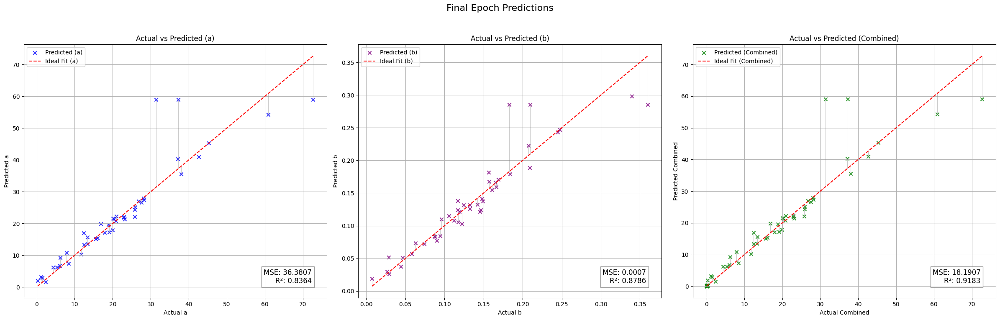

Validation Metrics:
  - MSE: 13.7720
  - R²: 0.8848
  - MAE: 1.2485
  - Explained Variance Score (EVS): 0.8851
Fold 3 Metrics:
  - Validation Loss (MSE): 13.7720
  - R²: 0.8848
  - MAE: 1.2485
  - EVS: 0.8851
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.577]


Validation Metrics:
  - MSE: 14.8472
  - R²: 0.8619
  - MAE: 1.3262
  - Explained Variance Score (EVS): 0.8665
Epoch [1/50], Train Loss: 0.5723, Val Loss: 14.8472
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.556]


Validation Metrics:
  - MSE: 17.4192
  - R²: 0.8471
  - MAE: 1.4354
  - Explained Variance Score (EVS): 0.8531
Epoch [2/50], Train Loss: 0.5667, Val Loss: 17.4192
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  6.03it/s, loss=0.592]


Validation Metrics:
  - MSE: 17.4994
  - R²: 0.8443
  - MAE: 1.4432
  - Explained Variance Score (EVS): 0.8485
Epoch [3/50], Train Loss: 0.5734, Val Loss: 17.4994
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.611]


Validation Metrics:
  - MSE: 18.7053
  - R²: 0.8345
  - MAE: 1.4968
  - Explained Variance Score (EVS): 0.8395
Epoch [4/50], Train Loss: 0.5632, Val Loss: 18.7053
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.522]


Validation Metrics:
  - MSE: 18.7645
  - R²: 0.8314
  - MAE: 1.5212
  - Explained Variance Score (EVS): 0.8360
Epoch [5/50], Train Loss: 0.5416, Val Loss: 18.7645
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.493]


Validation Metrics:
  - MSE: 19.2837
  - R²: 0.8245
  - MAE: 1.5505
  - Explained Variance Score (EVS): 0.8292
Epoch [6/50], Train Loss: 0.5278, Val Loss: 19.2837
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  6.00it/s, loss=0.555]


Validation Metrics:
  - MSE: 18.7708
  - R²: 0.8239
  - MAE: 1.5560
  - Explained Variance Score (EVS): 0.8263
Epoch [7/50], Train Loss: 0.5274, Val Loss: 18.7708
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.465]


Validation Metrics:
  - MSE: 18.9580
  - R²: 0.8195
  - MAE: 1.5499
  - Explained Variance Score (EVS): 0.8226
Epoch [8/50], Train Loss: 0.5092, Val Loss: 18.9580
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.96it/s, loss=0.483]


Validation Metrics:
  - MSE: 18.8798
  - R²: 0.8186
  - MAE: 1.5480
  - Explained Variance Score (EVS): 0.8227
Epoch [9/50], Train Loss: 0.5136, Val Loss: 18.8798
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.646]


Validation Metrics:
  - MSE: 17.6863
  - R²: 0.8273
  - MAE: 1.5329
  - Explained Variance Score (EVS): 0.8300
Epoch [10/50], Train Loss: 0.5310, Val Loss: 17.6863
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.47]


Validation Metrics:
  - MSE: 17.4888
  - R²: 0.8277
  - MAE: 1.5278
  - Explained Variance Score (EVS): 0.8305
Epoch [11/50], Train Loss: 0.4857, Val Loss: 17.4888
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


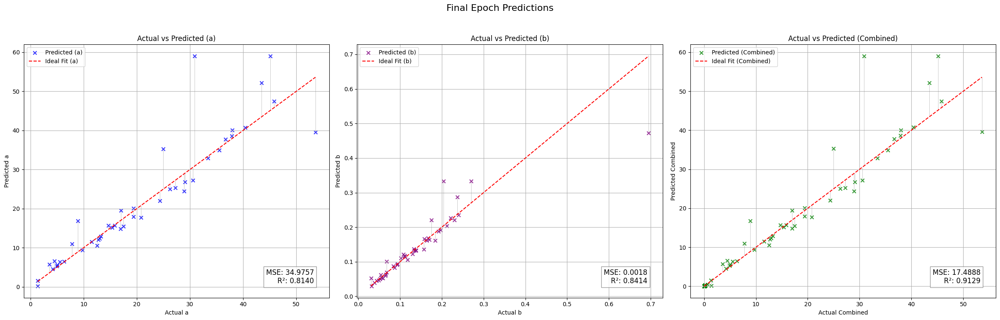

Validation Metrics:
  - MSE: 14.8472
  - R²: 0.8619
  - MAE: 1.3262
  - Explained Variance Score (EVS): 0.8665
Fold 4 Metrics:
  - Validation Loss (MSE): 14.8472
  - R²: 0.8619
  - MAE: 1.3262
  - EVS: 0.8665
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.27it/s, loss=0.552]


Validation Metrics:
  - MSE: 32.2066
  - R²: 0.8327
  - MAE: 1.6460
  - Explained Variance Score (EVS): 0.8379
Epoch [1/50], Train Loss: 0.5653, Val Loss: 32.2066
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=0.545]


Validation Metrics:
  - MSE: 31.8939
  - R²: 0.8342
  - MAE: 1.6136
  - Explained Variance Score (EVS): 0.8386
Epoch [2/50], Train Loss: 0.5514, Val Loss: 31.8939
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.532]


Validation Metrics:
  - MSE: 32.0925
  - R²: 0.8333
  - MAE: 1.5996
  - Explained Variance Score (EVS): 0.8373
Epoch [3/50], Train Loss: 0.5420, Val Loss: 32.0925
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=0.605]


Validation Metrics:
  - MSE: 32.6230
  - R²: 0.8300
  - MAE: 1.5631
  - Explained Variance Score (EVS): 0.8352
Epoch [4/50], Train Loss: 0.5582, Val Loss: 32.6230
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.508]


Validation Metrics:
  - MSE: 32.7090
  - R²: 0.8286
  - MAE: 1.5380
  - Explained Variance Score (EVS): 0.8338
Epoch [5/50], Train Loss: 0.5396, Val Loss: 32.7090
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s, loss=0.53]


Validation Metrics:
  - MSE: 32.7540
  - R²: 0.8282
  - MAE: 1.5219
  - Explained Variance Score (EVS): 0.8327
Epoch [6/50], Train Loss: 0.5366, Val Loss: 32.7540
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.529]


Validation Metrics:
  - MSE: 33.2485
  - R²: 0.8243
  - MAE: 1.4990
  - Explained Variance Score (EVS): 0.8294
Epoch [7/50], Train Loss: 0.5292, Val Loss: 33.2485
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.529]


Validation Metrics:
  - MSE: 33.6046
  - R²: 0.8228
  - MAE: 1.4974
  - Explained Variance Score (EVS): 0.8283
Epoch [8/50], Train Loss: 0.5303, Val Loss: 33.6046
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.512]


Validation Metrics:
  - MSE: 33.6177
  - R²: 0.8234
  - MAE: 1.5025
  - Explained Variance Score (EVS): 0.8278
Epoch [9/50], Train Loss: 0.5184, Val Loss: 33.6177
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.552]


Validation Metrics:
  - MSE: 34.2692
  - R²: 0.8210
  - MAE: 1.5134
  - Explained Variance Score (EVS): 0.8257
Epoch [10/50], Train Loss: 0.5224, Val Loss: 34.2692
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.51]


Validation Metrics:
  - MSE: 34.3550
  - R²: 0.8223
  - MAE: 1.5236
  - Explained Variance Score (EVS): 0.8263
Epoch [11/50], Train Loss: 0.5064, Val Loss: 34.3550
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.495]


Validation Metrics:
  - MSE: 34.4553
  - R²: 0.8232
  - MAE: 1.5265
  - Explained Variance Score (EVS): 0.8268
Epoch [12/50], Train Loss: 0.5162, Val Loss: 34.4553
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


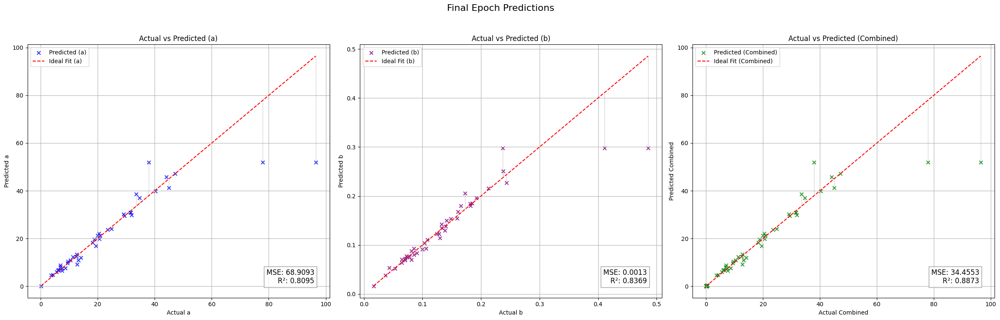

[I 2024-12-01 17:29:53,702] Trial 23 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 31.8939
  - R²: 0.8342
  - MAE: 1.6136
  - Explained Variance Score (EVS): 0.8386
Fold 5 Metrics:
  - Validation Loss (MSE): 31.8939
  - R²: 0.8342
  - MAE: 1.6136
  - EVS: 0.8386
Avg Validation Metrics:
  - MSE: 24.5146
  - R²: 0.8428
  - MAE: 1.7194
  - EVS: 0.8488
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.74it/s, loss=1.48]


Validation Metrics:
  - MSE: 196.8415
  - R²: -0.0174
  - MAE: 6.4708
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 3.7869, Val Loss: 196.8415
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=0.401]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4896, Val Loss: 197.4690
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=0.383]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4119, Val Loss: 197.4690
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.477]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4134, Val Loss: 197.4225
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.336]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3964, Val Loss: 197.4225
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.373]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3958, Val Loss: 197.4690
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=0.435]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3979, Val Loss: 197.4690
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.343]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3870, Val Loss: 197.5156
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s, loss=0.408]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3901, Val Loss: 197.4690
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.379]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3854, Val Loss: 197.4690
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.311]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3773, Val Loss: 197.4690
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


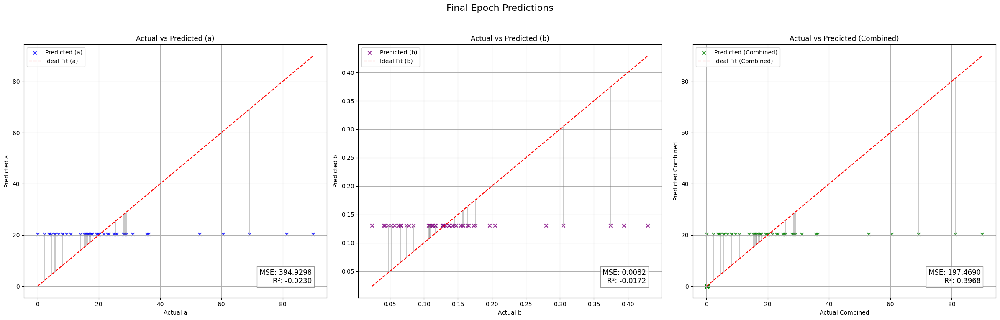

Validation Metrics:
  - MSE: 196.8415
  - R²: -0.0174
  - MAE: 6.4708
  - Explained Variance Score (EVS): -0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 196.8415
  - R²: -0.0174
  - MAE: 6.4708
  - EVS: -0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s, loss=0.629]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.5216, Val Loss: 98.2750
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.461]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4205, Val Loss: 98.4316
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.4]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4044, Val Loss: 98.2750
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.339]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3943, Val Loss: 98.2750
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.543]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4087, Val Loss: 98.3532
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=0.483]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4004, Val Loss: 98.3532
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=0.315]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3829, Val Loss: 98.3532
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.483]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3952, Val Loss: 98.3532
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.34]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3805, Val Loss: 98.1971
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.30it/s, loss=0.482]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1736
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3907, Val Loss: 98.5102
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.351]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3774, Val Loss: 98.3532
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.22it/s, loss=0.399]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3799, Val Loss: 98.3532
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.369]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3763, Val Loss: 98.3532
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.297]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3692, Val Loss: 98.3532
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  6.09it/s, loss=0.44]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3811, Val Loss: 98.3532
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.361]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3734, Val Loss: 98.3532
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.427]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3785, Val Loss: 98.3532
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.432]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3783, Val Loss: 98.3532
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.26]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3624, Val Loss: 98.3532
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


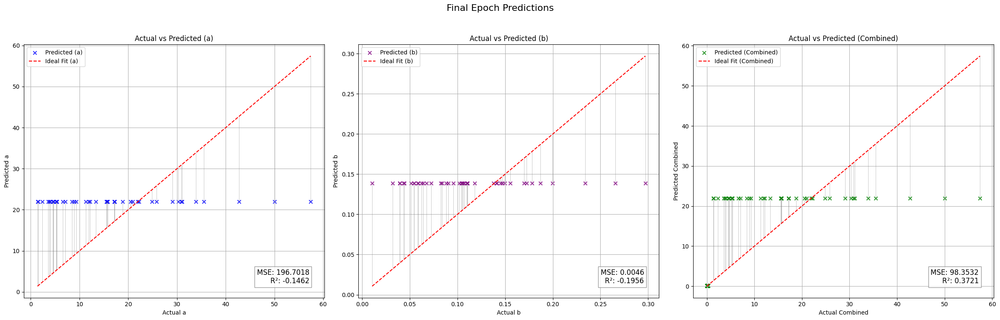

Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.52it/s, loss=0.398]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3813, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.417]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3819, Val Loss: 111.2861
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.26it/s, loss=0.302]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3708, Val Loss: 111.2922
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.80it/s, loss=0.412]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3795, Val Loss: 111.2922
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s, loss=0.339]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3722, Val Loss: 111.2922
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s, loss=0.474]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3832, Val Loss: 111.2861
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.335]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3701, Val Loss: 111.2922
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.95it/s, loss=0.378]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3731, Val Loss: 111.2922
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.73it/s, loss=0.307]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3661, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.463]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3791, Val Loss: 111.2922
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.481]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3800, Val Loss: 111.2922
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.351]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3679, Val Loss: 111.2922
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


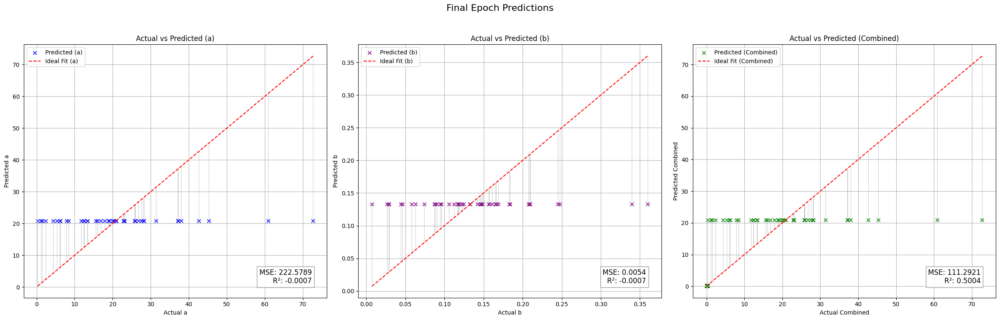

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.91it/s, loss=0.423]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3920, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.219]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3734, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=0.254]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3759, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.80it/s, loss=0.449]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3927, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.38it/s, loss=0.333]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3820, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.402]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3876, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.371]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3844, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.306]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3782, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.07it/s, loss=0.381]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3844, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.419]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3874, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=0.334]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3794, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


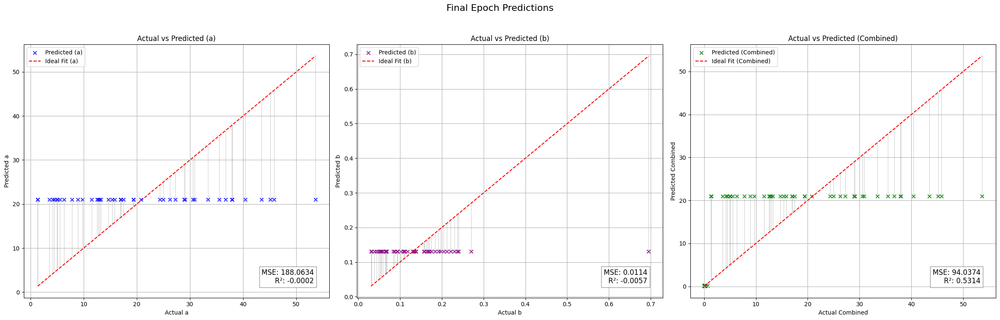

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=0.323]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.3815, Val Loss: 182.6789
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.572]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4020, Val Loss: 182.6789
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.91it/s, loss=0.404]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3877, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.37]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3847, Val Loss: 182.6789
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.40it/s, loss=0.307]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3791, Val Loss: 182.6789
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.61it/s, loss=0.418]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3881, Val Loss: 182.6789
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.489]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3938, Val Loss: 182.6789
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.437]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3893, Val Loss: 182.6789
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.63it/s, loss=0.404]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3863, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s, loss=0.459]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3906, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.298]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3770, Val Loss: 182.6491
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.335]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3800, Val Loss: 182.6491
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.422]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.3870, Val Loss: 182.6491
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


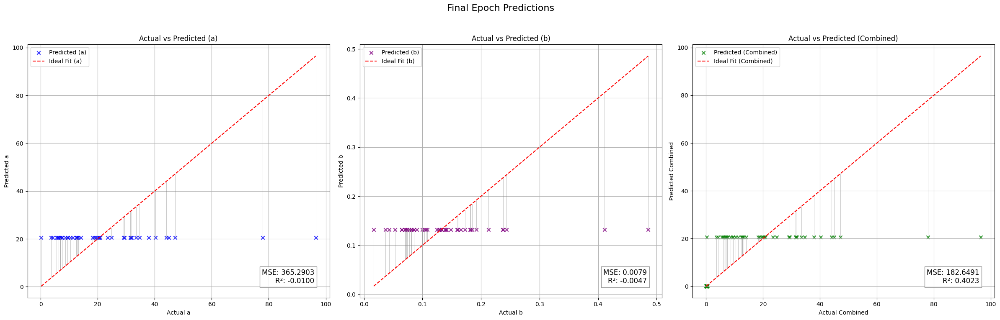

[I 2024-12-01 17:31:20,720] Trial 24 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6022
  - R²: -0.0397
  - MAE: 6.1015
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  6.07it/s, loss=1.25]


Validation Metrics:
  - MSE: 181.5928
  - R²: 0.0580
  - MAE: 6.2080
  - Explained Variance Score (EVS): 0.0680
Epoch [1/50], Train Loss: 1.3609, Val Loss: 181.5928
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.23it/s, loss=1.25]


Validation Metrics:
  - MSE: 180.4928
  - R²: 0.0726
  - MAE: 6.1787
  - Explained Variance Score (EVS): 0.0833
Epoch [2/50], Train Loss: 1.2650, Val Loss: 180.4928
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s, loss=1.23]


Validation Metrics:
  - MSE: 183.1089
  - R²: 0.0582
  - MAE: 6.2553
  - Explained Variance Score (EVS): 0.0713
Epoch [3/50], Train Loss: 1.1772, Val Loss: 183.1089
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.80it/s, loss=1.15]


Validation Metrics:
  - MSE: 179.6704
  - R²: 0.0802
  - MAE: 6.1968
  - Explained Variance Score (EVS): 0.0908
Epoch [4/50], Train Loss: 1.1459, Val Loss: 179.6704
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.91it/s, loss=1.1]


Validation Metrics:
  - MSE: 172.8023
  - R²: 0.1051
  - MAE: 6.0374
  - Explained Variance Score (EVS): 0.1137
Epoch [5/50], Train Loss: 1.1186, Val Loss: 172.8023
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=1.1]


Validation Metrics:
  - MSE: 168.6301
  - R²: 0.1134
  - MAE: 5.9308
  - Explained Variance Score (EVS): 0.1238
Epoch [6/50], Train Loss: 1.0845, Val Loss: 168.6301
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=1.07]


Validation Metrics:
  - MSE: 165.7200
  - R²: 0.1382
  - MAE: 5.8361
  - Explained Variance Score (EVS): 0.1498
Epoch [7/50], Train Loss: 1.0607, Val Loss: 165.7200
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=1.02]


Validation Metrics:
  - MSE: 157.7910
  - R²: 0.1908
  - MAE: 5.6548
  - Explained Variance Score (EVS): 0.2000
Epoch [8/50], Train Loss: 1.0384, Val Loss: 157.7910
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.39it/s, loss=1.14]


Validation Metrics:
  - MSE: 150.6970
  - R²: 0.2365
  - MAE: 5.4753
  - Explained Variance Score (EVS): 0.2440
Epoch [9/50], Train Loss: 1.0184, Val Loss: 150.6970
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.933]


Validation Metrics:
  - MSE: 149.1513
  - R²: 0.2444
  - MAE: 5.4012
  - Explained Variance Score (EVS): 0.2532
Epoch [10/50], Train Loss: 0.9773, Val Loss: 149.1513
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=0.909]


Validation Metrics:
  - MSE: 143.4443
  - R²: 0.2702
  - MAE: 5.3510
  - Explained Variance Score (EVS): 0.2797
Epoch [11/50], Train Loss: 0.9528, Val Loss: 143.4443
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=0.887]


Validation Metrics:
  - MSE: 137.5616
  - R²: 0.2925
  - MAE: 5.2800
  - Explained Variance Score (EVS): 0.3025
Epoch [12/50], Train Loss: 0.9273, Val Loss: 137.5616
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.76it/s, loss=0.893]


Validation Metrics:
  - MSE: 129.2849
  - R²: 0.3398
  - MAE: 5.0851
  - Explained Variance Score (EVS): 0.3499
Epoch [13/50], Train Loss: 0.9203, Val Loss: 129.2849
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.859]


Validation Metrics:
  - MSE: 116.2524
  - R²: 0.4088
  - MAE: 4.8039
  - Explained Variance Score (EVS): 0.4176
Epoch [14/50], Train Loss: 0.8847, Val Loss: 116.2524
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s, loss=0.883]


Validation Metrics:
  - MSE: 111.5333
  - R²: 0.4447
  - MAE: 4.6144
  - Explained Variance Score (EVS): 0.4534
Epoch [15/50], Train Loss: 0.8703, Val Loss: 111.5333
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.67it/s, loss=0.852]


Validation Metrics:
  - MSE: 108.1874
  - R²: 0.4619
  - MAE: 4.4590
  - Explained Variance Score (EVS): 0.4718
Epoch [16/50], Train Loss: 0.8555, Val Loss: 108.1874
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.904]


Validation Metrics:
  - MSE: 96.8212
  - R²: 0.5103
  - MAE: 4.3015
  - Explained Variance Score (EVS): 0.5205
Epoch [17/50], Train Loss: 0.8349, Val Loss: 96.8212
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s, loss=0.77]


Validation Metrics:
  - MSE: 91.5843
  - R²: 0.5577
  - MAE: 4.2108
  - Explained Variance Score (EVS): 0.5659
Epoch [18/50], Train Loss: 0.8013, Val Loss: 91.5843
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.804]


Validation Metrics:
  - MSE: 89.0682
  - R²: 0.5680
  - MAE: 4.1722
  - Explained Variance Score (EVS): 0.5778
Epoch [19/50], Train Loss: 0.7759, Val Loss: 89.0682
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.751]


Validation Metrics:
  - MSE: 75.9661
  - R²: 0.5989
  - MAE: 4.0901
  - Explained Variance Score (EVS): 0.6045
Epoch [20/50], Train Loss: 0.7478, Val Loss: 75.9661
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.715]


Validation Metrics:
  - MSE: 74.2530
  - R²: 0.6236
  - MAE: 4.0894
  - Explained Variance Score (EVS): 0.6282
Epoch [21/50], Train Loss: 0.7258, Val Loss: 74.2530
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.773]


Validation Metrics:
  - MSE: 79.2147
  - R²: 0.6305
  - MAE: 4.0043
  - Explained Variance Score (EVS): 0.6370
Epoch [22/50], Train Loss: 0.7150, Val Loss: 79.2147
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.702]


Validation Metrics:
  - MSE: 76.3714
  - R²: 0.6377
  - MAE: 3.9099
  - Explained Variance Score (EVS): 0.6471
Epoch [23/50], Train Loss: 0.6799, Val Loss: 76.3714
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=0.624]


Validation Metrics:
  - MSE: 72.2612
  - R²: 0.6561
  - MAE: 3.7579
  - Explained Variance Score (EVS): 0.6682
Epoch [24/50], Train Loss: 0.6512, Val Loss: 72.2612
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  4.51it/s, loss=0.591]


Validation Metrics:
  - MSE: 76.6187
  - R²: 0.6407
  - MAE: 3.7942
  - Explained Variance Score (EVS): 0.6535
Epoch [25/50], Train Loss: 0.6249, Val Loss: 76.6187
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.591]


Validation Metrics:
  - MSE: 74.5798
  - R²: 0.6383
  - MAE: 3.8438
  - Explained Variance Score (EVS): 0.6500
Epoch [26/50], Train Loss: 0.6034, Val Loss: 74.5798
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.26it/s, loss=0.661]


Validation Metrics:
  - MSE: 69.8099
  - R²: 0.6395
  - MAE: 3.8074
  - Explained Variance Score (EVS): 0.6507
Epoch [27/50], Train Loss: 0.5941, Val Loss: 69.8099
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.539]


Validation Metrics:
  - MSE: 64.5981
  - R²: 0.6721
  - MAE: 3.7435
  - Explained Variance Score (EVS): 0.6789
Epoch [28/50], Train Loss: 0.5588, Val Loss: 64.5981
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  6.02it/s, loss=0.567]


Validation Metrics:
  - MSE: 63.2912
  - R²: 0.6811
  - MAE: 3.6981
  - Explained Variance Score (EVS): 0.6849
Epoch [29/50], Train Loss: 0.5430, Val Loss: 63.2912
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  5.97it/s, loss=0.571]


Validation Metrics:
  - MSE: 71.1024
  - R²: 0.6461
  - MAE: 3.7721
  - Explained Variance Score (EVS): 0.6564
Epoch [30/50], Train Loss: 0.5176, Val Loss: 71.1024
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.46]


Validation Metrics:
  - MSE: 66.7281
  - R²: 0.6627
  - MAE: 3.7904
  - Explained Variance Score (EVS): 0.6741
Epoch [31/50], Train Loss: 0.4857, Val Loss: 66.7281
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.454]


Validation Metrics:
  - MSE: 71.4881
  - R²: 0.6430
  - MAE: 3.8578
  - Explained Variance Score (EVS): 0.6558
Epoch [32/50], Train Loss: 0.4630, Val Loss: 71.4881
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.88it/s, loss=0.453]


Validation Metrics:
  - MSE: 74.3537
  - R²: 0.6464
  - MAE: 3.8952
  - Explained Variance Score (EVS): 0.6547
Epoch [33/50], Train Loss: 0.4499, Val Loss: 74.3537
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.63it/s, loss=0.428]


Validation Metrics:
  - MSE: 66.3326
  - R²: 0.6833
  - MAE: 3.8294
  - Explained Variance Score (EVS): 0.6892
Epoch [34/50], Train Loss: 0.4237, Val Loss: 66.3326
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.58it/s, loss=0.396]


Validation Metrics:
  - MSE: 66.2953
  - R²: 0.6512
  - MAE: 3.7567
  - Explained Variance Score (EVS): 0.6632
Epoch [35/50], Train Loss: 0.3990, Val Loss: 66.2953
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.388]


Validation Metrics:
  - MSE: 71.7468
  - R²: 0.6342
  - MAE: 3.6894
  - Explained Variance Score (EVS): 0.6503
Epoch [36/50], Train Loss: 0.3859, Val Loss: 71.7468
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  4.52it/s, loss=0.382]


Validation Metrics:
  - MSE: 65.3055
  - R²: 0.6675
  - MAE: 3.6349
  - Explained Variance Score (EVS): 0.6761
Epoch [37/50], Train Loss: 0.3609, Val Loss: 65.3055
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  4.40it/s, loss=0.376]


Validation Metrics:
  - MSE: 65.9414
  - R²: 0.6452
  - MAE: 3.6577
  - Explained Variance Score (EVS): 0.6558
Epoch [38/50], Train Loss: 0.3433, Val Loss: 65.9414
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.362]


Validation Metrics:
  - MSE: 75.7541
  - R²: 0.6057
  - MAE: 3.8424
  - Explained Variance Score (EVS): 0.6215
Epoch [39/50], Train Loss: 0.3210, Val Loss: 75.7541
Current Dropout Rate: 0.1960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


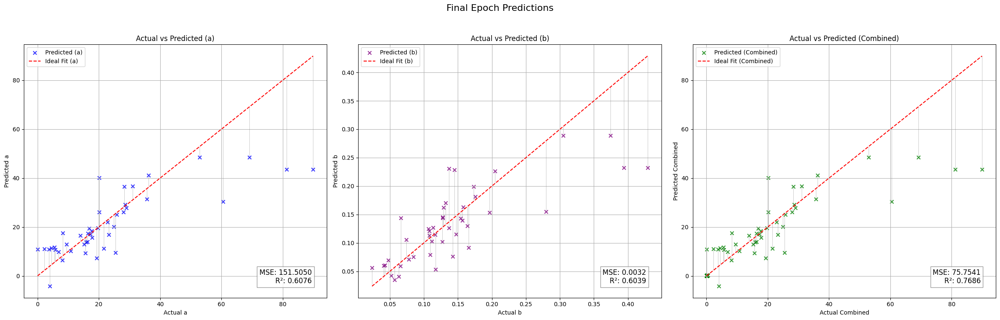

Validation Metrics:
  - MSE: 63.2912
  - R²: 0.6811
  - MAE: 3.6981
  - Explained Variance Score (EVS): 0.6849
Fold 1 Metrics:
  - Validation Loss (MSE): 63.2912
  - R²: 0.6811
  - MAE: 3.6981
  - EVS: 0.6849
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=0.542]


Validation Metrics:
  - MSE: 5.2455
  - R²: 0.9401
  - MAE: 1.3819
  - Explained Variance Score (EVS): 0.9486
Epoch [1/50], Train Loss: 0.5509, Val Loss: 5.2455
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.561]


Validation Metrics:
  - MSE: 6.6318
  - R²: 0.9268
  - MAE: 1.4988
  - Explained Variance Score (EVS): 0.9311
Epoch [2/50], Train Loss: 0.5335, Val Loss: 6.6318
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s, loss=0.547]


Validation Metrics:
  - MSE: 7.4834
  - R²: 0.9198
  - MAE: 1.5318
  - Explained Variance Score (EVS): 0.9232
Epoch [3/50], Train Loss: 0.5151, Val Loss: 7.4834
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.451]


Validation Metrics:
  - MSE: 8.4525
  - R²: 0.9096
  - MAE: 1.5615
  - Explained Variance Score (EVS): 0.9138
Epoch [4/50], Train Loss: 0.4797, Val Loss: 8.4525
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.62it/s, loss=0.485]


Validation Metrics:
  - MSE: 10.0320
  - R²: 0.8895
  - MAE: 1.5755
  - Explained Variance Score (EVS): 0.8922
Epoch [5/50], Train Loss: 0.4717, Val Loss: 10.0320
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.447]


Validation Metrics:
  - MSE: 10.3235
  - R²: 0.8900
  - MAE: 1.6485
  - Explained Variance Score (EVS): 0.8924
Epoch [6/50], Train Loss: 0.4685, Val Loss: 10.3235
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.459]


Validation Metrics:
  - MSE: 7.8420
  - R²: 0.9119
  - MAE: 1.4586
  - Explained Variance Score (EVS): 0.9137
Epoch [7/50], Train Loss: 0.4526, Val Loss: 7.8420
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.49it/s, loss=0.402]


Validation Metrics:
  - MSE: 8.0291
  - R²: 0.9029
  - MAE: 1.5182
  - Explained Variance Score (EVS): 0.9098
Epoch [8/50], Train Loss: 0.4174, Val Loss: 8.0291
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.25it/s, loss=0.366]


Validation Metrics:
  - MSE: 7.4995
  - R²: 0.9044
  - MAE: 1.4915
  - Explained Variance Score (EVS): 0.9110
Epoch [9/50], Train Loss: 0.3951, Val Loss: 7.4995
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.395]


Validation Metrics:
  - MSE: 9.1679
  - R²: 0.8958
  - MAE: 1.6089
  - Explained Variance Score (EVS): 0.9009
Epoch [10/50], Train Loss: 0.3854, Val Loss: 9.1679
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.54it/s, loss=0.325]


Validation Metrics:
  - MSE: 9.7190
  - R²: 0.9012
  - MAE: 1.6808
  - Explained Variance Score (EVS): 0.9026
Epoch [11/50], Train Loss: 0.3669, Val Loss: 9.7190
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


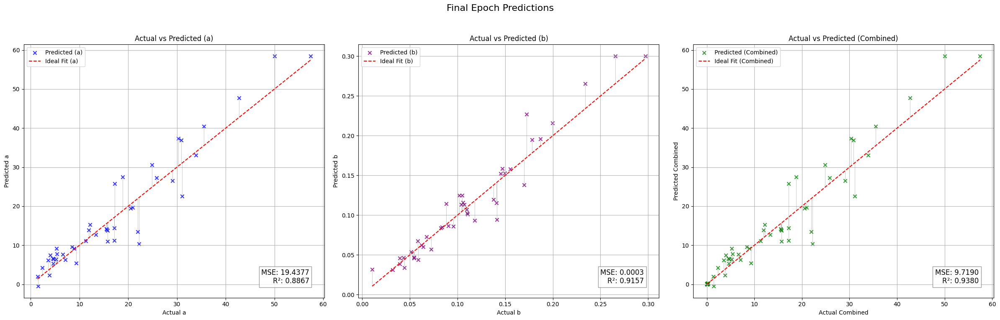

Validation Metrics:
  - MSE: 5.2455
  - R²: 0.9401
  - MAE: 1.3819
  - Explained Variance Score (EVS): 0.9486
Fold 2 Metrics:
  - Validation Loss (MSE): 5.2455
  - R²: 0.9401
  - MAE: 1.3819
  - EVS: 0.9486
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.52it/s, loss=0.5]


Validation Metrics:
  - MSE: 14.9838
  - R²: 0.8790
  - MAE: 1.5562
  - Explained Variance Score (EVS): 0.8795
Epoch [1/50], Train Loss: 0.5277, Val Loss: 14.9838
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.494]


Validation Metrics:
  - MSE: 15.5951
  - R²: 0.8788
  - MAE: 1.6034
  - Explained Variance Score (EVS): 0.8811
Epoch [2/50], Train Loss: 0.5210, Val Loss: 15.5951
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.46it/s, loss=0.5]


Validation Metrics:
  - MSE: 18.9003
  - R²: 0.8507
  - MAE: 1.6915
  - Explained Variance Score (EVS): 0.8612
Epoch [3/50], Train Loss: 0.5075, Val Loss: 18.9003
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.483]


Validation Metrics:
  - MSE: 20.1748
  - R²: 0.8344
  - MAE: 1.6581
  - Explained Variance Score (EVS): 0.8496
Epoch [4/50], Train Loss: 0.5052, Val Loss: 20.1748
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=0.472]


Validation Metrics:
  - MSE: 17.9435
  - R²: 0.8434
  - MAE: 1.5320
  - Explained Variance Score (EVS): 0.8527
Epoch [5/50], Train Loss: 0.4945, Val Loss: 17.9435
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.87it/s, loss=0.479]


Validation Metrics:
  - MSE: 16.4539
  - R²: 0.8463
  - MAE: 1.5792
  - Explained Variance Score (EVS): 0.8519
Epoch [6/50], Train Loss: 0.4736, Val Loss: 16.4539
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.32it/s, loss=0.431]


Validation Metrics:
  - MSE: 16.2400
  - R²: 0.8511
  - MAE: 1.6483
  - Explained Variance Score (EVS): 0.8537
Epoch [7/50], Train Loss: 0.4798, Val Loss: 16.2400
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.74it/s, loss=0.441]


Validation Metrics:
  - MSE: 15.7998
  - R²: 0.8620
  - MAE: 1.5791
  - Explained Variance Score (EVS): 0.8627
Epoch [8/50], Train Loss: 0.4447, Val Loss: 15.7998
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.51it/s, loss=0.458]


Validation Metrics:
  - MSE: 15.2607
  - R²: 0.8684
  - MAE: 1.4614
  - Explained Variance Score (EVS): 0.8689
Epoch [9/50], Train Loss: 0.4392, Val Loss: 15.2607
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.21it/s, loss=0.395]


Validation Metrics:
  - MSE: 15.8241
  - R²: 0.8691
  - MAE: 1.3970
  - Explained Variance Score (EVS): 0.8717
Epoch [10/50], Train Loss: 0.4293, Val Loss: 15.8241
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.80it/s, loss=0.397]


Validation Metrics:
  - MSE: 16.9447
  - R²: 0.8561
  - MAE: 1.4271
  - Explained Variance Score (EVS): 0.8615
Epoch [11/50], Train Loss: 0.4250, Val Loss: 16.9447
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


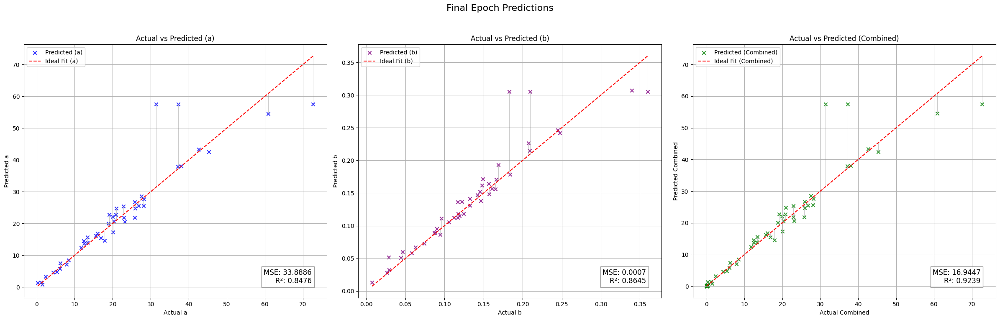

Validation Metrics:
  - MSE: 14.9838
  - R²: 0.8790
  - MAE: 1.5562
  - Explained Variance Score (EVS): 0.8795
Fold 3 Metrics:
  - Validation Loss (MSE): 14.9838
  - R²: 0.8790
  - MAE: 1.5562
  - EVS: 0.8795
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.38it/s, loss=0.515]


Validation Metrics:
  - MSE: 10.7261
  - R²: 0.8695
  - MAE: 1.3686
  - Explained Variance Score (EVS): 0.8731
Epoch [1/50], Train Loss: 0.5450, Val Loss: 10.7261
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.66it/s, loss=0.553]


Validation Metrics:
  - MSE: 11.0397
  - R²: 0.8686
  - MAE: 1.3665
  - Explained Variance Score (EVS): 0.8728
Epoch [2/50], Train Loss: 0.5196, Val Loss: 11.0397
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.76it/s, loss=0.586]


Validation Metrics:
  - MSE: 12.4417
  - R²: 0.8583
  - MAE: 1.4018
  - Explained Variance Score (EVS): 0.8636
Epoch [3/50], Train Loss: 0.5252, Val Loss: 12.4417
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s, loss=0.517]


Validation Metrics:
  - MSE: 14.1719
  - R²: 0.8426
  - MAE: 1.4783
  - Explained Variance Score (EVS): 0.8481
Epoch [4/50], Train Loss: 0.5028, Val Loss: 14.1719
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.70it/s, loss=0.511]


Validation Metrics:
  - MSE: 16.5496
  - R²: 0.8237
  - MAE: 1.6108
  - Explained Variance Score (EVS): 0.8280
Epoch [5/50], Train Loss: 0.4925, Val Loss: 16.5496
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.467]


Validation Metrics:
  - MSE: 18.8072
  - R²: 0.8076
  - MAE: 1.7204
  - Explained Variance Score (EVS): 0.8119
Epoch [6/50], Train Loss: 0.4947, Val Loss: 18.8072
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s, loss=0.504]


Validation Metrics:
  - MSE: 18.9739
  - R²: 0.8082
  - MAE: 1.7487
  - Explained Variance Score (EVS): 0.8109
Epoch [7/50], Train Loss: 0.4780, Val Loss: 18.9739
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.64it/s, loss=0.466]


Validation Metrics:
  - MSE: 20.1472
  - R²: 0.8008
  - MAE: 1.8105
  - Explained Variance Score (EVS): 0.8030
Epoch [8/50], Train Loss: 0.4648, Val Loss: 20.1472
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.488]


Validation Metrics:
  - MSE: 19.8599
  - R²: 0.8022
  - MAE: 1.7579
  - Explained Variance Score (EVS): 0.8045
Epoch [9/50], Train Loss: 0.4688, Val Loss: 19.8599
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.46]


Validation Metrics:
  - MSE: 19.7973
  - R²: 0.8011
  - MAE: 1.7341
  - Explained Variance Score (EVS): 0.8036
Epoch [10/50], Train Loss: 0.4500, Val Loss: 19.7973
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.40it/s, loss=0.417]


Validation Metrics:
  - MSE: 20.2336
  - R²: 0.7969
  - MAE: 1.7227
  - Explained Variance Score (EVS): 0.8015
Epoch [11/50], Train Loss: 0.4528, Val Loss: 20.2336
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


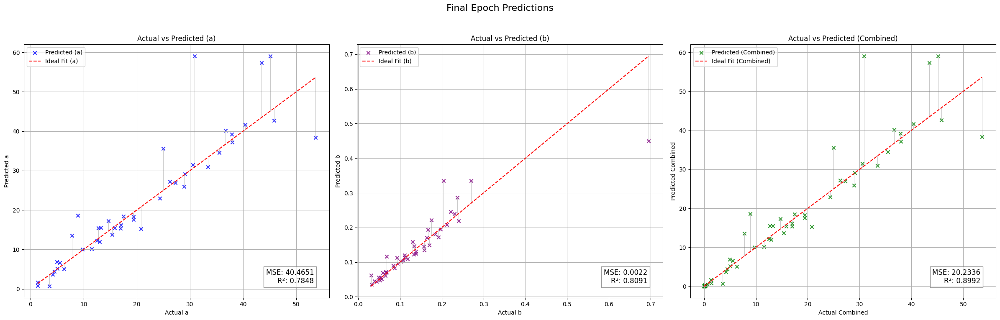

Validation Metrics:
  - MSE: 10.7261
  - R²: 0.8695
  - MAE: 1.3686
  - Explained Variance Score (EVS): 0.8731
Fold 4 Metrics:
  - Validation Loss (MSE): 10.7261
  - R²: 0.8695
  - MAE: 1.3686
  - EVS: 0.8731
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.507]


Validation Metrics:
  - MSE: 37.7140
  - R²: 0.8130
  - MAE: 1.7825
  - Explained Variance Score (EVS): 0.8142
Epoch [1/50], Train Loss: 0.5127, Val Loss: 37.7140
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.59it/s, loss=0.484]


Validation Metrics:
  - MSE: 36.9610
  - R²: 0.8156
  - MAE: 1.7716
  - Explained Variance Score (EVS): 0.8162
Epoch [2/50], Train Loss: 0.5045, Val Loss: 36.9610
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.53it/s, loss=0.54]


Validation Metrics:
  - MSE: 36.3885
  - R²: 0.8159
  - MAE: 1.7501
  - Explained Variance Score (EVS): 0.8166
Epoch [3/50], Train Loss: 0.5141, Val Loss: 36.3885
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=0.515]


Validation Metrics:
  - MSE: 35.6002
  - R²: 0.8181
  - MAE: 1.7380
  - Explained Variance Score (EVS): 0.8188
Epoch [4/50], Train Loss: 0.4997, Val Loss: 35.6002
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.5]


Validation Metrics:
  - MSE: 34.9634
  - R²: 0.8201
  - MAE: 1.7453
  - Explained Variance Score (EVS): 0.8205
Epoch [5/50], Train Loss: 0.4907, Val Loss: 34.9634
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.57it/s, loss=0.49]


Validation Metrics:
  - MSE: 34.8002
  - R²: 0.8211
  - MAE: 1.7308
  - Explained Variance Score (EVS): 0.8217
Epoch [6/50], Train Loss: 0.4916, Val Loss: 34.8002
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.34it/s, loss=0.453]


Validation Metrics:
  - MSE: 34.6296
  - R²: 0.8225
  - MAE: 1.6985
  - Explained Variance Score (EVS): 0.8233
Epoch [7/50], Train Loss: 0.4802, Val Loss: 34.6296
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.79it/s, loss=0.43]


Validation Metrics:
  - MSE: 34.6677
  - R²: 0.8232
  - MAE: 1.6674
  - Explained Variance Score (EVS): 0.8244
Epoch [8/50], Train Loss: 0.4742, Val Loss: 34.6677
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.469]


Validation Metrics:
  - MSE: 34.9030
  - R²: 0.8232
  - MAE: 1.6349
  - Explained Variance Score (EVS): 0.8250
Epoch [9/50], Train Loss: 0.4821, Val Loss: 34.9030
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  6.17it/s, loss=0.451]


Validation Metrics:
  - MSE: 35.0698
  - R²: 0.8239
  - MAE: 1.6193
  - Explained Variance Score (EVS): 0.8260
Epoch [10/50], Train Loss: 0.4792, Val Loss: 35.0698
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.23it/s, loss=0.457]


Validation Metrics:
  - MSE: 35.4332
  - R²: 0.8231
  - MAE: 1.6271
  - Explained Variance Score (EVS): 0.8256
Epoch [11/50], Train Loss: 0.4835, Val Loss: 35.4332
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.45]


Validation Metrics:
  - MSE: 35.7419
  - R²: 0.8220
  - MAE: 1.6238
  - Explained Variance Score (EVS): 0.8252
Epoch [12/50], Train Loss: 0.4661, Val Loss: 35.7419
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=0.443]


Validation Metrics:
  - MSE: 35.7307
  - R²: 0.8218
  - MAE: 1.6368
  - Explained Variance Score (EVS): 0.8248
Epoch [13/50], Train Loss: 0.4567, Val Loss: 35.7307
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=0.505]


Validation Metrics:
  - MSE: 35.6296
  - R²: 0.8218
  - MAE: 1.6445
  - Explained Variance Score (EVS): 0.8246
Epoch [14/50], Train Loss: 0.4754, Val Loss: 35.6296
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.33it/s, loss=0.427]


Validation Metrics:
  - MSE: 35.6251
  - R²: 0.8221
  - MAE: 1.6513
  - Explained Variance Score (EVS): 0.8248
Epoch [15/50], Train Loss: 0.4563, Val Loss: 35.6251
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.45]


Validation Metrics:
  - MSE: 35.5034
  - R²: 0.8223
  - MAE: 1.6492
  - Explained Variance Score (EVS): 0.8250
Epoch [16/50], Train Loss: 0.4583, Val Loss: 35.5034
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=0.435]


Validation Metrics:
  - MSE: 35.2405
  - R²: 0.8231
  - MAE: 1.6579
  - Explained Variance Score (EVS): 0.8254
Epoch [17/50], Train Loss: 0.4540, Val Loss: 35.2405
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


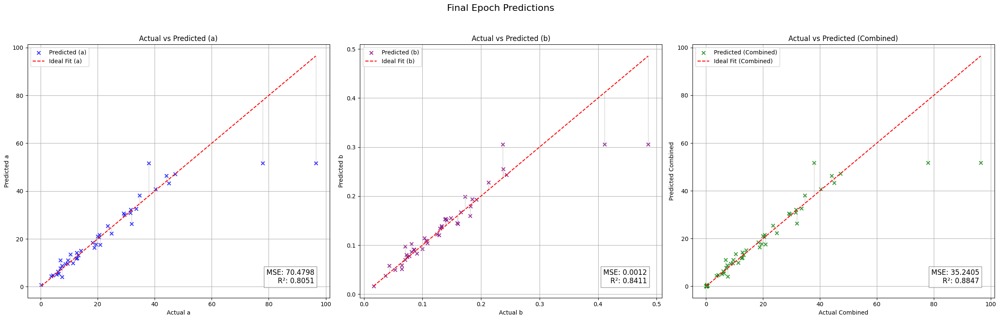

[I 2024-12-01 17:33:17,921] Trial 25 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 34.6296
  - R²: 0.8225
  - MAE: 1.6985
  - Explained Variance Score (EVS): 0.8233
Fold 5 Metrics:
  - Validation Loss (MSE): 34.6296
  - R²: 0.8225
  - MAE: 1.6985
  - EVS: 0.8233
Avg Validation Metrics:
  - MSE: 25.7752
  - R²: 0.8384
  - MAE: 1.9407
  - EVS: 0.8419
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.49it/s, loss=1.15]


Validation Metrics:
  - MSE: 195.5161
  - R²: -0.0294
  - MAE: 6.5056
  - Explained Variance Score (EVS): 0.0024
Epoch [1/50], Train Loss: 1.3015, Val Loss: 195.5161
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=1.03]


Validation Metrics:
  - MSE: 196.5568
  - R²: -0.0386
  - MAE: 6.4800
  - Explained Variance Score (EVS): 0.0011
Epoch [2/50], Train Loss: 1.1157, Val Loss: 196.5568
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.39it/s, loss=0.865]


Validation Metrics:
  - MSE: 197.0739
  - R²: -0.0461
  - MAE: 6.4654
  - Explained Variance Score (EVS): 0.0004
Epoch [3/50], Train Loss: 0.9903, Val Loss: 197.0739
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.65it/s, loss=0.81]


Validation Metrics:
  - MSE: 197.0324
  - R²: -0.0492
  - MAE: 6.4670
  - Explained Variance Score (EVS): -0.0002
Epoch [4/50], Train Loss: 0.8762, Val Loss: 197.0324
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.861]


Validation Metrics:
  - MSE: 197.2286
  - R²: -0.0517
  - MAE: 6.4564
  - Explained Variance Score (EVS): 0.0001
Epoch [5/50], Train Loss: 0.7947, Val Loss: 197.2286
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=0.647]


Validation Metrics:
  - MSE: 197.3018
  - R²: -0.0528
  - MAE: 6.4488
  - Explained Variance Score (EVS): 0.0005
Epoch [6/50], Train Loss: 0.7043, Val Loss: 197.3018
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.644]


Validation Metrics:
  - MSE: 197.2269
  - R²: -0.0521
  - MAE: 6.4483
  - Explained Variance Score (EVS): 0.0007
Epoch [7/50], Train Loss: 0.6504, Val Loss: 197.2269
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.488]


Validation Metrics:
  - MSE: 197.3224
  - R²: -0.0507
  - MAE: 6.4475
  - Explained Variance Score (EVS): 0.0006
Epoch [8/50], Train Loss: 0.6218, Val Loss: 197.3224
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.52it/s, loss=0.615]


Validation Metrics:
  - MSE: 197.3785
  - R²: -0.0489
  - MAE: 6.4473
  - Explained Variance Score (EVS): 0.0007
Epoch [9/50], Train Loss: 0.5928, Val Loss: 197.3785
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=0.459]


Validation Metrics:
  - MSE: 197.3658
  - R²: -0.0471
  - MAE: 6.4485
  - Explained Variance Score (EVS): 0.0008
Epoch [10/50], Train Loss: 0.5788, Val Loss: 197.3658
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.57it/s, loss=0.521]


Validation Metrics:
  - MSE: 197.3898
  - R²: -0.0453
  - MAE: 6.4496
  - Explained Variance Score (EVS): 0.0008
Epoch [11/50], Train Loss: 0.5724, Val Loss: 197.3898
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


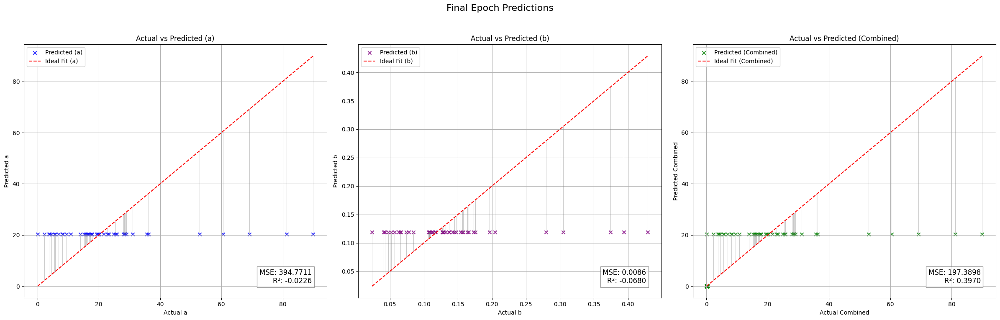

Validation Metrics:
  - MSE: 195.5161
  - R²: -0.0294
  - MAE: 6.5056
  - Explained Variance Score (EVS): 0.0024
Fold 1 Metrics:
  - Validation Loss (MSE): 195.5161
  - R²: -0.0294
  - MAE: 6.5056
  - EVS: 0.0024
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=1.11]


Validation Metrics:
  - MSE: 100.1894
  - R²: -0.1176
  - MAE: 6.0243
  - Explained Variance Score (EVS): 0.0017
Epoch [1/50], Train Loss: 1.1551, Val Loss: 100.1894
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=1.14]


Validation Metrics:
  - MSE: 99.9196
  - R²: -0.1092
  - MAE: 6.0114
  - Explained Variance Score (EVS): 0.0013
Epoch [2/50], Train Loss: 1.0849, Val Loss: 99.9196
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=1.01]


Validation Metrics:
  - MSE: 99.5825
  - R²: -0.1028
  - MAE: 5.9975
  - Explained Variance Score (EVS): 0.0007
Epoch [3/50], Train Loss: 0.9834, Val Loss: 99.5825
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.81it/s, loss=0.999]


Validation Metrics:
  - MSE: 98.8179
  - R²: -0.0961
  - MAE: 5.9643
  - Explained Variance Score (EVS): 0.0008
Epoch [4/50], Train Loss: 0.8942, Val Loss: 98.8179
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.721]


Validation Metrics:
  - MSE: 98.8646
  - R²: -0.0962
  - MAE: 5.9682
  - Explained Variance Score (EVS): 0.0007
Epoch [5/50], Train Loss: 0.7608, Val Loss: 98.8646
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.594]


Validation Metrics:
  - MSE: 98.6454
  - R²: -0.0956
  - MAE: 5.9595
  - Explained Variance Score (EVS): 0.0008
Epoch [6/50], Train Loss: 0.7011, Val Loss: 98.6454
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=0.64]


Validation Metrics:
  - MSE: 98.4215
  - R²: -0.0957
  - MAE: 5.9523
  - Explained Variance Score (EVS): 0.0015
Epoch [7/50], Train Loss: 0.6316, Val Loss: 98.4215
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=0.537]


Validation Metrics:
  - MSE: 98.1415
  - R²: -0.0957
  - MAE: 5.9413
  - Explained Variance Score (EVS): 0.0017
Epoch [8/50], Train Loss: 0.5814, Val Loss: 98.1415
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.37it/s, loss=0.518]


Validation Metrics:
  - MSE: 98.1012
  - R²: -0.0967
  - MAE: 5.9398
  - Explained Variance Score (EVS): 0.0017
Epoch [9/50], Train Loss: 0.5778, Val Loss: 98.1012
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.52]


Validation Metrics:
  - MSE: 98.0194
  - R²: -0.0978
  - MAE: 5.9359
  - Explained Variance Score (EVS): 0.0021
Epoch [10/50], Train Loss: 0.5624, Val Loss: 98.0194
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.475]


Validation Metrics:
  - MSE: 98.1721
  - R²: -0.1018
  - MAE: 5.9415
  - Explained Variance Score (EVS): 0.0021
Epoch [11/50], Train Loss: 0.5548, Val Loss: 98.1721
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.734]


Validation Metrics:
  - MSE: 98.3254
  - R²: -0.1064
  - MAE: 5.9477
  - Explained Variance Score (EVS): 0.0022
Epoch [12/50], Train Loss: 0.5712, Val Loss: 98.3254
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.539]


Validation Metrics:
  - MSE: 98.3007
  - R²: -0.1114
  - MAE: 5.9462
  - Explained Variance Score (EVS): 0.0017
Epoch [13/50], Train Loss: 0.5300, Val Loss: 98.3007
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.4]


Validation Metrics:
  - MSE: 98.3667
  - R²: -0.1163
  - MAE: 5.9503
  - Explained Variance Score (EVS): 0.0014
Epoch [14/50], Train Loss: 0.4968, Val Loss: 98.3667
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.71it/s, loss=0.515]


Validation Metrics:
  - MSE: 98.4164
  - R²: -0.1219
  - MAE: 5.9526
  - Explained Variance Score (EVS): 0.0011
Epoch [15/50], Train Loss: 0.4949, Val Loss: 98.4164
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.64it/s, loss=0.563]


Validation Metrics:
  - MSE: 98.4565
  - R²: -0.1277
  - MAE: 5.9547
  - Explained Variance Score (EVS): 0.0007
Epoch [16/50], Train Loss: 0.4798, Val Loss: 98.4565
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.16it/s, loss=0.534]


Validation Metrics:
  - MSE: 98.5231
  - R²: -0.1340
  - MAE: 5.9572
  - Explained Variance Score (EVS): 0.0003
Epoch [17/50], Train Loss: 0.4658, Val Loss: 98.5231
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=0.395]


Validation Metrics:
  - MSE: 98.5148
  - R²: -0.1388
  - MAE: 5.9566
  - Explained Variance Score (EVS): 0.0006
Epoch [18/50], Train Loss: 0.4395, Val Loss: 98.5148
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.48it/s, loss=0.389]


Validation Metrics:
  - MSE: 98.4930
  - R²: -0.1437
  - MAE: 5.9552
  - Explained Variance Score (EVS): 0.0003
Epoch [19/50], Train Loss: 0.4327, Val Loss: 98.4930
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.418]


Validation Metrics:
  - MSE: 98.4584
  - R²: -0.1476
  - MAE: 5.9535
  - Explained Variance Score (EVS): 0.0004
Epoch [20/50], Train Loss: 0.4311, Val Loss: 98.4584
Current Dropout Rate: 0.3480
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


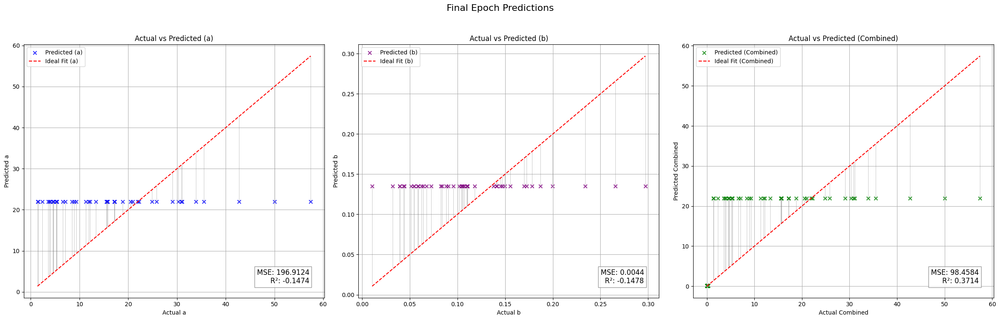

Validation Metrics:
  - MSE: 98.0194
  - R²: -0.0978
  - MAE: 5.9359
  - Explained Variance Score (EVS): 0.0021
Fold 2 Metrics:
  - Validation Loss (MSE): 98.0194
  - R²: -0.0978
  - MAE: 5.9359
  - EVS: 0.0021
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.659]


Validation Metrics:
  - MSE: 111.2210
  - R²: -0.0173
  - MAE: 5.4343
  - Explained Variance Score (EVS): 0.0015
Epoch [1/50], Train Loss: 0.5803, Val Loss: 111.2210
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.553]


Validation Metrics:
  - MSE: 111.2827
  - R²: -0.0164
  - MAE: 5.4336
  - Explained Variance Score (EVS): 0.0011
Epoch [2/50], Train Loss: 0.5456, Val Loss: 111.2827
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.449]


Validation Metrics:
  - MSE: 111.3018
  - R²: -0.0152
  - MAE: 5.4328
  - Explained Variance Score (EVS): 0.0008
Epoch [3/50], Train Loss: 0.5109, Val Loss: 111.3018
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.589]


Validation Metrics:
  - MSE: 111.3410
  - R²: -0.0138
  - MAE: 5.4346
  - Explained Variance Score (EVS): 0.0003
Epoch [4/50], Train Loss: 0.5065, Val Loss: 111.3410
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=0.444]


Validation Metrics:
  - MSE: 111.2739
  - R²: -0.0113
  - MAE: 5.4343
  - Explained Variance Score (EVS): 0.0004
Epoch [5/50], Train Loss: 0.4624, Val Loss: 111.2739
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.00it/s, loss=0.45]


Validation Metrics:
  - MSE: 111.1636
  - R²: -0.0079
  - MAE: 5.4349
  - Explained Variance Score (EVS): 0.0010
Epoch [6/50], Train Loss: 0.4434, Val Loss: 111.1636
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.47]


Validation Metrics:
  - MSE: 111.0758
  - R²: -0.0057
  - MAE: 5.4344
  - Explained Variance Score (EVS): 0.0015
Epoch [7/50], Train Loss: 0.4382, Val Loss: 111.0758
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.59it/s, loss=0.42]


Validation Metrics:
  - MSE: 111.0310
  - R²: -0.0043
  - MAE: 5.4335
  - Explained Variance Score (EVS): 0.0018
Epoch [8/50], Train Loss: 0.4360, Val Loss: 111.0310
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.81it/s, loss=0.391]


Validation Metrics:
  - MSE: 111.0250
  - R²: -0.0032
  - MAE: 5.4316
  - Explained Variance Score (EVS): 0.0020
Epoch [9/50], Train Loss: 0.4307, Val Loss: 111.0250
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.34it/s, loss=0.282]


Validation Metrics:
  - MSE: 111.0414
  - R²: -0.0024
  - MAE: 5.4326
  - Explained Variance Score (EVS): 0.0020
Epoch [10/50], Train Loss: 0.4110, Val Loss: 111.0414
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.43it/s, loss=0.592]


Validation Metrics:
  - MSE: 111.0985
  - R²: -0.0019
  - MAE: 5.4333
  - Explained Variance Score (EVS): 0.0018
Epoch [11/50], Train Loss: 0.4318, Val Loss: 111.0985
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=0.374]


Validation Metrics:
  - MSE: 111.1169
  - R²: -0.0012
  - MAE: 5.4340
  - Explained Variance Score (EVS): 0.0018
Epoch [12/50], Train Loss: 0.4022, Val Loss: 111.1169
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.36]


Validation Metrics:
  - MSE: 111.1127
  - R²: -0.0007
  - MAE: 5.4352
  - Explained Variance Score (EVS): 0.0017
Epoch [13/50], Train Loss: 0.3942, Val Loss: 111.1127
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.421]


Validation Metrics:
  - MSE: 111.1124
  - R²: -0.0004
  - MAE: 5.4352
  - Explained Variance Score (EVS): 0.0015
Epoch [14/50], Train Loss: 0.3974, Val Loss: 111.1124
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.477]


Validation Metrics:
  - MSE: 111.1170
  - R²: 0.0000
  - MAE: 5.4354
  - Explained Variance Score (EVS): 0.0016
Epoch [15/50], Train Loss: 0.4037, Val Loss: 111.1170
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.258]


Validation Metrics:
  - MSE: 111.1062
  - R²: 0.0003
  - MAE: 5.4353
  - Explained Variance Score (EVS): 0.0016
Epoch [16/50], Train Loss: 0.3862, Val Loss: 111.1062
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.313]


Validation Metrics:
  - MSE: 111.1173
  - R²: 0.0005
  - MAE: 5.4354
  - Explained Variance Score (EVS): 0.0017
Epoch [17/50], Train Loss: 0.3925, Val Loss: 111.1173
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.377]


Validation Metrics:
  - MSE: 111.1537
  - R²: 0.0005
  - MAE: 5.4365
  - Explained Variance Score (EVS): 0.0016
Epoch [18/50], Train Loss: 0.3996, Val Loss: 111.1537
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s, loss=0.359]


Validation Metrics:
  - MSE: 111.1475
  - R²: 0.0004
  - MAE: 5.4360
  - Explained Variance Score (EVS): 0.0014
Epoch [19/50], Train Loss: 0.3986, Val Loss: 111.1475
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


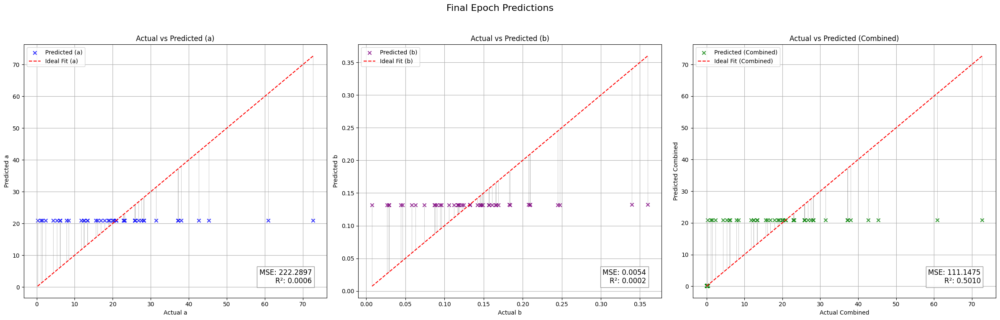

Validation Metrics:
  - MSE: 111.0250
  - R²: -0.0032
  - MAE: 5.4316
  - Explained Variance Score (EVS): 0.0020
Fold 3 Metrics:
  - Validation Loss (MSE): 111.0250
  - R²: -0.0032
  - MAE: 5.4316
  - EVS: 0.0020
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.21it/s, loss=0.387]


Validation Metrics:
  - MSE: 93.9774
  - R²: -0.0065
  - MAE: 5.9009
  - Explained Variance Score (EVS): 0.0007
Epoch [1/50], Train Loss: 0.4421, Val Loss: 93.9774
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.41it/s, loss=0.456]


Validation Metrics:
  - MSE: 94.0013
  - R²: -0.0063
  - MAE: 5.9011
  - Explained Variance Score (EVS): 0.0004
Epoch [2/50], Train Loss: 0.4463, Val Loss: 94.0013
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.539]


Validation Metrics:
  - MSE: 93.9847
  - R²: -0.0058
  - MAE: 5.9002
  - Explained Variance Score (EVS): 0.0005
Epoch [3/50], Train Loss: 0.4504, Val Loss: 93.9847
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.54it/s, loss=0.414]


Validation Metrics:
  - MSE: 93.9780
  - R²: -0.0054
  - MAE: 5.9008
  - Explained Variance Score (EVS): 0.0004
Epoch [4/50], Train Loss: 0.4325, Val Loss: 93.9780
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.77it/s, loss=0.457]


Validation Metrics:
  - MSE: 93.9717
  - R²: -0.0049
  - MAE: 5.9022
  - Explained Variance Score (EVS): 0.0005
Epoch [5/50], Train Loss: 0.4253, Val Loss: 93.9717
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.468]


Validation Metrics:
  - MSE: 93.8677
  - R²: -0.0036
  - MAE: 5.9007
  - Explained Variance Score (EVS): 0.0013
Epoch [6/50], Train Loss: 0.4173, Val Loss: 93.8677
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.42]


Validation Metrics:
  - MSE: 93.8092
  - R²: -0.0028
  - MAE: 5.8995
  - Explained Variance Score (EVS): 0.0018
Epoch [7/50], Train Loss: 0.4115, Val Loss: 93.8092
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.313]


Validation Metrics:
  - MSE: 93.7696
  - R²: -0.0023
  - MAE: 5.8980
  - Explained Variance Score (EVS): 0.0021
Epoch [8/50], Train Loss: 0.3998, Val Loss: 93.7696
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.90it/s, loss=0.444]


Validation Metrics:
  - MSE: 93.7120
  - R²: -0.0017
  - MAE: 5.8954
  - Explained Variance Score (EVS): 0.0025
Epoch [9/50], Train Loss: 0.4120, Val Loss: 93.7120
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.368]


Validation Metrics:
  - MSE: 93.6692
  - R²: -0.0014
  - MAE: 5.8938
  - Explained Variance Score (EVS): 0.0027
Epoch [10/50], Train Loss: 0.4056, Val Loss: 93.6692
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.406]


Validation Metrics:
  - MSE: 93.6611
  - R²: -0.0010
  - MAE: 5.8934
  - Explained Variance Score (EVS): 0.0031
Epoch [11/50], Train Loss: 0.4072, Val Loss: 93.6611
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.31it/s, loss=0.536]


Validation Metrics:
  - MSE: 93.5668
  - R²: -0.0003
  - MAE: 5.8908
  - Explained Variance Score (EVS): 0.0037
Epoch [12/50], Train Loss: 0.4172, Val Loss: 93.5668
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.78it/s, loss=0.367]


Validation Metrics:
  - MSE: 93.5320
  - R²: -0.0001
  - MAE: 5.8900
  - Explained Variance Score (EVS): 0.0038
Epoch [13/50], Train Loss: 0.4026, Val Loss: 93.5320
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.357]


Validation Metrics:
  - MSE: 93.4555
  - R²: 0.0005
  - MAE: 5.8879
  - Explained Variance Score (EVS): 0.0043
Epoch [14/50], Train Loss: 0.4018, Val Loss: 93.4555
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s, loss=0.383]


Validation Metrics:
  - MSE: 93.3207
  - R²: 0.0016
  - MAE: 5.8833
  - Explained Variance Score (EVS): 0.0053
Epoch [15/50], Train Loss: 0.4042, Val Loss: 93.3207
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.47it/s, loss=0.432]


Validation Metrics:
  - MSE: 93.2459
  - R²: 0.0021
  - MAE: 5.8813
  - Explained Variance Score (EVS): 0.0058
Epoch [16/50], Train Loss: 0.4098, Val Loss: 93.2459
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.59it/s, loss=0.405]


Validation Metrics:
  - MSE: 93.1758
  - R²: 0.0028
  - MAE: 5.8785
  - Explained Variance Score (EVS): 0.0064
Epoch [17/50], Train Loss: 0.4079, Val Loss: 93.1758
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  4.40it/s, loss=0.444]


Validation Metrics:
  - MSE: 93.1238
  - R²: 0.0032
  - MAE: 5.8767
  - Explained Variance Score (EVS): 0.0068
Epoch [18/50], Train Loss: 0.4121, Val Loss: 93.1238
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.08it/s, loss=0.506]


Validation Metrics:
  - MSE: 93.0747
  - R²: 0.0035
  - MAE: 5.8747
  - Explained Variance Score (EVS): 0.0071
Epoch [19/50], Train Loss: 0.4180, Val Loss: 93.0747
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  4.66it/s, loss=0.375]


Validation Metrics:
  - MSE: 92.9089
  - R²: 0.0045
  - MAE: 5.8685
  - Explained Variance Score (EVS): 0.0080
Epoch [20/50], Train Loss: 0.4068, Val Loss: 92.9089
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.446]


Validation Metrics:
  - MSE: 92.8726
  - R²: 0.0047
  - MAE: 5.8672
  - Explained Variance Score (EVS): 0.0082
Epoch [21/50], Train Loss: 0.4132, Val Loss: 92.8726
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.361]


Validation Metrics:
  - MSE: 92.8287
  - R²: 0.0051
  - MAE: 5.8656
  - Explained Variance Score (EVS): 0.0086
Epoch [22/50], Train Loss: 0.4059, Val Loss: 92.8287
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.472]


Validation Metrics:
  - MSE: 92.7654
  - R²: 0.0055
  - MAE: 5.8635
  - Explained Variance Score (EVS): 0.0089
Epoch [23/50], Train Loss: 0.4155, Val Loss: 92.7654
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  5.42it/s, loss=0.337]


Validation Metrics:
  - MSE: 92.7446
  - R²: 0.0056
  - MAE: 5.8621
  - Explained Variance Score (EVS): 0.0090
Epoch [24/50], Train Loss: 0.4039, Val Loss: 92.7446
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=0.344]


Validation Metrics:
  - MSE: 92.7263
  - R²: 0.0059
  - MAE: 5.8614
  - Explained Variance Score (EVS): 0.0093
Epoch [25/50], Train Loss: 0.4047, Val Loss: 92.7263
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  5.84it/s, loss=0.404]


Validation Metrics:
  - MSE: 92.7224
  - R²: 0.0058
  - MAE: 5.8614
  - Explained Variance Score (EVS): 0.0092
Epoch [26/50], Train Loss: 0.4098, Val Loss: 92.7224
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.547]


Validation Metrics:
  - MSE: 92.7485
  - R²: 0.0056
  - MAE: 5.8624
  - Explained Variance Score (EVS): 0.0090
Epoch [27/50], Train Loss: 0.4226, Val Loss: 92.7485
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.415]


Validation Metrics:
  - MSE: 92.8118
  - R²: 0.0053
  - MAE: 5.8642
  - Explained Variance Score (EVS): 0.0086
Epoch [28/50], Train Loss: 0.4110, Val Loss: 92.8118
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.331]


Validation Metrics:
  - MSE: 92.8748
  - R²: 0.0047
  - MAE: 5.8660
  - Explained Variance Score (EVS): 0.0080
Epoch [29/50], Train Loss: 0.4038, Val Loss: 92.8748
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.25it/s, loss=0.545]


Validation Metrics:
  - MSE: 92.8944
  - R²: 0.0047
  - MAE: 5.8665
  - Explained Variance Score (EVS): 0.0080
Epoch [30/50], Train Loss: 0.4229, Val Loss: 92.8944
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  4.52it/s, loss=0.394]


Validation Metrics:
  - MSE: 92.9028
  - R²: 0.0047
  - MAE: 5.8667
  - Explained Variance Score (EVS): 0.0080
Epoch [31/50], Train Loss: 0.4093, Val Loss: 92.9028
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  4.38it/s, loss=0.346]


Validation Metrics:
  - MSE: 92.9084
  - R²: 0.0047
  - MAE: 5.8671
  - Explained Variance Score (EVS): 0.0079
Epoch [32/50], Train Loss: 0.4053, Val Loss: 92.9084
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  4.32it/s, loss=0.457]


Validation Metrics:
  - MSE: 92.9306
  - R²: 0.0044
  - MAE: 5.8682
  - Explained Variance Score (EVS): 0.0077
Epoch [33/50], Train Loss: 0.4151, Val Loss: 92.9306
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  4.35it/s, loss=0.276]


Validation Metrics:
  - MSE: 92.9711
  - R²: 0.0042
  - MAE: 5.8687
  - Explained Variance Score (EVS): 0.0074
Epoch [34/50], Train Loss: 0.3992, Val Loss: 92.9711
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.64it/s, loss=0.272]


Validation Metrics:
  - MSE: 92.9998
  - R²: 0.0040
  - MAE: 5.8694
  - Explained Variance Score (EVS): 0.0072
Epoch [35/50], Train Loss: 0.3990, Val Loss: 92.9998
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s, loss=0.418]


Validation Metrics:
  - MSE: 93.0147
  - R²: 0.0040
  - MAE: 5.8699
  - Explained Variance Score (EVS): 0.0072
Epoch [36/50], Train Loss: 0.4118, Val Loss: 93.0147
Current Dropout Rate: 0.2200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


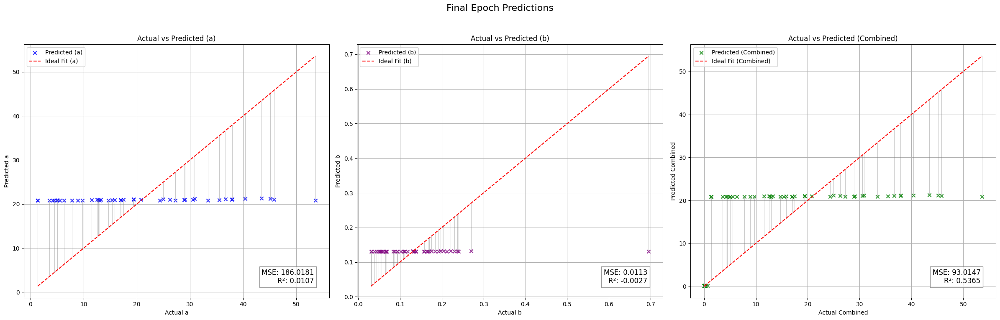

Validation Metrics:
  - MSE: 92.7224
  - R²: 0.0058
  - MAE: 5.8614
  - Explained Variance Score (EVS): 0.0092
Fold 4 Metrics:
  - Validation Loss (MSE): 92.7224
  - R²: 0.0058
  - MAE: 5.8614
  - EVS: 0.0092
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.426]


Validation Metrics:
  - MSE: 180.4313
  - R²: 0.0041
  - MAE: 6.6917
  - Explained Variance Score (EVS): 0.0118
Epoch [1/50], Train Loss: 0.4111, Val Loss: 180.4313
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.461]


Validation Metrics:
  - MSE: 180.7842
  - R²: 0.0026
  - MAE: 6.6991
  - Explained Variance Score (EVS): 0.0104
Epoch [2/50], Train Loss: 0.4144, Val Loss: 180.7842
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.83it/s, loss=0.466]


Validation Metrics:
  - MSE: 181.1315
  - R²: 0.0006
  - MAE: 6.7064
  - Explained Variance Score (EVS): 0.0085
Epoch [3/50], Train Loss: 0.4154, Val Loss: 181.1315
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.38it/s, loss=0.42]


Validation Metrics:
  - MSE: 181.4094
  - R²: -0.0009
  - MAE: 6.7134
  - Explained Variance Score (EVS): 0.0070
Epoch [4/50], Train Loss: 0.4122, Val Loss: 181.4094
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=0.427]


Validation Metrics:
  - MSE: 181.5280
  - R²: -0.0016
  - MAE: 6.7176
  - Explained Variance Score (EVS): 0.0062
Epoch [5/50], Train Loss: 0.4132, Val Loss: 181.5280
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.447]


Validation Metrics:
  - MSE: 181.5629
  - R²: -0.0019
  - MAE: 6.7196
  - Explained Variance Score (EVS): 0.0058
Epoch [6/50], Train Loss: 0.4151, Val Loss: 181.5629
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.40it/s, loss=0.42]


Validation Metrics:
  - MSE: 181.6202
  - R²: -0.0022
  - MAE: 6.7218
  - Explained Variance Score (EVS): 0.0055
Epoch [7/50], Train Loss: 0.4129, Val Loss: 181.6202
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.77it/s, loss=0.372]


Validation Metrics:
  - MSE: 181.6830
  - R²: -0.0025
  - MAE: 6.7240
  - Explained Variance Score (EVS): 0.0051
Epoch [8/50], Train Loss: 0.4089, Val Loss: 181.6830
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.81it/s, loss=0.347]


Validation Metrics:
  - MSE: 181.7175
  - R²: -0.0027
  - MAE: 6.7256
  - Explained Variance Score (EVS): 0.0049
Epoch [9/50], Train Loss: 0.4069, Val Loss: 181.7175
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.48]


Validation Metrics:
  - MSE: 181.7802
  - R²: -0.0029
  - MAE: 6.7265
  - Explained Variance Score (EVS): 0.0046
Epoch [10/50], Train Loss: 0.4180, Val Loss: 181.7802
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.15it/s, loss=0.626]


Validation Metrics:
  - MSE: 181.8362
  - R²: -0.0031
  - MAE: 6.7287
  - Explained Variance Score (EVS): 0.0044
Epoch [11/50], Train Loss: 0.4302, Val Loss: 181.8362
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


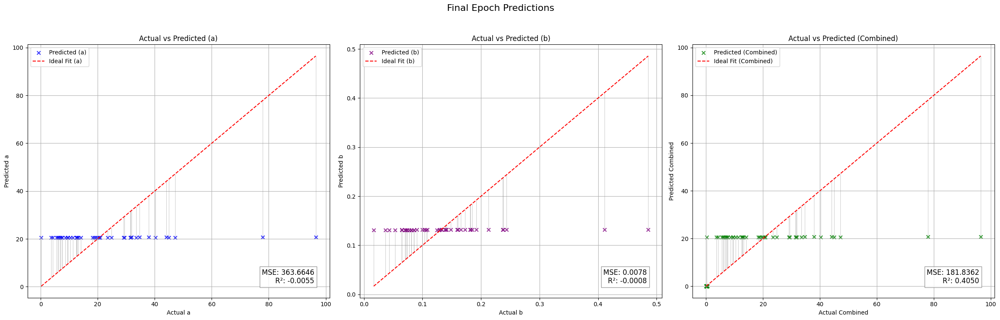

[I 2024-12-01 17:35:27,249] Trial 26 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 180.4313
  - R²: 0.0041
  - MAE: 6.6917
  - Explained Variance Score (EVS): 0.0118
Fold 5 Metrics:
  - Validation Loss (MSE): 180.4313
  - R²: 0.0041
  - MAE: 6.6917
  - EVS: 0.0118
Avg Validation Metrics:
  - MSE: 135.5428
  - R²: -0.0241
  - MAE: 6.0852
  - EVS: 0.0055
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.27it/s, loss=1.35]


Validation Metrics:
  - MSE: 187.8156
  - R²: 0.0328
  - MAE: 6.3516
  - Explained Variance Score (EVS): 0.0423
Epoch [1/50], Train Loss: 1.4207, Val Loss: 187.8156
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.50it/s, loss=1.33]


Validation Metrics:
  - MSE: 183.3517
  - R²: 0.0488
  - MAE: 6.2838
  - Explained Variance Score (EVS): 0.0582
Epoch [2/50], Train Loss: 1.2750, Val Loss: 183.3517
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=1.2]


Validation Metrics:
  - MSE: 183.2992
  - R²: 0.0520
  - MAE: 6.2733
  - Explained Variance Score (EVS): 0.0634
Epoch [3/50], Train Loss: 1.2342, Val Loss: 183.2992
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=1.12]


Validation Metrics:
  - MSE: 185.3254
  - R²: 0.0515
  - MAE: 6.2811
  - Explained Variance Score (EVS): 0.0644
Epoch [4/50], Train Loss: 1.1706, Val Loss: 185.3254
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.77it/s, loss=1.18]


Validation Metrics:
  - MSE: 183.4119
  - R²: 0.0652
  - MAE: 6.2233
  - Explained Variance Score (EVS): 0.0784
Epoch [5/50], Train Loss: 1.1593, Val Loss: 183.4119
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.42it/s, loss=1.09]


Validation Metrics:
  - MSE: 177.1802
  - R²: 0.0917
  - MAE: 6.1097
  - Explained Variance Score (EVS): 0.1036
Epoch [6/50], Train Loss: 1.1270, Val Loss: 177.1802
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.12it/s, loss=1.11]


Validation Metrics:
  - MSE: 170.8648
  - R²: 0.1191
  - MAE: 5.9857
  - Explained Variance Score (EVS): 0.1304
Epoch [7/50], Train Loss: 1.0994, Val Loss: 170.8648
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=1.1]


Validation Metrics:
  - MSE: 166.4702
  - R²: 0.1473
  - MAE: 5.8941
  - Explained Variance Score (EVS): 0.1584
Epoch [8/50], Train Loss: 1.0905, Val Loss: 166.4702
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.78it/s, loss=1.07]


Validation Metrics:
  - MSE: 162.8746
  - R²: 0.1691
  - MAE: 5.8261
  - Explained Variance Score (EVS): 0.1812
Epoch [9/50], Train Loss: 1.0543, Val Loss: 162.8746
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.39it/s, loss=1.02]


Validation Metrics:
  - MSE: 157.8489
  - R²: 0.1853
  - MAE: 5.7421
  - Explained Variance Score (EVS): 0.1983
Epoch [10/50], Train Loss: 1.0201, Val Loss: 157.8489
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.73it/s, loss=1.02]


Validation Metrics:
  - MSE: 152.8554
  - R²: 0.2160
  - MAE: 5.6027
  - Explained Variance Score (EVS): 0.2296
Epoch [11/50], Train Loss: 1.0169, Val Loss: 152.8554
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.31it/s, loss=0.948]


Validation Metrics:
  - MSE: 145.1458
  - R²: 0.2627
  - MAE: 5.4141
  - Explained Variance Score (EVS): 0.2728
Epoch [12/50], Train Loss: 0.9968, Val Loss: 145.1458
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  4.34it/s, loss=0.893]


Validation Metrics:
  - MSE: 135.0502
  - R²: 0.3044
  - MAE: 5.2005
  - Explained Variance Score (EVS): 0.3119
Epoch [13/50], Train Loss: 0.9465, Val Loss: 135.0502
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.51it/s, loss=0.929]


Validation Metrics:
  - MSE: 127.0046
  - R²: 0.3321
  - MAE: 5.0658
  - Explained Variance Score (EVS): 0.3412
Epoch [14/50], Train Loss: 0.9259, Val Loss: 127.0046
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.33it/s, loss=0.98]


Validation Metrics:
  - MSE: 130.0916
  - R²: 0.3405
  - MAE: 5.0524
  - Explained Variance Score (EVS): 0.3549
Epoch [15/50], Train Loss: 0.9205, Val Loss: 130.0916
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.904]


Validation Metrics:
  - MSE: 125.3653
  - R²: 0.3882
  - MAE: 4.8995
  - Explained Variance Score (EVS): 0.4010
Epoch [16/50], Train Loss: 0.8817, Val Loss: 125.3653
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.848]


Validation Metrics:
  - MSE: 109.4825
  - R²: 0.4680
  - MAE: 4.5954
  - Explained Variance Score (EVS): 0.4757
Epoch [17/50], Train Loss: 0.8480, Val Loss: 109.4825
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=0.841]


Validation Metrics:
  - MSE: 94.1942
  - R²: 0.5191
  - MAE: 4.2609
  - Explained Variance Score (EVS): 0.5296
Epoch [18/50], Train Loss: 0.8229, Val Loss: 94.1942
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  5.17it/s, loss=0.834]


Validation Metrics:
  - MSE: 82.4679
  - R²: 0.5583
  - MAE: 3.9698
  - Explained Variance Score (EVS): 0.5746
Epoch [19/50], Train Loss: 0.7974, Val Loss: 82.4679
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=0.778]


Validation Metrics:
  - MSE: 76.2004
  - R²: 0.6138
  - MAE: 3.8299
  - Explained Variance Score (EVS): 0.6245
Epoch [20/50], Train Loss: 0.7746, Val Loss: 76.2004
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.779]


Validation Metrics:
  - MSE: 79.8565
  - R²: 0.6151
  - MAE: 3.7905
  - Explained Variance Score (EVS): 0.6226
Epoch [21/50], Train Loss: 0.7579, Val Loss: 79.8565
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  5.75it/s, loss=0.679]


Validation Metrics:
  - MSE: 82.0894
  - R²: 0.6046
  - MAE: 3.8865
  - Explained Variance Score (EVS): 0.6096
Epoch [22/50], Train Loss: 0.7321, Val Loss: 82.0894
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.691]


Validation Metrics:
  - MSE: 81.8619
  - R²: 0.5912
  - MAE: 3.9527
  - Explained Variance Score (EVS): 0.5981
Epoch [23/50], Train Loss: 0.7180, Val Loss: 81.8619
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  4.60it/s, loss=0.694]


Validation Metrics:
  - MSE: 74.2804
  - R²: 0.6273
  - MAE: 4.0055
  - Explained Variance Score (EVS): 0.6344
Epoch [24/50], Train Loss: 0.6767, Val Loss: 74.2804
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=0.668]


Validation Metrics:
  - MSE: 69.1206
  - R²: 0.6541
  - MAE: 3.9378
  - Explained Variance Score (EVS): 0.6621
Epoch [25/50], Train Loss: 0.6506, Val Loss: 69.1206
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s, loss=0.666]


Validation Metrics:
  - MSE: 66.5156
  - R²: 0.6921
  - MAE: 3.8236
  - Explained Variance Score (EVS): 0.6940
Epoch [26/50], Train Loss: 0.6274, Val Loss: 66.5156
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  4.63it/s, loss=0.57]


Validation Metrics:
  - MSE: 66.8677
  - R²: 0.6979
  - MAE: 3.7770
  - Explained Variance Score (EVS): 0.6998
Epoch [27/50], Train Loss: 0.5966, Val Loss: 66.8677
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  4.28it/s, loss=0.604]


Validation Metrics:
  - MSE: 67.5717
  - R²: 0.6806
  - MAE: 3.7084
  - Explained Variance Score (EVS): 0.6853
Epoch [28/50], Train Loss: 0.5773, Val Loss: 67.5717
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  4.56it/s, loss=0.526]


Validation Metrics:
  - MSE: 60.4383
  - R²: 0.7014
  - MAE: 3.5737
  - Explained Variance Score (EVS): 0.7084
Epoch [29/50], Train Loss: 0.5513, Val Loss: 60.4383
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.44it/s, loss=0.495]


Validation Metrics:
  - MSE: 62.3323
  - R²: 0.6973
  - MAE: 3.4364
  - Explained Variance Score (EVS): 0.7049
Epoch [30/50], Train Loss: 0.5200, Val Loss: 62.3323
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.49]


Validation Metrics:
  - MSE: 68.3539
  - R²: 0.6857
  - MAE: 3.5346
  - Explained Variance Score (EVS): 0.6927
Epoch [31/50], Train Loss: 0.5037, Val Loss: 68.3539
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  5.56it/s, loss=0.471]


Validation Metrics:
  - MSE: 70.6576
  - R²: 0.6703
  - MAE: 3.6896
  - Explained Variance Score (EVS): 0.6736
Epoch [32/50], Train Loss: 0.4768, Val Loss: 70.6576
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  5.71it/s, loss=0.418]


Validation Metrics:
  - MSE: 67.3556
  - R²: 0.6627
  - MAE: 3.6647
  - Explained Variance Score (EVS): 0.6691
Epoch [33/50], Train Loss: 0.4523, Val Loss: 67.3556
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.407]


Validation Metrics:
  - MSE: 61.3844
  - R²: 0.6869
  - MAE: 3.5887
  - Explained Variance Score (EVS): 0.6938
Epoch [34/50], Train Loss: 0.4259, Val Loss: 61.3844
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=0.461]


Validation Metrics:
  - MSE: 58.8153
  - R²: 0.6990
  - MAE: 3.4657
  - Explained Variance Score (EVS): 0.7054
Epoch [35/50], Train Loss: 0.4139, Val Loss: 58.8153
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  5.08it/s, loss=0.352]


Validation Metrics:
  - MSE: 59.3164
  - R²: 0.7058
  - MAE: 3.4713
  - Explained Variance Score (EVS): 0.7141
Epoch [36/50], Train Loss: 0.4194, Val Loss: 59.3164
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  5.53it/s, loss=0.364]


Validation Metrics:
  - MSE: 58.8864
  - R²: 0.7145
  - MAE: 3.5946
  - Explained Variance Score (EVS): 0.7173
Epoch [37/50], Train Loss: 0.3678, Val Loss: 58.8864
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.343]


Validation Metrics:
  - MSE: 57.9041
  - R²: 0.7112
  - MAE: 3.6272
  - Explained Variance Score (EVS): 0.7126
Epoch [38/50], Train Loss: 0.3620, Val Loss: 57.9041
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.427]


Validation Metrics:
  - MSE: 66.5677
  - R²: 0.6461
  - MAE: 3.6301
  - Explained Variance Score (EVS): 0.6589
Epoch [39/50], Train Loss: 0.3568, Val Loss: 66.5677
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.315]


Validation Metrics:
  - MSE: 73.9293
  - R²: 0.6222
  - MAE: 3.6886
  - Explained Variance Score (EVS): 0.6348
Epoch [40/50], Train Loss: 0.3224, Val Loss: 73.9293
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=0.294]


Validation Metrics:
  - MSE: 69.9390
  - R²: 0.6554
  - MAE: 3.6704
  - Explained Variance Score (EVS): 0.6601
Epoch [41/50], Train Loss: 0.3089, Val Loss: 69.9390
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.286]


Validation Metrics:
  - MSE: 61.0985
  - R²: 0.7019
  - MAE: 3.6843
  - Explained Variance Score (EVS): 0.7021
Epoch [42/50], Train Loss: 0.2908, Val Loss: 61.0985
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  4.44it/s, loss=0.252]


Validation Metrics:
  - MSE: 50.9566
  - R²: 0.7445
  - MAE: 3.6172
  - Explained Variance Score (EVS): 0.7456
Epoch [43/50], Train Loss: 0.2724, Val Loss: 50.9566
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=0.271]


Validation Metrics:
  - MSE: 52.7818
  - R²: 0.7318
  - MAE: 3.5046
  - Explained Variance Score (EVS): 0.7341
Epoch [44/50], Train Loss: 0.2645, Val Loss: 52.7818
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  4.41it/s, loss=0.257]


Validation Metrics:
  - MSE: 64.8791
  - R²: 0.6828
  - MAE: 3.5384
  - Explained Variance Score (EVS): 0.6899
Epoch [45/50], Train Loss: 0.2496, Val Loss: 64.8791
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  5.47it/s, loss=0.2]


Validation Metrics:
  - MSE: 68.9163
  - R²: 0.6692
  - MAE: 3.5260
  - Explained Variance Score (EVS): 0.6822
Epoch [46/50], Train Loss: 0.2327, Val Loss: 68.9163
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s, loss=0.251]


Validation Metrics:
  - MSE: 67.1429
  - R²: 0.6565
  - MAE: 3.5675
  - Explained Variance Score (EVS): 0.6753
Epoch [47/50], Train Loss: 0.2275, Val Loss: 67.1429
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 3/3 [00:00<00:00,  5.21it/s, loss=0.184]


Validation Metrics:
  - MSE: 58.9711
  - R²: 0.6922
  - MAE: 3.5522
  - Explained Variance Score (EVS): 0.6993
Epoch [48/50], Train Loss: 0.2056, Val Loss: 58.9711
Current Dropout Rate: 0.1240


Epoch 49/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=0.226]


Validation Metrics:
  - MSE: 56.8118
  - R²: 0.7099
  - MAE: 3.6236
  - Explained Variance Score (EVS): 0.7103
Epoch [49/50], Train Loss: 0.2018, Val Loss: 56.8118
Current Dropout Rate: 0.1160


Epoch 50/50: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s, loss=0.163]


Validation Metrics:
  - MSE: 61.4305
  - R²: 0.6955
  - MAE: 3.6264
  - Explained Variance Score (EVS): 0.6968
Epoch [50/50], Train Loss: 0.1936, Val Loss: 61.4305
Current Dropout Rate: 0.1080
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


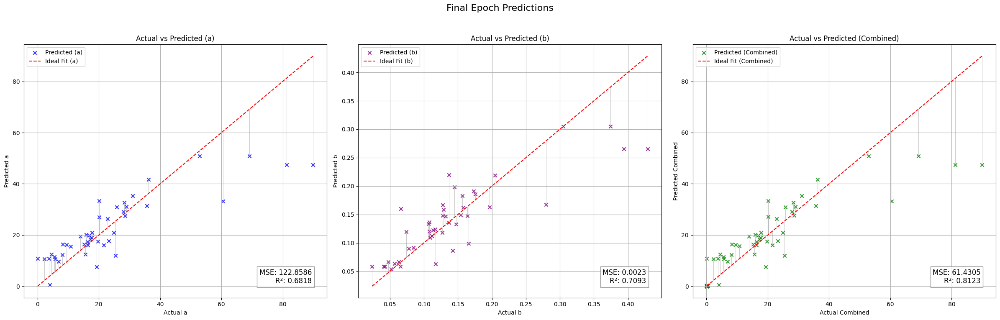

Validation Metrics:
  - MSE: 50.9566
  - R²: 0.7445
  - MAE: 3.6172
  - Explained Variance Score (EVS): 0.7456
Fold 1 Metrics:
  - Validation Loss (MSE): 50.9566
  - R²: 0.7445
  - MAE: 3.6172
  - EVS: 0.7456
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.66it/s, loss=0.313]


Validation Metrics:
  - MSE: 2.6009
  - R²: 0.9659
  - MAE: 0.8639
  - Explained Variance Score (EVS): 0.9685
Epoch [1/50], Train Loss: 0.3310, Val Loss: 2.6009
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.80it/s, loss=0.287]


Validation Metrics:
  - MSE: 3.2521
  - R²: 0.9548
  - MAE: 0.9202
  - Explained Variance Score (EVS): 0.9599
Epoch [2/50], Train Loss: 0.2994, Val Loss: 3.2521
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.51it/s, loss=0.26]


Validation Metrics:
  - MSE: 3.8133
  - R²: 0.9484
  - MAE: 1.0334
  - Explained Variance Score (EVS): 0.9518
Epoch [3/50], Train Loss: 0.2811, Val Loss: 3.8133
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.264]


Validation Metrics:
  - MSE: 3.9445
  - R²: 0.9348
  - MAE: 1.0805
  - Explained Variance Score (EVS): 0.9366
Epoch [4/50], Train Loss: 0.2675, Val Loss: 3.9445
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.258]


Validation Metrics:
  - MSE: 5.3544
  - R²: 0.9287
  - MAE: 1.3135
  - Explained Variance Score (EVS): 0.9332
Epoch [5/50], Train Loss: 0.2646, Val Loss: 5.3544
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.238]


Validation Metrics:
  - MSE: 5.4858
  - R²: 0.9322
  - MAE: 1.3399
  - Explained Variance Score (EVS): 0.9357
Epoch [6/50], Train Loss: 0.2615, Val Loss: 5.4858
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.208]


Validation Metrics:
  - MSE: 4.7090
  - R²: 0.9375
  - MAE: 1.2071
  - Explained Variance Score (EVS): 0.9398
Epoch [7/50], Train Loss: 0.2416, Val Loss: 4.7090
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.51it/s, loss=0.251]


Validation Metrics:
  - MSE: 4.6061
  - R²: 0.9348
  - MAE: 1.1512
  - Explained Variance Score (EVS): 0.9367
Epoch [8/50], Train Loss: 0.2254, Val Loss: 4.6061
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.238]


Validation Metrics:
  - MSE: 4.6385
  - R²: 0.9149
  - MAE: 1.1508
  - Explained Variance Score (EVS): 0.9268
Epoch [9/50], Train Loss: 0.2472, Val Loss: 4.6385
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.82it/s, loss=0.224]


Validation Metrics:
  - MSE: 4.8124
  - R²: 0.9087
  - MAE: 1.1809
  - Explained Variance Score (EVS): 0.9177
Epoch [10/50], Train Loss: 0.2146, Val Loss: 4.8124
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.13it/s, loss=0.195]


Validation Metrics:
  - MSE: 4.7241
  - R²: 0.9271
  - MAE: 1.1556
  - Explained Variance Score (EVS): 0.9292
Epoch [11/50], Train Loss: 0.2123, Val Loss: 4.7241
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


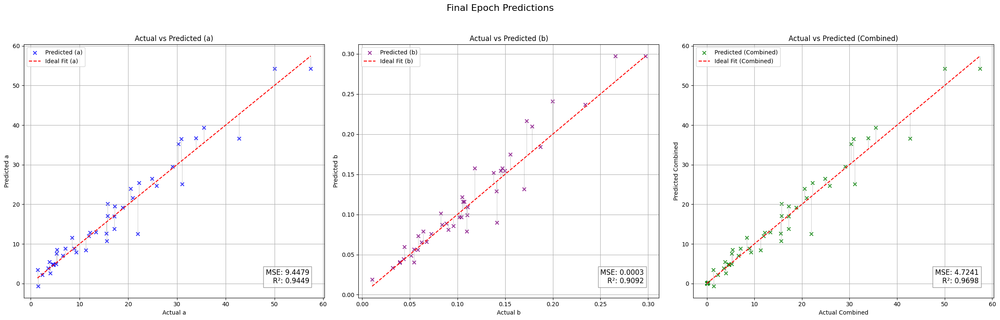

Validation Metrics:
  - MSE: 2.6009
  - R²: 0.9659
  - MAE: 0.8639
  - Explained Variance Score (EVS): 0.9685
Fold 2 Metrics:
  - Validation Loss (MSE): 2.6009
  - R²: 0.9659
  - MAE: 0.8639
  - EVS: 0.9685
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  5.29it/s, loss=0.271]


Validation Metrics:
  - MSE: 13.9134
  - R²: 0.8763
  - MAE: 1.2380
  - Explained Variance Score (EVS): 0.8798
Epoch [1/50], Train Loss: 0.2990, Val Loss: 13.9134
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.22it/s, loss=0.301]


Validation Metrics:
  - MSE: 14.4854
  - R²: 0.8654
  - MAE: 1.2939
  - Explained Variance Score (EVS): 0.8691
Epoch [2/50], Train Loss: 0.2859, Val Loss: 14.4854
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.3]


Validation Metrics:
  - MSE: 15.1437
  - R²: 0.8541
  - MAE: 1.3477
  - Explained Variance Score (EVS): 0.8564
Epoch [3/50], Train Loss: 0.2781, Val Loss: 15.1437
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=0.288]


Validation Metrics:
  - MSE: 14.9617
  - R²: 0.8505
  - MAE: 1.3140
  - Explained Variance Score (EVS): 0.8525
Epoch [4/50], Train Loss: 0.2837, Val Loss: 14.9617
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.13it/s, loss=0.298]


Validation Metrics:
  - MSE: 15.0951
  - R²: 0.8451
  - MAE: 1.3064
  - Explained Variance Score (EVS): 0.8474
Epoch [5/50], Train Loss: 0.2787, Val Loss: 15.0951
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.35it/s, loss=0.257]


Validation Metrics:
  - MSE: 15.5065
  - R²: 0.8370
  - MAE: 1.3377
  - Explained Variance Score (EVS): 0.8406
Epoch [6/50], Train Loss: 0.2576, Val Loss: 15.5065
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  3.87it/s, loss=0.249]


Validation Metrics:
  - MSE: 16.2666
  - R²: 0.8298
  - MAE: 1.3023
  - Explained Variance Score (EVS): 0.8318
Epoch [7/50], Train Loss: 0.2493, Val Loss: 16.2666
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.37it/s, loss=0.227]


Validation Metrics:
  - MSE: 17.8399
  - R²: 0.8279
  - MAE: 1.3793
  - Explained Variance Score (EVS): 0.8316
Epoch [8/50], Train Loss: 0.2561, Val Loss: 17.8399
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.61it/s, loss=0.219]


Validation Metrics:
  - MSE: 18.4478
  - R²: 0.8309
  - MAE: 1.4007
  - Explained Variance Score (EVS): 0.8338
Epoch [9/50], Train Loss: 0.2297, Val Loss: 18.4478
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:01<00:00,  1.74it/s, loss=0.26]


Validation Metrics:
  - MSE: 17.9041
  - R²: 0.8323
  - MAE: 1.3953
  - Explained Variance Score (EVS): 0.8341
Epoch [10/50], Train Loss: 0.2248, Val Loss: 17.9041
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s, loss=0.235]


Validation Metrics:
  - MSE: 17.0519
  - R²: 0.8438
  - MAE: 1.3542
  - Explained Variance Score (EVS): 0.8444
Epoch [11/50], Train Loss: 0.2372, Val Loss: 17.0519
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


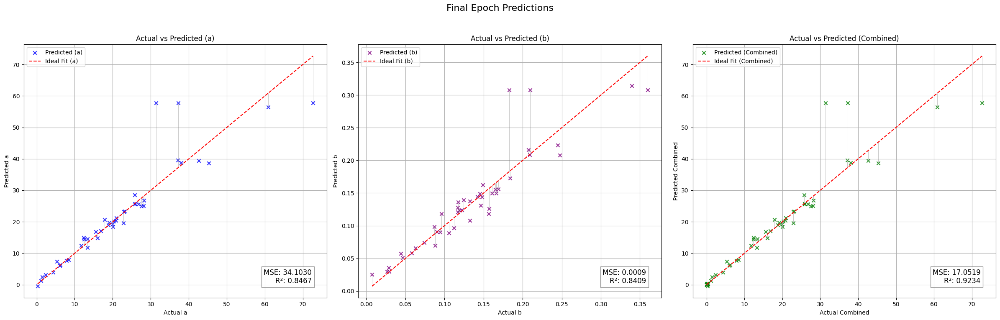

Validation Metrics:
  - MSE: 13.9134
  - R²: 0.8763
  - MAE: 1.2380
  - Explained Variance Score (EVS): 0.8798
Fold 3 Metrics:
  - Validation Loss (MSE): 13.9134
  - R²: 0.8763
  - MAE: 1.2380
  - EVS: 0.8798
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.366]


Validation Metrics:
  - MSE: 11.1764
  - R²: 0.9264
  - MAE: 1.0893
  - Explained Variance Score (EVS): 0.9313
Epoch [1/50], Train Loss: 0.3027, Val Loss: 11.1764
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.268]


Validation Metrics:
  - MSE: 11.5807
  - R²: 0.9210
  - MAE: 1.1287
  - Explained Variance Score (EVS): 0.9281
Epoch [2/50], Train Loss: 0.2869, Val Loss: 11.5807
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=0.25]


Validation Metrics:
  - MSE: 11.8862
  - R²: 0.9153
  - MAE: 1.1490
  - Explained Variance Score (EVS): 0.9238
Epoch [3/50], Train Loss: 0.2796, Val Loss: 11.8862
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.93it/s, loss=0.269]


Validation Metrics:
  - MSE: 12.3591
  - R²: 0.9090
  - MAE: 1.1376
  - Explained Variance Score (EVS): 0.9170
Epoch [4/50], Train Loss: 0.2789, Val Loss: 12.3591
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.43it/s, loss=0.245]


Validation Metrics:
  - MSE: 13.7769
  - R²: 0.8977
  - MAE: 1.1795
  - Explained Variance Score (EVS): 0.9073
Epoch [5/50], Train Loss: 0.2660, Val Loss: 13.7769
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.47it/s, loss=0.278]


Validation Metrics:
  - MSE: 14.8537
  - R²: 0.8896
  - MAE: 1.1643
  - Explained Variance Score (EVS): 0.8974
Epoch [6/50], Train Loss: 0.2549, Val Loss: 14.8537
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.238]


Validation Metrics:
  - MSE: 18.0121
  - R²: 0.8675
  - MAE: 1.2798
  - Explained Variance Score (EVS): 0.8780
Epoch [7/50], Train Loss: 0.2678, Val Loss: 18.0121
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.39it/s, loss=0.239]


Validation Metrics:
  - MSE: 19.9115
  - R²: 0.8551
  - MAE: 1.3455
  - Explained Variance Score (EVS): 0.8661
Epoch [8/50], Train Loss: 0.2492, Val Loss: 19.9115
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.66it/s, loss=0.246]


Validation Metrics:
  - MSE: 20.9863
  - R²: 0.8481
  - MAE: 1.4021
  - Explained Variance Score (EVS): 0.8579
Epoch [9/50], Train Loss: 0.2408, Val Loss: 20.9863
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.76it/s, loss=0.278]


Validation Metrics:
  - MSE: 20.1823
  - R²: 0.8533
  - MAE: 1.4141
  - Explained Variance Score (EVS): 0.8611
Epoch [10/50], Train Loss: 0.2485, Val Loss: 20.1823
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.237]


Validation Metrics:
  - MSE: 19.6551
  - R²: 0.8568
  - MAE: 1.3724
  - Explained Variance Score (EVS): 0.8654
Epoch [11/50], Train Loss: 0.2431, Val Loss: 19.6551
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


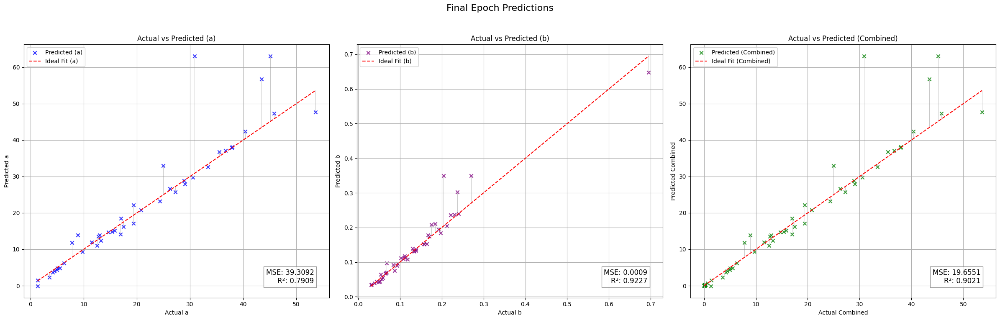

Validation Metrics:
  - MSE: 11.1764
  - R²: 0.9264
  - MAE: 1.0893
  - Explained Variance Score (EVS): 0.9313
Fold 4 Metrics:
  - Validation Loss (MSE): 11.1764
  - R²: 0.9264
  - MAE: 1.0893
  - EVS: 0.9313
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.301]


Validation Metrics:
  - MSE: 32.2171
  - R²: 0.8379
  - MAE: 1.4302
  - Explained Variance Score (EVS): 0.8469
Epoch [1/50], Train Loss: 0.2808, Val Loss: 32.2171
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s, loss=0.254]


Validation Metrics:
  - MSE: 32.0069
  - R²: 0.8390
  - MAE: 1.4008
  - Explained Variance Score (EVS): 0.8459
Epoch [2/50], Train Loss: 0.2831, Val Loss: 32.0069
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.94it/s, loss=0.242]


Validation Metrics:
  - MSE: 32.1689
  - R²: 0.8381
  - MAE: 1.3661
  - Explained Variance Score (EVS): 0.8448
Epoch [3/50], Train Loss: 0.2830, Val Loss: 32.1689
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.308]


Validation Metrics:
  - MSE: 32.4586
  - R²: 0.8369
  - MAE: 1.3508
  - Explained Variance Score (EVS): 0.8439
Epoch [4/50], Train Loss: 0.2829, Val Loss: 32.4586
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s, loss=0.24]


Validation Metrics:
  - MSE: 32.5787
  - R²: 0.8367
  - MAE: 1.3498
  - Explained Variance Score (EVS): 0.8434
Epoch [5/50], Train Loss: 0.2638, Val Loss: 32.5787
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.48it/s, loss=0.249]


Validation Metrics:
  - MSE: 33.3676
  - R²: 0.8333
  - MAE: 1.3739
  - Explained Variance Score (EVS): 0.8403
Epoch [6/50], Train Loss: 0.2735, Val Loss: 33.3676
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.23it/s, loss=0.259]


Validation Metrics:
  - MSE: 33.3040
  - R²: 0.8343
  - MAE: 1.3666
  - Explained Variance Score (EVS): 0.8401
Epoch [7/50], Train Loss: 0.2564, Val Loss: 33.3040
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.45it/s, loss=0.246]


Validation Metrics:
  - MSE: 32.7017
  - R²: 0.8365
  - MAE: 1.3572
  - Explained Variance Score (EVS): 0.8416
Epoch [8/50], Train Loss: 0.2595, Val Loss: 32.7017
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.47it/s, loss=0.222]


Validation Metrics:
  - MSE: 32.4472
  - R²: 0.8377
  - MAE: 1.3612
  - Explained Variance Score (EVS): 0.8422
Epoch [9/50], Train Loss: 0.2495, Val Loss: 32.4472
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=0.291]


Validation Metrics:
  - MSE: 32.5023
  - R²: 0.8369
  - MAE: 1.3599
  - Explained Variance Score (EVS): 0.8412
Epoch [10/50], Train Loss: 0.2503, Val Loss: 32.5023
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.71it/s, loss=0.22]


Validation Metrics:
  - MSE: 32.4300
  - R²: 0.8371
  - MAE: 1.3743
  - Explained Variance Score (EVS): 0.8420
Epoch [11/50], Train Loss: 0.2357, Val Loss: 32.4300
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s, loss=0.267]


Validation Metrics:
  - MSE: 32.3063
  - R²: 0.8377
  - MAE: 1.3603
  - Explained Variance Score (EVS): 0.8422
Epoch [12/50], Train Loss: 0.2495, Val Loss: 32.3063
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


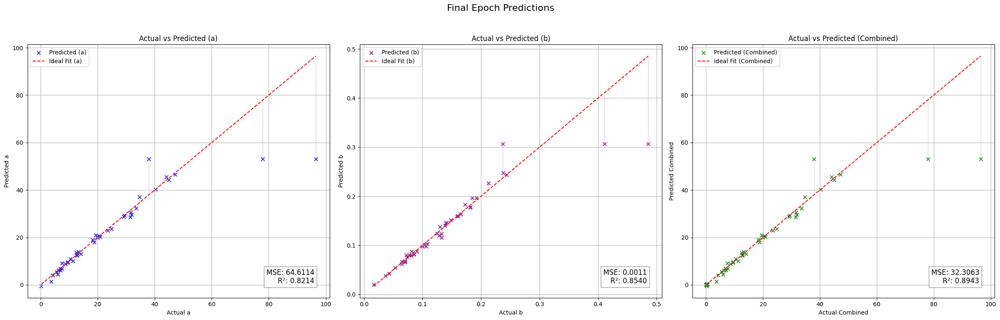

[I 2024-12-01 17:37:36,888] Trial 27 finished with value: 22.130863189697266 and parameters: {'num_layers': 1, 'hidden_size_0': 440, 'activation_0': 'ReLU', 'dropout_0': 0.4507788080640328, 'batch_size': 64, 'learning_rate': 3.794114158597288e-05, 'optimizer': 'AdamW'}. Best is trial 27 with value: 22.130863189697266.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.0069
  - R²: 0.8390
  - MAE: 1.4008
  - Explained Variance Score (EVS): 0.8459
Fold 5 Metrics:
  - Validation Loss (MSE): 32.0069
  - R²: 0.8390
  - MAE: 1.4008
  - EVS: 0.8459
Avg Validation Metrics:
  - MSE: 22.1309
  - R²: 0.8704
  - MAE: 1.6418
  - EVS: 0.8742
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=1.88]


Validation Metrics:
  - MSE: 189.9132
  - R²: 0.0296
  - MAE: 6.3977
  - Explained Variance Score (EVS): 0.0390
Epoch [1/50], Train Loss: 1.9464, Val Loss: 189.9132
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=1.93]


Validation Metrics:
  - MSE: 185.9559
  - R²: 0.0465
  - MAE: 6.2842
  - Explained Variance Score (EVS): 0.0577
Epoch [2/50], Train Loss: 1.8669, Val Loss: 185.9559
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=1.73]


Validation Metrics:
  - MSE: 184.6414
  - R²: 0.0474
  - MAE: 6.2086
  - Explained Variance Score (EVS): 0.0612
Epoch [3/50], Train Loss: 1.7759, Val Loss: 184.6414
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s, loss=1.73]


Validation Metrics:
  - MSE: 183.3770
  - R²: 0.0595
  - MAE: 6.1637
  - Explained Variance Score (EVS): 0.0748
Epoch [4/50], Train Loss: 1.7434, Val Loss: 183.3770
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=1.76]


Validation Metrics:
  - MSE: 181.2845
  - R²: 0.0815
  - MAE: 6.0795
  - Explained Variance Score (EVS): 0.1008
Epoch [5/50], Train Loss: 1.7349, Val Loss: 181.2845
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=1.69]


Validation Metrics:
  - MSE: 174.8984
  - R²: 0.1125
  - MAE: 5.9190
  - Explained Variance Score (EVS): 0.1352
Epoch [6/50], Train Loss: 1.6769, Val Loss: 174.8984
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.23it/s, loss=1.67]


Validation Metrics:
  - MSE: 170.8412
  - R²: 0.1303
  - MAE: 5.8093
  - Explained Variance Score (EVS): 0.1516
Epoch [7/50], Train Loss: 1.6730, Val Loss: 170.8412
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.03it/s, loss=1.66]


Validation Metrics:
  - MSE: 167.7086
  - R²: 0.1429
  - MAE: 5.7031
  - Explained Variance Score (EVS): 0.1665
Epoch [8/50], Train Loss: 1.6461, Val Loss: 167.7086
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.02it/s, loss=1.67]


Validation Metrics:
  - MSE: 163.5479
  - R²: 0.1628
  - MAE: 5.6194
  - Explained Variance Score (EVS): 0.1897
Epoch [9/50], Train Loss: 1.6213, Val Loss: 163.5479
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.57it/s, loss=1.54]


Validation Metrics:
  - MSE: 156.6752
  - R²: 0.1962
  - MAE: 5.4687
  - Explained Variance Score (EVS): 0.2237
Epoch [10/50], Train Loss: 1.5852, Val Loss: 156.6752
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.20it/s, loss=1.57]


Validation Metrics:
  - MSE: 148.3761
  - R²: 0.2478
  - MAE: 5.2398
  - Explained Variance Score (EVS): 0.2751
Epoch [11/50], Train Loss: 1.5763, Val Loss: 148.3761
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.35it/s, loss=1.58]


Validation Metrics:
  - MSE: 144.2712
  - R²: 0.2764
  - MAE: 5.0989
  - Explained Variance Score (EVS): 0.3018
Epoch [12/50], Train Loss: 1.5386, Val Loss: 144.2712
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  5.36it/s, loss=1.49]


Validation Metrics:
  - MSE: 135.7268
  - R²: 0.3300
  - MAE: 4.9776
  - Explained Variance Score (EVS): 0.3511
Epoch [13/50], Train Loss: 1.5173, Val Loss: 135.7268
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=1.54]


Validation Metrics:
  - MSE: 128.0486
  - R²: 0.3646
  - MAE: 4.9020
  - Explained Variance Score (EVS): 0.3837
Epoch [14/50], Train Loss: 1.5063, Val Loss: 128.0486
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=1.47]


Validation Metrics:
  - MSE: 115.8560
  - R²: 0.4001
  - MAE: 4.7398
  - Explained Variance Score (EVS): 0.4224
Epoch [15/50], Train Loss: 1.4535, Val Loss: 115.8560
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=1.44]


Validation Metrics:
  - MSE: 105.4452
  - R²: 0.4577
  - MAE: 4.5237
  - Explained Variance Score (EVS): 0.4793
Epoch [16/50], Train Loss: 1.4385, Val Loss: 105.4452
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=1.4]


Validation Metrics:
  - MSE: 91.8086
  - R²: 0.5423
  - MAE: 4.1994
  - Explained Variance Score (EVS): 0.5548
Epoch [17/50], Train Loss: 1.4002, Val Loss: 91.8086
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=1.41]


Validation Metrics:
  - MSE: 89.6540
  - R²: 0.5578
  - MAE: 4.0129
  - Explained Variance Score (EVS): 0.5728
Epoch [18/50], Train Loss: 1.3870, Val Loss: 89.6540
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.33it/s, loss=1.35]


Validation Metrics:
  - MSE: 91.2585
  - R²: 0.5471
  - MAE: 3.9222
  - Explained Variance Score (EVS): 0.5692
Epoch [19/50], Train Loss: 1.3416, Val Loss: 91.2585
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  4.64it/s, loss=1.34]


Validation Metrics:
  - MSE: 95.4367
  - R²: 0.5470
  - MAE: 3.9252
  - Explained Variance Score (EVS): 0.5753
Epoch [20/50], Train Loss: 1.3094, Val Loss: 95.4367
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  4.40it/s, loss=1.28]


Validation Metrics:
  - MSE: 97.7698
  - R²: 0.5644
  - MAE: 3.8959
  - Explained Variance Score (EVS): 0.5881
Epoch [21/50], Train Loss: 1.2847, Val Loss: 97.7698
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  4.43it/s, loss=1.2]


Validation Metrics:
  - MSE: 87.7941
  - R²: 0.6097
  - MAE: 3.6770
  - Explained Variance Score (EVS): 0.6247
Epoch [22/50], Train Loss: 1.2615, Val Loss: 87.7941
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  4.08it/s, loss=1.24]


Validation Metrics:
  - MSE: 77.4473
  - R²: 0.6248
  - MAE: 3.4802
  - Explained Variance Score (EVS): 0.6421
Epoch [23/50], Train Loss: 1.2299, Val Loss: 77.4473
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  4.34it/s, loss=1.15]


Validation Metrics:
  - MSE: 60.4319
  - R²: 0.6725
  - MAE: 3.4043
  - Explained Variance Score (EVS): 0.6838
Epoch [24/50], Train Loss: 1.1890, Val Loss: 60.4319
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=1.23]


Validation Metrics:
  - MSE: 59.1145
  - R²: 0.6553
  - MAE: 3.3482
  - Explained Variance Score (EVS): 0.6707
Epoch [25/50], Train Loss: 1.1706, Val Loss: 59.1145
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  4.69it/s, loss=1.13]


Validation Metrics:
  - MSE: 65.0543
  - R²: 0.6560
  - MAE: 3.3128
  - Explained Variance Score (EVS): 0.6745
Epoch [26/50], Train Loss: 1.1276, Val Loss: 65.0543
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=1.1]


Validation Metrics:
  - MSE: 67.1195
  - R²: 0.6923
  - MAE: 3.2984
  - Explained Variance Score (EVS): 0.7097
Epoch [27/50], Train Loss: 1.0977, Val Loss: 67.1195
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s, loss=1.1]


Validation Metrics:
  - MSE: 70.2238
  - R²: 0.7059
  - MAE: 3.2331
  - Explained Variance Score (EVS): 0.7245
Epoch [28/50], Train Loss: 1.0941, Val Loss: 70.2238
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  4.79it/s, loss=1.01]


Validation Metrics:
  - MSE: 66.8271
  - R²: 0.7095
  - MAE: 3.1972
  - Explained Variance Score (EVS): 0.7304
Epoch [29/50], Train Loss: 1.0530, Val Loss: 66.8271
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.41it/s, loss=0.981]


Validation Metrics:
  - MSE: 65.3952
  - R²: 0.6742
  - MAE: 3.2872
  - Explained Variance Score (EVS): 0.6937
Epoch [30/50], Train Loss: 1.0026, Val Loss: 65.3952
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=1.01]


Validation Metrics:
  - MSE: 61.4884
  - R²: 0.6438
  - MAE: 3.3233
  - Explained Variance Score (EVS): 0.6656
Epoch [31/50], Train Loss: 0.9947, Val Loss: 61.4884
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.959]


Validation Metrics:
  - MSE: 57.1390
  - R²: 0.6847
  - MAE: 3.2434
  - Explained Variance Score (EVS): 0.6980
Epoch [32/50], Train Loss: 0.9634, Val Loss: 57.1390
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  4.20it/s, loss=0.936]


Validation Metrics:
  - MSE: 65.2216
  - R²: 0.6690
  - MAE: 3.3785
  - Explained Variance Score (EVS): 0.6900
Epoch [33/50], Train Loss: 0.9459, Val Loss: 65.2216
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  4.33it/s, loss=0.868]


Validation Metrics:
  - MSE: 74.3853
  - R²: 0.6547
  - MAE: 3.4953
  - Explained Variance Score (EVS): 0.6799
Epoch [34/50], Train Loss: 0.8973, Val Loss: 74.3853
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  4.18it/s, loss=0.826]


Validation Metrics:
  - MSE: 70.5632
  - R²: 0.6697
  - MAE: 3.4786
  - Explained Variance Score (EVS): 0.6884
Epoch [35/50], Train Loss: 0.8779, Val Loss: 70.5632
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  4.45it/s, loss=0.84]


Validation Metrics:
  - MSE: 55.8078
  - R²: 0.6962
  - MAE: 3.3167
  - Explained Variance Score (EVS): 0.7147
Epoch [36/50], Train Loss: 0.8501, Val Loss: 55.8078
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  4.39it/s, loss=0.804]


Validation Metrics:
  - MSE: 54.7920
  - R²: 0.6957
  - MAE: 3.3528
  - Explained Variance Score (EVS): 0.7085
Epoch [37/50], Train Loss: 0.8246, Val Loss: 54.7920
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.86]


Validation Metrics:
  - MSE: 63.8634
  - R²: 0.6704
  - MAE: 3.4326
  - Explained Variance Score (EVS): 0.6880
Epoch [38/50], Train Loss: 0.8208, Val Loss: 63.8634
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.754]


Validation Metrics:
  - MSE: 63.4954
  - R²: 0.6864
  - MAE: 3.3794
  - Explained Variance Score (EVS): 0.6966
Epoch [39/50], Train Loss: 0.7794, Val Loss: 63.4954
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 3/3 [00:00<00:00,  5.34it/s, loss=0.757]


Validation Metrics:
  - MSE: 57.1971
  - R²: 0.7060
  - MAE: 3.3457
  - Explained Variance Score (EVS): 0.7123
Epoch [40/50], Train Loss: 0.7674, Val Loss: 57.1971
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 3/3 [00:00<00:00,  5.69it/s, loss=0.735]


Validation Metrics:
  - MSE: 67.0522
  - R²: 0.6478
  - MAE: 3.4402
  - Explained Variance Score (EVS): 0.6664
Epoch [41/50], Train Loss: 0.7434, Val Loss: 67.0522
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 3/3 [00:00<00:00,  5.03it/s, loss=0.732]


Validation Metrics:
  - MSE: 67.2585
  - R²: 0.6517
  - MAE: 3.4992
  - Explained Variance Score (EVS): 0.6721
Epoch [42/50], Train Loss: 0.7143, Val Loss: 67.2585
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.669]


Validation Metrics:
  - MSE: 57.8635
  - R²: 0.7031
  - MAE: 3.3378
  - Explained Variance Score (EVS): 0.7118
Epoch [43/50], Train Loss: 0.6938, Val Loss: 57.8635
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 3/3 [00:00<00:00,  4.77it/s, loss=0.654]


Validation Metrics:
  - MSE: 58.3386
  - R²: 0.6924
  - MAE: 3.1864
  - Explained Variance Score (EVS): 0.7024
Epoch [44/50], Train Loss: 0.6920, Val Loss: 58.3386
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 3/3 [00:00<00:00,  4.89it/s, loss=0.639]


Validation Metrics:
  - MSE: 64.4403
  - R²: 0.6762
  - MAE: 3.2180
  - Explained Variance Score (EVS): 0.6911
Epoch [45/50], Train Loss: 0.6577, Val Loss: 64.4403
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 3/3 [00:00<00:00,  4.55it/s, loss=0.62]


Validation Metrics:
  - MSE: 70.1160
  - R²: 0.6573
  - MAE: 3.3787
  - Explained Variance Score (EVS): 0.6733
Epoch [46/50], Train Loss: 0.6389, Val Loss: 70.1160
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 3/3 [00:00<00:00,  4.33it/s, loss=0.597]


Validation Metrics:
  - MSE: 63.7531
  - R²: 0.6728
  - MAE: 3.3199
  - Explained Variance Score (EVS): 0.6866
Epoch [47/50], Train Loss: 0.6158, Val Loss: 63.7531
Current Dropout Rate: 0.1320
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


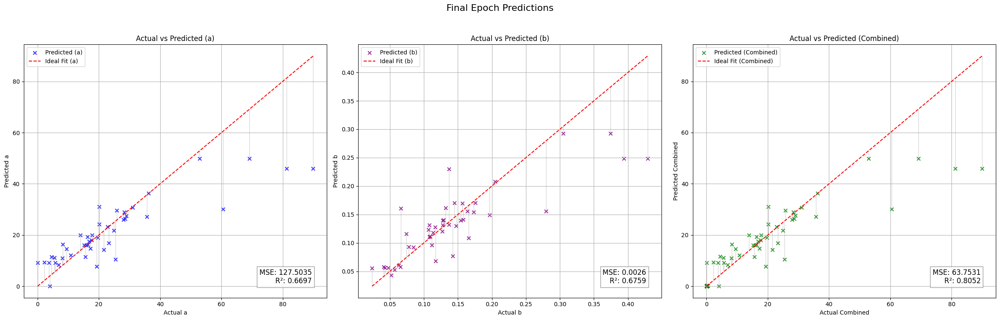

Validation Metrics:
  - MSE: 54.7920
  - R²: 0.6957
  - MAE: 3.3528
  - Explained Variance Score (EVS): 0.7085
Fold 1 Metrics:
  - Validation Loss (MSE): 54.7920
  - R²: 0.6957
  - MAE: 3.3528
  - EVS: 0.7085
Fold 2/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  3.72it/s, loss=0.862]


Validation Metrics:
  - MSE: 2.4466
  - R²: 0.9659
  - MAE: 0.8297
  - Explained Variance Score (EVS): 0.9703
Epoch [1/50], Train Loss: 0.8436, Val Loss: 2.4466
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.60it/s, loss=0.815]


Validation Metrics:
  - MSE: 3.8914
  - R²: 0.9543
  - MAE: 0.9226
  - Explained Variance Score (EVS): 0.9564
Epoch [2/50], Train Loss: 0.8348, Val Loss: 3.8914
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.32it/s, loss=0.828]


Validation Metrics:
  - MSE: 3.2101
  - R²: 0.9509
  - MAE: 0.9066
  - Explained Variance Score (EVS): 0.9514
Epoch [3/50], Train Loss: 0.8256, Val Loss: 3.2101
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  5.11it/s, loss=0.802]


Validation Metrics:
  - MSE: 2.6235
  - R²: 0.9596
  - MAE: 0.8675
  - Explained Variance Score (EVS): 0.9596
Epoch [4/50], Train Loss: 0.7830, Val Loss: 2.6235
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.74it/s, loss=0.772]


Validation Metrics:
  - MSE: 3.1435
  - R²: 0.9505
  - MAE: 0.9279
  - Explained Variance Score (EVS): 0.9507
Epoch [5/50], Train Loss: 0.7755, Val Loss: 3.1435
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.85it/s, loss=0.743]


Validation Metrics:
  - MSE: 3.1349
  - R²: 0.9482
  - MAE: 1.0052
  - Explained Variance Score (EVS): 0.9488
Epoch [6/50], Train Loss: 0.7523, Val Loss: 3.1349
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.27it/s, loss=0.745]


Validation Metrics:
  - MSE: 4.6704
  - R²: 0.9419
  - MAE: 1.0534
  - Explained Variance Score (EVS): 0.9423
Epoch [7/50], Train Loss: 0.7314, Val Loss: 4.6704
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.01it/s, loss=0.804]


Validation Metrics:
  - MSE: 7.0849
  - R²: 0.9154
  - MAE: 1.2311
  - Explained Variance Score (EVS): 0.9187
Epoch [8/50], Train Loss: 0.7424, Val Loss: 7.0849
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.678]


Validation Metrics:
  - MSE: 6.1077
  - R²: 0.9202
  - MAE: 1.1946
  - Explained Variance Score (EVS): 0.9214
Epoch [9/50], Train Loss: 0.7008, Val Loss: 6.1077
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.41it/s, loss=0.689]


Validation Metrics:
  - MSE: 4.4050
  - R²: 0.9217
  - MAE: 1.1534
  - Explained Variance Score (EVS): 0.9222
Epoch [10/50], Train Loss: 0.6856, Val Loss: 4.4050
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.54it/s, loss=0.656]


Validation Metrics:
  - MSE: 4.9786
  - R²: 0.9034
  - MAE: 1.2807
  - Explained Variance Score (EVS): 0.9095
Epoch [11/50], Train Loss: 0.6744, Val Loss: 4.9786
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


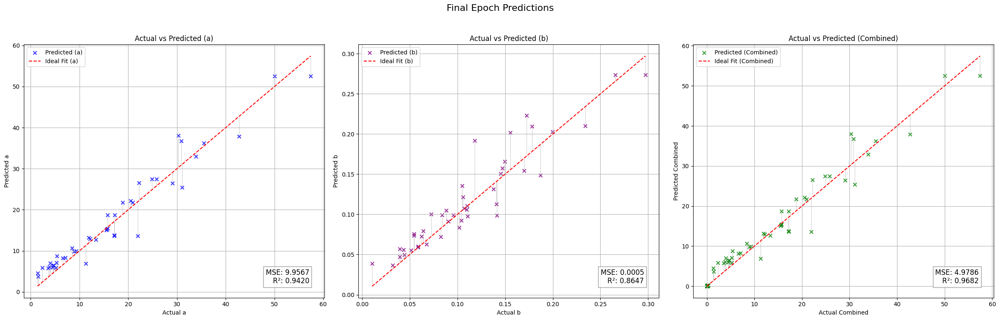

Validation Metrics:
  - MSE: 2.4466
  - R²: 0.9659
  - MAE: 0.8297
  - Explained Variance Score (EVS): 0.9703
Fold 2 Metrics:
  - Validation Loss (MSE): 2.4466
  - R²: 0.9659
  - MAE: 0.8297
  - EVS: 0.9703
Fold 3/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.34it/s, loss=0.819]


Validation Metrics:
  - MSE: 14.8187
  - R²: 0.8837
  - MAE: 1.2826
  - Explained Variance Score (EVS): 0.8882
Epoch [1/50], Train Loss: 0.8328, Val Loss: 14.8187
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.23it/s, loss=0.786]


Validation Metrics:
  - MSE: 14.6095
  - R²: 0.8886
  - MAE: 1.2891
  - Explained Variance Score (EVS): 0.8898
Epoch [2/50], Train Loss: 0.8112, Val Loss: 14.6095
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.50it/s, loss=0.773]


Validation Metrics:
  - MSE: 14.7649
  - R²: 0.8868
  - MAE: 1.3417
  - Explained Variance Score (EVS): 0.8869
Epoch [3/50], Train Loss: 0.8013, Val Loss: 14.7649
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.35it/s, loss=0.79]


Validation Metrics:
  - MSE: 16.6576
  - R²: 0.8683
  - MAE: 1.4145
  - Explained Variance Score (EVS): 0.8685
Epoch [4/50], Train Loss: 0.7881, Val Loss: 16.6576
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.88it/s, loss=0.774]


Validation Metrics:
  - MSE: 18.5622
  - R²: 0.8475
  - MAE: 1.4909
  - Explained Variance Score (EVS): 0.8479
Epoch [5/50], Train Loss: 0.8022, Val Loss: 18.5622
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.895]


Validation Metrics:
  - MSE: 18.5873
  - R²: 0.8464
  - MAE: 1.5151
  - Explained Variance Score (EVS): 0.8467
Epoch [6/50], Train Loss: 0.7956, Val Loss: 18.5873
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.784]


Validation Metrics:
  - MSE: 17.5066
  - R²: 0.8589
  - MAE: 1.4540
  - Explained Variance Score (EVS): 0.8597
Epoch [7/50], Train Loss: 0.7617, Val Loss: 17.5066
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.754]


Validation Metrics:
  - MSE: 17.0567
  - R²: 0.8634
  - MAE: 1.3967
  - Explained Variance Score (EVS): 0.8662
Epoch [8/50], Train Loss: 0.7486, Val Loss: 17.0567
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.828]


Validation Metrics:
  - MSE: 16.5784
  - R²: 0.8635
  - MAE: 1.3941
  - Explained Variance Score (EVS): 0.8690
Epoch [9/50], Train Loss: 0.7551, Val Loss: 16.5784
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.75it/s, loss=0.711]


Validation Metrics:
  - MSE: 16.7332
  - R²: 0.8675
  - MAE: 1.3718
  - Explained Variance Score (EVS): 0.8693
Epoch [10/50], Train Loss: 0.7314, Val Loss: 16.7332
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  5.48it/s, loss=0.736]


Validation Metrics:
  - MSE: 15.8979
  - R²: 0.8752
  - MAE: 1.3585
  - Explained Variance Score (EVS): 0.8765
Epoch [11/50], Train Loss: 0.7174, Val Loss: 15.8979
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.718]


Validation Metrics:
  - MSE: 16.1888
  - R²: 0.8736
  - MAE: 1.3641
  - Explained Variance Score (EVS): 0.8740
Epoch [12/50], Train Loss: 0.7032, Val Loss: 16.1888
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


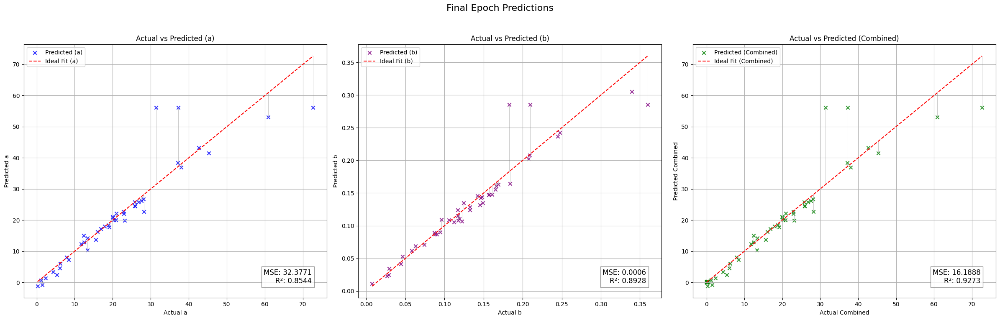

Validation Metrics:
  - MSE: 14.6095
  - R²: 0.8886
  - MAE: 1.2891
  - Explained Variance Score (EVS): 0.8898
Fold 3 Metrics:
  - Validation Loss (MSE): 14.6095
  - R²: 0.8886
  - MAE: 1.2891
  - EVS: 0.8898
Fold 4/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.24it/s, loss=0.797]


Validation Metrics:
  - MSE: 11.4823
  - R²: 0.8925
  - MAE: 1.1833
  - Explained Variance Score (EVS): 0.8962
Epoch [1/50], Train Loss: 0.8139, Val Loss: 11.4823
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.07it/s, loss=0.801]


Validation Metrics:
  - MSE: 11.9646
  - R²: 0.8869
  - MAE: 1.1953
  - Explained Variance Score (EVS): 0.8904
Epoch [2/50], Train Loss: 0.8066, Val Loss: 11.9646
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.26it/s, loss=0.791]


Validation Metrics:
  - MSE: 12.8614
  - R²: 0.8762
  - MAE: 1.2567
  - Explained Variance Score (EVS): 0.8784
Epoch [3/50], Train Loss: 0.7980, Val Loss: 12.8614
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.09it/s, loss=0.824]


Validation Metrics:
  - MSE: 13.8981
  - R²: 0.8637
  - MAE: 1.2840
  - Explained Variance Score (EVS): 0.8666
Epoch [4/50], Train Loss: 0.7896, Val Loss: 13.8981
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.84it/s, loss=0.762]


Validation Metrics:
  - MSE: 15.8429
  - R²: 0.8445
  - MAE: 1.3412
  - Explained Variance Score (EVS): 0.8476
Epoch [5/50], Train Loss: 0.7867, Val Loss: 15.8429
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.789]


Validation Metrics:
  - MSE: 17.8902
  - R²: 0.8268
  - MAE: 1.4198
  - Explained Variance Score (EVS): 0.8297
Epoch [6/50], Train Loss: 0.7798, Val Loss: 17.8902
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  5.15it/s, loss=0.753]


Validation Metrics:
  - MSE: 19.8697
  - R²: 0.8111
  - MAE: 1.4898
  - Explained Variance Score (EVS): 0.8142
Epoch [7/50], Train Loss: 0.7624, Val Loss: 19.8697
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  4.76it/s, loss=0.796]


Validation Metrics:
  - MSE: 19.7032
  - R²: 0.8133
  - MAE: 1.4813
  - Explained Variance Score (EVS): 0.8157
Epoch [8/50], Train Loss: 0.7680, Val Loss: 19.7032
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=0.718]


Validation Metrics:
  - MSE: 20.8080
  - R²: 0.8086
  - MAE: 1.4856
  - Explained Variance Score (EVS): 0.8124
Epoch [9/50], Train Loss: 0.7459, Val Loss: 20.8080
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.768]


Validation Metrics:
  - MSE: 20.7570
  - R²: 0.8121
  - MAE: 1.4909
  - Explained Variance Score (EVS): 0.8170
Epoch [10/50], Train Loss: 0.7527, Val Loss: 20.7570
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.95it/s, loss=0.776]


Validation Metrics:
  - MSE: 20.5981
  - R²: 0.8151
  - MAE: 1.4865
  - Explained Variance Score (EVS): 0.8199
Epoch [11/50], Train Loss: 0.7514, Val Loss: 20.5981
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


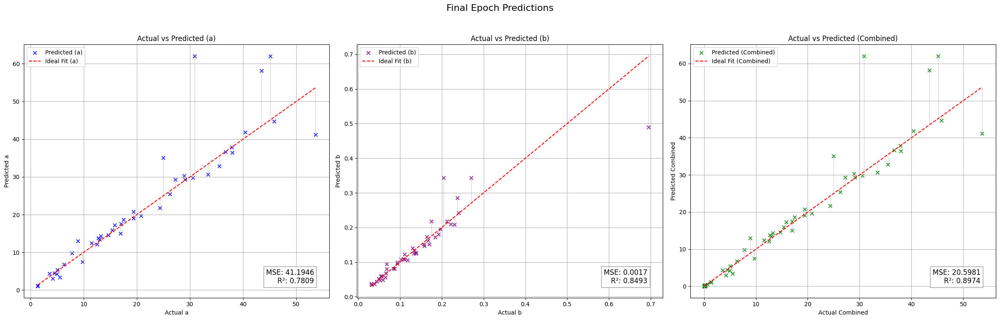

Validation Metrics:
  - MSE: 11.4823
  - R²: 0.8925
  - MAE: 1.1833
  - Explained Variance Score (EVS): 0.8962
Fold 4 Metrics:
  - Validation Loss (MSE): 11.4823
  - R²: 0.8925
  - MAE: 1.1833
  - EVS: 0.8962
Fold 5/5


Epoch 1/50: 100%|██████████| 3/3 [00:00<00:00,  4.50it/s, loss=0.759]


Validation Metrics:
  - MSE: 33.8449
  - R²: 0.8317
  - MAE: 1.4669
  - Explained Variance Score (EVS): 0.8368
Epoch [1/50], Train Loss: 0.7987, Val Loss: 33.8449
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 3/3 [00:00<00:00,  4.25it/s, loss=0.764]


Validation Metrics:
  - MSE: 33.8437
  - R²: 0.8313
  - MAE: 1.4832
  - Explained Variance Score (EVS): 0.8358
Epoch [2/50], Train Loss: 0.8089, Val Loss: 33.8437
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 3/3 [00:00<00:00,  4.10it/s, loss=0.871]


Validation Metrics:
  - MSE: 33.9307
  - R²: 0.8295
  - MAE: 1.4703
  - Explained Variance Score (EVS): 0.8349
Epoch [3/50], Train Loss: 0.8176, Val Loss: 33.9307
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 3/3 [00:00<00:00,  4.23it/s, loss=0.819]


Validation Metrics:
  - MSE: 34.1282
  - R²: 0.8286
  - MAE: 1.4612
  - Explained Variance Score (EVS): 0.8347
Epoch [4/50], Train Loss: 0.7820, Val Loss: 34.1282
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 3/3 [00:00<00:00,  4.16it/s, loss=0.779]


Validation Metrics:
  - MSE: 33.8549
  - R²: 0.8308
  - MAE: 1.4386
  - Explained Variance Score (EVS): 0.8368
Epoch [5/50], Train Loss: 0.7803, Val Loss: 33.8549
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 3/3 [00:00<00:00,  4.81it/s, loss=0.737]


Validation Metrics:
  - MSE: 33.6067
  - R²: 0.8325
  - MAE: 1.4159
  - Explained Variance Score (EVS): 0.8383
Epoch [6/50], Train Loss: 0.7717, Val Loss: 33.6067
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 3/3 [00:00<00:00,  4.96it/s, loss=0.784]


Validation Metrics:
  - MSE: 33.8588
  - R²: 0.8309
  - MAE: 1.4243
  - Explained Variance Score (EVS): 0.8388
Epoch [7/50], Train Loss: 0.7747, Val Loss: 33.8588
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 3/3 [00:00<00:00,  5.54it/s, loss=0.772]


Validation Metrics:
  - MSE: 33.6912
  - R²: 0.8329
  - MAE: 1.4141
  - Explained Variance Score (EVS): 0.8400
Epoch [8/50], Train Loss: 0.7791, Val Loss: 33.6912
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.734]


Validation Metrics:
  - MSE: 33.7471
  - R²: 0.8317
  - MAE: 1.4092
  - Explained Variance Score (EVS): 0.8388
Epoch [9/50], Train Loss: 0.7651, Val Loss: 33.7471
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 3/3 [00:00<00:00,  5.04it/s, loss=0.742]


Validation Metrics:
  - MSE: 33.7320
  - R²: 0.8301
  - MAE: 1.3870
  - Explained Variance Score (EVS): 0.8371
Epoch [10/50], Train Loss: 0.7634, Val Loss: 33.7320
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 3/3 [00:00<00:00,  4.66it/s, loss=0.805]


Validation Metrics:
  - MSE: 33.9442
  - R²: 0.8289
  - MAE: 1.4060
  - Explained Variance Score (EVS): 0.8369
Epoch [11/50], Train Loss: 0.7632, Val Loss: 33.9442
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 3/3 [00:00<00:00,  4.92it/s, loss=0.718]


Validation Metrics:
  - MSE: 33.1646
  - R²: 0.8328
  - MAE: 1.3821
  - Explained Variance Score (EVS): 0.8396
Epoch [12/50], Train Loss: 0.7664, Val Loss: 33.1646
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 3/3 [00:00<00:00,  4.77it/s, loss=0.808]


Validation Metrics:
  - MSE: 33.1671
  - R²: 0.8321
  - MAE: 1.3833
  - Explained Variance Score (EVS): 0.8392
Epoch [13/50], Train Loss: 0.7614, Val Loss: 33.1671
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 3/3 [00:00<00:00,  4.46it/s, loss=0.799]


Validation Metrics:
  - MSE: 33.4214
  - R²: 0.8315
  - MAE: 1.3901
  - Explained Variance Score (EVS): 0.8388
Epoch [14/50], Train Loss: 0.7679, Val Loss: 33.4214
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 3/3 [00:00<00:00,  4.17it/s, loss=0.774]


Validation Metrics:
  - MSE: 33.5624
  - R²: 0.8302
  - MAE: 1.3973
  - Explained Variance Score (EVS): 0.8382
Epoch [15/50], Train Loss: 0.7547, Val Loss: 33.5624
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=0.736]


Validation Metrics:
  - MSE: 33.6025
  - R²: 0.8310
  - MAE: 1.3975
  - Explained Variance Score (EVS): 0.8383
Epoch [16/50], Train Loss: 0.7573, Val Loss: 33.6025
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 3/3 [00:00<00:00,  4.32it/s, loss=0.757]


Validation Metrics:
  - MSE: 33.2751
  - R²: 0.8327
  - MAE: 1.3964
  - Explained Variance Score (EVS): 0.8395
Epoch [17/50], Train Loss: 0.7547, Val Loss: 33.2751
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 3/3 [00:00<00:00,  4.63it/s, loss=0.709]


Validation Metrics:
  - MSE: 32.9407
  - R²: 0.8350
  - MAE: 1.3875
  - Explained Variance Score (EVS): 0.8411
Epoch [18/50], Train Loss: 0.7405, Val Loss: 32.9407
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.782]


Validation Metrics:
  - MSE: 33.2489
  - R²: 0.8334
  - MAE: 1.3962
  - Explained Variance Score (EVS): 0.8405
Epoch [19/50], Train Loss: 0.7491, Val Loss: 33.2489
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 3/3 [00:00<00:00,  5.18it/s, loss=0.771]


Validation Metrics:
  - MSE: 33.4907
  - R²: 0.8315
  - MAE: 1.4005
  - Explained Variance Score (EVS): 0.8388
Epoch [20/50], Train Loss: 0.7392, Val Loss: 33.4907
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 3/3 [00:00<00:00,  4.70it/s, loss=0.737]


Validation Metrics:
  - MSE: 33.4735
  - R²: 0.8314
  - MAE: 1.4011
  - Explained Variance Score (EVS): 0.8385
Epoch [21/50], Train Loss: 0.7491, Val Loss: 33.4735
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 3/3 [00:00<00:00,  4.62it/s, loss=0.735]


Validation Metrics:
  - MSE: 33.5224
  - R²: 0.8304
  - MAE: 1.4042
  - Explained Variance Score (EVS): 0.8376
Epoch [22/50], Train Loss: 0.7353, Val Loss: 33.5224
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=0.757]


Validation Metrics:
  - MSE: 33.6300
  - R²: 0.8299
  - MAE: 1.4128
  - Explained Variance Score (EVS): 0.8378
Epoch [23/50], Train Loss: 0.7370, Val Loss: 33.6300
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 3/3 [00:00<00:00,  4.97it/s, loss=0.749]


Validation Metrics:
  - MSE: 33.6199
  - R²: 0.8293
  - MAE: 1.4110
  - Explained Variance Score (EVS): 0.8372
Epoch [24/50], Train Loss: 0.7357, Val Loss: 33.6199
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 3/3 [00:00<00:00,  5.06it/s, loss=0.72]


Validation Metrics:
  - MSE: 33.4340
  - R²: 0.8299
  - MAE: 1.4027
  - Explained Variance Score (EVS): 0.8371
Epoch [25/50], Train Loss: 0.7336, Val Loss: 33.4340
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 3/3 [00:00<00:00,  4.68it/s, loss=0.713]


Validation Metrics:
  - MSE: 33.0301
  - R²: 0.8333
  - MAE: 1.4050
  - Explained Variance Score (EVS): 0.8391
Epoch [26/50], Train Loss: 0.7347, Val Loss: 33.0301
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 3/3 [00:00<00:00,  4.57it/s, loss=0.702]


Validation Metrics:
  - MSE: 32.6437
  - R²: 0.8354
  - MAE: 1.4012
  - Explained Variance Score (EVS): 0.8405
Epoch [27/50], Train Loss: 0.7271, Val Loss: 32.6437
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 3/3 [00:00<00:00,  4.18it/s, loss=0.711]


Validation Metrics:
  - MSE: 32.6544
  - R²: 0.8346
  - MAE: 1.4056
  - Explained Variance Score (EVS): 0.8402
Epoch [28/50], Train Loss: 0.7274, Val Loss: 32.6544
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 3/3 [00:00<00:00,  4.86it/s, loss=0.73]


Validation Metrics:
  - MSE: 32.4205
  - R²: 0.8352
  - MAE: 1.4035
  - Explained Variance Score (EVS): 0.8411
Epoch [29/50], Train Loss: 0.7367, Val Loss: 32.4205
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 3/3 [00:00<00:00,  4.03it/s, loss=0.783]


Validation Metrics:
  - MSE: 32.9959
  - R²: 0.8323
  - MAE: 1.4176
  - Explained Variance Score (EVS): 0.8393
Epoch [30/50], Train Loss: 0.7391, Val Loss: 32.9959
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 3/3 [00:00<00:00,  3.77it/s, loss=0.762]


Validation Metrics:
  - MSE: 33.3016
  - R²: 0.8308
  - MAE: 1.4189
  - Explained Variance Score (EVS): 0.8372
Epoch [31/50], Train Loss: 0.7235, Val Loss: 33.3016
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 3/3 [00:00<00:00,  4.39it/s, loss=0.723]


Validation Metrics:
  - MSE: 33.5091
  - R²: 0.8301
  - MAE: 1.4198
  - Explained Variance Score (EVS): 0.8366
Epoch [32/50], Train Loss: 0.7210, Val Loss: 33.5091
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 3/3 [00:00<00:00,  4.90it/s, loss=0.717]


Validation Metrics:
  - MSE: 33.2722
  - R²: 0.8312
  - MAE: 1.4211
  - Explained Variance Score (EVS): 0.8375
Epoch [33/50], Train Loss: 0.7201, Val Loss: 33.2722
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 3/3 [00:00<00:00,  5.16it/s, loss=0.761]


Validation Metrics:
  - MSE: 33.1915
  - R²: 0.8325
  - MAE: 1.4220
  - Explained Variance Score (EVS): 0.8378
Epoch [34/50], Train Loss: 0.7254, Val Loss: 33.1915
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 3/3 [00:00<00:00,  5.02it/s, loss=0.702]


Validation Metrics:
  - MSE: 33.1741
  - R²: 0.8328
  - MAE: 1.4270
  - Explained Variance Score (EVS): 0.8379
Epoch [35/50], Train Loss: 0.7219, Val Loss: 33.1741
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 3/3 [00:00<00:00,  4.67it/s, loss=0.713]


Validation Metrics:
  - MSE: 32.9154
  - R²: 0.8337
  - MAE: 1.4289
  - Explained Variance Score (EVS): 0.8382
Epoch [36/50], Train Loss: 0.7178, Val Loss: 32.9154
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=0.747]


Validation Metrics:
  - MSE: 33.0858
  - R²: 0.8329
  - MAE: 1.4320
  - Explained Variance Score (EVS): 0.8381
Epoch [37/50], Train Loss: 0.7230, Val Loss: 33.0858
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 3/3 [00:00<00:00,  4.65it/s, loss=0.71]


Validation Metrics:
  - MSE: 32.9752
  - R²: 0.8335
  - MAE: 1.4318
  - Explained Variance Score (EVS): 0.8385
Epoch [38/50], Train Loss: 0.7182, Val Loss: 32.9752
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 3/3 [00:00<00:00,  4.98it/s, loss=0.71]


Validation Metrics:
  - MSE: 32.9565
  - R²: 0.8336
  - MAE: 1.4330
  - Explained Variance Score (EVS): 0.8388
Epoch [39/50], Train Loss: 0.7114, Val Loss: 32.9565
Current Dropout Rate: 0.1960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


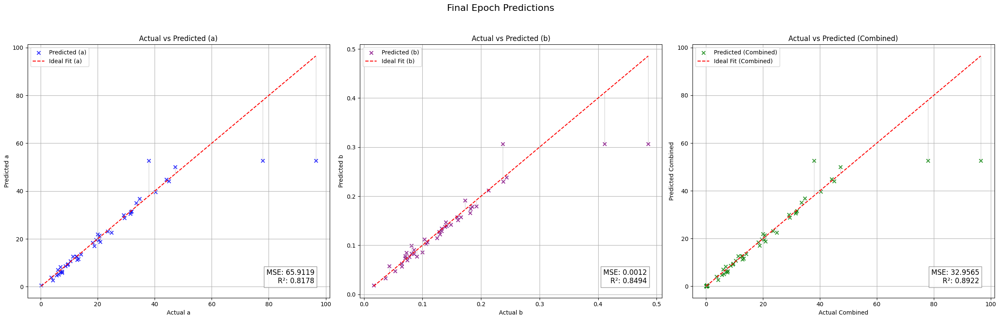

[I 2024-12-01 17:40:25,471] Trial 28 finished with value: 23.15018653869629 and parameters: {'num_layers': 2, 'hidden_size_0': 446, 'activation_0': 'ELU', 'dropout_0': 0.3641490021743583, 'hidden_size_1': 457, 'activation_1': 'ReLU', 'dropout_1': 0.1386165851048714, 'batch_size': 64, 'learning_rate': 0.0001364818658510128, 'optimizer': 'AdamW'}. Best is trial 27 with value: 22.130863189697266.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 32.4205
  - R²: 0.8352
  - MAE: 1.4035
  - Explained Variance Score (EVS): 0.8411
Fold 5 Metrics:
  - Validation Loss (MSE): 32.4205
  - R²: 0.8352
  - MAE: 1.4035
  - EVS: 0.8411
Avg Validation Metrics:
  - MSE: 23.1502
  - R²: 0.8556
  - MAE: 1.6117
  - EVS: 0.8612
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.32it/s, loss=1.98]


Validation Metrics:
  - MSE: 193.6969
  - R²: -0.0082
  - MAE: 6.2825
  - Explained Variance Score (EVS): 0.0332
Epoch [1/50], Train Loss: 2.0644, Val Loss: 193.6969
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.62it/s, loss=1.93]


Validation Metrics:
  - MSE: 199.4782
  - R²: -0.0562
  - MAE: 6.1960
  - Explained Variance Score (EVS): 0.0687
Epoch [2/50], Train Loss: 1.8991, Val Loss: 199.4782
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=1.73]


Validation Metrics:
  - MSE: 211.4964
  - R²: -0.0992
  - MAE: 6.4870
  - Explained Variance Score (EVS): 0.1021
Epoch [3/50], Train Loss: 1.8594, Val Loss: 211.4964
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=1.74]


Validation Metrics:
  - MSE: 217.2585
  - R²: -0.1010
  - MAE: 6.6137
  - Explained Variance Score (EVS): 0.1383
Epoch [4/50], Train Loss: 1.8123, Val Loss: 217.2585
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.49it/s, loss=1.85]


Validation Metrics:
  - MSE: 211.2055
  - R²: -0.0717
  - MAE: 6.4691
  - Explained Variance Score (EVS): 0.1831
Epoch [5/50], Train Loss: 1.7978, Val Loss: 211.2055
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.98it/s, loss=1.68]


Validation Metrics:
  - MSE: 186.7431
  - R²: 0.0260
  - MAE: 6.1540
  - Explained Variance Score (EVS): 0.2896
Epoch [6/50], Train Loss: 1.7176, Val Loss: 186.7431
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  9.18it/s, loss=1.64]


Validation Metrics:
  - MSE: 151.9007
  - R²: 0.2074
  - MAE: 5.4110
  - Explained Variance Score (EVS): 0.4110
Epoch [7/50], Train Loss: 1.6980, Val Loss: 151.9007
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.42it/s, loss=1.6]


Validation Metrics:
  - MSE: 149.0956
  - R²: 0.3013
  - MAE: 5.2921
  - Explained Variance Score (EVS): 0.4803
Epoch [8/50], Train Loss: 1.6483, Val Loss: 149.0956
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.94it/s, loss=1.63]


Validation Metrics:
  - MSE: 120.1194
  - R²: 0.4344
  - MAE: 4.4043
  - Explained Variance Score (EVS): 0.5635
Epoch [9/50], Train Loss: 1.6243, Val Loss: 120.1194
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.87it/s, loss=1.52]


Validation Metrics:
  - MSE: 77.6312
  - R²: 0.5913
  - MAE: 3.5132
  - Explained Variance Score (EVS): 0.6708
Epoch [10/50], Train Loss: 1.5633, Val Loss: 77.6312
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  9.50it/s, loss=1.49]


Validation Metrics:
  - MSE: 70.5263
  - R²: 0.5942
  - MAE: 3.6129
  - Explained Variance Score (EVS): 0.6744
Epoch [11/50], Train Loss: 1.5229, Val Loss: 70.5263
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.63it/s, loss=1.46]


Validation Metrics:
  - MSE: 74.7805
  - R²: 0.6516
  - MAE: 3.5041
  - Explained Variance Score (EVS): 0.7056
Epoch [12/50], Train Loss: 1.4793, Val Loss: 74.7805
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.07it/s, loss=1.46]


Validation Metrics:
  - MSE: 59.1134
  - R²: 0.7605
  - MAE: 3.0464
  - Explained Variance Score (EVS): 0.7775
Epoch [13/50], Train Loss: 1.4434, Val Loss: 59.1134
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.11it/s, loss=1.71]


Validation Metrics:
  - MSE: 80.8920
  - R²: 0.6595
  - MAE: 3.2842
  - Explained Variance Score (EVS): 0.7036
Epoch [14/50], Train Loss: 1.4729, Val Loss: 80.8920
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.11it/s, loss=1.46]


Validation Metrics:
  - MSE: 63.0142
  - R²: 0.6955
  - MAE: 3.1055
  - Explained Variance Score (EVS): 0.7152
Epoch [15/50], Train Loss: 1.3960, Val Loss: 63.0142
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=1.29]


Validation Metrics:
  - MSE: 60.1363
  - R²: 0.6759
  - MAE: 3.2302
  - Explained Variance Score (EVS): 0.7038
Epoch [16/50], Train Loss: 1.3267, Val Loss: 60.1363
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.99it/s, loss=1.24]


Validation Metrics:
  - MSE: 51.5482
  - R²: 0.7486
  - MAE: 3.1275
  - Explained Variance Score (EVS): 0.7626
Epoch [17/50], Train Loss: 1.2944, Val Loss: 51.5482
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.75it/s, loss=1.24]


Validation Metrics:
  - MSE: 50.0006
  - R²: 0.7518
  - MAE: 3.0186
  - Explained Variance Score (EVS): 0.7736
Epoch [18/50], Train Loss: 1.2567, Val Loss: 50.0006
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  9.01it/s, loss=1.4]


Validation Metrics:
  - MSE: 69.7203
  - R²: 0.6326
  - MAE: 3.3147
  - Explained Variance Score (EVS): 0.6830
Epoch [19/50], Train Loss: 1.2135, Val Loss: 69.7203
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  9.55it/s, loss=1.16]


Validation Metrics:
  - MSE: 91.6279
  - R²: 0.5755
  - MAE: 3.6934
  - Explained Variance Score (EVS): 0.6374
Epoch [20/50], Train Loss: 1.1597, Val Loss: 91.6279
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  8.89it/s, loss=1.05]


Validation Metrics:
  - MSE: 52.1428
  - R²: 0.7602
  - MAE: 3.0029
  - Explained Variance Score (EVS): 0.7837
Epoch [21/50], Train Loss: 1.0994, Val Loss: 52.1428
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  9.51it/s, loss=1.06]


Validation Metrics:
  - MSE: 46.3568
  - R²: 0.7520
  - MAE: 3.0231
  - Explained Variance Score (EVS): 0.7727
Epoch [22/50], Train Loss: 1.0700, Val Loss: 46.3568
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00, 10.35it/s, loss=1]


Validation Metrics:
  - MSE: 50.8023
  - R²: 0.6578
  - MAE: 3.0545
  - Explained Variance Score (EVS): 0.7130
Epoch [23/50], Train Loss: 1.0377, Val Loss: 50.8023
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  8.53it/s, loss=0.941]


Validation Metrics:
  - MSE: 64.3194
  - R²: 0.6591
  - MAE: 3.2196
  - Explained Variance Score (EVS): 0.6843
Epoch [24/50], Train Loss: 0.9780, Val Loss: 64.3194
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  8.81it/s, loss=0.882]


Validation Metrics:
  - MSE: 47.8165
  - R²: 0.7788
  - MAE: 2.9588
  - Explained Variance Score (EVS): 0.8020
Epoch [25/50], Train Loss: 0.9393, Val Loss: 47.8165
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00,  7.46it/s, loss=0.887]


Validation Metrics:
  - MSE: 48.1775
  - R²: 0.7451
  - MAE: 2.9679
  - Explained Variance Score (EVS): 0.7784
Epoch [26/50], Train Loss: 0.9075, Val Loss: 48.1775
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s, loss=0.875]


Validation Metrics:
  - MSE: 68.5093
  - R²: 0.6816
  - MAE: 3.3148
  - Explained Variance Score (EVS): 0.7078
Epoch [27/50], Train Loss: 0.8506, Val Loss: 68.5093
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00,  7.84it/s, loss=0.766]


Validation Metrics:
  - MSE: 72.2288
  - R²: 0.6883
  - MAE: 3.2704
  - Explained Variance Score (EVS): 0.7125
Epoch [28/50], Train Loss: 0.8154, Val Loss: 72.2288
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00,  8.07it/s, loss=0.969]


Validation Metrics:
  - MSE: 80.1728
  - R²: 0.6018
  - MAE: 3.4617
  - Explained Variance Score (EVS): 0.6676
Epoch [29/50], Train Loss: 0.8062, Val Loss: 80.1728
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 6/6 [00:00<00:00,  7.67it/s, loss=0.712]


Validation Metrics:
  - MSE: 49.0685
  - R²: 0.7512
  - MAE: 3.0282
  - Explained Variance Score (EVS): 0.7728
Epoch [30/50], Train Loss: 0.7427, Val Loss: 49.0685
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.703]


Validation Metrics:
  - MSE: 45.5513
  - R²: 0.7759
  - MAE: 2.9231
  - Explained Variance Score (EVS): 0.7886
Epoch [31/50], Train Loss: 0.7127, Val Loss: 45.5513
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 6/6 [00:00<00:00,  8.19it/s, loss=0.628]


Validation Metrics:
  - MSE: 62.2753
  - R²: 0.6950
  - MAE: 3.1290
  - Explained Variance Score (EVS): 0.7398
Epoch [32/50], Train Loss: 0.6702, Val Loss: 62.2753
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 6/6 [00:00<00:00,  9.82it/s, loss=0.639]


Validation Metrics:
  - MSE: 109.6514
  - R²: 0.4759
  - MAE: 3.8969
  - Explained Variance Score (EVS): 0.5713
Epoch [33/50], Train Loss: 0.6670, Val Loss: 109.6514
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 6/6 [00:00<00:00,  8.88it/s, loss=0.554]


Validation Metrics:
  - MSE: 57.4580
  - R²: 0.7108
  - MAE: 2.9805
  - Explained Variance Score (EVS): 0.7320
Epoch [34/50], Train Loss: 0.6201, Val Loss: 57.4580
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 6/6 [00:00<00:00,  9.23it/s, loss=0.555]


Validation Metrics:
  - MSE: 41.7834
  - R²: 0.7786
  - MAE: 2.9275
  - Explained Variance Score (EVS): 0.7880
Epoch [35/50], Train Loss: 0.5819, Val Loss: 41.7834
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 6/6 [00:00<00:00,  8.89it/s, loss=0.63]


Validation Metrics:
  - MSE: 41.2888
  - R²: 0.7918
  - MAE: 2.7692
  - Explained Variance Score (EVS): 0.8009
Epoch [36/50], Train Loss: 0.5839, Val Loss: 41.2888
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 6/6 [00:00<00:00,  9.53it/s, loss=0.654]


Validation Metrics:
  - MSE: 67.9226
  - R²: 0.6667
  - MAE: 3.1459
  - Explained Variance Score (EVS): 0.7063
Epoch [37/50], Train Loss: 0.5553, Val Loss: 67.9226
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 6/6 [00:00<00:00,  8.85it/s, loss=0.626]


Validation Metrics:
  - MSE: 80.5531
  - R²: 0.6318
  - MAE: 3.2956
  - Explained Variance Score (EVS): 0.6605
Epoch [38/50], Train Loss: 0.5450, Val Loss: 80.5531
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 6/6 [00:00<00:00,  7.90it/s, loss=0.538]


Validation Metrics:
  - MSE: 52.7078
  - R²: 0.7546
  - MAE: 2.9727
  - Explained Variance Score (EVS): 0.7657
Epoch [39/50], Train Loss: 0.5225, Val Loss: 52.7078
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 6/6 [00:00<00:00,  8.33it/s, loss=0.496]


Validation Metrics:
  - MSE: 57.6607
  - R²: 0.7155
  - MAE: 2.9564
  - Explained Variance Score (EVS): 0.7412
Epoch [40/50], Train Loss: 0.5061, Val Loss: 57.6607
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 6/6 [00:00<00:00,  7.52it/s, loss=0.497]


Validation Metrics:
  - MSE: 67.6609
  - R²: 0.6333
  - MAE: 3.1016
  - Explained Variance Score (EVS): 0.6912
Epoch [41/50], Train Loss: 0.4955, Val Loss: 67.6609
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=0.468]


Validation Metrics:
  - MSE: 50.6925
  - R²: 0.7280
  - MAE: 2.8341
  - Explained Variance Score (EVS): 0.7493
Epoch [42/50], Train Loss: 0.4828, Val Loss: 50.6925
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 6/6 [00:00<00:00,  8.45it/s, loss=0.468]


Validation Metrics:
  - MSE: 61.3401
  - R²: 0.6903
  - MAE: 3.1168
  - Explained Variance Score (EVS): 0.7062
Epoch [43/50], Train Loss: 0.4974, Val Loss: 61.3401
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 6/6 [00:00<00:00,  8.29it/s, loss=0.437]


Validation Metrics:
  - MSE: 63.6301
  - R²: 0.6994
  - MAE: 3.0460
  - Explained Variance Score (EVS): 0.7249
Epoch [44/50], Train Loss: 0.4669, Val Loss: 63.6301
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 6/6 [00:00<00:00,  9.03it/s, loss=0.472]


Validation Metrics:
  - MSE: 47.2172
  - R²: 0.7680
  - MAE: 2.9568
  - Explained Variance Score (EVS): 0.7832
Epoch [45/50], Train Loss: 0.4652, Val Loss: 47.2172
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 6/6 [00:00<00:00,  9.52it/s, loss=0.418]


Validation Metrics:
  - MSE: 62.7065
  - R²: 0.6862
  - MAE: 3.0300
  - Explained Variance Score (EVS): 0.7282
Epoch [46/50], Train Loss: 0.4462, Val Loss: 62.7065
Current Dropout Rate: 0.1400
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


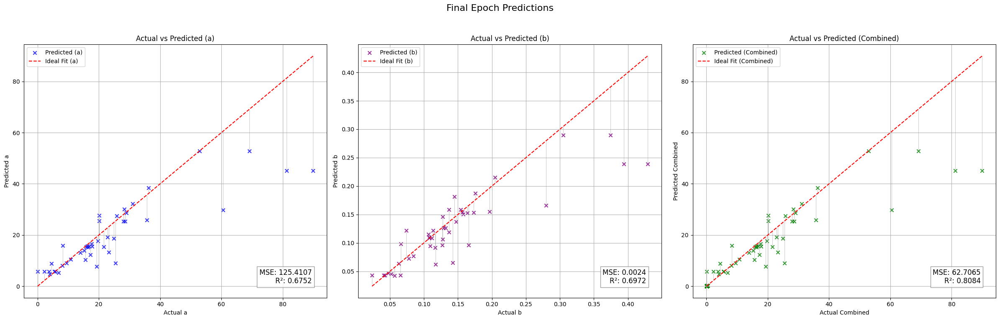

Validation Metrics:
  - MSE: 41.2888
  - R²: 0.7918
  - MAE: 2.7692
  - Explained Variance Score (EVS): 0.8009
Fold 1 Metrics:
  - Validation Loss (MSE): 41.2888
  - R²: 0.7918
  - MAE: 2.7692
  - EVS: 0.8009
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  9.30it/s, loss=0.612]


Validation Metrics:
  - MSE: 2.6725
  - R²: 0.9608
  - MAE: 0.7364
  - Explained Variance Score (EVS): 0.9621
Epoch [1/50], Train Loss: 0.6045, Val Loss: 2.6725
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.65it/s, loss=0.555]


Validation Metrics:
  - MSE: 3.1184
  - R²: 0.9397
  - MAE: 0.8485
  - Explained Variance Score (EVS): 0.9463
Epoch [2/50], Train Loss: 0.5685, Val Loss: 3.1184
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.56it/s, loss=0.546]


Validation Metrics:
  - MSE: 3.5855
  - R²: 0.9315
  - MAE: 0.9405
  - Explained Variance Score (EVS): 0.9317
Epoch [3/50], Train Loss: 0.5699, Val Loss: 3.5855
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  9.32it/s, loss=0.476]


Validation Metrics:
  - MSE: 3.8884
  - R²: 0.9337
  - MAE: 0.9704
  - Explained Variance Score (EVS): 0.9345
Epoch [4/50], Train Loss: 0.5539, Val Loss: 3.8884
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.24it/s, loss=0.48]


Validation Metrics:
  - MSE: 4.4701
  - R²: 0.9308
  - MAE: 1.0736
  - Explained Variance Score (EVS): 0.9333
Epoch [5/50], Train Loss: 0.5548, Val Loss: 4.4701
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.08it/s, loss=0.596]


Validation Metrics:
  - MSE: 5.1725
  - R²: 0.9174
  - MAE: 1.1699
  - Explained Variance Score (EVS): 0.9188
Epoch [6/50], Train Loss: 0.5463, Val Loss: 5.1725
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.13it/s, loss=0.539]


Validation Metrics:
  - MSE: 4.8893
  - R²: 0.9232
  - MAE: 1.1988
  - Explained Variance Score (EVS): 0.9235
Epoch [7/50], Train Loss: 0.5247, Val Loss: 4.8893
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.65it/s, loss=0.567]


Validation Metrics:
  - MSE: 7.0402
  - R²: 0.9059
  - MAE: 1.3741
  - Explained Variance Score (EVS): 0.9064
Epoch [8/50], Train Loss: 0.5290, Val Loss: 7.0402
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.38it/s, loss=0.449]


Validation Metrics:
  - MSE: 7.1134
  - R²: 0.9052
  - MAE: 1.3519
  - Explained Variance Score (EVS): 0.9087
Epoch [9/50], Train Loss: 0.4972, Val Loss: 7.1134
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  9.46it/s, loss=0.74]


Validation Metrics:
  - MSE: 6.7396
  - R²: 0.8982
  - MAE: 1.3423
  - Explained Variance Score (EVS): 0.9117
Epoch [10/50], Train Loss: 0.5358, Val Loss: 6.7396
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  9.07it/s, loss=0.497]


Validation Metrics:
  - MSE: 4.3748
  - R²: 0.8966
  - MAE: 1.1939
  - Explained Variance Score (EVS): 0.8971
Epoch [11/50], Train Loss: 0.4743, Val Loss: 4.3748
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


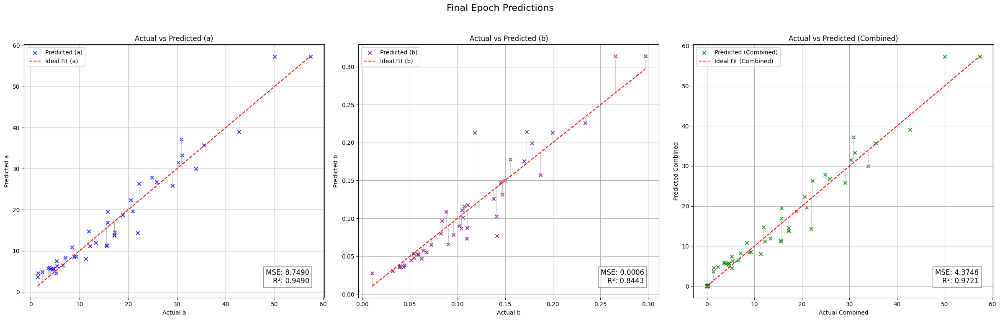

Validation Metrics:
  - MSE: 2.6725
  - R²: 0.9608
  - MAE: 0.7364
  - Explained Variance Score (EVS): 0.9621
Fold 2 Metrics:
  - Validation Loss (MSE): 2.6725
  - R²: 0.9608
  - MAE: 0.7364
  - EVS: 0.9621
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.54it/s, loss=0.559]


Validation Metrics:
  - MSE: 16.3768
  - R²: 0.8679
  - MAE: 1.4539
  - Explained Variance Score (EVS): 0.8679
Epoch [1/50], Train Loss: 0.5766, Val Loss: 16.3768
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.55it/s, loss=0.536]


Validation Metrics:
  - MSE: 16.4587
  - R²: 0.8619
  - MAE: 1.4072
  - Explained Variance Score (EVS): 0.8629
Epoch [2/50], Train Loss: 0.5626, Val Loss: 16.4587
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.66it/s, loss=0.618]


Validation Metrics:
  - MSE: 16.3079
  - R²: 0.8600
  - MAE: 1.3517
  - Explained Variance Score (EVS): 0.8605
Epoch [3/50], Train Loss: 0.5700, Val Loss: 16.3079
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.89it/s, loss=0.507]


Validation Metrics:
  - MSE: 18.3200
  - R²: 0.8484
  - MAE: 1.3244
  - Explained Variance Score (EVS): 0.8488
Epoch [4/50], Train Loss: 0.5405, Val Loss: 18.3200
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.08it/s, loss=0.521]


Validation Metrics:
  - MSE: 17.0334
  - R²: 0.8604
  - MAE: 1.4012
  - Explained Variance Score (EVS): 0.8644
Epoch [5/50], Train Loss: 0.5453, Val Loss: 17.0334
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.59it/s, loss=0.645]


Validation Metrics:
  - MSE: 15.8838
  - R²: 0.8687
  - MAE: 1.2774
  - Explained Variance Score (EVS): 0.8700
Epoch [6/50], Train Loss: 0.5378, Val Loss: 15.8838
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.17it/s, loss=0.487]


Validation Metrics:
  - MSE: 17.0750
  - R²: 0.8617
  - MAE: 1.2629
  - Explained Variance Score (EVS): 0.8636
Epoch [7/50], Train Loss: 0.5323, Val Loss: 17.0750
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.04it/s, loss=0.491]


Validation Metrics:
  - MSE: 15.4882
  - R²: 0.8731
  - MAE: 1.4312
  - Explained Variance Score (EVS): 0.8753
Epoch [8/50], Train Loss: 0.5209, Val Loss: 15.4882
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s, loss=0.538]


Validation Metrics:
  - MSE: 16.9687
  - R²: 0.8600
  - MAE: 1.4395
  - Explained Variance Score (EVS): 0.8616
Epoch [9/50], Train Loss: 0.5190, Val Loss: 16.9687
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.43it/s, loss=0.629]


Validation Metrics:
  - MSE: 15.8581
  - R²: 0.8672
  - MAE: 1.5368
  - Explained Variance Score (EVS): 0.8686
Epoch [10/50], Train Loss: 0.5368, Val Loss: 15.8581
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.69it/s, loss=0.448]


Validation Metrics:
  - MSE: 16.1528
  - R²: 0.8615
  - MAE: 1.5254
  - Explained Variance Score (EVS): 0.8633
Epoch [11/50], Train Loss: 0.4830, Val Loss: 16.1528
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  9.04it/s, loss=0.525]


Validation Metrics:
  - MSE: 17.3454
  - R²: 0.8560
  - MAE: 1.4427
  - Explained Variance Score (EVS): 0.8562
Epoch [12/50], Train Loss: 0.4838, Val Loss: 17.3454
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  9.06it/s, loss=0.531]


Validation Metrics:
  - MSE: 19.3377
  - R²: 0.8411
  - MAE: 1.4915
  - Explained Variance Score (EVS): 0.8412
Epoch [13/50], Train Loss: 0.4900, Val Loss: 19.3377
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  9.16it/s, loss=0.565]


Validation Metrics:
  - MSE: 20.1369
  - R²: 0.8368
  - MAE: 1.5085
  - Explained Variance Score (EVS): 0.8373
Epoch [14/50], Train Loss: 0.4875, Val Loss: 20.1369
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.79it/s, loss=0.435]


Validation Metrics:
  - MSE: 21.8083
  - R²: 0.8247
  - MAE: 1.5327
  - Explained Variance Score (EVS): 0.8274
Epoch [15/50], Train Loss: 0.4782, Val Loss: 21.8083
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  9.25it/s, loss=0.501]


Validation Metrics:
  - MSE: 19.2951
  - R²: 0.8427
  - MAE: 1.5111
  - Explained Variance Score (EVS): 0.8431
Epoch [16/50], Train Loss: 0.4847, Val Loss: 19.2951
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  8.86it/s, loss=0.502]


Validation Metrics:
  - MSE: 18.6395
  - R²: 0.8459
  - MAE: 1.6107
  - Explained Variance Score (EVS): 0.8469
Epoch [17/50], Train Loss: 0.4910, Val Loss: 18.6395
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.43it/s, loss=0.473]


Validation Metrics:
  - MSE: 17.1664
  - R²: 0.8578
  - MAE: 1.5879
  - Explained Variance Score (EVS): 0.8582
Epoch [18/50], Train Loss: 0.4815, Val Loss: 17.1664
Current Dropout Rate: 0.3640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


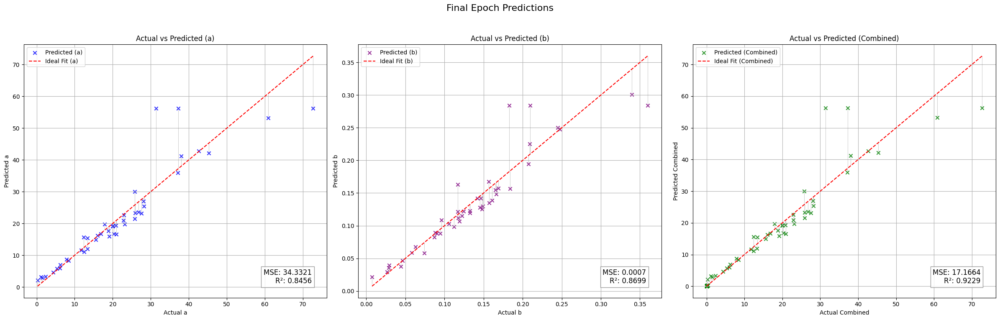

Validation Metrics:
  - MSE: 15.4882
  - R²: 0.8731
  - MAE: 1.4312
  - Explained Variance Score (EVS): 0.8753
Fold 3 Metrics:
  - Validation Loss (MSE): 15.4882
  - R²: 0.8731
  - MAE: 1.4312
  - EVS: 0.8753
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.13it/s, loss=0.471]


Validation Metrics:
  - MSE: 13.1217
  - R²: 0.8698
  - MAE: 1.1839
  - Explained Variance Score (EVS): 0.8747
Epoch [1/50], Train Loss: 0.5059, Val Loss: 13.1217
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.45it/s, loss=0.582]


Validation Metrics:
  - MSE: 13.7455
  - R²: 0.8646
  - MAE: 1.2462
  - Explained Variance Score (EVS): 0.8672
Epoch [2/50], Train Loss: 0.5250, Val Loss: 13.7455
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.38it/s, loss=0.564]


Validation Metrics:
  - MSE: 14.1098
  - R²: 0.8569
  - MAE: 1.3276
  - Explained Variance Score (EVS): 0.8580
Epoch [3/50], Train Loss: 0.5148, Val Loss: 14.1098
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  9.26it/s, loss=0.517]


Validation Metrics:
  - MSE: 14.5299
  - R²: 0.8467
  - MAE: 1.4628
  - Explained Variance Score (EVS): 0.8478
Epoch [4/50], Train Loss: 0.5009, Val Loss: 14.5299
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.19it/s, loss=0.598]


Validation Metrics:
  - MSE: 14.7894
  - R²: 0.8420
  - MAE: 1.5261
  - Explained Variance Score (EVS): 0.8439
Epoch [5/50], Train Loss: 0.5209, Val Loss: 14.7894
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.56it/s, loss=0.553]


Validation Metrics:
  - MSE: 14.2527
  - R²: 0.8466
  - MAE: 1.4645
  - Explained Variance Score (EVS): 0.8478
Epoch [6/50], Train Loss: 0.5129, Val Loss: 14.2527
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  9.30it/s, loss=0.462]


Validation Metrics:
  - MSE: 16.8213
  - R²: 0.8297
  - MAE: 1.4719
  - Explained Variance Score (EVS): 0.8305
Epoch [7/50], Train Loss: 0.4720, Val Loss: 16.8213
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.26it/s, loss=0.461]


Validation Metrics:
  - MSE: 18.7928
  - R²: 0.8165
  - MAE: 1.4732
  - Explained Variance Score (EVS): 0.8176
Epoch [8/50], Train Loss: 0.5036, Val Loss: 18.7928
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.88it/s, loss=0.459]


Validation Metrics:
  - MSE: 23.1799
  - R²: 0.7876
  - MAE: 1.5184
  - Explained Variance Score (EVS): 0.7907
Epoch [9/50], Train Loss: 0.4973, Val Loss: 23.1799
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.70it/s, loss=0.5]


Validation Metrics:
  - MSE: 21.4858
  - R²: 0.7983
  - MAE: 1.4696
  - Explained Variance Score (EVS): 0.8013
Epoch [10/50], Train Loss: 0.4834, Val Loss: 21.4858
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.04it/s, loss=0.472]


Validation Metrics:
  - MSE: 18.1616
  - R²: 0.8168
  - MAE: 1.4992
  - Explained Variance Score (EVS): 0.8183
Epoch [11/50], Train Loss: 0.4962, Val Loss: 18.1616
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


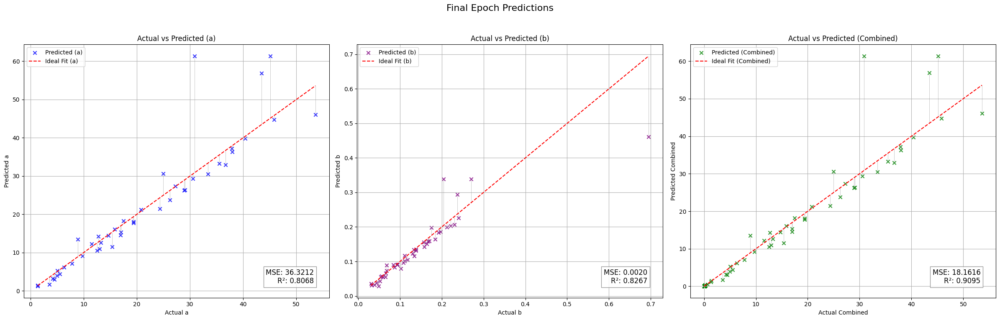

Validation Metrics:
  - MSE: 13.1217
  - R²: 0.8698
  - MAE: 1.1839
  - Explained Variance Score (EVS): 0.8747
Fold 4 Metrics:
  - Validation Loss (MSE): 13.1217
  - R²: 0.8698
  - MAE: 1.1839
  - EVS: 0.8747
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.47it/s, loss=0.556]


Validation Metrics:
  - MSE: 33.3592
  - R²: 0.8262
  - MAE: 1.6327
  - Explained Variance Score (EVS): 0.8350
Epoch [1/50], Train Loss: 0.5142, Val Loss: 33.3592
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s, loss=0.476]


Validation Metrics:
  - MSE: 32.3307
  - R²: 0.8336
  - MAE: 1.5665
  - Explained Variance Score (EVS): 0.8407
Epoch [2/50], Train Loss: 0.5177, Val Loss: 32.3307
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=0.545]


Validation Metrics:
  - MSE: 33.0794
  - R²: 0.8314
  - MAE: 1.5406
  - Explained Variance Score (EVS): 0.8381
Epoch [3/50], Train Loss: 0.5054, Val Loss: 33.0794
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  9.47it/s, loss=0.469]


Validation Metrics:
  - MSE: 32.5266
  - R²: 0.8335
  - MAE: 1.5306
  - Explained Variance Score (EVS): 0.8392
Epoch [4/50], Train Loss: 0.4966, Val Loss: 32.5266
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.05it/s, loss=0.564]


Validation Metrics:
  - MSE: 32.9338
  - R²: 0.8340
  - MAE: 1.5417
  - Explained Variance Score (EVS): 0.8393
Epoch [5/50], Train Loss: 0.5045, Val Loss: 32.9338
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  9.16it/s, loss=0.548]


Validation Metrics:
  - MSE: 30.9898
  - R²: 0.8412
  - MAE: 1.5032
  - Explained Variance Score (EVS): 0.8460
Epoch [6/50], Train Loss: 0.4994, Val Loss: 30.9898
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  9.06it/s, loss=0.612]


Validation Metrics:
  - MSE: 30.4676
  - R²: 0.8435
  - MAE: 1.5077
  - Explained Variance Score (EVS): 0.8468
Epoch [7/50], Train Loss: 0.5015, Val Loss: 30.4676
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.87it/s, loss=0.487]


Validation Metrics:
  - MSE: 30.8329
  - R²: 0.8432
  - MAE: 1.4947
  - Explained Variance Score (EVS): 0.8466
Epoch [8/50], Train Loss: 0.4931, Val Loss: 30.8329
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.39it/s, loss=0.458]


Validation Metrics:
  - MSE: 30.7840
  - R²: 0.8438
  - MAE: 1.5084
  - Explained Variance Score (EVS): 0.8470
Epoch [9/50], Train Loss: 0.4957, Val Loss: 30.7840
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00, 10.06it/s, loss=0.563]


Validation Metrics:
  - MSE: 32.1524
  - R²: 0.8371
  - MAE: 1.5086
  - Explained Variance Score (EVS): 0.8432
Epoch [10/50], Train Loss: 0.5064, Val Loss: 32.1524
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=0.467]


Validation Metrics:
  - MSE: 31.3605
  - R²: 0.8402
  - MAE: 1.4821
  - Explained Variance Score (EVS): 0.8448
Epoch [11/50], Train Loss: 0.4894, Val Loss: 31.3605
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.36it/s, loss=0.557]


Validation Metrics:
  - MSE: 31.6829
  - R²: 0.8353
  - MAE: 1.5026
  - Explained Variance Score (EVS): 0.8430
Epoch [12/50], Train Loss: 0.4993, Val Loss: 31.6829
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.25it/s, loss=0.478]


Validation Metrics:
  - MSE: 32.4132
  - R²: 0.8324
  - MAE: 1.4847
  - Explained Variance Score (EVS): 0.8389
Epoch [13/50], Train Loss: 0.5087, Val Loss: 32.4132
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.10it/s, loss=0.434]


Validation Metrics:
  - MSE: 32.8605
  - R²: 0.8290
  - MAE: 1.5011
  - Explained Variance Score (EVS): 0.8370
Epoch [14/50], Train Loss: 0.4912, Val Loss: 32.8605
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.43it/s, loss=0.563]


Validation Metrics:
  - MSE: 32.5574
  - R²: 0.8288
  - MAE: 1.4899
  - Explained Variance Score (EVS): 0.8379
Epoch [15/50], Train Loss: 0.5061, Val Loss: 32.5574
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=0.475]


Validation Metrics:
  - MSE: 31.7352
  - R²: 0.8343
  - MAE: 1.4550
  - Explained Variance Score (EVS): 0.8404
Epoch [16/50], Train Loss: 0.4814, Val Loss: 31.7352
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  8.47it/s, loss=0.497]


Validation Metrics:
  - MSE: 32.5674
  - R²: 0.8309
  - MAE: 1.5122
  - Explained Variance Score (EVS): 0.8409
Epoch [17/50], Train Loss: 0.5005, Val Loss: 32.5674
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


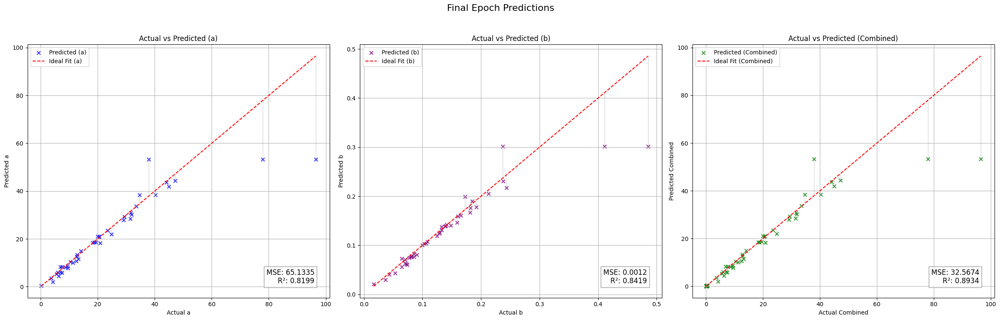

[I 2024-12-01 17:43:01,942] Trial 29 finished with value: 20.607755661010742 and parameters: {'num_layers': 2, 'hidden_size_0': 506, 'activation_0': 'LeakyReLU', 'dropout_0': 0.18602451688507166, 'hidden_size_1': 382, 'activation_1': 'LeakyReLU', 'dropout_1': 0.3372970746522718, 'batch_size': 32, 'learning_rate': 0.00010739037697128825, 'optimizer': 'AdamW'}. Best is trial 29 with value: 20.607755661010742.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 30.4676
  - R²: 0.8435
  - MAE: 1.5077
  - Explained Variance Score (EVS): 0.8468
Fold 5 Metrics:
  - Validation Loss (MSE): 30.4676
  - R²: 0.8435
  - MAE: 1.5077
  - EVS: 0.8468
Avg Validation Metrics:
  - MSE: 20.6078
  - R²: 0.8678
  - MAE: 1.5257
  - EVS: 0.8720
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  9.34it/s, loss=1.3]


Validation Metrics:
  - MSE: 197.0026
  - R²: -0.0156
  - MAE: 6.5335
  - Explained Variance Score (EVS): -0.0005
Epoch [1/50], Train Loss: 1.3774, Val Loss: 197.0026
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.03it/s, loss=0.755]


Validation Metrics:
  - MSE: 196.4420
  - R²: -0.0157
  - MAE: 6.5091
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.9250, Val Loss: 196.4420
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.48it/s, loss=0.682]


Validation Metrics:
  - MSE: 196.1675
  - R²: -0.0153
  - MAE: 6.4871
  - Explained Variance Score (EVS): 0.0011
Epoch [3/50], Train Loss: 0.6620, Val Loss: 196.1675
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.62it/s, loss=0.485]


Validation Metrics:
  - MSE: 196.3087
  - R²: -0.0157
  - MAE: 6.4749
  - Explained Variance Score (EVS): 0.0016
Epoch [4/50], Train Loss: 0.5439, Val Loss: 196.3087
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=0.854]


Validation Metrics:
  - MSE: 196.8252
  - R²: -0.0175
  - MAE: 6.4704
  - Explained Variance Score (EVS): 0.0008
Epoch [5/50], Train Loss: 0.5619, Val Loss: 196.8252
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.64it/s, loss=0.773]


Validation Metrics:
  - MSE: 197.2233
  - R²: -0.0190
  - MAE: 6.4662
  - Explained Variance Score (EVS): -0.0001
Epoch [6/50], Train Loss: 0.5606, Val Loss: 197.2233
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.57it/s, loss=0.348]


Validation Metrics:
  - MSE: 197.1732
  - R²: -0.0189
  - MAE: 6.4599
  - Explained Variance Score (EVS): 0.0002
Epoch [7/50], Train Loss: 0.4963, Val Loss: 197.1732
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.57it/s, loss=0.562]


Validation Metrics:
  - MSE: 197.1315
  - R²: -0.0187
  - MAE: 6.4535
  - Explained Variance Score (EVS): 0.0007
Epoch [8/50], Train Loss: 0.4795, Val Loss: 197.1315
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.50it/s, loss=0.562]


Validation Metrics:
  - MSE: 197.2550
  - R²: -0.0191
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0006
Epoch [9/50], Train Loss: 0.4557, Val Loss: 197.2550
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.27it/s, loss=0.259]


Validation Metrics:
  - MSE: 197.2996
  - R²: -0.0196
  - MAE: 6.4500
  - Explained Variance Score (EVS): 0.0003
Epoch [10/50], Train Loss: 0.4169, Val Loss: 197.2996
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.62it/s, loss=0.432]


Validation Metrics:
  - MSE: 197.3156
  - R²: -0.0193
  - MAE: 6.4496
  - Explained Variance Score (EVS): 0.0006
Epoch [11/50], Train Loss: 0.4292, Val Loss: 197.3156
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.82it/s, loss=0.266]


Validation Metrics:
  - MSE: 197.4197
  - R²: -0.0199
  - MAE: 6.4504
  - Explained Variance Score (EVS): 0.0002
Epoch [12/50], Train Loss: 0.4110, Val Loss: 197.4197
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  9.10it/s, loss=0.563]


Validation Metrics:
  - MSE: 197.4691
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.4321, Val Loss: 197.4691
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


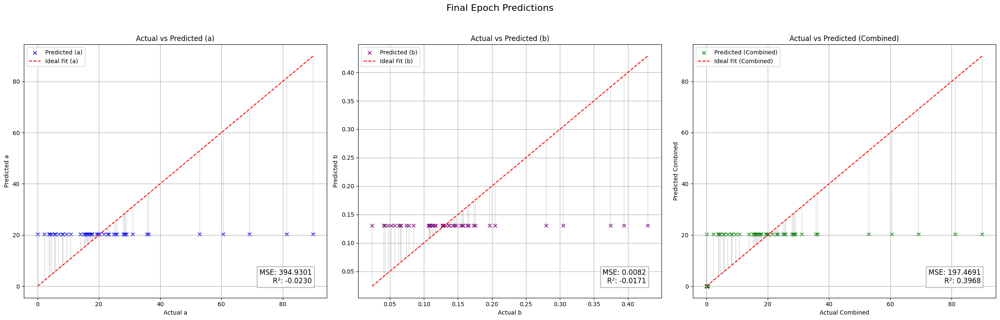

Validation Metrics:
  - MSE: 196.1675
  - R²: -0.0153
  - MAE: 6.4871
  - Explained Variance Score (EVS): 0.0011
Fold 1 Metrics:
  - Validation Loss (MSE): 196.1675
  - R²: -0.0153
  - MAE: 6.4871
  - EVS: 0.0011
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  9.05it/s, loss=0.386]


Validation Metrics:
  - MSE: 100.1847
  - R²: -0.1825
  - MAE: 6.0350
  - Explained Variance Score (EVS): 0.0024
Epoch [1/50], Train Loss: 0.5305, Val Loss: 100.1847
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.10it/s, loss=0.6]


Validation Metrics:
  - MSE: 99.7734
  - R²: -0.1790
  - MAE: 6.0144
  - Explained Variance Score (EVS): 0.0012
Epoch [2/50], Train Loss: 0.4797, Val Loss: 99.7734
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.74it/s, loss=0.453]


Validation Metrics:
  - MSE: 99.2989
  - R²: -0.1766
  - MAE: 5.9921
  - Explained Variance Score (EVS): 0.0014
Epoch [3/50], Train Loss: 0.4382, Val Loss: 99.2989
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.09it/s, loss=0.53]


Validation Metrics:
  - MSE: 98.9383
  - R²: -0.1747
  - MAE: 5.9756
  - Explained Variance Score (EVS): 0.0011
Epoch [4/50], Train Loss: 0.4388, Val Loss: 98.9383
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s, loss=0.369]


Validation Metrics:
  - MSE: 98.6225
  - R²: -0.1726
  - MAE: 5.9621
  - Explained Variance Score (EVS): 0.0011
Epoch [5/50], Train Loss: 0.4197, Val Loss: 98.6225
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.54it/s, loss=0.382]


Validation Metrics:
  - MSE: 98.3871
  - R²: -0.1715
  - MAE: 5.9520
  - Explained Variance Score (EVS): 0.0007
Epoch [6/50], Train Loss: 0.4157, Val Loss: 98.3871
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.14it/s, loss=0.296]


Validation Metrics:
  - MSE: 98.3264
  - R²: -0.1705
  - MAE: 5.9489
  - Explained Variance Score (EVS): 0.0008
Epoch [7/50], Train Loss: 0.3989, Val Loss: 98.3264
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.73it/s, loss=0.586]


Validation Metrics:
  - MSE: 98.2360
  - R²: -0.1699
  - MAE: 5.9453
  - Explained Variance Score (EVS): 0.0009
Epoch [8/50], Train Loss: 0.4226, Val Loss: 98.2360
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.97it/s, loss=0.316]


Validation Metrics:
  - MSE: 98.2057
  - R²: -0.1697
  - MAE: 5.9444
  - Explained Variance Score (EVS): 0.0009
Epoch [9/50], Train Loss: 0.3985, Val Loss: 98.2057
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  9.30it/s, loss=0.705]


Validation Metrics:
  - MSE: 98.2163
  - R²: -0.1699
  - MAE: 5.9448
  - Explained Variance Score (EVS): 0.0010
Epoch [10/50], Train Loss: 0.4297, Val Loss: 98.2163
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.72it/s, loss=0.433]


Validation Metrics:
  - MSE: 98.2275
  - R²: -0.1699
  - MAE: 5.9448
  - Explained Variance Score (EVS): 0.0010
Epoch [11/50], Train Loss: 0.4034, Val Loss: 98.2275
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.97it/s, loss=0.28]


Validation Metrics:
  - MSE: 98.2491
  - R²: -0.1699
  - MAE: 5.9460
  - Explained Variance Score (EVS): 0.0010
Epoch [12/50], Train Loss: 0.3891, Val Loss: 98.2491
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.87it/s, loss=0.434]


Validation Metrics:
  - MSE: 98.2805
  - R²: -0.1701
  - MAE: 5.9475
  - Explained Variance Score (EVS): 0.0008
Epoch [13/50], Train Loss: 0.4023, Val Loss: 98.2805
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.64it/s, loss=0.814]


Validation Metrics:
  - MSE: 98.3190
  - R²: -0.1704
  - MAE: 5.9487
  - Explained Variance Score (EVS): 0.0006
Epoch [14/50], Train Loss: 0.4351, Val Loss: 98.3190
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  9.08it/s, loss=0.691]


Validation Metrics:
  - MSE: 98.3274
  - R²: -0.1706
  - MAE: 5.9491
  - Explained Variance Score (EVS): 0.0004
Epoch [15/50], Train Loss: 0.4236, Val Loss: 98.3274
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  9.62it/s, loss=0.807]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4335, Val Loss: 98.3532
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=0.203]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3796, Val Loss: 98.3532
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.14it/s, loss=0.32]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3895, Val Loss: 98.3532
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  8.32it/s, loss=0.394]


Validation Metrics:
  - MSE: 98.2585
  - R²: -0.1704
  - MAE: 5.9465
  - Explained Variance Score (EVS): 0.0004
Epoch [19/50], Train Loss: 0.3957, Val Loss: 98.2585
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


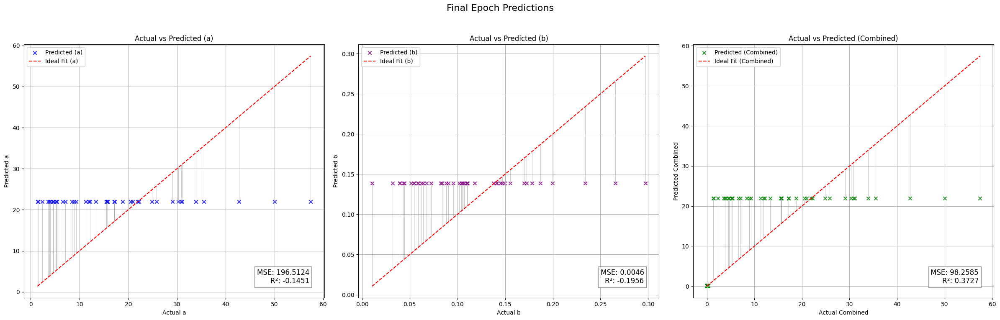

Validation Metrics:
  - MSE: 98.2057
  - R²: -0.1697
  - MAE: 5.9444
  - Explained Variance Score (EVS): 0.0009
Fold 2 Metrics:
  - Validation Loss (MSE): 98.2057
  - R²: -0.1697
  - MAE: 5.9444
  - EVS: 0.0009
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=0.42]


Validation Metrics:
  - MSE: 111.2330
  - R²: -0.0004
  - MAE: 5.4355
  - Explained Variance Score (EVS): 0.0003
Epoch [1/50], Train Loss: 0.4023, Val Loss: 111.2330
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.15it/s, loss=0.238]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3834, Val Loss: 111.2922
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.94it/s, loss=0.315]


Validation Metrics:
  - MSE: 111.2864
  - R²: -0.0007
  - MAE: 5.4380
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3897, Val Loss: 111.2864
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  9.45it/s, loss=0.21]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3803, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.19it/s, loss=0.483]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4037, Val Loss: 111.2861
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=0.546]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4083, Val Loss: 111.2861
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.96it/s, loss=0.451]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3997, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.20it/s, loss=0.597]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4123, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.26it/s, loss=0.635]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4152, Val Loss: 111.2861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.11it/s, loss=0.401]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3942, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=0.256]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3812, Val Loss: 111.2861
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


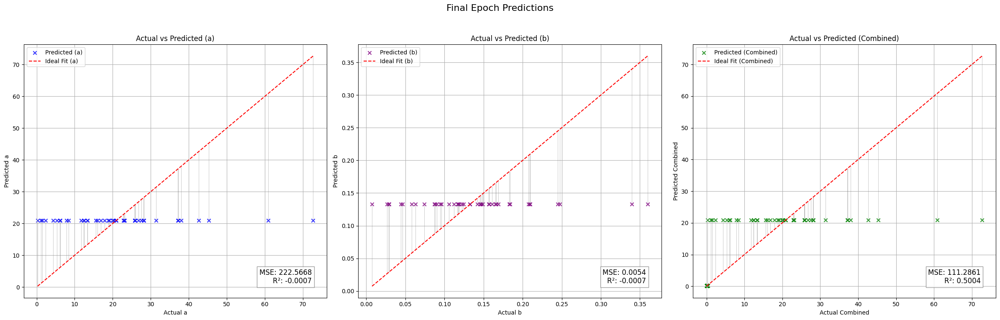

Validation Metrics:
  - MSE: 111.2330
  - R²: -0.0004
  - MAE: 5.4355
  - Explained Variance Score (EVS): 0.0003
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2330
  - R²: -0.0004
  - MAE: 5.4355
  - EVS: 0.0003
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.932]


Validation Metrics:
  - MSE: 94.0305
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4552, Val Loss: 94.0305
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.69it/s, loss=0.371]


Validation Metrics:
  - MSE: 94.0137
  - R²: -0.0028
  - MAE: 5.9017
  - Explained Variance Score (EVS): 0.0001
Epoch [2/50], Train Loss: 0.4046, Val Loss: 94.0137
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.17it/s, loss=0.364]


Validation Metrics:
  - MSE: 93.9918
  - R²: -0.0027
  - MAE: 5.9010
  - Explained Variance Score (EVS): 0.0002
Epoch [3/50], Train Loss: 0.4030, Val Loss: 93.9918
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.83it/s, loss=0.498]


Validation Metrics:
  - MSE: 94.0123
  - R²: -0.0028
  - MAE: 5.9028
  - Explained Variance Score (EVS): 0.0001
Epoch [4/50], Train Loss: 0.4147, Val Loss: 94.0123
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00, 10.11it/s, loss=0.687]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4316, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.61it/s, loss=0.388]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4049, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  9.39it/s, loss=0.686]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4310, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.05it/s, loss=0.734]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4350, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.96it/s, loss=0.354]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4013, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.00it/s, loss=0.671]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4293, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=0.495]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4135, Val Loss: 94.0374
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=0.407]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4056, Val Loss: 94.0374
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.12it/s, loss=0.459]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4102, Val Loss: 94.0374
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


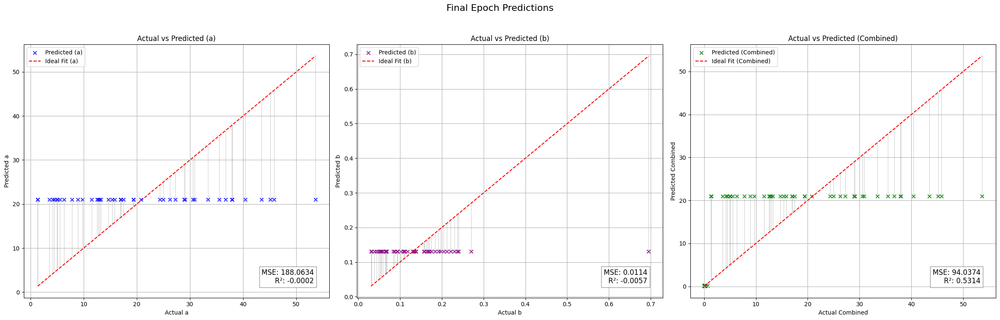

Validation Metrics:
  - MSE: 93.9918
  - R²: -0.0027
  - MAE: 5.9010
  - Explained Variance Score (EVS): 0.0002
Fold 4 Metrics:
  - Validation Loss (MSE): 93.9918
  - R²: -0.0027
  - MAE: 5.9010
  - EVS: 0.0002
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  9.30it/s, loss=0.35]


Validation Metrics:
  - MSE: 182.6404
  - R²: -0.0069
  - MAE: 6.7479
  - Explained Variance Score (EVS): 0.0004
Epoch [1/50], Train Loss: 0.4004, Val Loss: 182.6404
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.52it/s, loss=0.463]


Validation Metrics:
  - MSE: 182.5617
  - R²: -0.0067
  - MAE: 6.7466
  - Explained Variance Score (EVS): 0.0006
Epoch [2/50], Train Loss: 0.4096, Val Loss: 182.5617
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.00it/s, loss=0.367]


Validation Metrics:
  - MSE: 182.5617
  - R²: -0.0066
  - MAE: 6.7466
  - Explained Variance Score (EVS): 0.0007
Epoch [3/50], Train Loss: 0.4015, Val Loss: 182.5617
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00, 10.23it/s, loss=0.327]


Validation Metrics:
  - MSE: 182.5600
  - R²: -0.0066
  - MAE: 6.7466
  - Explained Variance Score (EVS): 0.0007
Epoch [4/50], Train Loss: 0.3981, Val Loss: 182.5600
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.60it/s, loss=0.577]


Validation Metrics:
  - MSE: 182.5725
  - R²: -0.0066
  - MAE: 6.7475
  - Explained Variance Score (EVS): 0.0007
Epoch [5/50], Train Loss: 0.4189, Val Loss: 182.5725
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.81it/s, loss=0.492]


Validation Metrics:
  - MSE: 182.5913
  - R²: -0.0067
  - MAE: 6.7484
  - Explained Variance Score (EVS): 0.0006
Epoch [6/50], Train Loss: 0.4117, Val Loss: 182.5913
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.13it/s, loss=0.325]


Validation Metrics:
  - MSE: 182.6337
  - R²: -0.0068
  - MAE: 6.7499
  - Explained Variance Score (EVS): 0.0005
Epoch [7/50], Train Loss: 0.3978, Val Loss: 182.6337
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=0.311]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0069
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0004
Epoch [8/50], Train Loss: 0.3965, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.374]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [9/50], Train Loss: 0.4018, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.87it/s, loss=0.204]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3876, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.40it/s, loss=0.498]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [11/50], Train Loss: 0.4121, Val Loss: 182.6491
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.74it/s, loss=0.596]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.4202, Val Loss: 182.6491
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  9.03it/s, loss=0.21]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0069
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0004
Epoch [13/50], Train Loss: 0.3880, Val Loss: 182.6491
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.85it/s, loss=0.512]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0070
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0003
Epoch [14/50], Train Loss: 0.4132, Val Loss: 182.6491
Current Dropout Rate: 0.3960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


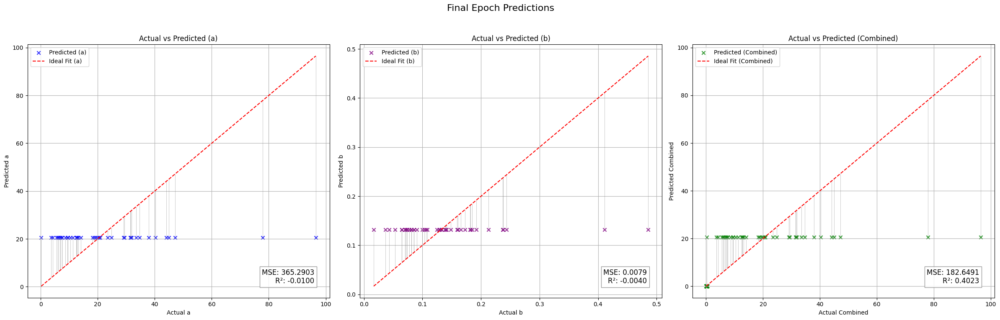

[I 2024-12-01 17:44:50,322] Trial 30 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.5600
  - R²: -0.0066
  - MAE: 6.7466
  - Explained Variance Score (EVS): 0.0007
Fold 5 Metrics:
  - Validation Loss (MSE): 182.5600
  - R²: -0.0066
  - MAE: 6.7466
  - EVS: 0.0007
Avg Validation Metrics:
  - MSE: 136.4316
  - R²: -0.0389
  - MAE: 6.1029
  - EVS: 0.0007
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.71it/s, loss=1.82]


Validation Metrics:
  - MSE: 190.1727
  - R²: -0.0036
  - MAE: 6.3418
  - Explained Variance Score (EVS): 0.0341
Epoch [1/50], Train Loss: 2.0472, Val Loss: 190.1727
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.07it/s, loss=1.91]


Validation Metrics:
  - MSE: 192.5608
  - R²: -0.0805
  - MAE: 6.1445
  - Explained Variance Score (EVS): 0.0659
Epoch [2/50], Train Loss: 1.9236, Val Loss: 192.5608
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  9.16it/s, loss=1.78]


Validation Metrics:
  - MSE: 191.1106
  - R²: -0.1076
  - MAE: 6.0598
  - Explained Variance Score (EVS): 0.1062
Epoch [3/50], Train Loss: 1.8388, Val Loss: 191.1106
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.85it/s, loss=1.93]


Validation Metrics:
  - MSE: 184.6988
  - R²: -0.0629
  - MAE: 5.9692
  - Explained Variance Score (EVS): 0.1623
Epoch [4/50], Train Loss: 1.8237, Val Loss: 184.6988
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.87it/s, loss=1.96]


Validation Metrics:
  - MSE: 173.8756
  - R²: -0.0005
  - MAE: 5.7929
  - Explained Variance Score (EVS): 0.2482
Epoch [5/50], Train Loss: 1.7904, Val Loss: 173.8756
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=1.66]


Validation Metrics:
  - MSE: 155.9656
  - R²: 0.0852
  - MAE: 5.3743
  - Explained Variance Score (EVS): 0.3507
Epoch [6/50], Train Loss: 1.7318, Val Loss: 155.9656
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=1.62]


Validation Metrics:
  - MSE: 140.0307
  - R²: 0.2227
  - MAE: 5.0237
  - Explained Variance Score (EVS): 0.4293
Epoch [7/50], Train Loss: 1.6908, Val Loss: 140.0307
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.45it/s, loss=1.77]


Validation Metrics:
  - MSE: 123.1272
  - R²: 0.3950
  - MAE: 4.7027
  - Explained Variance Score (EVS): 0.5284
Epoch [8/50], Train Loss: 1.6652, Val Loss: 123.1272
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s, loss=1.59]


Validation Metrics:
  - MSE: 84.8353
  - R²: 0.5859
  - MAE: 3.8556
  - Explained Variance Score (EVS): 0.6411
Epoch [9/50], Train Loss: 1.6110, Val Loss: 84.8353
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.64it/s, loss=1.57]


Validation Metrics:
  - MSE: 83.2840
  - R²: 0.6144
  - MAE: 3.6474
  - Explained Variance Score (EVS): 0.6533
Epoch [10/50], Train Loss: 1.5996, Val Loss: 83.2840
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=1.46]


Validation Metrics:
  - MSE: 68.2451
  - R²: 0.6530
  - MAE: 3.5112
  - Explained Variance Score (EVS): 0.6833
Epoch [11/50], Train Loss: 1.5361, Val Loss: 68.2451
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  9.46it/s, loss=1.5]


Validation Metrics:
  - MSE: 61.6721
  - R²: 0.6984
  - MAE: 3.2145
  - Explained Variance Score (EVS): 0.7204
Epoch [12/50], Train Loss: 1.5086, Val Loss: 61.6721
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.95it/s, loss=1.43]


Validation Metrics:
  - MSE: 54.1846
  - R²: 0.7459
  - MAE: 3.1138
  - Explained Variance Score (EVS): 0.7629
Epoch [13/50], Train Loss: 1.4597, Val Loss: 54.1846
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.41it/s, loss=1.67]


Validation Metrics:
  - MSE: 50.3029
  - R²: 0.7285
  - MAE: 3.0826
  - Explained Variance Score (EVS): 0.7450
Epoch [14/50], Train Loss: 1.4393, Val Loss: 50.3029
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.82it/s, loss=1.32]


Validation Metrics:
  - MSE: 49.2460
  - R²: 0.7371
  - MAE: 3.1220
  - Explained Variance Score (EVS): 0.7420
Epoch [15/50], Train Loss: 1.3857, Val Loss: 49.2460
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.75it/s, loss=1.28]


Validation Metrics:
  - MSE: 53.1707
  - R²: 0.7370
  - MAE: 3.0261
  - Explained Variance Score (EVS): 0.7516
Epoch [16/50], Train Loss: 1.3059, Val Loss: 53.1707
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.50it/s, loss=1.2]


Validation Metrics:
  - MSE: 51.7281
  - R²: 0.7480
  - MAE: 2.9660
  - Explained Variance Score (EVS): 0.7671
Epoch [17/50], Train Loss: 1.2686, Val Loss: 51.7281
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  6.95it/s, loss=1.27]


Validation Metrics:
  - MSE: 53.6923
  - R²: 0.7199
  - MAE: 3.1890
  - Explained Variance Score (EVS): 0.7291
Epoch [18/50], Train Loss: 1.2471, Val Loss: 53.6923
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  7.62it/s, loss=1.23]


Validation Metrics:
  - MSE: 60.1249
  - R²: 0.7120
  - MAE: 3.0982
  - Explained Variance Score (EVS): 0.7258
Epoch [19/50], Train Loss: 1.1936, Val Loss: 60.1249
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  7.32it/s, loss=1.09]


Validation Metrics:
  - MSE: 58.9609
  - R²: 0.7221
  - MAE: 3.0965
  - Explained Variance Score (EVS): 0.7448
Epoch [20/50], Train Loss: 1.1402, Val Loss: 58.9609
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  8.04it/s, loss=1.09]


Validation Metrics:
  - MSE: 62.1864
  - R²: 0.6740
  - MAE: 3.4770
  - Explained Variance Score (EVS): 0.6993
Epoch [21/50], Train Loss: 1.1289, Val Loss: 62.1864
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  8.47it/s, loss=0.974]


Validation Metrics:
  - MSE: 49.3198
  - R²: 0.7461
  - MAE: 2.9413
  - Explained Variance Score (EVS): 0.7627
Epoch [22/50], Train Loss: 1.0739, Val Loss: 49.3198
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  8.92it/s, loss=0.99]


Validation Metrics:
  - MSE: 53.3748
  - R²: 0.7552
  - MAE: 3.2657
  - Explained Variance Score (EVS): 0.7670
Epoch [23/50], Train Loss: 1.0252, Val Loss: 53.3748
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  8.34it/s, loss=0.975]


Validation Metrics:
  - MSE: 79.2890
  - R²: 0.6150
  - MAE: 3.5288
  - Explained Variance Score (EVS): 0.6400
Epoch [24/50], Train Loss: 0.9948, Val Loss: 79.2890
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  8.30it/s, loss=0.977]


Validation Metrics:
  - MSE: 67.4692
  - R²: 0.6694
  - MAE: 3.3194
  - Explained Variance Score (EVS): 0.6957
Epoch [25/50], Train Loss: 0.9484, Val Loss: 67.4692
Current Dropout Rate: 0.3080
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


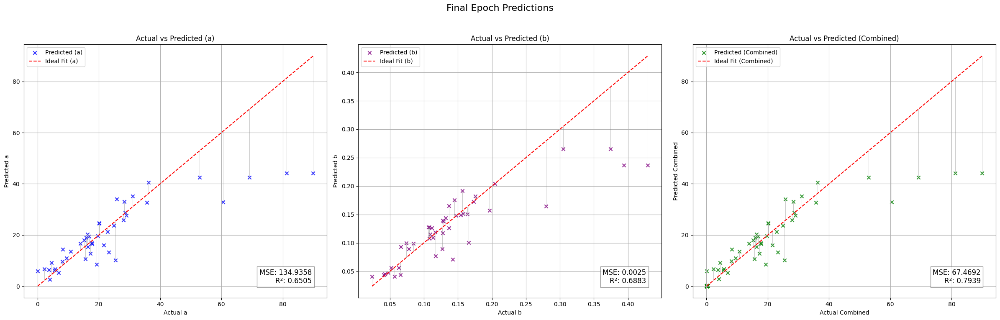

Validation Metrics:
  - MSE: 49.2460
  - R²: 0.7371
  - MAE: 3.1220
  - Explained Variance Score (EVS): 0.7420
Fold 1 Metrics:
  - Validation Loss (MSE): 49.2460
  - R²: 0.7371
  - MAE: 3.1220
  - EVS: 0.7420
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.69it/s, loss=1.49]


Validation Metrics:
  - MSE: 8.5834
  - R²: 0.9170
  - MAE: 1.4801
  - Explained Variance Score (EVS): 0.9317
Epoch [1/50], Train Loss: 1.3820, Val Loss: 8.5834
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.27it/s, loss=1.25]


Validation Metrics:
  - MSE: 5.3339
  - R²: 0.9419
  - MAE: 1.3089
  - Explained Variance Score (EVS): 0.9419
Epoch [2/50], Train Loss: 1.3075, Val Loss: 5.3339
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.60it/s, loss=1.25]


Validation Metrics:
  - MSE: 3.6591
  - R²: 0.9445
  - MAE: 1.0624
  - Explained Variance Score (EVS): 0.9471
Epoch [3/50], Train Loss: 1.2866, Val Loss: 3.6591
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s, loss=1.18]


Validation Metrics:
  - MSE: 5.0765
  - R²: 0.9426
  - MAE: 1.2531
  - Explained Variance Score (EVS): 0.9477
Epoch [4/50], Train Loss: 1.2292, Val Loss: 5.0765
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.23it/s, loss=1.21]


Validation Metrics:
  - MSE: 5.3462
  - R²: 0.9354
  - MAE: 1.2817
  - Explained Variance Score (EVS): 0.9405
Epoch [5/50], Train Loss: 1.2045, Val Loss: 5.3462
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=1.17]


Validation Metrics:
  - MSE: 6.7603
  - R²: 0.9235
  - MAE: 1.3175
  - Explained Variance Score (EVS): 0.9240
Epoch [6/50], Train Loss: 1.1752, Val Loss: 6.7603
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=1.08]


Validation Metrics:
  - MSE: 6.5852
  - R²: 0.9070
  - MAE: 1.2850
  - Explained Variance Score (EVS): 0.9116
Epoch [7/50], Train Loss: 1.1193, Val Loss: 6.5852
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.92it/s, loss=1.13]


Validation Metrics:
  - MSE: 5.6094
  - R²: 0.9226
  - MAE: 1.2225
  - Explained Variance Score (EVS): 0.9268
Epoch [8/50], Train Loss: 1.0776, Val Loss: 5.6094
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.37it/s, loss=0.972]


Validation Metrics:
  - MSE: 7.3298
  - R²: 0.8885
  - MAE: 1.4494
  - Explained Variance Score (EVS): 0.8975
Epoch [9/50], Train Loss: 1.0337, Val Loss: 7.3298
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.82it/s, loss=1.08]


Validation Metrics:
  - MSE: 10.1146
  - R²: 0.8797
  - MAE: 1.4413
  - Explained Variance Score (EVS): 0.8818
Epoch [10/50], Train Loss: 1.0304, Val Loss: 10.1146
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.67it/s, loss=0.923]


Validation Metrics:
  - MSE: 5.0314
  - R²: 0.9292
  - MAE: 1.2175
  - Explained Variance Score (EVS): 0.9343
Epoch [11/50], Train Loss: 0.9663, Val Loss: 5.0314
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.68it/s, loss=1.03]


Validation Metrics:
  - MSE: 5.8484
  - R²: 0.9143
  - MAE: 1.2938
  - Explained Variance Score (EVS): 0.9189
Epoch [12/50], Train Loss: 0.9493, Val Loss: 5.8484
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  9.35it/s, loss=0.844]


Validation Metrics:
  - MSE: 5.4337
  - R²: 0.9170
  - MAE: 1.3050
  - Explained Variance Score (EVS): 0.9172
Epoch [13/50], Train Loss: 0.9067, Val Loss: 5.4337
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


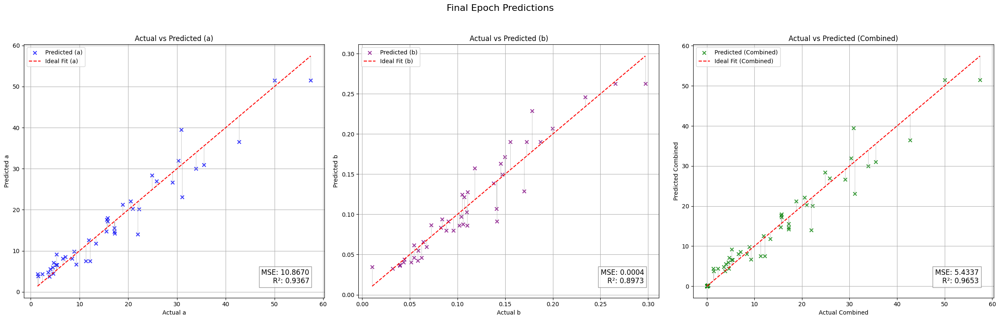

Validation Metrics:
  - MSE: 3.6591
  - R²: 0.9445
  - MAE: 1.0624
  - Explained Variance Score (EVS): 0.9471
Fold 2 Metrics:
  - Validation Loss (MSE): 3.6591
  - R²: 0.9445
  - MAE: 1.0624
  - EVS: 0.9471
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=1.32]


Validation Metrics:
  - MSE: 18.7298
  - R²: 0.8465
  - MAE: 1.7088
  - Explained Variance Score (EVS): 0.8483
Epoch [1/50], Train Loss: 1.2392, Val Loss: 18.7298
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=1.16]


Validation Metrics:
  - MSE: 24.0077
  - R²: 0.8066
  - MAE: 1.6932
  - Explained Variance Score (EVS): 0.8125
Epoch [2/50], Train Loss: 1.2150, Val Loss: 24.0077
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=1.21]


Validation Metrics:
  - MSE: 26.3006
  - R²: 0.8020
  - MAE: 1.7285
  - Explained Variance Score (EVS): 0.8083
Epoch [3/50], Train Loss: 1.1925, Val Loss: 26.3006
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.43it/s, loss=1.24]


Validation Metrics:
  - MSE: 28.0878
  - R²: 0.7953
  - MAE: 1.8364
  - Explained Variance Score (EVS): 0.7973
Epoch [4/50], Train Loss: 1.1963, Val Loss: 28.0878
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.66it/s, loss=1.12]


Validation Metrics:
  - MSE: 21.1927
  - R²: 0.8452
  - MAE: 1.7734
  - Explained Variance Score (EVS): 0.8453
Epoch [5/50], Train Loss: 1.1535, Val Loss: 21.1927
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.24it/s, loss=1.11]


Validation Metrics:
  - MSE: 18.7897
  - R²: 0.8578
  - MAE: 1.7235
  - Explained Variance Score (EVS): 0.8594
Epoch [6/50], Train Loss: 1.1331, Val Loss: 18.7897
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.45it/s, loss=1.14]


Validation Metrics:
  - MSE: 16.1577
  - R²: 0.8709
  - MAE: 1.6042
  - Explained Variance Score (EVS): 0.8718
Epoch [7/50], Train Loss: 1.1097, Val Loss: 16.1577
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  9.45it/s, loss=1.01]


Validation Metrics:
  - MSE: 16.3652
  - R²: 0.8606
  - MAE: 1.6842
  - Explained Variance Score (EVS): 0.8614
Epoch [8/50], Train Loss: 1.0877, Val Loss: 16.3652
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:01<00:00,  3.09it/s, loss=1.01]


Validation Metrics:
  - MSE: 20.0028
  - R²: 0.8063
  - MAE: 1.6356
  - Explained Variance Score (EVS): 0.8075
Epoch [9/50], Train Loss: 1.0525, Val Loss: 20.0028
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.29it/s, loss=1.1]


Validation Metrics:
  - MSE: 19.9351
  - R²: 0.8244
  - MAE: 1.7220
  - Explained Variance Score (EVS): 0.8257
Epoch [10/50], Train Loss: 1.0474, Val Loss: 19.9351
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.39it/s, loss=1.23]


Validation Metrics:
  - MSE: 19.6614
  - R²: 0.8377
  - MAE: 1.6512
  - Explained Variance Score (EVS): 0.8400
Epoch [11/50], Train Loss: 1.0330, Val Loss: 19.6614
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.14it/s, loss=1.1]


Validation Metrics:
  - MSE: 19.0330
  - R²: 0.8453
  - MAE: 1.6610
  - Explained Variance Score (EVS): 0.8464
Epoch [12/50], Train Loss: 1.0061, Val Loss: 19.0330
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.42it/s, loss=1.01]


Validation Metrics:
  - MSE: 20.1152
  - R²: 0.8379
  - MAE: 1.6900
  - Explained Variance Score (EVS): 0.8396
Epoch [13/50], Train Loss: 0.9879, Val Loss: 20.1152
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.49it/s, loss=0.992]


Validation Metrics:
  - MSE: 22.4110
  - R²: 0.8203
  - MAE: 1.7063
  - Explained Variance Score (EVS): 0.8214
Epoch [14/50], Train Loss: 0.9909, Val Loss: 22.4110
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.57it/s, loss=0.92]


Validation Metrics:
  - MSE: 20.9096
  - R²: 0.8244
  - MAE: 1.7657
  - Explained Variance Score (EVS): 0.8252
Epoch [15/50], Train Loss: 0.9494, Val Loss: 20.9096
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=0.995]


Validation Metrics:
  - MSE: 19.2719
  - R²: 0.8347
  - MAE: 1.7978
  - Explained Variance Score (EVS): 0.8348
Epoch [16/50], Train Loss: 0.9723, Val Loss: 19.2719
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s, loss=0.954]


Validation Metrics:
  - MSE: 19.6745
  - R²: 0.8275
  - MAE: 1.7602
  - Explained Variance Score (EVS): 0.8277
Epoch [17/50], Train Loss: 0.9505, Val Loss: 19.6745
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


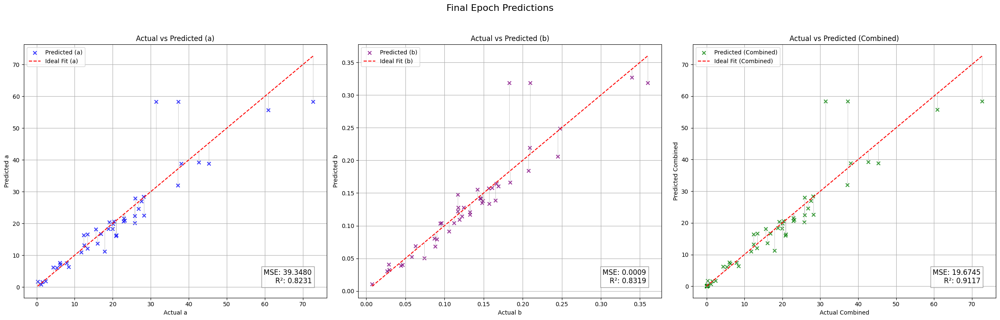

Validation Metrics:
  - MSE: 16.1577
  - R²: 0.8709
  - MAE: 1.6042
  - Explained Variance Score (EVS): 0.8718
Fold 3 Metrics:
  - Validation Loss (MSE): 16.1577
  - R²: 0.8709
  - MAE: 1.6042
  - EVS: 0.8718
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.40it/s, loss=1.14]


Validation Metrics:
  - MSE: 17.4066
  - R²: 0.7191
  - MAE: 1.6000
  - Explained Variance Score (EVS): 0.7225
Epoch [1/50], Train Loss: 1.0910, Val Loss: 17.4066
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.61it/s, loss=1.01]


Validation Metrics:
  - MSE: 21.3858
  - R²: 0.6905
  - MAE: 1.7368
  - Explained Variance Score (EVS): 0.6925
Epoch [2/50], Train Loss: 1.0778, Val Loss: 21.3858
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.38it/s, loss=1.15]


Validation Metrics:
  - MSE: 22.3055
  - R²: 0.6830
  - MAE: 1.7644
  - Explained Variance Score (EVS): 0.6848
Epoch [3/50], Train Loss: 1.0792, Val Loss: 22.3055
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.58it/s, loss=1.08]


Validation Metrics:
  - MSE: 28.8320
  - R²: 0.6350
  - MAE: 1.9623
  - Explained Variance Score (EVS): 0.6389
Epoch [4/50], Train Loss: 1.0595, Val Loss: 28.8320
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.82it/s, loss=1.04]


Validation Metrics:
  - MSE: 29.8199
  - R²: 0.6257
  - MAE: 1.9919
  - Explained Variance Score (EVS): 0.6284
Epoch [5/50], Train Loss: 1.0408, Val Loss: 29.8199
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=1.08]


Validation Metrics:
  - MSE: 31.8363
  - R²: 0.6119
  - MAE: 2.0444
  - Explained Variance Score (EVS): 0.6151
Epoch [6/50], Train Loss: 1.0644, Val Loss: 31.8363
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=0.987]


Validation Metrics:
  - MSE: 32.5083
  - R²: 0.6045
  - MAE: 2.0772
  - Explained Variance Score (EVS): 0.6077
Epoch [7/50], Train Loss: 1.0199, Val Loss: 32.5083
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.58it/s, loss=0.999]


Validation Metrics:
  - MSE: 29.7387
  - R²: 0.6197
  - MAE: 2.0409
  - Explained Variance Score (EVS): 0.6222
Epoch [8/50], Train Loss: 1.0025, Val Loss: 29.7387
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.97it/s, loss=1.05]


Validation Metrics:
  - MSE: 33.2266
  - R²: 0.5985
  - MAE: 2.1043
  - Explained Variance Score (EVS): 0.6017
Epoch [9/50], Train Loss: 1.0191, Val Loss: 33.2266
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=1.17]


Validation Metrics:
  - MSE: 31.8903
  - R²: 0.6073
  - MAE: 2.0745
  - Explained Variance Score (EVS): 0.6108
Epoch [10/50], Train Loss: 1.0118, Val Loss: 31.8903
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.14it/s, loss=0.984]


Validation Metrics:
  - MSE: 32.2450
  - R²: 0.6061
  - MAE: 2.0914
  - Explained Variance Score (EVS): 0.6095
Epoch [11/50], Train Loss: 1.0085, Val Loss: 32.2450
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


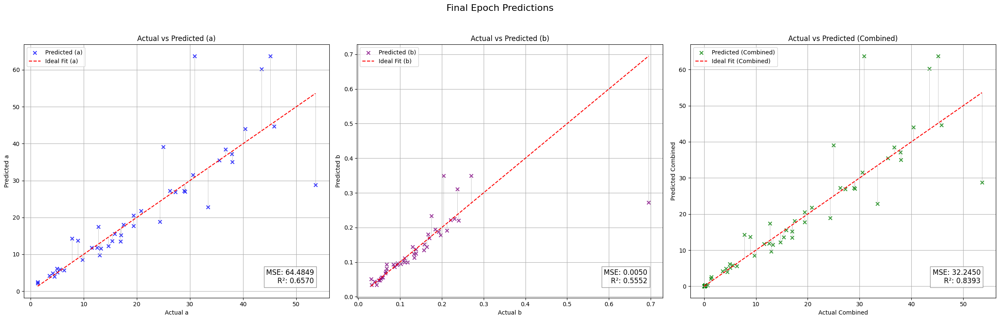

Validation Metrics:
  - MSE: 17.4066
  - R²: 0.7191
  - MAE: 1.6000
  - Explained Variance Score (EVS): 0.7225
Fold 4 Metrics:
  - Validation Loss (MSE): 17.4066
  - R²: 0.7191
  - MAE: 1.6000
  - EVS: 0.7225
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.67it/s, loss=1.08]


Validation Metrics:
  - MSE: 38.3708
  - R²: 0.8142
  - MAE: 1.8067
  - Explained Variance Score (EVS): 0.8234
Epoch [1/50], Train Loss: 1.0943, Val Loss: 38.3708
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  9.53it/s, loss=1.03]


Validation Metrics:
  - MSE: 39.0299
  - R²: 0.8081
  - MAE: 1.7802
  - Explained Variance Score (EVS): 0.8184
Epoch [2/50], Train Loss: 1.0633, Val Loss: 39.0299
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.01it/s, loss=1.01]


Validation Metrics:
  - MSE: 36.9160
  - R²: 0.8165
  - MAE: 1.7014
  - Explained Variance Score (EVS): 0.8256
Epoch [3/50], Train Loss: 1.0731, Val Loss: 36.9160
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.57it/s, loss=1.04]


Validation Metrics:
  - MSE: 37.7835
  - R²: 0.8124
  - MAE: 1.7115
  - Explained Variance Score (EVS): 0.8208
Epoch [4/50], Train Loss: 1.0684, Val Loss: 37.7835
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  9.21it/s, loss=1.17]


Validation Metrics:
  - MSE: 39.3244
  - R²: 0.8057
  - MAE: 1.7158
  - Explained Variance Score (EVS): 0.8171
Epoch [5/50], Train Loss: 1.0654, Val Loss: 39.3244
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.49it/s, loss=1.01]


Validation Metrics:
  - MSE: 39.8970
  - R²: 0.8035
  - MAE: 1.7239
  - Explained Variance Score (EVS): 0.8155
Epoch [6/50], Train Loss: 1.0517, Val Loss: 39.8970
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.20it/s, loss=1.09]


Validation Metrics:
  - MSE: 38.8313
  - R²: 0.8082
  - MAE: 1.7347
  - Explained Variance Score (EVS): 0.8192
Epoch [7/50], Train Loss: 1.0506, Val Loss: 38.8313
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.05it/s, loss=1.23]


Validation Metrics:
  - MSE: 38.8540
  - R²: 0.8075
  - MAE: 1.7368
  - Explained Variance Score (EVS): 0.8203
Epoch [8/50], Train Loss: 1.0749, Val Loss: 38.8540
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.36it/s, loss=1.1]


Validation Metrics:
  - MSE: 35.3487
  - R²: 0.8240
  - MAE: 1.6799
  - Explained Variance Score (EVS): 0.8302
Epoch [9/50], Train Loss: 1.0440, Val Loss: 35.3487
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.90it/s, loss=1.04]


Validation Metrics:
  - MSE: 34.7025
  - R²: 0.8261
  - MAE: 1.6890
  - Explained Variance Score (EVS): 0.8339
Epoch [10/50], Train Loss: 1.0382, Val Loss: 34.7025
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.41it/s, loss=0.966]


Validation Metrics:
  - MSE: 35.7933
  - R²: 0.8200
  - MAE: 1.7230
  - Explained Variance Score (EVS): 0.8300
Epoch [11/50], Train Loss: 1.0144, Val Loss: 35.7933
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.19it/s, loss=1.09]


Validation Metrics:
  - MSE: 37.7743
  - R²: 0.8100
  - MAE: 1.7653
  - Explained Variance Score (EVS): 0.8233
Epoch [12/50], Train Loss: 1.0373, Val Loss: 37.7743
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.03it/s, loss=1.08]


Validation Metrics:
  - MSE: 36.0137
  - R²: 0.8194
  - MAE: 1.7437
  - Explained Variance Score (EVS): 0.8304
Epoch [13/50], Train Loss: 1.0325, Val Loss: 36.0137
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=0.97]


Validation Metrics:
  - MSE: 35.0150
  - R²: 0.8228
  - MAE: 1.7244
  - Explained Variance Score (EVS): 0.8320
Epoch [14/50], Train Loss: 1.0210, Val Loss: 35.0150
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.79it/s, loss=1.04]


Validation Metrics:
  - MSE: 35.8338
  - R²: 0.8176
  - MAE: 1.7408
  - Explained Variance Score (EVS): 0.8277
Epoch [15/50], Train Loss: 1.0051, Val Loss: 35.8338
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.68it/s, loss=0.989]


Validation Metrics:
  - MSE: 34.5123
  - R²: 0.8249
  - MAE: 1.7184
  - Explained Variance Score (EVS): 0.8335
Epoch [16/50], Train Loss: 1.0156, Val Loss: 34.5123
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  9.25it/s, loss=1.09]


Validation Metrics:
  - MSE: 31.8678
  - R²: 0.8388
  - MAE: 1.6737
  - Explained Variance Score (EVS): 0.8436
Epoch [17/50], Train Loss: 1.0336, Val Loss: 31.8678
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.07it/s, loss=1.02]


Validation Metrics:
  - MSE: 33.3866
  - R²: 0.8304
  - MAE: 1.6806
  - Explained Variance Score (EVS): 0.8386
Epoch [18/50], Train Loss: 1.0087, Val Loss: 33.3866
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=1.04]


Validation Metrics:
  - MSE: 33.7715
  - R²: 0.8294
  - MAE: 1.6823
  - Explained Variance Score (EVS): 0.8394
Epoch [19/50], Train Loss: 1.0137, Val Loss: 33.7715
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  7.41it/s, loss=0.986]


Validation Metrics:
  - MSE: 34.5084
  - R²: 0.8251
  - MAE: 1.6958
  - Explained Variance Score (EVS): 0.8355
Epoch [20/50], Train Loss: 0.9944, Val Loss: 34.5084
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  7.07it/s, loss=0.965]


Validation Metrics:
  - MSE: 33.7260
  - R²: 0.8295
  - MAE: 1.6610
  - Explained Variance Score (EVS): 0.8380
Epoch [21/50], Train Loss: 1.0094, Val Loss: 33.7260
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  7.85it/s, loss=1]


Validation Metrics:
  - MSE: 33.2669
  - R²: 0.8317
  - MAE: 1.6508
  - Explained Variance Score (EVS): 0.8395
Epoch [22/50], Train Loss: 0.9925, Val Loss: 33.2669
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s, loss=0.936]


Validation Metrics:
  - MSE: 32.5986
  - R²: 0.8359
  - MAE: 1.6448
  - Explained Variance Score (EVS): 0.8430
Epoch [23/50], Train Loss: 1.0140, Val Loss: 32.5986
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  8.90it/s, loss=1]


Validation Metrics:
  - MSE: 31.9420
  - R²: 0.8401
  - MAE: 1.6449
  - Explained Variance Score (EVS): 0.8442
Epoch [24/50], Train Loss: 0.9987, Val Loss: 31.9420
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  8.97it/s, loss=1.01]


Validation Metrics:
  - MSE: 33.8154
  - R²: 0.8308
  - MAE: 1.6714
  - Explained Variance Score (EVS): 0.8384
Epoch [25/50], Train Loss: 0.9937, Val Loss: 33.8154
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=0.949]


Validation Metrics:
  - MSE: 33.6409
  - R²: 0.8319
  - MAE: 1.6619
  - Explained Variance Score (EVS): 0.8376
Epoch [26/50], Train Loss: 1.0021, Val Loss: 33.6409
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00,  8.68it/s, loss=0.947]


Validation Metrics:
  - MSE: 33.3241
  - R²: 0.8321
  - MAE: 1.6458
  - Explained Variance Score (EVS): 0.8396
Epoch [27/50], Train Loss: 0.9947, Val Loss: 33.3241
Current Dropout Rate: 0.2920
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


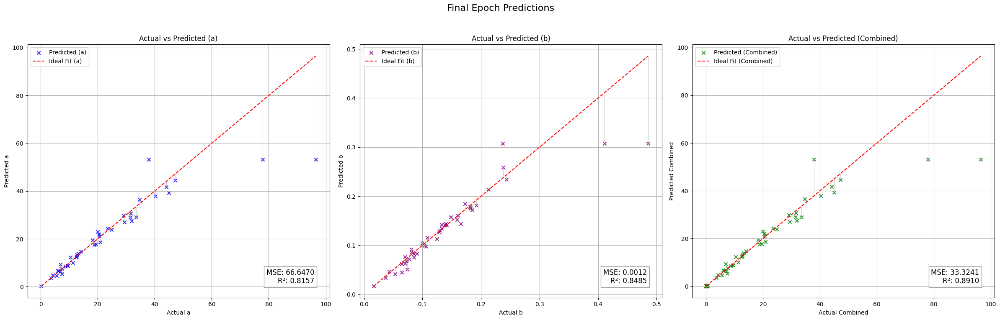

[I 2024-12-01 17:47:18,810] Trial 31 finished with value: 23.66742515563965 and parameters: {'num_layers': 2, 'hidden_size_0': 508, 'activation_0': 'LeakyReLU', 'dropout_0': 0.10364411374043206, 'hidden_size_1': 378, 'activation_1': 'LeakyReLU', 'dropout_1': 0.33151181080237757, 'batch_size': 32, 'learning_rate': 3.6655387286380145e-05, 'optimizer': 'AdamW'}. Best is trial 29 with value: 20.607755661010742.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 31.8678
  - R²: 0.8388
  - MAE: 1.6737
  - Explained Variance Score (EVS): 0.8436
Fold 5 Metrics:
  - Validation Loss (MSE): 31.8678
  - R²: 0.8388
  - MAE: 1.6737
  - EVS: 0.8436
Avg Validation Metrics:
  - MSE: 23.6674
  - R²: 0.8221
  - MAE: 1.8125
  - EVS: 0.8254
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.20it/s, loss=2.21]


Validation Metrics:
  - MSE: 196.2728
  - R²: -0.0259
  - MAE: 6.4004
  - Explained Variance Score (EVS): 0.0122
Epoch [1/50], Train Loss: 2.4614, Val Loss: 196.2728
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.69it/s, loss=2.23]


Validation Metrics:
  - MSE: 212.3452
  - R²: -0.1445
  - MAE: 6.4173
  - Explained Variance Score (EVS): 0.0324
Epoch [2/50], Train Loss: 2.3296, Val Loss: 212.3452
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.85it/s, loss=2.3]


Validation Metrics:
  - MSE: 232.2410
  - R²: -0.2988
  - MAE: 6.9164
  - Explained Variance Score (EVS): 0.0610
Epoch [3/50], Train Loss: 2.2691, Val Loss: 232.2410
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.03it/s, loss=2.08]


Validation Metrics:
  - MSE: 242.1347
  - R²: -0.3627
  - MAE: 7.1904
  - Explained Variance Score (EVS): 0.0960
Epoch [4/50], Train Loss: 2.1893, Val Loss: 242.1347
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.92it/s, loss=2.15]


Validation Metrics:
  - MSE: 238.2908
  - R²: -0.3522
  - MAE: 7.1762
  - Explained Variance Score (EVS): 0.1469
Epoch [5/50], Train Loss: 2.2002, Val Loss: 238.2908
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.28it/s, loss=2.1]


Validation Metrics:
  - MSE: 218.8474
  - R²: -0.2335
  - MAE: 6.9146
  - Explained Variance Score (EVS): 0.2432
Epoch [6/50], Train Loss: 2.1610, Val Loss: 218.8474
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s, loss=2.06]


Validation Metrics:
  - MSE: 183.4795
  - R²: 0.0008
  - MAE: 6.3650
  - Explained Variance Score (EVS): 0.4048
Epoch [7/50], Train Loss: 2.1040, Val Loss: 183.4795
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.05it/s, loss=2.11]


Validation Metrics:
  - MSE: 147.9699
  - R²: 0.2265
  - MAE: 5.5788
  - Explained Variance Score (EVS): 0.5154
Epoch [8/50], Train Loss: 2.0841, Val Loss: 147.9699
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.20it/s, loss=1.92]


Validation Metrics:
  - MSE: 125.4610
  - R²: 0.3585
  - MAE: 4.8790
  - Explained Variance Score (EVS): 0.5660
Epoch [9/50], Train Loss: 2.0294, Val Loss: 125.4610
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.20it/s, loss=1.87]


Validation Metrics:
  - MSE: 107.4782
  - R²: 0.4399
  - MAE: 4.3313
  - Explained Variance Score (EVS): 0.5963
Epoch [10/50], Train Loss: 1.9595, Val Loss: 107.4782
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.15it/s, loss=1.97]


Validation Metrics:
  - MSE: 83.2900
  - R²: 0.5740
  - MAE: 3.7356
  - Explained Variance Score (EVS): 0.6717
Epoch [11/50], Train Loss: 1.9472, Val Loss: 83.2900
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.50it/s, loss=1.85]


Validation Metrics:
  - MSE: 65.0817
  - R²: 0.6869
  - MAE: 3.3722
  - Explained Variance Score (EVS): 0.7517
Epoch [12/50], Train Loss: 1.8954, Val Loss: 65.0817
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.38it/s, loss=1.74]


Validation Metrics:
  - MSE: 68.0879
  - R²: 0.6747
  - MAE: 3.4314
  - Explained Variance Score (EVS): 0.7461
Epoch [13/50], Train Loss: 1.8335, Val Loss: 68.0879
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=1.71]


Validation Metrics:
  - MSE: 52.6578
  - R²: 0.7244
  - MAE: 3.2070
  - Explained Variance Score (EVS): 0.7801
Epoch [14/50], Train Loss: 1.7665, Val Loss: 52.6578
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  6.93it/s, loss=1.68]


Validation Metrics:
  - MSE: 56.9746
  - R²: 0.7038
  - MAE: 3.3156
  - Explained Variance Score (EVS): 0.7659
Epoch [15/50], Train Loss: 1.7349, Val Loss: 56.9746
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  6.83it/s, loss=1.59]


Validation Metrics:
  - MSE: 65.8780
  - R²: 0.6687
  - MAE: 3.2769
  - Explained Variance Score (EVS): 0.7373
Epoch [16/50], Train Loss: 1.6685, Val Loss: 65.8780
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.04it/s, loss=1.9]


Validation Metrics:
  - MSE: 75.0309
  - R²: 0.6277
  - MAE: 3.3577
  - Explained Variance Score (EVS): 0.7007
Epoch [17/50], Train Loss: 1.6540, Val Loss: 75.0309
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.39it/s, loss=1.49]


Validation Metrics:
  - MSE: 66.9951
  - R²: 0.6697
  - MAE: 3.1882
  - Explained Variance Score (EVS): 0.7275
Epoch [18/50], Train Loss: 1.5727, Val Loss: 66.9951
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  8.09it/s, loss=1.46]


Validation Metrics:
  - MSE: 61.9575
  - R²: 0.7040
  - MAE: 3.1533
  - Explained Variance Score (EVS): 0.7417
Epoch [19/50], Train Loss: 1.5217, Val Loss: 61.9575
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=1.59]


Validation Metrics:
  - MSE: 65.7368
  - R²: 0.6925
  - MAE: 3.3078
  - Explained Variance Score (EVS): 0.7400
Epoch [20/50], Train Loss: 1.4786, Val Loss: 65.7368
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  8.23it/s, loss=1.32]


Validation Metrics:
  - MSE: 61.5003
  - R²: 0.7072
  - MAE: 3.2721
  - Explained Variance Score (EVS): 0.7559
Epoch [21/50], Train Loss: 1.4121, Val Loss: 61.5003
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=1.46]


Validation Metrics:
  - MSE: 58.4247
  - R²: 0.7090
  - MAE: 3.3021
  - Explained Variance Score (EVS): 0.7744
Epoch [22/50], Train Loss: 1.3760, Val Loss: 58.4247
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  8.33it/s, loss=1.35]


Validation Metrics:
  - MSE: 48.5052
  - R²: 0.7605
  - MAE: 2.9225
  - Explained Variance Score (EVS): 0.7989
Epoch [23/50], Train Loss: 1.3033, Val Loss: 48.5052
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  8.28it/s, loss=1.27]


Validation Metrics:
  - MSE: 64.5564
  - R²: 0.6915
  - MAE: 3.2347
  - Explained Variance Score (EVS): 0.7265
Epoch [24/50], Train Loss: 1.2416, Val Loss: 64.5564
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  6.81it/s, loss=1.27]


Validation Metrics:
  - MSE: 80.6653
  - R²: 0.6271
  - MAE: 3.6072
  - Explained Variance Score (EVS): 0.6725
Epoch [25/50], Train Loss: 1.1806, Val Loss: 80.6653
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00,  7.17it/s, loss=1.04]


Validation Metrics:
  - MSE: 61.0871
  - R²: 0.7120
  - MAE: 3.2357
  - Explained Variance Score (EVS): 0.7570
Epoch [26/50], Train Loss: 1.1155, Val Loss: 61.0871
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00,  7.34it/s, loss=0.99]


Validation Metrics:
  - MSE: 60.0049
  - R²: 0.7023
  - MAE: 3.2346
  - Explained Variance Score (EVS): 0.7531
Epoch [27/50], Train Loss: 1.0453, Val Loss: 60.0049
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00,  6.91it/s, loss=0.978]


Validation Metrics:
  - MSE: 62.9635
  - R²: 0.6854
  - MAE: 3.3336
  - Explained Variance Score (EVS): 0.7346
Epoch [28/50], Train Loss: 1.0275, Val Loss: 62.9635
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=0.878]


Validation Metrics:
  - MSE: 65.9449
  - R²: 0.6683
  - MAE: 3.2326
  - Explained Variance Score (EVS): 0.7296
Epoch [29/50], Train Loss: 0.9503, Val Loss: 65.9449
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 6/6 [00:00<00:00,  9.07it/s, loss=0.908]


Validation Metrics:
  - MSE: 54.3037
  - R²: 0.7198
  - MAE: 3.0063
  - Explained Variance Score (EVS): 0.7741
Epoch [30/50], Train Loss: 0.9138, Val Loss: 54.3037
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 6/6 [00:00<00:00,  8.55it/s, loss=0.832]


Validation Metrics:
  - MSE: 52.8107
  - R²: 0.7348
  - MAE: 2.9372
  - Explained Variance Score (EVS): 0.7768
Epoch [31/50], Train Loss: 0.8652, Val Loss: 52.8107
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 6/6 [00:00<00:00,  8.02it/s, loss=0.973]


Validation Metrics:
  - MSE: 57.2701
  - R²: 0.7230
  - MAE: 3.1091
  - Explained Variance Score (EVS): 0.7607
Epoch [32/50], Train Loss: 0.8456, Val Loss: 57.2701
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 6/6 [00:00<00:00,  7.86it/s, loss=0.845]


Validation Metrics:
  - MSE: 59.2726
  - R²: 0.7240
  - MAE: 3.1609
  - Explained Variance Score (EVS): 0.7589
Epoch [33/50], Train Loss: 0.8157, Val Loss: 59.2726
Current Dropout Rate: 0.2440
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


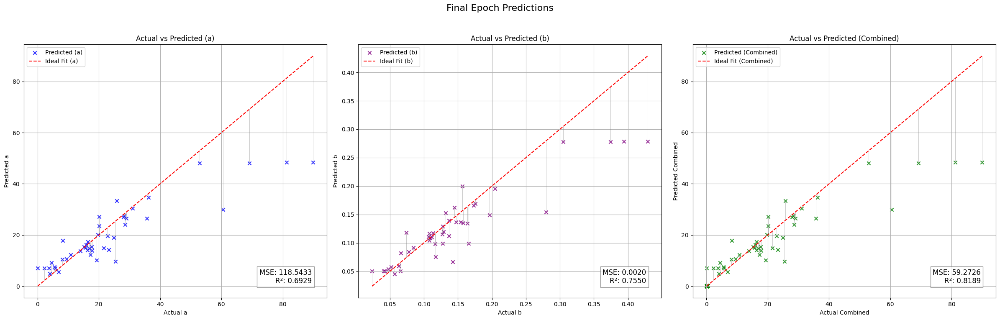

Validation Metrics:
  - MSE: 48.5052
  - R²: 0.7605
  - MAE: 2.9225
  - Explained Variance Score (EVS): 0.7989
Fold 1 Metrics:
  - Validation Loss (MSE): 48.5052
  - R²: 0.7605
  - MAE: 2.9225
  - EVS: 0.7989
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.26it/s, loss=1.2]


Validation Metrics:
  - MSE: 4.0329
  - R²: 0.9434
  - MAE: 1.1511
  - Explained Variance Score (EVS): 0.9493
Epoch [1/50], Train Loss: 1.2795, Val Loss: 4.0329
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=1.14]


Validation Metrics:
  - MSE: 5.5778
  - R²: 0.9180
  - MAE: 1.3319
  - Explained Variance Score (EVS): 0.9336
Epoch [2/50], Train Loss: 1.2551, Val Loss: 5.5778
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.40it/s, loss=1.31]


Validation Metrics:
  - MSE: 8.9058
  - R²: 0.8865
  - MAE: 1.5978
  - Explained Variance Score (EVS): 0.9036
Epoch [3/50], Train Loss: 1.2250, Val Loss: 8.9058
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.42it/s, loss=1.11]


Validation Metrics:
  - MSE: 7.9262
  - R²: 0.8849
  - MAE: 1.5858
  - Explained Variance Score (EVS): 0.8996
Epoch [4/50], Train Loss: 1.1523, Val Loss: 7.9262
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=1.09]


Validation Metrics:
  - MSE: 8.1049
  - R²: 0.8849
  - MAE: 1.5385
  - Explained Variance Score (EVS): 0.9027
Epoch [5/50], Train Loss: 1.1349, Val Loss: 8.1049
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.50it/s, loss=1.01]


Validation Metrics:
  - MSE: 8.6666
  - R²: 0.8826
  - MAE: 1.6078
  - Explained Variance Score (EVS): 0.9059
Epoch [6/50], Train Loss: 1.0916, Val Loss: 8.6666
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.22it/s, loss=1.21]


Validation Metrics:
  - MSE: 8.2781
  - R²: 0.8859
  - MAE: 1.5414
  - Explained Variance Score (EVS): 0.9160
Epoch [7/50], Train Loss: 1.0644, Val Loss: 8.2781
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.06it/s, loss=0.924]


Validation Metrics:
  - MSE: 9.0970
  - R²: 0.8762
  - MAE: 1.6881
  - Explained Variance Score (EVS): 0.9012
Epoch [8/50], Train Loss: 1.0072, Val Loss: 9.0970
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.51it/s, loss=0.97]


Validation Metrics:
  - MSE: 8.3034
  - R²: 0.8891
  - MAE: 1.5959
  - Explained Variance Score (EVS): 0.9002
Epoch [9/50], Train Loss: 0.9677, Val Loss: 8.3034
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=0.898]


Validation Metrics:
  - MSE: 10.5780
  - R²: 0.8624
  - MAE: 1.7107
  - Explained Variance Score (EVS): 0.8729
Epoch [10/50], Train Loss: 0.9271, Val Loss: 10.5780
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.17it/s, loss=1.21]


Validation Metrics:
  - MSE: 10.9350
  - R²: 0.8591
  - MAE: 1.7288
  - Explained Variance Score (EVS): 0.8682
Epoch [11/50], Train Loss: 0.9483, Val Loss: 10.9350
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


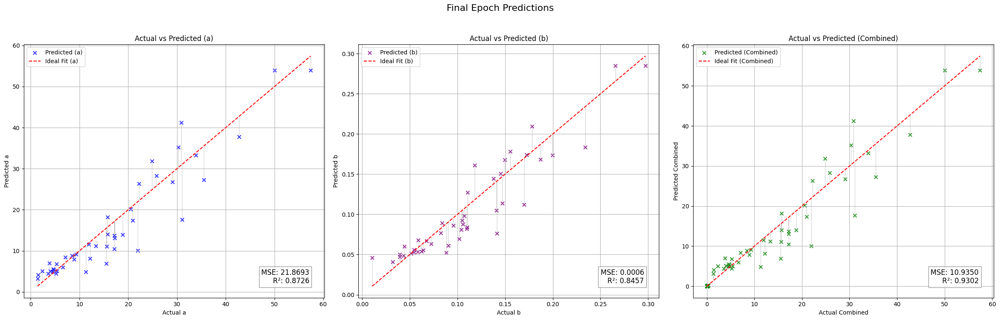

Validation Metrics:
  - MSE: 4.0329
  - R²: 0.9434
  - MAE: 1.1511
  - Explained Variance Score (EVS): 0.9493
Fold 2 Metrics:
  - Validation Loss (MSE): 4.0329
  - R²: 0.9434
  - MAE: 1.1511
  - EVS: 0.9493
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.09it/s, loss=1.2]


Validation Metrics:
  - MSE: 17.2204
  - R²: 0.8405
  - MAE: 1.8900
  - Explained Variance Score (EVS): 0.8504
Epoch [1/50], Train Loss: 1.2446, Val Loss: 17.2204
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.05it/s, loss=1.16]


Validation Metrics:
  - MSE: 17.3525
  - R²: 0.8371
  - MAE: 1.9065
  - Explained Variance Score (EVS): 0.8473
Epoch [2/50], Train Loss: 1.2402, Val Loss: 17.3525
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.53it/s, loss=1.13]


Validation Metrics:
  - MSE: 17.1494
  - R²: 0.8388
  - MAE: 1.8211
  - Explained Variance Score (EVS): 0.8450
Epoch [3/50], Train Loss: 1.1960, Val Loss: 17.1494
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.16it/s, loss=1.34]


Validation Metrics:
  - MSE: 17.7013
  - R²: 0.8328
  - MAE: 1.8221
  - Explained Variance Score (EVS): 0.8413
Epoch [4/50], Train Loss: 1.1897, Val Loss: 17.7013
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.82it/s, loss=1.14]


Validation Metrics:
  - MSE: 18.4005
  - R²: 0.8267
  - MAE: 1.8458
  - Explained Variance Score (EVS): 0.8340
Epoch [5/50], Train Loss: 1.1489, Val Loss: 18.4005
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.49it/s, loss=1.11]


Validation Metrics:
  - MSE: 18.6397
  - R²: 0.8225
  - MAE: 1.8558
  - Explained Variance Score (EVS): 0.8283
Epoch [6/50], Train Loss: 1.1321, Val Loss: 18.6397
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.87it/s, loss=1.14]


Validation Metrics:
  - MSE: 19.2024
  - R²: 0.8139
  - MAE: 1.8155
  - Explained Variance Score (EVS): 0.8187
Epoch [7/50], Train Loss: 1.1067, Val Loss: 19.2024
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=1.21]


Validation Metrics:
  - MSE: 18.7754
  - R²: 0.8176
  - MAE: 1.8025
  - Explained Variance Score (EVS): 0.8222
Epoch [8/50], Train Loss: 1.0977, Val Loss: 18.7754
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.28it/s, loss=1.03]


Validation Metrics:
  - MSE: 18.8771
  - R²: 0.8133
  - MAE: 1.8188
  - Explained Variance Score (EVS): 0.8172
Epoch [9/50], Train Loss: 1.0629, Val Loss: 18.8771
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.52it/s, loss=1.1]


Validation Metrics:
  - MSE: 17.9977
  - R²: 0.8226
  - MAE: 1.8410
  - Explained Variance Score (EVS): 0.8269
Epoch [10/50], Train Loss: 1.0462, Val Loss: 17.9977
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.53it/s, loss=0.977]


Validation Metrics:
  - MSE: 17.7599
  - R²: 0.8272
  - MAE: 1.8463
  - Explained Variance Score (EVS): 0.8324
Epoch [11/50], Train Loss: 1.0020, Val Loss: 17.7599
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s, loss=1.13]


Validation Metrics:
  - MSE: 17.4716
  - R²: 0.8332
  - MAE: 1.8593
  - Explained Variance Score (EVS): 0.8415
Epoch [12/50], Train Loss: 1.0072, Val Loss: 17.4716
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.53it/s, loss=0.934]


Validation Metrics:
  - MSE: 17.8100
  - R²: 0.8241
  - MAE: 1.8560
  - Explained Variance Score (EVS): 0.8313
Epoch [13/50], Train Loss: 0.9722, Val Loss: 17.8100
Current Dropout Rate: 0.4040
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


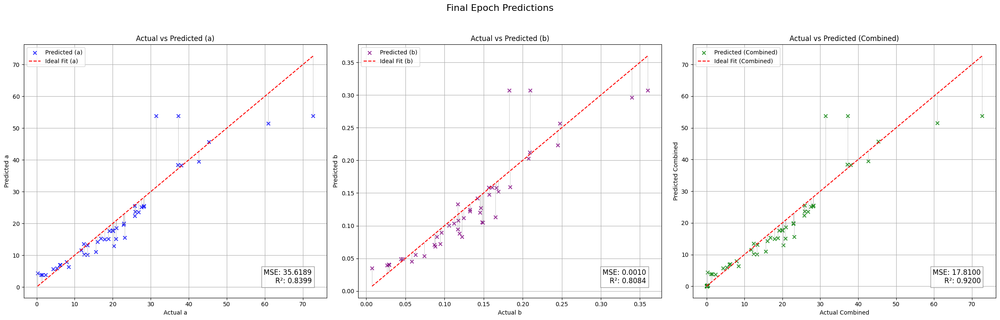

Validation Metrics:
  - MSE: 17.1494
  - R²: 0.8388
  - MAE: 1.8211
  - Explained Variance Score (EVS): 0.8450
Fold 3 Metrics:
  - Validation Loss (MSE): 17.1494
  - R²: 0.8388
  - MAE: 1.8211
  - EVS: 0.8450
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.64it/s, loss=1.2]


Validation Metrics:
  - MSE: 22.8812
  - R²: 0.5611
  - MAE: 1.9085
  - Explained Variance Score (EVS): 0.5695
Epoch [1/50], Train Loss: 1.1815, Val Loss: 22.8812
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.73it/s, loss=1.13]


Validation Metrics:
  - MSE: 23.9237
  - R²: 0.5512
  - MAE: 1.9639
  - Explained Variance Score (EVS): 0.5600
Epoch [2/50], Train Loss: 1.1553, Val Loss: 23.9237
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.88it/s, loss=1.12]


Validation Metrics:
  - MSE: 24.8521
  - R²: 0.5449
  - MAE: 1.9845
  - Explained Variance Score (EVS): 0.5576
Epoch [3/50], Train Loss: 1.1453, Val Loss: 24.8521
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=1.1]


Validation Metrics:
  - MSE: 29.2686
  - R²: 0.5167
  - MAE: 2.1463
  - Explained Variance Score (EVS): 0.5252
Epoch [4/50], Train Loss: 1.1569, Val Loss: 29.2686
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.37it/s, loss=1.16]


Validation Metrics:
  - MSE: 28.6732
  - R²: 0.5188
  - MAE: 2.1182
  - Explained Variance Score (EVS): 0.5259
Epoch [5/50], Train Loss: 1.1435, Val Loss: 28.6732
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=1.15]


Validation Metrics:
  - MSE: 31.8727
  - R²: 0.4939
  - MAE: 2.2309
  - Explained Variance Score (EVS): 0.5008
Epoch [6/50], Train Loss: 1.1303, Val Loss: 31.8727
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.77it/s, loss=1.04]


Validation Metrics:
  - MSE: 33.1191
  - R²: 0.4877
  - MAE: 2.2570
  - Explained Variance Score (EVS): 0.4935
Epoch [7/50], Train Loss: 1.1248, Val Loss: 33.1191
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.30it/s, loss=1.05]


Validation Metrics:
  - MSE: 34.4273
  - R²: 0.4774
  - MAE: 2.2710
  - Explained Variance Score (EVS): 0.4822
Epoch [8/50], Train Loss: 1.0802, Val Loss: 34.4273
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=1.06]


Validation Metrics:
  - MSE: 30.3143
  - R²: 0.5056
  - MAE: 2.1301
  - Explained Variance Score (EVS): 0.5125
Epoch [9/50], Train Loss: 1.0579, Val Loss: 30.3143
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.85it/s, loss=1.02]


Validation Metrics:
  - MSE: 32.6679
  - R²: 0.4885
  - MAE: 2.2138
  - Explained Variance Score (EVS): 0.4968
Epoch [10/50], Train Loss: 1.0375, Val Loss: 32.6679
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.02it/s, loss=1.15]


Validation Metrics:
  - MSE: 31.4847
  - R²: 0.4947
  - MAE: 2.1991
  - Explained Variance Score (EVS): 0.5067
Epoch [11/50], Train Loss: 1.0769, Val Loss: 31.4847
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


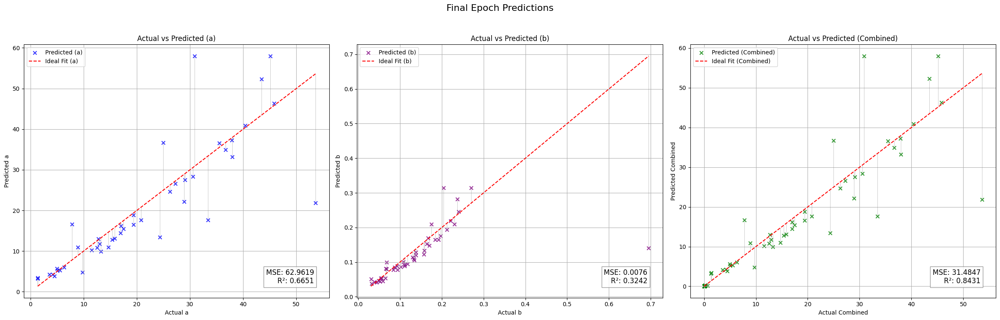

Validation Metrics:
  - MSE: 22.8812
  - R²: 0.5611
  - MAE: 1.9085
  - Explained Variance Score (EVS): 0.5695
Fold 4 Metrics:
  - Validation Loss (MSE): 22.8812
  - R²: 0.5611
  - MAE: 1.9085
  - EVS: 0.5695
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.96it/s, loss=1.2]


Validation Metrics:
  - MSE: 41.2264
  - R²: 0.7806
  - MAE: 1.9908
  - Explained Variance Score (EVS): 0.8093
Epoch [1/50], Train Loss: 1.1851, Val Loss: 41.2264
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=1.22]


Validation Metrics:
  - MSE: 43.6634
  - R²: 0.7651
  - MAE: 2.0575
  - Explained Variance Score (EVS): 0.7986
Epoch [2/50], Train Loss: 1.1777, Val Loss: 43.6634
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.14it/s, loss=1.1]


Validation Metrics:
  - MSE: 42.4619
  - R²: 0.7708
  - MAE: 1.9344
  - Explained Variance Score (EVS): 0.7998
Epoch [3/50], Train Loss: 1.1556, Val Loss: 42.4619
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.03it/s, loss=1.16]


Validation Metrics:
  - MSE: 41.4237
  - R²: 0.7762
  - MAE: 1.9011
  - Explained Variance Score (EVS): 0.8051
Epoch [4/50], Train Loss: 1.1522, Val Loss: 41.4237
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=1.22]


Validation Metrics:
  - MSE: 42.0790
  - R²: 0.7726
  - MAE: 1.9021
  - Explained Variance Score (EVS): 0.8019
Epoch [5/50], Train Loss: 1.1628, Val Loss: 42.0790
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.39it/s, loss=1.08]


Validation Metrics:
  - MSE: 39.8142
  - R²: 0.7820
  - MAE: 1.9230
  - Explained Variance Score (EVS): 0.8127
Epoch [6/50], Train Loss: 1.1351, Val Loss: 39.8142
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.28it/s, loss=1.15]


Validation Metrics:
  - MSE: 41.3019
  - R²: 0.7739
  - MAE: 1.9973
  - Explained Variance Score (EVS): 0.8071
Epoch [7/50], Train Loss: 1.1246, Val Loss: 41.3019
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.21it/s, loss=1.12]


Validation Metrics:
  - MSE: 40.8751
  - R²: 0.7739
  - MAE: 1.9630
  - Explained Variance Score (EVS): 0.8063
Epoch [8/50], Train Loss: 1.1208, Val Loss: 40.8751
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s, loss=1.25]


Validation Metrics:
  - MSE: 40.3578
  - R²: 0.7786
  - MAE: 1.9847
  - Explained Variance Score (EVS): 0.8112
Epoch [9/50], Train Loss: 1.1288, Val Loss: 40.3578
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.70it/s, loss=1.06]


Validation Metrics:
  - MSE: 38.6626
  - R²: 0.7875
  - MAE: 1.9699
  - Explained Variance Score (EVS): 0.8205
Epoch [10/50], Train Loss: 1.1136, Val Loss: 38.6626
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.80it/s, loss=1.1]


Validation Metrics:
  - MSE: 40.4205
  - R²: 0.7773
  - MAE: 1.9963
  - Explained Variance Score (EVS): 0.8107
Epoch [11/50], Train Loss: 1.1125, Val Loss: 40.4205
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.87it/s, loss=1.24]


Validation Metrics:
  - MSE: 37.5847
  - R²: 0.7932
  - MAE: 1.8908
  - Explained Variance Score (EVS): 0.8219
Epoch [12/50], Train Loss: 1.1084, Val Loss: 37.5847
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.68it/s, loss=1.12]


Validation Metrics:
  - MSE: 38.3666
  - R²: 0.7910
  - MAE: 1.8523
  - Explained Variance Score (EVS): 0.8156
Epoch [13/50], Train Loss: 1.1034, Val Loss: 38.3666
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.86it/s, loss=1.09]


Validation Metrics:
  - MSE: 38.6673
  - R²: 0.7915
  - MAE: 1.8309
  - Explained Variance Score (EVS): 0.8133
Epoch [14/50], Train Loss: 1.0912, Val Loss: 38.6673
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.81it/s, loss=1.08]


Validation Metrics:
  - MSE: 37.9978
  - R²: 0.7965
  - MAE: 1.8108
  - Explained Variance Score (EVS): 0.8152
Epoch [15/50], Train Loss: 1.0903, Val Loss: 37.9978
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.77it/s, loss=1.1]


Validation Metrics:
  - MSE: 40.1427
  - R²: 0.7836
  - MAE: 1.9231
  - Explained Variance Score (EVS): 0.8086
Epoch [16/50], Train Loss: 1.0843, Val Loss: 40.1427
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  8.08it/s, loss=1.02]


Validation Metrics:
  - MSE: 38.3658
  - R²: 0.7930
  - MAE: 1.8106
  - Explained Variance Score (EVS): 0.8140
Epoch [17/50], Train Loss: 1.0854, Val Loss: 38.3658
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.50it/s, loss=1.02]


Validation Metrics:
  - MSE: 38.0322
  - R²: 0.7942
  - MAE: 1.7883
  - Explained Variance Score (EVS): 0.8150
Epoch [18/50], Train Loss: 1.0774, Val Loss: 38.0322
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  8.42it/s, loss=1.05]


Validation Metrics:
  - MSE: 35.5028
  - R²: 0.8071
  - MAE: 1.7748
  - Explained Variance Score (EVS): 0.8276
Epoch [19/50], Train Loss: 1.0786, Val Loss: 35.5028
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  8.36it/s, loss=0.996]


Validation Metrics:
  - MSE: 36.6777
  - R²: 0.8002
  - MAE: 1.7674
  - Explained Variance Score (EVS): 0.8203
Epoch [20/50], Train Loss: 1.0548, Val Loss: 36.6777
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  7.04it/s, loss=1.01]


Validation Metrics:
  - MSE: 36.5148
  - R²: 0.8004
  - MAE: 1.7640
  - Explained Variance Score (EVS): 0.8199
Epoch [21/50], Train Loss: 1.0464, Val Loss: 36.5148
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  6.94it/s, loss=1.11]


Validation Metrics:
  - MSE: 35.7598
  - R²: 0.8047
  - MAE: 1.7378
  - Explained Variance Score (EVS): 0.8229
Epoch [22/50], Train Loss: 1.0701, Val Loss: 35.7598
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  6.98it/s, loss=1.03]


Validation Metrics:
  - MSE: 37.9022
  - R²: 0.7936
  - MAE: 1.7592
  - Explained Variance Score (EVS): 0.8129
Epoch [23/50], Train Loss: 1.0506, Val Loss: 37.9022
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  6.31it/s, loss=1.28]


Validation Metrics:
  - MSE: 38.7762
  - R²: 0.7881
  - MAE: 1.8265
  - Explained Variance Score (EVS): 0.8118
Epoch [24/50], Train Loss: 1.0734, Val Loss: 38.7762
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  6.60it/s, loss=1.1]


Validation Metrics:
  - MSE: 36.9596
  - R²: 0.7984
  - MAE: 1.7740
  - Explained Variance Score (EVS): 0.8179
Epoch [25/50], Train Loss: 1.0643, Val Loss: 36.9596
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00,  8.30it/s, loss=1.03]


Validation Metrics:
  - MSE: 36.8556
  - R²: 0.7983
  - MAE: 1.7880
  - Explained Variance Score (EVS): 0.8194
Epoch [26/50], Train Loss: 1.0493, Val Loss: 36.8556
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00,  7.63it/s, loss=1.06]


Validation Metrics:
  - MSE: 37.2772
  - R²: 0.7963
  - MAE: 1.8259
  - Explained Variance Score (EVS): 0.8191
Epoch [27/50], Train Loss: 1.0429, Val Loss: 37.2772
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00,  8.95it/s, loss=1.09]


Validation Metrics:
  - MSE: 37.5774
  - R²: 0.7970
  - MAE: 1.7809
  - Explained Variance Score (EVS): 0.8164
Epoch [28/50], Train Loss: 1.0482, Val Loss: 37.5774
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00,  8.34it/s, loss=1.01]


Validation Metrics:
  - MSE: 37.7242
  - R²: 0.7962
  - MAE: 1.8149
  - Explained Variance Score (EVS): 0.8169
Epoch [29/50], Train Loss: 1.0349, Val Loss: 37.7242
Current Dropout Rate: 0.2760
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


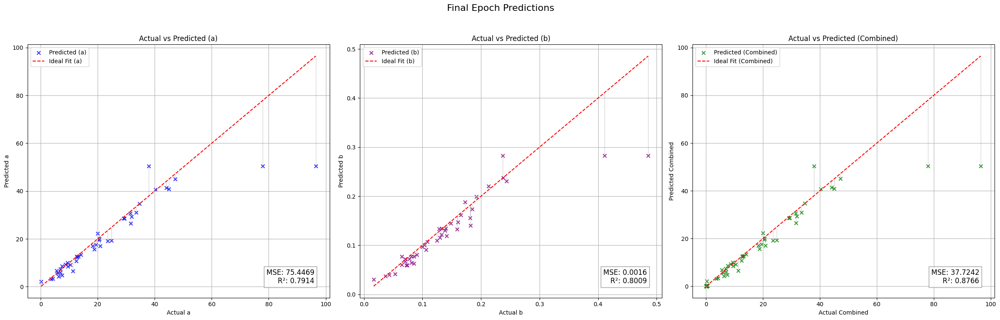

[I 2024-12-01 17:50:01,088] Trial 32 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 35.5028
  - R²: 0.8071
  - MAE: 1.7748
  - Explained Variance Score (EVS): 0.8276
Fold 5 Metrics:
  - Validation Loss (MSE): 35.5028
  - R²: 0.8071
  - MAE: 1.7748
  - EVS: 0.8276
Avg Validation Metrics:
  - MSE: 25.6143
  - R²: 0.7822
  - MAE: 1.9156
  - EVS: 0.7981
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 13.16it/s, loss=0.441]


Validation Metrics:
  - MSE: 196.8842
  - R²: -0.0182
  - MAE: 6.4651
  - Explained Variance Score (EVS): 0.0002
Epoch [1/50], Train Loss: 0.8240, Val Loss: 196.8842
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.43it/s, loss=0.395]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4503, Val Loss: 197.3764
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 11.37it/s, loss=0.285]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4408, Val Loss: 197.4225
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.438]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4387, Val Loss: 197.5156
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 11.71it/s, loss=0.438]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0205
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4369, Val Loss: 197.5156
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 12.73it/s, loss=0.307]


Validation Metrics:
  - MSE: 197.6096
  - R²: -0.0206
  - MAE: 6.4466
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4349, Val Loss: 197.6096
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 13.60it/s, loss=0.585]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4356, Val Loss: 197.5156
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 13.59it/s, loss=0.439]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0207
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4339, Val Loss: 197.5625
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.43it/s, loss=0.332]


Validation Metrics:
  - MSE: 197.6096
  - R²: -0.0208
  - MAE: 6.4466
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4324, Val Loss: 197.6096
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 13.53it/s, loss=0.597]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0200
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4329, Val Loss: 197.3764
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 14.08it/s, loss=0.357]


Validation Metrics:
  - MSE: 197.5625
  - R²: -0.0205
  - MAE: 6.4480
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4313, Val Loss: 197.5625
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


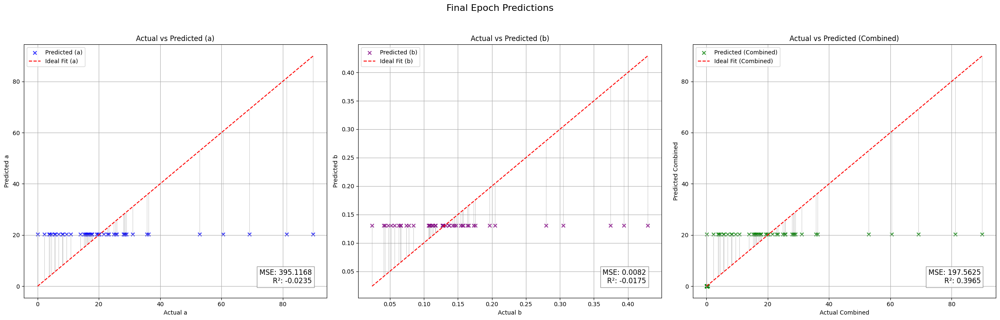

Validation Metrics:
  - MSE: 196.8842
  - R²: -0.0182
  - MAE: 6.4651
  - Explained Variance Score (EVS): 0.0002
Fold 1 Metrics:
  - Validation Loss (MSE): 196.8842
  - R²: -0.0182
  - MAE: 6.4651
  - EVS: 0.0002
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 13.66it/s, loss=0.385]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1727
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4453, Val Loss: 98.5102
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 13.38it/s, loss=0.438]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4363, Val Loss: 98.4316
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 11.85it/s, loss=0.618]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4339, Val Loss: 98.3532
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.41it/s, loss=0.322]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4314, Val Loss: 98.1971
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 11.81it/s, loss=0.306]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1687
  - MAE: 5.9400
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4305, Val Loss: 98.1195
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 13.48it/s, loss=0.42]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4305, Val Loss: 98.1971
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 13.98it/s, loss=0.474]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4303, Val Loss: 98.1971
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 14.44it/s, loss=0.28]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1696
  - MAE: 5.9463
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4286, Val Loss: 98.2750
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.24it/s, loss=0.384]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4287, Val Loss: 98.1971
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 13.85it/s, loss=0.537]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1687
  - MAE: 5.9400
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4288, Val Loss: 98.1195
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 13.09it/s, loss=0.264]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1700
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4269, Val Loss: 98.1971
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 13.07it/s, loss=0.328]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4266, Val Loss: 98.1971
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 12.20it/s, loss=0.469]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4268, Val Loss: 98.0420
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 12.38it/s, loss=0.189]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1687
  - MAE: 5.9400
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4245, Val Loss: 98.1195
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.4]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1683
  - MAE: 5.9431
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4253, Val Loss: 98.1971
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 11.76it/s, loss=0.382]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4247, Val Loss: 98.1971
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 11.83it/s, loss=0.223]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4233, Val Loss: 98.2750
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 15.00it/s, loss=0.393]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.4240, Val Loss: 98.1971
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 13.45it/s, loss=0.229]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.4224, Val Loss: 98.1971
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 13.21it/s, loss=0.523]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.4236, Val Loss: 98.1971
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 13.22it/s, loss=0.466]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.4229, Val Loss: 98.1971
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 13.46it/s, loss=0.228]


Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.4211, Val Loss: 98.0420
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 14.68it/s, loss=0.337]


Validation Metrics:
  - MSE: 98.1195
  - R²: -0.1678
  - MAE: 5.9399
  - Explained Variance Score (EVS): -0.0000
Epoch [23/50], Train Loss: 0.4213, Val Loss: 98.1195
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


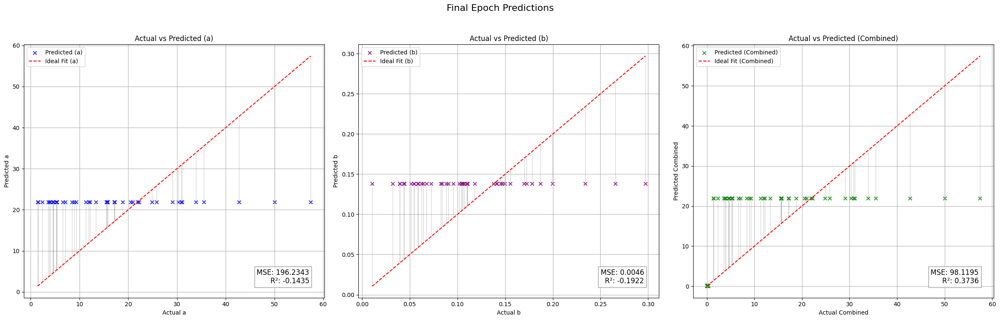

Validation Metrics:
  - MSE: 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.0420
  - R²: -0.1674
  - MAE: 5.9367
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:01<00:00, 10.60it/s, loss=0.465]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4233, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.34it/s, loss=0.255]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4217, Val Loss: 111.2861
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 12.71it/s, loss=0.469]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4226, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.441]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4220, Val Loss: 111.2861
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 14.29it/s, loss=0.526]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4221, Val Loss: 111.2861
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 13.44it/s, loss=0.358]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4207, Val Loss: 111.2922
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 13.90it/s, loss=0.34]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4202, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.90it/s, loss=0.492]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4207, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.08it/s, loss=0.393]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4197, Val Loss: 111.2861
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 14.04it/s, loss=0.21]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4183, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 13.03it/s, loss=0.525]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4197, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 12.68it/s, loss=0.286]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4180, Val Loss: 111.2861
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


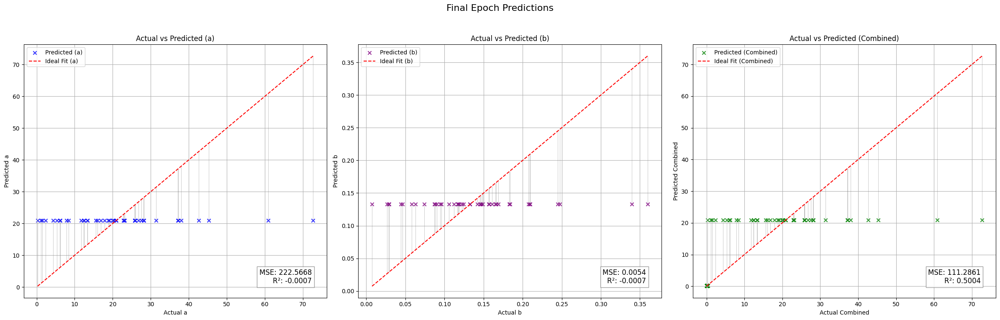

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 11.26it/s, loss=0.336]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4331, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.86it/s, loss=0.215]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4321, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 13.01it/s, loss=0.512]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4334, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 13.44it/s, loss=0.268]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4316, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 13.10it/s, loss=0.298]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4314, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 13.45it/s, loss=0.219]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4306, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 13.69it/s, loss=0.387]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4312, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.89it/s, loss=0.249]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4301, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 11.42it/s, loss=0.546]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4314, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 12.28it/s, loss=0.331]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4299, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.311]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4294, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


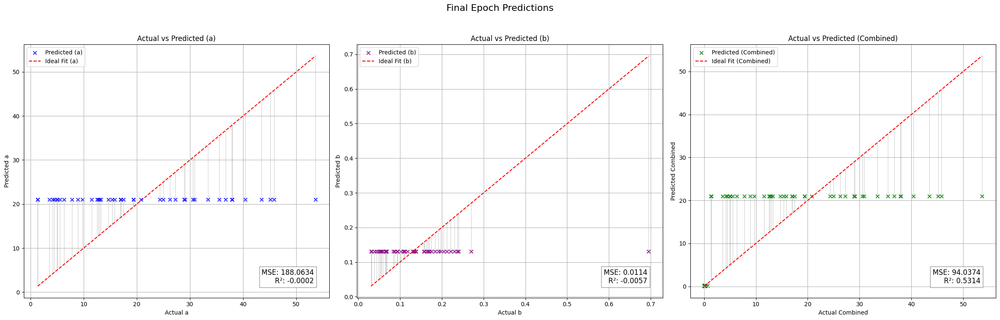

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 11.84it/s, loss=0.435]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4318, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 13.28it/s, loss=0.318]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4316, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 13.23it/s, loss=0.344]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4314, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 13.63it/s, loss=0.523]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4312, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.86it/s, loss=0.251]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4311, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 14.06it/s, loss=0.44]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4309, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.87it/s, loss=0.442]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4308, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 11.38it/s, loss=0.348]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4306, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.42it/s, loss=0.451]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4304, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 12.54it/s, loss=0.628]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4303, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.12it/s, loss=0.594]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4301, Val Loss: 182.6491
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 11.72it/s, loss=0.81]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.4300, Val Loss: 182.6491
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 13.14it/s, loss=0.289]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.4299, Val Loss: 182.6491
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 14.13it/s, loss=0.497]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.4298, Val Loss: 182.6491
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 13.24it/s, loss=0.647]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.4297, Val Loss: 182.6491
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 13.29it/s, loss=0.433]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.4297, Val Loss: 182.6491
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 13.48it/s, loss=0.423]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.4296, Val Loss: 182.6491
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 12.83it/s, loss=0.465]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [18/50], Train Loss: 0.4295, Val Loss: 182.6491
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 12.40it/s, loss=0.328]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [19/50], Train Loss: 0.4294, Val Loss: 182.6491
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 11.49it/s, loss=0.239]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [20/50], Train Loss: 0.4294, Val Loss: 182.6491
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 11.09it/s, loss=0.593]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [21/50], Train Loss: 0.4293, Val Loss: 182.6491
Current Dropout Rate: 0.3400
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


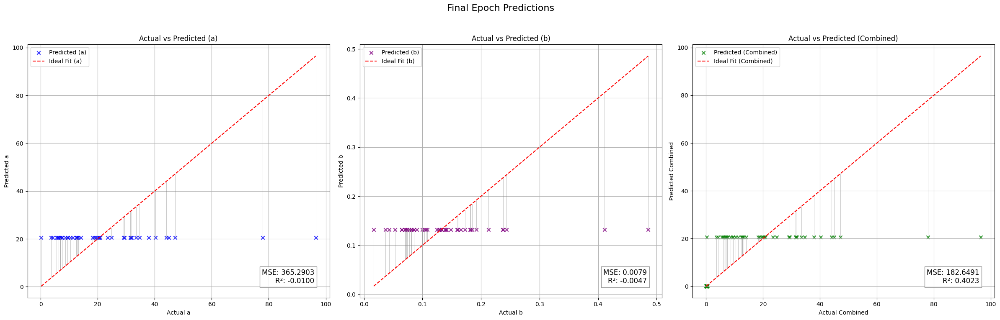

[I 2024-12-01 17:52:19,015] Trial 33 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.5798
  - R²: -0.0393
  - MAE: 6.0991
  - EVS: 0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.90it/s, loss=0.433]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 2.3114, Val Loss: 197.4225
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.17it/s, loss=0.495]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4225, Val Loss: 197.4225
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.97it/s, loss=0.214]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3867, Val Loss: 197.4225
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.35it/s, loss=0.565]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4105, Val Loss: 197.4225
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.52it/s, loss=0.14]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3672, Val Loss: 197.4690
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.81it/s, loss=0.411]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3867, Val Loss: 197.3764
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.23it/s, loss=0.334]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3764, Val Loss: 197.4690
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.66it/s, loss=0.34]


Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0195
  - MAE: 6.4552
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3741, Val Loss: 197.3305
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.16it/s, loss=0.568]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3920, Val Loss: 197.4690
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.07it/s, loss=0.55]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3886, Val Loss: 197.4690
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.35it/s, loss=0.587]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0200
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3904, Val Loss: 197.5156
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.27it/s, loss=0.27]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3614, Val Loss: 197.3764
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.62it/s, loss=0.18]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.3524, Val Loss: 197.4225
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.98it/s, loss=0.267]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.3596, Val Loss: 197.4225
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.63it/s, loss=0.261]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.3585, Val Loss: 197.3764
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.98it/s, loss=0.17]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0198
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.3503, Val Loss: 197.4225
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  8.10it/s, loss=0.324]


Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0195
  - MAE: 6.4552
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.3646, Val Loss: 197.3305
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.09it/s, loss=0.292]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0199
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [18/50], Train Loss: 0.3640, Val Loss: 197.4690
Current Dropout Rate: 0.3640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


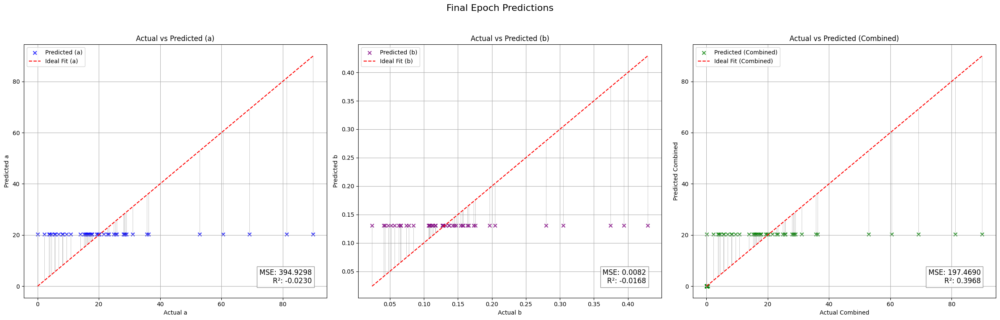

Validation Metrics:
  - MSE: 197.3305
  - R²: -0.0195
  - MAE: 6.4552
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.3305
  - R²: -0.0195
  - MAE: 6.4552
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.20it/s, loss=0.473]


Validation Metrics:
  - MSE: 98.6682
  - R²: -0.1736
  - MAE: 5.9639
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3760, Val Loss: 98.6682
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=0.443]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1718
  - MAE: 5.9567
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3728, Val Loss: 98.5102
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.42it/s, loss=0.732]


Validation Metrics:
  - MSE: 99.3100
  - R²: -0.1756
  - MAE: 5.9922
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4051, Val Loss: 99.3100
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.02it/s, loss=0.531]


Validation Metrics:
  - MSE: 99.5547
  - R²: -0.1728
  - MAE: 6.0028
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4417, Val Loss: 99.5547
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.57it/s, loss=0.649]


Validation Metrics:
  - MSE: 98.8272
  - R²: -0.1677
  - MAE: 5.9708
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.5261, Val Loss: 98.8272
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  9.02it/s, loss=0.897]


Validation Metrics:
  - MSE: 98.5855
  - R²: -0.1714
  - MAE: 5.9599
  - Explained Variance Score (EVS): -0.0002
Epoch [6/50], Train Loss: 0.6374, Val Loss: 98.5855
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.72it/s, loss=0.787]


Validation Metrics:
  - MSE: 98.2755
  - R²: -0.1705
  - MAE: 5.9465
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.7999, Val Loss: 98.2755
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.07it/s, loss=0.684]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.7940, Val Loss: 98.3532
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.35it/s, loss=0.675]


Validation Metrics:
  - MSE: 97.8879
  - R²: -0.1665
  - MAE: 5.9303
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.7572, Val Loss: 97.8879
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.29it/s, loss=0.562]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4470, Val Loss: 98.4316
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s, loss=0.285]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3508, Val Loss: 98.3532
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.62it/s, loss=0.616]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1718
  - MAE: 5.9497
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3801, Val Loss: 98.3532
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.91it/s, loss=0.143]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3382, Val Loss: 98.2750
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.83it/s, loss=0.361]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3573, Val Loss: 98.4316
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=0.375]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3586, Val Loss: 98.3532
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.20it/s, loss=0.133]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3372, Val Loss: 98.3532
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.70it/s, loss=0.563]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3752, Val Loss: 98.4316
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.66it/s, loss=0.476]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3675, Val Loss: 98.3532
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  8.58it/s, loss=0.416]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1727
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3622, Val Loss: 98.5102
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


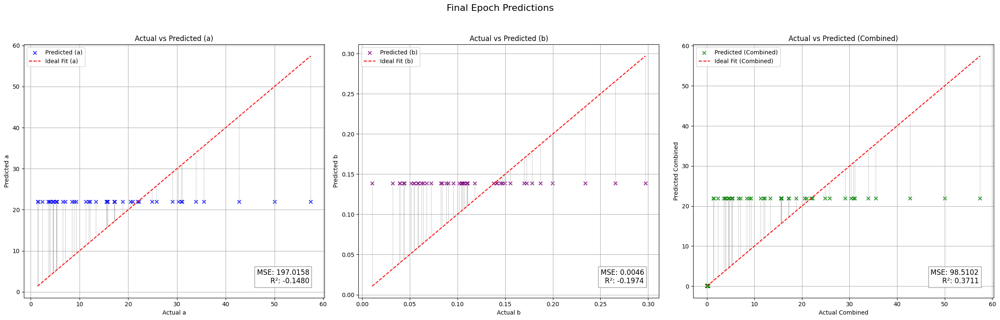

Validation Metrics:
  - MSE: 97.8879
  - R²: -0.1665
  - MAE: 5.9303
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 97.8879
  - R²: -0.1665
  - MAE: 5.9303
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.146]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4330, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.06it/s, loss=0.357]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3559, Val Loss: 111.2861
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.80it/s, loss=0.439]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3623, Val Loss: 111.2861
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=0.401]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3589, Val Loss: 111.2922
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.10it/s, loss=0.487]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0006
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3665, Val Loss: 111.2861
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.25it/s, loss=0.519]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3695, Val Loss: 111.2802
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.72it/s, loss=0.562]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3732, Val Loss: 111.2861
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.10it/s, loss=0.685]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3843, Val Loss: 111.2861
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.03it/s, loss=0.277]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3477, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.86it/s, loss=0.316]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3510, Val Loss: 111.2922
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=0.48]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3656, Val Loss: 111.2922
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s, loss=0.354]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3544, Val Loss: 111.2861
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  8.61it/s, loss=0.187]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3397, Val Loss: 111.2922
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.01it/s, loss=0.117]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3334, Val Loss: 111.2922
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.29it/s, loss=0.231]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3435, Val Loss: 111.2861
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=0.197]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3405, Val Loss: 111.2922
Current Dropout Rate: 0.3800
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


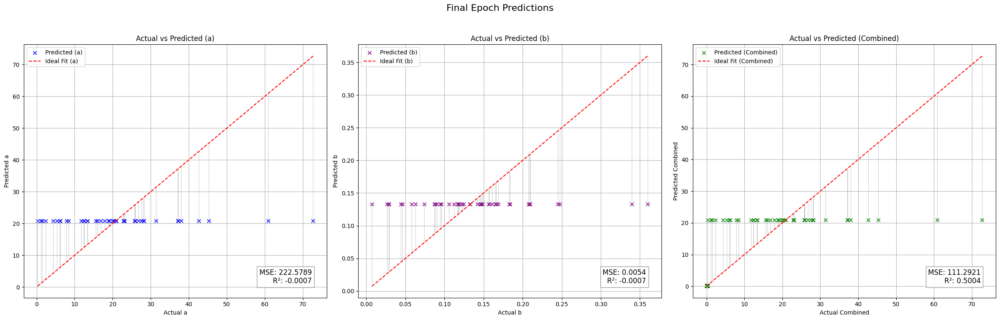

Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.26it/s, loss=0.413]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3701, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.93it/s, loss=0.366]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0029
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3659, Val Loss: 94.0404
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.69it/s, loss=0.252]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3558, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.66it/s, loss=0.334]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3631, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=0.218]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3528, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.35it/s, loss=0.777]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4023, Val Loss: 94.0404
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.90it/s, loss=0.538]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3812, Val Loss: 94.0346
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.82it/s, loss=0.684]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3941, Val Loss: 94.0346
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=0.605]


Validation Metrics:
  - MSE: 94.0438
  - R²: -0.0029
  - MAE: 5.9065
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3871, Val Loss: 94.0438
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=0.282]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3584, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.94it/s, loss=0.545]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3816, Val Loss: 94.0404
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.85it/s, loss=0.261]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3565, Val Loss: 94.0374
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.90it/s, loss=0.564]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3833, Val Loss: 94.0404
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.79it/s, loss=0.443]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3726, Val Loss: 94.0374
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.19it/s, loss=0.229]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3537, Val Loss: 94.0374
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.80it/s, loss=0.218]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3527, Val Loss: 94.0374
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s, loss=0.255]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3560, Val Loss: 94.0374
Current Dropout Rate: 0.3720
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


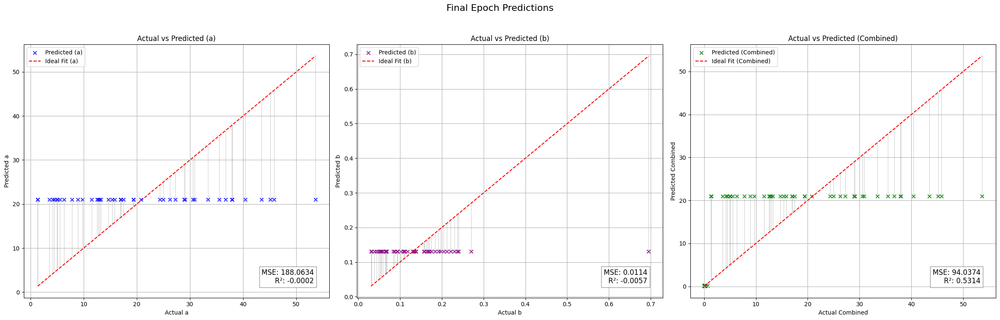

Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  8.15it/s, loss=0.258]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.3554, Val Loss: 182.6789
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.82it/s, loss=0.516]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3769, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.54it/s, loss=0.426]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3694, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.15it/s, loss=0.378]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3653, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.21it/s, loss=0.42]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3689, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.09it/s, loss=0.341]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3623, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.86it/s, loss=0.49]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3747, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.35it/s, loss=0.587]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3828, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.78it/s, loss=0.44]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3705, Val Loss: 182.6789
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.43it/s, loss=0.252]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3549, Val Loss: 182.6789
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.06it/s, loss=0.12]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3438, Val Loss: 182.6789
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.39it/s, loss=0.435]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3701, Val Loss: 182.6491
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


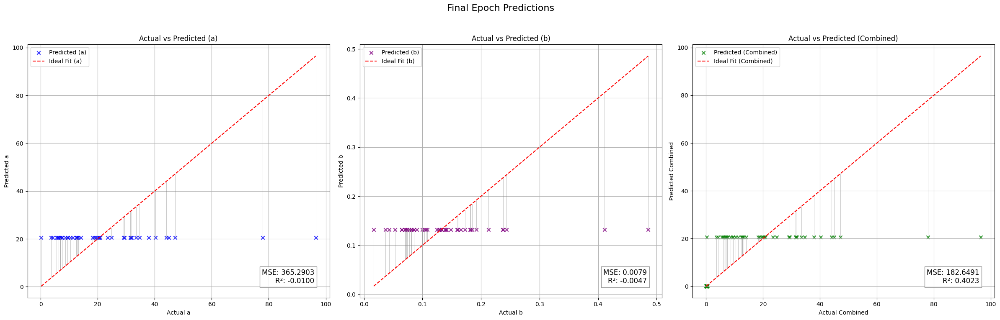

[I 2024-12-01 17:54:34,872] Trial 34 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.6365
  - R²: -0.0394
  - MAE: 6.0957
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 12.51it/s, loss=2.05]


Validation Metrics:
  - MSE: 201.7308
  - R²: -0.0347
  - MAE: 6.3243
  - Explained Variance Score (EVS): 0.0347
Epoch [1/50], Train Loss: 2.1597, Val Loss: 201.7308
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:01<00:00, 10.95it/s, loss=2]


Validation Metrics:
  - MSE: 222.2493
  - R²: -0.1517
  - MAE: 6.7394
  - Explained Variance Score (EVS): 0.1099
Epoch [2/50], Train Loss: 2.0403, Val Loss: 222.2493
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 11.51it/s, loss=1.92]


Validation Metrics:
  - MSE: 227.0932
  - R²: -0.1963
  - MAE: 6.9756
  - Explained Variance Score (EVS): 0.2004
Epoch [3/50], Train Loss: 2.0045, Val Loss: 227.0932
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.28it/s, loss=1.92]


Validation Metrics:
  - MSE: 173.2275
  - R²: 0.0720
  - MAE: 5.8570
  - Explained Variance Score (EVS): 0.3639
Epoch [4/50], Train Loss: 1.9372, Val Loss: 173.2275
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 11.91it/s, loss=2.1]


Validation Metrics:
  - MSE: 141.8185
  - R²: 0.2477
  - MAE: 5.1520
  - Explained Variance Score (EVS): 0.5219
Epoch [5/50], Train Loss: 1.8982, Val Loss: 141.8185
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 11.93it/s, loss=1.85]


Validation Metrics:
  - MSE: 82.0462
  - R²: 0.5818
  - MAE: 3.7805
  - Explained Variance Score (EVS): 0.6924
Epoch [6/50], Train Loss: 1.8531, Val Loss: 82.0462
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 13.45it/s, loss=1.81]


Validation Metrics:
  - MSE: 59.5515
  - R²: 0.6955
  - MAE: 3.3238
  - Explained Variance Score (EVS): 0.7731
Epoch [7/50], Train Loss: 1.8064, Val Loss: 59.5515
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 13.16it/s, loss=1.77]


Validation Metrics:
  - MSE: 62.5844
  - R²: 0.7185
  - MAE: 3.3422
  - Explained Variance Score (EVS): 0.7808
Epoch [8/50], Train Loss: 1.7732, Val Loss: 62.5844
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.57it/s, loss=1.65]


Validation Metrics:
  - MSE: 91.5773
  - R²: 0.6175
  - MAE: 3.4484
  - Explained Variance Score (EVS): 0.6942
Epoch [9/50], Train Loss: 1.7046, Val Loss: 91.5773
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 12.27it/s, loss=1.85]


Validation Metrics:
  - MSE: 83.8710
  - R²: 0.6076
  - MAE: 3.1423
  - Explained Variance Score (EVS): 0.6517
Epoch [10/50], Train Loss: 1.6875, Val Loss: 83.8710
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 12.66it/s, loss=1.53]


Validation Metrics:
  - MSE: 60.3376
  - R²: 0.7176
  - MAE: 3.1107
  - Explained Variance Score (EVS): 0.7574
Epoch [11/50], Train Loss: 1.6282, Val Loss: 60.3376
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 12.39it/s, loss=1.7]


Validation Metrics:
  - MSE: 97.8853
  - R²: 0.5430
  - MAE: 3.6638
  - Explained Variance Score (EVS): 0.6381
Epoch [12/50], Train Loss: 1.6102, Val Loss: 97.8853
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 11.44it/s, loss=1.52]


Validation Metrics:
  - MSE: 65.5500
  - R²: 0.7181
  - MAE: 3.1985
  - Explained Variance Score (EVS): 0.7373
Epoch [13/50], Train Loss: 1.5389, Val Loss: 65.5500
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 11.84it/s, loss=1.42]


Validation Metrics:
  - MSE: 59.1769
  - R²: 0.6982
  - MAE: 3.1121
  - Explained Variance Score (EVS): 0.7508
Epoch [14/50], Train Loss: 1.4791, Val Loss: 59.1769
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 11.58it/s, loss=1.38]


Validation Metrics:
  - MSE: 78.4679
  - R²: 0.6355
  - MAE: 3.2600
  - Explained Variance Score (EVS): 0.6932
Epoch [15/50], Train Loss: 1.4299, Val Loss: 78.4679
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 11.82it/s, loss=1.3]


Validation Metrics:
  - MSE: 48.0001
  - R²: 0.7673
  - MAE: 2.7748
  - Explained Variance Score (EVS): 0.8033
Epoch [16/50], Train Loss: 1.3942, Val Loss: 48.0001
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 12.69it/s, loss=1.31]


Validation Metrics:
  - MSE: 51.0255
  - R²: 0.7436
  - MAE: 2.9674
  - Explained Variance Score (EVS): 0.7865
Epoch [17/50], Train Loss: 1.3402, Val Loss: 51.0255
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 13.86it/s, loss=1.28]


Validation Metrics:
  - MSE: 62.0325
  - R²: 0.7017
  - MAE: 3.3038
  - Explained Variance Score (EVS): 0.7302
Epoch [18/50], Train Loss: 1.3013, Val Loss: 62.0325
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 13.21it/s, loss=1.41]


Validation Metrics:
  - MSE: 81.8596
  - R²: 0.5980
  - MAE: 3.5696
  - Explained Variance Score (EVS): 0.7036
Epoch [19/50], Train Loss: 1.2500, Val Loss: 81.8596
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 13.31it/s, loss=1.1]


Validation Metrics:
  - MSE: 48.5321
  - R²: 0.7511
  - MAE: 2.8565
  - Explained Variance Score (EVS): 0.7806
Epoch [20/50], Train Loss: 1.2053, Val Loss: 48.5321
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 13.12it/s, loss=1.09]


Validation Metrics:
  - MSE: 78.9133
  - R²: 0.6184
  - MAE: 3.2700
  - Explained Variance Score (EVS): 0.6839
Epoch [21/50], Train Loss: 1.1562, Val Loss: 78.9133
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 13.39it/s, loss=1.12]


Validation Metrics:
  - MSE: 60.9632
  - R²: 0.6699
  - MAE: 3.1778
  - Explained Variance Score (EVS): 0.7327
Epoch [22/50], Train Loss: 1.1444, Val Loss: 60.9632
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 12.91it/s, loss=0.97]


Validation Metrics:
  - MSE: 59.5452
  - R²: 0.7213
  - MAE: 3.2702
  - Explained Variance Score (EVS): 0.7735
Epoch [23/50], Train Loss: 1.0698, Val Loss: 59.5452
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 12.69it/s, loss=0.999]


Validation Metrics:
  - MSE: 53.7881
  - R²: 0.7113
  - MAE: 3.2400
  - Explained Variance Score (EVS): 0.7831
Epoch [24/50], Train Loss: 1.0392, Val Loss: 53.7881
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:01<00:00, 10.77it/s, loss=0.943]


Validation Metrics:
  - MSE: 85.2973
  - R²: 0.5979
  - MAE: 3.5540
  - Explained Variance Score (EVS): 0.6386
Epoch [25/50], Train Loss: 0.9894, Val Loss: 85.2973
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 11.86it/s, loss=0.963]


Validation Metrics:
  - MSE: 83.3311
  - R²: 0.5762
  - MAE: 3.5721
  - Explained Variance Score (EVS): 0.6734
Epoch [26/50], Train Loss: 0.9736, Val Loss: 83.3311
Current Dropout Rate: 0.3000
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


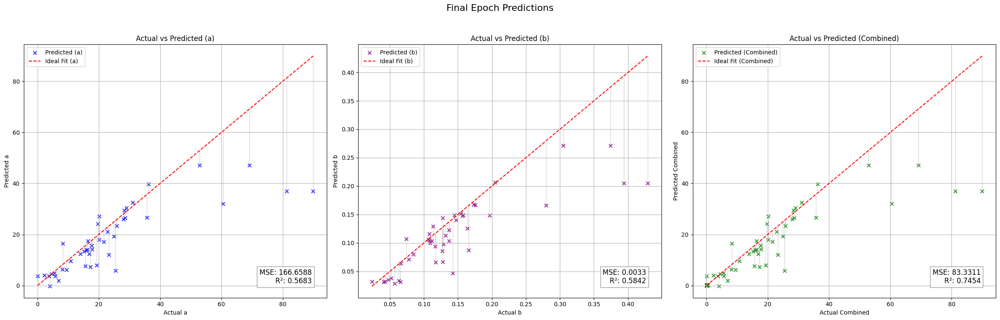

Validation Metrics:
  - MSE: 48.0001
  - R²: 0.7673
  - MAE: 2.7748
  - Explained Variance Score (EVS): 0.8033
Fold 1 Metrics:
  - Validation Loss (MSE): 48.0001
  - R²: 0.7673
  - MAE: 2.7748
  - EVS: 0.8033
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 12.95it/s, loss=1.3]


Validation Metrics:
  - MSE: 7.1823
  - R²: 0.9015
  - MAE: 1.2995
  - Explained Variance Score (EVS): 0.9188
Epoch [1/50], Train Loss: 1.3806, Val Loss: 7.1823
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 13.55it/s, loss=1.52]


Validation Metrics:
  - MSE: 7.4980
  - R²: 0.9018
  - MAE: 1.4731
  - Explained Variance Score (EVS): 0.9078
Epoch [2/50], Train Loss: 1.3057, Val Loss: 7.4980
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 13.14it/s, loss=1.23]


Validation Metrics:
  - MSE: 5.9877
  - R²: 0.9078
  - MAE: 1.3388
  - Explained Variance Score (EVS): 0.9167
Epoch [3/50], Train Loss: 1.2883, Val Loss: 5.9877
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 12.62it/s, loss=1.14]


Validation Metrics:
  - MSE: 5.2838
  - R²: 0.9116
  - MAE: 1.1963
  - Explained Variance Score (EVS): 0.9282
Epoch [4/50], Train Loss: 1.2374, Val Loss: 5.2838
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 13.63it/s, loss=1.21]


Validation Metrics:
  - MSE: 8.7752
  - R²: 0.8837
  - MAE: 1.5060
  - Explained Variance Score (EVS): 0.9055
Epoch [5/50], Train Loss: 1.2229, Val Loss: 8.7752
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 12.91it/s, loss=1.25]


Validation Metrics:
  - MSE: 9.3584
  - R²: 0.8714
  - MAE: 1.5338
  - Explained Variance Score (EVS): 0.8950
Epoch [6/50], Train Loss: 1.1773, Val Loss: 9.3584
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.45it/s, loss=1.03]


Validation Metrics:
  - MSE: 12.1404
  - R²: 0.8209
  - MAE: 1.7426
  - Explained Variance Score (EVS): 0.8229
Epoch [7/50], Train Loss: 1.1318, Val Loss: 12.1404
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.20it/s, loss=1.14]


Validation Metrics:
  - MSE: 7.9039
  - R²: 0.8871
  - MAE: 1.5694
  - Explained Variance Score (EVS): 0.8998
Epoch [8/50], Train Loss: 1.1069, Val Loss: 7.9039
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.57it/s, loss=0.958]


Validation Metrics:
  - MSE: 11.6196
  - R²: 0.8518
  - MAE: 1.8386
  - Explained Variance Score (EVS): 0.8665
Epoch [9/50], Train Loss: 1.0697, Val Loss: 11.6196
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:01<00:00, 10.77it/s, loss=0.967]


Validation Metrics:
  - MSE: 12.7128
  - R²: 0.8567
  - MAE: 1.8445
  - Explained Variance Score (EVS): 0.8716
Epoch [10/50], Train Loss: 1.0229, Val Loss: 12.7128
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.53it/s, loss=0.905]


Validation Metrics:
  - MSE: 9.0323
  - R²: 0.8729
  - MAE: 1.6840
  - Explained Variance Score (EVS): 0.8758
Epoch [11/50], Train Loss: 0.9933, Val Loss: 9.0323
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 12.27it/s, loss=0.918]


Validation Metrics:
  - MSE: 10.3992
  - R²: 0.8606
  - MAE: 1.6958
  - Explained Variance Score (EVS): 0.8621
Epoch [12/50], Train Loss: 0.9413, Val Loss: 10.3992
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 14.02it/s, loss=0.95]


Validation Metrics:
  - MSE: 12.9324
  - R²: 0.8375
  - MAE: 1.8864
  - Explained Variance Score (EVS): 0.8497
Epoch [13/50], Train Loss: 0.9452, Val Loss: 12.9324
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 12.25it/s, loss=0.852]


Validation Metrics:
  - MSE: 12.2867
  - R²: 0.8329
  - MAE: 1.8584
  - Explained Variance Score (EVS): 0.8690
Epoch [14/50], Train Loss: 0.9424, Val Loss: 12.2867
Current Dropout Rate: 0.3960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


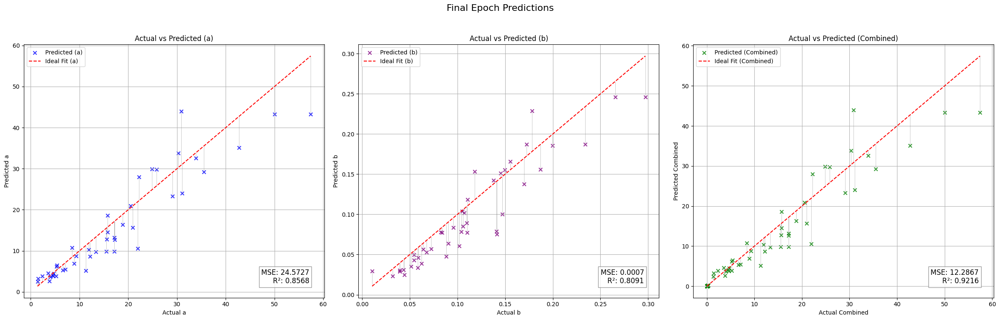

Validation Metrics:
  - MSE: 5.2838
  - R²: 0.9116
  - MAE: 1.1963
  - Explained Variance Score (EVS): 0.9282
Fold 2 Metrics:
  - Validation Loss (MSE): 5.2838
  - R²: 0.9116
  - MAE: 1.1963
  - EVS: 0.9282
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 12.78it/s, loss=1.18]


Validation Metrics:
  - MSE: 16.6720
  - R²: 0.8483
  - MAE: 1.7556
  - Explained Variance Score (EVS): 0.8759
Epoch [1/50], Train Loss: 1.2084, Val Loss: 16.6720
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.77it/s, loss=1.37]


Validation Metrics:
  - MSE: 17.4158
  - R²: 0.8448
  - MAE: 1.8363
  - Explained Variance Score (EVS): 0.8572
Epoch [2/50], Train Loss: 1.2025, Val Loss: 17.4158
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:01<00:00, 10.80it/s, loss=1.1]


Validation Metrics:
  - MSE: 19.6406
  - R²: 0.8291
  - MAE: 1.7171
  - Explained Variance Score (EVS): 0.8302
Epoch [3/50], Train Loss: 1.1824, Val Loss: 19.6406
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:01<00:00, 10.55it/s, loss=1.08]


Validation Metrics:
  - MSE: 18.8583
  - R²: 0.8291
  - MAE: 1.7462
  - Explained Variance Score (EVS): 0.8383
Epoch [4/50], Train Loss: 1.1456, Val Loss: 18.8583
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 11.62it/s, loss=1.22]


Validation Metrics:
  - MSE: 18.7146
  - R²: 0.8236
  - MAE: 1.9051
  - Explained Variance Score (EVS): 0.8433
Epoch [5/50], Train Loss: 1.1237, Val Loss: 18.7146
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 11.49it/s, loss=1.01]


Validation Metrics:
  - MSE: 18.3948
  - R²: 0.8347
  - MAE: 1.9037
  - Explained Variance Score (EVS): 0.8434
Epoch [6/50], Train Loss: 1.1311, Val Loss: 18.3948
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 11.16it/s, loss=1.02]


Validation Metrics:
  - MSE: 19.2187
  - R²: 0.8242
  - MAE: 1.9961
  - Explained Variance Score (EVS): 0.8448
Epoch [7/50], Train Loss: 1.0903, Val Loss: 19.2187
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 13.10it/s, loss=1]


Validation Metrics:
  - MSE: 18.9686
  - R²: 0.8252
  - MAE: 1.8028
  - Explained Variance Score (EVS): 0.8296
Epoch [8/50], Train Loss: 1.1167, Val Loss: 18.9686
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.69it/s, loss=0.954]


Validation Metrics:
  - MSE: 18.3578
  - R²: 0.8219
  - MAE: 1.7984
  - Explained Variance Score (EVS): 0.8410
Epoch [9/50], Train Loss: 1.0319, Val Loss: 18.3578
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 13.17it/s, loss=0.957]


Validation Metrics:
  - MSE: 18.2744
  - R²: 0.8298
  - MAE: 1.6924
  - Explained Variance Score (EVS): 0.8380
Epoch [10/50], Train Loss: 1.0192, Val Loss: 18.2744
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 12.37it/s, loss=0.987]


Validation Metrics:
  - MSE: 20.2583
  - R²: 0.8106
  - MAE: 2.0356
  - Explained Variance Score (EVS): 0.8325
Epoch [11/50], Train Loss: 1.0223, Val Loss: 20.2583
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


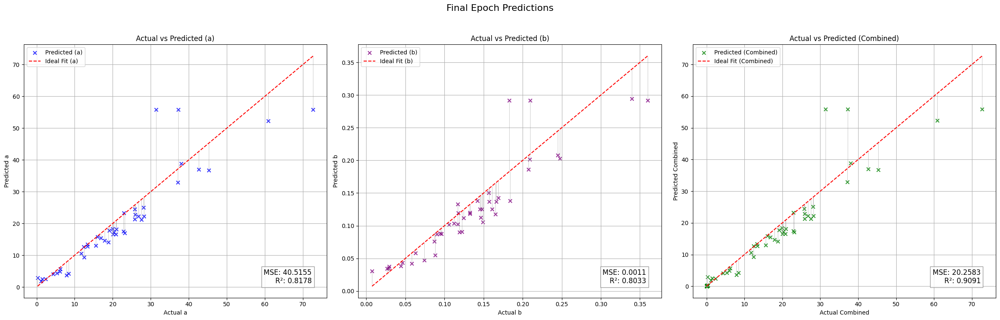

Validation Metrics:
  - MSE: 16.6720
  - R²: 0.8483
  - MAE: 1.7556
  - Explained Variance Score (EVS): 0.8759
Fold 3 Metrics:
  - Validation Loss (MSE): 16.6720
  - R²: 0.8483
  - MAE: 1.7556
  - EVS: 0.8759
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:01<00:00, 10.98it/s, loss=1.14]


Validation Metrics:
  - MSE: 24.5740
  - R²: 0.5675
  - MAE: 2.0743
  - Explained Variance Score (EVS): 0.5768
Epoch [1/50], Train Loss: 1.1813, Val Loss: 24.5740
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 11.42it/s, loss=1.12]


Validation Metrics:
  - MSE: 27.7459
  - R²: 0.5377
  - MAE: 2.1865
  - Explained Variance Score (EVS): 0.5487
Epoch [2/50], Train Loss: 1.1607, Val Loss: 27.7459
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:01<00:00, 10.90it/s, loss=1.22]


Validation Metrics:
  - MSE: 31.1641
  - R²: 0.5129
  - MAE: 2.2857
  - Explained Variance Score (EVS): 0.5231
Epoch [3/50], Train Loss: 1.1625, Val Loss: 31.1641
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:01<00:00, 10.72it/s, loss=1.17]


Validation Metrics:
  - MSE: 33.4413
  - R²: 0.4902
  - MAE: 2.4176
  - Explained Variance Score (EVS): 0.5052
Epoch [4/50], Train Loss: 1.1482, Val Loss: 33.4413
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.15it/s, loss=1.38]


Validation Metrics:
  - MSE: 32.7038
  - R²: 0.4945
  - MAE: 2.4165
  - Explained Variance Score (EVS): 0.5137
Epoch [5/50], Train Loss: 1.1260, Val Loss: 32.7038
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 12.95it/s, loss=1.17]


Validation Metrics:
  - MSE: 31.5078
  - R²: 0.5020
  - MAE: 2.2652
  - Explained Variance Score (EVS): 0.5139
Epoch [6/50], Train Loss: 1.0999, Val Loss: 31.5078
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.06it/s, loss=1.07]


Validation Metrics:
  - MSE: 37.7998
  - R²: 0.4605
  - MAE: 2.4993
  - Explained Variance Score (EVS): 0.4693
Epoch [7/50], Train Loss: 1.1120, Val Loss: 37.7998
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.37it/s, loss=1.18]


Validation Metrics:
  - MSE: 43.5654
  - R²: 0.4205
  - MAE: 2.5715
  - Explained Variance Score (EVS): 0.4233
Epoch [8/50], Train Loss: 1.0749, Val Loss: 43.5654
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.59it/s, loss=1.14]


Validation Metrics:
  - MSE: 46.6582
  - R²: 0.3965
  - MAE: 2.7668
  - Explained Variance Score (EVS): 0.4026
Epoch [9/50], Train Loss: 1.1155, Val Loss: 46.6582
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 12.52it/s, loss=1.08]


Validation Metrics:
  - MSE: 45.8130
  - R²: 0.4027
  - MAE: 2.7568
  - Explained Variance Score (EVS): 0.4086
Epoch [10/50], Train Loss: 1.0707, Val Loss: 45.8130
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 12.01it/s, loss=1.03]


Validation Metrics:
  - MSE: 39.2465
  - R²: 0.4470
  - MAE: 2.5693
  - Explained Variance Score (EVS): 0.4560
Epoch [11/50], Train Loss: 1.0545, Val Loss: 39.2465
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


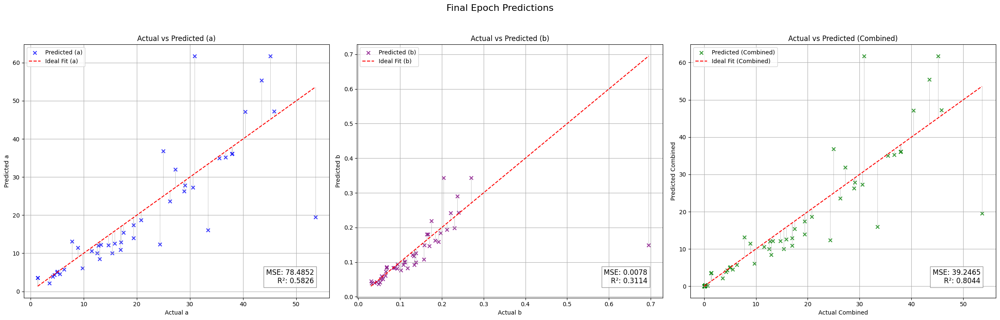

Validation Metrics:
  - MSE: 24.5740
  - R²: 0.5675
  - MAE: 2.0743
  - Explained Variance Score (EVS): 0.5768
Fold 4 Metrics:
  - Validation Loss (MSE): 24.5740
  - R²: 0.5675
  - MAE: 2.0743
  - EVS: 0.5768
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:01<00:00, 10.88it/s, loss=1.16]


Validation Metrics:
  - MSE: 44.1844
  - R²: 0.7932
  - MAE: 2.3324
  - Explained Variance Score (EVS): 0.8170
Epoch [1/50], Train Loss: 1.1795, Val Loss: 44.1844
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:01<00:00, 10.31it/s, loss=1.15]


Validation Metrics:
  - MSE: 45.4501
  - R²: 0.7812
  - MAE: 2.3630
  - Explained Variance Score (EVS): 0.8118
Epoch [2/50], Train Loss: 1.1650, Val Loss: 45.4501
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 12.48it/s, loss=1.13]


Validation Metrics:
  - MSE: 42.2531
  - R²: 0.7963
  - MAE: 2.2325
  - Explained Variance Score (EVS): 0.8176
Epoch [3/50], Train Loss: 1.1774, Val Loss: 42.2531
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 12.38it/s, loss=1.15]


Validation Metrics:
  - MSE: 42.2663
  - R²: 0.7892
  - MAE: 2.1842
  - Explained Variance Score (EVS): 0.8140
Epoch [4/50], Train Loss: 1.1475, Val Loss: 42.2663
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.55it/s, loss=1.12]


Validation Metrics:
  - MSE: 41.6478
  - R²: 0.7922
  - MAE: 2.2081
  - Explained Variance Score (EVS): 0.8186
Epoch [5/50], Train Loss: 1.1554, Val Loss: 41.6478
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 13.56it/s, loss=1.14]


Validation Metrics:
  - MSE: 42.9929
  - R²: 0.7843
  - MAE: 2.3109
  - Explained Variance Score (EVS): 0.8166
Epoch [6/50], Train Loss: 1.1618, Val Loss: 42.9929
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.27it/s, loss=1.2]


Validation Metrics:
  - MSE: 43.8562
  - R²: 0.7819
  - MAE: 2.3371
  - Explained Variance Score (EVS): 0.8143
Epoch [7/50], Train Loss: 1.1523, Val Loss: 43.8562
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.92it/s, loss=1.07]


Validation Metrics:
  - MSE: 45.8563
  - R²: 0.7685
  - MAE: 2.2948
  - Explained Variance Score (EVS): 0.7976
Epoch [8/50], Train Loss: 1.1351, Val Loss: 45.8563
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 11.81it/s, loss=1.12]


Validation Metrics:
  - MSE: 45.0630
  - R²: 0.7722
  - MAE: 2.2710
  - Explained Variance Score (EVS): 0.8063
Epoch [9/50], Train Loss: 1.1308, Val Loss: 45.0630
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 11.58it/s, loss=1.1]


Validation Metrics:
  - MSE: 44.7459
  - R²: 0.7763
  - MAE: 2.3119
  - Explained Variance Score (EVS): 0.8107
Epoch [10/50], Train Loss: 1.1129, Val Loss: 44.7459
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.95it/s, loss=1.05]


Validation Metrics:
  - MSE: 48.2061
  - R²: 0.7565
  - MAE: 2.4451
  - Explained Variance Score (EVS): 0.8013
Epoch [11/50], Train Loss: 1.1092, Val Loss: 48.2061
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 11.27it/s, loss=1.08]


Validation Metrics:
  - MSE: 41.0496
  - R²: 0.7956
  - MAE: 2.1686
  - Explained Variance Score (EVS): 0.8204
Epoch [12/50], Train Loss: 1.1024, Val Loss: 41.0496
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 11.07it/s, loss=1.07]


Validation Metrics:
  - MSE: 43.6035
  - R²: 0.7831
  - MAE: 2.3435
  - Explained Variance Score (EVS): 0.8178
Epoch [13/50], Train Loss: 1.0863, Val Loss: 43.6035
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 12.83it/s, loss=1.07]


Validation Metrics:
  - MSE: 44.4575
  - R²: 0.7805
  - MAE: 2.3139
  - Explained Variance Score (EVS): 0.8136
Epoch [14/50], Train Loss: 1.0880, Val Loss: 44.4575
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 12.44it/s, loss=1.03]


Validation Metrics:
  - MSE: 44.3268
  - R²: 0.7821
  - MAE: 2.3305
  - Explained Variance Score (EVS): 0.8151
Epoch [15/50], Train Loss: 1.1043, Val Loss: 44.3268
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 12.72it/s, loss=1.07]


Validation Metrics:
  - MSE: 40.8948
  - R²: 0.8006
  - MAE: 2.1730
  - Explained Variance Score (EVS): 0.8220
Epoch [16/50], Train Loss: 1.0948, Val Loss: 40.8948
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 12.78it/s, loss=1.14]


Validation Metrics:
  - MSE: 39.6945
  - R²: 0.8035
  - MAE: 2.1065
  - Explained Variance Score (EVS): 0.8202
Epoch [17/50], Train Loss: 1.0973, Val Loss: 39.6945
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 13.52it/s, loss=1.14]


Validation Metrics:
  - MSE: 44.1499
  - R²: 0.7774
  - MAE: 2.2913
  - Explained Variance Score (EVS): 0.8116
Epoch [18/50], Train Loss: 1.0880, Val Loss: 44.1499
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 12.13it/s, loss=1.07]


Validation Metrics:
  - MSE: 40.5421
  - R²: 0.7986
  - MAE: 2.1720
  - Explained Variance Score (EVS): 0.8248
Epoch [19/50], Train Loss: 1.0783, Val Loss: 40.5421
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 11.29it/s, loss=1.01]


Validation Metrics:
  - MSE: 41.4847
  - R²: 0.7963
  - MAE: 2.1467
  - Explained Variance Score (EVS): 0.8157
Epoch [20/50], Train Loss: 1.0740, Val Loss: 41.4847
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:00<00:00, 11.86it/s, loss=1.02]


Validation Metrics:
  - MSE: 39.5034
  - R²: 0.8065
  - MAE: 2.1232
  - Explained Variance Score (EVS): 0.8259
Epoch [21/50], Train Loss: 1.0994, Val Loss: 39.5034
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 11.03it/s, loss=1.06]


Validation Metrics:
  - MSE: 39.6387
  - R²: 0.8071
  - MAE: 2.1367
  - Explained Variance Score (EVS): 0.8261
Epoch [22/50], Train Loss: 1.0747, Val Loss: 39.6387
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:01<00:00, 10.85it/s, loss=1.04]


Validation Metrics:
  - MSE: 40.1855
  - R²: 0.8019
  - MAE: 2.1601
  - Explained Variance Score (EVS): 0.8232
Epoch [23/50], Train Loss: 1.0875, Val Loss: 40.1855
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 11.06it/s, loss=1.22]


Validation Metrics:
  - MSE: 42.1986
  - R²: 0.7895
  - MAE: 2.2076
  - Explained Variance Score (EVS): 0.8154
Epoch [24/50], Train Loss: 1.0717, Val Loss: 42.1986
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 11/11 [00:00<00:00, 13.16it/s, loss=1.03]


Validation Metrics:
  - MSE: 43.4049
  - R²: 0.7850
  - MAE: 2.1985
  - Explained Variance Score (EVS): 0.8066
Epoch [25/50], Train Loss: 1.0396, Val Loss: 43.4049
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 11/11 [00:00<00:00, 13.75it/s, loss=1.09]


Validation Metrics:
  - MSE: 40.3281
  - R²: 0.8008
  - MAE: 2.1395
  - Explained Variance Score (EVS): 0.8223
Epoch [26/50], Train Loss: 1.0743, Val Loss: 40.3281
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 11/11 [00:00<00:00, 12.00it/s, loss=1.06]


Validation Metrics:
  - MSE: 40.0997
  - R²: 0.8014
  - MAE: 2.1354
  - Explained Variance Score (EVS): 0.8212
Epoch [27/50], Train Loss: 1.0850, Val Loss: 40.0997
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 11/11 [00:00<00:00, 13.66it/s, loss=1.07]


Validation Metrics:
  - MSE: 40.1284
  - R²: 0.8006
  - MAE: 2.1169
  - Explained Variance Score (EVS): 0.8156
Epoch [28/50], Train Loss: 1.0594, Val Loss: 40.1284
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 11/11 [00:00<00:00, 11.96it/s, loss=1.14]


Validation Metrics:
  - MSE: 40.5885
  - R²: 0.7999
  - MAE: 2.0951
  - Explained Variance Score (EVS): 0.8173
Epoch [29/50], Train Loss: 1.0537, Val Loss: 40.5885
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 11/11 [00:00<00:00, 12.63it/s, loss=0.99]


Validation Metrics:
  - MSE: 37.7249
  - R²: 0.8109
  - MAE: 1.9947
  - Explained Variance Score (EVS): 0.8225
Epoch [30/50], Train Loss: 1.0570, Val Loss: 37.7249
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 11/11 [00:01<00:00, 10.85it/s, loss=1.01]


Validation Metrics:
  - MSE: 38.1016
  - R²: 0.8103
  - MAE: 2.0244
  - Explained Variance Score (EVS): 0.8245
Epoch [31/50], Train Loss: 1.0559, Val Loss: 38.1016
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 11/11 [00:00<00:00, 12.07it/s, loss=1.03]


Validation Metrics:
  - MSE: 37.1520
  - R²: 0.8149
  - MAE: 2.0219
  - Explained Variance Score (EVS): 0.8312
Epoch [32/50], Train Loss: 1.0505, Val Loss: 37.1520
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 11/11 [00:00<00:00, 11.25it/s, loss=1.03]


Validation Metrics:
  - MSE: 38.3079
  - R²: 0.8086
  - MAE: 2.0402
  - Explained Variance Score (EVS): 0.8236
Epoch [33/50], Train Loss: 1.0661, Val Loss: 38.3079
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 11/11 [00:00<00:00, 11.27it/s, loss=0.997]


Validation Metrics:
  - MSE: 38.2281
  - R²: 0.8100
  - MAE: 2.1010
  - Explained Variance Score (EVS): 0.8261
Epoch [34/50], Train Loss: 1.0424, Val Loss: 38.2281
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 11/11 [00:00<00:00, 13.09it/s, loss=0.98]


Validation Metrics:
  - MSE: 38.5639
  - R²: 0.8099
  - MAE: 2.0787
  - Explained Variance Score (EVS): 0.8245
Epoch [35/50], Train Loss: 1.0451, Val Loss: 38.5639
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 11/11 [00:00<00:00, 13.31it/s, loss=0.97]


Validation Metrics:
  - MSE: 38.5055
  - R²: 0.8089
  - MAE: 2.0995
  - Explained Variance Score (EVS): 0.8263
Epoch [36/50], Train Loss: 1.0398, Val Loss: 38.5055
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 11/11 [00:00<00:00, 13.70it/s, loss=0.973]


Validation Metrics:
  - MSE: 39.1837
  - R²: 0.8020
  - MAE: 2.0697
  - Explained Variance Score (EVS): 0.8183
Epoch [37/50], Train Loss: 1.0452, Val Loss: 39.1837
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 11/11 [00:00<00:00, 13.37it/s, loss=1.16]


Validation Metrics:
  - MSE: 38.8143
  - R²: 0.8052
  - MAE: 2.0422
  - Explained Variance Score (EVS): 0.8219
Epoch [38/50], Train Loss: 1.0344, Val Loss: 38.8143
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 11/11 [00:00<00:00, 12.84it/s, loss=1.09]


Validation Metrics:
  - MSE: 40.8055
  - R²: 0.7944
  - MAE: 2.1266
  - Explained Variance Score (EVS): 0.8166
Epoch [39/50], Train Loss: 1.0237, Val Loss: 40.8055
Current Dropout Rate: 0.1960


Epoch 40/50: 100%|██████████| 11/11 [00:00<00:00, 11.96it/s, loss=0.967]


Validation Metrics:
  - MSE: 40.2011
  - R²: 0.7982
  - MAE: 2.1095
  - Explained Variance Score (EVS): 0.8172
Epoch [40/50], Train Loss: 1.0254, Val Loss: 40.2011
Current Dropout Rate: 0.1880


Epoch 41/50: 100%|██████████| 11/11 [00:00<00:00, 11.81it/s, loss=1.01]


Validation Metrics:
  - MSE: 40.1491
  - R²: 0.7980
  - MAE: 2.1075
  - Explained Variance Score (EVS): 0.8156
Epoch [41/50], Train Loss: 1.0235, Val Loss: 40.1491
Current Dropout Rate: 0.1800


Epoch 42/50: 100%|██████████| 11/11 [00:00<00:00, 12.60it/s, loss=1.03]


Validation Metrics:
  - MSE: 36.3159
  - R²: 0.8177
  - MAE: 1.9545
  - Explained Variance Score (EVS): 0.8298
Epoch [42/50], Train Loss: 1.0380, Val Loss: 36.3159
Current Dropout Rate: 0.1720


Epoch 43/50: 100%|██████████| 11/11 [00:00<00:00, 12.47it/s, loss=1.18]


Validation Metrics:
  - MSE: 37.4897
  - R²: 0.8132
  - MAE: 2.0325
  - Explained Variance Score (EVS): 0.8276
Epoch [43/50], Train Loss: 1.0469, Val Loss: 37.4897
Current Dropout Rate: 0.1640


Epoch 44/50: 100%|██████████| 11/11 [00:01<00:00, 10.66it/s, loss=1.06]


Validation Metrics:
  - MSE: 38.3948
  - R²: 0.8087
  - MAE: 2.0346
  - Explained Variance Score (EVS): 0.8230
Epoch [44/50], Train Loss: 1.0098, Val Loss: 38.3948
Current Dropout Rate: 0.1560


Epoch 45/50: 100%|██████████| 11/11 [00:00<00:00, 11.37it/s, loss=1.03]


Validation Metrics:
  - MSE: 38.7870
  - R²: 0.8059
  - MAE: 2.0169
  - Explained Variance Score (EVS): 0.8177
Epoch [45/50], Train Loss: 1.0260, Val Loss: 38.7870
Current Dropout Rate: 0.1480


Epoch 46/50: 100%|██████████| 11/11 [00:00<00:00, 12.73it/s, loss=1.03]


Validation Metrics:
  - MSE: 38.3389
  - R²: 0.8104
  - MAE: 2.0515
  - Explained Variance Score (EVS): 0.8223
Epoch [46/50], Train Loss: 1.0348, Val Loss: 38.3389
Current Dropout Rate: 0.1400


Epoch 47/50: 100%|██████████| 11/11 [00:00<00:00, 12.78it/s, loss=1.07]


Validation Metrics:
  - MSE: 36.4832
  - R²: 0.8188
  - MAE: 1.9423
  - Explained Variance Score (EVS): 0.8287
Epoch [47/50], Train Loss: 1.0390, Val Loss: 36.4832
Current Dropout Rate: 0.1320


Epoch 48/50: 100%|██████████| 11/11 [00:00<00:00, 12.05it/s, loss=0.996]


Validation Metrics:
  - MSE: 38.6226
  - R²: 0.8082
  - MAE: 1.9980
  - Explained Variance Score (EVS): 0.8190
Epoch [48/50], Train Loss: 1.0198, Val Loss: 38.6226
Current Dropout Rate: 0.1240


Epoch 49/50: 100%|██████████| 11/11 [00:00<00:00, 12.69it/s, loss=0.967]


Validation Metrics:
  - MSE: 35.9943
  - R²: 0.8220
  - MAE: 1.9321
  - Explained Variance Score (EVS): 0.8315
Epoch [49/50], Train Loss: 1.0250, Val Loss: 35.9943
Current Dropout Rate: 0.1160


Epoch 50/50: 100%|██████████| 11/11 [00:00<00:00, 13.27it/s, loss=0.976]


Validation Metrics:
  - MSE: 38.6398
  - R²: 0.8093
  - MAE: 2.0187
  - Explained Variance Score (EVS): 0.8237
Epoch [50/50], Train Loss: 1.0185, Val Loss: 38.6398
Current Dropout Rate: 0.1080
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


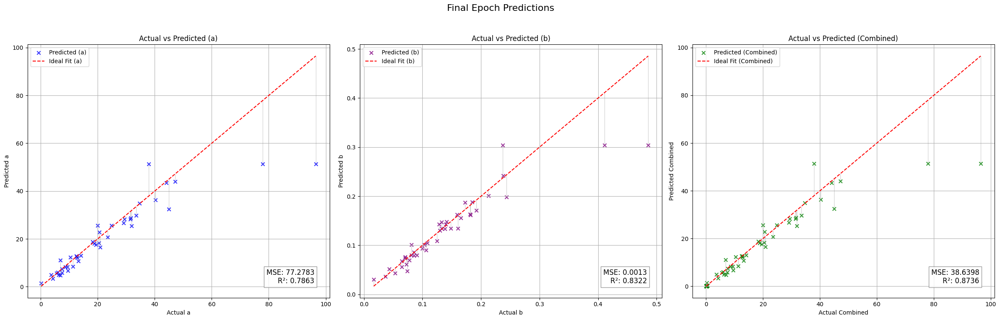

[I 2024-12-01 17:57:57,625] Trial 35 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 35.9943
  - R²: 0.8220
  - MAE: 1.9321
  - Explained Variance Score (EVS): 0.8315
Fold 5 Metrics:
  - Validation Loss (MSE): 35.9943
  - R²: 0.8220
  - MAE: 1.9321
  - EVS: 0.8315
Avg Validation Metrics:
  - MSE: 26.1048
  - R²: 0.7833
  - MAE: 1.9466
  - EVS: 0.8031
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.75it/s, loss=1.67]


Validation Metrics:
  - MSE: 195.5849
  - R²: -0.0219
  - MAE: 6.5429
  - Explained Variance Score (EVS): -0.0025
Epoch [1/50], Train Loss: 1.6771, Val Loss: 195.5849
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.48it/s, loss=1.76]


Validation Metrics:
  - MSE: 195.6172
  - R²: -0.0226
  - MAE: 6.5552
  - Explained Variance Score (EVS): -0.0041
Epoch [2/50], Train Loss: 1.6630, Val Loss: 195.6172
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s, loss=1.6]


Validation Metrics:
  - MSE: 195.6398
  - R²: -0.0232
  - MAE: 6.5719
  - Explained Variance Score (EVS): -0.0057
Epoch [3/50], Train Loss: 1.6261, Val Loss: 195.6398
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.46it/s, loss=1.71]


Validation Metrics:
  - MSE: 195.6150
  - R²: -0.0239
  - MAE: 6.5940
  - Explained Variance Score (EVS): -0.0079
Epoch [4/50], Train Loss: 1.6633, Val Loss: 195.6150
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=1.41]


Validation Metrics:
  - MSE: 195.7167
  - R²: -0.0257
  - MAE: 6.6238
  - Explained Variance Score (EVS): -0.0113
Epoch [5/50], Train Loss: 1.6162, Val Loss: 195.7167
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.70it/s, loss=1.46]


Validation Metrics:
  - MSE: 195.9176
  - R²: -0.0283
  - MAE: 6.6694
  - Explained Variance Score (EVS): -0.0160
Epoch [6/50], Train Loss: 1.6055, Val Loss: 195.9176
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=1.74]


Validation Metrics:
  - MSE: 196.5906
  - R²: -0.0322
  - MAE: 6.7340
  - Explained Variance Score (EVS): -0.0217
Epoch [7/50], Train Loss: 1.6099, Val Loss: 196.5906
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s, loss=1.64]


Validation Metrics:
  - MSE: 197.8439
  - R²: -0.0398
  - MAE: 6.8298
  - Explained Variance Score (EVS): -0.0312
Epoch [8/50], Train Loss: 1.5936, Val Loss: 197.8439
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.09it/s, loss=1.6]


Validation Metrics:
  - MSE: 199.5241
  - R²: -0.0495
  - MAE: 6.9800
  - Explained Variance Score (EVS): -0.0417
Epoch [9/50], Train Loss: 1.5603, Val Loss: 199.5241
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.48it/s, loss=1.63]


Validation Metrics:
  - MSE: 202.1123
  - R²: -0.0625
  - MAE: 7.1865
  - Explained Variance Score (EVS): -0.0541
Epoch [10/50], Train Loss: 1.5786, Val Loss: 202.1123
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.48it/s, loss=1.5]


Validation Metrics:
  - MSE: 205.1880
  - R²: -0.0774
  - MAE: 7.3746
  - Explained Variance Score (EVS): -0.0668
Epoch [11/50], Train Loss: 1.5585, Val Loss: 205.1880
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


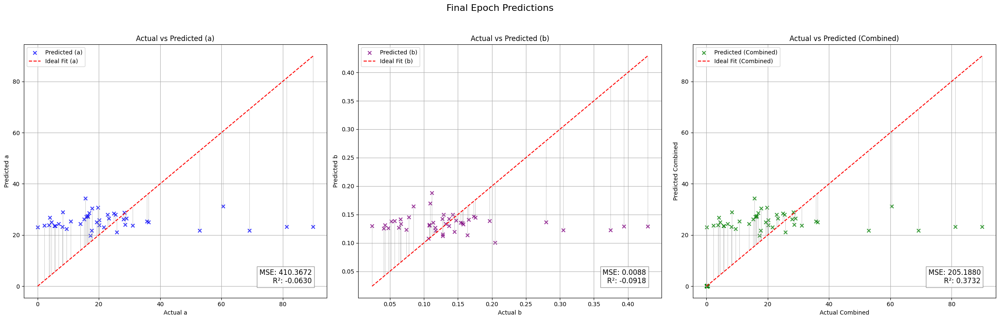

Validation Metrics:
  - MSE: 195.5849
  - R²: -0.0219
  - MAE: 6.5429
  - Explained Variance Score (EVS): -0.0025
Fold 1 Metrics:
  - Validation Loss (MSE): 195.5849
  - R²: -0.0219
  - MAE: 6.5429
  - EVS: -0.0025
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.66it/s, loss=1.52]


Validation Metrics:
  - MSE: 105.3740
  - R²: -0.1913
  - MAE: 6.2581
  - Explained Variance Score (EVS): -0.0062
Epoch [1/50], Train Loss: 1.6421, Val Loss: 105.3740
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.81it/s, loss=1.48]


Validation Metrics:
  - MSE: 106.5786
  - R²: -0.2017
  - MAE: 6.3063
  - Explained Variance Score (EVS): -0.0091
Epoch [2/50], Train Loss: 1.6325, Val Loss: 106.5786
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=1.53]


Validation Metrics:
  - MSE: 108.2655
  - R²: -0.2155
  - MAE: 6.3704
  - Explained Variance Score (EVS): -0.0136
Epoch [3/50], Train Loss: 1.6381, Val Loss: 108.2655
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.38it/s, loss=1.73]


Validation Metrics:
  - MSE: 110.7148
  - R²: -0.2345
  - MAE: 6.4587
  - Explained Variance Score (EVS): -0.0197
Epoch [4/50], Train Loss: 1.6261, Val Loss: 110.7148
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.97it/s, loss=1.59]


Validation Metrics:
  - MSE: 114.0874
  - R²: -0.2607
  - MAE: 6.5725
  - Explained Variance Score (EVS): -0.0282
Epoch [5/50], Train Loss: 1.6174, Val Loss: 114.0874
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  8.38it/s, loss=1.83]


Validation Metrics:
  - MSE: 118.7058
  - R²: -0.2972
  - MAE: 6.7170
  - Explained Variance Score (EVS): -0.0400
Epoch [6/50], Train Loss: 1.6243, Val Loss: 118.7058
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.48it/s, loss=1.31]


Validation Metrics:
  - MSE: 125.6552
  - R²: -0.3518
  - MAE: 6.9493
  - Explained Variance Score (EVS): -0.0572
Epoch [7/50], Train Loss: 1.5685, Val Loss: 125.6552
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.98it/s, loss=1.91]


Validation Metrics:
  - MSE: 134.1939
  - R²: -0.4192
  - MAE: 7.2488
  - Explained Variance Score (EVS): -0.0804
Epoch [8/50], Train Loss: 1.6122, Val Loss: 134.1939
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.38it/s, loss=1.62]


Validation Metrics:
  - MSE: 144.4172
  - R²: -0.4974
  - MAE: 7.6203
  - Explained Variance Score (EVS): -0.1074
Epoch [9/50], Train Loss: 1.5571, Val Loss: 144.4172
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.85it/s, loss=1.42]


Validation Metrics:
  - MSE: 156.9838
  - R²: -0.5939
  - MAE: 8.0520
  - Explained Variance Score (EVS): -0.1363
Epoch [10/50], Train Loss: 1.5357, Val Loss: 156.9838
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.11it/s, loss=1.46]


Validation Metrics:
  - MSE: 168.5836
  - R²: -0.6848
  - MAE: 8.4130
  - Explained Variance Score (EVS): -0.1625
Epoch [11/50], Train Loss: 1.5420, Val Loss: 168.5836
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


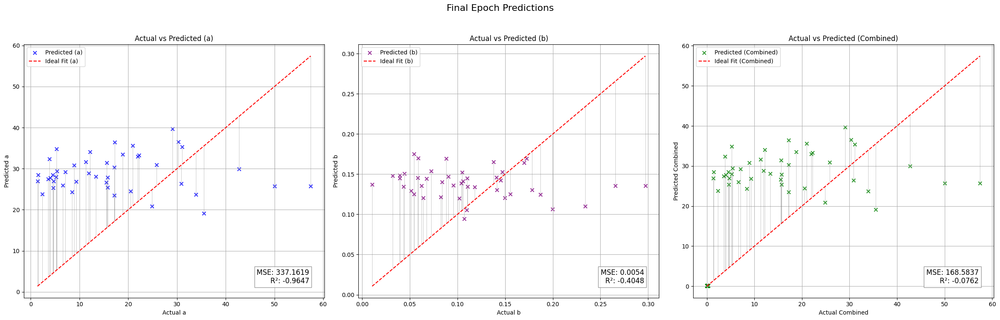

Validation Metrics:
  - MSE: 105.3740
  - R²: -0.1913
  - MAE: 6.2581
  - Explained Variance Score (EVS): -0.0062
Fold 2 Metrics:
  - Validation Loss (MSE): 105.3740
  - R²: -0.1913
  - MAE: 6.2581
  - EVS: -0.0062
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.55it/s, loss=1.68]


Validation Metrics:
  - MSE: 112.9740
  - R²: -0.0099
  - MAE: 5.5682
  - Explained Variance Score (EVS): -0.0060
Epoch [1/50], Train Loss: 1.6572, Val Loss: 112.9740
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.80it/s, loss=1.37]


Validation Metrics:
  - MSE: 113.6450
  - R²: -0.0135
  - MAE: 5.5957
  - Explained Variance Score (EVS): -0.0091
Epoch [2/50], Train Loss: 1.6306, Val Loss: 113.6450
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.10it/s, loss=1.74]


Validation Metrics:
  - MSE: 114.6085
  - R²: -0.0179
  - MAE: 5.6409
  - Explained Variance Score (EVS): -0.0126
Epoch [3/50], Train Loss: 1.6232, Val Loss: 114.6085
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.76it/s, loss=1.7]


Validation Metrics:
  - MSE: 115.9927
  - R²: -0.0249
  - MAE: 5.7084
  - Explained Variance Score (EVS): -0.0182
Epoch [4/50], Train Loss: 1.5979, Val Loss: 115.9927
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.56it/s, loss=1.43]


Validation Metrics:
  - MSE: 117.8811
  - R²: -0.0344
  - MAE: 5.7961
  - Explained Variance Score (EVS): -0.0253
Epoch [5/50], Train Loss: 1.5868, Val Loss: 117.8811
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.81it/s, loss=1.6]


Validation Metrics:
  - MSE: 120.5538
  - R²: -0.0476
  - MAE: 5.9135
  - Explained Variance Score (EVS): -0.0348
Epoch [6/50], Train Loss: 1.5930, Val Loss: 120.5538
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.33it/s, loss=1.44]


Validation Metrics:
  - MSE: 124.0749
  - R²: -0.0659
  - MAE: 6.0705
  - Explained Variance Score (EVS): -0.0467
Epoch [7/50], Train Loss: 1.5558, Val Loss: 124.0749
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=1.74]


Validation Metrics:
  - MSE: 128.1147
  - R²: -0.0873
  - MAE: 6.2497
  - Explained Variance Score (EVS): -0.0603
Epoch [8/50], Train Loss: 1.5798, Val Loss: 128.1147
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.02it/s, loss=1.37]


Validation Metrics:
  - MSE: 133.1332
  - R²: -0.1144
  - MAE: 6.4590
  - Explained Variance Score (EVS): -0.0752
Epoch [9/50], Train Loss: 1.5471, Val Loss: 133.1332
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.75it/s, loss=1.59]


Validation Metrics:
  - MSE: 138.0018
  - R²: -0.1418
  - MAE: 6.6481
  - Explained Variance Score (EVS): -0.0906
Epoch [10/50], Train Loss: 1.5730, Val Loss: 138.0018
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.61it/s, loss=1.41]


Validation Metrics:
  - MSE: 141.2098
  - R²: -0.1611
  - MAE: 6.7842
  - Explained Variance Score (EVS): -0.1029
Epoch [11/50], Train Loss: 1.5300, Val Loss: 141.2098
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


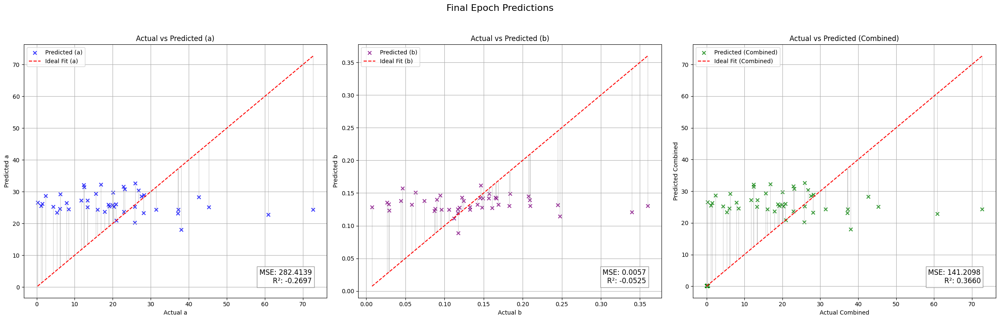

Validation Metrics:
  - MSE: 112.9740
  - R²: -0.0099
  - MAE: 5.5682
  - Explained Variance Score (EVS): -0.0060
Fold 3 Metrics:
  - Validation Loss (MSE): 112.9740
  - R²: -0.0099
  - MAE: 5.5682
  - EVS: -0.0060
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=1.77]


Validation Metrics:
  - MSE: 96.2983
  - R²: -0.0166
  - MAE: 6.0799
  - Explained Variance Score (EVS): -0.0040
Epoch [1/50], Train Loss: 1.6692, Val Loss: 96.2983
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.23it/s, loss=1.69]


Validation Metrics:
  - MSE: 97.1522
  - R²: -0.0208
  - MAE: 6.1187
  - Explained Variance Score (EVS): -0.0061
Epoch [2/50], Train Loss: 1.6517, Val Loss: 97.1522
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.84it/s, loss=1.56]


Validation Metrics:
  - MSE: 98.4902
  - R²: -0.0277
  - MAE: 6.1727
  - Explained Variance Score (EVS): -0.0092
Epoch [3/50], Train Loss: 1.6788, Val Loss: 98.4902
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=1.55]


Validation Metrics:
  - MSE: 100.5725
  - R²: -0.0385
  - MAE: 6.2451
  - Explained Variance Score (EVS): -0.0137
Epoch [4/50], Train Loss: 1.6356, Val Loss: 100.5725
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=1.94]


Validation Metrics:
  - MSE: 103.7256
  - R²: -0.0557
  - MAE: 6.3362
  - Explained Variance Score (EVS): -0.0204
Epoch [5/50], Train Loss: 1.6719, Val Loss: 103.7256
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=1.77]


Validation Metrics:
  - MSE: 108.1795
  - R²: -0.0803
  - MAE: 6.4626
  - Explained Variance Score (EVS): -0.0299
Epoch [6/50], Train Loss: 1.6347, Val Loss: 108.1795
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.45it/s, loss=1.67]


Validation Metrics:
  - MSE: 113.9131
  - R²: -0.1116
  - MAE: 6.6794
  - Explained Variance Score (EVS): -0.0402
Epoch [7/50], Train Loss: 1.6234, Val Loss: 113.9131
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.29it/s, loss=1.83]


Validation Metrics:
  - MSE: 120.3278
  - R²: -0.1471
  - MAE: 6.8876
  - Explained Variance Score (EVS): -0.0515
Epoch [8/50], Train Loss: 1.6507, Val Loss: 120.3278
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  8.59it/s, loss=1.49]


Validation Metrics:
  - MSE: 126.5545
  - R²: -0.1814
  - MAE: 7.0709
  - Explained Variance Score (EVS): -0.0613
Epoch [9/50], Train Loss: 1.5905, Val Loss: 126.5545
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.12it/s, loss=1.6]


Validation Metrics:
  - MSE: 131.6985
  - R²: -0.2103
  - MAE: 7.2309
  - Explained Variance Score (EVS): -0.0707
Epoch [10/50], Train Loss: 1.6019, Val Loss: 131.6985
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.19it/s, loss=1.69]


Validation Metrics:
  - MSE: 136.0869
  - R²: -0.2340
  - MAE: 7.3543
  - Explained Variance Score (EVS): -0.0754
Epoch [11/50], Train Loss: 1.6123, Val Loss: 136.0869
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


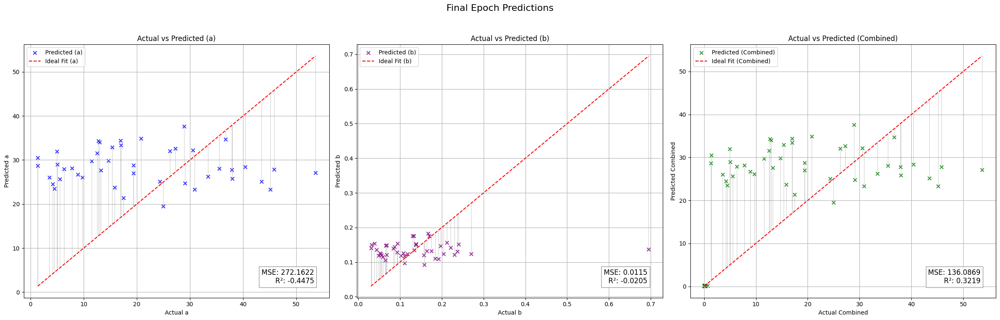

Validation Metrics:
  - MSE: 96.2983
  - R²: -0.0166
  - MAE: 6.0799
  - Explained Variance Score (EVS): -0.0040
Fold 4 Metrics:
  - Validation Loss (MSE): 96.2983
  - R²: -0.0166
  - MAE: 6.0799
  - EVS: -0.0040
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.57it/s, loss=1.42]


Validation Metrics:
  - MSE: 185.1904
  - R²: -0.0176
  - MAE: 7.0452
  - Explained Variance Score (EVS): -0.0123
Epoch [1/50], Train Loss: 1.6089, Val Loss: 185.1904
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.27it/s, loss=1.7]


Validation Metrics:
  - MSE: 186.7169
  - R²: -0.0221
  - MAE: 7.1256
  - Explained Variance Score (EVS): -0.0174
Epoch [2/50], Train Loss: 1.6416, Val Loss: 186.7169
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.53it/s, loss=1.61]


Validation Metrics:
  - MSE: 188.7221
  - R²: -0.0282
  - MAE: 7.2219
  - Explained Variance Score (EVS): -0.0237
Epoch [3/50], Train Loss: 1.6414, Val Loss: 188.7221
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.01it/s, loss=1.48]


Validation Metrics:
  - MSE: 191.6601
  - R²: -0.0390
  - MAE: 7.3634
  - Explained Variance Score (EVS): -0.0343
Epoch [4/50], Train Loss: 1.6048, Val Loss: 191.6601
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.59it/s, loss=1.42]


Validation Metrics:
  - MSE: 195.5965
  - R²: -0.0529
  - MAE: 7.5541
  - Explained Variance Score (EVS): -0.0470
Epoch [5/50], Train Loss: 1.6130, Val Loss: 195.5965
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=1.54]


Validation Metrics:
  - MSE: 200.5085
  - R²: -0.0702
  - MAE: 7.7561
  - Explained Variance Score (EVS): -0.0620
Epoch [6/50], Train Loss: 1.6107, Val Loss: 200.5085
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.89it/s, loss=1.58]


Validation Metrics:
  - MSE: 206.1192
  - R²: -0.0903
  - MAE: 7.9627
  - Explained Variance Score (EVS): -0.0787
Epoch [7/50], Train Loss: 1.6206, Val Loss: 206.1192
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.36it/s, loss=1.63]


Validation Metrics:
  - MSE: 211.2827
  - R²: -0.1104
  - MAE: 8.1551
  - Explained Variance Score (EVS): -0.0934
Epoch [8/50], Train Loss: 1.6108, Val Loss: 211.2827
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.75it/s, loss=1.55]


Validation Metrics:
  - MSE: 215.9879
  - R²: -0.1273
  - MAE: 8.3057
  - Explained Variance Score (EVS): -0.1053
Epoch [9/50], Train Loss: 1.6102, Val Loss: 215.9879
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.75it/s, loss=2]


Validation Metrics:
  - MSE: 219.6996
  - R²: -0.1391
  - MAE: 8.4204
  - Explained Variance Score (EVS): -0.1136
Epoch [10/50], Train Loss: 1.6532, Val Loss: 219.6996
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.40it/s, loss=1.74]


Validation Metrics:
  - MSE: 220.4951
  - R²: -0.1414
  - MAE: 8.4379
  - Explained Variance Score (EVS): -0.1163
Epoch [11/50], Train Loss: 1.6136, Val Loss: 220.4951
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


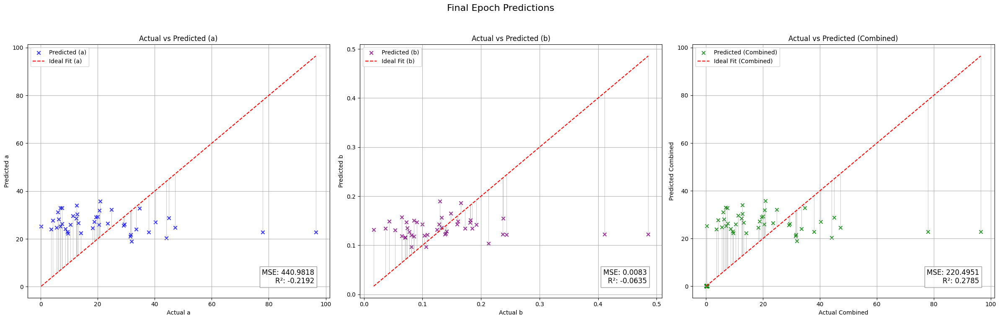

[I 2024-12-01 17:59:32,651] Trial 36 pruned. 


Validation Metrics:
  - MSE: 185.1904
  - R²: -0.0176
  - MAE: 7.0452
  - Explained Variance Score (EVS): -0.0123
Fold 5 Metrics:
  - Validation Loss (MSE): 185.1904
  - R²: -0.0176
  - MAE: 7.0452
  - EVS: -0.0123
Avg Validation Metrics:
  - MSE: 139.0843
  - R²: -0.0515
  - MAE: 6.2988
  - EVS: -0.0062
Using device: cuda


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Fold 1/5


Epoch 1/50: 100%|██████████| 11/11 [00:01<00:00, 10.98it/s, loss=0.605]


Validation Metrics:
  - MSE: 195.5871
  - R²: -0.0212
  - MAE: 6.5161
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.8128, Val Loss: 195.5871
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 11.24it/s, loss=0.501]


Validation Metrics:
  - MSE: 196.2224
  - R²: -0.0197
  - MAE: 6.4920
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.5174, Val Loss: 196.2224
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 11.49it/s, loss=0.393]


Validation Metrics:
  - MSE: 196.7558
  - R²: -0.0203
  - MAE: 6.4736
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4571, Val Loss: 196.7558
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 12.81it/s, loss=0.574]


Validation Metrics:
  - MSE: 197.0601
  - R²: -0.0205
  - MAE: 6.4636
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4424, Val Loss: 197.0601
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.68it/s, loss=0.561]


Validation Metrics:
  - MSE: 197.2848
  - R²: -0.0205
  - MAE: 6.4565
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4273, Val Loss: 197.2848
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 12.63it/s, loss=0.274]


Validation Metrics:
  - MSE: 197.2714
  - R²: -0.0203
  - MAE: 6.4530
  - Explained Variance Score (EVS): 0.0002
Epoch [6/50], Train Loss: 0.4233, Val Loss: 197.2714
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.31it/s, loss=0.389]


Validation Metrics:
  - MSE: 197.4131
  - R²: -0.0205
  - MAE: 6.4519
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4275, Val Loss: 197.4131
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 13.10it/s, loss=0.252]


Validation Metrics:
  - MSE: 197.3523
  - R²: -0.0201
  - MAE: 6.4491
  - Explained Variance Score (EVS): 0.0003
Epoch [8/50], Train Loss: 0.4281, Val Loss: 197.3523
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.25it/s, loss=0.385]


Validation Metrics:
  - MSE: 196.9706
  - R²: -0.0177
  - MAE: 6.4459
  - Explained Variance Score (EVS): 0.0025
Epoch [9/50], Train Loss: 0.4291, Val Loss: 196.9706
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:01<00:00, 10.85it/s, loss=0.604]


Validation Metrics:
  - MSE: 196.9148
  - R²: -0.0174
  - MAE: 6.4393
  - Explained Variance Score (EVS): 0.0027
Epoch [10/50], Train Loss: 0.4315, Val Loss: 196.9148
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:01<00:00, 10.81it/s, loss=0.301]


Validation Metrics:
  - MSE: 196.6947
  - R²: -0.0158
  - MAE: 6.4359
  - Explained Variance Score (EVS): 0.0039
Epoch [11/50], Train Loss: 0.4289, Val Loss: 196.6947
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


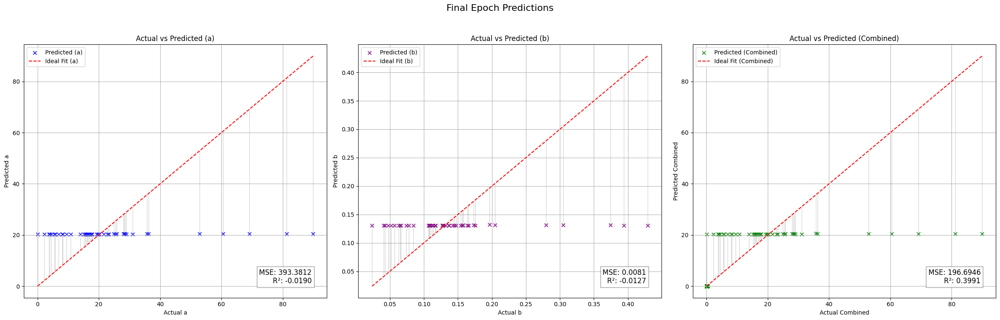

Validation Metrics:
  - MSE: 195.5871
  - R²: -0.0212
  - MAE: 6.5161
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 195.5871
  - R²: -0.0212
  - MAE: 6.5161
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 11.04it/s, loss=0.397]


Validation Metrics:
  - MSE: 102.2118
  - R²: -0.1760
  - MAE: 6.1226
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.5395, Val Loss: 102.2118
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.81it/s, loss=0.815]


Validation Metrics:
  - MSE: 100.3862
  - R²: -0.1718
  - MAE: 6.0407
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4703, Val Loss: 100.3862
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:00<00:00, 13.27it/s, loss=0.399]


Validation Metrics:
  - MSE: 99.9674
  - R²: -0.1710
  - MAE: 6.0212
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4406, Val Loss: 99.9674
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.84it/s, loss=0.257]


Validation Metrics:
  - MSE: 99.2289
  - R²: -0.1684
  - MAE: 5.9885
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4243, Val Loss: 99.2289
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.96it/s, loss=0.385]


Validation Metrics:
  - MSE: 98.8272
  - R²: -0.1685
  - MAE: 5.9708
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4180, Val Loss: 98.8272
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 11.85it/s, loss=0.755]


Validation Metrics:
  - MSE: 98.5891
  - R²: -0.1688
  - MAE: 5.9602
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4134, Val Loss: 98.5891
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.09it/s, loss=0.375]


Validation Metrics:
  - MSE: 98.3473
  - R²: -0.1667
  - MAE: 5.9506
  - Explained Variance Score (EVS): 0.0019
Epoch [7/50], Train Loss: 0.4161, Val Loss: 98.3473
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 11.88it/s, loss=0.405]


Validation Metrics:
  - MSE: 98.2550
  - R²: -0.1673
  - MAE: 5.9440
  - Explained Variance Score (EVS): 0.0018
Epoch [8/50], Train Loss: 0.4239, Val Loss: 98.2550
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:01<00:00, 10.40it/s, loss=0.223]


Validation Metrics:
  - MSE: 98.0849
  - R²: -0.1650
  - MAE: 5.9408
  - Explained Variance Score (EVS): 0.0029
Epoch [9/50], Train Loss: 0.4217, Val Loss: 98.0849
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:01<00:00, 10.59it/s, loss=0.36]


Validation Metrics:
  - MSE: 96.4817
  - R²: -0.1465
  - MAE: 5.8992
  - Explained Variance Score (EVS): 0.0246
Epoch [10/50], Train Loss: 0.4235, Val Loss: 96.4817
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.15it/s, loss=0.62]


Validation Metrics:
  - MSE: 96.2369
  - R²: -0.1472
  - MAE: 5.8971
  - Explained Variance Score (EVS): 0.0306
Epoch [11/50], Train Loss: 0.4251, Val Loss: 96.2369
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 12.24it/s, loss=0.481]


Validation Metrics:
  - MSE: 96.7087
  - R²: -0.1515
  - MAE: 5.9114
  - Explained Variance Score (EVS): 0.0200
Epoch [12/50], Train Loss: 0.4272, Val Loss: 96.7087
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 12.42it/s, loss=0.454]


Validation Metrics:
  - MSE: 96.8019
  - R²: -0.1542
  - MAE: 5.9139
  - Explained Variance Score (EVS): 0.0165
Epoch [13/50], Train Loss: 0.4244, Val Loss: 96.8019
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:00<00:00, 13.14it/s, loss=0.377]


Validation Metrics:
  - MSE: 96.1174
  - R²: -0.1454
  - MAE: 5.8608
  - Explained Variance Score (EVS): 0.0362
Epoch [14/50], Train Loss: 0.4250, Val Loss: 96.1174
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:00<00:00, 12.70it/s, loss=0.522]


Validation Metrics:
  - MSE: 96.1454
  - R²: -0.1455
  - MAE: 5.8873
  - Explained Variance Score (EVS): 0.0311
Epoch [15/50], Train Loss: 0.4250, Val Loss: 96.1454
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 13.06it/s, loss=0.361]


Validation Metrics:
  - MSE: 97.8708
  - R²: -0.1660
  - MAE: 5.9246
  - Explained Variance Score (EVS): 0.0054
Epoch [16/50], Train Loss: 0.4245, Val Loss: 97.8708
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:00<00:00, 12.11it/s, loss=0.294]


Validation Metrics:
  - MSE: 98.1940
  - R²: -0.1691
  - MAE: 5.9428
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.4237, Val Loss: 98.1940
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 11.90it/s, loss=0.481]


Validation Metrics:
  - MSE: 97.4933
  - R²: -0.1618
  - MAE: 5.9128
  - Explained Variance Score (EVS): 0.0115
Epoch [18/50], Train Loss: 0.4250, Val Loss: 97.4933
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:01<00:00, 10.72it/s, loss=0.373]


Validation Metrics:
  - MSE: 97.2692
  - R²: -0.1598
  - MAE: 5.8979
  - Explained Variance Score (EVS): 0.0151
Epoch [19/50], Train Loss: 0.4223, Val Loss: 97.2692
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:01<00:00, 10.54it/s, loss=0.239]


Validation Metrics:
  - MSE: 97.7725
  - R²: -0.1649
  - MAE: 5.9205
  - Explained Variance Score (EVS): 0.0071
Epoch [20/50], Train Loss: 0.4209, Val Loss: 97.7725
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 11/11 [00:01<00:00, 10.79it/s, loss=0.515]


Validation Metrics:
  - MSE: 97.0972
  - R²: -0.1587
  - MAE: 5.8823
  - Explained Variance Score (EVS): 0.0180
Epoch [21/50], Train Loss: 0.4229, Val Loss: 97.0972
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 11/11 [00:00<00:00, 12.13it/s, loss=0.519]


Validation Metrics:
  - MSE: 97.1519
  - R²: -0.1595
  - MAE: 5.8848
  - Explained Variance Score (EVS): 0.0171
Epoch [22/50], Train Loss: 0.4232, Val Loss: 97.1519
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 11/11 [00:00<00:00, 12.21it/s, loss=0.245]


Validation Metrics:
  - MSE: 97.0931
  - R²: -0.1592
  - MAE: 5.8829
  - Explained Variance Score (EVS): 0.0179
Epoch [23/50], Train Loss: 0.4211, Val Loss: 97.0931
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.472]


Validation Metrics:
  - MSE: 98.1582
  - R²: -0.1687
  - MAE: 5.9419
  - Explained Variance Score (EVS): 0.0006
Epoch [24/50], Train Loss: 0.4211, Val Loss: 98.1582
Current Dropout Rate: 0.3160
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


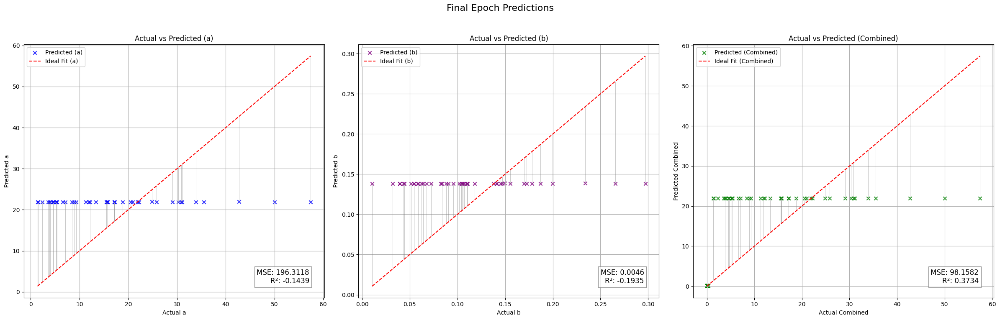

Validation Metrics:
  - MSE: 96.1174
  - R²: -0.1454
  - MAE: 5.8608
  - Explained Variance Score (EVS): 0.0362
Fold 2 Metrics:
  - Validation Loss (MSE): 96.1174
  - R²: -0.1454
  - MAE: 5.8608
  - EVS: 0.0362
Fold 3/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 12.61it/s, loss=0.402]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4238, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.14it/s, loss=0.344]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4239, Val Loss: 111.2922
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:01<00:00, 10.87it/s, loss=0.29]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4234, Val Loss: 111.2922
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:01<00:00, 10.95it/s, loss=0.502]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4244, Val Loss: 111.2922
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 11.18it/s, loss=0.278]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4229, Val Loss: 111.2922
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:01<00:00, 10.04it/s, loss=0.337]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4231, Val Loss: 111.2922
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 11.15it/s, loss=0.328]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4230, Val Loss: 111.2922
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 11.86it/s, loss=0.389]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4232, Val Loss: 111.2922
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.10it/s, loss=0.315]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4227, Val Loss: 111.2922
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 11.93it/s, loss=0.532]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4239, Val Loss: 111.2861
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 12.26it/s, loss=0.219]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4220, Val Loss: 111.2861
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 11/11 [00:00<00:00, 13.26it/s, loss=0.421]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.4230, Val Loss: 111.2861
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 11/11 [00:00<00:00, 12.60it/s, loss=0.285]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.4222, Val Loss: 111.2861
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 11/11 [00:01<00:00, 10.70it/s, loss=0.256]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.4219, Val Loss: 111.2861
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 11/11 [00:01<00:00, 10.07it/s, loss=0.683]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.4242, Val Loss: 111.2861
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 11/11 [00:00<00:00, 11.07it/s, loss=0.253]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.4217, Val Loss: 111.2861
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 11/11 [00:01<00:00, 10.64it/s, loss=0.468]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.4229, Val Loss: 111.2861
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 11/11 [00:00<00:00, 12.20it/s, loss=0.461]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.4228, Val Loss: 111.2861
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 11/11 [00:00<00:00, 11.91it/s, loss=0.475]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.4228, Val Loss: 111.2861
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 11/11 [00:00<00:00, 14.07it/s, loss=0.27]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.4216, Val Loss: 111.2861
Current Dropout Rate: 0.3480
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


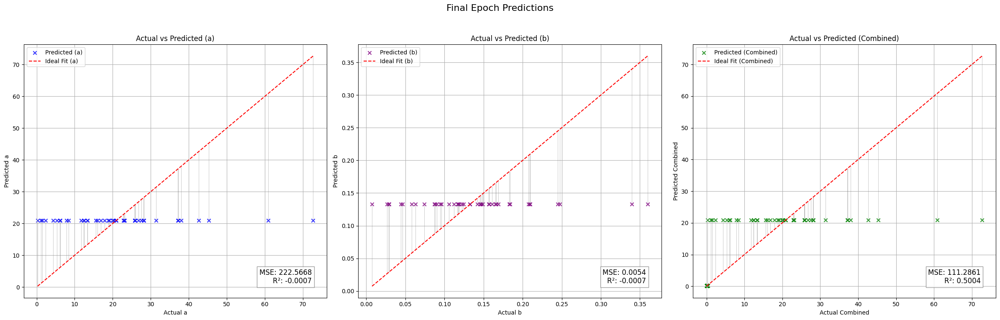

Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 11/11 [00:00<00:00, 12.53it/s, loss=0.606]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.4355, Val Loss: 94.0374
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:00<00:00, 12.08it/s, loss=0.373]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.4341, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:01<00:00, 10.27it/s, loss=0.386]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.4341, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 11.36it/s, loss=0.81]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.4365, Val Loss: 94.0374
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:01<00:00, 10.87it/s, loss=0.574]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.4351, Val Loss: 94.0374
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:01<00:00, 10.62it/s, loss=0.476]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.4345, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 12.08it/s, loss=0.585]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.4351, Val Loss: 94.0374
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 12.20it/s, loss=0.366]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.4338, Val Loss: 94.0374
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 13.23it/s, loss=0.302]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.4335, Val Loss: 94.0374
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:00<00:00, 11.71it/s, loss=0.311]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4335, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 13.78it/s, loss=0.319]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.4335, Val Loss: 94.0374
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


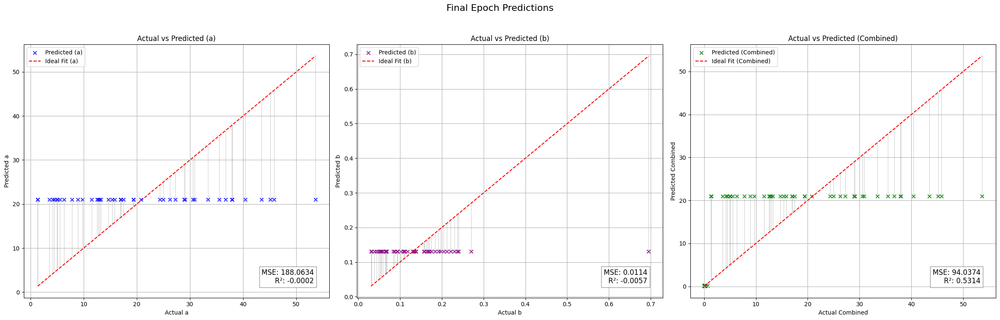

Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 11/11 [00:01<00:00, 10.24it/s, loss=0.489]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.4329, Val Loss: 182.6491
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 11/11 [00:01<00:00, 10.51it/s, loss=0.252]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.4329, Val Loss: 182.6491
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 11/11 [00:01<00:00, 10.61it/s, loss=0.516]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.4329, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 11/11 [00:00<00:00, 12.32it/s, loss=0.311]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 11/11 [00:00<00:00, 12.13it/s, loss=0.491]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 11/11 [00:00<00:00, 11.96it/s, loss=0.522]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 11/11 [00:00<00:00, 11.89it/s, loss=0.368]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 11/11 [00:00<00:00, 11.93it/s, loss=0.354]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 11/11 [00:00<00:00, 12.55it/s, loss=0.59]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 11/11 [00:01<00:00, 10.83it/s, loss=0.643]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.4328, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 11/11 [00:00<00:00, 11.69it/s, loss=0.471]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.4327, Val Loss: 182.6491
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


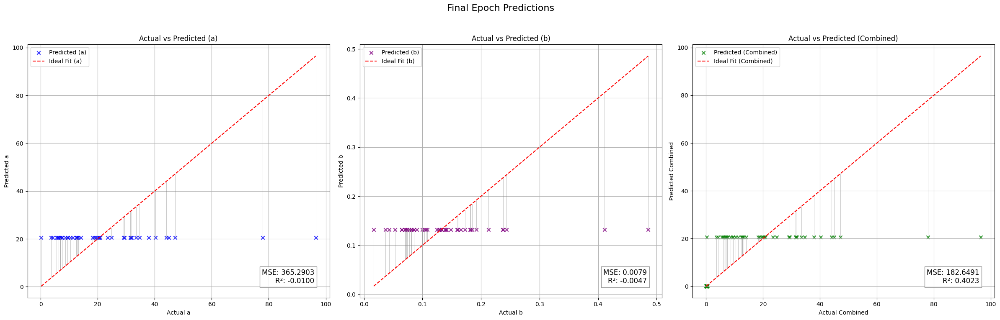

[I 2024-12-01 18:01:58,818] Trial 37 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 135.9354
  - R²: -0.0355
  - MAE: 6.0941
  - EVS: 0.0072
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.80it/s, loss=1.91]


Validation Metrics:
  - MSE: 195.0110
  - R²: -0.0061
  - MAE: 6.2770
  - Explained Variance Score (EVS): 0.0359
Epoch [1/50], Train Loss: 1.9122, Val Loss: 195.0110
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.90it/s, loss=1.63]


Validation Metrics:
  - MSE: 197.9464
  - R²: -0.0390
  - MAE: 6.1864
  - Explained Variance Score (EVS): 0.0773
Epoch [2/50], Train Loss: 1.7863, Val Loss: 197.9464
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  8.34it/s, loss=1.63]


Validation Metrics:
  - MSE: 202.3167
  - R²: -0.0814
  - MAE: 6.2970
  - Explained Variance Score (EVS): 0.1063
Epoch [3/50], Train Loss: 1.7234, Val Loss: 202.3167
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.57it/s, loss=1.67]


Validation Metrics:
  - MSE: 198.6553
  - R²: -0.0416
  - MAE: 6.2211
  - Explained Variance Score (EVS): 0.1575
Epoch [4/50], Train Loss: 1.6848, Val Loss: 198.6553
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.34it/s, loss=1.6]


Validation Metrics:
  - MSE: 189.3590
  - R²: 0.0233
  - MAE: 6.0721
  - Explained Variance Score (EVS): 0.2320
Epoch [5/50], Train Loss: 1.6477, Val Loss: 189.3590
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.67it/s, loss=1.64]


Validation Metrics:
  - MSE: 169.9540
  - R²: 0.1180
  - MAE: 5.6817
  - Explained Variance Score (EVS): 0.3188
Epoch [6/50], Train Loss: 1.6294, Val Loss: 169.9540
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=1.62]


Validation Metrics:
  - MSE: 135.2834
  - R²: 0.2959
  - MAE: 5.0401
  - Explained Variance Score (EVS): 0.4633
Epoch [7/50], Train Loss: 1.5897, Val Loss: 135.2834
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.12it/s, loss=1.51]


Validation Metrics:
  - MSE: 119.7277
  - R²: 0.3920
  - MAE: 4.7050
  - Explained Variance Score (EVS): 0.5079
Epoch [8/50], Train Loss: 1.5698, Val Loss: 119.7277
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.70it/s, loss=1.53]


Validation Metrics:
  - MSE: 100.0640
  - R²: 0.5284
  - MAE: 4.2593
  - Explained Variance Score (EVS): 0.6053
Epoch [9/50], Train Loss: 1.5307, Val Loss: 100.0640
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.55it/s, loss=1.43]


Validation Metrics:
  - MSE: 101.7441
  - R²: 0.5034
  - MAE: 3.8510
  - Explained Variance Score (EVS): 0.5862
Epoch [10/50], Train Loss: 1.4715, Val Loss: 101.7441
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:01<00:00,  5.98it/s, loss=1.54]


Validation Metrics:
  - MSE: 81.2796
  - R²: 0.6293
  - MAE: 3.3907
  - Explained Variance Score (EVS): 0.6635
Epoch [11/50], Train Loss: 1.4711, Val Loss: 81.2796
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.84it/s, loss=1.55]


Validation Metrics:
  - MSE: 77.2997
  - R²: 0.6939
  - MAE: 3.4898
  - Explained Variance Score (EVS): 0.7110
Epoch [12/50], Train Loss: 1.4343, Val Loss: 77.2997
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.77it/s, loss=1.3]


Validation Metrics:
  - MSE: 63.4646
  - R²: 0.7247
  - MAE: 3.2843
  - Explained Variance Score (EVS): 0.7419
Epoch [13/50], Train Loss: 1.3836, Val Loss: 63.4646
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=1.32]


Validation Metrics:
  - MSE: 53.4674
  - R²: 0.7004
  - MAE: 3.1964
  - Explained Variance Score (EVS): 0.7185
Epoch [14/50], Train Loss: 1.3337, Val Loss: 53.4674
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s, loss=1.35]


Validation Metrics:
  - MSE: 51.3234
  - R²: 0.7472
  - MAE: 3.1816
  - Explained Variance Score (EVS): 0.7495
Epoch [15/50], Train Loss: 1.3230, Val Loss: 51.3234
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.30it/s, loss=1.21]


Validation Metrics:
  - MSE: 48.0281
  - R²: 0.7787
  - MAE: 3.0649
  - Explained Variance Score (EVS): 0.7790
Epoch [16/50], Train Loss: 1.2874, Val Loss: 48.0281
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.72it/s, loss=1.16]


Validation Metrics:
  - MSE: 70.5720
  - R²: 0.6591
  - MAE: 3.1494
  - Explained Variance Score (EVS): 0.6813
Epoch [17/50], Train Loss: 1.2556, Val Loss: 70.5720
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=1.15]


Validation Metrics:
  - MSE: 67.7892
  - R²: 0.6841
  - MAE: 3.1409
  - Explained Variance Score (EVS): 0.6998
Epoch [18/50], Train Loss: 1.1981, Val Loss: 67.7892
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  7.58it/s, loss=1.19]


Validation Metrics:
  - MSE: 45.2157
  - R²: 0.7888
  - MAE: 2.9338
  - Explained Variance Score (EVS): 0.7922
Epoch [19/50], Train Loss: 1.1591, Val Loss: 45.2157
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  6.10it/s, loss=1.11]


Validation Metrics:
  - MSE: 45.1677
  - R²: 0.7814
  - MAE: 3.0230
  - Explained Variance Score (EVS): 0.7957
Epoch [20/50], Train Loss: 1.1191, Val Loss: 45.1677
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  7.35it/s, loss=1.13]


Validation Metrics:
  - MSE: 49.4539
  - R²: 0.7374
  - MAE: 3.2772
  - Explained Variance Score (EVS): 0.7522
Epoch [21/50], Train Loss: 1.0941, Val Loss: 49.4539
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  6.33it/s, loss=1.03]


Validation Metrics:
  - MSE: 61.4124
  - R²: 0.7282
  - MAE: 3.1340
  - Explained Variance Score (EVS): 0.7470
Epoch [22/50], Train Loss: 1.0668, Val Loss: 61.4124
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  6.03it/s, loss=1.01]


Validation Metrics:
  - MSE: 71.0397
  - R²: 0.6987
  - MAE: 3.1501
  - Explained Variance Score (EVS): 0.7236
Epoch [23/50], Train Loss: 1.0290, Val Loss: 71.0397
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=0.946]


Validation Metrics:
  - MSE: 54.7653
  - R²: 0.7482
  - MAE: 3.0158
  - Explained Variance Score (EVS): 0.7578
Epoch [24/50], Train Loss: 0.9987, Val Loss: 54.7653
Current Dropout Rate: 0.3160


Epoch 25/50: 100%|██████████| 6/6 [00:00<00:00,  7.51it/s, loss=0.885]


Validation Metrics:
  - MSE: 47.8988
  - R²: 0.7310
  - MAE: 2.9641
  - Explained Variance Score (EVS): 0.7583
Epoch [25/50], Train Loss: 0.9389, Val Loss: 47.8988
Current Dropout Rate: 0.3080


Epoch 26/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=0.859]


Validation Metrics:
  - MSE: 51.9679
  - R²: 0.7350
  - MAE: 3.0927
  - Explained Variance Score (EVS): 0.7494
Epoch [26/50], Train Loss: 0.9138, Val Loss: 51.9679
Current Dropout Rate: 0.3000


Epoch 27/50: 100%|██████████| 6/6 [00:00<00:00,  8.26it/s, loss=0.878]


Validation Metrics:
  - MSE: 84.7202
  - R²: 0.6232
  - MAE: 3.5296
  - Explained Variance Score (EVS): 0.6620
Epoch [27/50], Train Loss: 0.8866, Val Loss: 84.7202
Current Dropout Rate: 0.2920


Epoch 28/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=0.794]


Validation Metrics:
  - MSE: 59.3091
  - R²: 0.7143
  - MAE: 3.0373
  - Explained Variance Score (EVS): 0.7289
Epoch [28/50], Train Loss: 0.8526, Val Loss: 59.3091
Current Dropout Rate: 0.2840


Epoch 29/50: 100%|██████████| 6/6 [00:00<00:00,  7.25it/s, loss=0.885]


Validation Metrics:
  - MSE: 44.4883
  - R²: 0.7619
  - MAE: 3.0062
  - Explained Variance Score (EVS): 0.7752
Epoch [29/50], Train Loss: 0.8395, Val Loss: 44.4883
Current Dropout Rate: 0.2760


Epoch 30/50: 100%|██████████| 6/6 [00:00<00:00,  7.15it/s, loss=0.825]


Validation Metrics:
  - MSE: 73.5063
  - R²: 0.6432
  - MAE: 3.3257
  - Explained Variance Score (EVS): 0.6887
Epoch [30/50], Train Loss: 0.8089, Val Loss: 73.5063
Current Dropout Rate: 0.2680


Epoch 31/50: 100%|██████████| 6/6 [00:00<00:00,  6.74it/s, loss=0.846]


Validation Metrics:
  - MSE: 90.8975
  - R²: 0.5847
  - MAE: 3.5921
  - Explained Variance Score (EVS): 0.6237
Epoch [31/50], Train Loss: 0.7893, Val Loss: 90.8975
Current Dropout Rate: 0.2600


Epoch 32/50: 100%|██████████| 6/6 [00:00<00:00,  7.29it/s, loss=0.799]


Validation Metrics:
  - MSE: 49.4188
  - R²: 0.7780
  - MAE: 2.8269
  - Explained Variance Score (EVS): 0.7864
Epoch [32/50], Train Loss: 0.7554, Val Loss: 49.4188
Current Dropout Rate: 0.2520


Epoch 33/50: 100%|██████████| 6/6 [00:00<00:00,  7.30it/s, loss=0.664]


Validation Metrics:
  - MSE: 50.3801
  - R²: 0.7629
  - MAE: 3.0531
  - Explained Variance Score (EVS): 0.7962
Epoch [33/50], Train Loss: 0.7038, Val Loss: 50.3801
Current Dropout Rate: 0.2440


Epoch 34/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=0.771]


Validation Metrics:
  - MSE: 58.6828
  - R²: 0.7252
  - MAE: 3.2006
  - Explained Variance Score (EVS): 0.7440
Epoch [34/50], Train Loss: 0.7112, Val Loss: 58.6828
Current Dropout Rate: 0.2360


Epoch 35/50: 100%|██████████| 6/6 [00:00<00:00,  7.17it/s, loss=0.7]


Validation Metrics:
  - MSE: 55.0728
  - R²: 0.7410
  - MAE: 2.8932
  - Explained Variance Score (EVS): 0.7533
Epoch [35/50], Train Loss: 0.6793, Val Loss: 55.0728
Current Dropout Rate: 0.2280


Epoch 36/50: 100%|██████████| 6/6 [00:00<00:00,  7.46it/s, loss=0.623]


Validation Metrics:
  - MSE: 70.1645
  - R²: 0.6846
  - MAE: 2.9889
  - Explained Variance Score (EVS): 0.7173
Epoch [36/50], Train Loss: 0.6335, Val Loss: 70.1645
Current Dropout Rate: 0.2200


Epoch 37/50: 100%|██████████| 6/6 [00:00<00:00,  7.58it/s, loss=0.786]


Validation Metrics:
  - MSE: 64.0801
  - R²: 0.6630
  - MAE: 3.0584
  - Explained Variance Score (EVS): 0.7291
Epoch [37/50], Train Loss: 0.6416, Val Loss: 64.0801
Current Dropout Rate: 0.2120


Epoch 38/50: 100%|██████████| 6/6 [00:00<00:00,  7.23it/s, loss=0.549]


Validation Metrics:
  - MSE: 57.6948
  - R²: 0.7487
  - MAE: 3.1081
  - Explained Variance Score (EVS): 0.7630
Epoch [38/50], Train Loss: 0.5919, Val Loss: 57.6948
Current Dropout Rate: 0.2040


Epoch 39/50: 100%|██████████| 6/6 [00:00<00:00,  7.69it/s, loss=0.6]


Validation Metrics:
  - MSE: 49.5900
  - R²: 0.7786
  - MAE: 3.0157
  - Explained Variance Score (EVS): 0.7909
Epoch [39/50], Train Loss: 0.5814, Val Loss: 49.5900
Current Dropout Rate: 0.1960
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


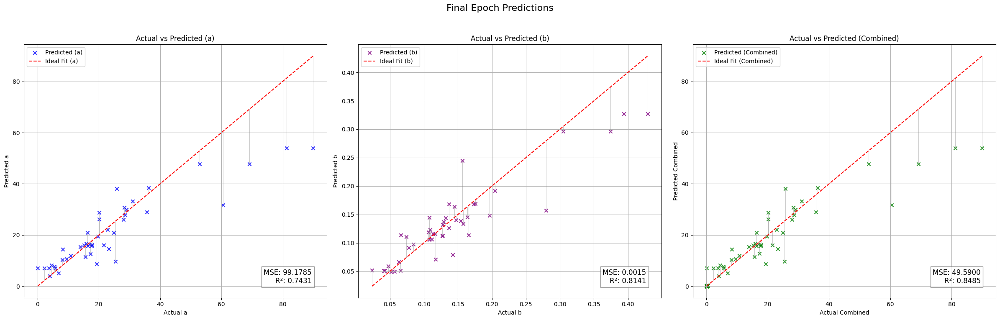

Validation Metrics:
  - MSE: 44.4883
  - R²: 0.7619
  - MAE: 3.0062
  - Explained Variance Score (EVS): 0.7752
Fold 1 Metrics:
  - Validation Loss (MSE): 44.4883
  - R²: 0.7619
  - MAE: 3.0062
  - EVS: 0.7752
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.49it/s, loss=0.814]


Validation Metrics:
  - MSE: 5.3407
  - R²: 0.9500
  - MAE: 1.0358
  - Explained Variance Score (EVS): 0.9558
Epoch [1/50], Train Loss: 0.8384, Val Loss: 5.3407
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.58it/s, loss=0.791]


Validation Metrics:
  - MSE: 5.2785
  - R²: 0.9391
  - MAE: 1.0645
  - Explained Variance Score (EVS): 0.9393
Epoch [2/50], Train Loss: 0.8099, Val Loss: 5.2785
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.03it/s, loss=0.812]


Validation Metrics:
  - MSE: 8.8054
  - R²: 0.8810
  - MAE: 1.2070
  - Explained Variance Score (EVS): 0.8821
Epoch [3/50], Train Loss: 0.7958, Val Loss: 8.8054
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.56it/s, loss=0.878]


Validation Metrics:
  - MSE: 8.2757
  - R²: 0.8900
  - MAE: 1.5489
  - Explained Variance Score (EVS): 0.9198
Epoch [4/50], Train Loss: 0.7949, Val Loss: 8.2757
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.96it/s, loss=0.909]


Validation Metrics:
  - MSE: 4.8721
  - R²: 0.9444
  - MAE: 1.1577
  - Explained Variance Score (EVS): 0.9461
Epoch [5/50], Train Loss: 0.7676, Val Loss: 4.8721
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.23it/s, loss=0.709]


Validation Metrics:
  - MSE: 5.0550
  - R²: 0.9428
  - MAE: 1.0396
  - Explained Variance Score (EVS): 0.9449
Epoch [6/50], Train Loss: 0.7257, Val Loss: 5.0550
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.84it/s, loss=0.659]


Validation Metrics:
  - MSE: 5.7137
  - R²: 0.9295
  - MAE: 1.1534
  - Explained Variance Score (EVS): 0.9323
Epoch [7/50], Train Loss: 0.7015, Val Loss: 5.7137
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.38it/s, loss=0.666]


Validation Metrics:
  - MSE: 6.9248
  - R²: 0.9242
  - MAE: 1.3533
  - Explained Variance Score (EVS): 0.9259
Epoch [8/50], Train Loss: 0.6799, Val Loss: 6.9248
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.679]


Validation Metrics:
  - MSE: 7.7945
  - R²: 0.9027
  - MAE: 1.4273
  - Explained Variance Score (EVS): 0.9302
Epoch [9/50], Train Loss: 0.6859, Val Loss: 7.7945
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s, loss=0.676]


Validation Metrics:
  - MSE: 6.0078
  - R²: 0.9210
  - MAE: 1.1184
  - Explained Variance Score (EVS): 0.9228
Epoch [10/50], Train Loss: 0.6705, Val Loss: 6.0078
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s, loss=0.575]


Validation Metrics:
  - MSE: 6.3965
  - R²: 0.9092
  - MAE: 1.1411
  - Explained Variance Score (EVS): 0.9126
Epoch [11/50], Train Loss: 0.6130, Val Loss: 6.3965
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=0.649]


Validation Metrics:
  - MSE: 7.4160
  - R²: 0.8980
  - MAE: 1.2403
  - Explained Variance Score (EVS): 0.9014
Epoch [12/50], Train Loss: 0.6437, Val Loss: 7.4160
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.93it/s, loss=0.543]


Validation Metrics:
  - MSE: 5.6257
  - R²: 0.9258
  - MAE: 1.1202
  - Explained Variance Score (EVS): 0.9264
Epoch [13/50], Train Loss: 0.5936, Val Loss: 5.6257
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.24it/s, loss=0.633]


Validation Metrics:
  - MSE: 6.2633
  - R²: 0.9178
  - MAE: 1.2610
  - Explained Variance Score (EVS): 0.9194
Epoch [14/50], Train Loss: 0.6095, Val Loss: 6.2633
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.29it/s, loss=0.556]


Validation Metrics:
  - MSE: 6.5558
  - R²: 0.9082
  - MAE: 1.2188
  - Explained Variance Score (EVS): 0.9093
Epoch [15/50], Train Loss: 0.5813, Val Loss: 6.5558
Current Dropout Rate: 0.3880
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


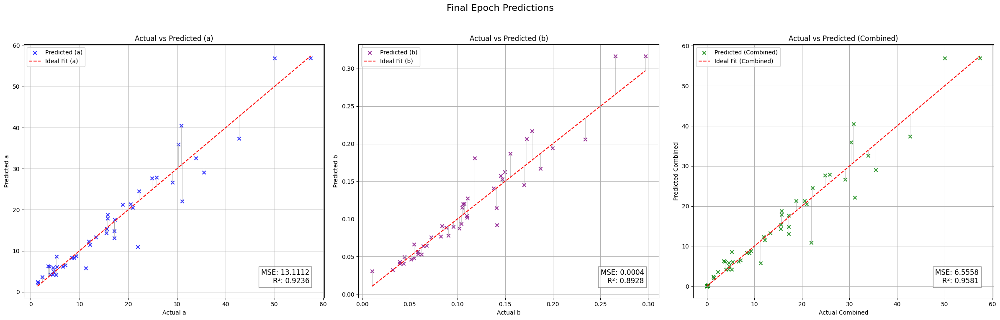

Validation Metrics:
  - MSE: 4.8721
  - R²: 0.9444
  - MAE: 1.1577
  - Explained Variance Score (EVS): 0.9461
Fold 2 Metrics:
  - Validation Loss (MSE): 4.8721
  - R²: 0.9444
  - MAE: 1.1577
  - EVS: 0.9461
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.89it/s, loss=0.684]


Validation Metrics:
  - MSE: 15.9445
  - R²: 0.8688
  - MAE: 1.4458
  - Explained Variance Score (EVS): 0.8688
Epoch [1/50], Train Loss: 0.7057, Val Loss: 15.9445
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.47it/s, loss=0.78]


Validation Metrics:
  - MSE: 17.0650
  - R²: 0.8546
  - MAE: 1.5382
  - Explained Variance Score (EVS): 0.8564
Epoch [2/50], Train Loss: 0.7232, Val Loss: 17.0650
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.51it/s, loss=0.756]


Validation Metrics:
  - MSE: 19.3872
  - R²: 0.8393
  - MAE: 1.4393
  - Explained Variance Score (EVS): 0.8407
Epoch [3/50], Train Loss: 0.7072, Val Loss: 19.3872
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.54it/s, loss=0.782]


Validation Metrics:
  - MSE: 19.0592
  - R²: 0.8443
  - MAE: 1.6294
  - Explained Variance Score (EVS): 0.8475
Epoch [4/50], Train Loss: 0.7185, Val Loss: 19.0592
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.01it/s, loss=0.646]


Validation Metrics:
  - MSE: 19.6969
  - R²: 0.8380
  - MAE: 1.7706
  - Explained Variance Score (EVS): 0.8425
Epoch [5/50], Train Loss: 0.6893, Val Loss: 19.6969
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=0.636]


Validation Metrics:
  - MSE: 19.6774
  - R²: 0.8357
  - MAE: 1.6067
  - Explained Variance Score (EVS): 0.8365
Epoch [6/50], Train Loss: 0.6639, Val Loss: 19.6774
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  8.09it/s, loss=0.725]


Validation Metrics:
  - MSE: 18.0671
  - R²: 0.8497
  - MAE: 1.5720
  - Explained Variance Score (EVS): 0.8517
Epoch [7/50], Train Loss: 0.6645, Val Loss: 18.0671
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.95it/s, loss=0.623]


Validation Metrics:
  - MSE: 18.2741
  - R²: 0.8472
  - MAE: 1.5417
  - Explained Variance Score (EVS): 0.8493
Epoch [8/50], Train Loss: 0.6560, Val Loss: 18.2741
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.91it/s, loss=0.594]


Validation Metrics:
  - MSE: 18.1017
  - R²: 0.8488
  - MAE: 1.6059
  - Explained Variance Score (EVS): 0.8527
Epoch [9/50], Train Loss: 0.6324, Val Loss: 18.1017
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.70it/s, loss=0.647]


Validation Metrics:
  - MSE: 16.4209
  - R²: 0.8603
  - MAE: 1.5404
  - Explained Variance Score (EVS): 0.8645
Epoch [10/50], Train Loss: 0.6289, Val Loss: 16.4209
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.83it/s, loss=0.584]


Validation Metrics:
  - MSE: 18.0235
  - R²: 0.8494
  - MAE: 1.5594
  - Explained Variance Score (EVS): 0.8520
Epoch [11/50], Train Loss: 0.6098, Val Loss: 18.0235
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


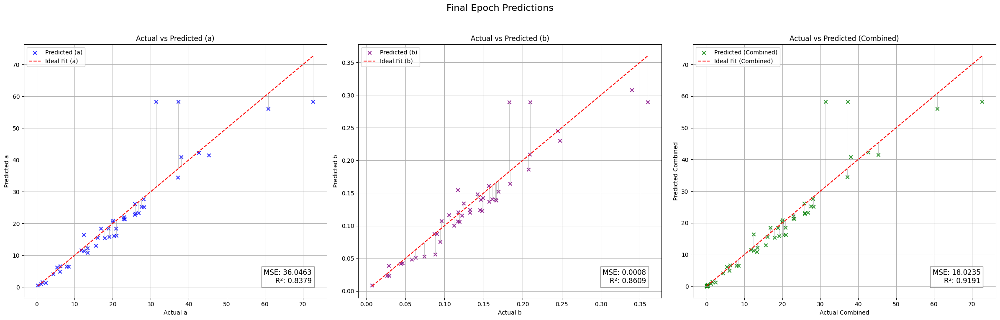

Validation Metrics:
  - MSE: 15.9445
  - R²: 0.8688
  - MAE: 1.4458
  - Explained Variance Score (EVS): 0.8688
Fold 3 Metrics:
  - Validation Loss (MSE): 15.9445
  - R²: 0.8688
  - MAE: 1.4458
  - EVS: 0.8688
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.07it/s, loss=0.662]


Validation Metrics:
  - MSE: 18.9138
  - R²: 0.7903
  - MAE: 1.6563
  - Explained Variance Score (EVS): 0.7935
Epoch [1/50], Train Loss: 0.7159, Val Loss: 18.9138
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.40it/s, loss=0.716]


Validation Metrics:
  - MSE: 21.4205
  - R²: 0.7736
  - MAE: 1.7298
  - Explained Variance Score (EVS): 0.7775
Epoch [2/50], Train Loss: 0.7125, Val Loss: 21.4205
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=0.639]


Validation Metrics:
  - MSE: 21.6432
  - R²: 0.7669
  - MAE: 1.7757
  - Explained Variance Score (EVS): 0.7685
Epoch [3/50], Train Loss: 0.7026, Val Loss: 21.6432
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.70it/s, loss=0.707]


Validation Metrics:
  - MSE: 23.3576
  - R²: 0.7526
  - MAE: 1.9047
  - Explained Variance Score (EVS): 0.7538
Epoch [4/50], Train Loss: 0.6823, Val Loss: 23.3576
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.37it/s, loss=0.695]


Validation Metrics:
  - MSE: 22.8685
  - R²: 0.7535
  - MAE: 2.0314
  - Explained Variance Score (EVS): 0.7558
Epoch [5/50], Train Loss: 0.6704, Val Loss: 22.8685
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.65it/s, loss=0.808]


Validation Metrics:
  - MSE: 18.3474
  - R²: 0.7833
  - MAE: 1.9204
  - Explained Variance Score (EVS): 0.7878
Epoch [6/50], Train Loss: 0.6959, Val Loss: 18.3474
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.78it/s, loss=0.746]


Validation Metrics:
  - MSE: 17.4991
  - R²: 0.7898
  - MAE: 1.8539
  - Explained Variance Score (EVS): 0.7928
Epoch [7/50], Train Loss: 0.6668, Val Loss: 17.4991
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.33it/s, loss=0.909]


Validation Metrics:
  - MSE: 17.3204
  - R²: 0.7887
  - MAE: 1.8699
  - Explained Variance Score (EVS): 0.7916
Epoch [8/50], Train Loss: 0.6920, Val Loss: 17.3204
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.40it/s, loss=0.625]


Validation Metrics:
  - MSE: 21.4459
  - R²: 0.7601
  - MAE: 1.9103
  - Explained Variance Score (EVS): 0.7605
Epoch [9/50], Train Loss: 0.6428, Val Loss: 21.4459
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.07it/s, loss=0.64]


Validation Metrics:
  - MSE: 22.7091
  - R²: 0.7453
  - MAE: 1.9300
  - Explained Variance Score (EVS): 0.7460
Epoch [10/50], Train Loss: 0.6580, Val Loss: 22.7091
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.33it/s, loss=0.678]


Validation Metrics:
  - MSE: 22.8019
  - R²: 0.7427
  - MAE: 1.9200
  - Explained Variance Score (EVS): 0.7432
Epoch [11/50], Train Loss: 0.6374, Val Loss: 22.8019
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  8.21it/s, loss=0.707]


Validation Metrics:
  - MSE: 23.6717
  - R²: 0.7355
  - MAE: 1.9596
  - Explained Variance Score (EVS): 0.7361
Epoch [12/50], Train Loss: 0.6315, Val Loss: 23.6717
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=0.629]


Validation Metrics:
  - MSE: 25.5341
  - R²: 0.7225
  - MAE: 2.0443
  - Explained Variance Score (EVS): 0.7231
Epoch [13/50], Train Loss: 0.6290, Val Loss: 25.5341
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=0.621]


Validation Metrics:
  - MSE: 25.1847
  - R²: 0.7234
  - MAE: 2.0484
  - Explained Variance Score (EVS): 0.7240
Epoch [14/50], Train Loss: 0.6127, Val Loss: 25.1847
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.23it/s, loss=0.63]


Validation Metrics:
  - MSE: 25.8085
  - R²: 0.7179
  - MAE: 2.0955
  - Explained Variance Score (EVS): 0.7183
Epoch [15/50], Train Loss: 0.6075, Val Loss: 25.8085
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.51it/s, loss=0.638]


Validation Metrics:
  - MSE: 28.3320
  - R²: 0.7010
  - MAE: 2.1186
  - Explained Variance Score (EVS): 0.7015
Epoch [16/50], Train Loss: 0.6324, Val Loss: 28.3320
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.45it/s, loss=0.599]


Validation Metrics:
  - MSE: 30.3653
  - R²: 0.6911
  - MAE: 2.0378
  - Explained Variance Score (EVS): 0.6933
Epoch [17/50], Train Loss: 0.6112, Val Loss: 30.3653
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.07it/s, loss=0.614]


Validation Metrics:
  - MSE: 31.6699
  - R²: 0.6830
  - MAE: 2.1226
  - Explained Variance Score (EVS): 0.6843
Epoch [18/50], Train Loss: 0.6298, Val Loss: 31.6699
Current Dropout Rate: 0.3640
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


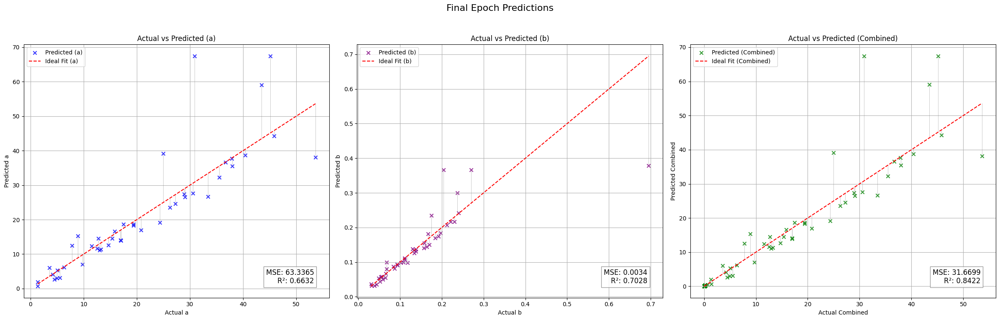

Validation Metrics:
  - MSE: 17.3204
  - R²: 0.7887
  - MAE: 1.8699
  - Explained Variance Score (EVS): 0.7916
Fold 4 Metrics:
  - Validation Loss (MSE): 17.3204
  - R²: 0.7887
  - MAE: 1.8699
  - EVS: 0.7916
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.24it/s, loss=0.687]


Validation Metrics:
  - MSE: 34.2644
  - R²: 0.8402
  - MAE: 1.8466
  - Explained Variance Score (EVS): 0.8518
Epoch [1/50], Train Loss: 0.6675, Val Loss: 34.2644
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.76it/s, loss=0.645]


Validation Metrics:
  - MSE: 32.0985
  - R²: 0.8480
  - MAE: 1.6930
  - Explained Variance Score (EVS): 0.8562
Epoch [2/50], Train Loss: 0.6805, Val Loss: 32.0985
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.48it/s, loss=0.67]


Validation Metrics:
  - MSE: 33.1479
  - R²: 0.8388
  - MAE: 1.6992
  - Explained Variance Score (EVS): 0.8501
Epoch [3/50], Train Loss: 0.6652, Val Loss: 33.1479
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.34it/s, loss=0.623]


Validation Metrics:
  - MSE: 32.5268
  - R²: 0.8415
  - MAE: 1.6575
  - Explained Variance Score (EVS): 0.8509
Epoch [4/50], Train Loss: 0.6634, Val Loss: 32.5268
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  8.28it/s, loss=0.675]


Validation Metrics:
  - MSE: 29.6191
  - R²: 0.8557
  - MAE: 1.5311
  - Explained Variance Score (EVS): 0.8607
Epoch [5/50], Train Loss: 0.6511, Val Loss: 29.6191
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.56it/s, loss=0.649]


Validation Metrics:
  - MSE: 30.2852
  - R²: 0.8514
  - MAE: 1.5438
  - Explained Variance Score (EVS): 0.8579
Epoch [6/50], Train Loss: 0.6466, Val Loss: 30.2852
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.52it/s, loss=0.602]


Validation Metrics:
  - MSE: 30.2936
  - R²: 0.8506
  - MAE: 1.5187
  - Explained Variance Score (EVS): 0.8571
Epoch [7/50], Train Loss: 0.6426, Val Loss: 30.2936
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.45it/s, loss=0.635]


Validation Metrics:
  - MSE: 30.8904
  - R²: 0.8465
  - MAE: 1.5229
  - Explained Variance Score (EVS): 0.8534
Epoch [8/50], Train Loss: 0.6421, Val Loss: 30.8904
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=0.734]


Validation Metrics:
  - MSE: 32.2138
  - R²: 0.8384
  - MAE: 1.6007
  - Explained Variance Score (EVS): 0.8506
Epoch [9/50], Train Loss: 0.6758, Val Loss: 32.2138
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.38it/s, loss=0.658]


Validation Metrics:
  - MSE: 30.8170
  - R²: 0.8471
  - MAE: 1.5094
  - Explained Variance Score (EVS): 0.8542
Epoch [10/50], Train Loss: 0.6554, Val Loss: 30.8170
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=0.649]


Validation Metrics:
  - MSE: 30.5381
  - R²: 0.8476
  - MAE: 1.4742
  - Explained Variance Score (EVS): 0.8542
Epoch [11/50], Train Loss: 0.6540, Val Loss: 30.5381
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.87it/s, loss=0.643]


Validation Metrics:
  - MSE: 32.1217
  - R²: 0.8382
  - MAE: 1.5467
  - Explained Variance Score (EVS): 0.8481
Epoch [12/50], Train Loss: 0.6366, Val Loss: 32.1217
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=0.618]


Validation Metrics:
  - MSE: 32.6663
  - R²: 0.8356
  - MAE: 1.6008
  - Explained Variance Score (EVS): 0.8465
Epoch [13/50], Train Loss: 0.6314, Val Loss: 32.6663
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=0.77]


Validation Metrics:
  - MSE: 33.5031
  - R²: 0.8324
  - MAE: 1.6559
  - Explained Variance Score (EVS): 0.8460
Epoch [14/50], Train Loss: 0.6497, Val Loss: 33.5031
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  8.78it/s, loss=0.752]


Validation Metrics:
  - MSE: 30.0501
  - R²: 0.8508
  - MAE: 1.4868
  - Explained Variance Score (EVS): 0.8575
Epoch [15/50], Train Loss: 0.6660, Val Loss: 30.0501
Current Dropout Rate: 0.3880
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


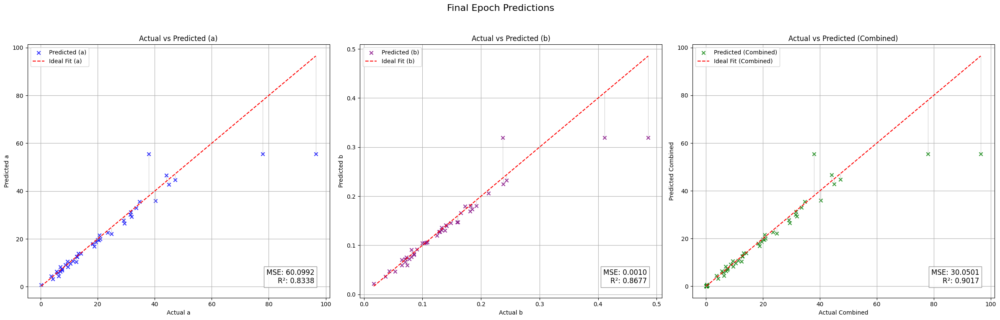

[I 2024-12-01 18:04:50,712] Trial 38 finished with value: 22.448898315429688 and parameters: {'num_layers': 2, 'hidden_size_0': 423, 'activation_0': 'LeakyReLU', 'dropout_0': 0.1274996282868418, 'hidden_size_1': 465, 'activation_1': 'LeakyReLU', 'dropout_1': 0.2484583363243016, 'batch_size': 32, 'learning_rate': 2.891456939922689e-05, 'optimizer': 'AdamW'}. Best is trial 29 with value: 20.607755661010742.
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 29.6191
  - R²: 0.8557
  - MAE: 1.5311
  - Explained Variance Score (EVS): 0.8607
Fold 5 Metrics:
  - Validation Loss (MSE): 29.6191
  - R²: 0.8557
  - MAE: 1.5311
  - EVS: 0.8607
Avg Validation Metrics:
  - MSE: 22.4489
  - R²: 0.8439
  - MAE: 1.8021
  - EVS: 0.8485
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=0.257]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 2.3981, Val Loss: 197.4690
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.17it/s, loss=0.391]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3938, Val Loss: 197.3764
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.47it/s, loss=0.511]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3984, Val Loss: 197.4690
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.20it/s, loss=0.332]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3782, Val Loss: 197.4690
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.43it/s, loss=0.466]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3869, Val Loss: 197.4690
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.50it/s, loss=0.526]


Validation Metrics:
  - MSE: 197.4225
  - R²: -0.0199
  - MAE: 6.4523
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3896, Val Loss: 197.4225
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.87it/s, loss=0.342]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0202
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3713, Val Loss: 197.4690
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.87it/s, loss=0.388]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0198
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3737, Val Loss: 197.3764
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.84it/s, loss=0.385]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3722, Val Loss: 197.4690
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.18it/s, loss=0.191]


Validation Metrics:
  - MSE: 197.5156
  - R²: -0.0204
  - MAE: 6.4495
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3539, Val Loss: 197.5156
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=0.21]


Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3548, Val Loss: 197.3764
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=0.506]


Validation Metrics:
  - MSE: 197.4690
  - R²: -0.0201
  - MAE: 6.4509
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3805, Val Loss: 197.4690
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


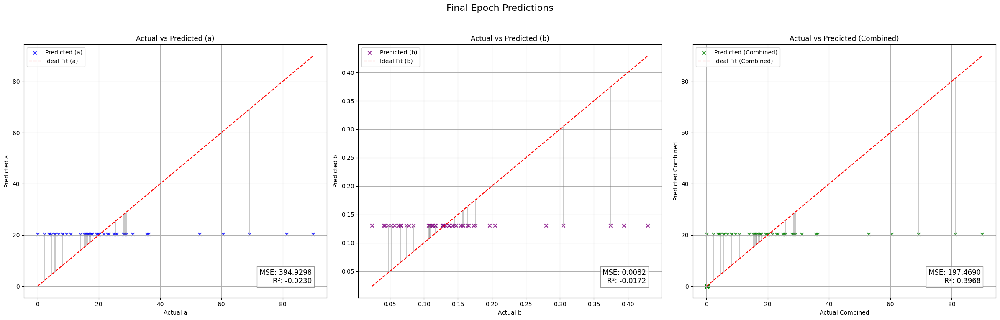

Validation Metrics:
  - MSE: 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - Explained Variance Score (EVS): 0.0000
Fold 1 Metrics:
  - Validation Loss (MSE): 197.3764
  - R²: -0.0196
  - MAE: 6.4537
  - EVS: 0.0000
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.26it/s, loss=0.146]


Validation Metrics:
  - MSE: 98.5891
  - R²: -0.1740
  - MAE: 5.9603
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3583, Val Loss: 98.5891
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.61it/s, loss=0.304]


Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3681, Val Loss: 98.1971
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.97it/s, loss=0.477]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3801, Val Loss: 98.4316
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.77it/s, loss=0.281]


Validation Metrics:
  - MSE: 98.5560
  - R²: -0.1730
  - MAE: 5.9582
  - Explained Variance Score (EVS): -0.0004
Epoch [4/50], Train Loss: 0.3605, Val Loss: 98.5560
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.15it/s, loss=0.308]


Validation Metrics:
  - MSE: 98.5102
  - R²: -0.1736
  - MAE: 5.9568
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3615, Val Loss: 98.5102
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.24it/s, loss=0.591]


Validation Metrics:
  - MSE: 98.5728
  - R²: -0.1735
  - MAE: 5.9580
  - Explained Variance Score (EVS): -0.0014
Epoch [6/50], Train Loss: 0.3867, Val Loss: 98.5728
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s, loss=0.63]


Validation Metrics:
  - MSE: 98.6899
  - R²: -0.1749
  - MAE: 5.9614
  - Explained Variance Score (EVS): -0.0036
Epoch [7/50], Train Loss: 0.3936, Val Loss: 98.6899
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=0.364]


Validation Metrics:
  - MSE: 98.9116
  - R²: -0.1771
  - MAE: 5.9685
  - Explained Variance Score (EVS): -0.0063
Epoch [8/50], Train Loss: 0.3739, Val Loss: 98.9116
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.61it/s, loss=0.376]


Validation Metrics:
  - MSE: 99.4779
  - R²: -0.1823
  - MAE: 5.9895
  - Explained Variance Score (EVS): -0.0108
Epoch [9/50], Train Loss: 0.3774, Val Loss: 99.4779
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s, loss=0.537]


Validation Metrics:
  - MSE: 98.4316
  - R²: -0.1722
  - MAE: 5.9532
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3787, Val Loss: 98.4316
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.67it/s, loss=0.364]


Validation Metrics:
  - MSE: 98.3532
  - R²: -0.1709
  - MAE: 5.9496
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3594, Val Loss: 98.3532
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=0.318]


Validation Metrics:
  - MSE: 98.2750
  - R²: -0.1705
  - MAE: 5.9464
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3551, Val Loss: 98.2750
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


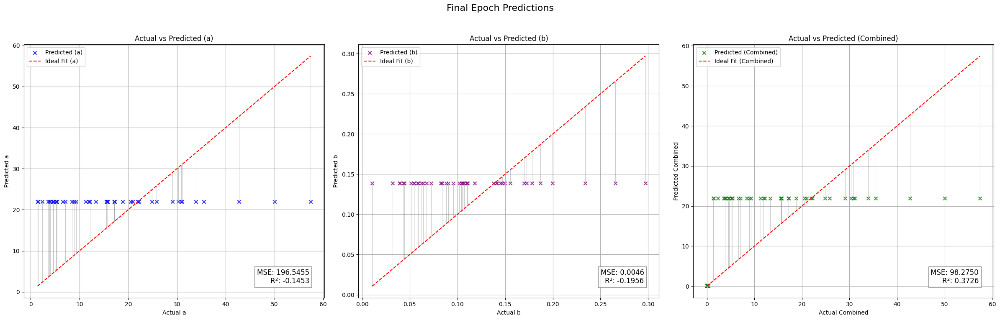

Validation Metrics:
  - MSE: 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - Explained Variance Score (EVS): -0.0000
Fold 2 Metrics:
  - Validation Loss (MSE): 98.1971
  - R²: -0.1691
  - MAE: 5.9432
  - EVS: -0.0000
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.75it/s, loss=0.365]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3681, Val Loss: 111.2922
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.71it/s, loss=0.157]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3480, Val Loss: 111.2922
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.27it/s, loss=0.444]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3720, Val Loss: 111.2922
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=0.678]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3915, Val Loss: 111.2922
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=0.387]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3647, Val Loss: 111.2922
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.98it/s, loss=0.258]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3523, Val Loss: 111.2802
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.63it/s, loss=0.161]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3429, Val Loss: 111.2922
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s, loss=0.194]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3450, Val Loss: 111.2922
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=0.2]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3450, Val Loss: 111.2985
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  8.07it/s, loss=0.87]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.4037, Val Loss: 111.2802
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.58it/s, loss=0.643]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3831, Val Loss: 111.2922
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.09it/s, loss=0.234]


Validation Metrics:
  - MSE: 111.2985
  - R²: -0.0008
  - MAE: 5.4371
  - Explained Variance Score (EVS): -0.0000
Epoch [12/50], Train Loss: 0.3466, Val Loss: 111.2985
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.12it/s, loss=0.32]


Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Epoch [13/50], Train Loss: 0.3539, Val Loss: 111.2747
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.78it/s, loss=0.209]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [14/50], Train Loss: 0.3439, Val Loss: 111.2922
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  6.93it/s, loss=0.357]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [15/50], Train Loss: 0.3567, Val Loss: 111.2861
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.18it/s, loss=0.601]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [16/50], Train Loss: 0.3783, Val Loss: 111.2922
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  8.27it/s, loss=0.69]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [17/50], Train Loss: 0.3862, Val Loss: 111.2802
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.43it/s, loss=0.233]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [18/50], Train Loss: 0.3462, Val Loss: 111.2861
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  7.79it/s, loss=0.443]


Validation Metrics:
  - MSE: 111.2861
  - R²: -0.0007
  - MAE: 5.4392
  - Explained Variance Score (EVS): -0.0000
Epoch [19/50], Train Loss: 0.3635, Val Loss: 111.2861
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=0.332]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [20/50], Train Loss: 0.3532, Val Loss: 111.2922
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  7.60it/s, loss=0.186]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [21/50], Train Loss: 0.3401, Val Loss: 111.2802
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  8.25it/s, loss=0.352]


Validation Metrics:
  - MSE: 111.2802
  - R²: -0.0006
  - MAE: 5.4403
  - Explained Variance Score (EVS): -0.0000
Epoch [22/50], Train Loss: 0.3548, Val Loss: 111.2802
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  7.14it/s, loss=0.438]


Validation Metrics:
  - MSE: 111.2922
  - R²: -0.0007
  - MAE: 5.4382
  - Explained Variance Score (EVS): -0.0000
Epoch [23/50], Train Loss: 0.3624, Val Loss: 111.2922
Current Dropout Rate: 0.3240
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


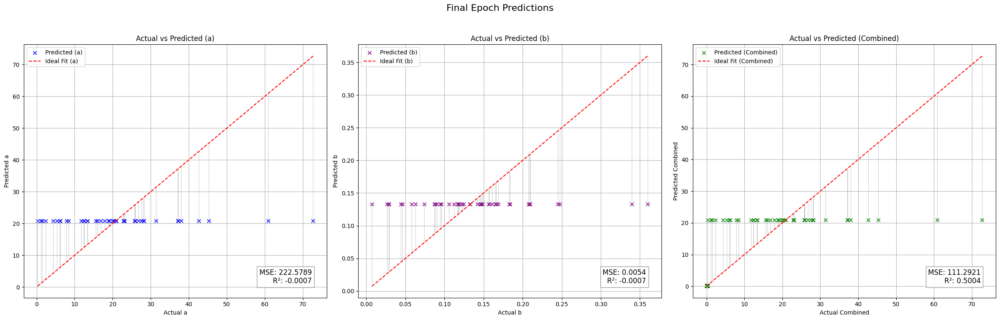

Validation Metrics:
  - MSE: 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - Explained Variance Score (EVS): -0.0000
Fold 3 Metrics:
  - Validation Loss (MSE): 111.2747
  - R²: -0.0006
  - MAE: 5.4415
  - EVS: -0.0000
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.77it/s, loss=0.241]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [1/50], Train Loss: 0.3567, Val Loss: 94.0346
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.15it/s, loss=0.26]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [2/50], Train Loss: 0.3580, Val Loss: 94.0374
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s, loss=0.292]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [3/50], Train Loss: 0.3608, Val Loss: 94.0374
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.55it/s, loss=0.342]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0029
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [4/50], Train Loss: 0.3650, Val Loss: 94.0404
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.53it/s, loss=0.331]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [5/50], Train Loss: 0.3640, Val Loss: 94.0346
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.55it/s, loss=0.37]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [6/50], Train Loss: 0.3672, Val Loss: 94.0374
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=0.336]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [7/50], Train Loss: 0.3642, Val Loss: 94.0346
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.27it/s, loss=0.331]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0030
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [8/50], Train Loss: 0.3636, Val Loss: 94.0346
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.62it/s, loss=0.421]


Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Epoch [9/50], Train Loss: 0.3714, Val Loss: 94.0346
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=0.135]


Validation Metrics:
  - MSE: 94.0374
  - R²: -0.0030
  - MAE: 5.9036
  - Explained Variance Score (EVS): -0.0000
Epoch [10/50], Train Loss: 0.3459, Val Loss: 94.0374
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.28it/s, loss=0.33]


Validation Metrics:
  - MSE: 94.0404
  - R²: -0.0030
  - MAE: 5.9051
  - Explained Variance Score (EVS): -0.0000
Epoch [11/50], Train Loss: 0.3631, Val Loss: 94.0404
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


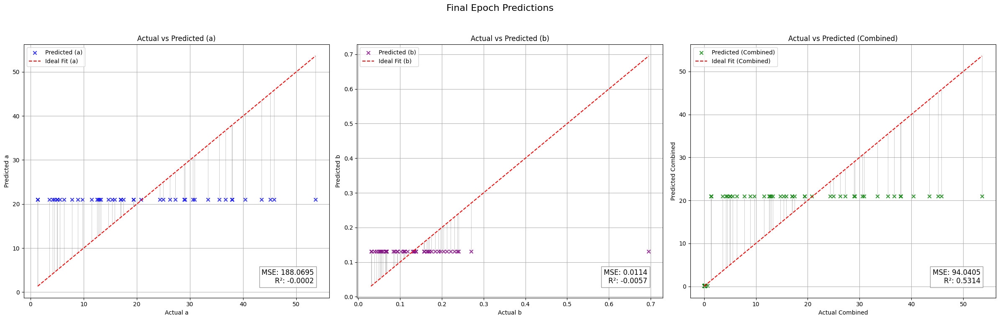

Validation Metrics:
  - MSE: 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - Explained Variance Score (EVS): -0.0000
Fold 4 Metrics:
  - Validation Loss (MSE): 94.0346
  - R²: -0.0029
  - MAE: 5.9022
  - EVS: -0.0000
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.66it/s, loss=0.159]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [1/50], Train Loss: 0.3488, Val Loss: 182.6789
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.372]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [2/50], Train Loss: 0.3664, Val Loss: 182.6789
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=0.236]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [3/50], Train Loss: 0.3549, Val Loss: 182.6491
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  8.00it/s, loss=0.433]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [4/50], Train Loss: 0.3712, Val Loss: 182.6789
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=0.414]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [5/50], Train Loss: 0.3695, Val Loss: 182.6789
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.47it/s, loss=0.219]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [6/50], Train Loss: 0.3532, Val Loss: 182.6789
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.166]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [7/50], Train Loss: 0.3487, Val Loss: 182.6789
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.41it/s, loss=0.484]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [8/50], Train Loss: 0.3751, Val Loss: 182.6789
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.18it/s, loss=0.394]


Validation Metrics:
  - MSE: 182.6196
  - R²: -0.0072
  - MAE: 6.7523
  - Explained Variance Score (EVS): 0.0000
Epoch [9/50], Train Loss: 0.3676, Val Loss: 182.6196
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=0.264]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [10/50], Train Loss: 0.3567, Val Loss: 182.6491
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.51it/s, loss=0.526]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0072
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [11/50], Train Loss: 0.3784, Val Loss: 182.6491
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.35it/s, loss=0.308]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [12/50], Train Loss: 0.3602, Val Loss: 182.6491
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.25it/s, loss=0.75]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [13/50], Train Loss: 0.3970, Val Loss: 182.6491
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  7.37it/s, loss=0.35]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [14/50], Train Loss: 0.3636, Val Loss: 182.6491
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.61it/s, loss=0.32]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [15/50], Train Loss: 0.3610, Val Loss: 182.6491
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  8.56it/s, loss=0.265]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [16/50], Train Loss: 0.3565, Val Loss: 182.6491
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.21]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [17/50], Train Loss: 0.3518, Val Loss: 182.6789
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.20it/s, loss=0.281]


Validation Metrics:
  - MSE: 182.6789
  - R²: -0.0074
  - MAE: 6.7492
  - Explained Variance Score (EVS): 0.0000
Epoch [18/50], Train Loss: 0.3578, Val Loss: 182.6789
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  6.72it/s, loss=0.306]


Validation Metrics:
  - MSE: 182.6491
  - R²: -0.0073
  - MAE: 6.7506
  - Explained Variance Score (EVS): 0.0000
Epoch [19/50], Train Loss: 0.3598, Val Loss: 182.6491
Current Dropout Rate: 0.3560
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


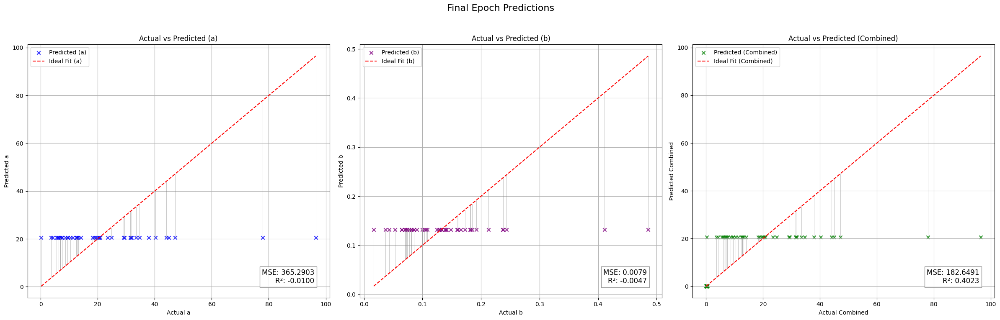

[I 2024-12-01 18:07:08,128] Trial 39 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 182.6196
  - R²: -0.0072
  - MAE: 6.7523
  - Explained Variance Score (EVS): 0.0000
Fold 5 Metrics:
  - Validation Loss (MSE): 182.6196
  - R²: -0.0072
  - MAE: 6.7523
  - EVS: 0.0000
Avg Validation Metrics:
  - MSE: 136.7005
  - R²: -0.0399
  - MAE: 6.0986
  - EVS: -0.0000
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.17it/s, loss=2.44]


Validation Metrics:
  - MSE: 197.6848
  - R²: -0.0170
  - MAE: 6.4455
  - Explained Variance Score (EVS): -0.0002
Epoch [1/50], Train Loss: 2.4664, Val Loss: 197.6848
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.66it/s, loss=2.45]


Validation Metrics:
  - MSE: 197.0878
  - R²: -0.0168
  - MAE: 6.4769
  - Explained Variance Score (EVS): -0.0011
Epoch [2/50], Train Loss: 2.4578, Val Loss: 197.0878
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.06it/s, loss=2.29]


Validation Metrics:
  - MSE: 197.3481
  - R²: -0.0188
  - MAE: 6.4752
  - Explained Variance Score (EVS): -0.0033
Epoch [3/50], Train Loss: 2.4074, Val Loss: 197.3481
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.25it/s, loss=2.18]


Validation Metrics:
  - MSE: 197.1594
  - R²: -0.0183
  - MAE: 6.4872
  - Explained Variance Score (EVS): -0.0042
Epoch [4/50], Train Loss: 2.3724, Val Loss: 197.1594
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=2.39]


Validation Metrics:
  - MSE: 198.4201
  - R²: -0.0216
  - MAE: 6.5023
  - Explained Variance Score (EVS): -0.0076
Epoch [5/50], Train Loss: 2.4178, Val Loss: 198.4201
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.51it/s, loss=2.22]


Validation Metrics:
  - MSE: 198.4923
  - R²: -0.0248
  - MAE: 6.5367
  - Explained Variance Score (EVS): -0.0098
Epoch [6/50], Train Loss: 2.3889, Val Loss: 198.4923
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.37it/s, loss=2.25]


Validation Metrics:
  - MSE: 200.0085
  - R²: -0.0266
  - MAE: 6.5381
  - Explained Variance Score (EVS): -0.0122
Epoch [7/50], Train Loss: 2.3617, Val Loss: 200.0085
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=2.33]


Validation Metrics:
  - MSE: 201.9453
  - R²: -0.0302
  - MAE: 6.5654
  - Explained Variance Score (EVS): -0.0144
Epoch [8/50], Train Loss: 2.3765, Val Loss: 201.9453
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.38it/s, loss=2.4]


Validation Metrics:
  - MSE: 201.8607
  - R²: -0.0287
  - MAE: 6.5962
  - Explained Variance Score (EVS): -0.0138
Epoch [9/50], Train Loss: 2.3370, Val Loss: 201.8607
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=2.34]


Validation Metrics:
  - MSE: 203.8397
  - R²: -0.0298
  - MAE: 6.7023
  - Explained Variance Score (EVS): -0.0189
Epoch [10/50], Train Loss: 2.3355, Val Loss: 203.8397
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.60it/s, loss=2.58]


Validation Metrics:
  - MSE: 205.2523
  - R²: -0.0400
  - MAE: 6.7534
  - Explained Variance Score (EVS): -0.0286
Epoch [11/50], Train Loss: 2.3151, Val Loss: 205.2523
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.45it/s, loss=2.32]


Validation Metrics:
  - MSE: 205.8228
  - R²: -0.0465
  - MAE: 6.7846
  - Explained Variance Score (EVS): -0.0338
Epoch [12/50], Train Loss: 2.2824, Val Loss: 205.8228
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


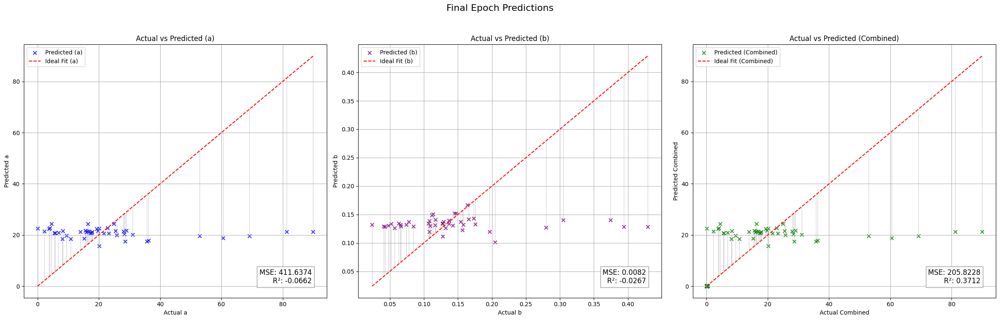

Validation Metrics:
  - MSE: 197.0878
  - R²: -0.0168
  - MAE: 6.4769
  - Explained Variance Score (EVS): -0.0011
Fold 1 Metrics:
  - Validation Loss (MSE): 197.0878
  - R²: -0.0168
  - MAE: 6.4769
  - EVS: -0.0011
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.34it/s, loss=2.23]


Validation Metrics:
  - MSE: 100.6234
  - R²: -0.2012
  - MAE: 6.0419
  - Explained Variance Score (EVS): -0.0030
Epoch [1/50], Train Loss: 2.3969, Val Loss: 100.6234
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  8.18it/s, loss=2.5]


Validation Metrics:
  - MSE: 100.7008
  - R²: -0.1952
  - MAE: 6.0419
  - Explained Variance Score (EVS): -0.0071
Epoch [2/50], Train Loss: 2.4124, Val Loss: 100.7008
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.26it/s, loss=2.56]


Validation Metrics:
  - MSE: 102.4686
  - R²: -0.2013
  - MAE: 6.1064
  - Explained Variance Score (EVS): -0.0135
Epoch [3/50], Train Loss: 2.4307, Val Loss: 102.4686
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.22it/s, loss=2.45]


Validation Metrics:
  - MSE: 104.1044
  - R²: -0.2192
  - MAE: 6.1730
  - Explained Variance Score (EVS): -0.0168
Epoch [4/50], Train Loss: 2.3985, Val Loss: 104.1044
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.52it/s, loss=2.18]


Validation Metrics:
  - MSE: 105.0424
  - R²: -0.2290
  - MAE: 6.2066
  - Explained Variance Score (EVS): -0.0273
Epoch [5/50], Train Loss: 2.3508, Val Loss: 105.0424
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.96it/s, loss=2.32]


Validation Metrics:
  - MSE: 109.0941
  - R²: -0.2671
  - MAE: 6.3567
  - Explained Variance Score (EVS): -0.0366
Epoch [6/50], Train Loss: 2.3629, Val Loss: 109.0941
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.50it/s, loss=2.14]


Validation Metrics:
  - MSE: 106.9512
  - R²: -0.2351
  - MAE: 6.2787
  - Explained Variance Score (EVS): -0.0368
Epoch [7/50], Train Loss: 2.3064, Val Loss: 106.9512
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.47it/s, loss=2.18]


Validation Metrics:
  - MSE: 107.9206
  - R²: -0.2442
  - MAE: 6.3193
  - Explained Variance Score (EVS): -0.0489
Epoch [8/50], Train Loss: 2.3056, Val Loss: 107.9206
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=2.13]


Validation Metrics:
  - MSE: 107.7900
  - R²: -0.2483
  - MAE: 6.3437
  - Explained Variance Score (EVS): -0.0440
Epoch [9/50], Train Loss: 2.3221, Val Loss: 107.7900
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.52it/s, loss=2.26]


Validation Metrics:
  - MSE: 109.0686
  - R²: -0.2449
  - MAE: 6.3729
  - Explained Variance Score (EVS): -0.0539
Epoch [10/50], Train Loss: 2.3044, Val Loss: 109.0686
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.28it/s, loss=2.41]


Validation Metrics:
  - MSE: 110.0542
  - R²: -0.2604
  - MAE: 6.4147
  - Explained Variance Score (EVS): -0.0618
Epoch [11/50], Train Loss: 2.3147, Val Loss: 110.0542
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


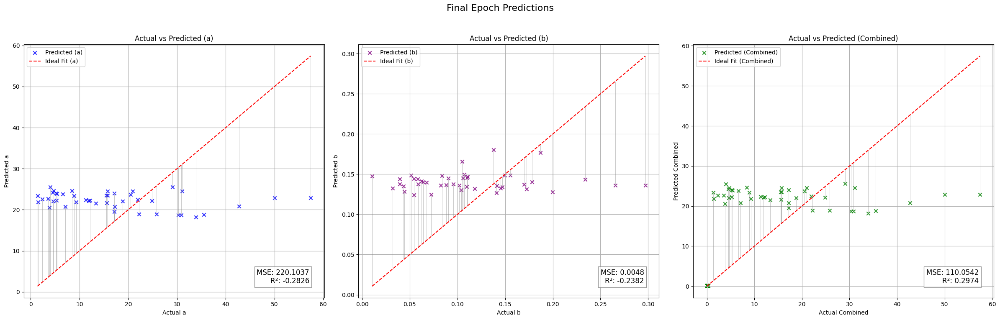

Validation Metrics:
  - MSE: 100.6234
  - R²: -0.2012
  - MAE: 6.0419
  - Explained Variance Score (EVS): -0.0030
Fold 2 Metrics:
  - Validation Loss (MSE): 100.6234
  - R²: -0.2012
  - MAE: 6.0419
  - EVS: -0.0030
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.82it/s, loss=2.49]


Validation Metrics:
  - MSE: 112.8409
  - R²: -0.0063
  - MAE: 5.5032
  - Explained Variance Score (EVS): -0.0062
Epoch [1/50], Train Loss: 2.4255, Val Loss: 112.8409
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.92it/s, loss=2.45]


Validation Metrics:
  - MSE: 113.6944
  - R²: -0.0109
  - MAE: 5.5722
  - Explained Variance Score (EVS): -0.0105
Epoch [2/50], Train Loss: 2.4254, Val Loss: 113.6944
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.13it/s, loss=2.48]


Validation Metrics:
  - MSE: 113.9732
  - R²: -0.0151
  - MAE: 5.5693
  - Explained Variance Score (EVS): -0.0145
Epoch [3/50], Train Loss: 2.3997, Val Loss: 113.9732
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.17it/s, loss=2.71]


Validation Metrics:
  - MSE: 114.4714
  - R²: -0.0182
  - MAE: 5.5604
  - Explained Variance Score (EVS): -0.0179
Epoch [4/50], Train Loss: 2.4039, Val Loss: 114.4714
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.86it/s, loss=2.41]


Validation Metrics:
  - MSE: 115.8668
  - R²: -0.0181
  - MAE: 5.6038
  - Explained Variance Score (EVS): -0.0172
Epoch [5/50], Train Loss: 2.3694, Val Loss: 115.8668
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.72it/s, loss=2.41]


Validation Metrics:
  - MSE: 116.1268
  - R²: -0.0124
  - MAE: 5.5832
  - Explained Variance Score (EVS): -0.0112
Epoch [6/50], Train Loss: 2.3697, Val Loss: 116.1268
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.62it/s, loss=2.56]


Validation Metrics:
  - MSE: 117.3570
  - R²: -0.0211
  - MAE: 5.6218
  - Explained Variance Score (EVS): -0.0185
Epoch [7/50], Train Loss: 2.3878, Val Loss: 117.3570
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.32it/s, loss=2.52]


Validation Metrics:
  - MSE: 119.5994
  - R²: -0.0318
  - MAE: 5.6814
  - Explained Variance Score (EVS): -0.0286
Epoch [8/50], Train Loss: 2.4004, Val Loss: 119.5994
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.24it/s, loss=2.16]


Validation Metrics:
  - MSE: 118.9110
  - R²: -0.0277
  - MAE: 5.6538
  - Explained Variance Score (EVS): -0.0236
Epoch [9/50], Train Loss: 2.3183, Val Loss: 118.9110
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.10it/s, loss=2.37]


Validation Metrics:
  - MSE: 119.9983
  - R²: -0.0340
  - MAE: 5.6854
  - Explained Variance Score (EVS): -0.0304
Epoch [10/50], Train Loss: 2.3469, Val Loss: 119.9983
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.35it/s, loss=2.47]


Validation Metrics:
  - MSE: 120.1501
  - R²: -0.0303
  - MAE: 5.7161
  - Explained Variance Score (EVS): -0.0263
Epoch [11/50], Train Loss: 2.3465, Val Loss: 120.1501
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


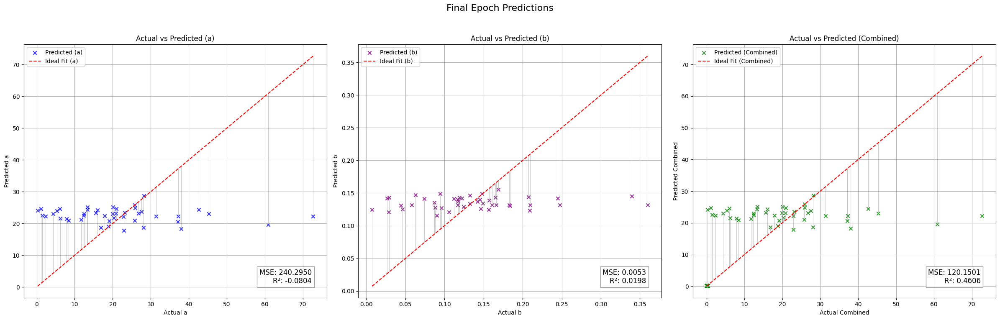

Validation Metrics:
  - MSE: 112.8409
  - R²: -0.0063
  - MAE: 5.5032
  - Explained Variance Score (EVS): -0.0062
Fold 3 Metrics:
  - Validation Loss (MSE): 112.8409
  - R²: -0.0063
  - MAE: 5.5032
  - EVS: -0.0062
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.30it/s, loss=2.41]


Validation Metrics:
  - MSE: 94.3497
  - R²: -0.0026
  - MAE: 5.9562
  - Explained Variance Score (EVS): 0.0021
Epoch [1/50], Train Loss: 2.4320, Val Loss: 94.3497
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.88it/s, loss=2.3]


Validation Metrics:
  - MSE: 93.4655
  - R²: 0.0023
  - MAE: 5.9025
  - Explained Variance Score (EVS): 0.0061
Epoch [2/50], Train Loss: 2.4121, Val Loss: 93.4655
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.91it/s, loss=2.4]


Validation Metrics:
  - MSE: 93.5913
  - R²: 0.0028
  - MAE: 5.9232
  - Explained Variance Score (EVS): 0.0058
Epoch [3/50], Train Loss: 2.4322, Val Loss: 93.5913
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.72it/s, loss=2.34]


Validation Metrics:
  - MSE: 93.7802
  - R²: 0.0028
  - MAE: 5.9357
  - Explained Variance Score (EVS): 0.0065
Epoch [4/50], Train Loss: 2.4025, Val Loss: 93.7802
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.27it/s, loss=2.23]


Validation Metrics:
  - MSE: 94.0135
  - R²: 0.0015
  - MAE: 5.9087
  - Explained Variance Score (EVS): 0.0042
Epoch [5/50], Train Loss: 2.4128, Val Loss: 94.0135
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.49it/s, loss=2.34]


Validation Metrics:
  - MSE: 96.6949
  - R²: -0.0130
  - MAE: 5.9810
  - Explained Variance Score (EVS): -0.0081
Epoch [6/50], Train Loss: 2.3970, Val Loss: 96.6949
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=2.34]


Validation Metrics:
  - MSE: 98.5975
  - R²: -0.0236
  - MAE: 6.0142
  - Explained Variance Score (EVS): -0.0184
Epoch [7/50], Train Loss: 2.4060, Val Loss: 98.5975
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.38it/s, loss=2.24]


Validation Metrics:
  - MSE: 100.5731
  - R²: -0.0320
  - MAE: 6.0498
  - Explained Variance Score (EVS): -0.0263
Epoch [8/50], Train Loss: 2.3710, Val Loss: 100.5731
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.43it/s, loss=2.44]


Validation Metrics:
  - MSE: 100.5512
  - R²: -0.0287
  - MAE: 5.9926
  - Explained Variance Score (EVS): -0.0266
Epoch [9/50], Train Loss: 2.3995, Val Loss: 100.5512
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.42it/s, loss=2.12]


Validation Metrics:
  - MSE: 101.9089
  - R²: -0.0349
  - MAE: 6.0312
  - Explained Variance Score (EVS): -0.0333
Epoch [10/50], Train Loss: 2.3708, Val Loss: 101.9089
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.59it/s, loss=2.25]


Validation Metrics:
  - MSE: 103.2471
  - R²: -0.0391
  - MAE: 6.0424
  - Explained Variance Score (EVS): -0.0370
Epoch [11/50], Train Loss: 2.3895, Val Loss: 103.2471
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s, loss=2.06]


Validation Metrics:
  - MSE: 104.5573
  - R²: -0.0468
  - MAE: 6.0982
  - Explained Variance Score (EVS): -0.0442
Epoch [12/50], Train Loss: 2.3650, Val Loss: 104.5573
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


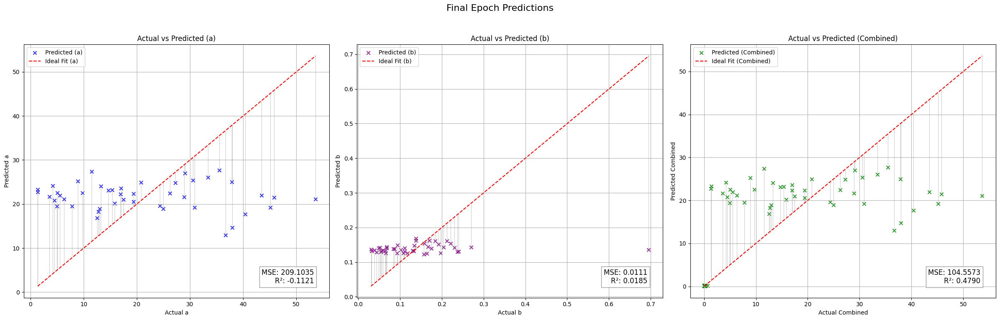

Validation Metrics:
  - MSE: 93.4655
  - R²: 0.0023
  - MAE: 5.9025
  - Explained Variance Score (EVS): 0.0061
Fold 4 Metrics:
  - Validation Loss (MSE): 93.4655
  - R²: 0.0023
  - MAE: 5.9025
  - EVS: 0.0061
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.01it/s, loss=2.43]


Validation Metrics:
  - MSE: 184.0619
  - R²: -0.0064
  - MAE: 6.8873
  - Explained Variance Score (EVS): -0.0015
Epoch [1/50], Train Loss: 2.3893, Val Loss: 184.0619
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.13it/s, loss=2.3]


Validation Metrics:
  - MSE: 184.6116
  - R²: -0.0057
  - MAE: 6.9186
  - Explained Variance Score (EVS): -0.0024
Epoch [2/50], Train Loss: 2.3969, Val Loss: 184.6116
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.37it/s, loss=2.28]


Validation Metrics:
  - MSE: 186.4774
  - R²: -0.0123
  - MAE: 6.9436
  - Explained Variance Score (EVS): -0.0092
Epoch [3/50], Train Loss: 2.3813, Val Loss: 186.4774
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.28it/s, loss=2.26]


Validation Metrics:
  - MSE: 187.3253
  - R²: -0.0152
  - MAE: 6.9939
  - Explained Variance Score (EVS): -0.0126
Epoch [4/50], Train Loss: 2.4062, Val Loss: 187.3253
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.34it/s, loss=2.22]


Validation Metrics:
  - MSE: 192.2227
  - R²: -0.0346
  - MAE: 7.0471
  - Explained Variance Score (EVS): -0.0305
Epoch [5/50], Train Loss: 2.3755, Val Loss: 192.2227
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.09it/s, loss=2.5]


Validation Metrics:
  - MSE: 195.1749
  - R²: -0.0470
  - MAE: 7.1494
  - Explained Variance Score (EVS): -0.0435
Epoch [6/50], Train Loss: 2.3772, Val Loss: 195.1749
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.22it/s, loss=2.54]


Validation Metrics:
  - MSE: 196.5002
  - R²: -0.0493
  - MAE: 7.1745
  - Explained Variance Score (EVS): -0.0454
Epoch [7/50], Train Loss: 2.3819, Val Loss: 196.5002
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.78it/s, loss=2.8]


Validation Metrics:
  - MSE: 198.0406
  - R²: -0.0581
  - MAE: 7.1987
  - Explained Variance Score (EVS): -0.0536
Epoch [8/50], Train Loss: 2.4314, Val Loss: 198.0406
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.71it/s, loss=2.25]


Validation Metrics:
  - MSE: 201.6525
  - R²: -0.0665
  - MAE: 7.2501
  - Explained Variance Score (EVS): -0.0602
Epoch [9/50], Train Loss: 2.3566, Val Loss: 201.6525
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.65it/s, loss=2.21]


Validation Metrics:
  - MSE: 199.6924
  - R²: -0.0624
  - MAE: 7.2137
  - Explained Variance Score (EVS): -0.0561
Epoch [10/50], Train Loss: 2.3598, Val Loss: 199.6924
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.11it/s, loss=2.31]


Validation Metrics:
  - MSE: 200.2922
  - R²: -0.0569
  - MAE: 7.2276
  - Explained Variance Score (EVS): -0.0504
Epoch [11/50], Train Loss: 2.3583, Val Loss: 200.2922
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


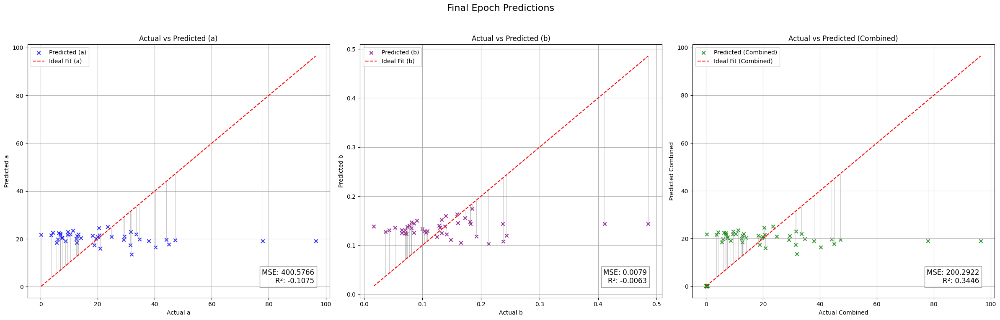

[I 2024-12-01 18:08:55,275] Trial 40 pruned. 
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Validation Metrics:
  - MSE: 184.0619
  - R²: -0.0064
  - MAE: 6.8873
  - Explained Variance Score (EVS): -0.0015
Fold 5 Metrics:
  - Validation Loss (MSE): 184.0619
  - R²: -0.0064
  - MAE: 6.8873
  - EVS: -0.0015
Avg Validation Metrics:
  - MSE: 137.6159
  - R²: -0.0457
  - MAE: 6.1624
  - EVS: -0.0011
Using device: cuda
Fold 1/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.28it/s, loss=1.54]


Validation Metrics:
  - MSE: 190.6697
  - R²: 0.0117
  - MAE: 6.2933
  - Explained Variance Score (EVS): 0.0342
Epoch [1/50], Train Loss: 1.7201, Val Loss: 190.6697
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.69it/s, loss=1.67]


Validation Metrics:
  - MSE: 190.3984
  - R²: 0.0144
  - MAE: 6.1287
  - Explained Variance Score (EVS): 0.0672
Epoch [2/50], Train Loss: 1.6410, Val Loss: 190.3984
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.53it/s, loss=1.78]


Validation Metrics:
  - MSE: 198.5722
  - R²: -0.0338
  - MAE: 6.1682
  - Explained Variance Score (EVS): 0.0787
Epoch [3/50], Train Loss: 1.6043, Val Loss: 198.5722
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.42it/s, loss=1.46]


Validation Metrics:
  - MSE: 193.1866
  - R²: 0.0027
  - MAE: 6.0775
  - Explained Variance Score (EVS): 0.1277
Epoch [4/50], Train Loss: 1.5094, Val Loss: 193.1866
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.64it/s, loss=1.41]


Validation Metrics:
  - MSE: 173.7241
  - R²: 0.0991
  - MAE: 5.7044
  - Explained Variance Score (EVS): 0.2112
Epoch [5/50], Train Loss: 1.4948, Val Loss: 173.7241
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.48it/s, loss=1.42]


Validation Metrics:
  - MSE: 153.8304
  - R²: 0.2269
  - MAE: 5.3646
  - Explained Variance Score (EVS): 0.3151
Epoch [6/50], Train Loss: 1.4500, Val Loss: 153.8304
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.03it/s, loss=1.41]


Validation Metrics:
  - MSE: 125.8940
  - R²: 0.3429
  - MAE: 4.8146
  - Explained Variance Score (EVS): 0.4185
Epoch [7/50], Train Loss: 1.4182, Val Loss: 125.8940
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.40it/s, loss=1.31]


Validation Metrics:
  - MSE: 105.9384
  - R²: 0.4495
  - MAE: 4.3782
  - Explained Variance Score (EVS): 0.5053
Epoch [8/50], Train Loss: 1.3812, Val Loss: 105.9384
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  6.60it/s, loss=1.4]


Validation Metrics:
  - MSE: 97.7582
  - R²: 0.5311
  - MAE: 4.0561
  - Explained Variance Score (EVS): 0.5732
Epoch [9/50], Train Loss: 1.3530, Val Loss: 97.7582
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=1.49]


Validation Metrics:
  - MSE: 74.8043
  - R²: 0.6380
  - MAE: 3.6229
  - Explained Variance Score (EVS): 0.6506
Epoch [10/50], Train Loss: 1.3303, Val Loss: 74.8043
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.53it/s, loss=1.21]


Validation Metrics:
  - MSE: 74.1153
  - R²: 0.6442
  - MAE: 3.5392
  - Explained Variance Score (EVS): 0.6581
Epoch [11/50], Train Loss: 1.2724, Val Loss: 74.1153
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.44it/s, loss=1.21]


Validation Metrics:
  - MSE: 69.5218
  - R²: 0.6631
  - MAE: 3.4214
  - Explained Variance Score (EVS): 0.6847
Epoch [12/50], Train Loss: 1.2532, Val Loss: 69.5218
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  7.27it/s, loss=1.32]


Validation Metrics:
  - MSE: 68.3563
  - R²: 0.6836
  - MAE: 3.4212
  - Explained Variance Score (EVS): 0.6976
Epoch [13/50], Train Loss: 1.2432, Val Loss: 68.3563
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  8.98it/s, loss=1.33]


Validation Metrics:
  - MSE: 45.6528
  - R²: 0.7787
  - MAE: 3.2533
  - Explained Variance Score (EVS): 0.7825
Epoch [14/50], Train Loss: 1.1794, Val Loss: 45.6528
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.21it/s, loss=1.26]


Validation Metrics:
  - MSE: 48.8942
  - R²: 0.7601
  - MAE: 3.2734
  - Explained Variance Score (EVS): 0.7653
Epoch [15/50], Train Loss: 1.1627, Val Loss: 48.8942
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.82it/s, loss=1.19]


Validation Metrics:
  - MSE: 80.9588
  - R²: 0.6198
  - MAE: 3.5332
  - Explained Variance Score (EVS): 0.6360
Epoch [16/50], Train Loss: 1.1236, Val Loss: 80.9588
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.32it/s, loss=1.03]


Validation Metrics:
  - MSE: 66.3560
  - R²: 0.7118
  - MAE: 3.2053
  - Explained Variance Score (EVS): 0.7467
Epoch [17/50], Train Loss: 1.0744, Val Loss: 66.3560
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  8.01it/s, loss=1.01]


Validation Metrics:
  - MSE: 66.3754
  - R²: 0.7078
  - MAE: 3.2774
  - Explained Variance Score (EVS): 0.7396
Epoch [18/50], Train Loss: 1.0442, Val Loss: 66.3754
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  7.21it/s, loss=1.16]


Validation Metrics:
  - MSE: 63.1531
  - R²: 0.6885
  - MAE: 3.4148
  - Explained Variance Score (EVS): 0.7060
Epoch [19/50], Train Loss: 1.0185, Val Loss: 63.1531
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  6.59it/s, loss=1.13]


Validation Metrics:
  - MSE: 51.0314
  - R²: 0.7324
  - MAE: 3.1113
  - Explained Variance Score (EVS): 0.7481
Epoch [20/50], Train Loss: 0.9880, Val Loss: 51.0314
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  6.87it/s, loss=0.98]


Validation Metrics:
  - MSE: 56.0536
  - R²: 0.7319
  - MAE: 3.2289
  - Explained Variance Score (EVS): 0.7499
Epoch [21/50], Train Loss: 0.9371, Val Loss: 56.0536
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  6.74it/s, loss=0.886]


Validation Metrics:
  - MSE: 59.3141
  - R²: 0.7317
  - MAE: 3.3177
  - Explained Variance Score (EVS): 0.7462
Epoch [22/50], Train Loss: 0.9077, Val Loss: 59.3141
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=0.857]


Validation Metrics:
  - MSE: 52.5855
  - R²: 0.7493
  - MAE: 3.3041
  - Explained Variance Score (EVS): 0.7543
Epoch [23/50], Train Loss: 0.8783, Val Loss: 52.5855
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  6.47it/s, loss=0.976]


Validation Metrics:
  - MSE: 77.4489
  - R²: 0.6044
  - MAE: 3.3722
  - Explained Variance Score (EVS): 0.6514
Epoch [24/50], Train Loss: 0.8626, Val Loss: 77.4489
Current Dropout Rate: 0.3160
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


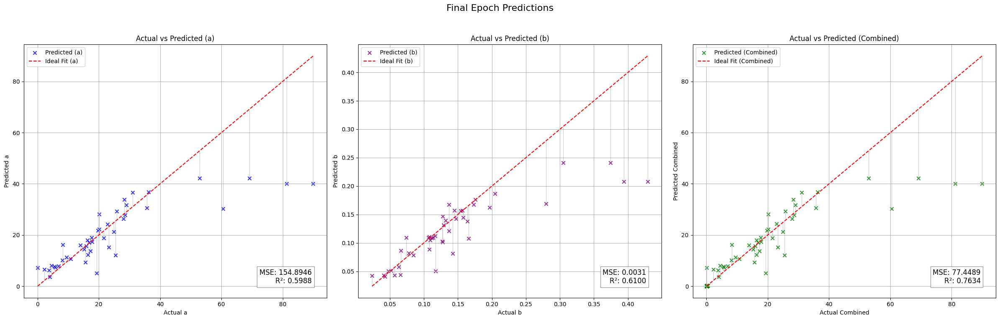

Validation Metrics:
  - MSE: 45.6528
  - R²: 0.7787
  - MAE: 3.2533
  - Explained Variance Score (EVS): 0.7825
Fold 1 Metrics:
  - Validation Loss (MSE): 45.6528
  - R²: 0.7787
  - MAE: 3.2533
  - EVS: 0.7825
Fold 2/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  7.22it/s, loss=1.31]


Validation Metrics:
  - MSE: 5.8948
  - R²: 0.9345
  - MAE: 1.2938
  - Explained Variance Score (EVS): 0.9370
Epoch [1/50], Train Loss: 1.1941, Val Loss: 5.8948
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.44it/s, loss=1.13]


Validation Metrics:
  - MSE: 11.6120
  - R²: 0.8767
  - MAE: 2.0040
  - Explained Variance Score (EVS): 0.8954
Epoch [2/50], Train Loss: 1.1577, Val Loss: 11.6120
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.39it/s, loss=1.09]


Validation Metrics:
  - MSE: 8.8045
  - R²: 0.8968
  - MAE: 1.6329
  - Explained Variance Score (EVS): 0.9061
Epoch [3/50], Train Loss: 1.1279, Val Loss: 8.8045
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.80it/s, loss=0.968]


Validation Metrics:
  - MSE: 6.9454
  - R²: 0.9063
  - MAE: 1.3608
  - Explained Variance Score (EVS): 0.9247
Epoch [4/50], Train Loss: 1.0727, Val Loss: 6.9454
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.82it/s, loss=1.06]


Validation Metrics:
  - MSE: 7.1341
  - R²: 0.9251
  - MAE: 1.4321
  - Explained Variance Score (EVS): 0.9255
Epoch [5/50], Train Loss: 1.0436, Val Loss: 7.1341
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.52it/s, loss=1.01]


Validation Metrics:
  - MSE: 9.6364
  - R²: 0.9059
  - MAE: 1.7051
  - Explained Variance Score (EVS): 0.9086
Epoch [6/50], Train Loss: 1.0202, Val Loss: 9.6364
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.35it/s, loss=0.899]


Validation Metrics:
  - MSE: 9.8929
  - R²: 0.8930
  - MAE: 1.7242
  - Explained Variance Score (EVS): 0.8955
Epoch [7/50], Train Loss: 0.9614, Val Loss: 9.8929
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  6.67it/s, loss=1.25]


Validation Metrics:
  - MSE: 9.0960
  - R²: 0.8854
  - MAE: 1.5365
  - Explained Variance Score (EVS): 0.8986
Epoch [8/50], Train Loss: 0.9936, Val Loss: 9.0960
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.12it/s, loss=0.894]


Validation Metrics:
  - MSE: 12.4408
  - R²: 0.8733
  - MAE: 1.7328
  - Explained Variance Score (EVS): 0.8756
Epoch [9/50], Train Loss: 0.9222, Val Loss: 12.4408
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.03it/s, loss=0.792]


Validation Metrics:
  - MSE: 11.4886
  - R²: 0.8793
  - MAE: 1.7763
  - Explained Variance Score (EVS): 0.8826
Epoch [10/50], Train Loss: 0.8722, Val Loss: 11.4886
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  7.55it/s, loss=0.957]


Validation Metrics:
  - MSE: 9.7588
  - R²: 0.8695
  - MAE: 1.7591
  - Explained Variance Score (EVS): 0.8806
Epoch [11/50], Train Loss: 0.8667, Val Loss: 9.7588
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


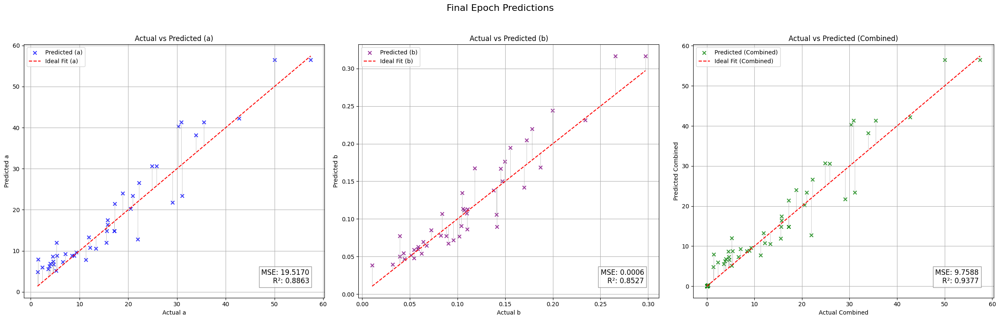

Validation Metrics:
  - MSE: 5.8948
  - R²: 0.9345
  - MAE: 1.2938
  - Explained Variance Score (EVS): 0.9370
Fold 2 Metrics:
  - Validation Loss (MSE): 5.8948
  - R²: 0.9345
  - MAE: 1.2938
  - EVS: 0.9370
Fold 3/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.86it/s, loss=1.09]


Validation Metrics:
  - MSE: 16.9231
  - R²: 0.8586
  - MAE: 1.8570
  - Explained Variance Score (EVS): 0.8610
Epoch [1/50], Train Loss: 1.1429, Val Loss: 16.9231
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  7.16it/s, loss=1.16]


Validation Metrics:
  - MSE: 15.8917
  - R²: 0.8632
  - MAE: 1.6963
  - Explained Variance Score (EVS): 0.8658
Epoch [2/50], Train Loss: 1.1307, Val Loss: 15.8917
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  7.04it/s, loss=1.03]


Validation Metrics:
  - MSE: 17.3880
  - R²: 0.8568
  - MAE: 1.7022
  - Explained Variance Score (EVS): 0.8584
Epoch [3/50], Train Loss: 1.0989, Val Loss: 17.3880
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.37it/s, loss=1.03]


Validation Metrics:
  - MSE: 19.3089
  - R²: 0.8379
  - MAE: 1.7197
  - Explained Variance Score (EVS): 0.8418
Epoch [4/50], Train Loss: 1.0911, Val Loss: 19.3089
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.65it/s, loss=1.13]


Validation Metrics:
  - MSE: 19.3477
  - R²: 0.8434
  - MAE: 1.7682
  - Explained Variance Score (EVS): 0.8474
Epoch [5/50], Train Loss: 1.0752, Val Loss: 19.3477
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.43it/s, loss=1.25]


Validation Metrics:
  - MSE: 15.9722
  - R²: 0.8659
  - MAE: 1.6539
  - Explained Variance Score (EVS): 0.8685
Epoch [6/50], Train Loss: 1.0666, Val Loss: 15.9722
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.45it/s, loss=1.07]


Validation Metrics:
  - MSE: 16.6771
  - R²: 0.8627
  - MAE: 1.6687
  - Explained Variance Score (EVS): 0.8638
Epoch [7/50], Train Loss: 1.0443, Val Loss: 16.6771
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.33it/s, loss=1.04]


Validation Metrics:
  - MSE: 17.6179
  - R²: 0.8557
  - MAE: 1.6489
  - Explained Variance Score (EVS): 0.8565
Epoch [8/50], Train Loss: 1.0430, Val Loss: 17.6179
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.14it/s, loss=0.941]


Validation Metrics:
  - MSE: 18.5421
  - R²: 0.8482
  - MAE: 1.6976
  - Explained Variance Score (EVS): 0.8493
Epoch [9/50], Train Loss: 0.9866, Val Loss: 18.5421
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.16it/s, loss=0.948]


Validation Metrics:
  - MSE: 20.6813
  - R²: 0.8309
  - MAE: 1.6715
  - Explained Variance Score (EVS): 0.8325
Epoch [10/50], Train Loss: 0.9692, Val Loss: 20.6813
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  8.05it/s, loss=1.05]


Validation Metrics:
  - MSE: 17.8905
  - R²: 0.8462
  - MAE: 1.6229
  - Explained Variance Score (EVS): 0.8493
Epoch [11/50], Train Loss: 0.9659, Val Loss: 17.8905
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  7.91it/s, loss=0.881]


Validation Metrics:
  - MSE: 17.5462
  - R²: 0.8508
  - MAE: 1.6352
  - Explained Variance Score (EVS): 0.8530
Epoch [12/50], Train Loss: 0.9426, Val Loss: 17.5462
Current Dropout Rate: 0.4120
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


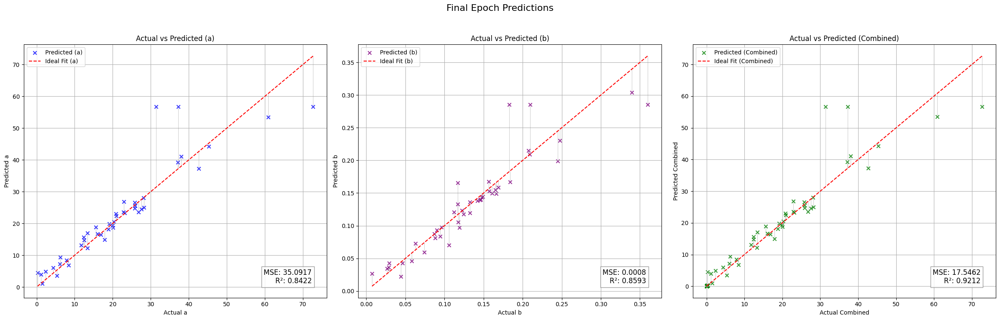

Validation Metrics:
  - MSE: 15.8917
  - R²: 0.8632
  - MAE: 1.6963
  - Explained Variance Score (EVS): 0.8658
Fold 3 Metrics:
  - Validation Loss (MSE): 15.8917
  - R²: 0.8632
  - MAE: 1.6963
  - EVS: 0.8658
Fold 4/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.38it/s, loss=1.1]


Validation Metrics:
  - MSE: 25.5462
  - R²: 0.6080
  - MAE: 1.9270
  - Explained Variance Score (EVS): 0.6119
Epoch [1/50], Train Loss: 1.0923, Val Loss: 25.5462
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.17it/s, loss=1.17]


Validation Metrics:
  - MSE: 27.9104
  - R²: 0.5901
  - MAE: 2.0108
  - Explained Variance Score (EVS): 0.5942
Epoch [2/50], Train Loss: 1.0931, Val Loss: 27.9104
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.47it/s, loss=1.09]


Validation Metrics:
  - MSE: 33.5272
  - R²: 0.5520
  - MAE: 2.2090
  - Explained Variance Score (EVS): 0.5577
Epoch [3/50], Train Loss: 1.0769, Val Loss: 33.5272
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  6.50it/s, loss=1.05]


Validation Metrics:
  - MSE: 33.6278
  - R²: 0.5421
  - MAE: 2.2023
  - Explained Variance Score (EVS): 0.5470
Epoch [4/50], Train Loss: 1.0583, Val Loss: 33.6278
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  6.84it/s, loss=1.06]


Validation Metrics:
  - MSE: 36.4560
  - R²: 0.5166
  - MAE: 2.3034
  - Explained Variance Score (EVS): 0.5235
Epoch [5/50], Train Loss: 1.0471, Val Loss: 36.4560
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  6.99it/s, loss=1.07]


Validation Metrics:
  - MSE: 36.9722
  - R²: 0.5064
  - MAE: 2.3377
  - Explained Variance Score (EVS): 0.5145
Epoch [6/50], Train Loss: 1.0480, Val Loss: 36.9722
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  7.41it/s, loss=0.989]


Validation Metrics:
  - MSE: 40.1406
  - R²: 0.4843
  - MAE: 2.4447
  - Explained Variance Score (EVS): 0.4933
Epoch [7/50], Train Loss: 1.0218, Val Loss: 40.1406
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  7.12it/s, loss=1.02]


Validation Metrics:
  - MSE: 38.0088
  - R²: 0.4959
  - MAE: 2.3882
  - Explained Variance Score (EVS): 0.5029
Epoch [8/50], Train Loss: 1.0379, Val Loss: 38.0088
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.48it/s, loss=0.941]


Validation Metrics:
  - MSE: 32.1982
  - R²: 0.5327
  - MAE: 2.1937
  - Explained Variance Score (EVS): 0.5358
Epoch [9/50], Train Loss: 0.9911, Val Loss: 32.1982
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  7.30it/s, loss=0.953]


Validation Metrics:
  - MSE: 30.5847
  - R²: 0.5438
  - MAE: 2.1238
  - Explained Variance Score (EVS): 0.5471
Epoch [10/50], Train Loss: 0.9951, Val Loss: 30.5847
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.71it/s, loss=1.04]


Validation Metrics:
  - MSE: 33.3415
  - R²: 0.5249
  - MAE: 2.1936
  - Explained Variance Score (EVS): 0.5285
Epoch [11/50], Train Loss: 0.9915, Val Loss: 33.3415
Current Dropout Rate: 0.4200
Early stopping triggered!
Loading the best model for evaluation...


<ipython-input-13-a68cae29f7fc>:445: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.model.load_state_dict(torch.load(best_model_path)["model_state"])


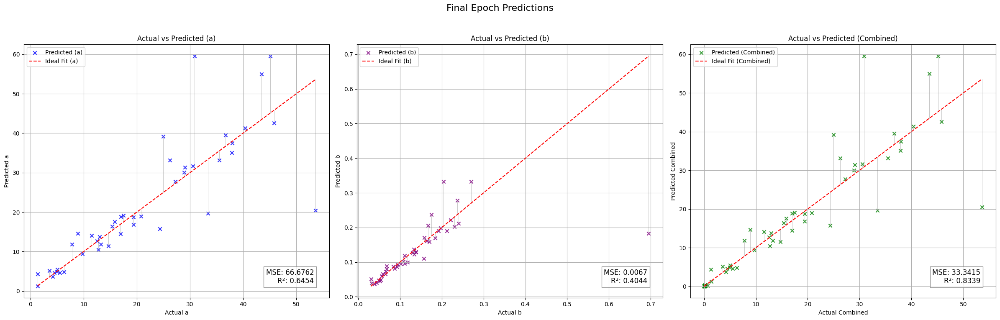

Validation Metrics:
  - MSE: 25.5462
  - R²: 0.6080
  - MAE: 1.9270
  - Explained Variance Score (EVS): 0.6119
Fold 4 Metrics:
  - Validation Loss (MSE): 25.5462
  - R²: 0.6080
  - MAE: 1.9270
  - EVS: 0.6119
Fold 5/5


Epoch 1/50: 100%|██████████| 6/6 [00:00<00:00,  6.44it/s, loss=1.05]


Validation Metrics:
  - MSE: 36.9532
  - R²: 0.8101
  - MAE: 1.9746
  - Explained Variance Score (EVS): 0.8156
Epoch [1/50], Train Loss: 1.1234, Val Loss: 36.9532
Current Dropout Rate: 0.5000


Epoch 2/50: 100%|██████████| 6/6 [00:00<00:00,  6.26it/s, loss=1.3]


Validation Metrics:
  - MSE: 37.0784
  - R²: 0.8108
  - MAE: 1.9673
  - Explained Variance Score (EVS): 0.8149
Epoch [2/50], Train Loss: 1.1345, Val Loss: 37.0784
Current Dropout Rate: 0.4920


Epoch 3/50: 100%|██████████| 6/6 [00:00<00:00,  6.61it/s, loss=1]


Validation Metrics:
  - MSE: 38.2932
  - R²: 0.8036
  - MAE: 1.9618
  - Explained Variance Score (EVS): 0.8076
Epoch [3/50], Train Loss: 1.0859, Val Loss: 38.2932
Current Dropout Rate: 0.4840


Epoch 4/50: 100%|██████████| 6/6 [00:00<00:00,  7.35it/s, loss=1.01]


Validation Metrics:
  - MSE: 39.7883
  - R²: 0.7955
  - MAE: 1.9652
  - Explained Variance Score (EVS): 0.8027
Epoch [4/50], Train Loss: 1.0640, Val Loss: 39.7883
Current Dropout Rate: 0.4760


Epoch 5/50: 100%|██████████| 6/6 [00:00<00:00,  7.76it/s, loss=1.08]


Validation Metrics:
  - MSE: 40.9196
  - R²: 0.7895
  - MAE: 2.0005
  - Explained Variance Score (EVS): 0.8011
Epoch [5/50], Train Loss: 1.0635, Val Loss: 40.9196
Current Dropout Rate: 0.4680


Epoch 6/50: 100%|██████████| 6/6 [00:00<00:00,  7.31it/s, loss=1]


Validation Metrics:
  - MSE: 37.8497
  - R²: 0.8042
  - MAE: 1.9207
  - Explained Variance Score (EVS): 0.8127
Epoch [6/50], Train Loss: 1.0581, Val Loss: 37.8497
Current Dropout Rate: 0.4600


Epoch 7/50: 100%|██████████| 6/6 [00:00<00:00,  6.86it/s, loss=1.12]


Validation Metrics:
  - MSE: 38.0510
  - R²: 0.7990
  - MAE: 1.9119
  - Explained Variance Score (EVS): 0.8122
Epoch [7/50], Train Loss: 1.0716, Val Loss: 38.0510
Current Dropout Rate: 0.4520


Epoch 8/50: 100%|██████████| 6/6 [00:00<00:00,  8.23it/s, loss=1.02]


Validation Metrics:
  - MSE: 37.5626
  - R²: 0.8002
  - MAE: 1.8696
  - Explained Variance Score (EVS): 0.8120
Epoch [8/50], Train Loss: 1.0466, Val Loss: 37.5626
Current Dropout Rate: 0.4440


Epoch 9/50: 100%|██████████| 6/6 [00:00<00:00,  7.52it/s, loss=1.06]


Validation Metrics:
  - MSE: 36.3490
  - R²: 0.8060
  - MAE: 1.7911
  - Explained Variance Score (EVS): 0.8132
Epoch [9/50], Train Loss: 1.0552, Val Loss: 36.3490
Current Dropout Rate: 0.4360


Epoch 10/50: 100%|██████████| 6/6 [00:00<00:00,  6.96it/s, loss=1.01]


Validation Metrics:
  - MSE: 35.5231
  - R²: 0.8098
  - MAE: 1.7542
  - Explained Variance Score (EVS): 0.8175
Epoch [10/50], Train Loss: 1.0395, Val Loss: 35.5231
Current Dropout Rate: 0.4280


Epoch 11/50: 100%|██████████| 6/6 [00:00<00:00,  6.98it/s, loss=1.08]


Validation Metrics:
  - MSE: 36.2455
  - R²: 0.8064
  - MAE: 1.7533
  - Explained Variance Score (EVS): 0.8149
Epoch [11/50], Train Loss: 1.0274, Val Loss: 36.2455
Current Dropout Rate: 0.4200


Epoch 12/50: 100%|██████████| 6/6 [00:00<00:00,  6.79it/s, loss=0.979]


Validation Metrics:
  - MSE: 35.5711
  - R²: 0.8122
  - MAE: 1.7276
  - Explained Variance Score (EVS): 0.8184
Epoch [12/50], Train Loss: 1.0280, Val Loss: 35.5711
Current Dropout Rate: 0.4120


Epoch 13/50: 100%|██████████| 6/6 [00:00<00:00,  6.57it/s, loss=0.974]


Validation Metrics:
  - MSE: 36.7361
  - R²: 0.8053
  - MAE: 1.7364
  - Explained Variance Score (EVS): 0.8126
Epoch [13/50], Train Loss: 1.0337, Val Loss: 36.7361
Current Dropout Rate: 0.4040


Epoch 14/50: 100%|██████████| 6/6 [00:00<00:00,  6.72it/s, loss=1.06]


Validation Metrics:
  - MSE: 37.3537
  - R²: 0.8051
  - MAE: 1.7650
  - Explained Variance Score (EVS): 0.8144
Epoch [14/50], Train Loss: 1.0210, Val Loss: 37.3537
Current Dropout Rate: 0.3960


Epoch 15/50: 100%|██████████| 6/6 [00:00<00:00,  7.73it/s, loss=1.07]


Validation Metrics:
  - MSE: 38.7431
  - R²: 0.8006
  - MAE: 1.7513
  - Explained Variance Score (EVS): 0.8107
Epoch [15/50], Train Loss: 1.0345, Val Loss: 38.7431
Current Dropout Rate: 0.3880


Epoch 16/50: 100%|██████████| 6/6 [00:00<00:00,  7.42it/s, loss=1.05]


Validation Metrics:
  - MSE: 35.9030
  - R²: 0.8169
  - MAE: 1.6865
  - Explained Variance Score (EVS): 0.8229
Epoch [16/50], Train Loss: 1.0318, Val Loss: 35.9030
Current Dropout Rate: 0.3800


Epoch 17/50: 100%|██████████| 6/6 [00:00<00:00,  7.04it/s, loss=1]


Validation Metrics:
  - MSE: 34.9163
  - R²: 0.8228
  - MAE: 1.6951
  - Explained Variance Score (EVS): 0.8274
Epoch [17/50], Train Loss: 1.0207, Val Loss: 34.9163
Current Dropout Rate: 0.3720


Epoch 18/50: 100%|██████████| 6/6 [00:00<00:00,  7.13it/s, loss=1.04]


Validation Metrics:
  - MSE: 32.5717
  - R²: 0.8340
  - MAE: 1.6733
  - Explained Variance Score (EVS): 0.8358
Epoch [18/50], Train Loss: 1.0375, Val Loss: 32.5717
Current Dropout Rate: 0.3640


Epoch 19/50: 100%|██████████| 6/6 [00:00<00:00,  6.92it/s, loss=0.95]


Validation Metrics:
  - MSE: 33.8145
  - R²: 0.8274
  - MAE: 1.6857
  - Explained Variance Score (EVS): 0.8305
Epoch [19/50], Train Loss: 1.0015, Val Loss: 33.8145
Current Dropout Rate: 0.3560


Epoch 20/50: 100%|██████████| 6/6 [00:00<00:00,  7.63it/s, loss=0.996]


Validation Metrics:
  - MSE: 33.5353
  - R²: 0.8289
  - MAE: 1.7007
  - Explained Variance Score (EVS): 0.8318
Epoch [20/50], Train Loss: 1.0034, Val Loss: 33.5353
Current Dropout Rate: 0.3480


Epoch 21/50: 100%|██████████| 6/6 [00:00<00:00,  6.74it/s, loss=1.08]


Validation Metrics:
  - MSE: 34.3604
  - R²: 0.8239
  - MAE: 1.7269
  - Explained Variance Score (EVS): 0.8284
Epoch [21/50], Train Loss: 1.0252, Val Loss: 34.3604
Current Dropout Rate: 0.3400


Epoch 22/50: 100%|██████████| 6/6 [00:00<00:00,  6.94it/s, loss=0.944]


Validation Metrics:
  - MSE: 35.0911
  - R²: 0.8198
  - MAE: 1.7277
  - Explained Variance Score (EVS): 0.8257
Epoch [22/50], Train Loss: 1.0006, Val Loss: 35.0911
Current Dropout Rate: 0.3320


Epoch 23/50: 100%|██████████| 6/6 [00:00<00:00,  6.66it/s, loss=1]


Validation Metrics:
  - MSE: 34.2838
  - R²: 0.8233
  - MAE: 1.7524
  - Explained Variance Score (EVS): 0.8306
Epoch [23/50], Train Loss: 0.9897, Val Loss: 34.2838
Current Dropout Rate: 0.3240


Epoch 24/50: 100%|██████████| 6/6 [00:00<00:00,  6.21it/s, loss=0.998]

In [15]:
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader

# Assume the DataPreprocessor class and its method `load_embeddings_and_targets` are already defined
# Replace `url` and `drive_path` with your actual data location or paths.
preprocessor = DataPreprocessor(url, drive_path)
data = preprocessor.data

# Generate embeddings and targets (if not already done)
embeddings, targets = preprocessor.load_embeddings_and_targets()

layer_config = layer_config = [
    {
        "hidden_size": 256,          # Number of neurons in the first hidden layer
        "activation": "ReLU",       # Activation function for this layer
        "dropout": 0.3              # Dropout rate for this layer
    },
    {
        "hidden_size": 128,          # Number of neurons in the second hidden layer
        "activation": "LeakyReLU",   # Activation function for this layer
        "dropout": 0.2               # Dropout rate for this layer
    },
    {
        "hidden_size": 64,           # Number of neurons in the third hidden layer
        "activation": "ELU",         # Activation function for this layer
        "dropout": 0.1               # Dropout rate for this layer
    }
]

SCHEDULERS = {
    "ReduceLROnPlateau": {
        "scheduler": optim.lr_scheduler.ReduceLROnPlateau,
        "params": {"mode": "min", "factor": 0.5, "patience": 10, "verbose": True}
    },
    "CyclicLR": {
        "scheduler": optim.lr_scheduler.CyclicLR,
        "params": {"base_lr": 1e-5, "max_lr": 1e-3, "step_size_up": 10, "mode": "triangular"}
    },
    "CosineAnnealingLR": {
        "scheduler": optim.lr_scheduler.CosineAnnealingLR,
        "params": {"T_max": 10, "eta_min": 1e-6}
    },
    "StepLR": {
        "scheduler": optim.lr_scheduler.StepLR,
        "params": {"step_size": 10, "gamma": 0.1}
    },
    "ExponentialLR": {
        "scheduler": optim.lr_scheduler.ExponentialLR,
        "params": {"gamma": 0.95}
    },
    "OneCycleLR": {
        "scheduler": optim.lr_scheduler.OneCycleLR,
        "params": {"max_lr": 1e-3, "steps_per_epoch": 100, "epochs": 10}
    }
}


# Initialize the pipeline with your data, including hyperparameters like dropout_rate and k_folds
pipeline = MolecularPredictorPipeline(
    embeddings=embeddings,
    targets=targets,
    layer_config=layer_config,
    optimizer_name='AdamW',  # You can change this to 'SGD' or 'RMSprop
    hidden_size=128,  # You can adjust this based on your requirement
    batch_size=32,    # Adjust this as needed
    learning_rate=0.001,  # Adjust as needed
    num_epochs=50,    # Number of training epochs
    patience=10,      # Patience for early stopping
    dropout_rate=0.5,  # Dropout rate for regularization (as added in the changes)
    k_folds=5,          # Using K-fold cross-validation for more robust evaluation
    clip_grad_norm=1.0, # gradient norm
    clip_grad_value=0.5, # gradient value
    scheduler_type="ReduceLROnPlateau",  # Choose a scheduler type from SCHEDULERS
    scheduler_params=SCHEDULERS["ReduceLROnPlateau"]["params"],
)

# Start the hyperparameter tuning process (Optuna)
print("Starting hyperparameter tuning...")
pipeline.tune_hyperparameters(n_trials=50)  # Tune over 50 trials (you can increase this number for better optimization)

# After tuning, the best hyperparameters will be printed.
# You can now use the best hyperparameters to train a model or make predictions.

# Once the tuning is complete, you can use the pipeline to train and evaluate the model.
print("\nTraining the model with the best hyperparameters...")

# Step 1: Create the training and validation datasets and dataloaders.
# Split the data for training and validation (80% training, 20% validation)
train_data, val_data, train_targets, val_targets = train_test_split(
    embeddings, targets, test_size=0.2, random_state=42
)

# Create datasets for training and validation
train_dataset = pipeline.MoleculeDataset(train_data, train_targets)
val_dataset = pipeline.MoleculeDataset(val_data, val_targets)

# Create DataLoader objects for both datasets
train_loader = DataLoader(train_dataset, batch_size=pipeline.batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=pipeline.batch_size, shuffle=False)

# Step 2: Train the model using the provided data loaders
pipeline.train_model(train_loader, val_loader)

# Step 3: Evaluate the model on the validation set
print("\nEvaluating the model on the validation data...")
mse, r2 = pipeline.evaluate_model(val_loader, return_metrics=True)
print(f"Validation MSE: {mse:.4f}, R2: {r2:.4f}")

# Step 4: Save the trained model
pipeline.save_model('molecular_predictor.pth')

# Optionally, load the saved model (if needed)
pipeline.load_model('molecular_predictor.pth')

pipeline.load_model("best_overall_model.pth")
pipeline.model.eval()
print("Best model loaded for predictions.")


In [53]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
import xgboost as xgb

class CombinedPipeline:
    def __init__(self, embedding_model, regression_models, data):
        """
        Initialize the combined pipeline.

        Parameters:
        - embedding_model: Instance of the MolecularPredictorPipeline for embeddings-based predictions.
        - regression_models: Dictionary of regression models (e.g., {"lr": LinearRegression(), "rf": RandomForestRegressor()}).
        - data: Dataset containing features (X) and targets (a, b).
        """
        self.embedding_model = embedding_model
        self.regression_models = regression_models
        self.data = data
        self.scaler = StandardScaler()
        self.combination_weights = None

    def prepare_data(self, test_size=0.2, random_state=42):
        """
        Prepare and split the data into training and test sets.
        """
        numeric_data = self.data.select_dtypes(include=['number'])
        self.X = numeric_data.drop(columns=['a', 'b'])
        self.y = self.data[['a', 'b']]
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.X, self.y, test_size=test_size, random_state=random_state
        )
        self.X_train_scaled = self.scaler.fit_transform(self.X_train)
        self.X_test_scaled = self.scaler.transform(self.X_test)

    def train_embedding_model(self):
        """
        Train the embedding model using its training procedure.
        """
        print("Training embedding model...")
        self.embedding_model.k_fold_cross_validation()

    def train_regression_models(self):
        """
        Train all specified regression models on the scaled data.
        """
        self.trained_models = {}
        for model_name, model in self.regression_models.items():
            print(f"Training regression model: {model_name}...")
            model.fit(self.X_train_scaled, self.y_train)
            self.trained_models[model_name] = model

    def combine_predictions(self, combination_method="weighted", weights=None):
        """
        Combine predictions from the embedding model and regression models.

        Parameters:
        - combination_method: "weighted" or "stacking".
        - weights: Optional list of weights for the models if using "weighted" method.

        Returns:
        - Combined predictions.
        """
        print("Combining predictions...")
        # Get embedding model predictions
        embedding_predictions = self.embedding_model.predict(self.X_test.values)

        # Get regression model predictions
        regression_predictions = np.array([
            model.predict(self.X_test_scaled) for model in self.trained_models.values()
        ])  # Shape: (num_models, num_samples, 2)

        # Combine predictions
        if combination_method == "weighted":
            if weights is None:
                weights = [1 / (len(self.trained_models) + 1)] * (len(self.trained_models) + 1)
            embedding_weight = weights[0]
            regression_weights = weights[1:]
            combined_predictions = (
                embedding_weight * embedding_predictions +
                np.sum([
                    regression_weight * regression_predictions[i]
                    for i, regression_weight in enumerate(regression_weights)
                ], axis=0)
            )
        elif combination_method == "stacking":
            # Use a meta-learner for stacking
            stacking_X = np.hstack([embedding_predictions] + list(regression_predictions))
            meta_model = LinearRegression()
            meta_model.fit(stacking_X, self.y_test)
            combined_predictions = meta_model.predict(stacking_X)
        else:
            raise ValueError("Invalid combination method. Use 'weighted' or 'stacking'.")

        return combined_predictions

    def evaluate_combined_model(self, combined_predictions):
        """
        Evaluate the combined model using MSE and R² scores.
        """
        mse_a = mean_squared_error(self.y_test['a'], combined_predictions[:, 0])
        mse_b = mean_squared_error(self.y_test['b'], combined_predictions[:, 1])
        mse_combined = mean_squared_error(self.y_test, combined_predictions)
        r2_combined = r2_score(self.y_test, combined_predictions)
        print(f"Combined Model - MSE for 'a': {mse_a:.4f}")
        print(f"Combined Model - MSE for 'b': {mse_b:.4f}")
        print(f"Combined Model - Combined MSE: {mse_combined:.4f}")
        print(f"Combined Model - R²: {r2_combined:.4f}")
        return mse_a, mse_b, mse_combined, r2_combined

    def run_pipeline(self, combination_method="weighted", weights=None):
        """
        Run the full pipeline: train models, combine predictions, and evaluate.
        """
        self.prepare_data()
        self.train_embedding_model()
        self.train_regression_models()
        combined_predictions = self.combine_predictions(combination_method, weights)
        return self.evaluate_combined_model(combined_predictions)

Loaded Embeddings
Using device: cuda
Training embedding model...
Fold 1/5
Epoch [1/50], Train Loss: 0.4893, Val Loss: 213.4357
Current Dropout Rate: 0.5000
Epoch [2/50], Train Loss: 0.4146, Val Loss: 197.0881
Current Dropout Rate: 0.4920
Epoch [3/50], Train Loss: 0.3119, Val Loss: 178.8284
Current Dropout Rate: 0.4840
Epoch [4/50], Train Loss: 0.3060, Val Loss: 154.6966
Current Dropout Rate: 0.4760
Epoch [5/50], Train Loss: 0.2564, Val Loss: 132.7649
Current Dropout Rate: 0.4680
Epoch [6/50], Train Loss: 0.2191, Val Loss: 116.5872
Current Dropout Rate: 0.4600
Epoch [7/50], Train Loss: 0.2038, Val Loss: 101.6138
Current Dropout Rate: 0.4520
Epoch [8/50], Train Loss: 0.1752, Val Loss: 92.6537
Current Dropout Rate: 0.4440
Epoch [9/50], Train Loss: 0.1663, Val Loss: 86.3615
Current Dropout Rate: 0.4360
Epoch [10/50], Train Loss: 0.1535, Val Loss: 86.0501
Current Dropout Rate: 0.4280
Epoch [11/50], Train Loss: 0.1464, Val Loss: 86.9181
Current Dropout Rate: 0.4200
Epoch [12/50], Train Loss:

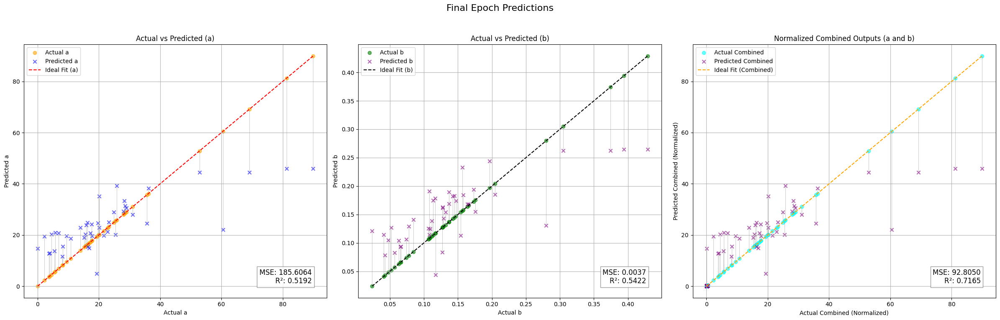

Fold 2/5
Epoch [1/50], Train Loss: 0.1574, Val Loss: 3.7515
Current Dropout Rate: 0.5000
Epoch [2/50], Train Loss: 0.1443, Val Loss: 4.0041
Current Dropout Rate: 0.4920
Epoch [3/50], Train Loss: 0.1323, Val Loss: 4.5239
Current Dropout Rate: 0.4840
Epoch [4/50], Train Loss: 0.1202, Val Loss: 4.8808
Current Dropout Rate: 0.4760
Epoch [5/50], Train Loss: 0.1104, Val Loss: 4.9871
Current Dropout Rate: 0.4680
Epoch [6/50], Train Loss: 0.1178, Val Loss: 5.2577
Current Dropout Rate: 0.4600
Epoch [7/50], Train Loss: 0.1041, Val Loss: 5.0671
Current Dropout Rate: 0.4520
Epoch [8/50], Train Loss: 0.1249, Val Loss: 5.1357
Current Dropout Rate: 0.4440
Epoch [9/50], Train Loss: 0.0993, Val Loss: 5.2092
Current Dropout Rate: 0.4360
Epoch [10/50], Train Loss: 0.1226, Val Loss: 5.0744
Current Dropout Rate: 0.4280
Epoch [11/50], Train Loss: 0.1011, Val Loss: 5.0602
Current Dropout Rate: 0.4200
Early stopping triggered!


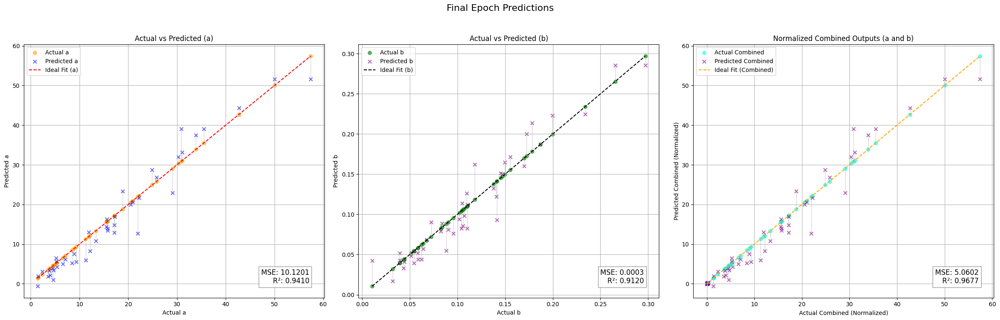

Fold 3/5
Epoch [1/50], Train Loss: 0.1040, Val Loss: 14.9811
Current Dropout Rate: 0.5000
Epoch [2/50], Train Loss: 0.1001, Val Loss: 15.3200
Current Dropout Rate: 0.4920
Epoch [3/50], Train Loss: 0.1022, Val Loss: 15.3935
Current Dropout Rate: 0.4840
Epoch [4/50], Train Loss: 0.0887, Val Loss: 15.4543
Current Dropout Rate: 0.4760
Epoch [5/50], Train Loss: 0.0809, Val Loss: 15.6371
Current Dropout Rate: 0.4680
Epoch [6/50], Train Loss: 0.0827, Val Loss: 15.8785
Current Dropout Rate: 0.4600
Epoch [7/50], Train Loss: 0.0868, Val Loss: 15.9507
Current Dropout Rate: 0.4520
Epoch [8/50], Train Loss: 0.0897, Val Loss: 16.1514
Current Dropout Rate: 0.4440
Epoch [9/50], Train Loss: 0.0791, Val Loss: 16.4337
Current Dropout Rate: 0.4360
Epoch [10/50], Train Loss: 0.0795, Val Loss: 16.4060
Current Dropout Rate: 0.4280
Epoch [11/50], Train Loss: 0.0865, Val Loss: 16.3749
Current Dropout Rate: 0.4200
Early stopping triggered!


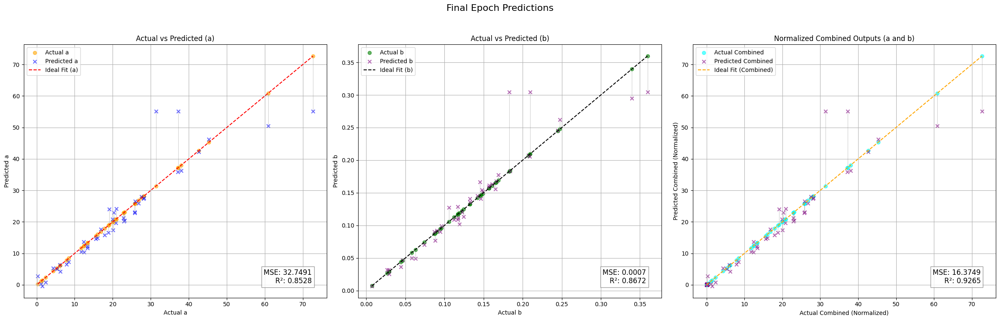

Fold 4/5
Epoch [1/50], Train Loss: 0.0777, Val Loss: 19.3876
Current Dropout Rate: 0.5000
Epoch [2/50], Train Loss: 0.0761, Val Loss: 19.3826
Current Dropout Rate: 0.4920
Epoch [3/50], Train Loss: 0.0730, Val Loss: 19.5940
Current Dropout Rate: 0.4840
Epoch [4/50], Train Loss: 0.0733, Val Loss: 19.5901
Current Dropout Rate: 0.4760
Epoch [5/50], Train Loss: 0.0668, Val Loss: 20.2091
Current Dropout Rate: 0.4680
Epoch [6/50], Train Loss: 0.0641, Val Loss: 20.4849
Current Dropout Rate: 0.4600
Epoch [7/50], Train Loss: 0.0711, Val Loss: 21.0723
Current Dropout Rate: 0.4520
Epoch [8/50], Train Loss: 0.0644, Val Loss: 21.4856
Current Dropout Rate: 0.4440
Epoch [9/50], Train Loss: 0.0759, Val Loss: 21.6002
Current Dropout Rate: 0.4360
Epoch [10/50], Train Loss: 0.0645, Val Loss: 21.6963
Current Dropout Rate: 0.4280
Epoch [11/50], Train Loss: 0.0685, Val Loss: 21.8613
Current Dropout Rate: 0.4200
Epoch [12/50], Train Loss: 0.0688, Val Loss: 22.1597
Current Dropout Rate: 0.4120
Early stopping t

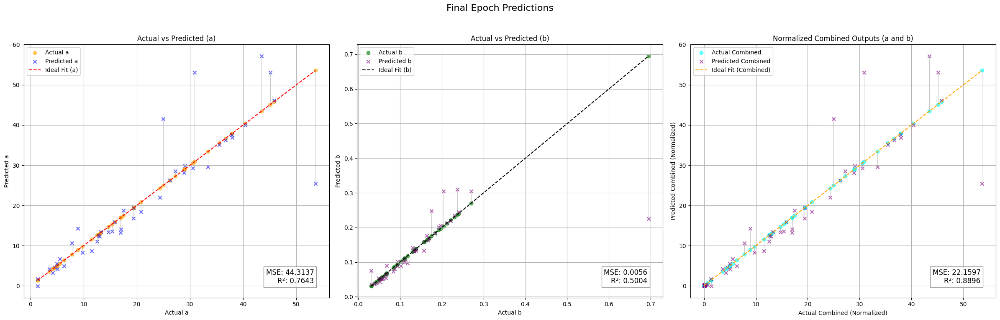

Fold 5/5
Epoch [1/50], Train Loss: 0.0912, Val Loss: 33.9805
Current Dropout Rate: 0.5000
Epoch [2/50], Train Loss: 0.0949, Val Loss: 35.0260
Current Dropout Rate: 0.4920
Epoch [3/50], Train Loss: 0.0661, Val Loss: 34.5320
Current Dropout Rate: 0.4840
Epoch [4/50], Train Loss: 0.0833, Val Loss: 35.0685
Current Dropout Rate: 0.4760
Epoch [5/50], Train Loss: 0.0810, Val Loss: 35.3320
Current Dropout Rate: 0.4680
Epoch [6/50], Train Loss: 0.0681, Val Loss: 35.0845
Current Dropout Rate: 0.4600
Epoch [7/50], Train Loss: 0.0713, Val Loss: 35.6478
Current Dropout Rate: 0.4520
Epoch [8/50], Train Loss: 0.0844, Val Loss: 35.3977
Current Dropout Rate: 0.4440
Epoch [9/50], Train Loss: 0.0748, Val Loss: 35.6787
Current Dropout Rate: 0.4360
Epoch [10/50], Train Loss: 0.0662, Val Loss: 34.7565
Current Dropout Rate: 0.4280
Epoch [11/50], Train Loss: 0.0741, Val Loss: 34.8242
Current Dropout Rate: 0.4200
Early stopping triggered!


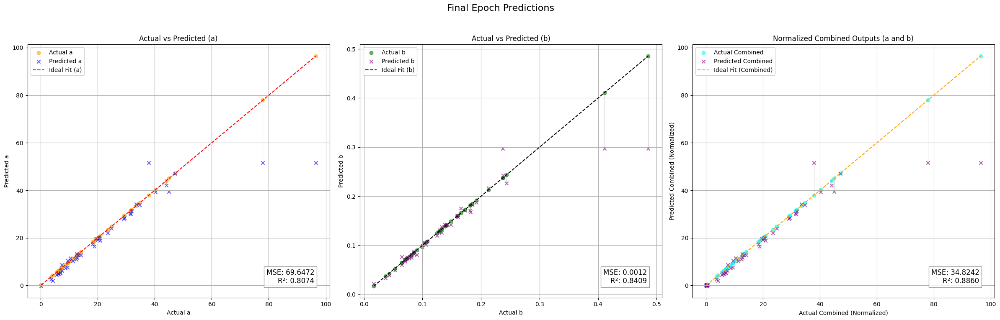

Avg Validation Loss: 34.2448, Avg R2: 0.7547
Training regression model: lr...
Training regression model: rf...
Training regression model: xgb...
Combining predictions...


RuntimeError: mat1 and mat2 shapes cannot be multiplied (44x10 and 2048x128)

In [54]:
# Assume the DataPreprocessor class and its method `load_embeddings_and_targets` are already defined
# Replace `url` and `drive_path` with your actual data location or paths.
preprocessor = DataPreprocessor(url, drive_path)
data = preprocessor.data

# Generate embeddings and targets (if not already done)
embeddings, targets = preprocessor.load_embeddings_and_targets()

# Initialize embedding model and regression models
embedding_model = MolecularPredictorPipeline(embeddings, targets)
regression_models = {
    "lr": LinearRegression(),
    "rf": RandomForestRegressor(),
    "xgb": xgb.XGBRegressor(objective="reg:squarederror"),
}

# Create and run the combined pipeline
pipeline = CombinedPipeline(embedding_model, regression_models, data)
pipeline.run_pipeline(combination_method="weighted", weights=[0.5, 0.25, 0.25])